# Simple PINN for an elastic plate with an elliptical hole 

## Geometry

We want to model a quarter of a plate with an elliptical hole. The domain itself is represented by collocation points, the boundaries are represented by uniformly sampled points along the perimeter.

In [16]:
import torch
from torch.optim.lr_scheduler import StepLR, ExponentialLR
import numpy as np
from scipy.stats import qmc
from plotly.express.colors import sequential
import plotly.graph_objects as go
import plotly.figure_factory as ff
from tqdm import tqdm
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d
import pandas as pd
import seaborn as sns


from global_constants import L, R, MU, LBD, N1, N2

from new_plate_elliptic_hole import Plate 

# Elliptical axis in x direction
Rx = 0.14
Ry = R**2 / Rx
# Edge samples
N = 50 #40
# Number of collocation points
M = 500 #500

# Epochs
epochs = 15000#5000
# Batch size
batch_size = 200 #64
# Learning rate
lr = 0.0005 #0.001
# Scheduler step width
scheduler_step = 1000
# Gamma factor of scheduler
scheduler_gamma = 0.8
expo_gamma = 0.9998 
# Number of hidden neurons
HN = 40 #256 #recommended by wang et al
# Number of hidden layers
LAYERS = 4
# Variance
SIGMA = 1.0
# Fourier features
FEATURES = 40
# precision
#torch.set_default_dtype(torch.float32)
DTYPE = torch.float32



#step width for updating weights
step_size = 100
#HNEU_split*epochs ->moment for splitting total_NEU to NEU and HNEU 
HNEU_split = 0.0



def generate_radii_list(min_Ra_x, max_Ra_x, step):
    if step == 0:
        rad_x_list = [min_Ra_x, max_Ra_x]
    else:
        num_steps = int((max_Ra_x - min_Ra_x) / step) + 1
        rad_x_list = np.linspace(min_Ra_x, max_Ra_x, num_steps)
        rad_x_list = [round(rad_x, 2) for rad_x in rad_x_list]
    rad_y_list = []
    for rad_x in rad_x_list:
        rad_y_list.append(R**2 / rad_x)
    return rad_x_list, rad_y_list

def generate_multiple_plates(min_Ra_x, max_Ra_x, step_size):

    list_collo = torch.empty(0,3,requires_grad=True)
    list_top = torch.empty(0,3,requires_grad=True)
    list_right = torch.empty(0,3,requires_grad=True)
    list_left = torch.empty(0,3,requires_grad=True)
    list_bottom = torch.empty(0,3,requires_grad=True)
    list_hole = torch.empty(0,5,requires_grad=True)

    rad_x_list, rad_y_list = generate_radii_list(min_Ra_x, max_Ra_x, step_size)
    for rad_x in rad_x_list:
        p1 = Plate(rad_x, N, M)
        #data_one_plate -> [collocation, top, right, left, bottom, hole, n_hole]
        collo_points, top_points, right_points, left_points, bottom_points, hole_points = p1.generate_dataset()
        list_collo = torch.cat((list_collo, collo_points), dim=0)
        list_top = torch.cat((list_top, top_points), dim=0)
        list_right = torch.cat((list_right, right_points), dim=0)
        list_left = torch.cat((list_left, left_points), dim=0)
        list_bottom = torch.cat((list_bottom, bottom_points), dim=0)
        list_hole = torch.cat((list_hole, hole_points), dim=0)
        
    return list_collo, list_top, list_right, list_left, list_bottom, list_hole 

def generate_multiple_plates_dict(min_Ra_x, max_Ra_x):
    dict_plate_points = dict()
    tuples = [
            ("x_collo", 0, 0),
            ("y_collo", 0, 1),
            ("x_top", 1, 0),
            ("y_top", 1, 1),
            ("x_right", 2, 0),
            ("y_right", 2, 1),
            ("x_left", 3, 0),
            ("y_left", 3, 1),
            ("x_bottom", 4, 0),
            ("y_bottom", 4, 1),
            ("x_hole", 5, 0),
            ("y_hole", 5, 1),   
        ] 
    
    rad_x_list, rad_y_list = generate_radii_list(min_Ra_x, max_Ra_x, 0.01)
    for rad_x in rad_x_list:
        p1 = Plate(rad_x, N, M)
        #data_one_plate -> [collocation, top, right, left, bottom, hole, n_hole]
        data_one_plate = p1.generate_dataset()

        for tuple in tuples:
            key = tuple[0]
            dict_plate_points.setdefault(key, []).append(data_one_plate[tuple[1]][:,tuple[2]])
        #plotting one plate
        #p1.plot_plate_with_hole(*data_one_plate)
    for key in dict_plate_points: 
        #appending list of tensors to one tensor
        dict_plate_points[key] = torch.cat(dict_plate_points[key])
        print(key, "besteht aus",dict_plate_points[key].size(), "Datenpunkten")

    collo_points = torch.column_stack([dict_plate_points["x_collo"], dict_plate_points["y_collo"]])
    top_points = torch.column_stack([dict_plate_points["x_top"], dict_plate_points["y_top"]])
    right_points = torch.column_stack([dict_plate_points["x_right"], dict_plate_points["y_right"]])
    left_points = torch.column_stack([dict_plate_points["x_left"], dict_plate_points["y_left"]])
    bottom_points = torch.column_stack([dict_plate_points["x_bottom"], dict_plate_points["y_bottom"]])
    hole_points = torch.column_stack([dict_plate_points["x_hole"], dict_plate_points["y_hole"]])

    return collo_points, top_points, right_points, left_points, bottom_points, hole_points



p99 = Plate(0.14, N, M)
collocation, top, right, left, bottom, hole = p99.generate_dataset()
p99.plot_plate_with_hole(collocation, top, right, left, bottom, hole)


## The ANN model that approximates the displacement field

An ANN might be considered as a generic function approximator. In this case, it should approximated the function $u: \mathcal{R}^2 \rightarrow \mathcal{R}^2$ with five hidden layers having 20 neurons each.

In [17]:

class Net(torch.nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        # Input layer
        self.layers = torch.nn.ModuleList(
            [torch.nn.Linear(2 * FEATURES, HN).type(DTYPE)]
        )
        # Hidden layers
        for _ in range(LAYERS - 1):
            self.layers.append(torch.nn.Linear(HN, HN).type(DTYPE))
        # Output layer
        self.output_layer = torch.nn.Linear(HN, 2).type(DTYPE)

        # Initialize weights with Glorot scheme
        for layer in self.layers:
            torch.nn.init.xavier_uniform_(layer.weight, torch.nn.init.calculate_gain('tanh'))

        # Sample B from normal distribution
        self.B = torch.normal(0.0, SIGMA, size=(3, FEATURES), dtype=DTYPE)

    def forward(self, x):
        # Random Fourier feature embedding
        x = torch.cat(
            [torch.sin(2 * np.pi * x @ self.B), torch.cos(2 * np.pi * x @ self.B)],
            dim=-1,
        )
        for layer in self.layers:
            x = torch.tanh(layer(x))
        return self.output_layer(x)


## The physics

We want to solve linear elasticity on the domain, which means ultimately that we want to minimize the residual of the following PDE 
$$\frac{\partial \sigma_{11}}{\partial x_1} + \frac{\partial \sigma_{12}}{\partial x_2} - b_1 = 0$$
$$\frac{\partial \sigma_{21}}{\partial x_1} + \frac{\partial \sigma_{22}}{\partial x_2} - b_2 = 0$$
with stress 
$$ \sigma_{ij} = 2\mu \varepsilon_{ij} + \lambda \varepsilon_{kk} \delta_{ij} $$
and strain 
$$ \varepsilon_{ij} = \frac{1}{2} \left( \frac{\partial u_i}{\partial x_j} +  \frac{\partial u_j}{\partial x_i}\right).$$

In [18]:
def epsilon(xyr):
    # Compute deformation gradient
    #inputs = torch.column_stack([x,y])
    dudx = torch.func.jacrev(net)(xyr)
    # print(np.shape(xx))
    # print(xx)
    return 0.5 * (dudx[:,:-1] + dudx[:,:-1].T)

def sigma(xyr):
    # Compute (small deformation) strain
    eps = epsilon(xyr)
    # Compute linear elastic strain (assuming plane stress)
    return 2.0 * MU * eps + (2*LBD*MU)/(2*MU+LBD) * torch.trace(eps) * torch.eye(2)


def pde_residual(xyr):
    # Compute stress gradient
    dsdx = torch.func.jacrev(sigma)(xyr)
    # Momentum balance in x direction
    residual_x = dsdx[0, 0, 0] + dsdx[0, 1, 1] 
    # Momentum balance in y direction
    residual_y = dsdx[1, 0, 0] + dsdx[1, 1, 1]
    return residual_x, residual_y

## Boundary conditions

Left: 

$$ u_1 = 0$$

Bottom: 

$$ u_2 = 0$$

Top: 

$$ \sigma \cdot n = N_2 n$$

Right: 

$$ \sigma \cdot n = N_1 n$$

In [19]:
mse = torch.nn.MSELoss()


def compute_physics_losses(complete_collo, top, right, left, bottom, hole):
    # pde
    res_x, res_y = torch.vmap(pde_residual)(complete_collo)
    zeros = torch.zeros_like(res_x)
    pde_error = mse((res_x), zeros) + mse((res_y), zeros)

    # left boundary
    pred_left = net(left)
    bc_left = torch.zeros_like(pred_left[:, 0])
    left_error = mse(pred_left[:, 0], bc_left)

    # bottom boundary
    pred_bottom = net(bottom)
    bc_bottom = torch.zeros_like(pred_bottom[:, 1])
    bottom_error = mse(pred_bottom[:, 1], bc_bottom)

    pred_stress_left = torch.vmap(sigma)(left)
    pred_s_left_xy = pred_stress_left[:, 0, 1]
    s_left_xy = torch.zeros_like(pred_s_left_xy)
    left_symm_error = mse(pred_s_left_xy, s_left_xy)

    pred_stress_bottom = torch.vmap(sigma)(bottom)
    pred_s_bottom_xy = pred_stress_bottom[:, 0, 1]
    s_bottom_xy = torch.zeros_like(pred_s_bottom_xy)
    bottom_symm_error = mse(pred_s_bottom_xy, s_bottom_xy)

    # top boundary
    pred_stress_top = torch.vmap(sigma)(top)
    pred_s_top_yy = pred_stress_top[:,1,1]
    pred_s_top_xy = pred_stress_top[:,0,1]
    s_top_yy = N2*torch.ones_like(pred_s_top_yy)
    s_top_xy = torch.zeros_like(pred_s_top_xy)
    top_error = mse(pred_s_top_yy, s_top_yy) + mse(pred_s_top_xy, s_top_xy)

    # right boundary
    pred_stress_right = torch.vmap(sigma)(right)
    pred_s_right_xx = pred_stress_right[:,0,0]
    pred_s_right_xy = pred_stress_right[:,1,0]
    s_right_xx = N1*torch.ones_like(pred_s_right_xx)
    s_right_xy = torch.zeros_like(pred_s_right_xy)
    right_error = mse(pred_s_right_xx, s_right_xx) + mse(pred_s_right_xy, s_right_xy)


    # hole boundary
    stress_hole = torch.vmap(sigma)(hole[:,:3])
    n_hole = hole[:,-2:]
    traction = torch.einsum("...ij,...j->...i", stress_hole, n_hole)
    zeros = torch.zeros_like(traction[:, 0])
    hole_error = mse(traction[:, 0], zeros) + mse(traction[:, 1], zeros)


    return (
        left_error,
        left_symm_error,
        right_error,
        bottom_error,
        bottom_symm_error,
        top_error,
        hole_error,
        pde_error,
    )

## Training 

Starting with Adam optimizer...


  1%|          | 100/15000 [00:37<1:36:26,  2.57it/s]

for weight 0 norm_grad: 33078.015625
for weight 0 new lamda dach: 1.0042943954467773
for weight 0 new lamdaloss norm: 33220.0703125
for weight 1 norm_grad: 69130.2109375
for weight 1 new lamda dach: 1.009016990661621
for weight 1 new lamdaloss norm: 69753.5625
for weight 2 norm_grad: 7633548.5
for weight 2 new lamda dach: 75.68531036376953
for weight 2 new lamdaloss norm: 577747456.0
for weight 3 norm_grad: 1.7263617515563965
for weight 3 new lamda dach: 1.000000238418579
for weight 3 new lamdaloss norm: 1.7263622283935547
for weight 0 new weight_value: 1.000429391860962
for weight 1 new weight_value: 1.000901699066162
for weight 2 new weight_value: 8.468530654907227
for weight 3 new weight_value: 1.0


  1%|▏         | 200/15000 [01:16<1:40:11,  2.46it/s]

for weight 0 norm_grad: 9086.2001953125
for weight 0 new lamda dach: 1.0092973709106445
for weight 0 new lamdaloss norm: 9170.677734375
for weight 1 norm_grad: 15556.8486328125
for weight 1 new lamda dach: 1.0160245895385742
for weight 1 new lamdaloss norm: 15806.1416015625
for weight 2 norm_grad: 961728.0625
for weight 2 new lamda dach: 40.02552795410156
for weight 2 new lamdaloss norm: 38493672.0
for weight 3 norm_grad: 0.5207451581954956
for weight 3 new lamda dach: 1.0000004768371582
for weight 3 new lamdaloss norm: 0.5207453966140747
for weight 0 new weight_value: 1.0013161897659302
for weight 1 new weight_value: 1.0024139881134033
for weight 2 new weight_value: 11.62423038482666
for weight 3 new weight_value: 1.0


  2%|▏         | 300/15000 [01:55<1:36:29,  2.54it/s]

for weight 0 norm_grad: 4467.130859375
for weight 0 new lamda dach: 1.0128812789916992
for weight 0 new lamdaloss norm: 4524.67333984375
for weight 1 norm_grad: 10363.03125
for weight 1 new lamda dach: 1.0303993225097656
for weight 1 new lamdaloss norm: 10678.060546875
for weight 2 norm_grad: 336429.875
for weight 2 new lamda dach: 23.684999465942383
for weight 2 new lamdaloss norm: 7968341.5
for weight 3 norm_grad: 0.3285018801689148
for weight 3 new lamda dach: 1.0000009536743164
for weight 3 new lamdaloss norm: 0.32850217819213867
for weight 0 new weight_value: 1.0024726390838623
for weight 1 new weight_value: 1.0052125453948975
for weight 2 new weight_value: 12.830307006835938
for weight 3 new weight_value: 1.0000001192092896


  3%|▎         | 400/15000 [02:33<1:37:44,  2.49it/s]

for weight 0 norm_grad: 2849.973388671875
for weight 0 new lamda dach: 1.0140814781188965
for weight 0 new lamdaloss norm: 2890.10546875
for weight 1 norm_grad: 7144.6396484375
for weight 1 new lamda dach: 1.0360662937164307
for weight 1 new lamdaloss norm: 7402.3203125
for weight 2 norm_grad: 195247.03125
for weight 2 new lamda dach: 20.53477668762207
for weight 2 new lamdaloss norm: 4009354.5
for weight 3 norm_grad: 0.24121734499931335
for weight 3 new lamda dach: 1.0000011920928955
for weight 3 new lamdaloss norm: 0.24121762812137604
for weight 0 new weight_value: 1.0036334991455078
for weight 1 new weight_value: 1.0082979202270508
for weight 2 new weight_value: 13.600753784179688
for weight 3 new weight_value: 1.000000238418579


  3%|▎         | 499/15000 [03:12<1:33:14,  2.59it/s]

for weight 0 norm_grad: 1864.15087890625
for weight 0 new lamda dach: 1.0126029253005981
for weight 0 new lamdaloss norm: 1887.6446533203125
for weight 1 norm_grad: 5346.78173828125
for weight 1 new lamda dach: 1.0370196104049683
for weight 1 new lamdaloss norm: 5544.71728515625
for weight 2 norm_grad: 142566.9375
for weight 2 new lamda dach: 20.770416259765625
for weight 2 new lamdaloss norm: 2961175.0
for weight 3 norm_grad: 0.18173626065254211
for weight 3 new lamda dach: 1.000001311302185
for weight 3 new lamdaloss norm: 0.1817365139722824
for weight 0 new weight_value: 1.004530429840088
for weight 1 new weight_value: 1.0111700296401978
for weight 2 new weight_value: 14.317719459533691
for weight 3 new weight_value: 1.0000003576278687
total_loss: 650.14990234375, hole_loss:  11.517066955566406,neumann_loss:  48.26306915283203, pde_loss: 578.8216552734375,dirichlet_loss: 0.0012079208390787244


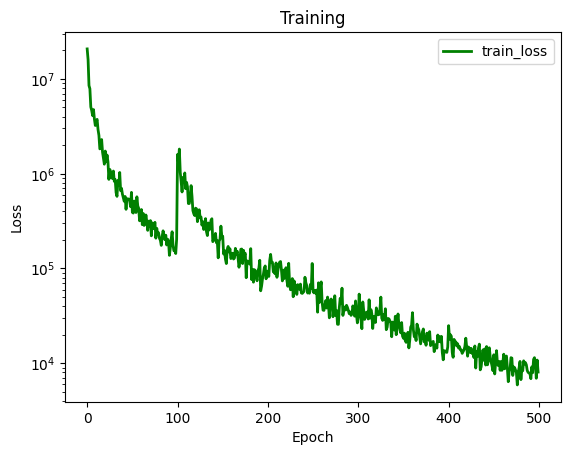

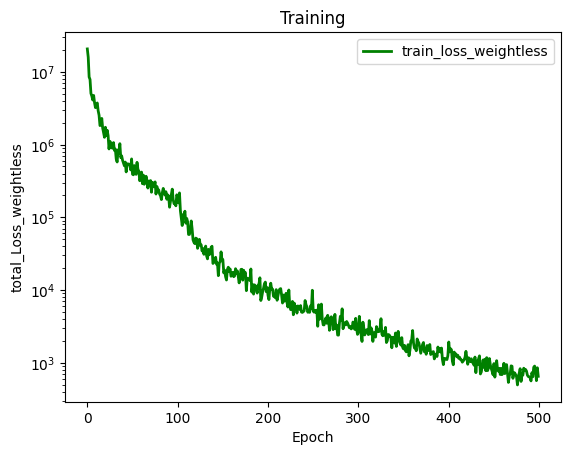

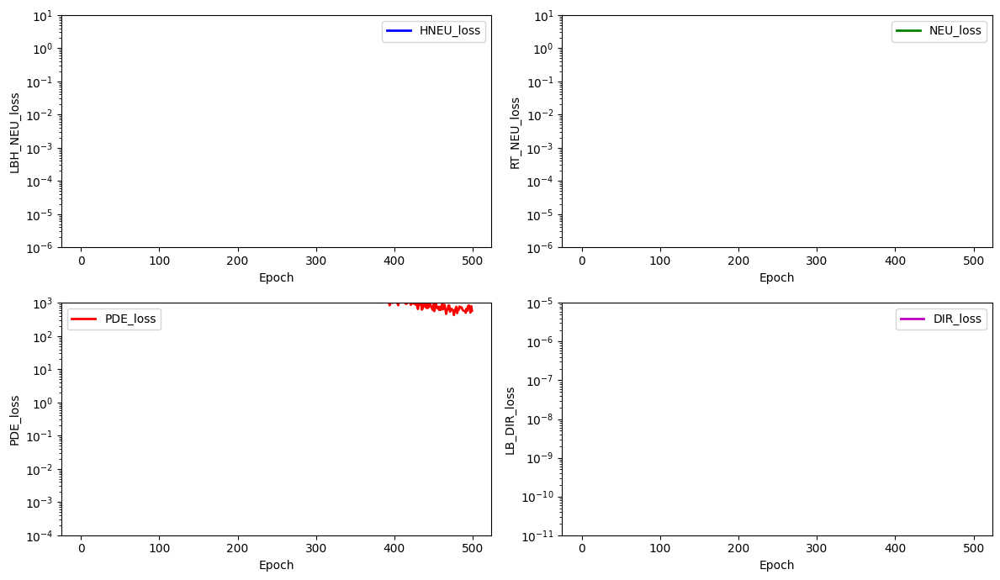

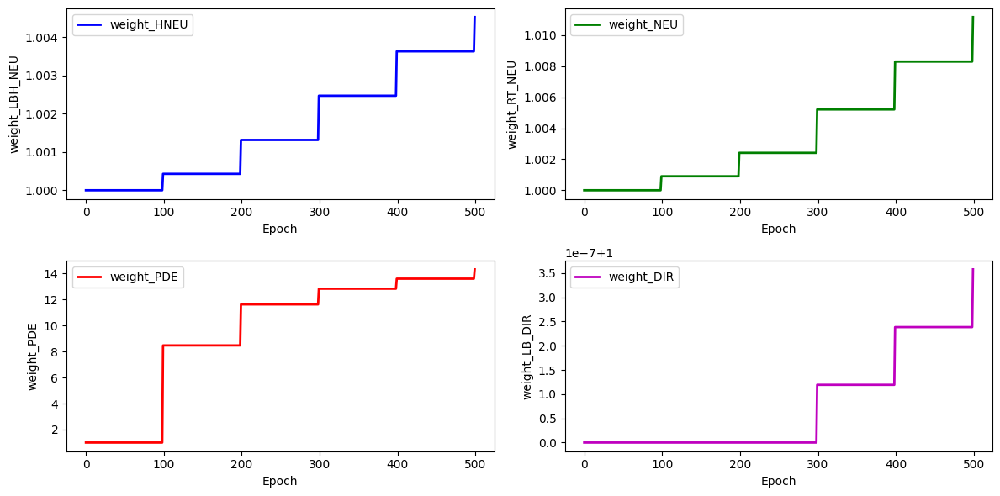

stress_Error for the stress_hole is: 28.178940174018337


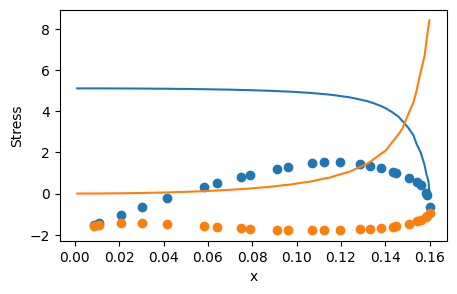

  4%|▍         | 600/15000 [03:55<1:39:23,  2.41it/s]

for weight 0 norm_grad: 1104.0831298828125
for weight 0 new lamda dach: 1.0108360052108765
for weight 0 new lamdaloss norm: 1116.046875
for weight 1 norm_grad: 4187.61962890625
for weight 1 new lamda dach: 1.0423818826675415
for weight 1 new lamdaloss norm: 4365.0986328125
for weight 2 norm_grad: 97702.546875
for weight 2 new lamda dach: 19.46285629272461
for weight 2 new lamdaloss norm: 1901570.5
for weight 3 norm_grad: 0.14206461608409882
for weight 3 new lamda dach: 1.000001311302185
for weight 3 new lamdaloss norm: 0.14206479489803314
for weight 0 new weight_value: 1.005160927772522
for weight 1 new weight_value: 1.0142911672592163
for weight 2 new weight_value: 14.832232475280762
for weight 3 new weight_value: 1.0000003576278687


  5%|▍         | 700/15000 [04:35<1:40:23,  2.37it/s]

for weight 0 norm_grad: 765.81298828125
for weight 0 new lamda dach: 1.0090422630310059
for weight 0 new lamdaloss norm: 772.7376708984375
for weight 1 norm_grad: 3626.06005859375
for weight 1 new lamda dach: 1.0443111658096313
for weight 1 new lamdaloss norm: 3786.73486328125
for weight 2 norm_grad: 81065.8984375
for weight 2 new lamda dach: 19.457693099975586
for weight 2 new lamdaloss norm: 1577355.375
for weight 3 norm_grad: 0.109005406498909
for weight 3 new lamda dach: 1.000001311302185
for weight 3 new lamdaloss norm: 0.10900555551052094
for weight 0 new weight_value: 1.0055489540100098
for weight 1 new weight_value: 1.017293095588684
for weight 2 new weight_value: 15.294777870178223
for weight 3 new weight_value: 1.0000003576278687


  5%|▌         | 800/15000 [05:15<1:40:49,  2.35it/s]

for weight 0 norm_grad: 566.5015258789062
for weight 0 new lamda dach: 1.0082355737686157
for weight 0 new lamdaloss norm: 571.1669921875
for weight 1 norm_grad: 3303.92333984375
for weight 1 new lamda dach: 1.050022006034851
for weight 1 new lamdaloss norm: 3469.1923828125
for weight 2 norm_grad: 65482.72265625
for weight 2 new lamda dach: 17.918363571166992
for weight 2 new lamdaloss norm: 1173343.25
for weight 3 norm_grad: 0.08377055078744888
for weight 3 new lamda dach: 1.0000011920928955
for weight 3 new lamdaloss norm: 0.08377064764499664
for weight 0 new weight_value: 1.0058175325393677
for weight 1 new weight_value: 1.0205659866333008
for weight 2 new weight_value: 15.557136535644531
for weight 3 new weight_value: 1.0000003576278687


  6%|▌         | 900/15000 [05:56<1:38:59,  2.37it/s]

for weight 0 norm_grad: 380.3164367675781
for weight 0 new lamda dach: 1.0077496767044067
for weight 0 new lamdaloss norm: 383.2637939453125
for weight 1 norm_grad: 3312.255615234375
for weight 1 new lamda dach: 1.0717824697494507
for weight 1 new lamdaloss norm: 3550.017578125
for weight 2 norm_grad: 45762.5703125
for weight 2 new lamda dach: 13.392938613891602
for weight 2 new lamdaloss norm: 612895.25
for weight 3 norm_grad: 0.061911243945360184
for weight 3 new lamda dach: 1.000001311302185
for weight 3 new lamdaloss norm: 0.06191132962703705
for weight 0 new weight_value: 1.0060107707977295
for weight 1 new weight_value: 1.025687575340271
for weight 2 new weight_value: 15.340716361999512
for weight 3 new weight_value: 1.0000003576278687


  7%|▋         | 999/15000 [06:35<1:32:36,  2.52it/s]

for weight 0 norm_grad: 306.92413330078125
for weight 0 new lamda dach: 1.0114576816558838
for weight 0 new lamdaloss norm: 310.4407958984375
for weight 1 norm_grad: 3259.447021484375
for weight 1 new lamda dach: 1.136749267578125
for weight 1 new lamdaloss norm: 3705.174072265625
for weight 2 norm_grad: 23528.232421875
for weight 2 new lamda dach: 7.597160816192627
for weight 2 new lamdaloss norm: 178747.78125
for weight 3 norm_grad: 0.04727353900671005
for weight 3 new lamda dach: 1.0000017881393433
for weight 3 new lamdaloss norm: 0.04727362468838692
for weight 0 new weight_value: 1.006555438041687
for weight 1 new weight_value: 1.0367937088012695
for weight 2 new weight_value: 14.566360473632812
for weight 3 new weight_value: 1.0000004768371582
total_loss: 45.39812469482422, hole_loss:  0.6019444465637207,neumann_loss:  17.196462631225586, pde_loss: 25.39580535888672,dirichlet_loss: 0.00010928425763268024


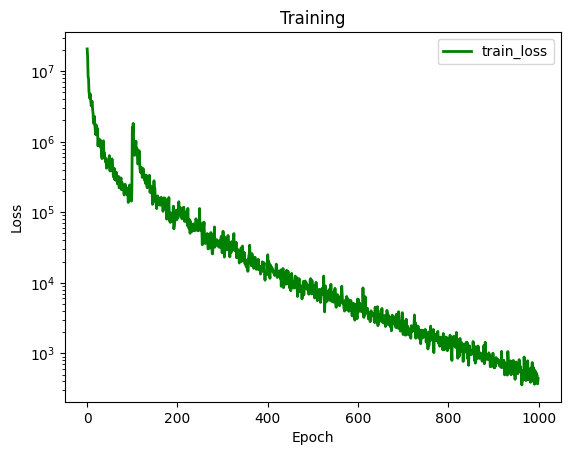

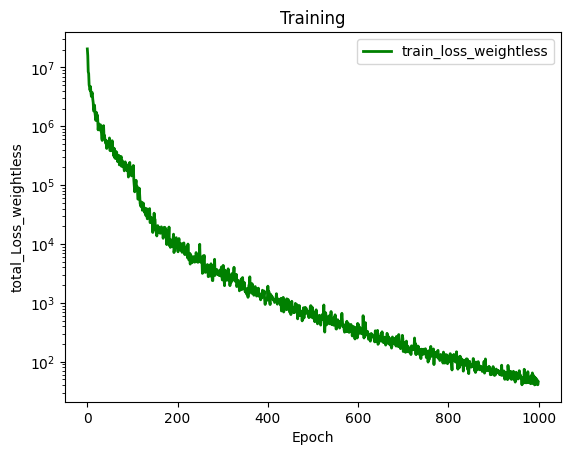

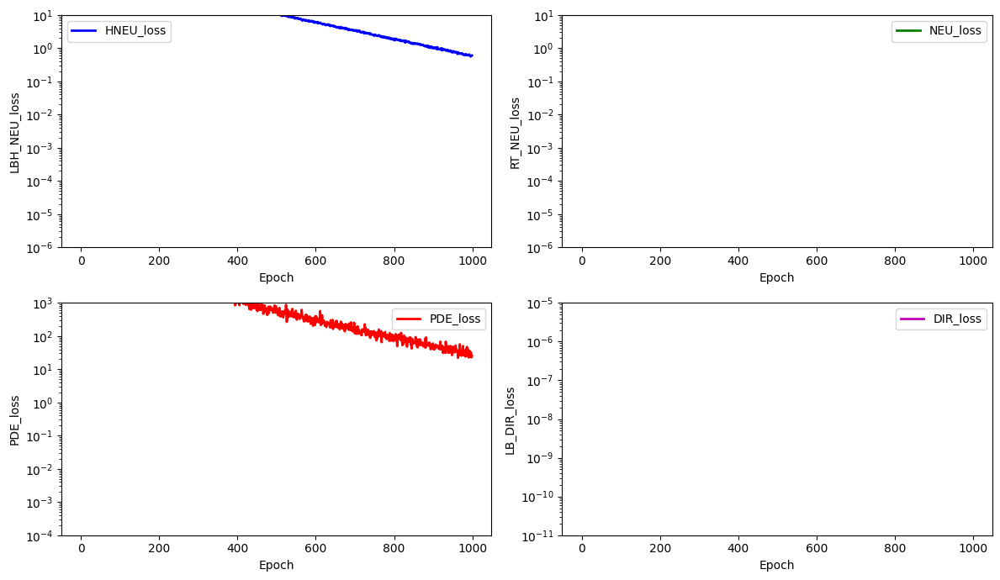

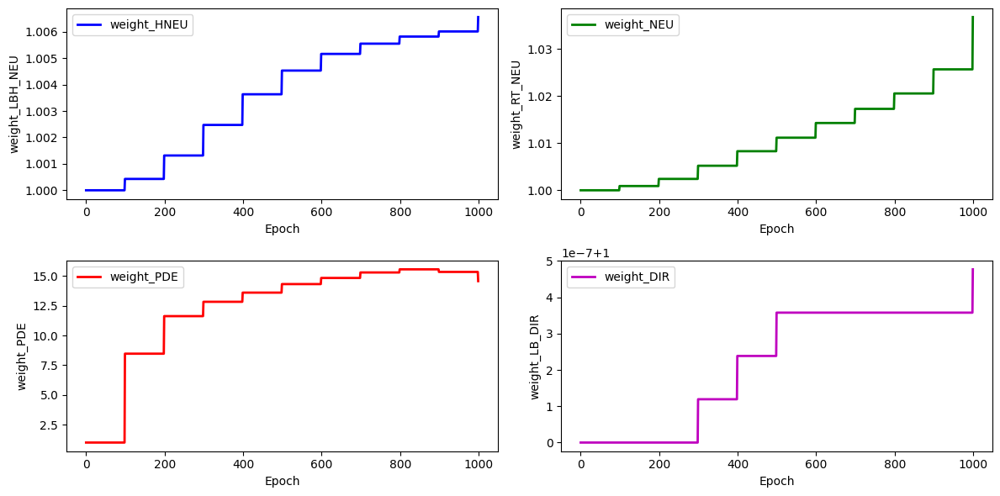

stress_Error for the stress_hole is: 23.720793706024132


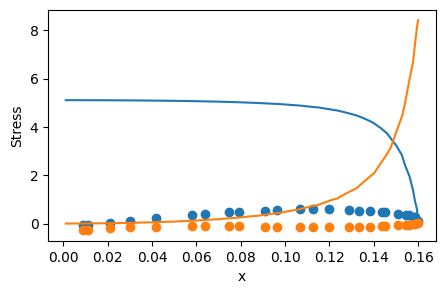

  7%|▋         | 1100/15000 [07:18<1:36:12,  2.41it/s]

for weight 0 norm_grad: 226.34275817871094
for weight 0 new lamda dach: 1.0105359554290771
for weight 0 new lamdaloss norm: 228.72750854492188
for weight 1 norm_grad: 3319.643310546875
for weight 1 new lamda dach: 1.1805187463760376
for weight 1 new lamdaloss norm: 3918.901611328125
for weight 2 norm_grad: 18163.078125
for weight 2 new lamda dach: 6.122100353240967
for weight 2 new lamdaloss norm: 111196.1796875
for weight 3 norm_grad: 0.03477698192000389
for weight 3 new lamda dach: 1.0000016689300537
for weight 3 new lamdaloss norm: 0.03477703779935837
for weight 0 new weight_value: 1.006953477859497
for weight 1 new weight_value: 1.0511661767959595
for weight 2 new weight_value: 13.72193431854248
for weight 3 new weight_value: 1.0000005960464478


  8%|▊         | 1200/15000 [07:59<1:33:45,  2.45it/s]

for weight 0 norm_grad: 175.66036987304688
for weight 0 new lamda dach: 1.0116302967071533
for weight 0 new lamdaloss norm: 177.70335388183594
for weight 1 norm_grad: 3373.14892578125
for weight 1 new lamda dach: 1.2833094596862793
for weight 1 new lamdaloss norm: 4328.7939453125
for weight 2 norm_grad: 11730.5458984375
for weight 2 new lamda dach: 4.305463790893555
for weight 2 new lamdaloss norm: 50505.4375
for weight 3 norm_grad: 0.025663550943136215
for weight 3 new lamda dach: 1.0000016689300537
for weight 3 new lamdaloss norm: 0.025663595646619797
for weight 0 new weight_value: 1.0074211359024048
for weight 1 new weight_value: 1.0743803977966309
for weight 2 new weight_value: 12.780287742614746
for weight 3 new weight_value: 1.0000007152557373


  9%|▊         | 1300/15000 [08:39<1:33:05,  2.45it/s]

for weight 0 norm_grad: 113.8653335571289
for weight 0 new lamda dach: 1.0070788860321045
for weight 0 new lamdaloss norm: 114.67138671875
for weight 1 norm_grad: 3417.640625
for weight 1 new lamda dach: 1.2673888206481934
for weight 1 new lamdaloss norm: 4331.47900390625
for weight 2 norm_grad: 12667.65234375
for weight 2 new lamda dach: 4.5870208740234375
for weight 2 new lamdaloss norm: 58106.79296875
for weight 3 norm_grad: 0.018531734123826027
for weight 3 new lamda dach: 1.0000011920928955
for weight 3 new lamdaloss norm: 0.018531756475567818
for weight 0 new weight_value: 1.0073869228363037
for weight 1 new weight_value: 1.0936812162399292
for weight 2 new weight_value: 11.960960388183594
for weight 3 new weight_value: 1.0000007152557373


  9%|▉         | 1400/15000 [09:20<1:37:22,  2.33it/s]

for weight 0 norm_grad: 68.83230590820312
for weight 0 new lamda dach: 1.005482792854309
for weight 0 new lamdaloss norm: 69.2096939086914
for weight 1 norm_grad: 3470.333984375
for weight 1 new lamda dach: 1.3791639804840088
for weight 1 new lamdaloss norm: 4786.1591796875
for weight 2 norm_grad: 9083.75
for weight 2 new lamda dach: 3.566627264022827
for weight 2 new lamdaloss norm: 32398.3515625
for weight 3 norm_grad: 0.011606891639530659
for weight 3 new lamda dach: 1.0000009536743164
for weight 3 new lamdaloss norm: 0.011606900952756405
for weight 0 new weight_value: 1.0071965456008911
for weight 1 new weight_value: 1.1222294569015503
for weight 2 new weight_value: 11.121526718139648
for weight 3 new weight_value: 1.0000007152557373


 10%|▉         | 1499/15000 [10:02<1:32:05,  2.44it/s]

for weight 0 norm_grad: 54.99485778808594
for weight 0 new lamda dach: 1.006108045578003
for weight 0 new lamdaloss norm: 55.33076858520508
for weight 1 norm_grad: 3482.4794921875
for weight 1 new lamda dach: 1.624516248703003
for weight 1 new lamdaloss norm: 5657.3447265625
for weight 2 norm_grad: 5521.28076171875
for weight 2 new lamda dach: 2.5607941150665283
for weight 2 new lamdaloss norm: 14138.86328125
for weight 3 norm_grad: 0.008092147298157215
for weight 3 new lamda dach: 1.0000008344650269
for weight 3 new lamdaloss norm: 0.008092153817415237
for weight 0 new weight_value: 1.0070877075195312
for weight 1 new weight_value: 1.1724580526351929
for weight 2 new weight_value: 10.265453338623047
for weight 3 new weight_value: 1.0000007152557373
total_loss: 19.973621368408203, hole_loss:  0.019003991037607193,neumann_loss:  18.714521408081055, pde_loss: 1.2086079120635986,dirichlet_loss: 3.7627771689585643e-06


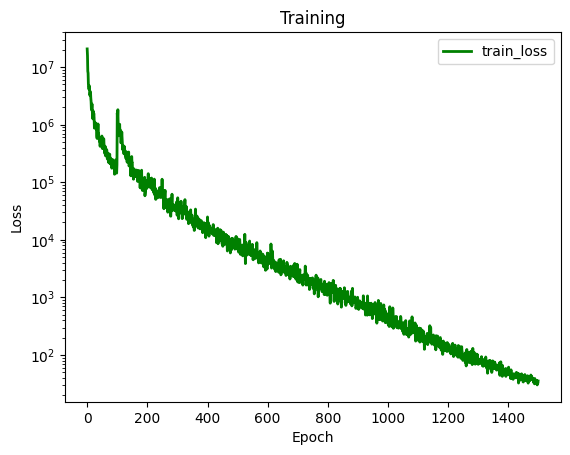

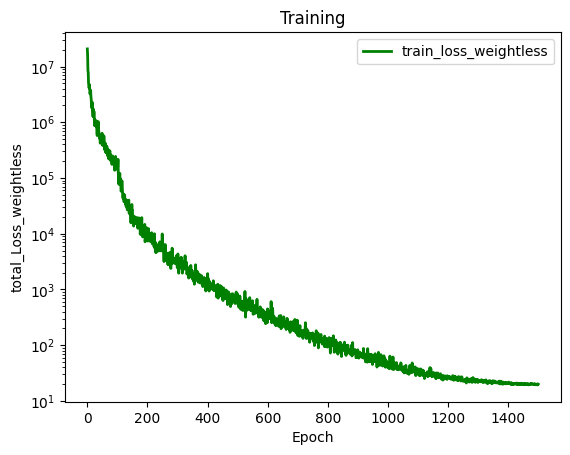

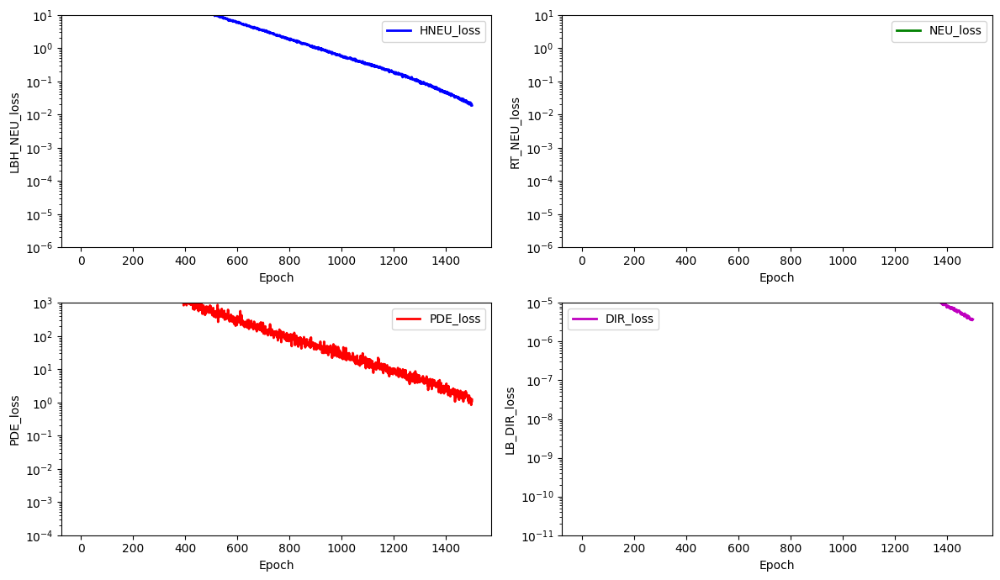

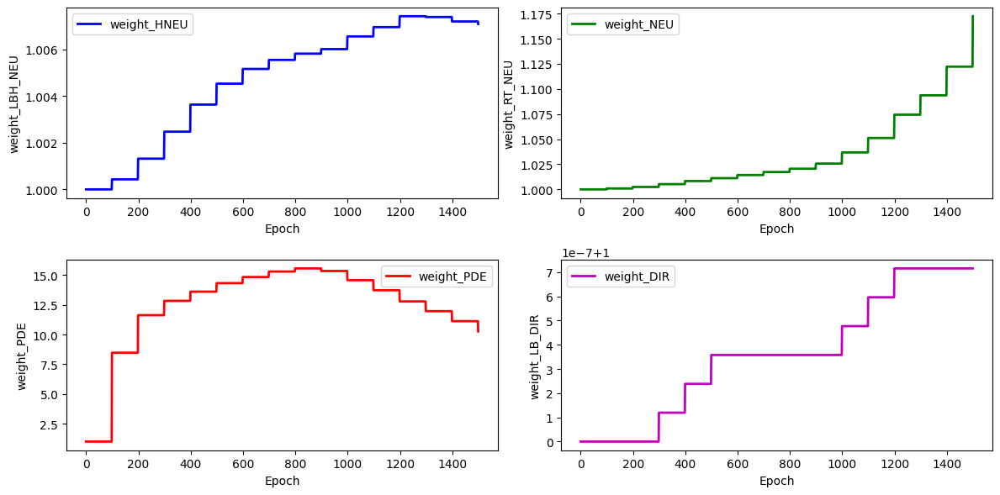

stress_Error for the stress_hole is: 26.092748755086753


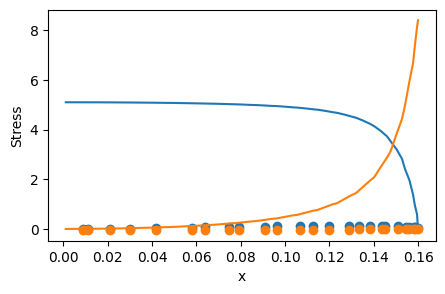

 11%|█         | 1600/15000 [10:44<1:30:19,  2.47it/s]

for weight 0 norm_grad: 33.520381927490234
for weight 0 new lamda dach: 1.0036669969558716
for weight 0 new lamdaloss norm: 33.6432991027832
for weight 1 norm_grad: 3505.952880859375
for weight 1 new lamda dach: 1.6184873580932617
for weight 1 new lamdaloss norm: 5674.34033203125
for weight 2 norm_grad: 5635.0673828125
for weight 2 new lamda dach: 2.5920615196228027
for weight 2 new lamdaloss norm: 14606.4404296875
for weight 3 norm_grad: 0.004927375353872776
for weight 3 new lamda dach: 1.0000004768371582
for weight 3 new lamdaloss norm: 0.004927377682179213
for weight 0 new weight_value: 1.0067455768585205
for weight 1 new weight_value: 1.2170610427856445
for weight 2 new weight_value: 9.498113632202148
for weight 3 new weight_value: 1.0000007152557373


 11%|█▏        | 1700/15000 [11:23<1:27:34,  2.53it/s]

for weight 0 norm_grad: 23.79947280883789
for weight 0 new lamda dach: 1.002855658531189
for weight 0 new lamdaloss norm: 23.8674373626709
for weight 1 norm_grad: 3540.11962890625
for weight 1 new lamda dach: 1.73476243019104
for weight 1 new lamdaloss norm: 6141.26708984375
for weight 2 norm_grad: 4794.24365234375
for weight 2 new lamda dach: 2.3452155590057373
for weight 2 new lamdaloss norm: 11243.5341796875
for weight 3 norm_grad: 0.0030275890603661537
for weight 3 new lamda dach: 1.0000003576278687
for weight 3 new lamdaloss norm: 0.003027590224519372
for weight 0 new weight_value: 1.0063565969467163
for weight 1 new weight_value: 1.2688311338424683
for weight 2 new weight_value: 8.78282356262207
for weight 3 new weight_value: 1.0000007152557373


 12%|█▏        | 1800/15000 [12:02<1:30:11,  2.44it/s]

for weight 0 norm_grad: 20.71469497680664
for weight 0 new lamda dach: 1.0011600255966187
for weight 0 new lamdaloss norm: 20.738725662231445
for weight 1 norm_grad: 3513.9833984375
for weight 1 new lamda dach: 1.2446529865264893
for weight 1 new lamdaloss norm: 4373.68994140625
for weight 2 norm_grad: 14342.4169921875
for weight 2 new lamda dach: 5.057604789733887
for weight 2 new lamdaloss norm: 72538.28125
for weight 3 norm_grad: 0.0025556725449860096
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.002555673010647297
for weight 0 new weight_value: 1.005836844444275
for weight 1 new weight_value: 1.2664133310317993
for weight 2 new weight_value: 8.410301208496094
for weight 3 new weight_value: 1.0000005960464478


 13%|█▎        | 1900/15000 [12:41<1:30:39,  2.41it/s]

for weight 0 norm_grad: 75.88844299316406
for weight 0 new lamda dach: 1.0031940937042236
for weight 0 new lamdaloss norm: 76.13084411621094
for weight 1 norm_grad: 3570.646484375
for weight 1 new lamda dach: 1.1762001514434814
for weight 1 new lamdaloss norm: 4199.794921875
for weight 2 norm_grad: 20188.82421875
for weight 2 new lamda dach: 6.536434173583984
for weight 2 new lamdaloss norm: 131962.921875
for weight 3 norm_grad: 0.0031896920409053564
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.003189692273736
for weight 0 new weight_value: 1.0055725574493408
for weight 1 new weight_value: 1.2573919296264648
for weight 2 new weight_value: 8.222914695739746
for weight 3 new weight_value: 1.0000004768371582


 13%|█▎        | 1999/15000 [13:20<1:26:21,  2.51it/s]

for weight 0 norm_grad: 13.01424789428711
for weight 0 new lamda dach: 1.0008574724197388
for weight 0 new lamdaloss norm: 13.025408744812012
for weight 1 norm_grad: 3563.219482421875
for weight 1 new lamda dach: 1.3064250946044922
for weight 1 new lamdaloss norm: 4655.07958984375
for weight 2 norm_grad: 11615.3388671875
for weight 2 new lamda dach: 4.247924327850342
for weight 2 new lamdaloss norm: 49341.078125
for weight 3 norm_grad: 0.0013015437871217728
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0013015440199524164
for weight 0 new weight_value: 1.0051010847091675
for weight 1 new weight_value: 1.2622952461242676
for weight 2 new weight_value: 7.825415134429932
for weight 3 new weight_value: 1.0000003576278687
total_loss: 20.308609008789062, hole_loss:  0.0008927559247240424,neumann_loss:  19.678346633911133, pde_loss: 0.5533512830734253,dirichlet_loss: 1.0134972683317756e-07


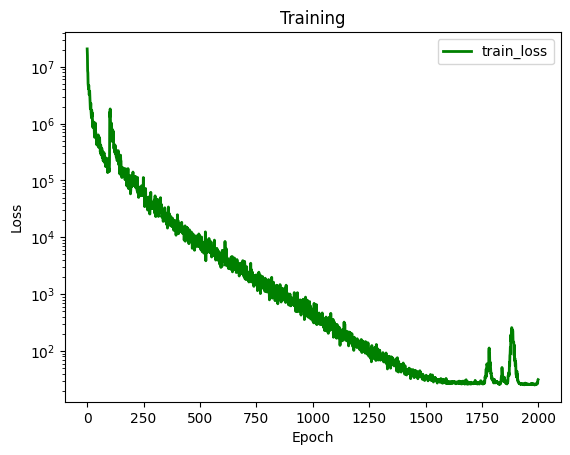

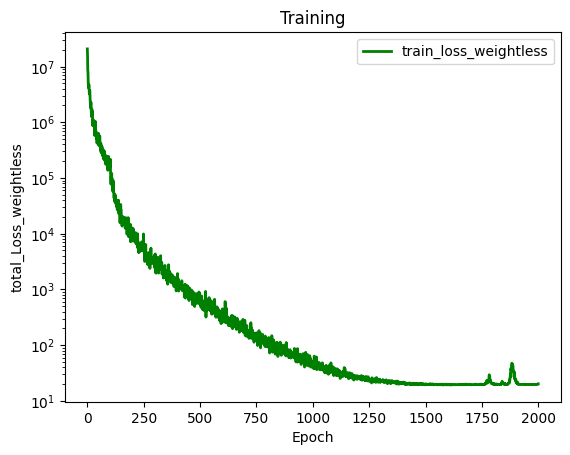

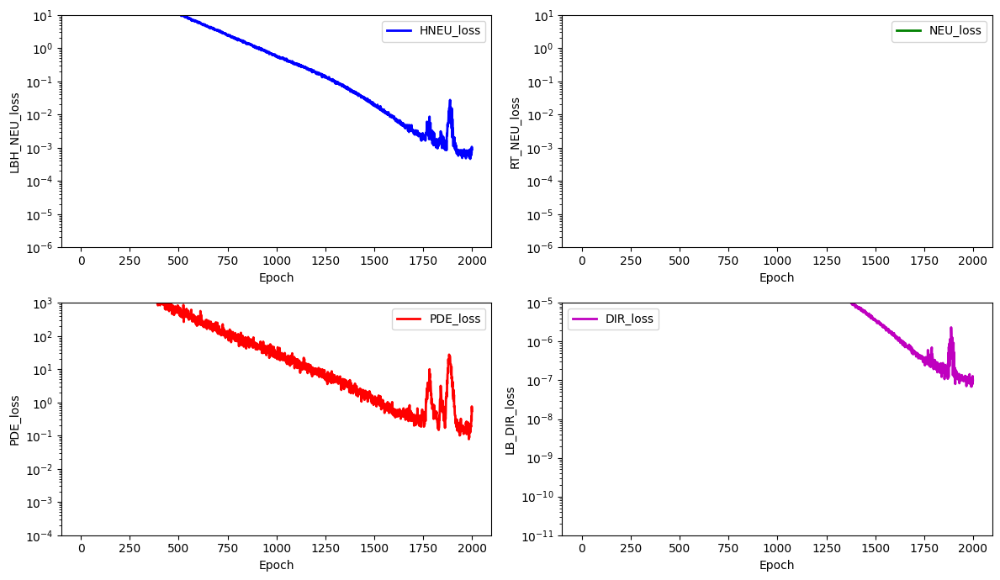

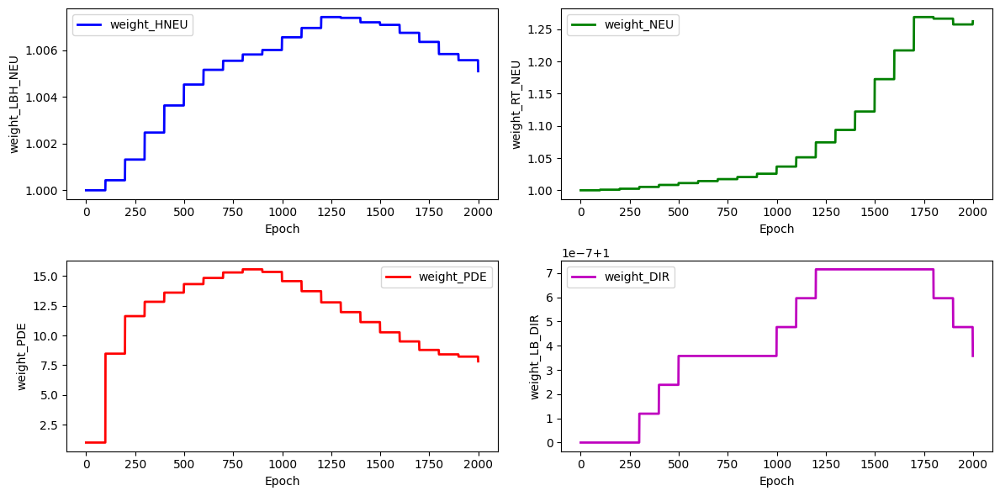

stress_Error for the stress_hole is: 26.57577985885268


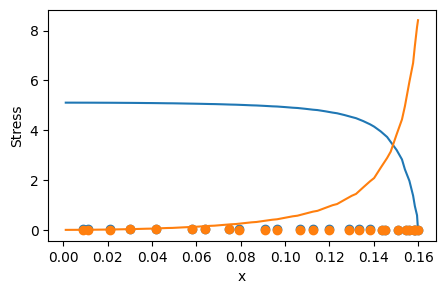

 14%|█▍        | 2100/15000 [14:02<1:27:07,  2.47it/s]

for weight 0 norm_grad: 28.406295776367188
for weight 0 new lamda dach: 1.0008208751678467
for weight 0 new lamdaloss norm: 28.429615020751953
for weight 1 norm_grad: 3526.387939453125
for weight 1 new lamda dach: 1.1133687496185303
for weight 1 new lamdaloss norm: 3926.169921875
for weight 2 norm_grad: 31077.0625
for weight 2 new lamda dach: 9.74229907989502
for weight 2 new lamdaloss norm: 302762.03125
for weight 3 norm_grad: 0.0019335494143888354
for weight 3 new lamda dach: 1.0
for weight 3 new lamdaloss norm: 0.0019335494143888354
for weight 0 new weight_value: 1.0046730041503906
for weight 1 new weight_value: 1.247402548789978
for weight 2 new weight_value: 8.01710319519043
for weight 3 new weight_value: 1.000000238418579


 15%|█▍        | 2200/15000 [14:41<1:26:12,  2.47it/s]

for weight 0 norm_grad: 24.927474975585938
for weight 0 new lamda dach: 1.001929521560669
for weight 0 new lamdaloss norm: 24.975574493408203
for weight 1 norm_grad: 3516.8310546875
for weight 1 new lamda dach: 1.3730354309082031
for weight 1 new lamdaloss norm: 4828.7333984375
for weight 2 norm_grad: 9402.6767578125
for weight 2 new lamda dach: 3.6548030376434326
for weight 2 new lamdaloss norm: 34364.9296875
for weight 3 norm_grad: 0.0017521840054541826
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0017521842382848263
for weight 0 new weight_value: 1.0043985843658447
for weight 1 new weight_value: 1.2599658966064453
for weight 2 new weight_value: 7.580873012542725
for weight 3 new weight_value: 1.000000238418579


 15%|█▌        | 2300/15000 [15:21<1:25:40,  2.47it/s]

for weight 0 norm_grad: 32.22642135620117
for weight 0 new lamda dach: 1.0016542673110962
for weight 0 new lamdaloss norm: 32.27973175048828
for weight 1 norm_grad: 3510.121337890625
for weight 1 new lamda dach: 1.219333529472351
for weight 1 new lamdaloss norm: 4280.00927734375
for weight 2 norm_grad: 15971.349609375
for weight 2 new lamda dach: 5.508687973022461
for weight 2 new lamdaloss norm: 87981.1796875
for weight 3 norm_grad: 0.0013675469672307372
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0013675472000613809
for weight 0 new weight_value: 1.0041241645812988
for weight 1 new weight_value: 1.255902647972107
for weight 2 new weight_value: 7.373654365539551
for weight 3 new weight_value: 1.000000238418579


 16%|█▌        | 2400/15000 [16:00<1:24:45,  2.48it/s]

for weight 0 norm_grad: 7.722789764404297
for weight 0 new lamda dach: 1.000590205192566
for weight 0 new lamdaloss norm: 7.727348327636719
for weight 1 norm_grad: 3509.915771484375
for weight 1 new lamda dach: 1.366262674331665
for weight 1 new lamdaloss norm: 4795.46728515625
for weight 2 norm_grad: 9575.33203125
for weight 2 new lamda dach: 3.722090005874634
for weight 2 new lamdaloss norm: 35640.25
for weight 3 norm_grad: 0.0009757609805092216
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0009757610969245434
for weight 0 new weight_value: 1.0037707090377808
for weight 1 new weight_value: 1.26693856716156
for weight 2 new weight_value: 7.008497714996338
for weight 3 new weight_value: 1.000000238418579


 17%|█▋        | 2499/15000 [16:39<1:21:55,  2.54it/s]

for weight 0 norm_grad: 21.593597412109375
for weight 0 new lamda dach: 1.0016101598739624
for weight 0 new lamdaloss norm: 21.628366470336914
for weight 1 norm_grad: 3520.91748046875
for weight 1 new lamda dach: 1.3552453517913818
for weight 1 new lamdaloss norm: 4771.70654296875
for weight 2 norm_grad: 9889.6357421875
for weight 2 new lamda dach: 3.791700839996338
for weight 2 new lamdaloss norm: 37498.5390625
for weight 3 norm_grad: 0.0021721660159528255
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.002172166248783469
for weight 0 new weight_value: 1.0035545825958252
for weight 1 new weight_value: 1.2757692337036133
for weight 2 new weight_value: 6.686817646026611
for weight 3 new weight_value: 1.000000238418579
total_loss: 20.703277587890625, hole_loss:  0.0016222459962591529,neumann_loss:  19.358366012573242, pde_loss: 1.0233856439590454,dirichlet_loss: 2.2133690436021425e-07


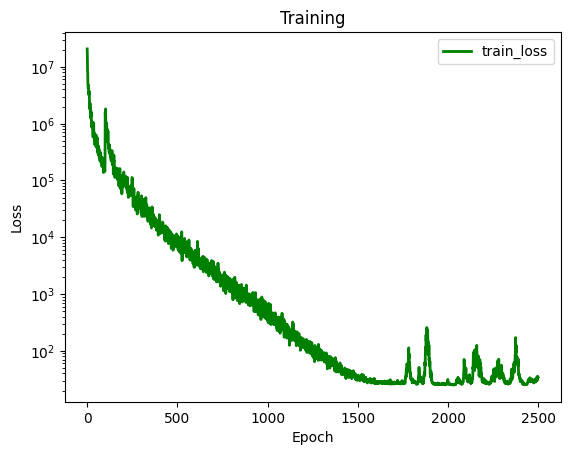

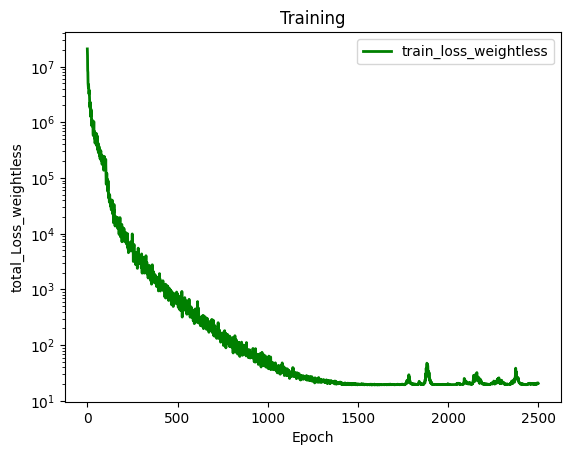

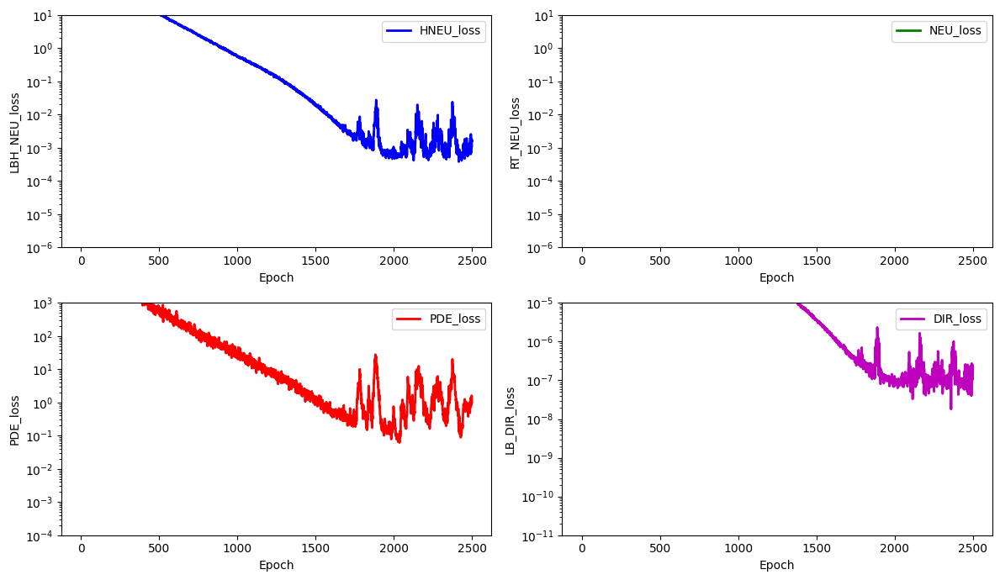

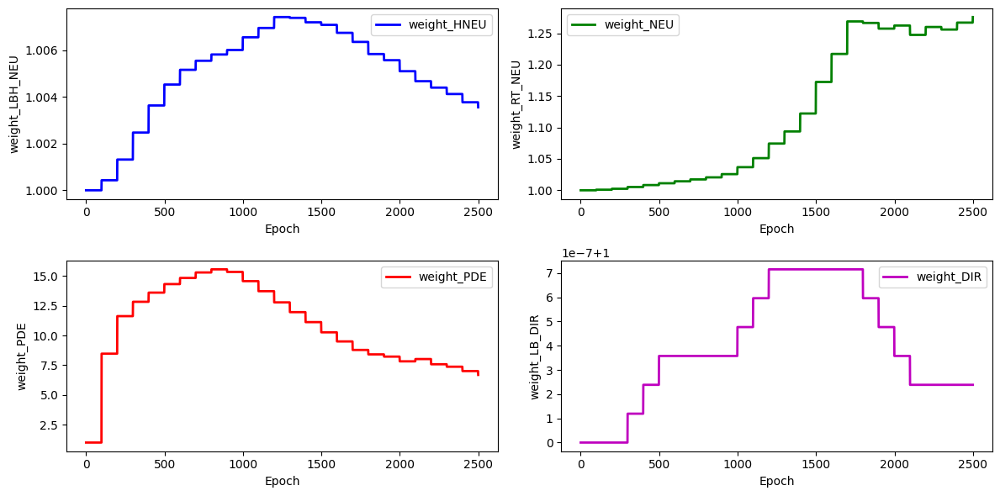

stress_Error for the stress_hole is: 26.555697382728614


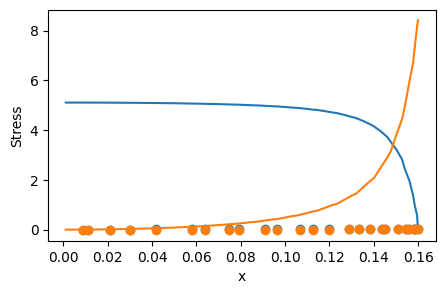

 17%|█▋        | 2600/15000 [17:21<1:23:51,  2.46it/s]

for weight 0 norm_grad: 33.7252197265625
for weight 0 new lamda dach: 1.000980019569397
for weight 0 new lamdaloss norm: 33.758270263671875
for weight 1 norm_grad: 3532.2451171875
for weight 1 new lamda dach: 1.1142593622207642
for weight 1 new lamdaloss norm: 3935.83740234375
for weight 2 norm_grad: 30880.5546875
for weight 2 new lamda dach: 9.659784317016602
for weight 2 new lamdaloss norm: 298299.53125
for weight 3 norm_grad: 0.004455517046153545
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.004455517511814833
for weight 0 new weight_value: 1.0032970905303955
for weight 1 new weight_value: 1.2596182823181152
for weight 2 new weight_value: 6.984114170074463
for weight 3 new weight_value: 1.000000238418579


 18%|█▊        | 2700/15000 [18:01<1:23:56,  2.44it/s]

for weight 0 norm_grad: 29.651031494140625
for weight 0 new lamda dach: 1.0010292530059814
for weight 0 new lamdaloss norm: 29.681547164916992
for weight 1 norm_grad: 3513.4072265625
for weight 1 new lamda dach: 1.1387368440628052
for weight 1 new lamdaloss norm: 4000.84619140625
for weight 2 norm_grad: 25294.6015625
for weight 2 new lamda dach: 8.139191627502441
for weight 2 new lamdaloss norm: 205877.609375
for weight 3 norm_grad: 0.0029670745134353638
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0029670747462660074
for weight 0 new weight_value: 1.0030702352523804
for weight 1 new weight_value: 1.2475301027297974
for weight 2 new weight_value: 7.099621772766113
for weight 3 new weight_value: 1.000000238418579


 19%|█▊        | 2800/15000 [18:40<1:23:05,  2.45it/s]

for weight 0 norm_grad: 14.994117736816406
for weight 0 new lamda dach: 1.000880479812622
for weight 0 new lamdaloss norm: 15.007319450378418
for weight 1 norm_grad: 3609.42626953125
for weight 1 new lamda dach: 1.2686421871185303
for weight 1 new lamdaloss norm: 4579.0703125
for weight 2 norm_grad: 13420.810546875
for weight 2 new lamda dach: 4.702881336212158
for weight 2 new lamdaloss norm: 63116.484375
for weight 3 norm_grad: 0.0030903418082743883
for weight 3 new lamda dach: 1.000000238418579
for weight 3 new lamdaloss norm: 0.0030903425067663193
for weight 0 new weight_value: 1.0028512477874756
for weight 1 new weight_value: 1.2496412992477417
for weight 2 new weight_value: 6.859947681427002
for weight 3 new weight_value: 1.000000238418579


 19%|█▉        | 2900/15000 [19:19<1:22:41,  2.44it/s]

for weight 0 norm_grad: 34.379512786865234
for weight 0 new lamda dach: 1.0017868280410767
for weight 0 new lamdaloss norm: 34.440940856933594
for weight 1 norm_grad: 3594.305419921875
for weight 1 new lamda dach: 1.2292158603668213
for weight 1 new lamdaloss norm: 4418.17724609375
for weight 2 norm_grad: 15646.49609375
for weight 2 new lamda dach: 5.311888694763184
for weight 2 new lamdaloss norm: 83112.453125
for weight 3 norm_grad: 0.0014236918650567532
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0014236920978873968
for weight 0 new weight_value: 1.0027447938919067
for weight 1 new weight_value: 1.2475987672805786
for weight 2 new weight_value: 6.705141544342041
for weight 3 new weight_value: 1.000000238418579


 20%|█▉        | 2999/15000 [19:58<1:19:19,  2.52it/s]

for weight 0 norm_grad: 9.047484397888184
for weight 0 new lamda dach: 1.0006356239318848
for weight 0 new lamdaloss norm: 9.053235054016113
for weight 1 norm_grad: 3525.267333984375
for weight 1 new lamda dach: 1.3288782835006714
for weight 1 new lamdaloss norm: 4684.65087890625
for weight 2 norm_grad: 10710.0166015625
for weight 2 new lamda dach: 4.030292987823486
for weight 2 new lamdaloss norm: 43164.50390625
for weight 3 norm_grad: 0.0024979813024401665
for weight 3 new lamda dach: 1.000000238418579
for weight 3 new lamdaloss norm: 0.0024979820009320974
for weight 0 new weight_value: 1.0025339126586914
for weight 1 new weight_value: 1.25572669506073
for weight 2 new weight_value: 6.437656879425049
for weight 3 new weight_value: 1.000000238418579
total_loss: 20.590347290039062, hole_loss:  0.0005844982224516571,neumann_loss:  19.46143341064453, pde_loss: 1.13690185546875,dirichlet_loss: 2.3217890543492103e-07


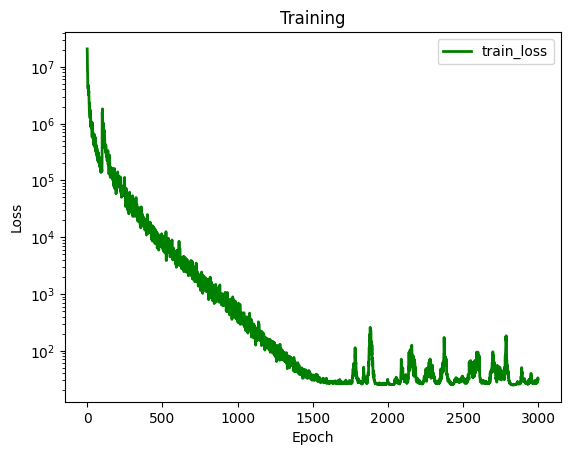

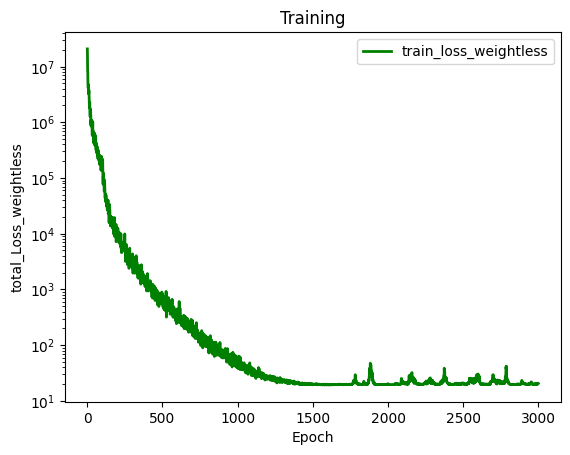

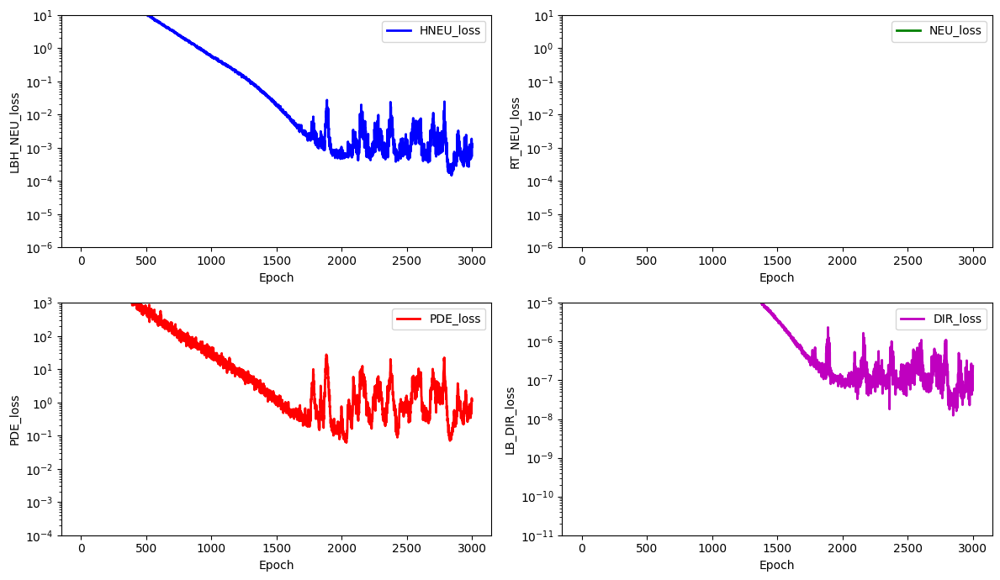

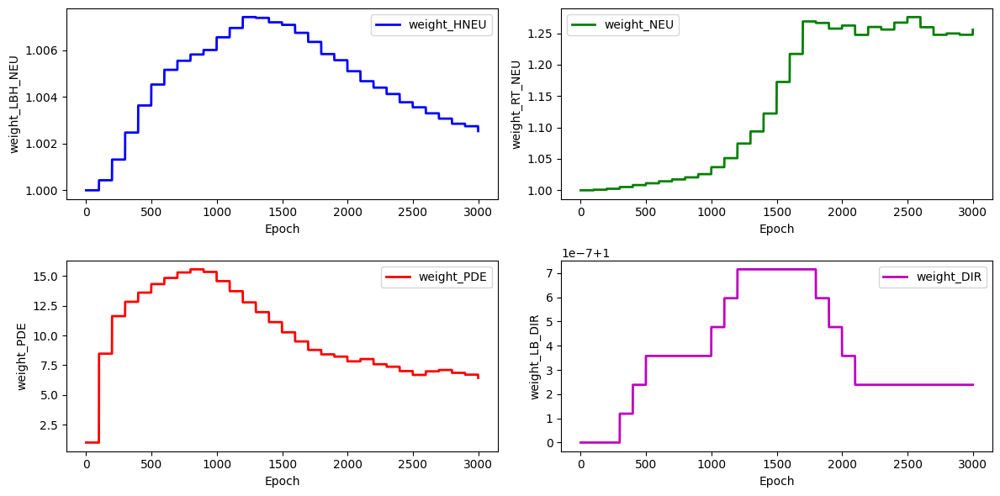

stress_Error for the stress_hole is: 26.523074754489393


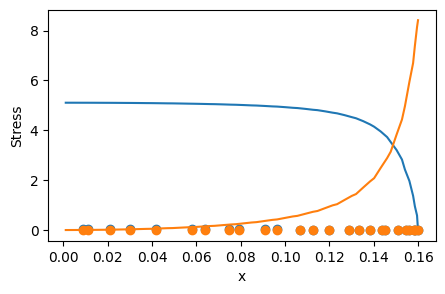

 21%|██        | 3100/15000 [20:41<1:20:37,  2.46it/s]

for weight 0 norm_grad: 5.997951984405518
for weight 0 new lamda dach: 1.0006945133209229
for weight 0 new lamdaloss norm: 6.00211763381958
for weight 1 norm_grad: 3530.777587890625
for weight 1 new lamda dach: 1.6908105611801147
for weight 1 new lamdaloss norm: 5969.8759765625
for weight 2 norm_grad: 5105.06494140625
for weight 2 new lamda dach: 2.44342303276062
for weight 2 new lamdaloss norm: 12473.8349609375
for weight 3 norm_grad: 0.0005620516021735966
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0005620516603812575
for weight 0 new weight_value: 1.0023499727249146
for weight 1 new weight_value: 1.2992351055145264
for weight 2 new weight_value: 6.038233280181885
for weight 3 new weight_value: 1.000000238418579


 21%|██▏       | 3200/15000 [21:20<1:19:52,  2.46it/s]

for weight 0 norm_grad: 6.517636775970459
for weight 0 new lamda dach: 1.000775933265686
for weight 0 new lamdaloss norm: 6.522694110870361
for weight 1 norm_grad: 3553.85400390625
for weight 1 new lamda dach: 1.7323496341705322
for weight 1 new lamdaloss norm: 6156.51806640625
for weight 2 norm_grad: 4846.15576171875
for weight 2 new lamda dach: 2.3611371517181396
for weight 2 new lamdaloss norm: 11442.4404296875
for weight 3 norm_grad: 0.0014488702872768044
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.001448870520107448
for weight 0 new weight_value: 1.002192497253418
for weight 1 new weight_value: 1.3425464630126953
for weight 2 new weight_value: 5.670523166656494
for weight 3 new weight_value: 1.000000238418579


 22%|██▏       | 3300/15000 [21:59<1:18:57,  2.47it/s]

for weight 0 norm_grad: 45.171260833740234
for weight 0 new lamda dach: 1.0019794702529907
for weight 0 new lamdaloss norm: 45.260677337646484
for weight 1 norm_grad: 3562.651611328125
for weight 1 new lamda dach: 1.1845680475234985
for weight 1 new lamdaloss norm: 4220.20361328125
for weight 2 norm_grad: 19257.48046875
for weight 2 new lamda dach: 6.3376994132995605
for weight 2 new lamdaloss norm: 122048.1171875
for weight 3 norm_grad: 0.0011692921398207545
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0011692923726513982
for weight 0 new weight_value: 1.0021711587905884
for weight 1 new weight_value: 1.3267486095428467
for weight 2 new weight_value: 5.737240791320801
for weight 3 new weight_value: 1.000000238418579


 23%|██▎       | 3400/15000 [22:39<1:20:04,  2.41it/s]

for weight 0 norm_grad: 16.15485191345215
for weight 0 new lamda dach: 1.001261591911316
for weight 0 new lamdaloss norm: 16.17523193359375
for weight 1 norm_grad: 3610.8310546875
for weight 1 new lamda dach: 1.3920046091079712
for weight 1 new lamdaloss norm: 5026.29296875
for weight 2 norm_grad: 9195.0390625
for weight 2 new lamda dach: 3.535172700881958
for weight 2 new lamdaloss norm: 32506.048828125
for weight 3 norm_grad: 0.0013148486614227295
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0013148488942533731
for weight 0 new weight_value: 1.0020802021026611
for weight 1 new weight_value: 1.3332741260528564
for weight 2 new weight_value: 5.517033576965332
for weight 3 new weight_value: 1.000000238418579


 23%|██▎       | 3499/15000 [23:18<1:15:36,  2.54it/s]

for weight 0 norm_grad: 23.401174545288086
for weight 0 new lamda dach: 1.0018326044082642
for weight 0 new lamdaloss norm: 23.444061279296875
for weight 1 norm_grad: 3582.21142578125
for weight 1 new lamda dach: 1.3889198303222656
for weight 1 new lamdaloss norm: 4975.404296875
for weight 2 norm_grad: 9187.267578125
for weight 2 new lamda dach: 3.5480451583862305
for weight 2 new lamdaloss norm: 32596.837890625
for weight 3 norm_grad: 0.0022957196924835443
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0022957201581448317
for weight 0 new weight_value: 1.0020554065704346
for weight 1 new weight_value: 1.3388385772705078
for weight 2 new weight_value: 5.32013463973999
for weight 3 new weight_value: 1.000000238418579
total_loss: 19.418895721435547, hole_loss:  0.0025090258568525314,neumann_loss:  18.59751319885254, pde_loss: 1.019111156463623,dirichlet_loss: 2.7719548256754933e-07


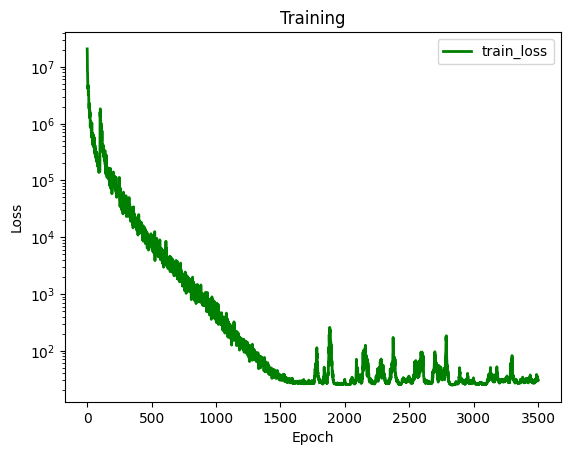

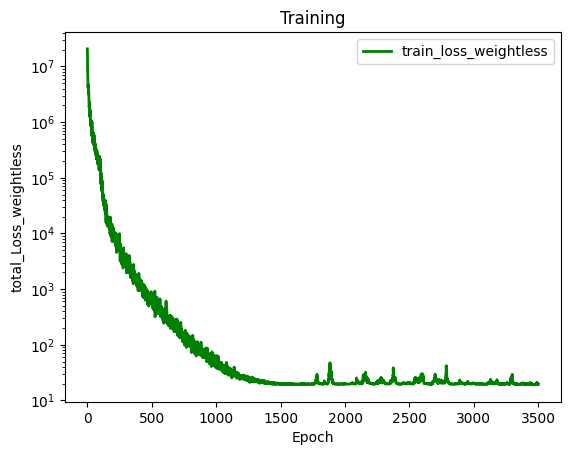

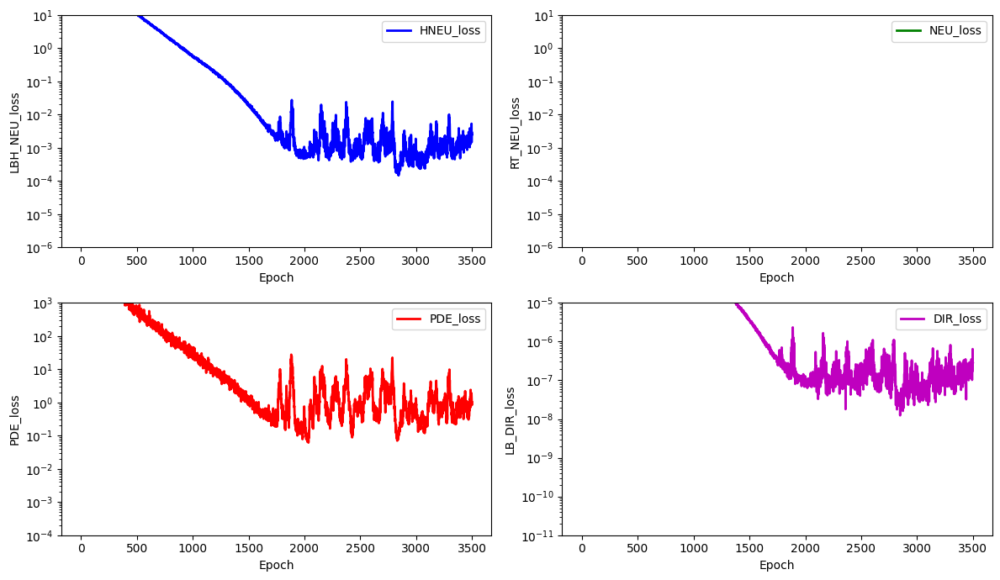

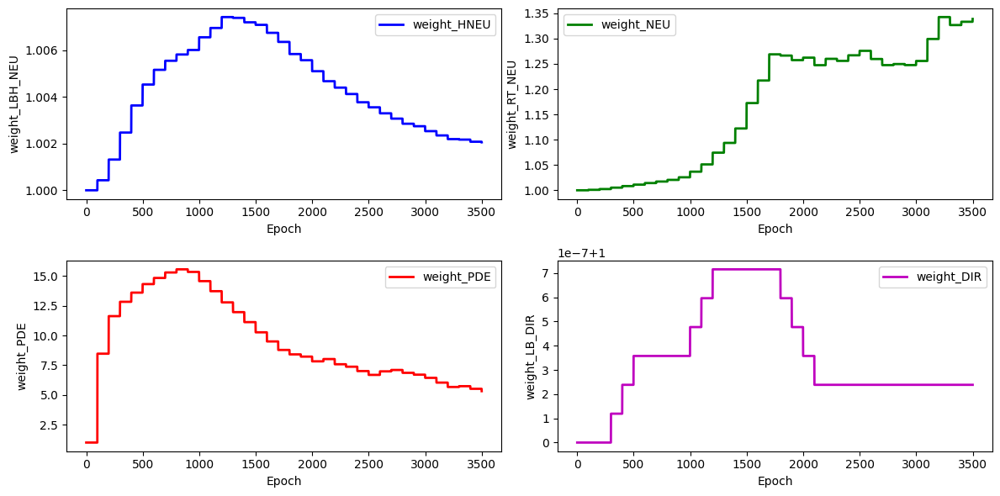

stress_Error for the stress_hole is: 26.363512530462025


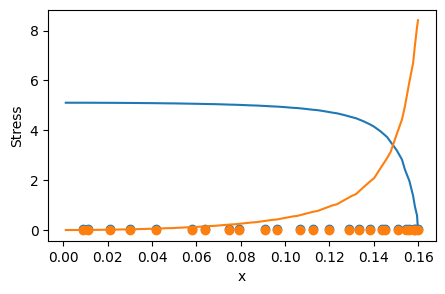

 24%|██▍       | 3600/15000 [24:01<1:19:42,  2.38it/s]

for weight 0 norm_grad: 19.690322875976562
for weight 0 new lamda dach: 1.0015019178390503
for weight 0 new lamdaloss norm: 19.719898223876953
for weight 1 norm_grad: 3606.7529296875
for weight 1 new lamda dach: 1.3787245750427246
for weight 1 new lamdaloss norm: 4972.71923828125
for weight 2 norm_grad: 9503.728515625
for weight 2 new lamda dach: 3.6206741333007812
for weight 2 new lamdaloss norm: 34409.90234375
for weight 3 norm_grad: 0.0012875613756477833
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.001287561492063105
for weight 0 new weight_value: 1.002000093460083
for weight 1 new weight_value: 1.3428272008895874
for weight 2 new weight_value: 5.150188446044922
for weight 3 new weight_value: 1.000000238418579


 25%|██▍       | 3700/15000 [24:42<1:18:21,  2.40it/s]

for weight 0 norm_grad: 29.962560653686523
for weight 0 new lamda dach: 1.0022743940353394
for weight 0 new lamdaloss norm: 30.03070831298828
for weight 1 norm_grad: 3700.8037109375
for weight 1 new lamda dach: 1.3894383907318115
for weight 1 new lamdaloss norm: 5142.03955078125
for weight 2 norm_grad: 9472.9580078125
for weight 2 new lamda dach: 3.539142608642578
for weight 2 new lamdaloss norm: 33526.1484375
for weight 3 norm_grad: 0.0038348957896232605
for weight 3 new lamda dach: 1.000000238418579
for weight 3 new lamdaloss norm: 0.003834896720945835
for weight 0 new weight_value: 1.0020275115966797
for weight 1 new weight_value: 1.347488284111023
for weight 2 new weight_value: 4.989083766937256
for weight 3 new weight_value: 1.000000238418579


 25%|██▌       | 3800/15000 [25:22<1:15:46,  2.46it/s]

for weight 0 norm_grad: 20.110515594482422
for weight 0 new lamda dach: 1.0027413368225098
for weight 0 new lamdaloss norm: 20.165645599365234
for weight 1 norm_grad: 3778.9169921875
for weight 1 new lamda dach: 2.056356191635132
for weight 1 new lamdaloss norm: 7770.79833984375
for weight 2 norm_grad: 3557.199462890625
for weight 2 new lamda dach: 1.9363439083099365
for weight 2 new lamdaloss norm: 6887.96142578125
for weight 3 norm_grad: 0.0035845732782036066
for weight 3 new lamda dach: 1.0000004768371582
for weight 3 new lamdaloss norm: 0.003584575140848756
for weight 0 new weight_value: 1.002098798751831
for weight 1 new weight_value: 1.4183751344680786
for weight 2 new weight_value: 4.683809757232666
for weight 3 new weight_value: 1.000000238418579


 26%|██▌       | 3900/15000 [26:01<1:13:38,  2.51it/s]

for weight 0 norm_grad: 17.545896530151367
for weight 0 new lamda dach: 1.001394510269165
for weight 0 new lamdaloss norm: 17.57036590576172
for weight 1 norm_grad: 3845.183349609375
for weight 1 new lamda dach: 1.439226508140564
for weight 1 new lamdaloss norm: 5534.08984375
for weight 2 norm_grad: 8736.8935546875
for weight 2 new lamda dach: 3.261842727661133
for weight 2 new lamdaloss norm: 28498.373046875
for weight 3 norm_grad: 0.003203342901542783
for weight 3 new lamda dach: 1.000000238418579
for weight 3 new lamdaloss norm: 0.0032033436000347137
for weight 0 new weight_value: 1.0020283460617065
for weight 1 new weight_value: 1.4204602241516113
for weight 2 new weight_value: 4.5416131019592285
for weight 3 new weight_value: 1.000000238418579


 27%|██▋       | 3999/15000 [26:40<1:11:46,  2.55it/s]

for weight 0 norm_grad: 30.201404571533203
for weight 0 new lamda dach: 1.002581000328064
for weight 0 new lamdaloss norm: 30.27935028076172
for weight 1 norm_grad: 3910.689453125
for weight 1 new lamda dach: 1.5000369548797607
for weight 1 new lamdaloss norm: 5866.1787109375
for weight 2 norm_grad: 7790.5966796875
for weight 2 new lamda dach: 2.9768600463867188
for weight 2 new lamdaloss norm: 23191.517578125
for weight 3 norm_grad: 0.0036023142747581005
for weight 3 new lamda dach: 1.0000003576278687
for weight 3 new lamdaloss norm: 0.0036023156717419624
for weight 0 new weight_value: 1.0020835399627686
for weight 1 new weight_value: 1.4284178018569946
for weight 2 new weight_value: 4.385137557983398
for weight 3 new weight_value: 1.000000238418579
total_loss: 16.436019897460938, hole_loss:  0.007253470830619335,neumann_loss:  15.10860824584961, pde_loss: 1.4096816778182983,dirichlet_loss: 6.68638790557452e-07


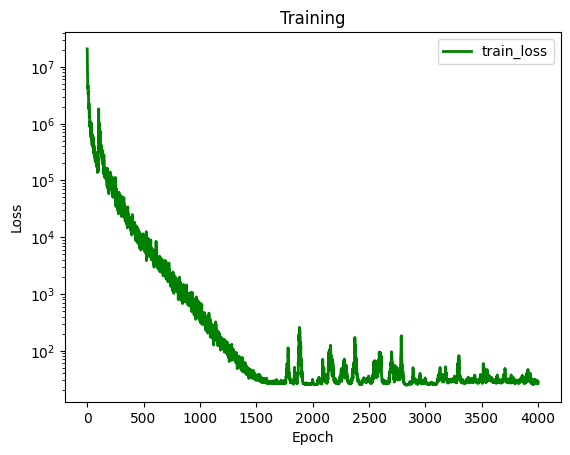

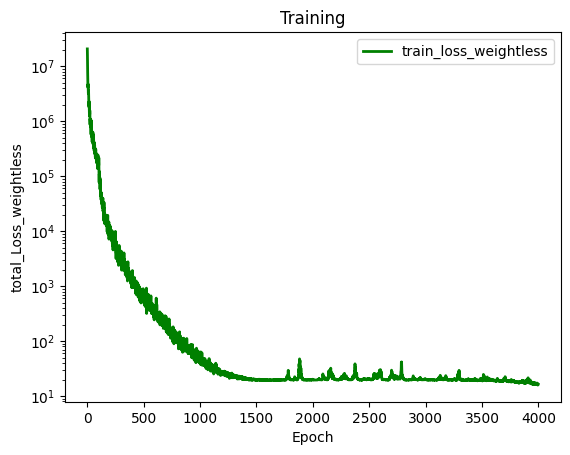

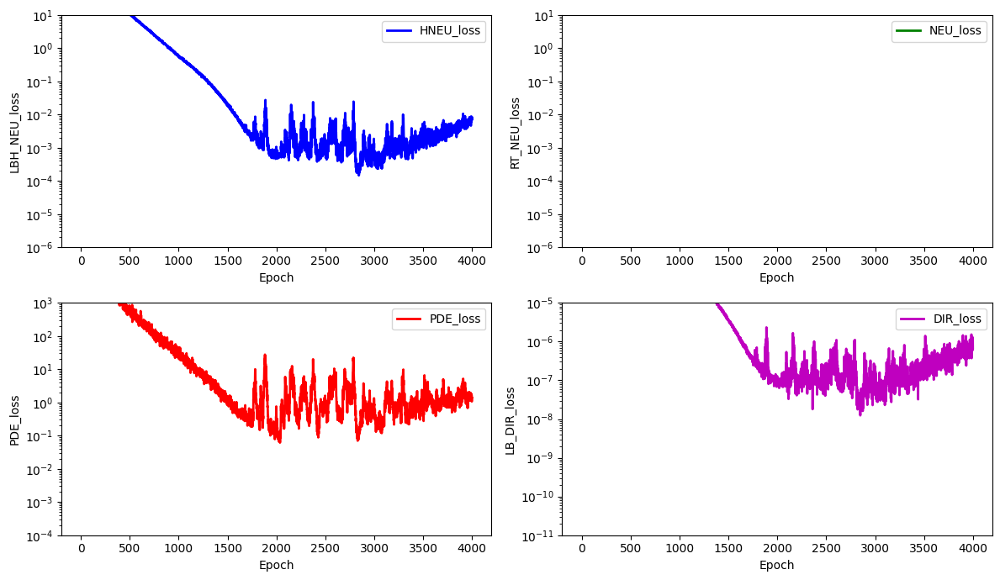

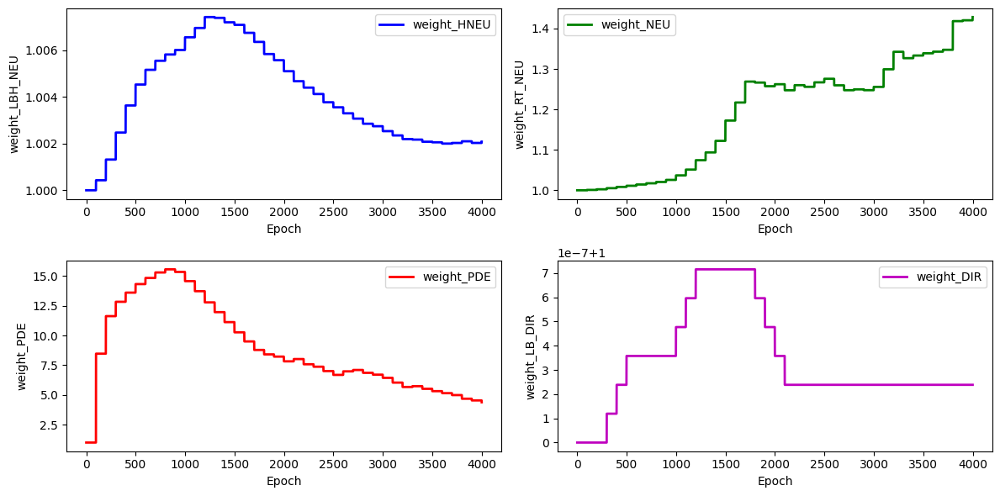

stress_Error for the stress_hole is: 26.072812800041884


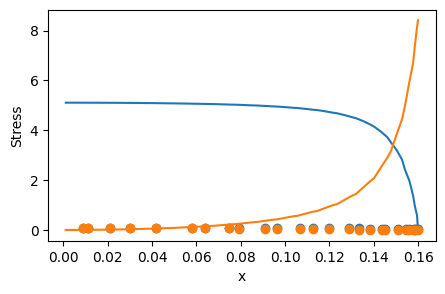

 27%|██▋       | 4100/15000 [27:23<1:10:20,  2.58it/s]

for weight 0 norm_grad: 30.275907516479492
for weight 0 new lamda dach: 1.0026003122329712
for weight 0 new lamdaloss norm: 30.354633331298828
for weight 1 norm_grad: 3805.8583984375
for weight 1 new lamda dach: 1.4837390184402466
for weight 1 new lamdaloss norm: 5646.900390625
for weight 2 norm_grad: 7837.30712890625
for weight 2 new lamda dach: 3.043020009994507
for weight 2 new lamdaloss norm: 23849.08203125
for weight 3 norm_grad: 0.0040269885212183
for weight 3 new lamda dach: 1.0000003576278687
for weight 3 new lamdaloss norm: 0.004026989918202162
for weight 0 new weight_value: 1.002135157585144
for weight 1 new weight_value: 1.4339499473571777
for weight 2 new weight_value: 4.2509260177612305
for weight 3 new weight_value: 1.000000238418579


 28%|██▊       | 4200/15000 [28:00<1:10:23,  2.56it/s]

for weight 0 norm_grad: 34.59466552734375
for weight 0 new lamda dach: 1.003515601158142
for weight 0 new lamdaloss norm: 34.71628952026367
for weight 1 norm_grad: 3634.95263671875
for weight 1 new lamda dach: 1.5825350284576416
for weight 1 new lamdaloss norm: 5752.439453125
for weight 2 norm_grad: 6205.287109375
for weight 2 new lamda dach: 2.6910200119018555
for weight 2 new lamdaloss norm: 16698.552734375
for weight 3 norm_grad: 0.00558331748470664
for weight 3 new lamda dach: 1.0000005960464478
for weight 3 new lamdaloss norm: 0.005583320744335651
for weight 0 new weight_value: 1.0022732019424438
for weight 1 new weight_value: 1.4488084316253662
for weight 2 new weight_value: 4.094935417175293
for weight 3 new weight_value: 1.000000238418579


 29%|██▊       | 4300/15000 [28:37<1:07:35,  2.64it/s]

for weight 0 norm_grad: 41.34025955200195
for weight 0 new lamda dach: 1.0044639110565186
for weight 0 new lamdaloss norm: 41.52479934692383
for weight 1 norm_grad: 3546.09765625
for weight 1 new lamda dach: 1.6160422563552856
for weight 1 new lamdaloss norm: 5730.64404296875
for weight 2 norm_grad: 5714.91259765625
for weight 2 new lamda dach: 2.5930328369140625
for weight 2 new lamdaloss norm: 14818.9560546875
for weight 3 norm_grad: 0.0041500274091959
for weight 3 new lamda dach: 1.0000004768371582
for weight 3 new lamdaloss norm: 0.0041500297375023365
for weight 0 new weight_value: 1.0024921894073486
for weight 1 new weight_value: 1.465531826019287
for weight 2 new weight_value: 3.9447450637817383
for weight 3 new weight_value: 1.000000238418579


 29%|██▉       | 4400/15000 [29:14<1:08:08,  2.59it/s]

for weight 0 norm_grad: 55.413360595703125
for weight 0 new lamda dach: 1.0067914724349976
for weight 0 new lamdaloss norm: 55.789695739746094
for weight 1 norm_grad: 3343.879150390625
for weight 1 new lamda dach: 1.686516523361206
for weight 1 new lamdaloss norm: 5639.5078125
for weight 2 norm_grad: 4815.37451171875
for weight 2 new lamda dach: 2.4165797233581543
for weight 2 new lamdaloss norm: 11636.7353515625
for weight 3 norm_grad: 0.004200603812932968
for weight 3 new lamda dach: 1.0000004768371582
for weight 3 new lamdaloss norm: 0.004200605675578117
for weight 0 new weight_value: 1.0029220581054688
for weight 1 new weight_value: 1.4876303672790527
for weight 2 new weight_value: 3.79192852973938
for weight 3 new weight_value: 1.000000238418579


 30%|██▉       | 4499/15000 [29:50<1:04:15,  2.72it/s]

for weight 0 norm_grad: 60.8254508972168
for weight 0 new lamda dach: 1.0096465349197388
for weight 0 new lamdaloss norm: 61.412208557128906
for weight 1 norm_grad: 3054.34912109375
for weight 1 new lamda dach: 1.9222203493118286
for weight 1 new lamdaloss norm: 5871.1318359375
for weight 2 norm_grad: 3251.121337890625
for weight 2 new lamda dach: 2.0436384677886963
for weight 2 new lamdaloss norm: 6644.11669921875
for weight 3 norm_grad: 0.004849824123084545
for weight 3 new lamda dach: 1.0000007152557373
for weight 3 new lamdaloss norm: 0.004849827848374844
for weight 0 new weight_value: 1.0035945177078247
for weight 1 new weight_value: 1.5310893058776855
for weight 2 new weight_value: 3.6170995235443115
for weight 3 new weight_value: 1.000000238418579
total_loss: 9.926003456115723, hole_loss:  0.05302375555038452,neumann_loss:  8.187274932861328, pde_loss: 1.3765556812286377,dirichlet_loss: 1.984064283533371e-06


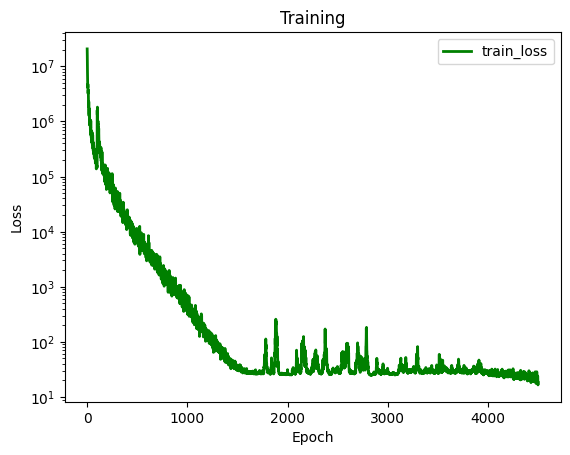

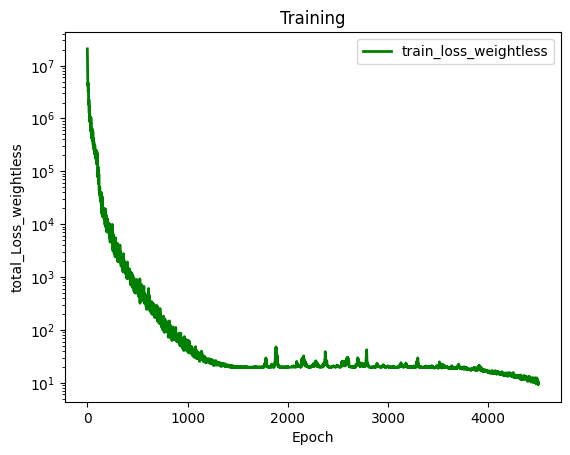

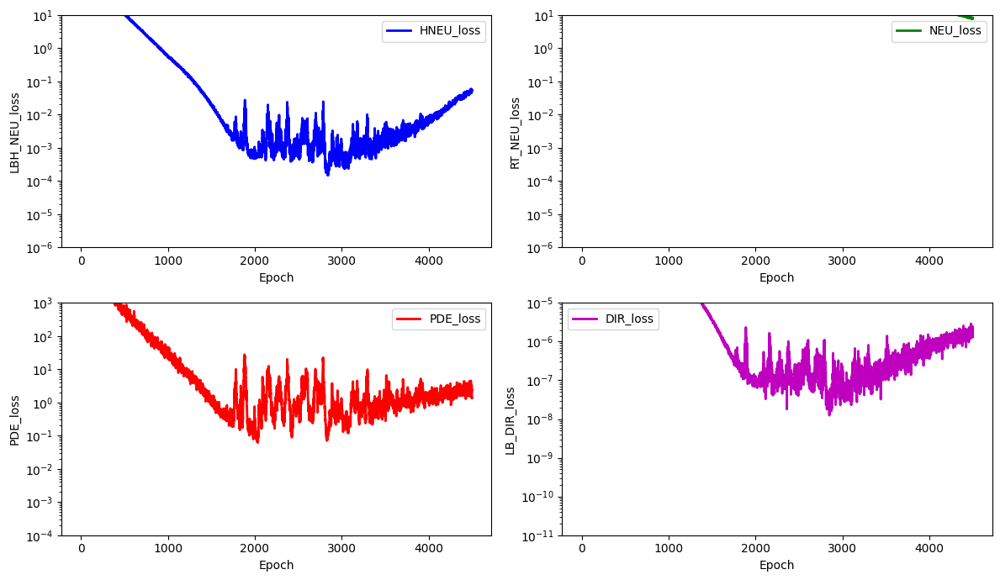

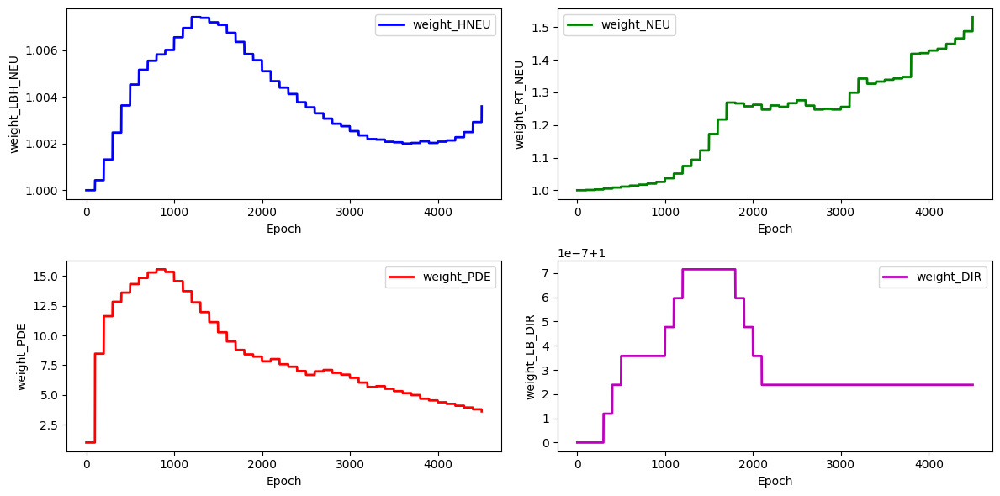

stress_Error for the stress_hole is: 25.43551635479899


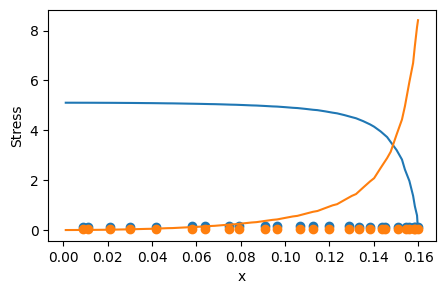

 31%|███       | 4600/15000 [30:31<1:05:48,  2.63it/s]

for weight 0 norm_grad: 74.6456527709961
for weight 0 new lamda dach: 1.0100171566009521
for weight 0 new lamdaloss norm: 75.39338684082031
for weight 1 norm_grad: 2593.039794921875
for weight 1 new lamda dach: 1.5256115198135376
for weight 1 new lamdaloss norm: 3955.971435546875
for weight 2 norm_grad: 4858.7265625
for weight 2 new lamda dach: 2.8213231563568115
for weight 2 new lamdaloss norm: 13708.0380859375
for weight 3 norm_grad: 0.00504494970664382
for weight 3 new lamda dach: 1.0000005960464478
for weight 3 new lamdaloss norm: 0.005044952500611544
for weight 0 new weight_value: 1.0042366981506348
for weight 1 new weight_value: 1.5305415391921997
for weight 2 new weight_value: 3.5375218391418457
for weight 3 new weight_value: 1.000000238418579


 31%|███▏      | 4700/15000 [31:08<1:05:10,  2.63it/s]

for weight 0 norm_grad: 96.76705169677734
for weight 0 new lamda dach: 1.0172168016433716
for weight 0 new lamdaloss norm: 98.43306732177734
for weight 1 norm_grad: 2281.486328125
for weight 1 new lamda dach: 1.6640334129333496
for weight 1 new lamdaloss norm: 3796.46923828125
for weight 2 norm_grad: 3339.02587890625
for weight 2 new lamda dach: 2.403978109359741
for weight 2 new lamdaloss norm: 8026.9453125
for weight 3 norm_grad: 0.00742196524515748
for weight 3 new lamda dach: 1.000001311302185
for weight 3 new lamdaloss norm: 0.007421975024044514
for weight 0 new weight_value: 1.0055346488952637
for weight 1 new weight_value: 1.5438905954360962
for weight 2 new weight_value: 3.4241671562194824
for weight 3 new weight_value: 1.0000003576278687


 32%|███▏      | 4800/15000 [31:45<1:04:34,  2.63it/s]

for weight 0 norm_grad: 120.79454803466797
for weight 0 new lamda dach: 1.0235944986343384
for weight 0 new lamdaloss norm: 123.64463806152344
for weight 1 norm_grad: 1986.1663818359375
for weight 1 new lamda dach: 1.61033296585083
for weight 1 new lamdaloss norm: 3198.38916015625
for weight 2 norm_grad: 3133.430908203125
for weight 2 new lamda dach: 2.4871740341186523
for weight 2 new lamdaloss norm: 7793.38818359375
for weight 3 norm_grad: 0.009143153205513954
for weight 3 new lamda dach: 1.0000017881393433
for weight 3 new lamdaloss norm: 0.009143169969320297
for weight 0 new weight_value: 1.0073405504226685
for weight 1 new weight_value: 1.550534725189209
for weight 2 new weight_value: 3.330467700958252
for weight 3 new weight_value: 1.0000004768371582


 33%|███▎      | 4900/15000 [32:23<1:07:35,  2.49it/s]

for weight 0 norm_grad: 149.7900390625
for weight 0 new lamda dach: 1.0320004224777222
for weight 0 new lamdaloss norm: 154.5833740234375
for weight 1 norm_grad: 1714.3453369140625
for weight 1 new lamda dach: 1.5501182079315186
for weight 1 new lamdaloss norm: 2657.437744140625
for weight 2 norm_grad: 2966.516357421875
for weight 2 new lamda dach: 2.5913500785827637
for weight 2 new lamdaloss norm: 7687.28271484375
for weight 3 norm_grad: 0.015260784886777401
for weight 3 new lamda dach: 1.0000030994415283
for weight 3 new lamdaloss norm: 0.015260832384228706
for weight 0 new weight_value: 1.009806513786316
for weight 1 new weight_value: 1.5504930019378662
for weight 2 new weight_value: 3.2565557956695557
for weight 3 new weight_value: 1.0000007152557373


 33%|███▎      | 4999/15000 [33:01<1:01:23,  2.71it/s]

for weight 0 norm_grad: 176.24070739746094
for weight 0 new lamda dach: 1.042183518409729
for weight 0 new lamdaloss norm: 183.67515563964844
for weight 1 norm_grad: 1547.75146484375
for weight 1 new lamda dach: 1.5514991283416748
for weight 1 new lamdaloss norm: 2401.3349609375
for weight 2 norm_grad: 2630.18505859375
for weight 2 new lamda dach: 2.525620222091675
for weight 2 new lamdaloss norm: 6642.84814453125
for weight 3 norm_grad: 0.018136227503418922
for weight 3 new lamda dach: 1.0000041723251343
for weight 3 new lamdaloss norm: 0.01813630387187004
for weight 0 new weight_value: 1.0130441188812256
for weight 1 new weight_value: 1.550593614578247
for weight 2 new weight_value: 3.183462142944336
for weight 3 new weight_value: 1.000001072883606
total_loss: 5.0809125900268555, hole_loss:  0.3377741873264313,neumann_loss:  3.281641721725464, pde_loss: 1.3010743856430054,dirichlet_loss: 2.0941410184605047e-05


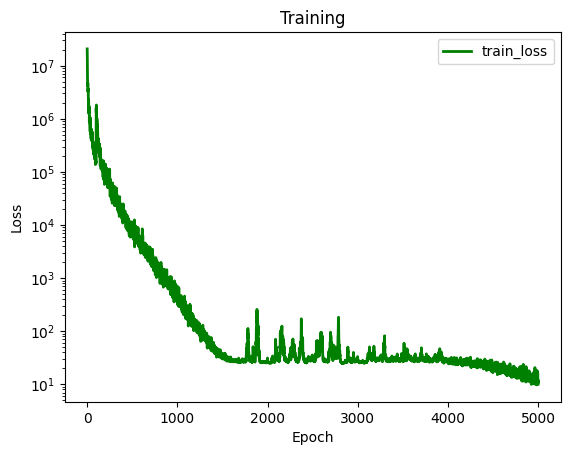

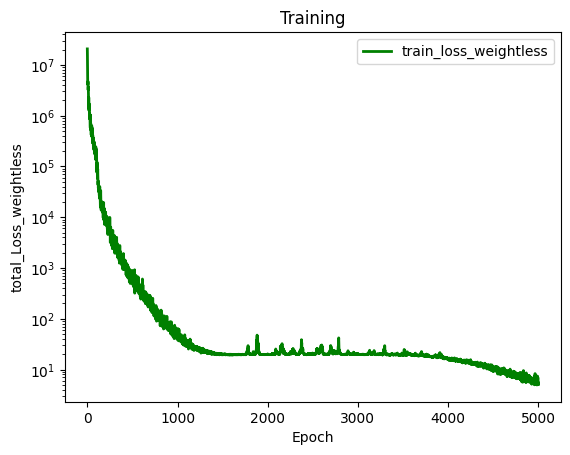

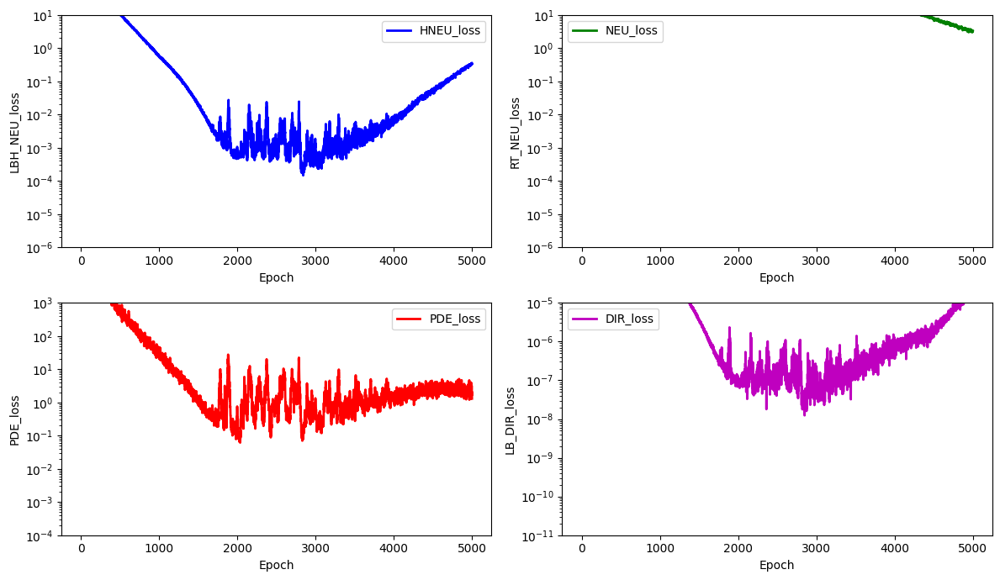

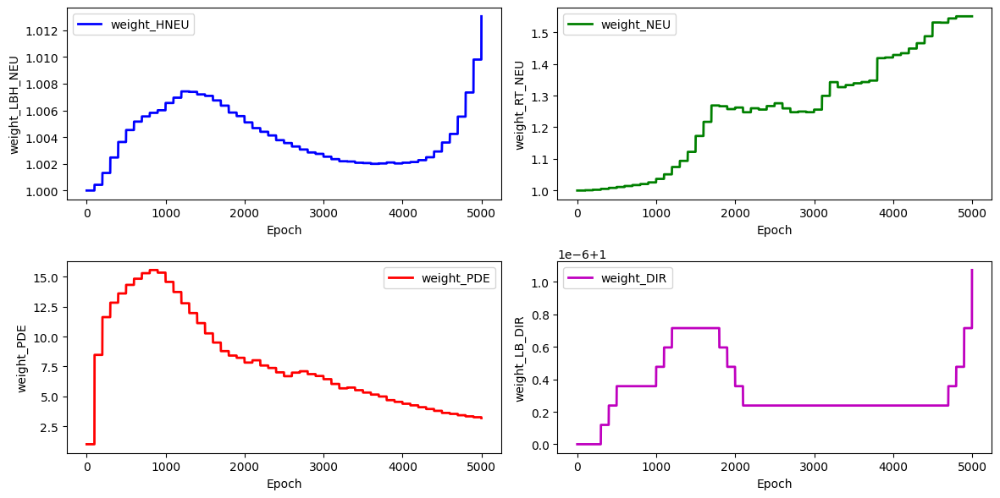

stress_Error for the stress_hole is: 22.01482876915543


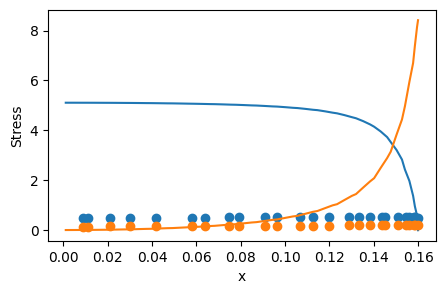

 34%|███▍      | 5100/15000 [33:42<1:03:36,  2.59it/s]

for weight 0 norm_grad: 221.23410034179688
for weight 0 new lamda dach: 1.0528662204742432
for weight 0 new lamdaloss norm: 232.92990112304688
for weight 1 norm_grad: 1319.06591796875
for weight 1 new lamda dach: 1.4273028373718262
for weight 1 new lamdaloss norm: 1882.7066650390625
for weight 2 norm_grad: 2865.701171875
for weight 2 new lamda dach: 2.86045503616333
for weight 2 new lamdaloss norm: 8197.2099609375
for weight 3 norm_grad: 0.02283538319170475
for weight 3 new lamda dach: 1.0000052452087402
for weight 3 new lamdaloss norm: 0.0228355024009943
for weight 0 new weight_value: 1.0170263051986694
for weight 1 new weight_value: 1.5382643938064575
for weight 2 new weight_value: 3.1511614322662354
for weight 3 new weight_value: 1.0000014305114746


 35%|███▍      | 5200/15000 [34:19<1:03:16,  2.58it/s]

for weight 0 norm_grad: 251.24557495117188
for weight 0 new lamda dach: 1.0713216066360474
for weight 0 new lamdaloss norm: 269.1648254394531
for weight 1 norm_grad: 1087.0302734375
for weight 1 new lamda dach: 1.40456223487854
for weight 1 new lamdaloss norm: 1526.8016357421875
for weight 2 norm_grad: 2435.65625
for weight 2 new lamda dach: 2.8199574947357178
for weight 2 new lamdaloss norm: 6868.447265625
for weight 3 norm_grad: 0.0281357541680336
for weight 3 new lamda dach: 1.0000073909759521
for weight 3 new lamdaloss norm: 0.028135960921645164
for weight 0 new weight_value: 1.0224558115005493
for weight 1 new weight_value: 1.524894118309021
for weight 2 new weight_value: 3.1180410385131836
for weight 3 new weight_value: 1.0000020265579224


 35%|███▌      | 5300/15000 [35:01<2:20:57,  1.15it/s]

for weight 0 norm_grad: 262.91290283203125
for weight 0 new lamda dach: 1.07741379737854
for weight 0 new lamdaloss norm: 283.2659912109375
for weight 1 norm_grad: 1077.0118408203125
for weight 1 new lamda dach: 1.4171065092086792
for weight 1 new lamdaloss norm: 1526.240478515625
for weight 2 norm_grad: 2319.1611328125
for weight 2 new lamda dach: 2.730776786804199
for weight 2 new lamdaloss norm: 6333.111328125
for weight 3 norm_grad: 0.0289565809071064
for weight 3 new lamda dach: 1.0000079870224
for weight 3 new lamdaloss norm: 0.028956811875104904
for weight 0 new weight_value: 1.0279515981674194
for weight 1 new weight_value: 1.514115333557129
for weight 2 new weight_value: 3.0793144702911377
for weight 3 new weight_value: 1.0000026226043701


 36%|███▌      | 5400/15000 [36:26<2:16:43,  1.17it/s]

for weight 0 norm_grad: 274.45562744140625
for weight 0 new lamda dach: 1.0682870149612427
for weight 0 new lamdaloss norm: 293.1973876953125
for weight 1 norm_grad: 981.7951049804688
for weight 1 new lamda dach: 1.2964526414871216
for weight 1 new lamdaloss norm: 1272.850830078125
for weight 2 norm_grad: 3037.3232421875
for weight 2 new lamda dach: 3.4177067279815674
for weight 2 new lamdaloss norm: 10380.6796875
for weight 3 norm_grad: 0.03171265125274658
for weight 3 new lamda dach: 1.0000073909759521
for weight 3 new lamdaloss norm: 0.031712885946035385
for weight 0 new weight_value: 1.0319851636886597
for weight 1 new weight_value: 1.4923490285873413
for weight 2 new weight_value: 3.1131536960601807
for weight 3 new weight_value: 1.0000030994415283


 37%|███▋      | 5499/15000 [37:49<2:08:51,  1.23it/s]

for weight 0 norm_grad: 289.15301513671875
for weight 0 new lamda dach: 1.0867078304290771
for weight 0 new lamdaloss norm: 314.2248840332031
for weight 1 norm_grad: 922.7109375
for weight 1 new lamda dach: 1.341588020324707
for weight 1 new lamdaloss norm: 1237.89794921875
for weight 2 norm_grad: 2412.052978515625
for weight 2 new lamda dach: 2.990311622619629
for weight 2 new lamdaloss norm: 7212.79052734375
for weight 3 norm_grad: 0.033237848430871964
for weight 3 new lamda dach: 1.0000091791152954
for weight 3 new lamdaloss norm: 0.03323815390467644
for weight 0 new weight_value: 1.0374574661254883
for weight 1 new weight_value: 1.4772729873657227
for weight 2 new weight_value: 3.1008694171905518
for weight 3 new weight_value: 1.000003695487976
total_loss: 4.344847679138184, hole_loss:  0.7457836866378784,neumann_loss:  1.7272021770477295, pde_loss: 1.5405102968215942,dirichlet_loss: 6.015674443915486e-05


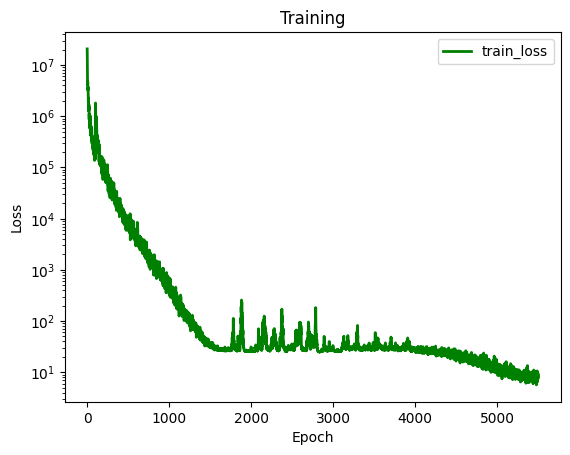

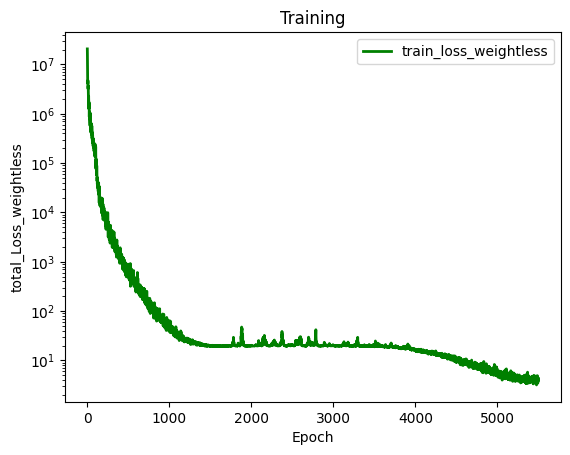

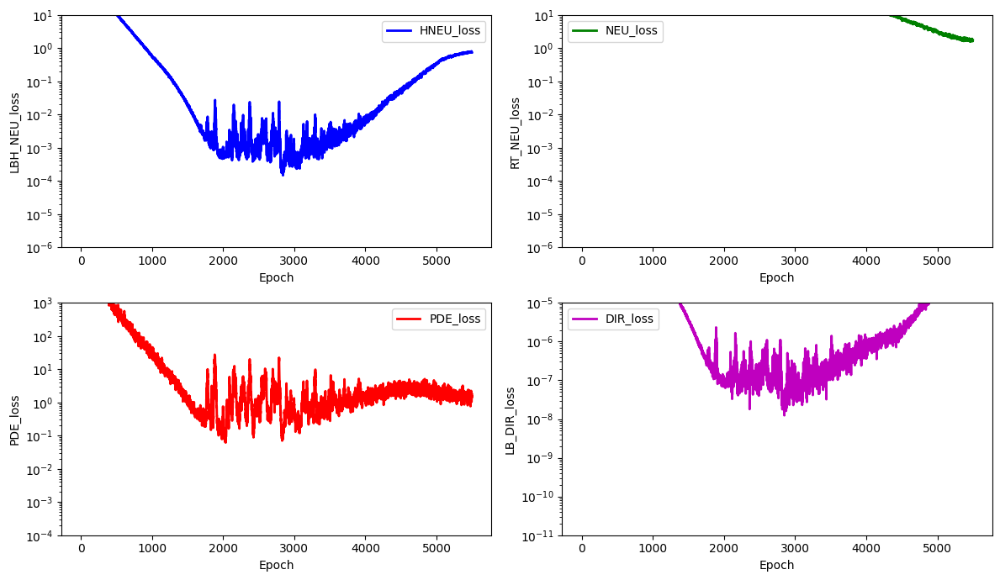

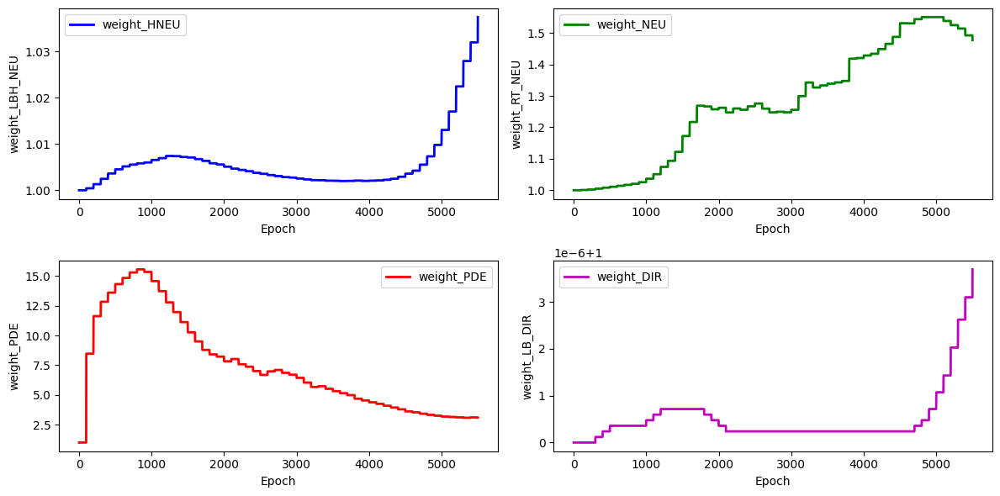

stress_Error for the stress_hole is: 17.368859283077366


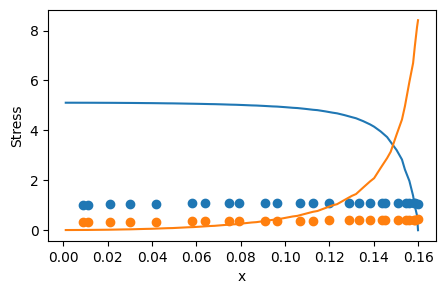

 37%|███▋      | 5600/15000 [39:20<2:12:51,  1.18it/s]

for weight 0 norm_grad: 308.1897277832031
for weight 0 new lamda dach: 1.083182454109192
for weight 0 new lamdaloss norm: 333.8257141113281
for weight 1 norm_grad: 861.6989135742188
for weight 1 new lamda dach: 1.273427128791809
for weight 1 new lamdaloss norm: 1097.3106689453125
for weight 2 norm_grad: 2843.250244140625
for weight 2 new lamda dach: 3.4302845001220703
for weight 2 new lamdaloss norm: 9753.1572265625
for weight 3 norm_grad: 0.036089878529310226
for weight 3 new lamda dach: 1.0000090599060059
for weight 3 new lamdaloss norm: 0.03609020262956619
for weight 0 new weight_value: 1.0420299768447876
for weight 1 new weight_value: 1.4568883180618286
for weight 2 new weight_value: 3.1338109970092773
for weight 3 new weight_value: 1.0000041723251343


 38%|███▊      | 5700/15000 [40:43<2:12:50,  1.17it/s]

for weight 0 norm_grad: 301.4028015136719
for weight 0 new lamda dach: 1.1022567749023438
for weight 0 new lamdaloss norm: 332.2232666015625
for weight 1 norm_grad: 843.3234252929688
for weight 1 new lamda dach: 1.350568413734436
for weight 1 new lamdaloss norm: 1138.9659423828125
for weight 2 norm_grad: 2104.147216796875
for weight 2 new lamda dach: 2.838059902191162
for weight 2 new lamdaloss norm: 5971.69580078125
for weight 3 norm_grad: 0.03909214586019516
for weight 3 new lamda dach: 1.0000120401382446
for weight 3 new lamdaloss norm: 0.039092618972063065
for weight 0 new weight_value: 1.0480525493621826
for weight 1 new weight_value: 1.4462562799453735
for weight 2 new weight_value: 3.104235887527466
for weight 3 new weight_value: 1.0000048875808716


 39%|███▊      | 5800/15000 [42:07<2:12:04,  1.16it/s]

for weight 0 norm_grad: 314.1154479980469
for weight 0 new lamda dach: 1.1178300380706787
for weight 0 new lamdaloss norm: 351.1277160644531
for weight 1 norm_grad: 680.2786254882812
for weight 1 new lamda dach: 1.2958152294158936
for weight 1 new lamdaloss norm: 881.515380859375
for weight 2 norm_grad: 1985.517333984375
for weight 2 new lamda dach: 2.996628999710083
for weight 2 new lamdaloss norm: 5949.859375
for weight 3 norm_grad: 0.040677476674318314
for weight 3 new lamda dach: 1.0000137090682983
for weight 3 new lamdaloss norm: 0.04067803546786308
for weight 0 new weight_value: 1.0550302267074585
for weight 1 new weight_value: 1.4312121868133545
for weight 2 new weight_value: 3.093475103378296
for weight 3 new weight_value: 1.0000057220458984


 39%|███▉      | 5900/15000 [43:27<1:46:32,  1.42it/s]

for weight 0 norm_grad: 314.2230224609375
for weight 0 new lamda dach: 1.1283166408538818
for weight 0 new lamdaloss norm: 354.54302978515625
for weight 1 norm_grad: 757.3921508789062
for weight 1 new lamda dach: 1.3776311874389648
for weight 1 new lamdaloss norm: 1043.406982421875
for weight 2 norm_grad: 1691.3743896484375
for weight 2 new lamda dach: 2.5782787799835205
for weight 2 new lamdaloss norm: 4360.83447265625
for weight 3 norm_grad: 0.04215693846344948
for weight 3 new lamda dach: 1.0000152587890625
for weight 3 new lamdaloss norm: 0.04215758666396141
for weight 0 new weight_value: 1.0623588562011719
for weight 1 new weight_value: 1.4258540868759155
for weight 2 new weight_value: 3.0419554710388184
for weight 3 new weight_value: 1.0000066757202148


 40%|███▉      | 5999/15000 [44:32<1:41:35,  1.48it/s]

for weight 0 norm_grad: 307.5989990234375
for weight 0 new lamda dach: 1.10738205909729
for weight 0 new lamdaloss norm: 340.6296081542969
for weight 1 norm_grad: 766.6831665039062
for weight 1 new lamda dach: 1.3187283277511597
for weight 1 new lamdaloss norm: 1011.0466918945312
for weight 2 norm_grad: 2097.80126953125
for weight 2 new lamda dach: 2.952667474746704
for weight 2 new lamdaloss norm: 6194.10986328125
for weight 3 norm_grad: 0.04376225173473358
for weight 3 new lamda dach: 1.000013828277588
for weight 3 new lamdaloss norm: 0.04376285523176193
for weight 0 new weight_value: 1.0668611526489258
for weight 1 new weight_value: 1.4151415824890137
for weight 2 new weight_value: 3.033026695251465
for weight 3 new weight_value: 1.0000073909759521
total_loss: 3.5021700859069824, hole_loss:  0.9167921543121338,neumann_loss:  1.2314504384994507, pde_loss: 1.0365278720855713,dirichlet_loss: 9.957799920812249e-05


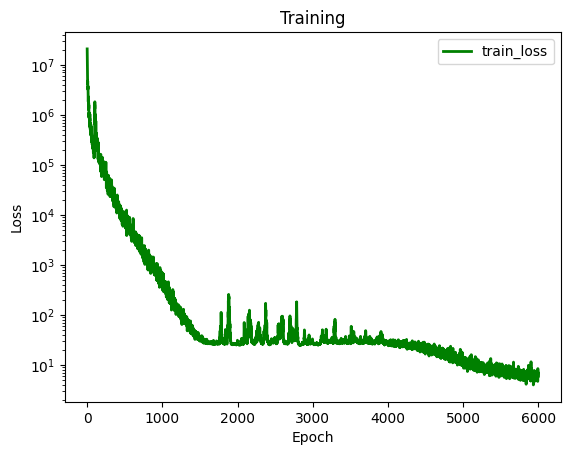

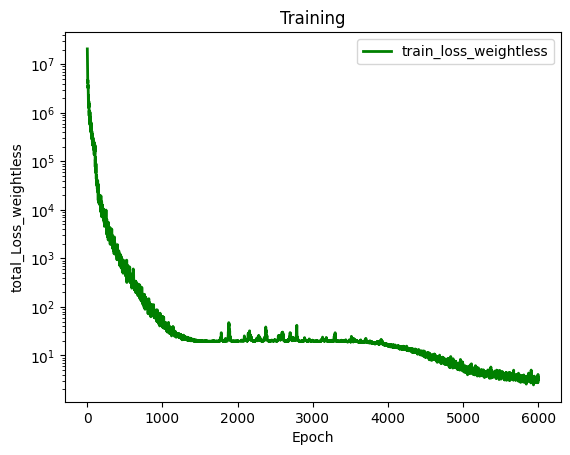

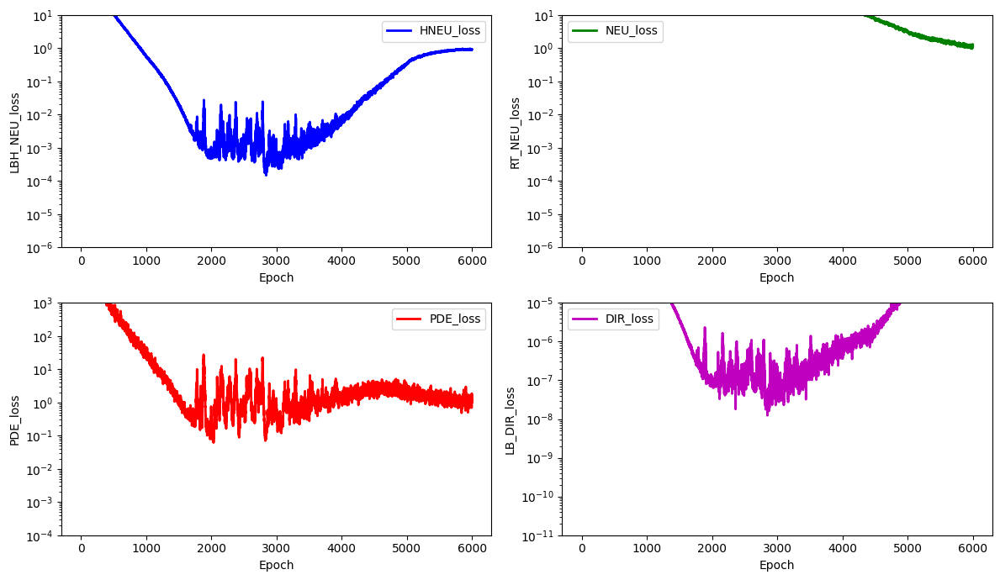

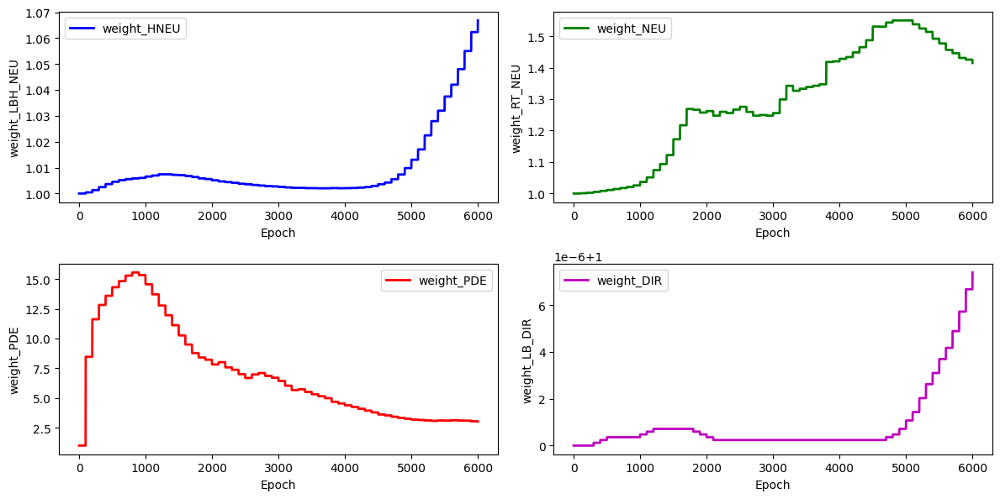

stress_Error for the stress_hole is: 14.816020252439214


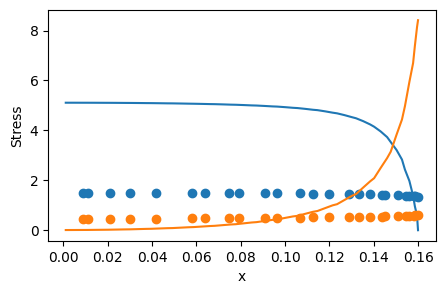

 41%|████      | 6100/15000 [45:41<1:48:00,  1.37it/s]

for weight 0 norm_grad: 309.3106689453125
for weight 0 new lamda dach: 1.1297610998153687
for weight 0 new lamdaloss norm: 349.4471435546875
for weight 1 norm_grad: 668.4407958984375
for weight 1 new lamda dach: 1.3301656246185303
for weight 1 new lamdaloss norm: 889.1369018554688
for weight 2 norm_grad: 1715.204833984375
for weight 2 new lamda dach: 2.754150390625
for weight 2 new lamdaloss norm: 4723.93212890625
for weight 3 norm_grad: 0.04666401073336601
for weight 3 new lamda dach: 1.0000172853469849
for weight 3 new lamdaloss norm: 0.04666481539607048
for weight 0 new weight_value: 1.0731511116027832
for weight 1 new weight_value: 1.4066439867019653
for weight 2 new weight_value: 3.005138874053955
for weight 3 new weight_value: 1.0000083446502686


 41%|████▏     | 6200/15000 [46:44<1:24:41,  1.73it/s]

for weight 0 norm_grad: 302.89605712890625
for weight 0 new lamda dach: 1.1601463556289673
for weight 0 new lamdaloss norm: 351.4037780761719
for weight 1 norm_grad: 607.0777587890625
for weight 1 new lamda dach: 1.382486343383789
for weight 1 new lamdaloss norm: 839.2767944335938
for weight 2 norm_grad: 1284.24365234375
for weight 2 new lamda dach: 2.411222219467163
for weight 2 new lamdaloss norm: 3096.5966796875
for weight 3 norm_grad: 0.04828321188688278
for weight 3 new lamda dach: 1.000022053718567
for weight 3 new lamdaloss norm: 0.04828427731990814
for weight 0 new weight_value: 1.0818506479263306
for weight 1 new weight_value: 1.4042282104492188
for weight 2 new weight_value: 2.945747137069702
for weight 3 new weight_value: 1.0000096559524536


 42%|████▏     | 6300/15000 [47:49<1:32:27,  1.57it/s]

for weight 0 norm_grad: 292.7666015625
for weight 0 new lamda dach: 1.0847108364105225
for weight 0 new lamdaloss norm: 317.56707763671875
for weight 1 norm_grad: 588.2061157226562
for weight 1 new lamda dach: 1.1861039400100708
for weight 1 new lamdaloss norm: 697.673583984375
for weight 2 norm_grad: 2867.81689453125
for weight 2 new lamda dach: 4.255102634429932
for weight 2 new lamdaloss norm: 12202.85546875
for weight 3 norm_grad: 0.04919713735580444
for weight 3 new lamda dach: 1.0000131130218506
for weight 3 new lamdaloss norm: 0.049197785556316376
for weight 0 new weight_value: 1.082136631011963
for weight 1 new weight_value: 1.382415771484375
for weight 2 new weight_value: 3.0766825675964355
for weight 3 new weight_value: 1.0000100135803223


 43%|████▎     | 6400/15000 [48:52<1:36:52,  1.48it/s]

for weight 0 norm_grad: 287.7695007324219
for weight 0 new lamda dach: 1.1421222686767578
for weight 0 new lamdaloss norm: 328.6679382324219
for weight 1 norm_grad: 573.1634521484375
for weight 1 new lamda dach: 1.3295161724090576
for weight 1 new lamdaloss norm: 762.030029296875
for weight 2 norm_grad: 1451.591796875
for weight 2 new lamda dach: 2.6859748363494873
for weight 2 new lamdaloss norm: 3898.939208984375
for weight 3 norm_grad: 0.04766468703746796
for weight 3 new lamda dach: 1.0000206232070923
for weight 3 new lamdaloss norm: 0.04766567051410675
for weight 0 new weight_value: 1.0881352424621582
for weight 1 new weight_value: 1.3771257400512695
for weight 2 new weight_value: 3.037611484527588
for weight 3 new weight_value: 1.0000110864639282


 43%|████▎     | 6499/15000 [49:54<1:04:09,  2.21it/s]

for weight 0 norm_grad: 291.1918029785156
for weight 0 new lamda dach: 1.1508305072784424
for weight 0 new lamdaloss norm: 335.1123962402344
for weight 1 norm_grad: 515.474853515625
for weight 1 new lamda dach: 1.3020998239517212
for weight 1 new lamdaloss norm: 671.19970703125
for weight 2 norm_grad: 1415.0634765625
for weight 2 new lamda dach: 2.7540993690490723
for weight 2 new lamdaloss norm: 3897.225830078125
for weight 3 norm_grad: 0.05155221000313759
for weight 3 new lamda dach: 1.0000232458114624
for weight 3 new lamdaloss norm: 0.05155340954661369
for weight 0 new weight_value: 1.0944048166275024
for weight 1 new weight_value: 1.3696231842041016
for weight 2 new weight_value: 3.0092601776123047
for weight 3 new weight_value: 1.0000122785568237
total_loss: 2.0740392208099365, hole_loss:  0.812890887260437,neumann_loss:  0.6763179302215576, pde_loss: 0.48659977316856384,dirichlet_loss: 0.00014004019612912089


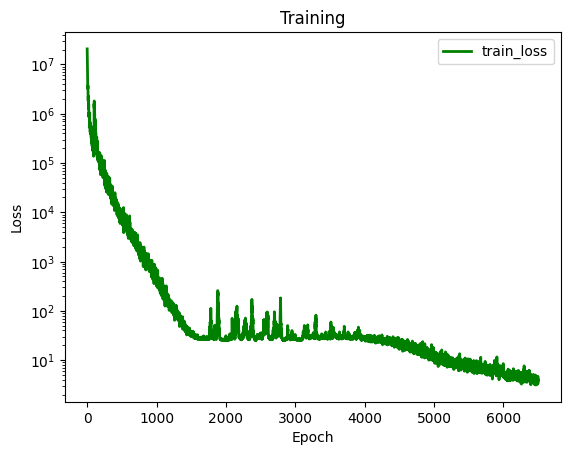

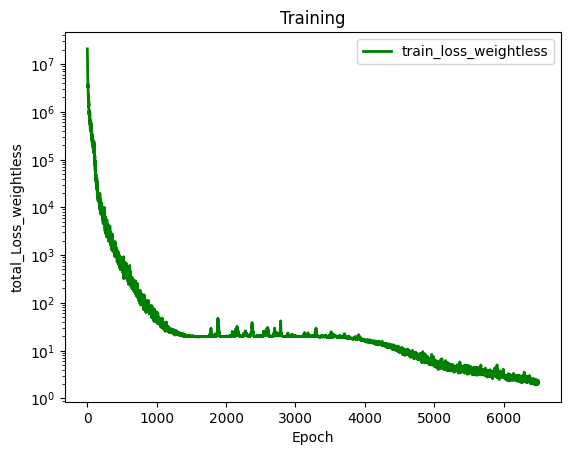

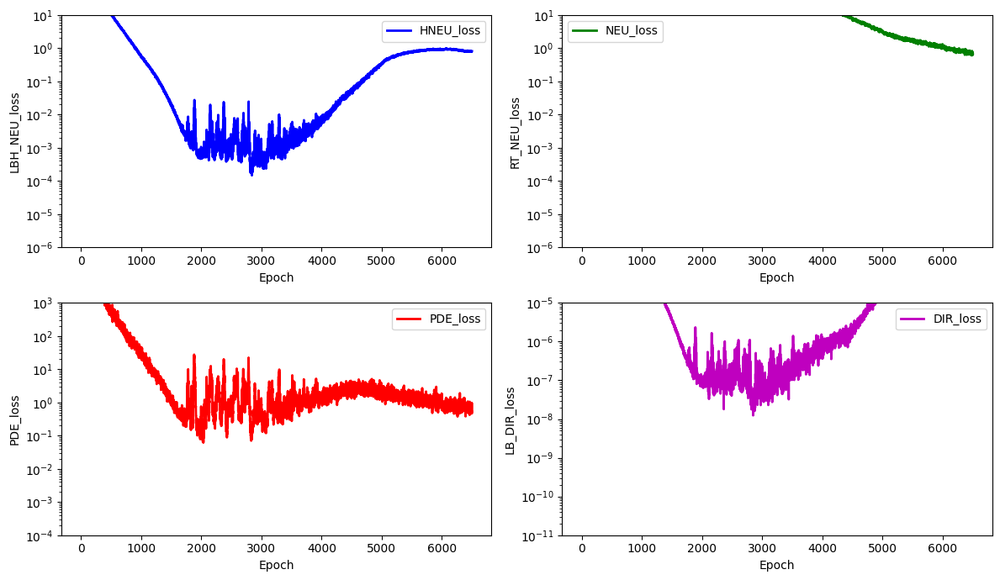

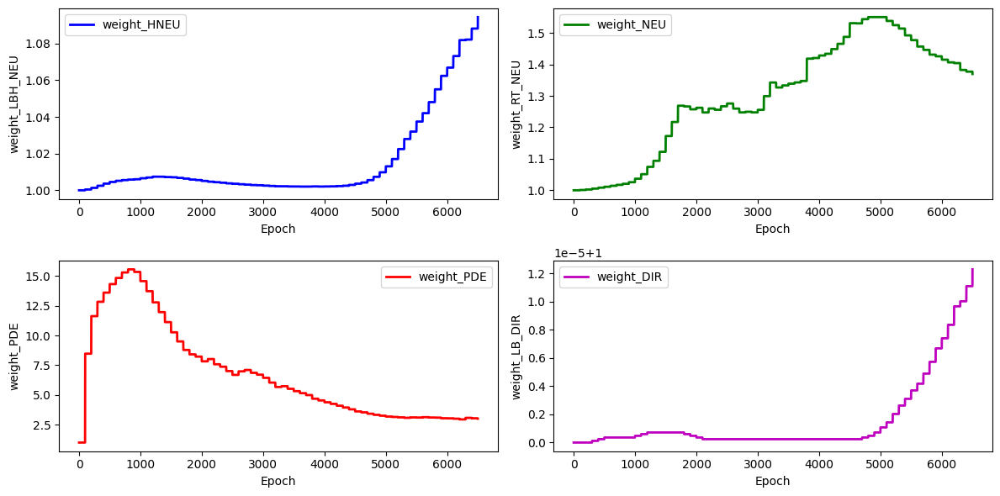

stress_Error for the stress_hole is: 13.049914353207473


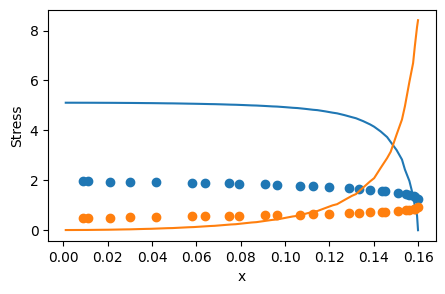

 44%|████▍     | 6600/15000 [51:04<1:32:24,  1.51it/s]

for weight 0 norm_grad: 282.03167724609375
for weight 0 new lamda dach: 1.1485966444015503
for weight 0 new lamdaloss norm: 323.940673828125
for weight 1 norm_grad: 476.81146240234375
for weight 1 new lamda dach: 1.2799524068832397
for weight 1 new lamdaloss norm: 610.2960205078125
for weight 2 norm_grad: 1421.1051025390625
for weight 2 new lamda dach: 2.8725993633270264
for weight 2 new lamdaloss norm: 4082.265625
for weight 3 norm_grad: 0.05122708901762962
for weight 3 new lamda dach: 1.0000234842300415
for weight 3 new lamdaloss norm: 0.05122829228639603
for weight 0 new weight_value: 1.0998239517211914
for weight 1 new weight_value: 1.3606561422348022
for weight 2 new weight_value: 2.995594024658203
for weight 3 new weight_value: 1.0000133514404297


 45%|████▍     | 6700/15000 [52:07<1:34:18,  1.47it/s]

for weight 0 norm_grad: 280.8677062988281
for weight 0 new lamda dach: 1.1120375394821167
for weight 0 new lamdaloss norm: 312.33544921875
for weight 1 norm_grad: 451.401611328125
for weight 1 new lamda dach: 1.1932060718536377
for weight 1 new lamdaloss norm: 538.6151733398438
for weight 2 norm_grad: 2055.45458984375
for weight 2 new lamda dach: 3.8067688941955566
for weight 2 new lamdaloss norm: 7824.640625
for weight 3 norm_grad: 0.05123013257980347
for weight 3 new lamda dach: 1.0000183582305908
for weight 3 new lamdaloss norm: 0.05123107135295868
for weight 0 new weight_value: 1.1010452508926392
for weight 1 new weight_value: 1.3439111709594727
for weight 2 new weight_value: 3.076711654663086
for weight 3 new weight_value: 1.000013828277588


 45%|████▌     | 6800/15000 [53:10<1:35:21,  1.43it/s]

for weight 0 norm_grad: 273.73193359375
for weight 0 new lamda dach: 1.182558536529541
for weight 0 new lamdaloss norm: 323.70404052734375
for weight 1 norm_grad: 395.78729248046875
for weight 1 new lamda dach: 1.2873510122299194
for weight 1 new lamdaloss norm: 509.5171813964844
for weight 2 norm_grad: 1103.579345703125
for weight 2 new lamda dach: 2.648184061050415
for weight 2 new lamdaloss norm: 2922.4814453125
for weight 3 norm_grad: 0.05361669138073921
for weight 3 new lamda dach: 1.000030279159546
for weight 3 new lamdaloss norm: 0.05361831560730934
for weight 0 new weight_value: 1.1091965436935425
for weight 1 new weight_value: 1.3382550477981567
for weight 2 new weight_value: 3.0338587760925293
for weight 3 new weight_value: 1.0000154972076416


 46%|████▌     | 6900/15000 [54:13<1:09:56,  1.93it/s]

for weight 0 norm_grad: 270.84466552734375
for weight 0 new lamda dach: 1.1532917022705078
for weight 0 new lamdaloss norm: 312.3629150390625
for weight 1 norm_grad: 440.0668029785156
for weight 1 new lamda dach: 1.2754486799240112
for weight 1 new lamdaloss norm: 561.2825927734375
for weight 2 norm_grad: 1326.739013671875
for weight 2 new lamda dach: 2.8661131858825684
for weight 2 new lamdaloss norm: 3802.584716796875
for weight 3 norm_grad: 0.05237959697842598
for weight 3 new lamda dach: 1.000025749206543
for weight 3 new lamdaloss norm: 0.05238094925880432
for weight 0 new weight_value: 1.1136060953140259
for weight 1 new weight_value: 1.3319743871688843
for weight 2 new weight_value: 3.0170841217041016
for weight 3 new weight_value: 1.000016450881958


 47%|████▋     | 6999/15000 [55:18<1:29:54,  1.48it/s]

for weight 0 norm_grad: 270.7159729003906
for weight 0 new lamda dach: 1.143639087677002
for weight 0 new lamdaloss norm: 309.6013488769531
for weight 1 norm_grad: 382.7406005859375
for weight 1 new lamda dach: 1.215911865234375
for weight 1 new lamdaloss norm: 465.37884521484375
for weight 2 norm_grad: 1501.90283203125
for weight 2 new lamda dach: 3.2982144355773926
for weight 2 new lamdaloss norm: 4953.59765625
for weight 3 norm_grad: 0.05202775448560715
for weight 3 new lamda dach: 1.0000240802764893
for weight 3 new lamdaloss norm: 0.05202900618314743
for weight 0 new weight_value: 1.1166093349456787
for weight 1 new weight_value: 1.3203681707382202
for weight 2 new weight_value: 3.045197010040283
for weight 3 new weight_value: 1.0000171661376953
total_loss: 1.764809012413025, hole_loss:  0.6049971580505371,neumann_loss:  0.37640130519866943, pde_loss: 0.6528798341751099,dirichlet_loss: 0.00014713835844304413


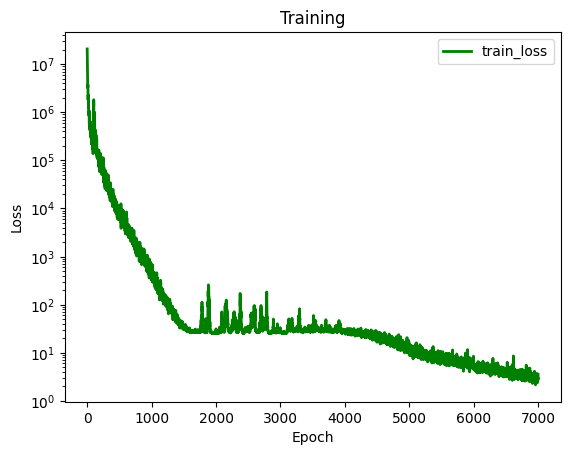

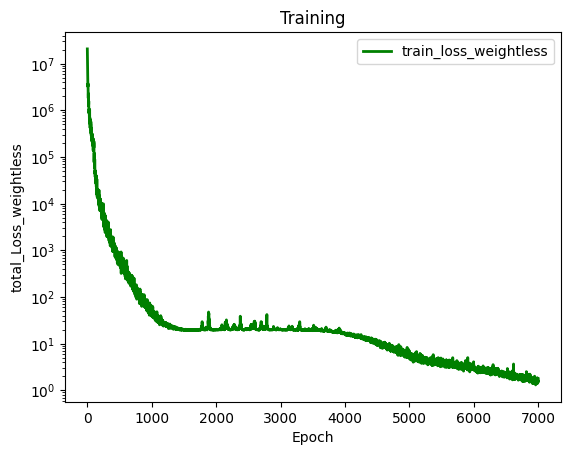

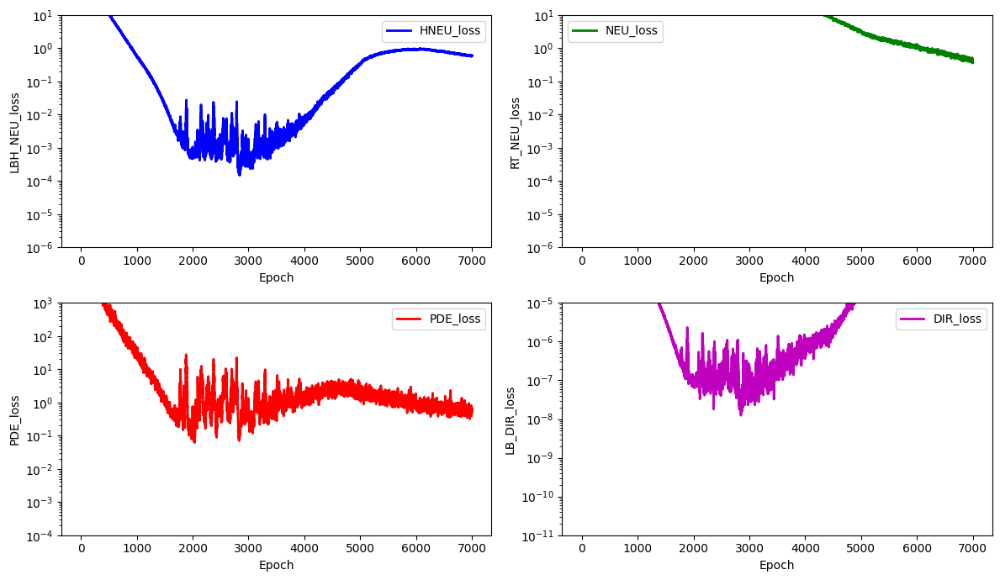

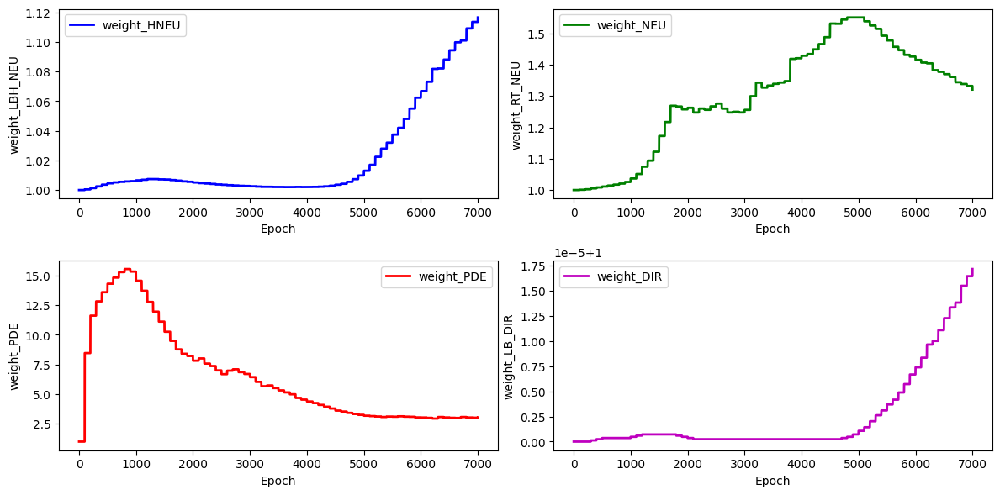

stress_Error for the stress_hole is: 12.112340810416246


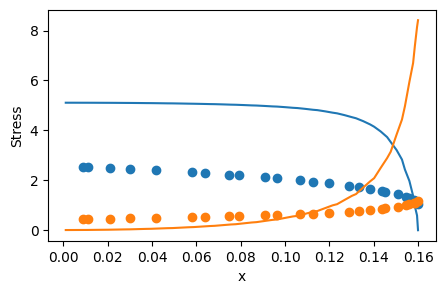

 47%|████▋     | 7100/15000 [56:35<1:39:18,  1.33it/s]

for weight 0 norm_grad: 269.4456481933594
for weight 0 new lamda dach: 1.1672449111938477
for weight 0 new lamdaloss norm: 314.5090637207031
for weight 1 norm_grad: 409.4159851074219
for weight 1 new lamda dach: 1.2783033847808838
for weight 1 new lamdaloss norm: 523.3578491210938
for weight 2 norm_grad: 1201.61279296875
for weight 2 new lamda dach: 2.7698965072631836
for weight 2 new lamdaloss norm: 3328.343017578125
for weight 3 norm_grad: 0.055473409593105316
for weight 3 new lamda dach: 1.000029444694519
for weight 3 new lamdaloss norm: 0.055475037544965744
for weight 0 new weight_value: 1.1216728687286377
for weight 1 new weight_value: 1.3161617517471313
for weight 2 new weight_value: 3.017666816711426
for weight 3 new weight_value: 1.0000183582305908


 48%|████▊     | 7200/15000 [57:47<2:02:01,  1.07it/s]

for weight 0 norm_grad: 257.3081359863281
for weight 0 new lamda dach: 1.1542083024978638
for weight 0 new lamdaloss norm: 296.9871826171875
for weight 1 norm_grad: 367.048583984375
for weight 1 new lamda dach: 1.2354633808135986
for weight 1 new lamdaloss norm: 453.4750671386719
for weight 2 norm_grad: 1301.473388671875
for weight 2 new lamda dach: 3.084324598312378
for weight 2 new lamdaloss norm: 4014.16650390625
for weight 3 norm_grad: 0.05348283797502518
for weight 3 new lamda dach: 1.0000277757644653
for weight 3 new lamdaloss norm: 0.053484320640563965
for weight 0 new weight_value: 1.1249263286590576
for weight 1 new weight_value: 1.3080918788909912
for weight 2 new weight_value: 3.0243325233459473
for weight 3 new weight_value: 1.0000193119049072


 49%|████▊     | 7300/15000 [58:58<1:18:30,  1.63it/s]

for weight 0 norm_grad: 251.4951171875
for weight 0 new lamda dach: 1.1869688034057617
for weight 0 new lamdaloss norm: 298.516845703125
for weight 1 norm_grad: 339.3298645019531
for weight 1 new lamda dach: 1.269891381263733
for weight 1 new lamdaloss norm: 430.9120788574219
for weight 2 norm_grad: 1005.734375
for weight 2 new lamda dach: 2.7021002769470215
for weight 2 new lamdaloss norm: 2717.594970703125
for weight 3 norm_grad: 0.05347541347146034
for weight 3 new lamda dach: 1.0000334978103638
for weight 3 new lamdaloss norm: 0.053477197885513306
for weight 0 new weight_value: 1.131130576133728
for weight 1 new weight_value: 1.3042718172073364
for weight 2 new weight_value: 2.9921092987060547
for weight 3 new weight_value: 1.0000207424163818


 49%|████▉     | 7400/15000 [1:00:05<1:31:58,  1.38it/s]

for weight 0 norm_grad: 231.87954711914062
for weight 0 new lamda dach: 1.1277847290039062
for weight 0 new lamdaloss norm: 261.51019287109375
for weight 1 norm_grad: 339.8197937011719
for weight 1 new lamda dach: 1.1991127729415894
for weight 1 new lamdaloss norm: 407.4822692871094
for weight 2 norm_grad: 1474.736572265625
for weight 2 new lamda dach: 3.579322099685669
for weight 2 new lamdaloss norm: 5278.556640625
for weight 3 norm_grad: 0.054211899638175964
for weight 3 new lamda dach: 1.0000264644622803
for weight 3 new lamdaloss norm: 0.054213330149650574
for weight 0 new weight_value: 1.130795955657959
for weight 1 new weight_value: 1.2937558889389038
for weight 2 new weight_value: 3.050830364227295
for weight 3 new weight_value: 1.00002121925354


 50%|████▉     | 7499/15000 [1:01:09<1:06:50,  1.87it/s]

for weight 0 norm_grad: 233.60150146484375
for weight 0 new lamda dach: 1.1558318138122559
for weight 0 new lamdaloss norm: 270.0040588378906
for weight 1 norm_grad: 319.1895751953125
for weight 1 new lamda dach: 1.2258192300796509
for weight 1 new lamdaloss norm: 391.26873779296875
for weight 2 norm_grad: 1179.8173828125
for weight 2 new lamda dach: 3.1340789794921875
for weight 2 new lamdaloss norm: 3697.640869140625
for weight 3 norm_grad: 0.055188413709402084
for weight 3 new lamda dach: 1.00003182888031
for weight 3 new lamdaloss norm: 0.05519017204642296
for weight 0 new weight_value: 1.133299469947815
for weight 1 new weight_value: 1.2869622707366943
for weight 2 new weight_value: 3.059155225753784
for weight 3 new weight_value: 1.0000221729278564
total_loss: 1.0962438583374023, hole_loss:  0.478313148021698,neumann_loss:  0.2508775293827057, pde_loss: 0.32928669452667236,dirichlet_loss: 0.00016749715723562986


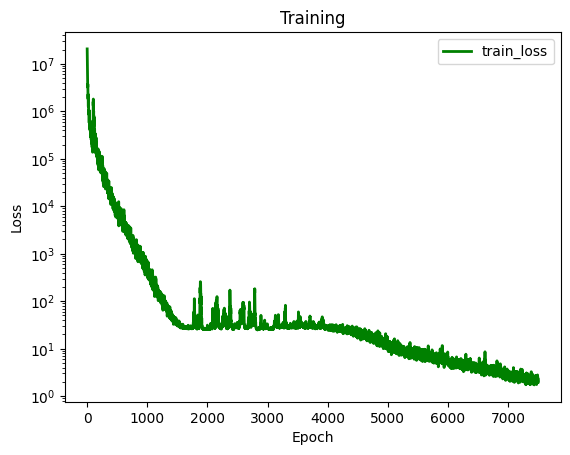

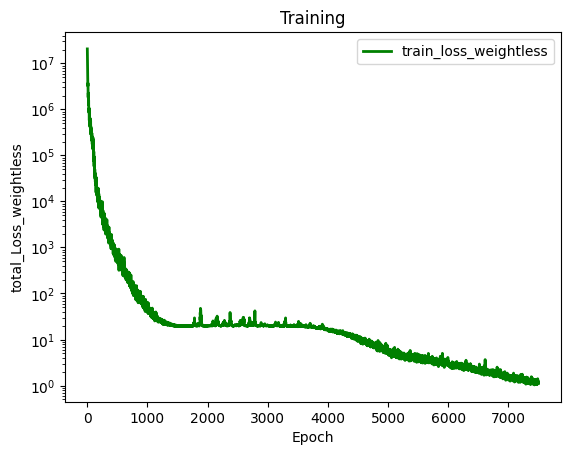

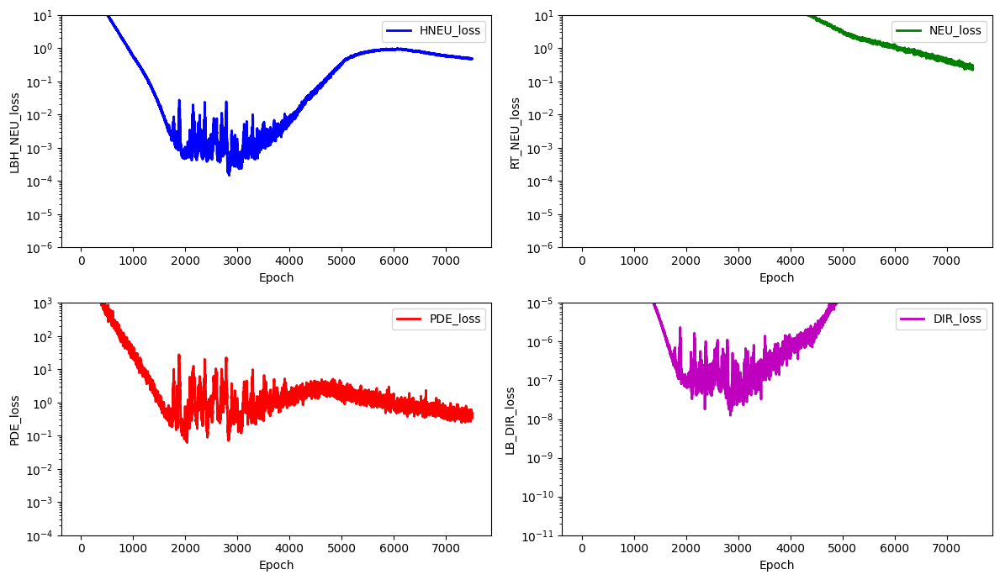

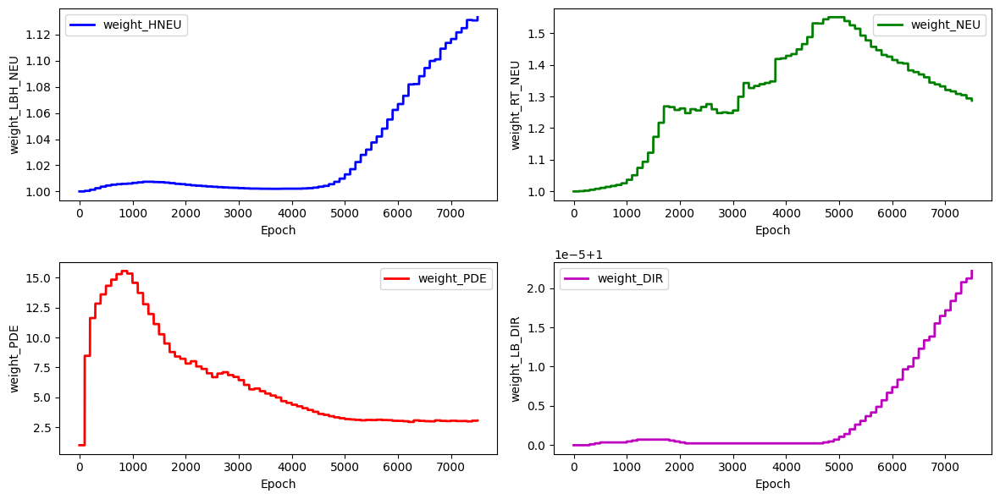

stress_Error for the stress_hole is: 11.476777239488158


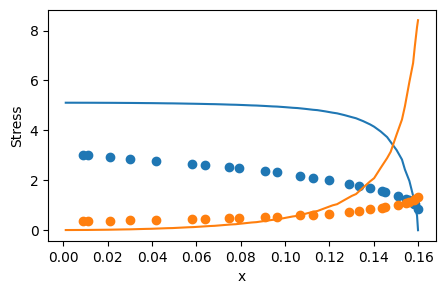

 51%|█████     | 7600/15000 [1:02:21<1:20:24,  1.53it/s]

for weight 0 norm_grad: 230.25814819335938
for weight 0 new lamda dach: 1.1688364744186401
for weight 0 new lamdaloss norm: 269.1341247558594
for weight 1 norm_grad: 345.2789306640625
for weight 1 new lamda dach: 1.2764945030212402
for weight 1 new lamdaloss norm: 440.7467041015625
for weight 2 norm_grad: 1018.4600219726562
for weight 2 new lamda dach: 2.769412040710449
for weight 2 new lamdaloss norm: 2820.535400390625
for weight 3 norm_grad: 0.05529947206377983
for weight 3 new lamda dach: 1.0000346899032593
for weight 3 new lamdaloss norm: 0.05530139058828354
for weight 0 new weight_value: 1.1368530988693237
for weight 1 new weight_value: 1.285915493965149
for weight 2 new weight_value: 3.0301809310913086
for weight 3 new weight_value: 1.000023365020752


 51%|█████▏    | 7700/15000 [1:03:27<1:27:08,  1.40it/s]

for weight 0 norm_grad: 221.75894165039062
for weight 0 new lamda dach: 1.1378597021102905
for weight 0 new lamdaloss norm: 252.33056640625
for weight 1 norm_grad: 317.001708984375
for weight 1 new lamda dach: 1.2094714641571045
for weight 1 new lamdaloss norm: 383.404541015625
for weight 2 norm_grad: 1291.5283203125
for weight 2 new lamda dach: 3.3969810009002686
for weight 2 new lamdaloss norm: 4387.296875
for weight 3 norm_grad: 0.05394146591424942
for weight 3 new lamda dach: 1.000029444694519
for weight 3 new lamdaloss norm: 0.053943052887916565
for weight 0 new weight_value: 1.1369537115097046
for weight 1 new weight_value: 1.2782710790634155
for weight 2 new weight_value: 3.0668609142303467
for weight 3 new weight_value: 1.0000239610671997


 52%|█████▏    | 7800/15000 [1:04:39<1:26:07,  1.39it/s]

for weight 0 norm_grad: 214.1717071533203
for weight 0 new lamda dach: 1.185869574546814
for weight 0 new lamdaloss norm: 253.97970581054688
for weight 1 norm_grad: 345.0389709472656
for weight 1 new lamda dach: 1.3378090858459473
for weight 1 new lamdaloss norm: 461.59625244140625
for weight 2 norm_grad: 807.1771850585938
for weight 2 new lamda dach: 2.4432849884033203
for weight 2 new lamdaloss norm: 1972.1639404296875
for weight 3 norm_grad: 0.053039588034152985
for weight 3 new lamda dach: 1.0000388622283936
for weight 3 new lamdaloss norm: 0.05304165557026863
for weight 0 new weight_value: 1.1418452262878418
for weight 1 new weight_value: 1.2842248678207397
for weight 2 new weight_value: 3.0045032501220703
for weight 3 new weight_value: 1.0000253915786743


 53%|█████▎    | 7900/15000 [1:05:45<1:04:26,  1.84it/s]

for weight 0 norm_grad: 206.48712158203125
for weight 0 new lamda dach: 1.182192087173462
for weight 0 new lamdaloss norm: 244.1074676513672
for weight 1 norm_grad: 303.9100341796875
for weight 1 new lamda dach: 1.2933706045150757
for weight 1 new lamdaloss norm: 393.06829833984375
for weight 2 norm_grad: 829.38525390625
for weight 2 new lamda dach: 2.6248114109039307
for weight 2 new lamdaloss norm: 2176.97998046875
for weight 3 norm_grad: 0.052971843630075455
for weight 3 new lamda dach: 1.0000395774841309
for weight 3 new lamdaloss norm: 0.05297394096851349
for weight 0 new weight_value: 1.1458799839019775
for weight 1 new weight_value: 1.2851394414901733
for weight 2 new weight_value: 2.96653413772583
for weight 3 new weight_value: 1.0000267028808594


 53%|█████▎    | 7999/15000 [1:06:49<1:19:46,  1.46it/s]

for weight 0 norm_grad: 202.74859619140625
for weight 0 new lamda dach: 1.176671028137207
for weight 0 new lamdaloss norm: 238.5684051513672
for weight 1 norm_grad: 306.314208984375
for weight 1 new lamda dach: 1.2933931350708008
for weight 1 new lamdaloss norm: 396.1846923828125
for weight 2 norm_grad: 841.2384643554688
for weight 2 new lamda dach: 2.6523516178131104
for weight 2 new lamdaloss norm: 2231.26025390625
for weight 3 norm_grad: 0.05314940586686134
for weight 3 new lamda dach: 1.0000393390655518
for weight 3 new lamdaloss norm: 0.05315149575471878
for weight 0 new weight_value: 1.1489590406417847
for weight 1 new weight_value: 1.285964846611023
for weight 2 new weight_value: 2.9351158142089844
for weight 3 new weight_value: 1.0000278949737549
total_loss: 0.8021845817565918, hole_loss:  0.40394437313079834,neumann_loss:  0.19790443778038025, pde_loss: 0.18902894854545593,dirichlet_loss: 0.00015731922758277506


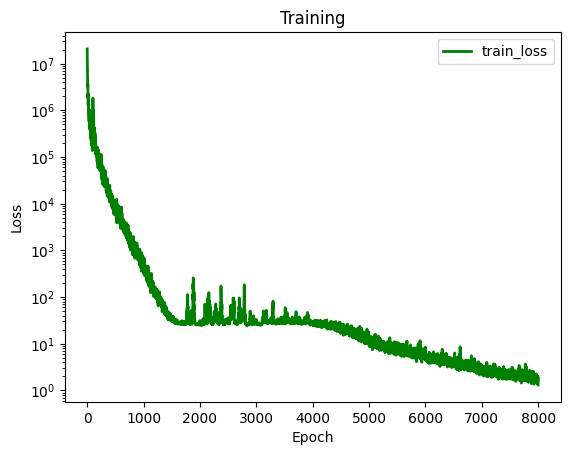

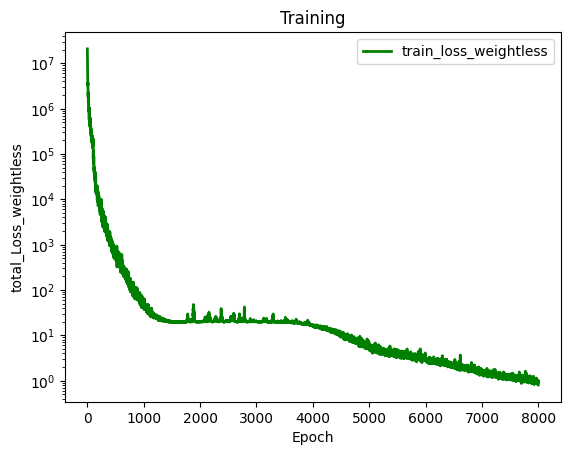

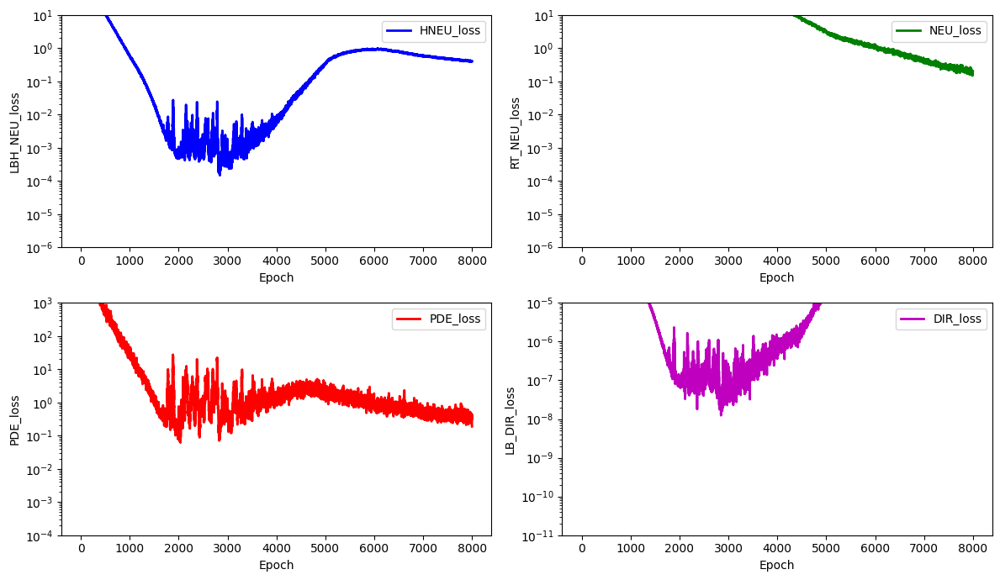

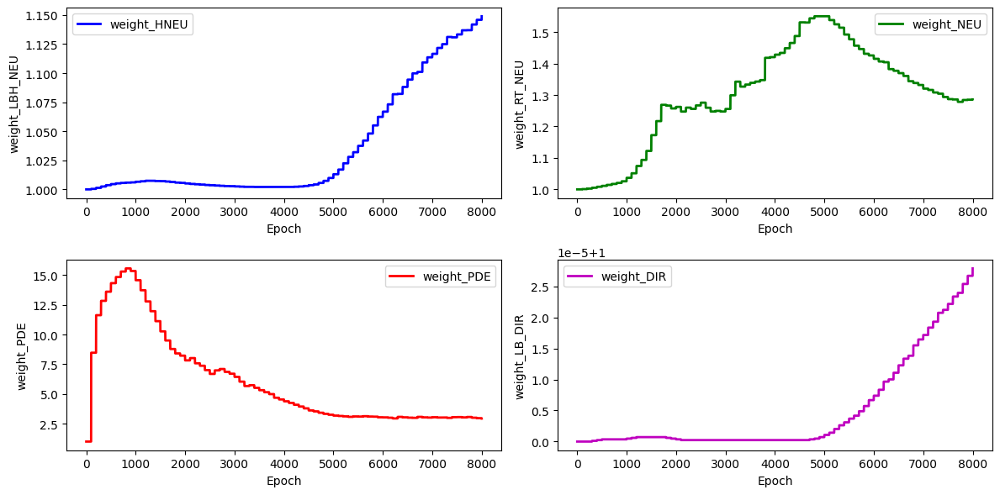

stress_Error for the stress_hole is: 11.009876380419676


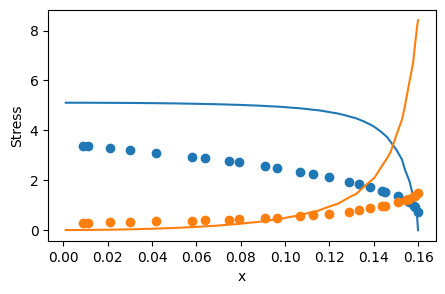

 54%|█████▍    | 8100/15000 [1:08:02<1:10:08,  1.64it/s]

for weight 0 norm_grad: 194.77134704589844
for weight 0 new lamda dach: 1.1808078289031982
for weight 0 new lamdaloss norm: 229.987548828125
for weight 1 norm_grad: 246.23472595214844
for weight 1 new lamda dach: 1.2400498390197754
for weight 1 new lamdaloss norm: 305.3433532714844
for weight 2 norm_grad: 830.9404907226562
for weight 2 new lamda dach: 2.883965015411377
for weight 2 new lamdaloss norm: 2396.4033203125
for weight 3 norm_grad: 0.053297143429517746
for weight 3 new lamda dach: 1.0000419616699219
for weight 3 new lamdaloss norm: 0.05329937860369682
for weight 0 new weight_value: 1.1521438360214233
for weight 1 new weight_value: 1.2813732624053955
for weight 2 new weight_value: 2.9300007820129395
for weight 3 new weight_value: 1.0000293254852295


 55%|█████▍    | 8200/15000 [1:09:08<1:20:29,  1.41it/s]

for weight 0 norm_grad: 190.86087036132812
for weight 0 new lamda dach: 1.1761516332626343
for weight 0 new lamdaloss norm: 224.4813232421875
for weight 1 norm_grad: 254.12257385253906
for weight 1 new lamda dach: 1.249080777168274
for weight 1 new lamdaloss norm: 317.4196472167969
for weight 2 norm_grad: 829.3267211914062
for weight 2 new lamda dach: 2.863499402999878
for weight 2 new lamdaloss norm: 2374.776611328125
for weight 3 norm_grad: 0.053774669766426086
for weight 3 new lamda dach: 1.000042200088501
for weight 3 new lamdaloss norm: 0.05377693474292755
for weight 0 new weight_value: 1.1545445919036865
for weight 1 new weight_value: 1.2781440019607544
for weight 2 new weight_value: 2.9233505725860596
for weight 3 new weight_value: 1.0000306367874146


 55%|█████▌    | 8300/15000 [1:10:14<1:18:59,  1.41it/s]

for weight 0 norm_grad: 184.3679656982422
for weight 0 new lamda dach: 1.223395586013794
for weight 0 new lamdaloss norm: 225.5549774169922
for weight 1 norm_grad: 296.85333251953125
for weight 1 new lamda dach: 1.4164533615112305
for weight 1 new lamdaloss norm: 420.4788818359375
for weight 2 norm_grad: 528.3912963867188
for weight 2 new lamda dach: 2.0978989601135254
for weight 2 new lamdaloss norm: 1108.5115966796875
for weight 3 norm_grad: 0.05372050777077675
for weight 3 new lamda dach: 1.0000531673431396
for weight 3 new lamdaloss norm: 0.05372336134314537
for weight 0 new weight_value: 1.161429762840271
for weight 1 new weight_value: 1.2919749021530151
for weight 2 new weight_value: 2.8408055305480957
for weight 3 new weight_value: 1.000032901763916


 56%|█████▌    | 8400/15000 [1:11:20<1:16:28,  1.44it/s]

for weight 0 norm_grad: 178.76873779296875
for weight 0 new lamda dach: 1.1639243364334106
for weight 0 new lamdaloss norm: 208.0732879638672
for weight 1 norm_grad: 251.80126953125
for weight 1 new lamda dach: 1.2474645376205444
for weight 1 new lamdaloss norm: 314.1131591796875
for weight 2 norm_grad: 838.703125
for weight 2 new lamda dach: 2.9476513862609863
for weight 2 new lamdaloss norm: 2472.204345703125
for weight 3 norm_grad: 0.052728891372680664
for weight 3 new lamda dach: 1.0000416040420532
for weight 3 new lamdaloss norm: 0.05273108556866646
for weight 0 new weight_value: 1.1616792678833008
for weight 1 new weight_value: 1.287523865699768
for weight 2 new weight_value: 2.8514902591705322
for weight 3 new weight_value: 1.0000337362289429


 57%|█████▋    | 8499/15000 [1:12:25<1:11:24,  1.52it/s]

for weight 0 norm_grad: 171.6781768798828
for weight 0 new lamda dach: 1.1488643884658813
for weight 0 new lamdaloss norm: 197.2349395751953
for weight 1 norm_grad: 237.6266326904297
for weight 1 new lamda dach: 1.2185466289520264
for weight 1 new lamdaloss norm: 289.55914306640625
for weight 2 norm_grad: 915.5733642578125
for weight 2 new lamda dach: 3.236612558364868
for weight 2 new lamdaloss norm: 2963.3564453125
for weight 3 norm_grad: 0.05240974202752113
for weight 3 new lamda dach: 1.0000395774841309
for weight 3 new lamdaloss norm: 0.05241181701421738
for weight 0 new weight_value: 1.1603977680206299
for weight 1 new weight_value: 1.2806260585784912
for weight 2 new weight_value: 2.890002489089966
for weight 3 new weight_value: 1.0000343322753906
total_loss: 0.7540189027786255, hole_loss:  0.3271775543689728,neumann_loss:  0.12740284204483032, pde_loss: 0.22813200950622559,dirichlet_loss: 0.0001517632626928389


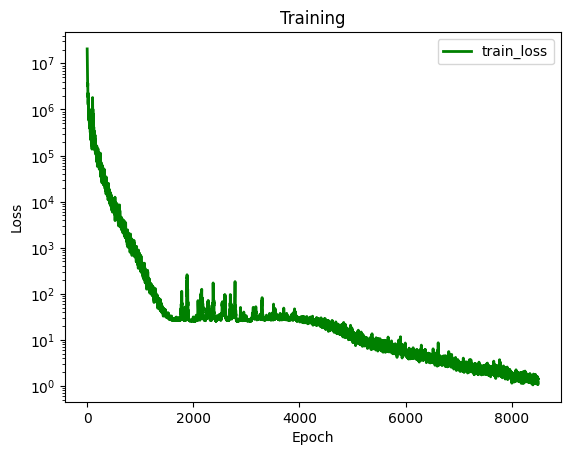

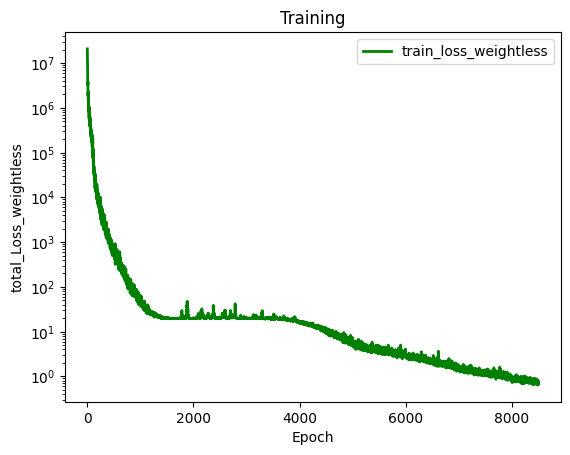

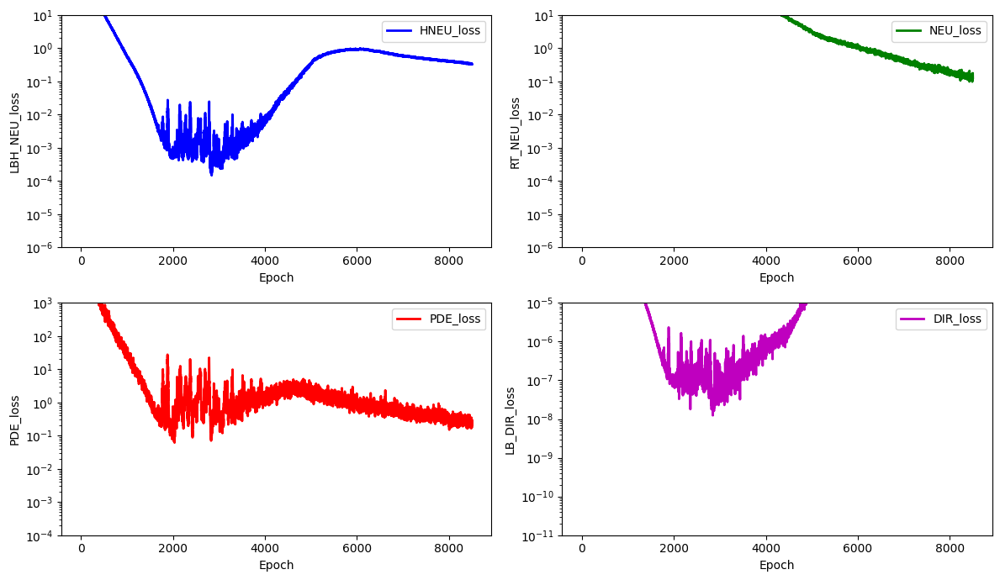

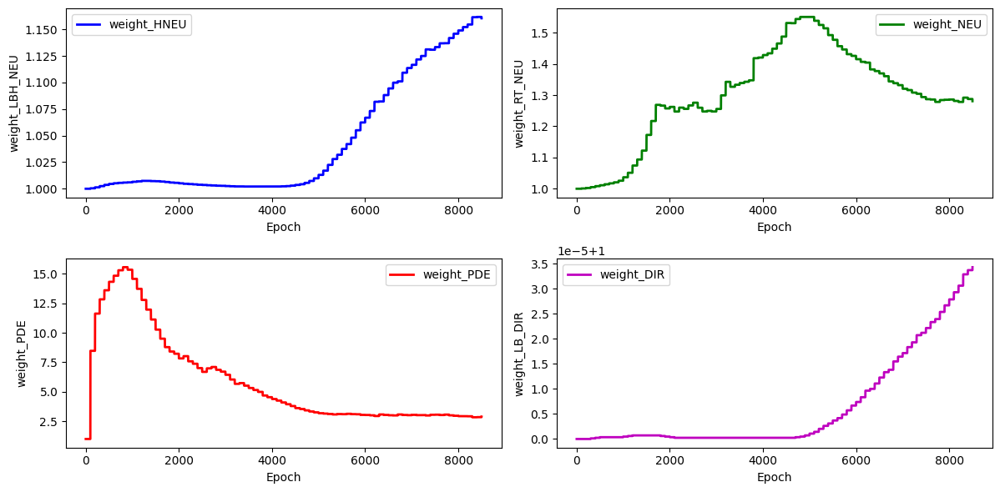

stress_Error for the stress_hole is: 10.64079912729645


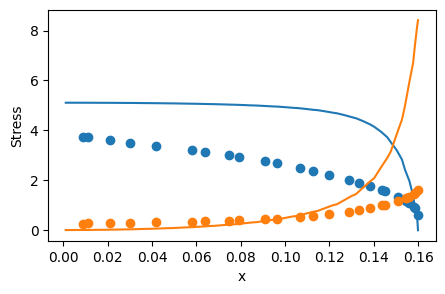

 57%|█████▋    | 8600/15000 [1:13:38<1:14:22,  1.43it/s]

for weight 0 norm_grad: 166.41183471679688
for weight 0 new lamda dach: 1.1232497692108154
for weight 0 new lamdaloss norm: 186.9220733642578
for weight 1 norm_grad: 229.603271484375
for weight 1 new lamda dach: 1.1784006357192993
for weight 1 new lamdaloss norm: 270.56463623046875
for weight 2 norm_grad: 1120.5452880859375
for weight 2 new lamda dach: 3.8291802406311035
for weight 2 new lamdaloss norm: 4290.7705078125
for weight 3 norm_grad: 0.05196861922740936
for weight 3 new lamda dach: 1.0000343322753906
for weight 3 new lamdaloss norm: 0.051970403641462326
for weight 0 new weight_value: 1.1566829681396484
for weight 1 new weight_value: 1.270403504371643
for weight 2 new weight_value: 2.9839203357696533
for weight 3 new weight_value: 1.0000343322753906


 58%|█████▊    | 8700/15000 [1:14:44<1:11:49,  1.46it/s]

for weight 0 norm_grad: 161.8306121826172
for weight 0 new lamda dach: 1.1341290473937988
for weight 0 new lamdaloss norm: 183.53680419921875
for weight 1 norm_grad: 248.80604553222656
for weight 1 new lamda dach: 1.2222368717193604
for weight 1 new lamdaloss norm: 304.09991455078125
for weight 2 norm_grad: 957.6719970703125
for weight 2 new lamda dach: 3.331875801086426
for weight 2 new lamdaloss norm: 3190.84423828125
for weight 3 norm_grad: 0.05072915181517601
for weight 3 new lamda dach: 1.0000370740890503
for weight 3 new lamdaloss norm: 0.050731029361486435
for weight 0 new weight_value: 1.1544275283813477
for weight 1 new weight_value: 1.2655868530273438
for weight 2 new weight_value: 3.0187158584594727
for weight 3 new weight_value: 1.0000345706939697


 59%|█████▊    | 8800/15000 [1:15:50<1:10:36,  1.46it/s]

for weight 0 norm_grad: 148.9495391845703
for weight 0 new lamda dach: 1.1450963020324707
for weight 0 new lamdaloss norm: 170.5615692138672
for weight 1 norm_grad: 263.6617736816406
for weight 1 new lamda dach: 1.289151906967163
for weight 1 new lamdaloss norm: 339.90008544921875
for weight 2 norm_grad: 762.843505859375
for weight 2 new lamda dach: 2.848586082458496
for weight 2 new lamdaloss norm: 2173.025390625
for weight 3 norm_grad: 0.0518646165728569
for weight 3 new lamda dach: 1.0000441074371338
for weight 3 new lamdaloss norm: 0.05186690390110016
for weight 0 new weight_value: 1.1534943580627441
for weight 1 new weight_value: 1.2679433822631836
for weight 2 new weight_value: 3.0017027854919434
for weight 3 new weight_value: 1.0000355243682861


 59%|█████▉    | 8900/15000 [1:16:55<1:09:34,  1.46it/s]

for weight 0 norm_grad: 150.7516632080078
for weight 0 new lamda dach: 1.1301778554916382
for weight 0 new lamdaloss norm: 170.37619018554688
for weight 1 norm_grad: 236.0746612548828
for weight 1 new lamda dach: 1.2200708389282227
for weight 1 new lamdaloss norm: 288.0278015136719
for weight 2 norm_grad: 921.9197387695312
for weight 2 new lamda dach: 3.3829824924468994
for weight 2 new lamdaloss norm: 3118.83837890625
for weight 3 norm_grad: 0.0500384196639061
for weight 3 new lamda dach: 1.0000382661819458
for weight 3 new lamdaloss norm: 0.05004033446311951
for weight 0 new weight_value: 1.1511627435684204
for weight 1 new weight_value: 1.2631561756134033
for weight 2 new weight_value: 3.0398306846618652
for weight 3 new weight_value: 1.0000357627868652


 60%|█████▉    | 8999/15000 [1:18:01<1:06:26,  1.51it/s]

for weight 0 norm_grad: 134.8155975341797
for weight 0 new lamda dach: 1.1356899738311768
for weight 0 new lamdaloss norm: 153.1087188720703
for weight 1 norm_grad: 223.0009765625
for weight 1 new lamda dach: 1.2463089227676392
for weight 1 new lamdaloss norm: 277.9281005859375
for weight 2 norm_grad: 770.506103515625
for weight 2 new lamda dach: 3.153057813644409
for weight 2 new lamdaloss norm: 2429.450439453125
for weight 3 norm_grad: 0.049376118928194046
for weight 3 new lamda dach: 1.0000437498092651
for weight 3 new lamdaloss norm: 0.049378275871276855
for weight 0 new weight_value: 1.1496154069900513
for weight 1 new weight_value: 1.2614715099334717
for weight 2 new weight_value: 3.0511531829833984
for weight 3 new weight_value: 1.0000364780426025
total_loss: 0.6671172976493835, hole_loss:  0.25331926345825195,neumann_loss:  0.11194194853305817, pde_loss: 0.26899904012680054,dirichlet_loss: 0.0001353106345050037


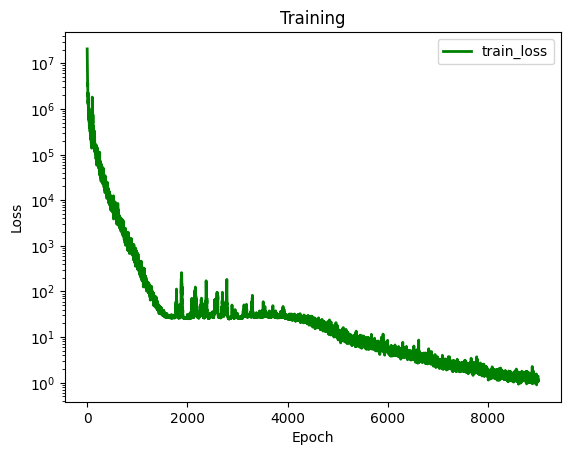

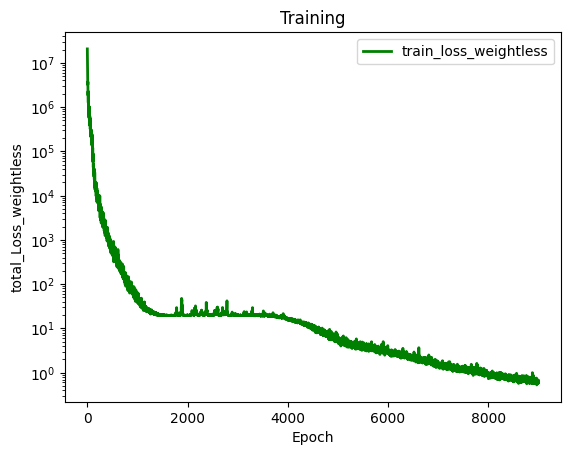

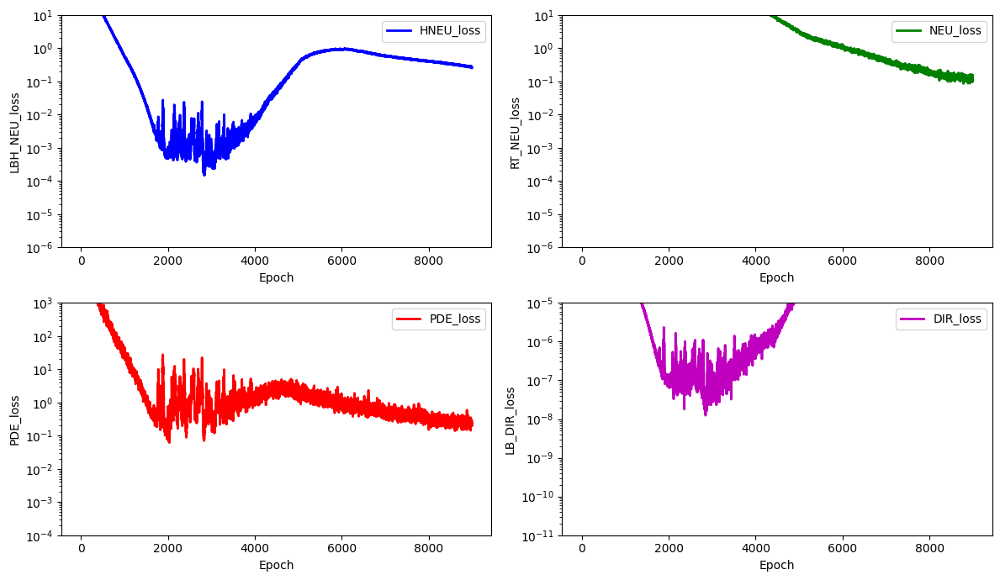

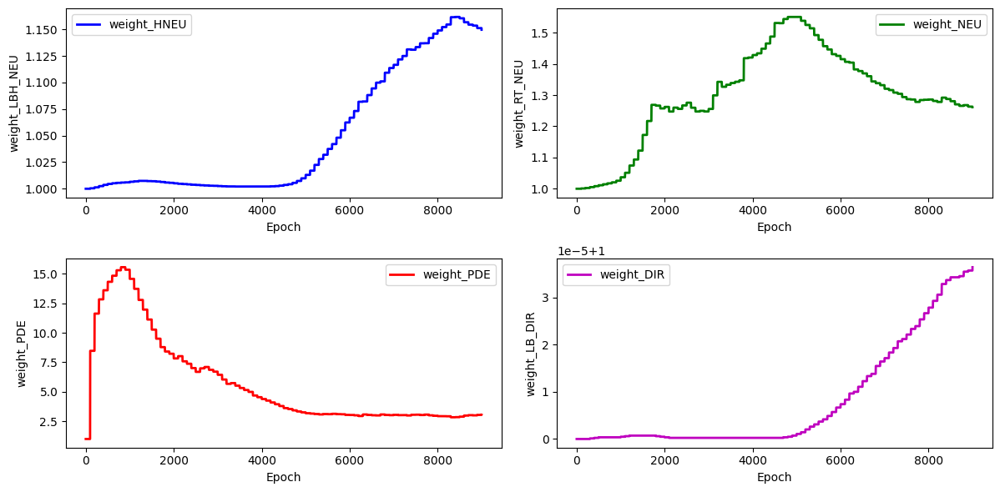

stress_Error for the stress_hole is: 10.6310170098208


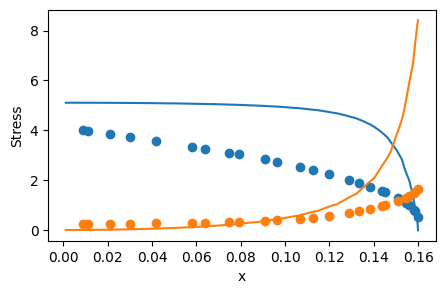

 61%|██████    | 9100/15000 [1:19:15<1:05:13,  1.51it/s]

for weight 0 norm_grad: 139.771240234375
for weight 0 new lamda dach: 1.1655261516571045
for weight 0 new lamdaloss norm: 162.90704345703125
for weight 1 norm_grad: 208.3805389404297
for weight 1 new lamda dach: 1.2686020135879517
for weight 1 new lamdaloss norm: 264.3519592285156
for weight 2 norm_grad: 635.9760131835938
for weight 2 new lamda dach: 2.8264617919921875
for weight 2 new lamdaloss norm: 1797.5618896484375
for weight 3 norm_grad: 0.04929732158780098
for weight 3 new lamda dach: 1.0000500679016113
for weight 3 new lamdaloss norm: 0.04929979518055916
for weight 0 new weight_value: 1.151206374168396
for weight 1 new weight_value: 1.2621846199035645
for weight 2 new weight_value: 3.02868390083313
for weight 3 new weight_value: 1.0000377893447876


 61%|██████▏   | 9200/15000 [1:20:24<1:07:10,  1.44it/s]

for weight 0 norm_grad: 133.91539001464844
for weight 0 new lamda dach: 1.1313396692276
for weight 0 new lamdaloss norm: 151.5037841796875
for weight 1 norm_grad: 224.1736602783203
for weight 1 new lamda dach: 1.2412148714065552
for weight 1 new lamdaloss norm: 278.2476806640625
for weight 2 norm_grad: 795.3884887695312
for weight 2 new lamda dach: 3.2209010124206543
for weight 2 new lamdaloss norm: 2561.86767578125
for weight 3 norm_grad: 0.04871995374560356
for weight 3 new lamda dach: 1.000042200088501
for weight 3 new lamdaloss norm: 0.04872201010584831
for weight 0 new weight_value: 1.1492197513580322
for weight 1 new weight_value: 1.2600877285003662
for weight 2 new weight_value: 3.047905683517456
for weight 3 new weight_value: 1.0000382661819458


 62%|██████▏   | 9300/15000 [1:21:30<1:07:04,  1.42it/s]

for weight 0 norm_grad: 132.7042694091797
for weight 0 new lamda dach: 1.1332523822784424
for weight 0 new lamdaloss norm: 150.38742065429688
for weight 1 norm_grad: 230.6304473876953
for weight 1 new lamda dach: 1.256838083267212
for weight 1 new lamdaloss norm: 289.8651428222656
for weight 2 norm_grad: 765.208740234375
for weight 2 new lamda dach: 3.1057958602905273
for weight 2 new lamdaloss norm: 2376.582275390625
for weight 3 norm_grad: 0.04750102013349533
for weight 3 new lamda dach: 1.0000420808792114
for weight 3 new lamdaloss norm: 0.047503016889095306
for weight 0 new weight_value: 1.1476229429244995
for weight 1 new weight_value: 1.2597627639770508
for weight 2 new weight_value: 3.053694486618042
for weight 3 new weight_value: 1.0000386238098145


 63%|██████▎   | 9400/15000 [1:22:38<53:15,  1.75it/s]  

for weight 0 norm_grad: 131.33030700683594
for weight 0 new lamda dach: 1.153903841972351
for weight 0 new lamdaloss norm: 151.5425567626953
for weight 1 norm_grad: 212.77980041503906
for weight 1 new lamda dach: 1.275665283203125
for weight 1 new lamdaloss norm: 271.435791015625
for weight 2 norm_grad: 640.4994506835938
for weight 2 new lamda dach: 2.8610634803771973
for weight 2 new lamdaloss norm: 1832.509521484375
for weight 3 norm_grad: 0.047654591500759125
for weight 3 new lamda dach: 1.0000483989715576
for weight 3 new lamdaloss norm: 0.04765690118074417
for weight 0 new weight_value: 1.1482510566711426
for weight 1 new weight_value: 1.2613530158996582
for weight 2 new weight_value: 3.034431219100952
for weight 3 new weight_value: 1.0000395774841309


 63%|██████▎   | 9499/15000 [1:23:43<41:10,  2.23it/s]  

for weight 0 norm_grad: 123.15632629394531
for weight 0 new lamda dach: 1.133434534072876
for weight 0 new lamdaloss norm: 139.58963012695312
for weight 1 norm_grad: 211.28355407714844
for weight 1 new lamda dach: 1.2530813217163086
for weight 1 new lamdaloss norm: 264.7554626464844
for weight 2 norm_grad: 711.6416015625
for weight 2 new lamda dach: 3.127563953399658
for weight 2 new lamdaloss norm: 2225.70458984375
for weight 3 norm_grad: 0.04664060100913048
for weight 3 new lamda dach: 1.000044584274292
for weight 3 new lamdaloss norm: 0.04664268344640732
for weight 0 new weight_value: 1.146769404411316
for weight 1 new weight_value: 1.2605258226394653
for weight 2 new weight_value: 3.0437443256378174
for weight 3 new weight_value: 1.000040054321289
total_loss: 0.46533331274986267, hole_loss:  0.22898611426353455,neumann_loss:  0.10266067832708359, pde_loss: 0.12577328085899353,dirichlet_loss: 0.00012222181248944253


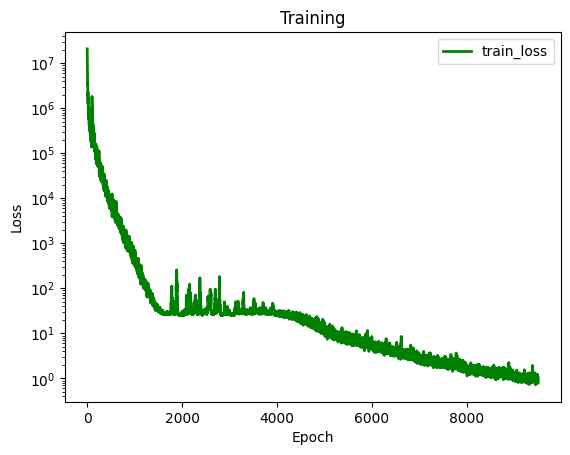

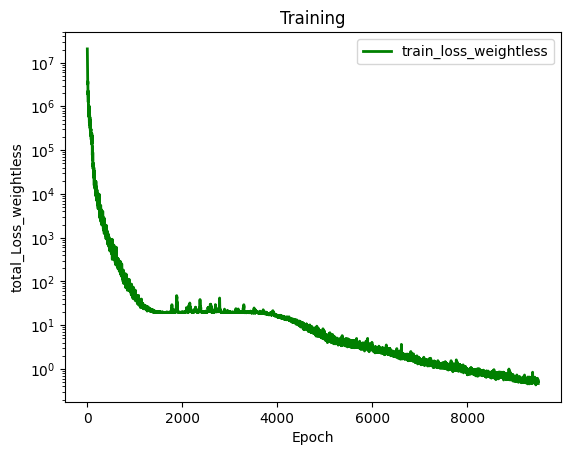

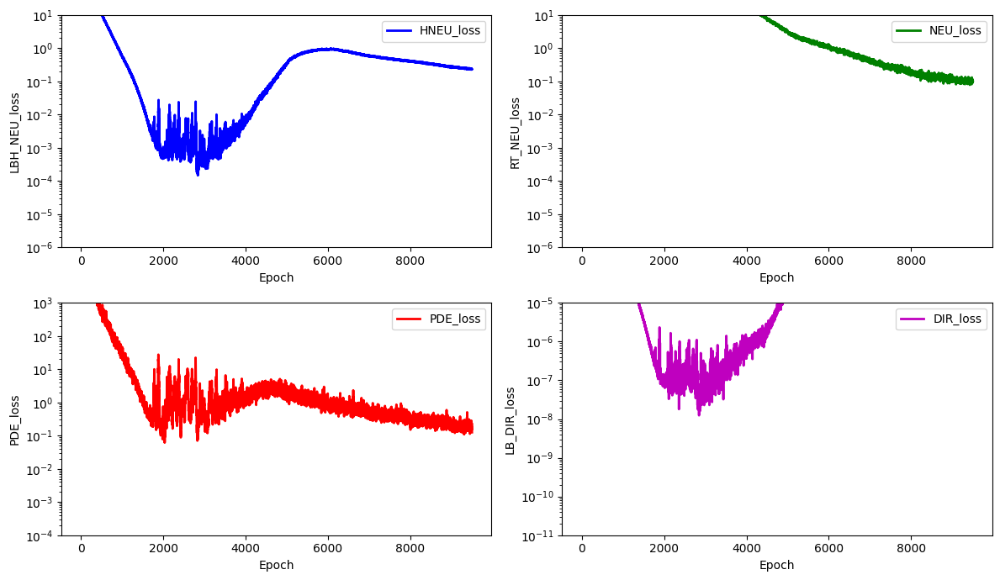

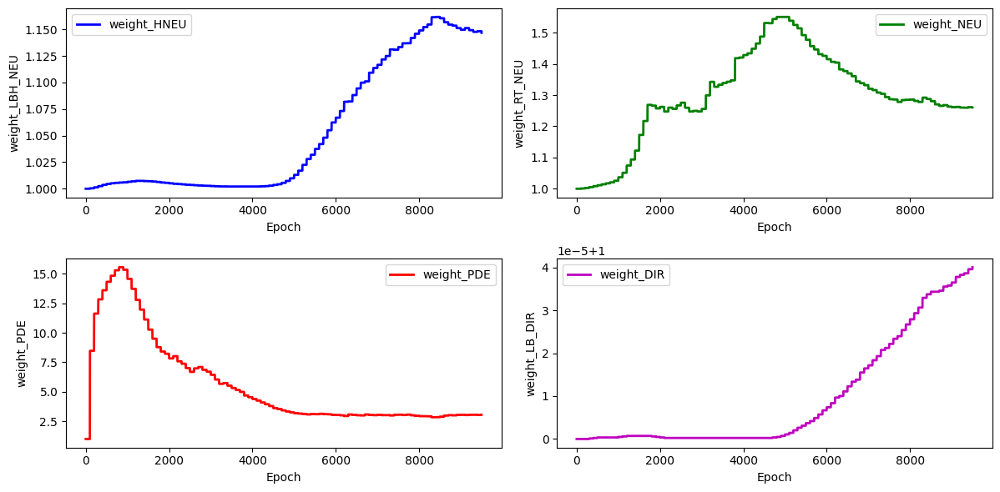

stress_Error for the stress_hole is: 10.527683276400305


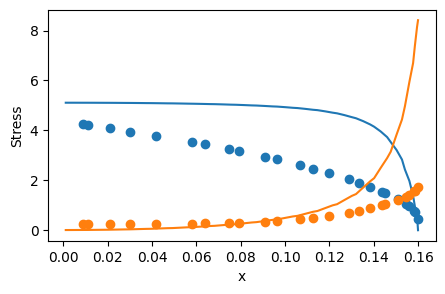

 64%|██████▍   | 9600/15000 [1:24:57<1:03:34,  1.42it/s]

for weight 0 norm_grad: 123.60011291503906
for weight 0 new lamda dach: 1.1596417427062988
for weight 0 new lamdaloss norm: 143.33184814453125
for weight 1 norm_grad: 186.0966033935547
for weight 1 new lamda dach: 1.2614680528640747
for weight 1 new lamdaloss norm: 234.7549285888672
for weight 2 norm_grad: 588.09130859375
for weight 2 new lamda dach: 2.898643970489502
for weight 2 new lamdaloss norm: 1704.66748046875
for weight 3 norm_grad: 0.04610293731093407
for weight 3 new lamda dach: 1.0000513792037964
for weight 3 new lamdaloss norm: 0.04610530659556389
for weight 0 new weight_value: 1.1480566263198853
for weight 1 new weight_value: 1.2606199979782104
for weight 2 new weight_value: 3.0292341709136963
for weight 3 new weight_value: 1.000041127204895


 65%|██████▍   | 9700/15000 [1:26:05<1:01:57,  1.43it/s]

for weight 0 norm_grad: 119.98297882080078
for weight 0 new lamda dach: 1.153855562210083
for weight 0 new lamdaloss norm: 138.4430389404297
for weight 1 norm_grad: 183.75296020507812
for weight 1 new lamda dach: 1.2566125392913818
for weight 1 new lamdaloss norm: 230.90626525878906
for weight 2 norm_grad: 596.0416259765625
for weight 2 new lamda dach: 2.9620656967163086
for weight 2 new lamdaloss norm: 1765.514404296875
for weight 3 norm_grad: 0.04674495756626129
for weight 3 new lamda dach: 1.0000519752502441
for weight 3 new lamdaloss norm: 0.04674738645553589
for weight 0 new weight_value: 1.1486364603042603
for weight 1 new weight_value: 1.2602192163467407
for weight 2 new weight_value: 3.022517204284668
for weight 3 new weight_value: 1.000042200088501


 65%|██████▌   | 9800/15000 [1:27:14<1:00:44,  1.43it/s]

for weight 0 norm_grad: 116.61958312988281
for weight 0 new lamda dach: 1.1527894735336304
for weight 0 new lamdaloss norm: 134.4378204345703
for weight 1 norm_grad: 194.88751220703125
for weight 1 new lamda dach: 1.2845065593719482
for weight 1 new lamdaloss norm: 250.3342742919922
for weight 2 norm_grad: 568.3370361328125
for weight 2 new lamda dach: 2.8242104053497314
for weight 2 new lamdaloss norm: 1605.103515625
for weight 3 norm_grad: 0.04526887461543083
for weight 3 new lamda dach: 1.000051498413086
for weight 3 new lamdaloss norm: 0.04527120664715767
for weight 0 new weight_value: 1.1490517854690552
for weight 1 new weight_value: 1.2626478672027588
for weight 2 new weight_value: 3.0026865005493164
for weight 3 new weight_value: 1.0000431537628174


 66%|██████▌   | 9900/15000 [1:28:22<58:12,  1.46it/s]  

for weight 0 norm_grad: 112.97351837158203
for weight 0 new lamda dach: 1.1444196701049805
for weight 0 new lamdaloss norm: 129.28912353515625
for weight 1 norm_grad: 199.43060302734375
for weight 1 new lamda dach: 1.2866201400756836
for weight 1 new lamdaloss norm: 256.5914001464844
for weight 2 norm_grad: 582.7830810546875
for weight 2 new lamda dach: 2.8652126789093018
for weight 2 new lamdaloss norm: 1669.7974853515625
for weight 3 norm_grad: 0.044467754662036896
for weight 3 new lamda dach: 1.0000497102737427
for weight 3 new lamdaloss norm: 0.04446996748447418
for weight 0 new weight_value: 1.1485885381698608
for weight 1 new weight_value: 1.2650450468063354
for weight 2 new weight_value: 2.988939046859741
for weight 3 new weight_value: 1.0000438690185547


 67%|██████▋   | 9999/15000 [1:29:30<57:00,  1.46it/s]  

for weight 0 norm_grad: 106.71685791015625
for weight 0 new lamda dach: 1.1359866857528687
for weight 0 new lamdaloss norm: 121.22891998291016
for weight 1 norm_grad: 171.64352416992188
for weight 1 new lamda dach: 1.238449215888977
for weight 1 new lamdaloss norm: 212.57177734375
for weight 2 norm_grad: 613.0712280273438
for weight 2 new lamda dach: 3.2020843029022217
for weight 2 new lamdaloss norm: 1963.1058349609375
for weight 3 norm_grad: 0.04458513855934143
for weight 3 new lamda dach: 1.0000499486923218
for weight 3 new lamdaloss norm: 0.04458736628293991
for weight 0 new weight_value: 1.1473283767700195
for weight 1 new weight_value: 1.262385368347168
for weight 2 new weight_value: 3.010253429412842
for weight 3 new weight_value: 1.0000444650650024
total_loss: 0.416574090719223, hole_loss:  0.19797931611537933,neumann_loss:  0.07283632457256317, pde_loss: 0.1244691014289856,dirichlet_loss: 0.00011025900312233716


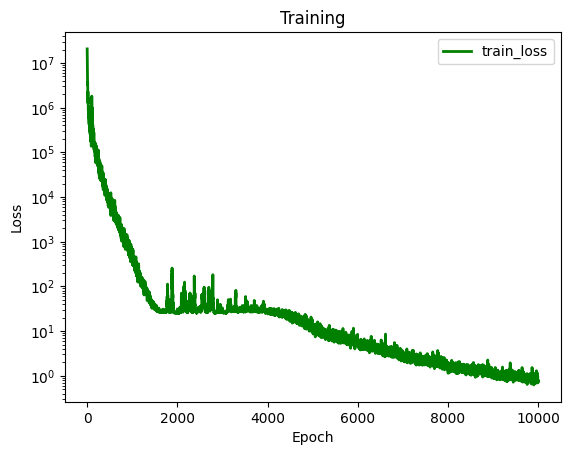

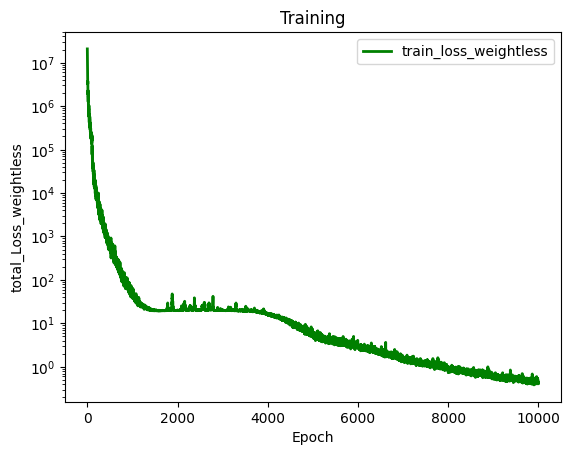

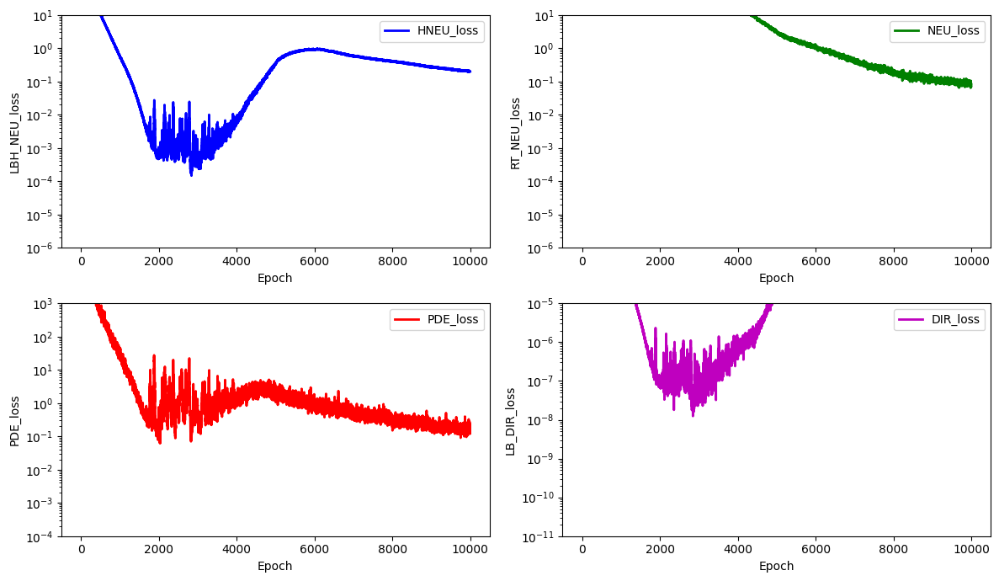

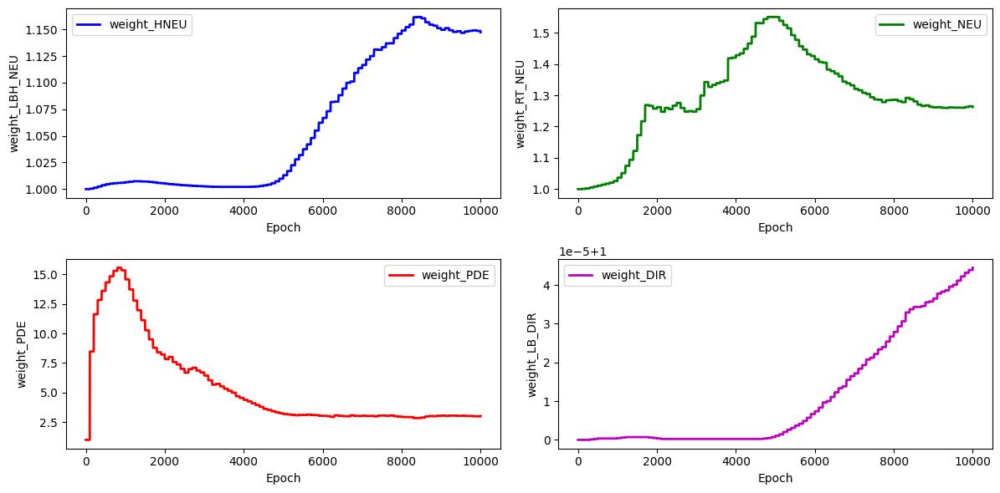

stress_Error for the stress_hole is: 10.537324843934034


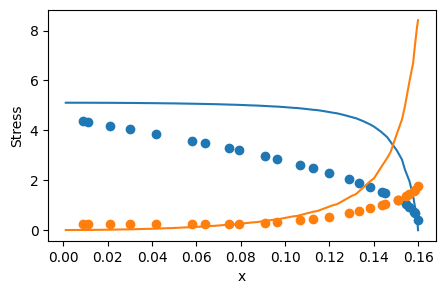

 67%|██████▋   | 10100/15000 [1:30:45<57:37,  1.42it/s]  

for weight 0 norm_grad: 110.48875427246094
for weight 0 new lamda dach: 1.1269718408584595
for weight 0 new lamdaloss norm: 124.51770782470703
for weight 1 norm_grad: 196.25540161132812
for weight 1 new lamda dach: 1.250192642211914
for weight 1 new lamdaloss norm: 245.35707092285156
for weight 2 norm_grad: 673.8840942382812
for weight 2 new lamda dach: 3.1965770721435547
for weight 2 new lamdaloss norm: 2154.12255859375
for weight 3 norm_grad: 0.04412415623664856
for weight 3 new lamda dach: 1.0000449419021606
for weight 3 new lamdaloss norm: 0.04412614181637764
for weight 0 new weight_value: 1.1452927589416504
for weight 1 new weight_value: 1.2611660957336426
for weight 2 new weight_value: 3.028885841369629
for weight 3 new weight_value: 1.0000444650650024


 68%|██████▊   | 10200/15000 [1:31:54<56:41,  1.41it/s]

for weight 0 norm_grad: 108.08658599853516
for weight 0 new lamda dach: 1.1366366147994995
for weight 0 new lamdaloss norm: 122.85517883300781
for weight 1 norm_grad: 179.8749542236328
for weight 1 new lamda dach: 1.25008225440979
for weight 1 new lamdaloss norm: 224.85848999023438
for weight 2 norm_grad: 611.1328125
for weight 2 new lamda dach: 3.121951103210449
for weight 2 new lamdaloss norm: 1907.9268798828125
for weight 3 norm_grad: 0.04360324516892433
for weight 3 new lamda dach: 1.0000485181808472
for weight 3 new lamdaloss norm: 0.04360536113381386
for weight 0 new weight_value: 1.1444271802902222
for weight 1 new weight_value: 1.2600576877593994
for weight 2 new weight_value: 3.0381922721862793
for weight 3 new weight_value: 1.000044822692871


 69%|██████▊   | 10300/15000 [1:33:03<58:47,  1.33it/s]

for weight 0 norm_grad: 104.3593521118164
for weight 0 new lamda dach: 1.1330090761184692
for weight 0 new lamdaloss norm: 118.24009704589844
for weight 1 norm_grad: 159.43359375
for weight 1 new lamda dach: 1.2185431718826294
for weight 1 new lamdaloss norm: 194.27670288085938
for weight 2 norm_grad: 625.1259765625
for weight 2 new lamda dach: 3.369368314743042
for weight 2 new lamdaloss norm: 2106.279541015625
for weight 3 norm_grad: 0.04360209032893181
for weight 3 new lamda dach: 1.0000489950180054
for weight 3 new lamdaloss norm: 0.04360422492027283
for weight 0 new weight_value: 1.1432853937149048
for weight 1 new weight_value: 1.2559062242507935
for weight 2 new weight_value: 3.0713095664978027
for weight 3 new weight_value: 1.0000451803207397


 69%|██████▉   | 10400/15000 [1:34:13<54:31,  1.41it/s]  

for weight 0 norm_grad: 104.42790222167969
for weight 0 new lamda dach: 1.1332674026489258
for weight 0 new lamdaloss norm: 118.34473419189453
for weight 1 norm_grad: 199.64276123046875
for weight 1 new lamda dach: 1.2900173664093018
for weight 1 new lamdaloss norm: 257.5426330566406
for weight 2 norm_grad: 583.9111328125
for weight 2 new lamda dach: 2.920041799545288
for weight 2 new lamdaloss norm: 1705.044921875
for weight 3 norm_grad: 0.043087586760520935
for weight 3 new lamda dach: 1.0000485181808472
for weight 3 new lamdaloss norm: 0.04308968037366867
for weight 0 new weight_value: 1.14228355884552
for weight 1 new weight_value: 1.2593172788619995
for weight 2 new weight_value: 3.056182622909546
for weight 3 new weight_value: 1.0000455379486084


 70%|██████▉   | 10499/15000 [1:35:22<57:32,  1.30it/s]

for weight 0 norm_grad: 97.39018249511719
for weight 0 new lamda dach: 1.1611526012420654
for weight 0 new lamdaloss norm: 113.0848617553711
for weight 1 norm_grad: 191.47853088378906
for weight 1 new lamda dach: 1.3752663135528564
for weight 1 new lamdaloss norm: 263.3339538574219
for weight 2 norm_grad: 412.8144226074219
for weight 2 new lamda dach: 2.428863525390625
for weight 2 new lamdaloss norm: 1002.6698608398438
for weight 3 norm_grad: 0.04237550124526024
for weight 3 new lamda dach: 1.0000603199005127
for weight 3 new lamdaloss norm: 0.04237806051969528
for weight 0 new weight_value: 1.1441704034805298
for weight 1 new weight_value: 1.2709121704101562
for weight 2 new weight_value: 2.99345064163208
for weight 3 new weight_value: 1.000046968460083
total_loss: 0.3756880462169647, hole_loss:  0.17848432064056396,neumann_loss:  0.08765525370836258, pde_loss: 0.09208868443965912,dirichlet_loss: 0.00010059568739961833


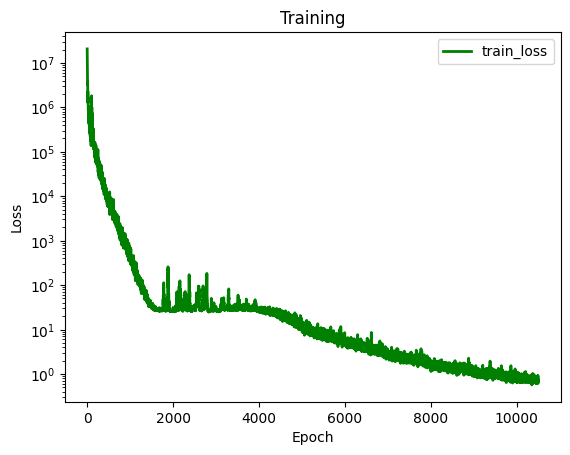

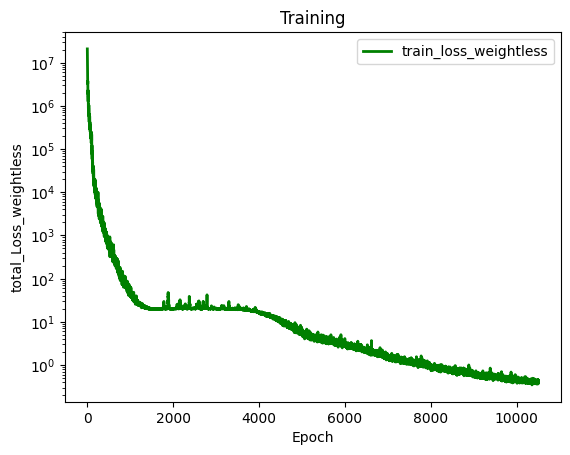

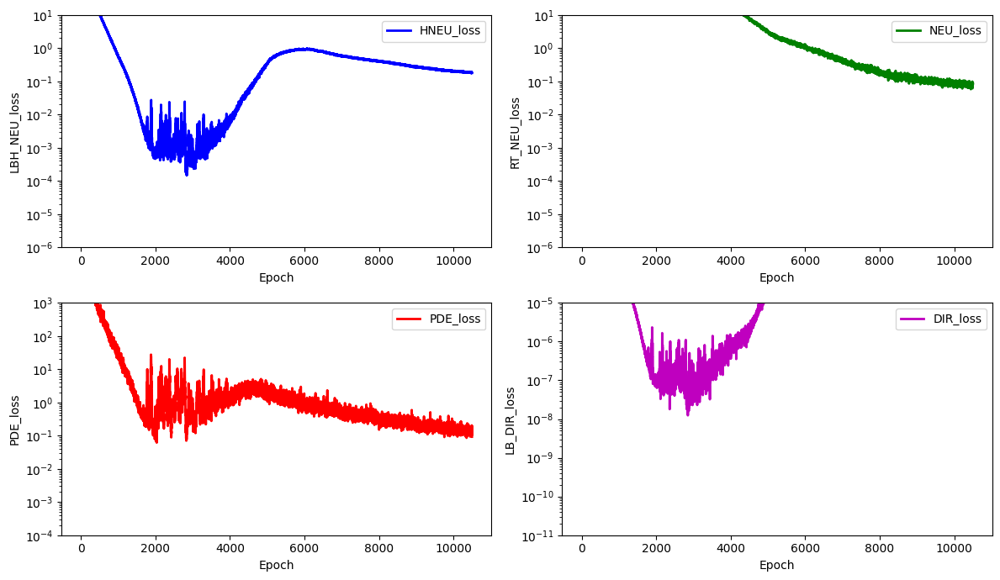

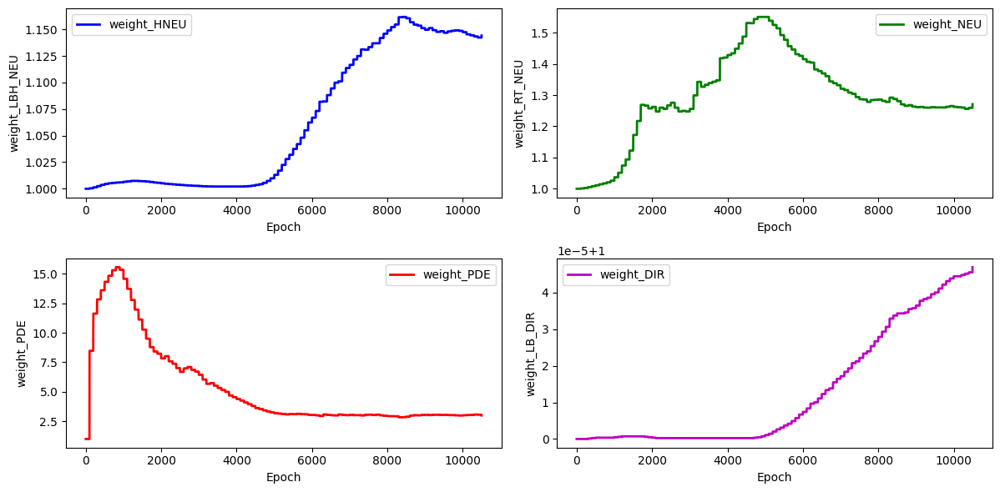

stress_Error for the stress_hole is: 10.468537619692563


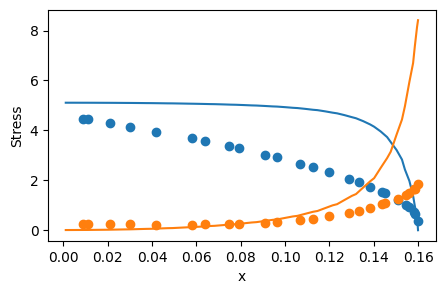

 71%|███████   | 10600/15000 [1:36:38<50:14,  1.46it/s]  

for weight 0 norm_grad: 95.86162567138672
for weight 0 new lamda dach: 1.1321310997009277
for weight 0 new lamdaloss norm: 108.52792358398438
for weight 1 norm_grad: 165.69105529785156
for weight 1 new lamda dach: 1.2527031898498535
for weight 1 new lamdaloss norm: 207.5616912841797
for weight 2 norm_grad: 559.7708129882812
for weight 2 new lamda dach: 3.1398398876190186
for weight 2 new lamdaloss norm: 1757.5906982421875
for weight 3 norm_grad: 0.04206936061382294
for weight 3 new lamda dach: 1.0000512599945068
for weight 3 new lamdaloss norm: 0.042071517556905746
for weight 0 new weight_value: 1.142966389656067
for weight 1 new weight_value: 1.269091248512268
for weight 2 new weight_value: 3.008089542388916
for weight 3 new weight_value: 1.0000473260879517


 71%|███████▏  | 10700/15000 [1:37:45<49:57,  1.43it/s]

for weight 0 norm_grad: 100.25236511230469
for weight 0 new lamda dach: 1.1524696350097656
for weight 0 new lamdaloss norm: 115.53780364990234
for weight 1 norm_grad: 173.5164794921875
for weight 1 new lamda dach: 1.296985387802124
for weight 1 new lamdaloss norm: 225.04833984375
for weight 2 norm_grad: 483.9652404785156
for weight 2 new lamda dach: 2.7675180435180664
for weight 2 new lamdaloss norm: 1339.38232421875
for weight 3 norm_grad: 0.04177814722061157
for weight 3 new lamda dach: 1.0000550746917725
for weight 3 new lamdaloss norm: 0.04178044572472572
for weight 0 new weight_value: 1.1439167261123657
for weight 1 new weight_value: 1.2718806266784668
for weight 2 new weight_value: 2.984032154083252
for weight 3 new weight_value: 1.0000481605529785


 72%|███████▏  | 10800/15000 [1:38:53<48:29,  1.44it/s]

for weight 0 norm_grad: 95.37892150878906
for weight 0 new lamda dach: 1.1253138780593872
for weight 0 new lamdaloss norm: 107.33123016357422
for weight 1 norm_grad: 193.80679321289062
for weight 1 new lamda dach: 1.2924537658691406
for weight 1 new lamdaloss norm: 250.486328125
for weight 2 norm_grad: 567.2715454101562
for weight 2 new lamda dach: 2.9613358974456787
for weight 2 new lamdaloss norm: 1679.8814697265625
for weight 3 norm_grad: 0.04135410860180855
for weight 3 new lamda dach: 1.000048279762268
for weight 3 new lamdaloss norm: 0.041356101632118225
for weight 0 new weight_value: 1.1420564651489258
for weight 1 new weight_value: 1.2739379405975342
for weight 2 new weight_value: 2.981762409210205
for weight 3 new weight_value: 1.0000481605529785


 73%|███████▎  | 10900/15000 [1:40:02<48:06,  1.42it/s]

for weight 0 norm_grad: 94.88643646240234
for weight 0 new lamda dach: 1.1177939176559448
for weight 0 new lamdaloss norm: 106.06348419189453
for weight 1 norm_grad: 178.32522583007812
for weight 1 new lamda dach: 1.2469568252563477
for weight 1 new lamdaloss norm: 222.36386108398438
for weight 2 norm_grad: 627.1630859375
for weight 2 new lamda dach: 3.2951772212982178
for weight 2 new lamdaloss norm: 2066.613525390625
for weight 3 norm_grad: 0.040900230407714844
for weight 3 new lamda dach: 1.0000454187393188
for weight 3 new lamdaloss norm: 0.04090208560228348
for weight 0 new weight_value: 1.1396300792694092
for weight 1 new weight_value: 1.2712397575378418
for weight 2 new weight_value: 3.01310396194458
for weight 3 new weight_value: 1.0000478029251099


 73%|███████▎  | 10999/15000 [1:41:06<44:38,  1.49it/s]

for weight 0 norm_grad: 95.51234436035156
for weight 0 new lamda dach: 1.118983268737793
for weight 0 new lamdaloss norm: 106.87672424316406
for weight 1 norm_grad: 195.89234924316406
for weight 1 new lamda dach: 1.2789069414138794
for weight 1 new lamdaloss norm: 250.528076171875
for weight 2 norm_grad: 606.8043823242188
for weight 2 new lamda dach: 3.0820531845092773
for weight 2 new lamdaloss norm: 1870.20361328125
for weight 3 norm_grad: 0.04045949503779411
for weight 3 new lamda dach: 1.0000450611114502
for weight 3 new lamdaloss norm: 0.04046131670475006
for weight 0 new weight_value: 1.1375653743743896
for weight 1 new weight_value: 1.2720065116882324
for weight 2 new weight_value: 3.019998788833618
for weight 3 new weight_value: 1.0000475645065308
total_loss: 0.3856339752674103, hole_loss:  0.17053824663162231,neumann_loss:  0.0848551020026207, pde_loss: 0.10590819269418716,dirichlet_loss: 9.243239037459716e-05


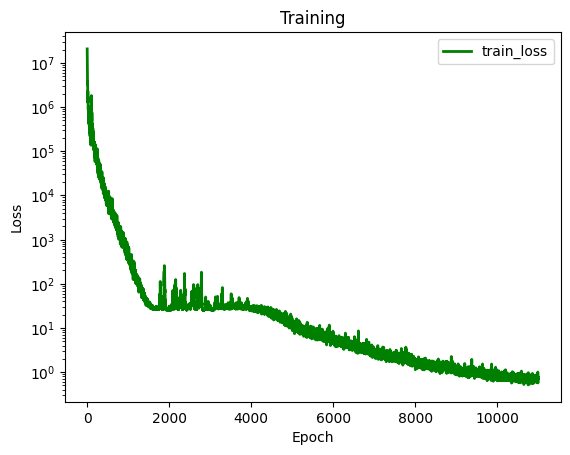

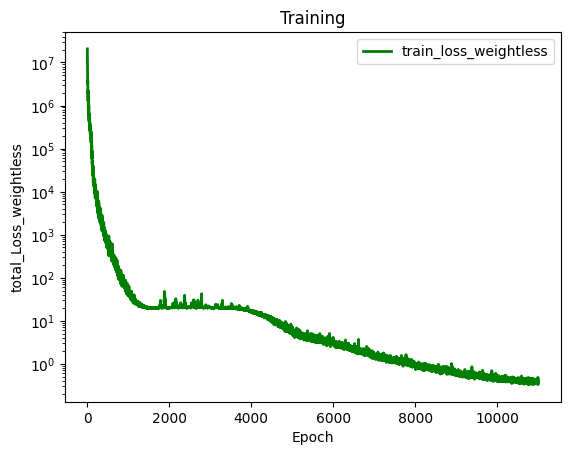

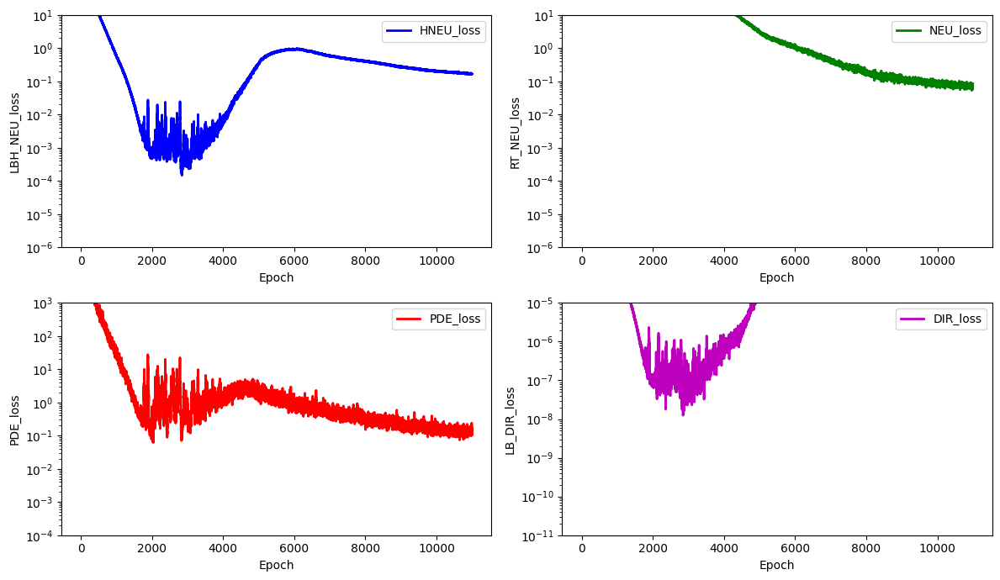

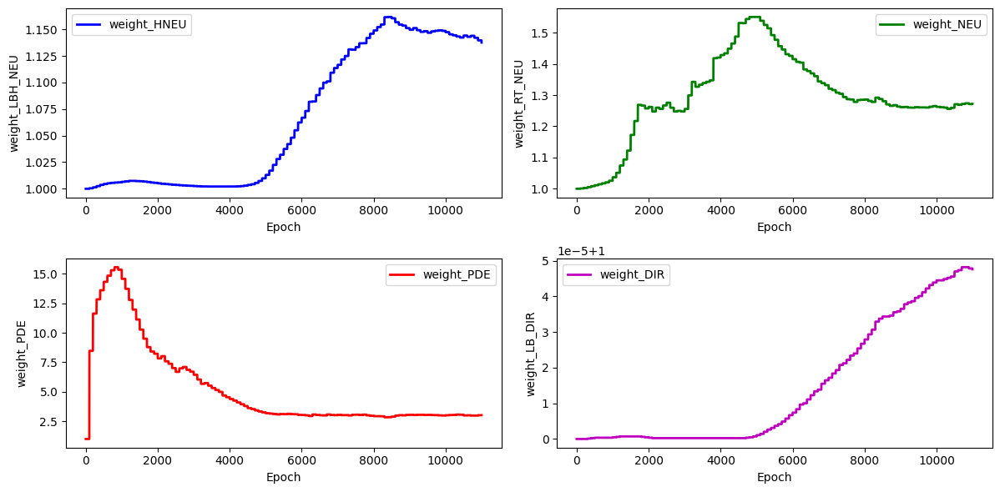

stress_Error for the stress_hole is: 10.473772513807447


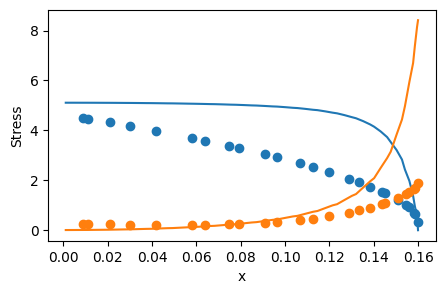

 74%|███████▍  | 11100/15000 [1:42:21<48:50,  1.33it/s]  

for weight 0 norm_grad: 90.83424377441406
for weight 0 new lamda dach: 1.1334542036056519
for weight 0 new lamdaloss norm: 102.95645904541016
for weight 1 norm_grad: 165.0631103515625
for weight 1 new lamda dach: 1.272196888923645
for weight 1 new lamdaloss norm: 209.99278259277344
for weight 2 norm_grad: 515.535400390625
for weight 2 new lamda dach: 3.0142955780029297
for weight 2 new lamdaloss norm: 1553.9759521484375
for weight 3 norm_grad: 0.04094546660780907
for weight 3 new lamda dach: 1.00005304813385
for weight 3 new lamdaloss norm: 0.04094763845205307
for weight 0 new weight_value: 1.137154221534729
for weight 1 new weight_value: 1.272025465965271
for weight 2 new weight_value: 3.019428253173828
for weight 3 new weight_value: 1.000048041343689


 75%|███████▍  | 11200/15000 [1:43:32<46:33,  1.36it/s]

for weight 0 norm_grad: 96.91325378417969
for weight 0 new lamda dach: 1.1514089107513428
for weight 0 new lamdaloss norm: 111.58678436279297
for weight 1 norm_grad: 173.49217224121094
for weight 1 new lamda dach: 1.307884693145752
for weight 1 new lamdaloss norm: 226.9077606201172
for weight 2 norm_grad: 466.5439453125
for weight 2 new lamda dach: 2.7250938415527344
for weight 2 new lamdaloss norm: 1271.3759765625
for weight 3 norm_grad: 0.04018393158912659
for weight 3 new lamda dach: 1.0000544786453247
for weight 3 new lamdaloss norm: 0.04018612205982208
for weight 0 new weight_value: 1.1385797262191772
for weight 1 new weight_value: 1.2756112813949585
for weight 2 new weight_value: 2.989994764328003
for weight 3 new weight_value: 1.0000486373901367


 75%|███████▌  | 11300/15000 [1:44:43<47:37,  1.29it/s]

for weight 0 norm_grad: 87.26156616210938
for weight 0 new lamda dach: 1.1483418941497803
for weight 0 new lamdaloss norm: 100.20610809326172
for weight 1 norm_grad: 183.13485717773438
for weight 1 new lamda dach: 1.3719432353973389
for weight 1 new lamdaloss norm: 251.25064086914062
for weight 2 norm_grad: 405.0714111328125
for weight 2 new lamda dach: 2.497842788696289
for weight 2 new lamdaloss norm: 1011.8046875
for weight 3 norm_grad: 0.04012778401374817
for weight 3 new lamda dach: 1.0000593662261963
for weight 3 new lamdaloss norm: 0.040130164474248886
for weight 0 new weight_value: 1.1395559310913086
for weight 1 new weight_value: 1.285244345664978
for weight 2 new weight_value: 2.940779447555542
for weight 3 new weight_value: 1.0000497102737427


 76%|███████▌  | 11400/15000 [1:45:55<48:49,  1.23it/s]  

for weight 0 norm_grad: 86.45649719238281
for weight 0 new lamda dach: 1.1464900970458984
for weight 0 new lamdaloss norm: 99.12151336669922
for weight 1 norm_grad: 144.36965942382812
for weight 1 new lamda dach: 1.2712323665618896
for weight 1 new lamdaloss norm: 183.5273895263672
for weight 2 norm_grad: 445.77691650390625
for weight 2 new lamda dach: 2.9308905601501465
for weight 2 new lamdaloss norm: 1306.5234375
for weight 3 norm_grad: 0.0397912822663784
for weight 3 new lamda dach: 1.0000587701797485
for weight 3 new lamdaloss norm: 0.03979361802339554
for weight 0 new weight_value: 1.1402493715286255
for weight 1 new weight_value: 1.2838431596755981
for weight 2 new weight_value: 2.9397904872894287
for weight 3 new weight_value: 1.000050663948059


 77%|███████▋  | 11499/15000 [1:47:14<43:49,  1.33it/s]  

for weight 0 norm_grad: 83.70589447021484
for weight 0 new lamda dach: 1.0993341207504272
for weight 0 new lamdaloss norm: 92.02074432373047
for weight 1 norm_grad: 169.12709045410156
for weight 1 new lamda dach: 1.223344087600708
for weight 1 new lamdaloss norm: 206.90061950683594
for weight 2 norm_grad: 673.5032958984375
for weight 2 new lamda dach: 3.6634061336517334
for weight 2 new lamdaloss norm: 2467.316162109375
for weight 3 norm_grad: 0.039947375655174255
for weight 3 new lamda dach: 1.0000430345535278
for weight 3 new lamdaloss norm: 0.03994910046458244
for weight 0 new weight_value: 1.136157751083374
for weight 1 new weight_value: 1.2777931690216064
for weight 2 new weight_value: 3.0121519565582275
for weight 3 new weight_value: 1.0000498294830322
total_loss: 0.36975806951522827, hole_loss:  0.15832442045211792,neumann_loss:  0.06783387064933777, pde_loss: 0.13112673163414001,dirichlet_loss: 8.965156303020194e-05


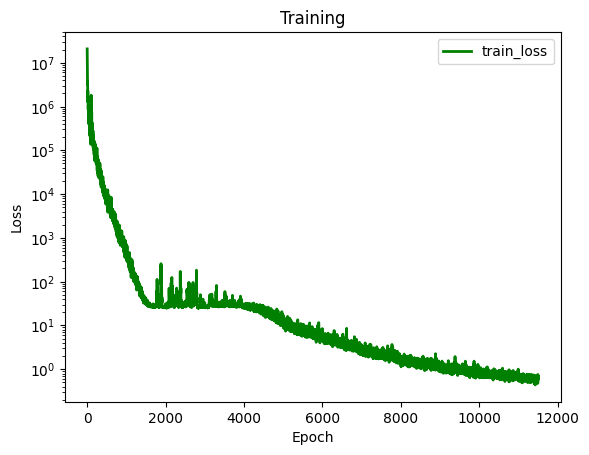

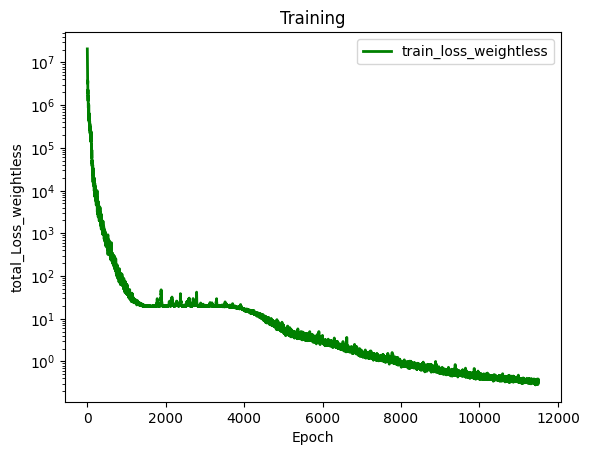

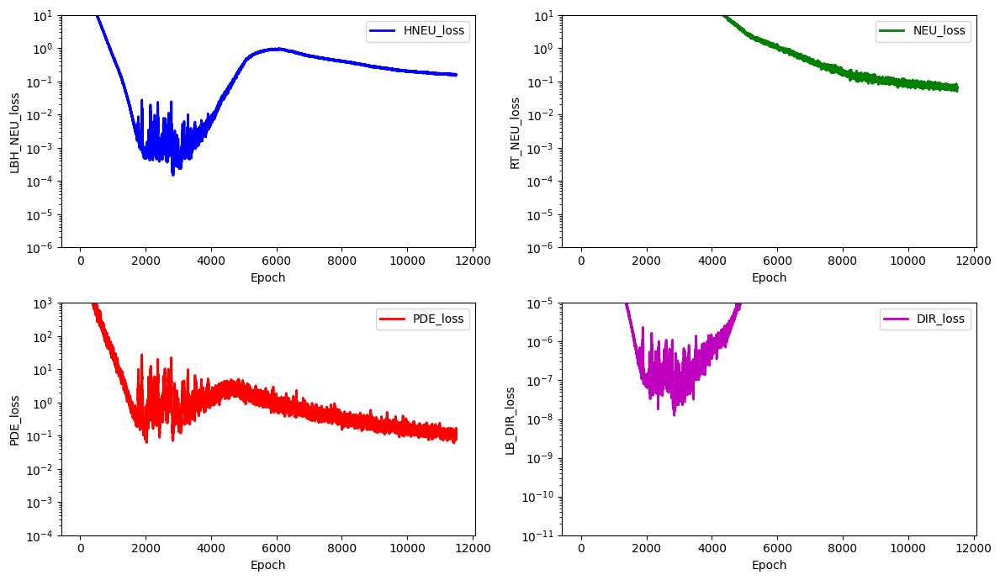

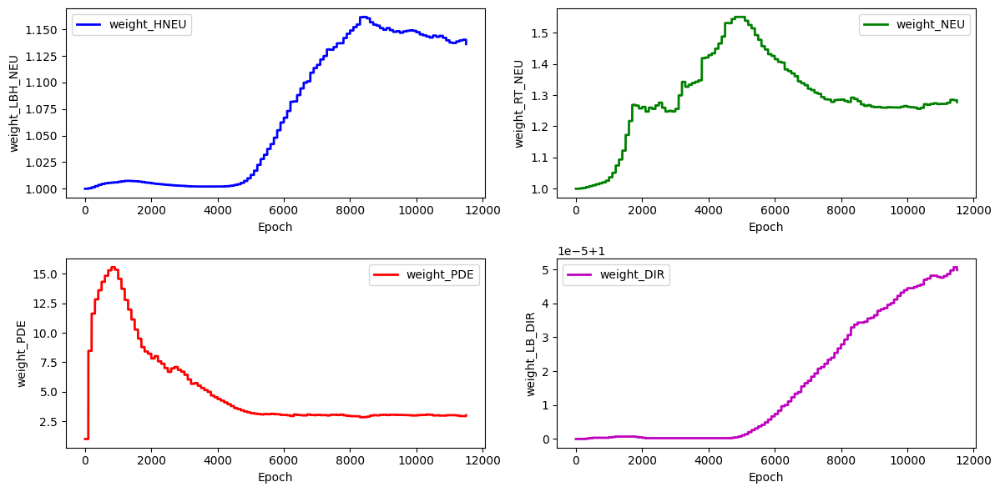

stress_Error for the stress_hole is: 10.608116872549873


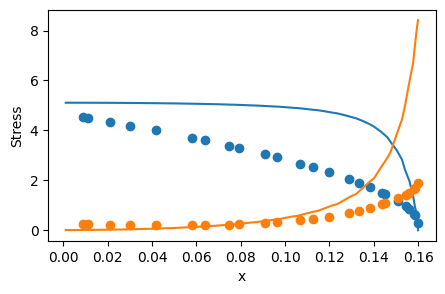

 77%|███████▋  | 11600/15000 [1:48:34<42:11,  1.34it/s]  

for weight 0 norm_grad: 88.68073272705078
for weight 0 new lamda dach: 1.1236799955368042
for weight 0 new lamdaloss norm: 99.64876556396484
for weight 1 norm_grad: 152.1931915283203
for weight 1 new lamda dach: 1.2328875064849854
for weight 1 new lamdaloss norm: 187.6370849609375
for weight 2 norm_grad: 564.785400390625
for weight 2 new lamda dach: 3.3443562984466553
for weight 2 new lamdaloss norm: 1888.84375
for weight 3 norm_grad: 0.0388912595808506
for weight 3 new lamda dach: 1.000048279762268
for weight 3 new lamdaloss norm: 0.03889313340187073
for weight 0 new weight_value: 1.134909987449646
for weight 1 new weight_value: 1.2733025550842285
for weight 2 new weight_value: 3.045372486114502
for weight 3 new weight_value: 1.0000495910644531


 78%|███████▊  | 11700/15000 [1:49:49<40:44,  1.35it/s]

for weight 0 norm_grad: 88.63164520263672
for weight 0 new lamda dach: 1.1031478643417358
for weight 0 new lamdaloss norm: 97.77381134033203
for weight 1 norm_grad: 175.44476318359375
for weight 1 new lamda dach: 1.2271262407302856
for weight 1 new lamdaloss norm: 215.29286193847656
for weight 2 norm_grad: 683.7843627929688
for weight 2 new lamda dach: 3.5889623165130615
for weight 2 new lamdaloss norm: 2454.076171875
for weight 3 norm_grad: 0.038791872560977936
for weight 3 new lamda dach: 1.0000410079956055
for weight 3 new lamdaloss norm: 0.03879345953464508
for weight 0 new weight_value: 1.1317336559295654
for weight 1 new weight_value: 1.2686848640441895
for weight 2 new weight_value: 3.0997314453125
for weight 3 new weight_value: 1.0000487565994263


 79%|███████▊  | 11800/15000 [1:51:10<54:22,  1.02s/it]  

for weight 0 norm_grad: 85.15866088867188
for weight 0 new lamda dach: 1.130895733833313
for weight 0 new lamdaloss norm: 96.30557250976562
for weight 1 norm_grad: 161.3721466064453
for weight 1 new lamda dach: 1.2809549570083618
for weight 1 new lamdaloss norm: 206.71046447753906
for weight 2 norm_grad: 489.17303466796875
for weight 2 new lamda dach: 2.9839186668395996
for weight 2 new lamdaloss norm: 1459.6524658203125
for weight 3 norm_grad: 0.03825056180357933
for weight 3 new lamda dach: 1.0000519752502441
for weight 3 new lamdaloss norm: 0.03825255110859871
for weight 0 new weight_value: 1.1316498517990112
for weight 1 new weight_value: 1.2699118852615356
for weight 2 new weight_value: 3.0881500244140625
for weight 3 new weight_value: 1.0000489950180054


 79%|███████▉  | 11900/15000 [1:52:28<36:09,  1.43it/s]

for weight 0 norm_grad: 85.86982727050781
for weight 0 new lamda dach: 1.1181583404541016
for weight 0 new lamdaloss norm: 96.01605987548828
for weight 1 norm_grad: 160.43069458007812
for weight 1 new lamda dach: 1.2459936141967773
for weight 1 new lamdaloss norm: 199.89559936523438
for weight 2 norm_grad: 566.2657470703125
for weight 2 new lamda dach: 3.298726797103882
for weight 2 new lamdaloss norm: 1867.9559326171875
for weight 3 norm_grad: 0.038323111832141876
for weight 3 new lamda dach: 1.000047206878662
for weight 3 new lamdaloss norm: 0.03832492604851723
for weight 0 new weight_value: 1.1303006410598755
for weight 1 new weight_value: 1.2675199508666992
for weight 2 new weight_value: 3.1092076301574707
for weight 3 new weight_value: 1.0000487565994263


 80%|███████▉  | 11999/15000 [1:53:37<35:56,  1.39it/s]

for weight 0 norm_grad: 82.43406677246094
for weight 0 new lamda dach: 1.1187505722045898
for weight 0 new lamdaloss norm: 92.22315979003906
for weight 1 norm_grad: 165.0086669921875
for weight 1 new lamda dach: 1.26979660987854
for weight 1 new lamdaloss norm: 209.52745056152344
for weight 2 norm_grad: 529.13134765625
for weight 2 new lamda dach: 3.138066291809082
for weight 2 new lamdaloss norm: 1660.4490966796875
for weight 3 norm_grad: 0.03850885480642319
for weight 3 new lamda dach: 1.0000495910644531
for weight 3 new lamdaloss norm: 0.0385107658803463
for weight 0 new weight_value: 1.129145622253418
for weight 1 new weight_value: 1.2677476406097412
for weight 2 new weight_value: 3.112093210220337
for weight 3 new weight_value: 1.0000487565994263
total_loss: 0.3025078773498535, hole_loss:  0.14595259726047516,neumann_loss:  0.07020609080791473, pde_loss: 0.08098702132701874,dirichlet_loss: 8.478272502543405e-05


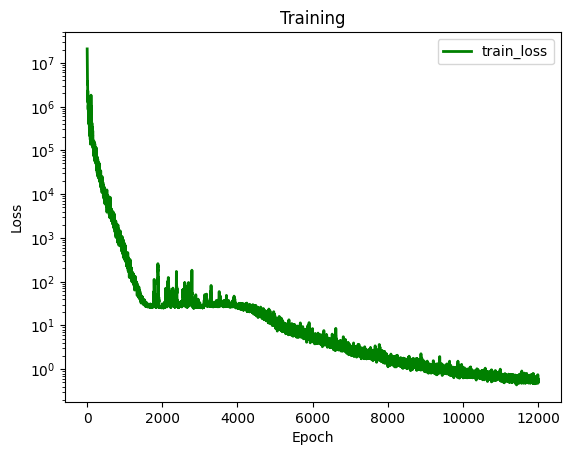

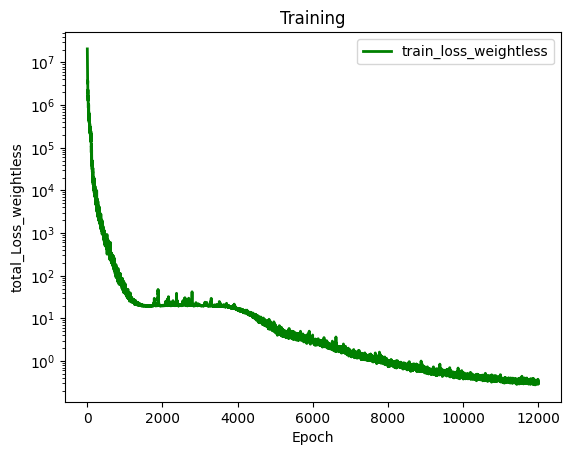

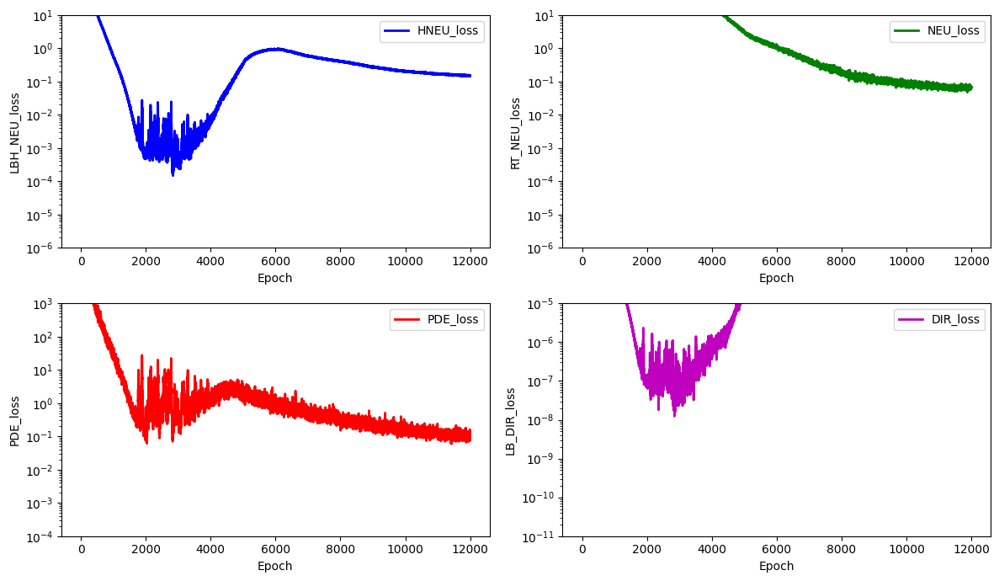

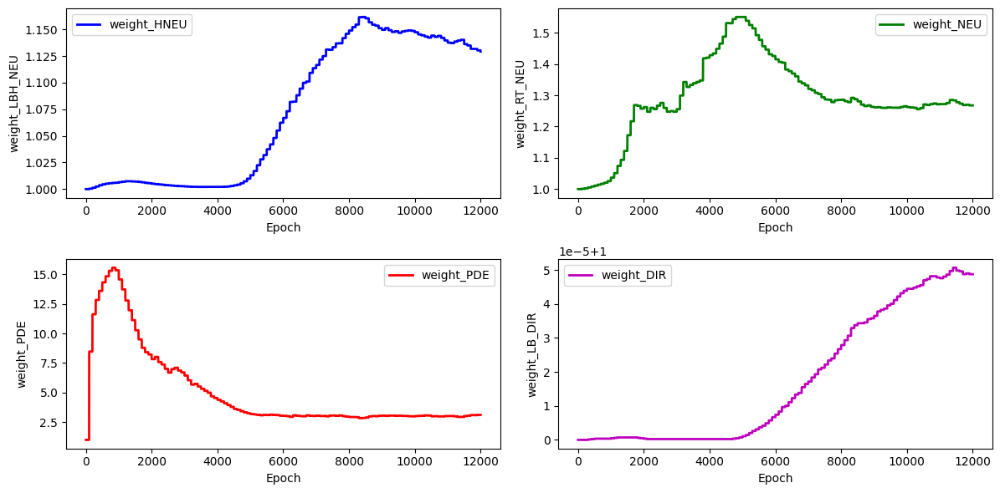

stress_Error for the stress_hole is: 10.553348942662335


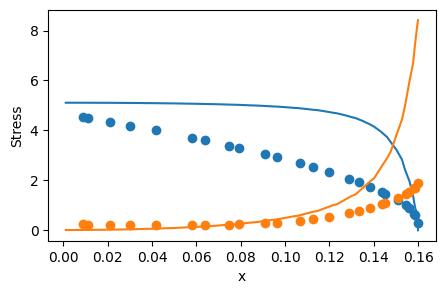

 81%|████████  | 12100/15000 [1:55:01<46:17,  1.04it/s]  

for weight 0 norm_grad: 82.75082397460938
for weight 0 new lamda dach: 1.15354323387146
for weight 0 new lamdaloss norm: 95.45664978027344
for weight 1 norm_grad: 151.08506774902344
for weight 1 new lamda dach: 1.3210430145263672
for weight 1 new lamdaloss norm: 199.58987426757812
for weight 2 norm_grad: 387.818359375
for weight 2 new lamda dach: 2.658238410949707
for weight 2 new lamdaloss norm: 1030.91357421875
for weight 3 norm_grad: 0.03786195069551468
for weight 3 new lamda dach: 1.0000609159469604
for weight 3 new lamdaloss norm: 0.03786425665020943
for weight 0 new weight_value: 1.1315853595733643
for weight 1 new weight_value: 1.273077130317688
for weight 2 new weight_value: 3.0667076110839844
for weight 3 new weight_value: 1.0000499486923218


 81%|████████▏ | 12200/15000 [1:56:34<50:26,  1.08s/it]  

for weight 0 norm_grad: 80.86510467529297
for weight 0 new lamda dach: 1.122314214706421
for weight 0 new lamdaloss norm: 90.75605010986328
for weight 1 norm_grad: 144.95506286621094
for weight 1 new lamda dach: 1.2427910566329956
for weight 1 new lamdaloss norm: 180.14886474609375
for weight 2 norm_grad: 516.1339111328125
for weight 2 new lamda dach: 3.2852206230163574
for weight 2 new lamdaloss norm: 1695.6138916015625
for weight 3 norm_grad: 0.03713999688625336
for weight 3 new lamda dach: 1.0000500679016113
for weight 3 new lamdaloss norm: 0.03714185953140259
for weight 0 new weight_value: 1.1306581497192383
for weight 1 new weight_value: 1.2700484991073608
for weight 2 new weight_value: 3.0885586738586426
for weight 3 new weight_value: 1.0000499486923218


 82%|████████▏ | 12300/15000 [1:57:45<31:21,  1.44it/s]

for weight 0 norm_grad: 82.991943359375
for weight 0 new lamda dach: 1.1538536548614502
for weight 0 new lamdaloss norm: 95.76055145263672
for weight 1 norm_grad: 142.79432678222656
for weight 1 new lamda dach: 1.2977246046066284
for weight 1 new lamdaloss norm: 185.3076934814453
for weight 2 norm_grad: 396.58953857421875
for weight 2 new lamda dach: 2.756192207336426
for weight 2 new lamdaloss norm: 1093.0770263671875
for weight 3 norm_grad: 0.03730183467268944
for weight 3 new lamda dach: 1.000059962272644
for weight 3 new lamdaloss norm: 0.037304073572158813
for weight 0 new weight_value: 1.1329777240753174
for weight 1 new weight_value: 1.2728160619735718
for weight 2 new weight_value: 3.0553219318389893
for weight 3 new weight_value: 1.0000509023666382


 83%|████████▎ | 12400/15000 [1:58:50<29:41,  1.46it/s]

for weight 0 norm_grad: 82.4509506225586
for weight 0 new lamda dach: 1.1685467958450317
for weight 0 new lamdaloss norm: 96.34779357910156
for weight 1 norm_grad: 151.81011962890625
for weight 1 new lamda dach: 1.3616005182266235
for weight 1 new lamdaloss norm: 206.70474243164062
for weight 2 norm_grad: 337.34051513671875
for weight 2 new lamda dach: 2.439793109893799
for weight 2 new lamdaloss norm: 823.0411376953125
for weight 3 norm_grad: 0.03688120096921921
for weight 3 new lamda dach: 1.000064492225647
for weight 3 new lamdaloss norm: 0.036883577704429626
for weight 0 new weight_value: 1.136534571647644
for weight 1 new weight_value: 1.2816944122314453
for weight 2 new weight_value: 2.9937689304351807
for weight 3 new weight_value: 1.0000522136688232


 83%|████████▎ | 12499/15000 [1:59:53<27:54,  1.49it/s]

for weight 0 norm_grad: 79.949462890625
for weight 0 new lamda dach: 1.1570631265640259
for weight 0 new lamdaloss norm: 92.50657653808594
for weight 1 norm_grad: 126.43270111083984
for weight 1 new lamda dach: 1.2733418941497803
for weight 1 new lamdaloss norm: 160.9920654296875
for weight 2 norm_grad: 382.5581970214844
for weight 2 new lamda dach: 2.8533120155334473
for weight 2 new lamdaloss norm: 1091.557861328125
for weight 3 norm_grad: 0.03648862987756729
for weight 3 new lamda dach: 1.0000619888305664
for weight 3 new lamdaloss norm: 0.03649089112877846
for weight 0 new weight_value: 1.1385873556137085
for weight 1 new weight_value: 1.2808592319488525
for weight 2 new weight_value: 2.9797232151031494
for weight 3 new weight_value: 1.0000531673431396
total_loss: 0.2914588153362274, hole_loss:  0.14023005962371826,neumann_loss:  0.05003596097230911, pde_loss: 0.09231431782245636,dirichlet_loss: 7.695059321122244e-05


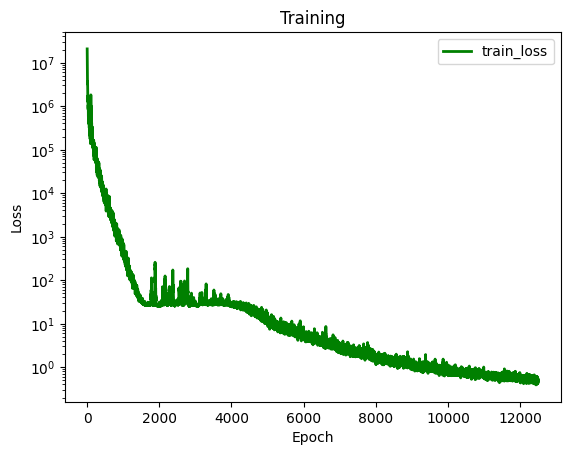

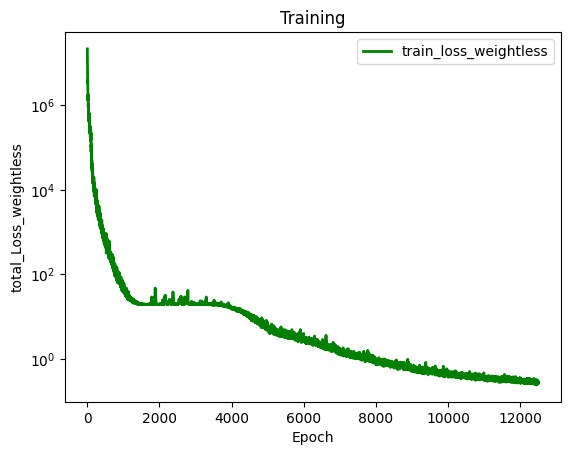

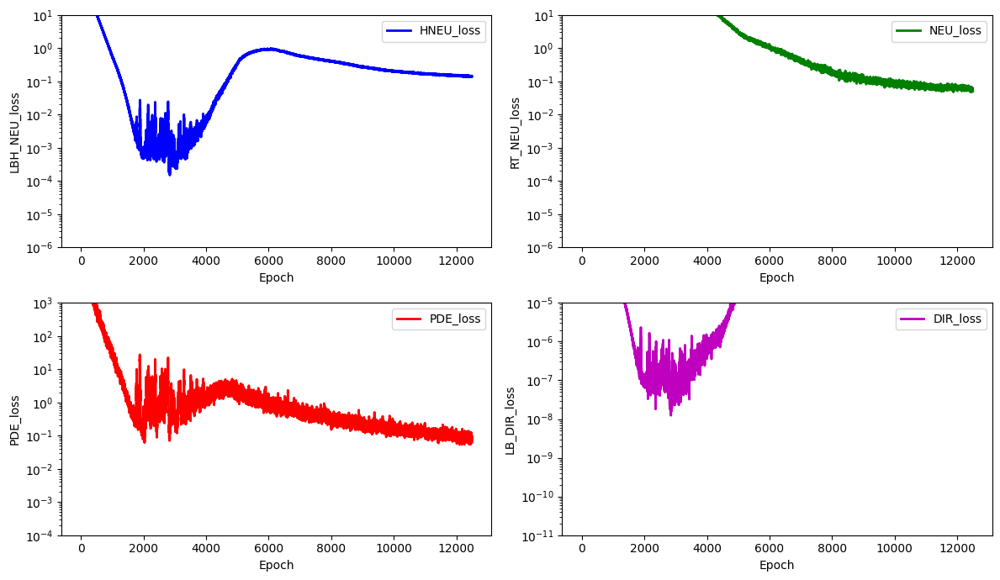

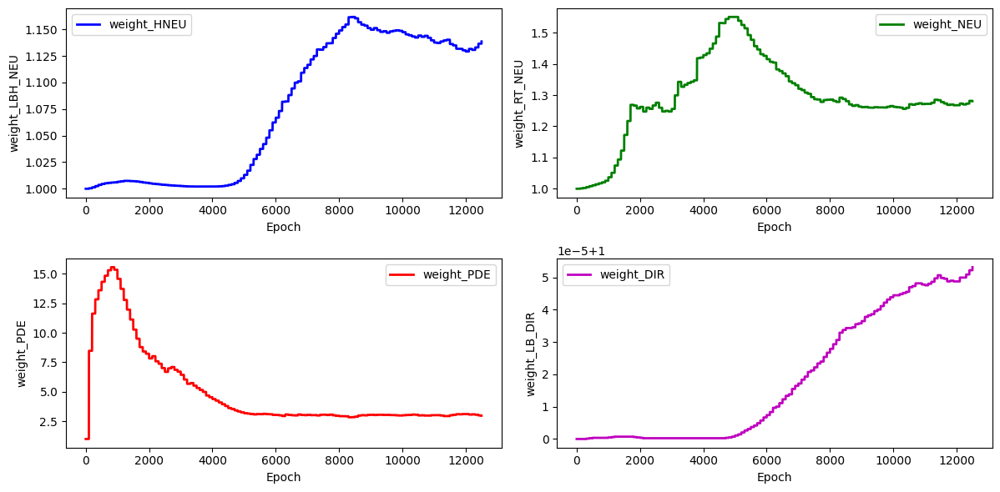

stress_Error for the stress_hole is: 10.60979993496206


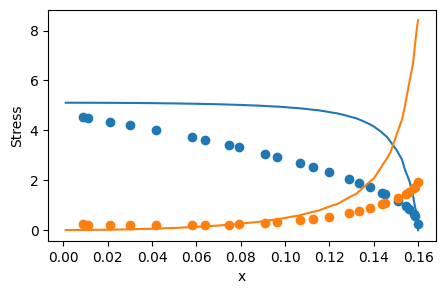

 84%|████████▍ | 12600/15000 [2:01:12<29:05,  1.37it/s]  

for weight 0 norm_grad: 79.22744750976562
for weight 0 new lamda dach: 1.1198281049728394
for weight 0 new lamdaloss norm: 88.72111511230469
for weight 1 norm_grad: 144.5626220703125
for weight 1 new lamda dach: 1.2426193952560425
for weight 1 new lamdaloss norm: 179.6363067626953
for weight 2 norm_grad: 516.5772094726562
for weight 2 new lamda dach: 3.3079354763031006
for weight 2 new lamdaloss norm: 1708.803955078125
for weight 3 norm_grad: 0.03644969314336777
for weight 3 new lamda dach: 1.0000492334365845
for weight 3 new lamdaloss norm: 0.03645148500800133
for weight 0 new weight_value: 1.1367113590240479
for weight 1 new weight_value: 1.2770352363586426
for weight 2 new weight_value: 3.0125443935394287
for weight 3 new weight_value: 1.000052809715271


 85%|████████▍ | 12700/15000 [2:02:20<27:47,  1.38it/s]

for weight 0 norm_grad: 77.61314392089844
for weight 0 new lamda dach: 1.1332461833953857
for weight 0 new lamdaloss norm: 87.95479583740234
for weight 1 norm_grad: 163.2259063720703
for weight 1 new lamda dach: 1.3285102844238281
for weight 1 new lamdaloss norm: 216.84730529785156
for weight 2 norm_grad: 419.21728515625
for weight 2 new lamda dach: 2.7403900623321533
for weight 2 new lamdaloss norm: 1148.81884765625
for weight 3 norm_grad: 0.03645548224449158
for weight 3 new lamda dach: 1.000055193901062
for weight 3 new lamdaloss norm: 0.03645749017596245
for weight 0 new weight_value: 1.1363648176193237
for weight 1 new weight_value: 1.2821826934814453
for weight 2 new weight_value: 2.9853289127349854
for weight 3 new weight_value: 1.00005304813385


 85%|████████▌ | 12800/15000 [2:03:34<25:55,  1.41it/s]

for weight 0 norm_grad: 77.48812866210938
for weight 0 new lamda dach: 1.1147798299789429
for weight 0 new lamdaloss norm: 86.3822021484375
for weight 1 norm_grad: 129.91465759277344
for weight 1 new lamda dach: 1.20863938331604
for weight 1 new lamdaloss norm: 157.01998901367188
for weight 2 norm_grad: 545.1514282226562
for weight 2 new lamda dach: 3.6280102729797363
for weight 2 new lamdaloss norm: 1977.8148193359375
for weight 3 norm_grad: 0.03604159504175186
for weight 3 new lamda dach: 1.0000479221343994
for weight 3 new lamdaloss norm: 0.03604331985116005
for weight 0 new weight_value: 1.1342062950134277
for weight 1 new weight_value: 1.274828314781189
for weight 2 new weight_value: 3.0495970249176025
for weight 3 new weight_value: 1.0000524520874023


 86%|████████▌ | 12900/15000 [2:04:42<26:14,  1.33it/s]

for weight 0 norm_grad: 76.90302276611328
for weight 0 new lamda dach: 1.1453393697738647
for weight 0 new lamdaloss norm: 88.0800552368164
for weight 1 norm_grad: 147.77059936523438
for weight 1 new lamda dach: 1.3224602937698364
for weight 1 new lamdaloss norm: 195.42074584960938
for weight 2 norm_grad: 381.320556640625
for weight 2 new lamda dach: 2.696946382522583
for weight 2 new lamdaloss norm: 1028.401123046875
for weight 3 norm_grad: 0.036275070160627365
for weight 3 new lamda dach: 1.0000598430633545
for weight 3 new lamdaloss norm: 0.03627724200487137
for weight 0 new weight_value: 1.1353195905685425
for weight 1 new weight_value: 1.27959144115448
for weight 2 new weight_value: 3.014331817626953
for weight 3 new weight_value: 1.0000531673431396


 87%|████████▋ | 12999/15000 [2:05:52<20:03,  1.66it/s]

for weight 0 norm_grad: 73.84839630126953
for weight 0 new lamda dach: 1.1269655227661133
for weight 0 new lamdaloss norm: 83.22459411621094
for weight 1 norm_grad: 149.35565185546875
for weight 1 new lamda dach: 1.295091152191162
for weight 1 new lamdaloss norm: 193.42916870117188
for weight 2 norm_grad: 432.2492980957031
for weight 2 new lamda dach: 2.9362504482269287
for weight 2 new lamdaloss norm: 1269.1922607421875
for weight 3 norm_grad: 0.03634575009346008
for weight 3 new lamda dach: 1.0000554323196411
for weight 3 new lamdaloss norm: 0.03634776547551155
for weight 0 new weight_value: 1.1344841718673706
for weight 1 new weight_value: 1.2811414003372192
for weight 2 new weight_value: 3.006523609161377
for weight 3 new weight_value: 1.0000534057617188
total_loss: 0.27488815784454346, hole_loss:  0.1298346072435379,neumann_loss:  0.05809703469276428, pde_loss: 0.0750565379858017,dirichlet_loss: 7.596296927658841e-05


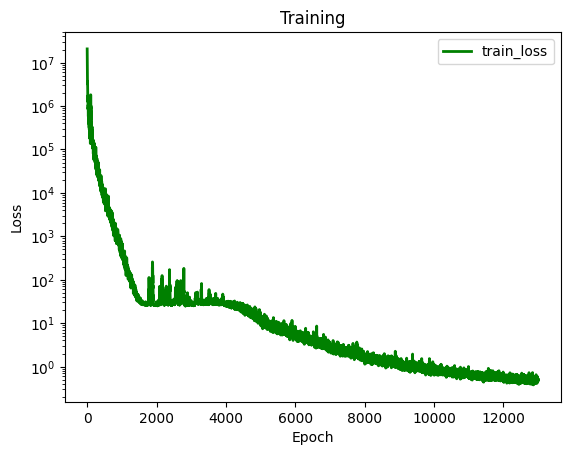

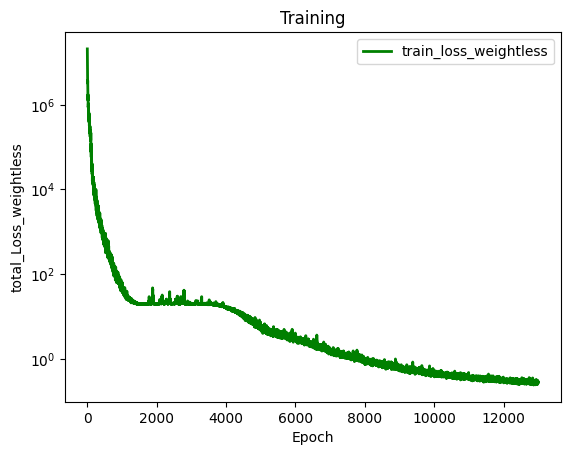

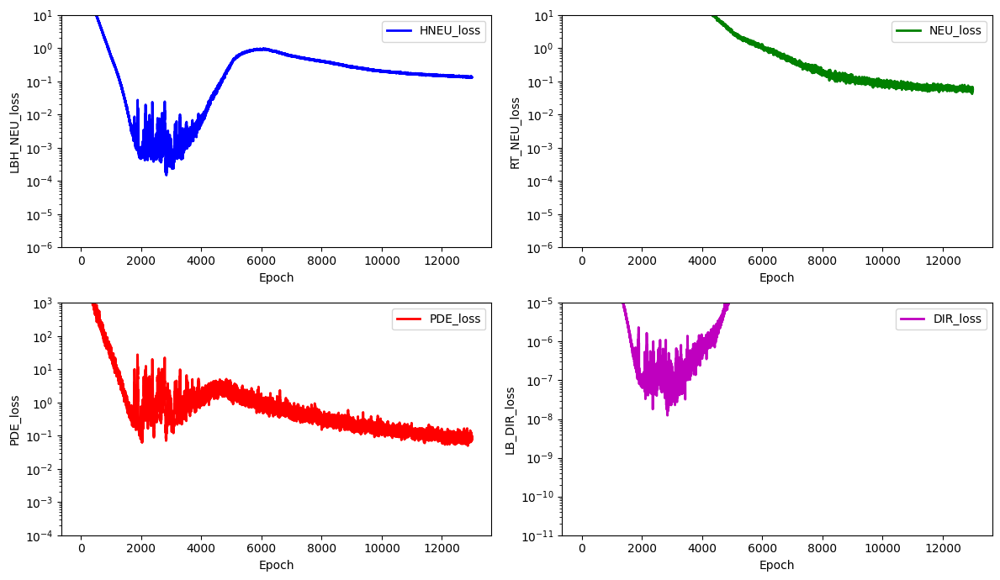

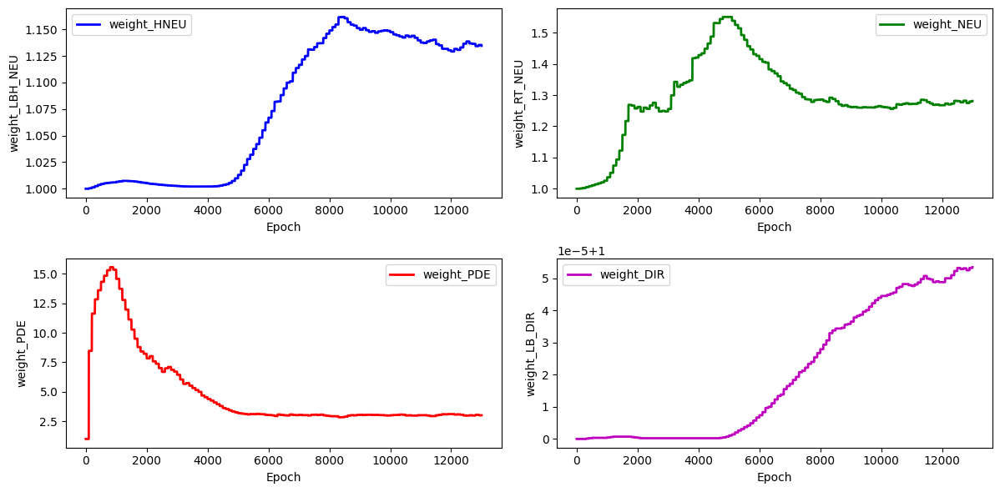

stress_Error for the stress_hole is: 10.616081931171475


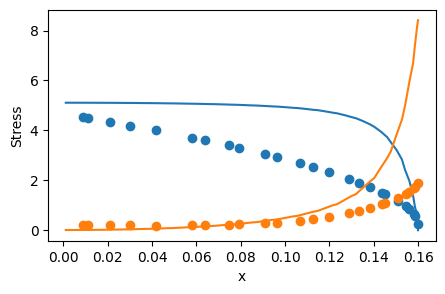

 87%|████████▋ | 13100/15000 [2:07:10<22:58,  1.38it/s]  

for weight 0 norm_grad: 74.63497161865234
for weight 0 new lamda dach: 1.1008177995681763
for weight 0 new lamdaloss norm: 82.15950775146484
for weight 1 norm_grad: 140.7853240966797
for weight 1 new lamda dach: 1.208835482597351
for weight 1 new lamdaloss norm: 170.18630981445312
for weight 2 norm_grad: 599.4735107421875
for weight 2 new lamda dach: 3.782341480255127
for weight 2 new lamdaloss norm: 2267.413330078125
for weight 3 norm_grad: 0.03621669113636017
for weight 3 new lamda dach: 1.0000444650650024
for weight 3 new lamdaloss norm: 0.036218300461769104
for weight 0 new weight_value: 1.1311174631118774
for weight 1 new weight_value: 1.2739107608795166
for weight 2 new weight_value: 3.0841052532196045
for weight 3 new weight_value: 1.0000524520874023


 88%|████████▊ | 13200/15000 [2:08:29<23:02,  1.30it/s]

for weight 0 norm_grad: 75.80826568603516
for weight 0 new lamda dach: 1.118177056312561
for weight 0 new lamdaloss norm: 84.76705932617188
for weight 1 norm_grad: 158.87704467773438
for weight 1 new lamda dach: 1.2845159769058228
for weight 1 new lamdaloss norm: 204.08009338378906
for weight 2 norm_grad: 482.56787109375
for weight 2 new lamda dach: 3.0559215545654297
for weight 2 new lamdaloss norm: 1474.689697265625
for weight 3 norm_grad: 0.035654276609420776
for weight 3 new lamda dach: 1.0000497102737427
for weight 3 new lamdaloss norm: 0.03565605357289314
for weight 0 new weight_value: 1.1298234462738037
for weight 1 new weight_value: 1.2749712467193604
for weight 2 new weight_value: 3.081286668777466
for weight 3 new weight_value: 1.0000522136688232


 89%|████████▊ | 13300/15000 [2:09:38<19:41,  1.44it/s]

for weight 0 norm_grad: 72.95980072021484
for weight 0 new lamda dach: 1.1453447341918945
for weight 0 new lamdaloss norm: 83.56412506103516
for weight 1 norm_grad: 147.17288208007812
for weight 1 new lamda dach: 1.3440510034561157
for weight 1 new lamdaloss norm: 197.807861328125
for weight 2 norm_grad: 354.76953125
for weight 2 new lamda dach: 2.6113576889038086
for weight 2 new lamdaloss norm: 926.4301147460938
for weight 3 norm_grad: 0.03539714217185974
for weight 3 new lamda dach: 1.0000616312026978
for weight 3 new lamdaloss norm: 0.03539932146668434
for weight 0 new weight_value: 1.1313755512237549
for weight 1 new weight_value: 1.281879186630249
for weight 2 new weight_value: 3.0342936515808105
for weight 3 new weight_value: 1.0000531673431396


 89%|████████▉ | 13400/15000 [2:10:44<18:57,  1.41it/s]

for weight 0 norm_grad: 72.62947845458984
for weight 0 new lamda dach: 1.1437747478485107
for weight 0 new lamdaloss norm: 83.07176208496094
for weight 1 norm_grad: 120.66374969482422
for weight 1 new lamda dach: 1.263960838317871
for weight 1 new lamdaloss norm: 152.51425170898438
for weight 2 norm_grad: 384.4623107910156
for weight 2 new lamda dach: 2.988643169403076
for weight 2 new lamdaloss norm: 1149.020751953125
for weight 3 norm_grad: 0.03569184988737106
for weight 3 new lamda dach: 1.0000617504119873
for weight 3 new lamdaloss norm: 0.03569405525922775
for weight 0 new weight_value: 1.1326154470443726
for weight 1 new weight_value: 1.2800873517990112
for weight 2 new weight_value: 3.029728651046753
for weight 3 new weight_value: 1.0000540018081665


 90%|████████▉ | 13499/15000 [2:11:51<17:29,  1.43it/s]

for weight 0 norm_grad: 73.58280944824219
for weight 0 new lamda dach: 1.1472185850143433
for weight 0 new lamdaloss norm: 84.41557312011719
for weight 1 norm_grad: 146.81626892089844
for weight 1 new lamda dach: 1.3441649675369263
for weight 1 new lamdaloss norm: 197.3452911376953
for weight 2 norm_grad: 352.96844482421875
for weight 2 new lamda dach: 2.6012377738952637
for weight 2 new lamdaloss norm: 918.1548461914062
for weight 3 norm_grad: 0.035674773156642914
for weight 3 new lamda dach: 1.000062108039856
for weight 3 new lamdaloss norm: 0.0356769897043705
for weight 0 new weight_value: 1.1340757608413696
for weight 1 new weight_value: 1.2864950895309448
for weight 2 new weight_value: 2.986879348754883
for weight 3 new weight_value: 1.0000547170639038
total_loss: 0.2603718340396881, hole_loss:  0.13012808561325073,neumann_loss:  0.05638662725687027, pde_loss: 0.06729060411453247,dirichlet_loss: 7.501346408389509e-05


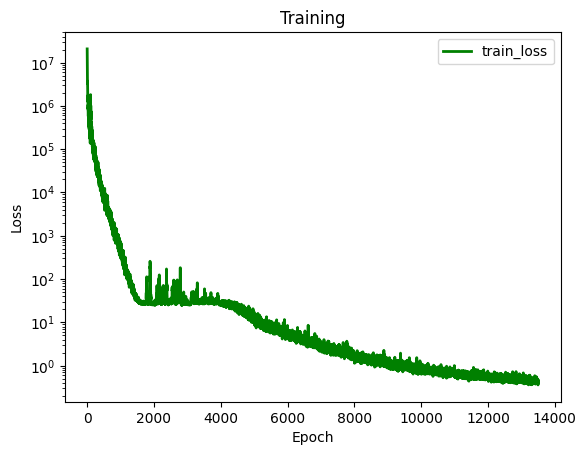

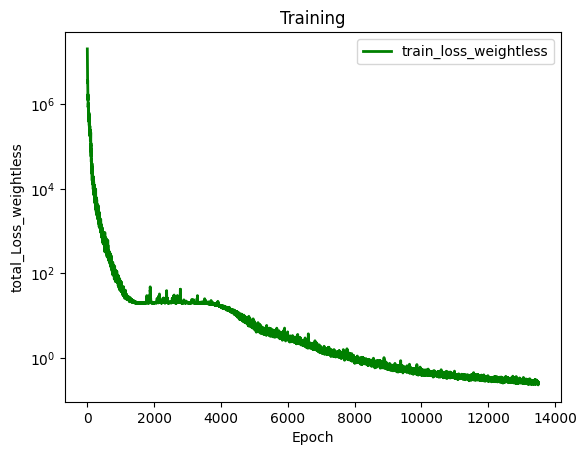

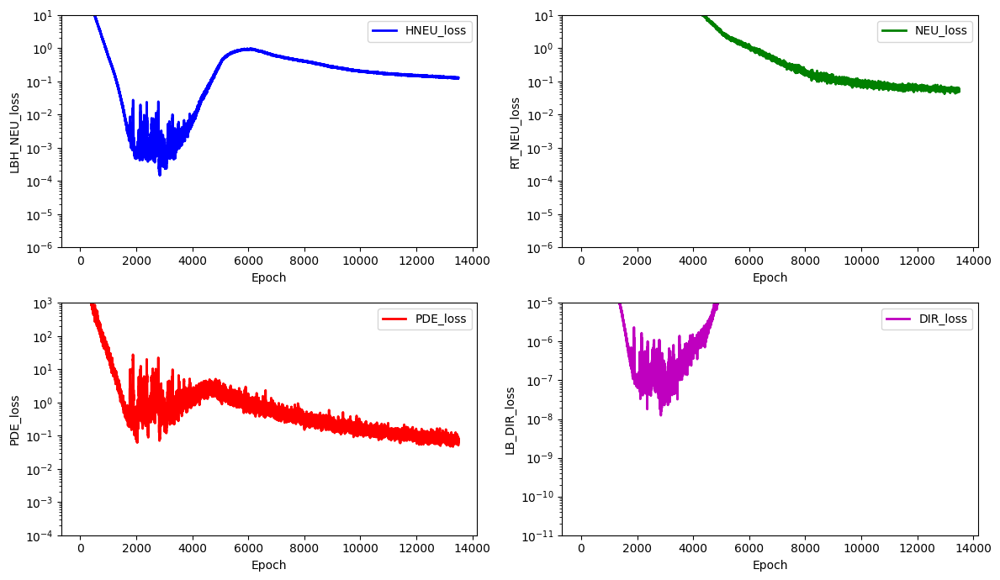

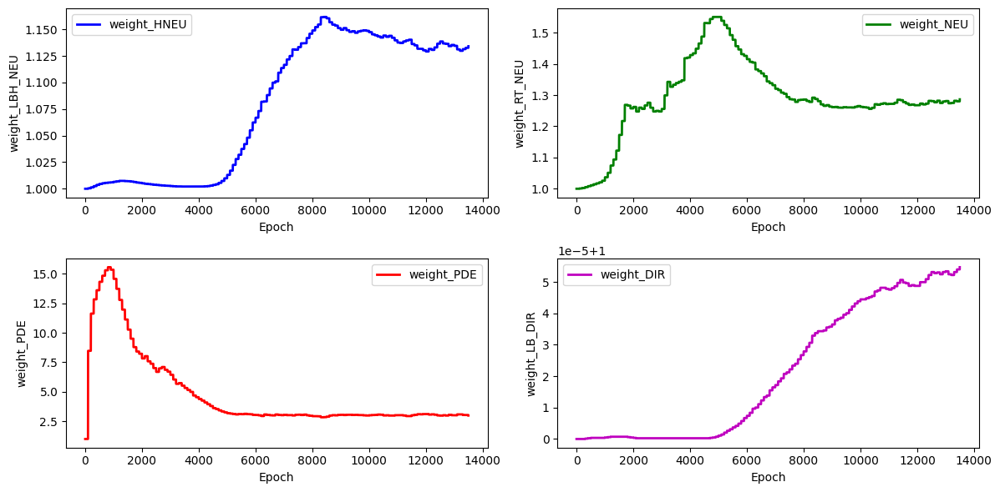

stress_Error for the stress_hole is: 10.621317474386712


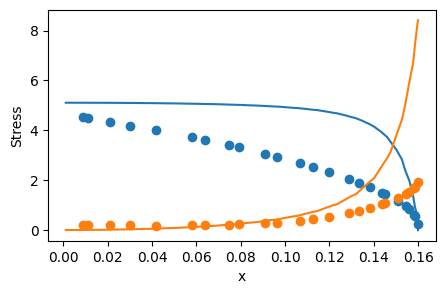

 91%|█████████ | 13600/15000 [2:13:05<15:55,  1.46it/s]

for weight 0 norm_grad: 74.5417251586914
for weight 0 new lamda dach: 1.1641888618469238
for weight 0 new lamdaloss norm: 86.7806396484375
for weight 1 norm_grad: 146.30538940429688
for weight 1 new lamda dach: 1.3827617168426514
for weight 1 new lamdaloss norm: 202.30548095703125
for weight 2 norm_grad: 307.6596984863281
for weight 2 new lamda dach: 2.3928699493408203
for weight 2 new lamdaloss norm: 736.189697265625
for weight 3 norm_grad: 0.03473251685500145
for weight 3 new lamda dach: 1.0000656843185425
for weight 3 new lamdaloss norm: 0.03473479673266411
for weight 0 new weight_value: 1.1370869874954224
for weight 1 new weight_value: 1.2961217164993286
for weight 2 new weight_value: 2.927478313446045
for weight 3 new weight_value: 1.0000557899475098


 91%|█████████▏| 13700/15000 [2:14:11<15:02,  1.44it/s]

for weight 0 norm_grad: 72.4175033569336
for weight 0 new lamda dach: 1.1357742547988892
for weight 0 new lamdaloss norm: 82.24993133544922
for weight 1 norm_grad: 134.85902404785156
for weight 1 new lamda dach: 1.2863702774047852
for weight 1 new lamdaloss norm: 173.4786376953125
for weight 2 norm_grad: 398.4729309082031
for weight 2 new lamda dach: 2.9220993518829346
for weight 2 new lamdaloss norm: 1164.37744140625
for weight 3 norm_grad: 0.03476576879620552
for weight 3 new lamda dach: 1.0000574588775635
for weight 3 new lamdaloss norm: 0.034767769277095795
for weight 0 new weight_value: 1.136955738067627
for weight 1 new weight_value: 1.2951465845108032
for weight 2 new weight_value: 2.9269402027130127
for weight 3 new weight_value: 1.0000559091567993


 92%|█████████▏| 13800/15000 [2:15:17<13:57,  1.43it/s]

for weight 0 norm_grad: 70.18675231933594
for weight 0 new lamda dach: 1.0997728109359741
for weight 0 new lamdaloss norm: 77.18948364257812
for weight 1 norm_grad: 142.00341796875
for weight 1 new lamda dach: 1.22481369972229
for weight 1 new lamdaloss norm: 173.92771911621094
for weight 2 norm_grad: 561.42822265625
for weight 2 new lamda dach: 3.6454427242279053
for weight 2 new lamdaloss norm: 2046.6544189453125
for weight 3 norm_grad: 0.03451120853424072
for weight 3 new lamda dach: 1.000044584274292
for weight 3 new lamdaloss norm: 0.03451274707913399
for weight 0 new weight_value: 1.133237361907959
for weight 1 new weight_value: 1.2881132364273071
for weight 2 new weight_value: 2.9987902641296387
for weight 3 new weight_value: 1.0000547170639038


 93%|█████████▎| 13900/15000 [2:16:22<12:56,  1.42it/s]

for weight 0 norm_grad: 72.13713836669922
for weight 0 new lamda dach: 1.180784821510315
for weight 0 new lamdaloss norm: 85.17842864990234
for weight 1 norm_grad: 128.93124389648438
for weight 1 new lamda dach: 1.376740574836731
for weight 1 new lamdaloss norm: 177.5048828125
for weight 2 norm_grad: 270.05657958984375
for weight 2 new lamda dach: 2.3428781032562256
for weight 2 new lamdaloss norm: 632.7095947265625
for weight 3 norm_grad: 0.034430235624313354
for weight 3 new lamda dach: 1.0000730752944946
for weight 3 new lamdaloss norm: 0.034432753920555115
for weight 0 new weight_value: 1.137992024421692
for weight 1 new weight_value: 1.2969759702682495
for weight 2 new weight_value: 2.933198928833008
for weight 3 new weight_value: 1.000056505203247


 93%|█████████▎| 13999/15000 [2:17:32<12:06,  1.38it/s]

for weight 0 norm_grad: 67.77310943603516
for weight 0 new lamda dach: 1.1172044277191162
for weight 0 new lamdaloss norm: 75.71641540527344
for weight 1 norm_grad: 121.254150390625
for weight 1 new lamda dach: 1.2310632467269897
for weight 1 new lamdaloss norm: 149.2715301513672
for weight 2 norm_grad: 456.95831298828125
for weight 2 new lamda dach: 3.4169766902923584
for weight 2 new lamdaloss norm: 1561.4158935546875
for weight 3 norm_grad: 0.03469459339976311
for weight 3 new lamda dach: 1.0000536441802979
for weight 3 new lamdaloss norm: 0.03469645604491234
for weight 0 new weight_value: 1.1359132528305054
for weight 1 new weight_value: 1.2903846502304077
for weight 2 new weight_value: 2.981576681137085
for weight 3 new weight_value: 1.0000561475753784
total_loss: 0.2235460728406906, hole_loss:  0.11733175814151764,neumann_loss:  0.04535103961825371, pde_loss: 0.06139890104532242,dirichlet_loss: 7.167954026954249e-05


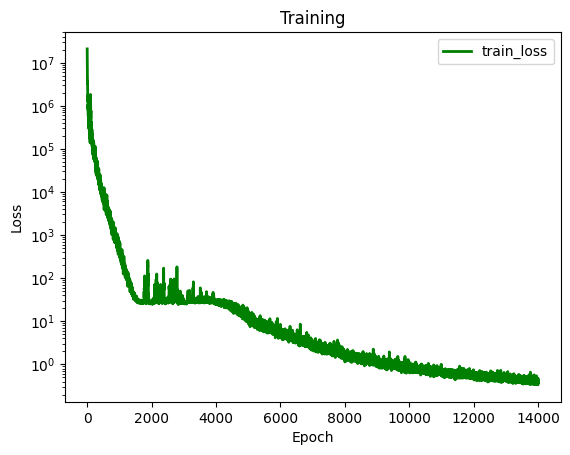

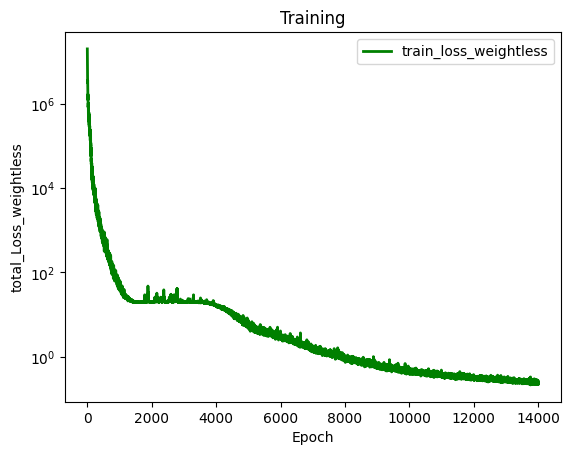

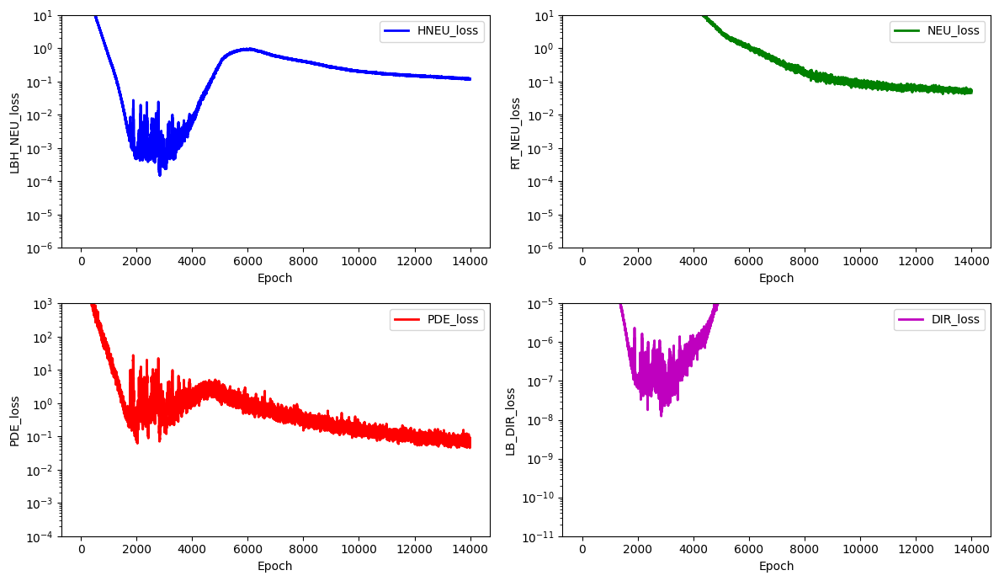

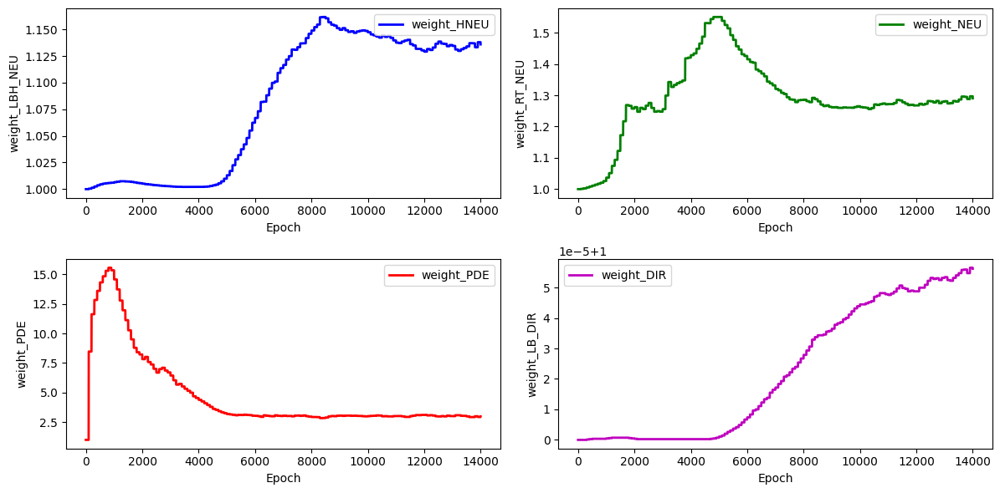

stress_Error for the stress_hole is: 10.696079494570057


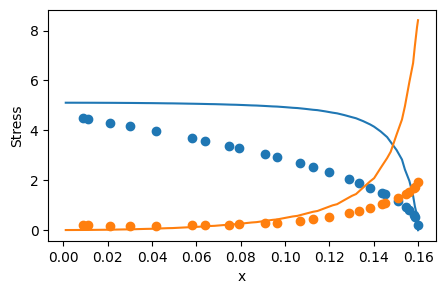

 94%|█████████▍| 14100/15000 [2:18:46<10:21,  1.45it/s]

for weight 0 norm_grad: 71.01739501953125
for weight 0 new lamda dach: 1.1492823362350464
for weight 0 new lamdaloss norm: 81.61904907226562
for weight 1 norm_grad: 126.30195617675781
for weight 1 new lamda dach: 1.3004035949707031
for weight 1 new lamdaloss norm: 164.24351501464844
for weight 2 norm_grad: 349.3887634277344
for weight 2 new lamda dach: 2.7703654766082764
for weight 2 new lamdaloss norm: 967.9346313476562
for weight 3 norm_grad: 0.03463859483599663
for weight 3 new lamda dach: 1.000063419342041
for weight 3 new lamdaloss norm: 0.03464078903198242
for weight 0 new weight_value: 1.1372501850128174
for weight 1 new weight_value: 1.291386604309082
for weight 2 new weight_value: 2.9604554176330566
for weight 3 new weight_value: 1.0000568628311157


 95%|█████████▍| 14200/15000 [2:19:53<09:06,  1.46it/s]

for weight 0 norm_grad: 67.70836639404297
for weight 0 new lamda dach: 1.1945923566818237
for weight 0 new lamdaloss norm: 80.88389587402344
for weight 1 norm_grad: 128.89785766601562
for weight 1 new lamda dach: 1.449496865272522
for weight 1 new lamdaloss norm: 186.8370361328125
for weight 2 norm_grad: 219.01795959472656
for weight 2 new lamda dach: 2.113800525665283
for weight 2 new lamdaloss norm: 462.9602966308594
for weight 3 norm_grad: 0.033934030681848526
for weight 3 new lamda dach: 1.0000816583633423
for weight 3 new lamdaloss norm: 0.03393680229783058
for weight 0 new weight_value: 1.142984390258789
for weight 1 new weight_value: 1.3071975708007812
for weight 2 new weight_value: 2.8757898807525635
for weight 3 new weight_value: 1.0000593662261963


 95%|█████████▌| 14300/15000 [2:21:04<08:59,  1.30it/s]

for weight 0 norm_grad: 67.87617492675781
for weight 0 new lamda dach: 1.1589034795761108
for weight 0 new lamdaloss norm: 78.66193389892578
for weight 1 norm_grad: 140.2382049560547
for weight 1 new lamda dach: 1.3952692747116089
for weight 1 new lamdaloss norm: 195.67007446289062
for weight 2 norm_grad: 286.88079833984375
for weight 2 new lamda dach: 2.3782474994659424
for weight 2 new lamdaloss norm: 682.2734985351562
for weight 3 norm_grad: 0.03458689525723457
for weight 3 new lamda dach: 1.0000698566436768
for weight 3 new lamdaloss norm: 0.03458930924534798
for weight 0 new weight_value: 1.1445763111114502
for weight 1 new weight_value: 1.316004753112793
for weight 2 new weight_value: 2.826035499572754
for weight 3 new weight_value: 1.0000603199005127


 96%|█████████▌| 14400/15000 [2:22:22<08:18,  1.20it/s]

for weight 0 norm_grad: 66.61151885986328
for weight 0 new lamda dach: 1.1141144037246704
for weight 0 new lamdaloss norm: 74.21286010742188
for weight 1 norm_grad: 124.94963073730469
for weight 1 new lamda dach: 1.2378238439559937
for weight 1 new lamdaloss norm: 154.66563415527344
for weight 2 norm_grad: 458.74188232421875
for weight 2 new lamda dach: 3.3943300247192383
for weight 2 new lamdaloss norm: 1557.121337890625
for weight 3 norm_grad: 0.03391161561012268
for weight 3 new lamda dach: 1.0000522136688232
for weight 3 new lamdaloss norm: 0.03391338512301445
for weight 0 new weight_value: 1.141530156135559
for weight 1 new weight_value: 1.308186650276184
for weight 2 new weight_value: 2.8828649520874023
for weight 3 new weight_value: 1.0000594854354858


 97%|█████████▋| 14499/15000 [2:23:35<05:49,  1.43it/s]

for weight 0 norm_grad: 66.091064453125
for weight 0 new lamda dach: 1.1346429586410522
for weight 0 new lamdaloss norm: 74.98976135253906
for weight 1 norm_grad: 127.23035430908203
for weight 1 new lamda dach: 1.296075701713562
for weight 1 new lamdaloss norm: 164.90017700195312
for weight 2 norm_grad: 363.5971984863281
for weight 2 new lamda dach: 2.8804590702056885
for weight 2 new lamdaloss norm: 1047.326904296875
for weight 3 norm_grad: 0.03419090062379837
for weight 3 new lamda dach: 1.0000613927841187
for weight 3 new lamdaloss norm: 0.034192997962236404
for weight 0 new weight_value: 1.1408414840698242
for weight 1 new weight_value: 1.3069754838943481
for weight 2 new weight_value: 2.882624387741089
for weight 3 new weight_value: 1.0000596046447754
total_loss: 0.2293286770582199, hole_loss:  0.11093578487634659,neumann_loss:  0.04810362681746483, pde_loss: 0.06549727916717529,dirichlet_loss: 7.028425898170099e-05


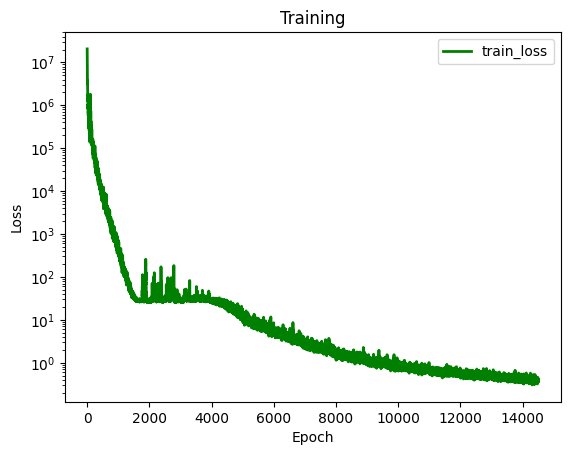

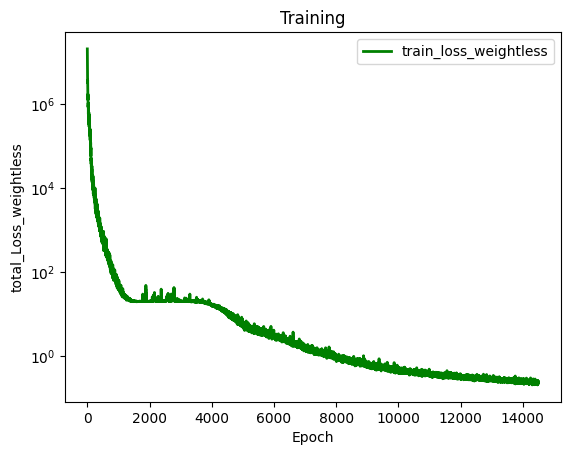

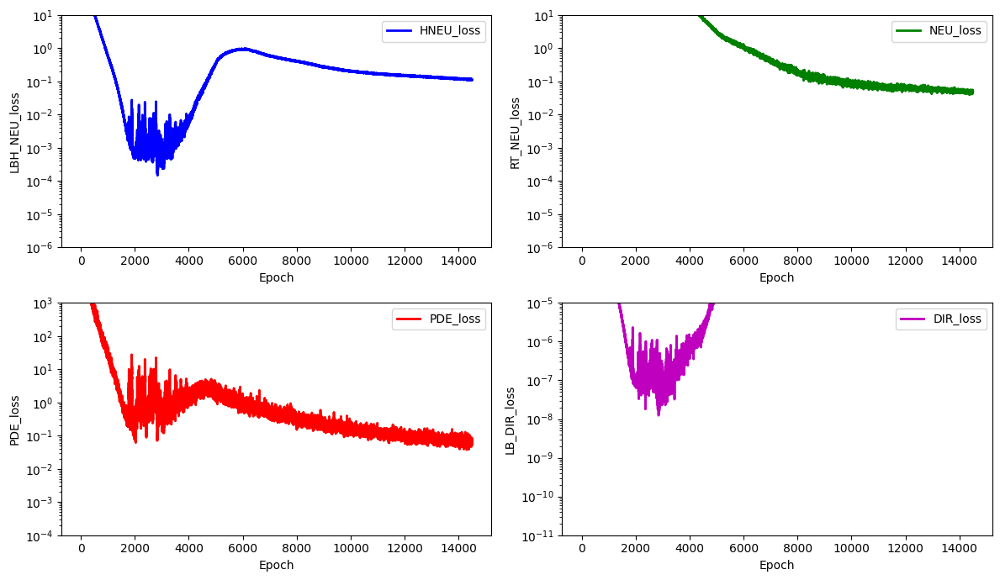

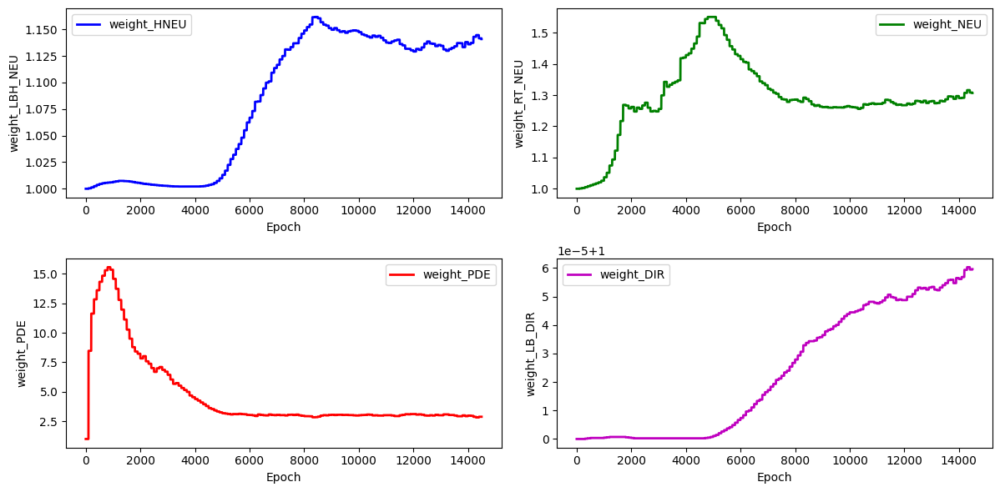

stress_Error for the stress_hole is: 10.74202013136884


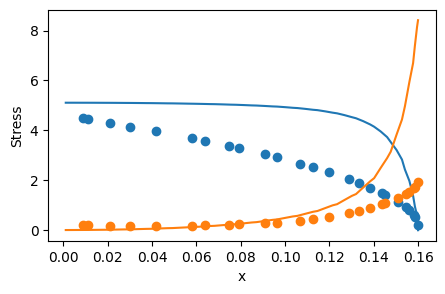

 97%|█████████▋| 14600/15000 [2:24:49<04:56,  1.35it/s]

for weight 0 norm_grad: 68.1517333984375
for weight 0 new lamda dach: 1.1343238353729248
for weight 0 new lamdaloss norm: 77.30613708496094
for weight 1 norm_grad: 139.5279541015625
for weight 1 new lamda dach: 1.3200236558914185
for weight 1 new lamdaloss norm: 184.18019104003906
for weight 2 norm_grad: 367.80682373046875
for weight 2 new lamda dach: 2.7707390785217285
for weight 2 new lamdaloss norm: 1019.0968017578125
for weight 3 norm_grad: 0.034085504710674286
for weight 3 new lamda dach: 1.0000591278076172
for weight 3 new lamdaloss norm: 0.034087520092725754
for weight 0 new weight_value: 1.14018976688385
for weight 1 new weight_value: 1.3082802295684814
for weight 2 new weight_value: 2.8714356422424316
for weight 3 new weight_value: 1.0000594854354858


 98%|█████████▊| 14700/15000 [2:25:58<03:37,  1.38it/s]

for weight 0 norm_grad: 65.79003143310547
for weight 0 new lamda dach: 1.149681568145752
for weight 0 new lamdaloss norm: 75.6375961303711
for weight 1 norm_grad: 121.91484832763672
for weight 1 new lamda dach: 1.3179762363433838
for weight 1 new lamdaloss norm: 160.6808624267578
for weight 2 norm_grad: 317.584716796875
for weight 2 new lamda dach: 2.6916306018829346
for weight 2 new lamdaloss norm: 854.82080078125
for weight 3 norm_grad: 0.03390181064605713
for weight 3 new lamda dach: 1.000067114830017
for weight 3 new lamdaloss norm: 0.03390408679842949
for weight 0 new weight_value: 1.1411389112472534
for weight 1 new weight_value: 1.3092498779296875
for weight 2 new weight_value: 2.853455066680908
for weight 3 new weight_value: 1.0000602006912231


 99%|█████████▊| 14800/15000 [2:27:03<02:21,  1.41it/s]

for weight 0 norm_grad: 65.24506378173828
for weight 0 new lamda dach: 1.1508243083953857
for weight 0 new lamdaloss norm: 75.08560180664062
for weight 1 norm_grad: 130.91554260253906
for weight 1 new lamda dach: 1.356796383857727
for weight 1 new lamdaloss norm: 177.625732421875
for weight 2 norm_grad: 301.6407775878906
for weight 2 new lamda dach: 2.5374603271484375
for weight 2 new lamdaloss norm: 765.4015502929688
for weight 3 norm_grad: 0.03356286883354187
for weight 3 new lamda dach: 1.0000674724578857
for weight 3 new lamdaloss norm: 0.03356513753533363
for weight 0 new weight_value: 1.142107367515564
for weight 1 new weight_value: 1.3140044212341309
for weight 2 new weight_value: 2.8218555450439453
for weight 3 new weight_value: 1.0000609159469604


 99%|█████████▉| 14900/15000 [2:28:10<01:10,  1.42it/s]

for weight 0 norm_grad: 65.21875762939453
for weight 0 new lamda dach: 1.1274975538253784
for weight 0 new lamdaloss norm: 73.53399658203125
for weight 1 norm_grad: 123.66039276123047
for weight 1 new lamda dach: 1.2729281187057495
for weight 1 new lamdaloss norm: 157.41079711914062
for weight 2 norm_grad: 387.83575439453125
for weight 2 new lamda dach: 3.052992343902588
for weight 2 new lamdaloss norm: 1184.0595703125
for weight 3 norm_grad: 0.033291105180978775
for weight 3 new lamda dach: 1.0000576972961426
for weight 3 new lamdaloss norm: 0.03329302370548248
for weight 0 new weight_value: 1.1406464576721191
for weight 1 new weight_value: 1.30989670753479
for weight 2 new weight_value: 2.8449692726135254
for weight 3 new weight_value: 1.0000605583190918


100%|█████████▉| 14999/15000 [2:29:21<00:00,  1.50it/s]

for weight 0 norm_grad: 63.487876892089844
for weight 0 new lamda dach: 1.1019022464752197
for weight 0 new lamdaloss norm: 69.95743560791016
for weight 1 norm_grad: 124.58821105957031
for weight 1 new lamda dach: 1.2217161655426025
for weight 1 new lamdaloss norm: 152.21142578125
for weight 2 norm_grad: 498.40570068359375
for weight 2 new lamda dach: 3.6495561599731445
for weight 2 new lamdaloss norm: 1818.95947265625
for weight 3 norm_grad: 0.033002741634845734
for weight 3 new lamda dach: 1.000048041343689
for weight 3 new lamdaloss norm: 0.03300432860851288
for weight 0 new weight_value: 1.1367720365524292
for weight 1 new weight_value: 1.3010786771774292
for weight 2 new weight_value: 2.9254279136657715
for weight 3 new weight_value: 1.0000592470169067
total_loss: 0.23150166869163513, hole_loss:  0.107074074447155,neumann_loss:  0.046684280037879944, pde_loss: 0.07316926121711731,dirichlet_loss: 6.732550536980852e-05


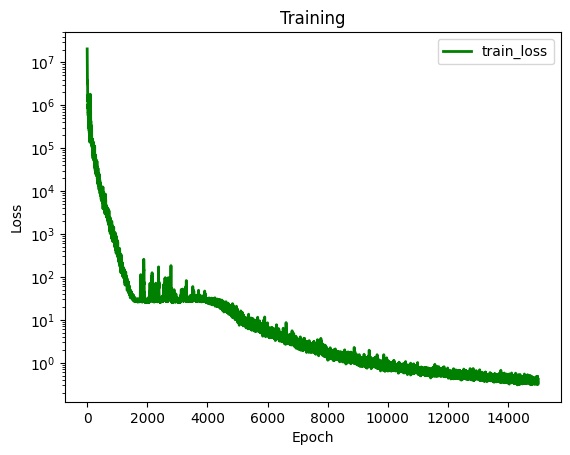

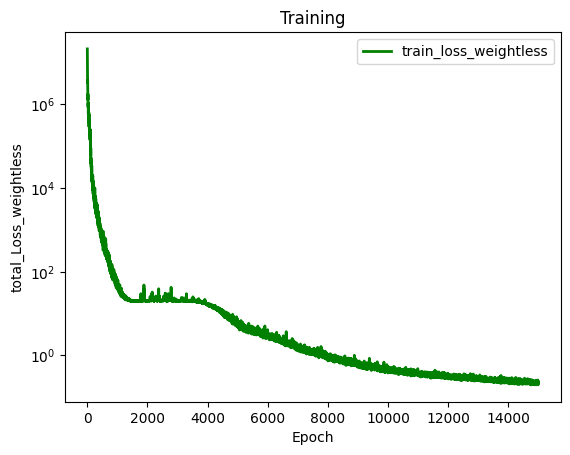

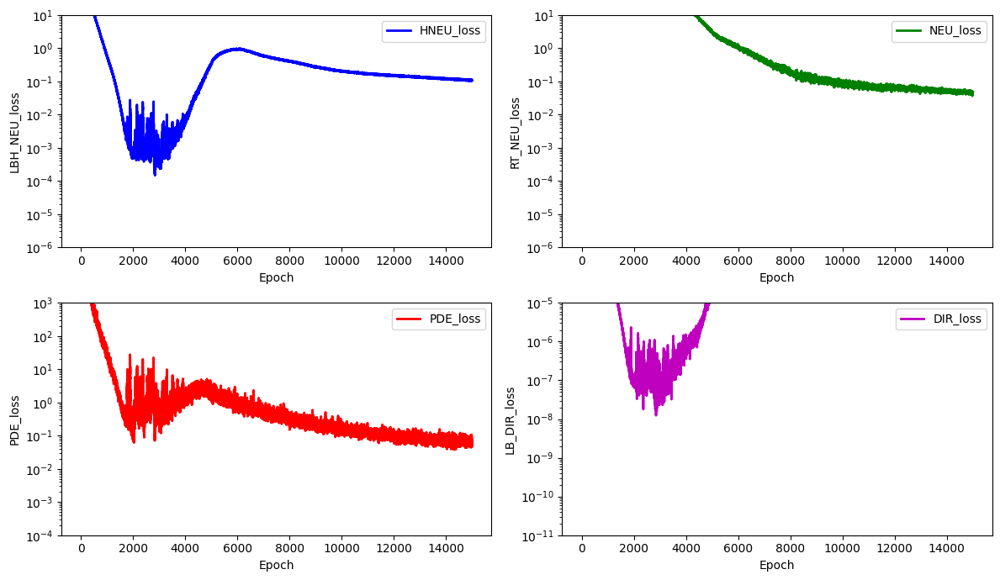

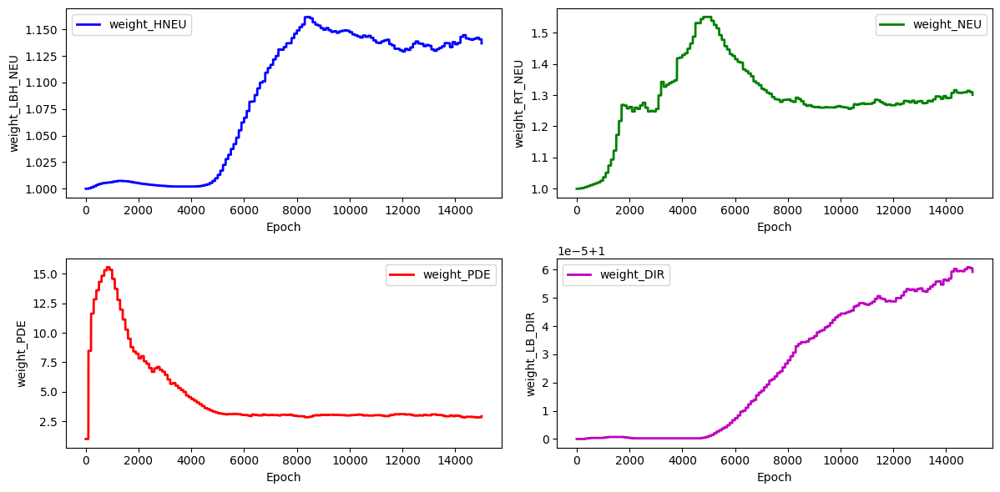

stress_Error for the stress_hole is: 10.799231996921472


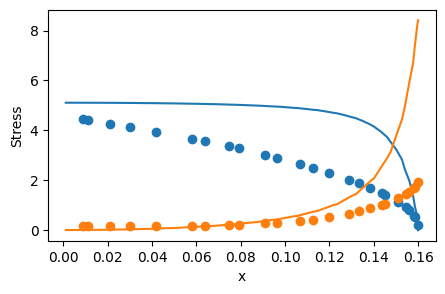

100%|██████████| 15000/15000 [2:29:27<00:00,  1.67it/s]

total_loss: 0.23150166869163513, hole_loss:  0.107074074447155, neumann_loss:  0.046684280037879944, pde_loss: 0.07316926121711731, dirichlet_loss: 6.732550536980852e-05
previous lowest lost  5
lowest loss 0.40634381771087646 archived, PINN is saved: 'net_param/net_0.16000000.pth


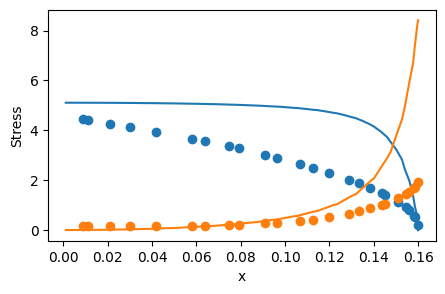

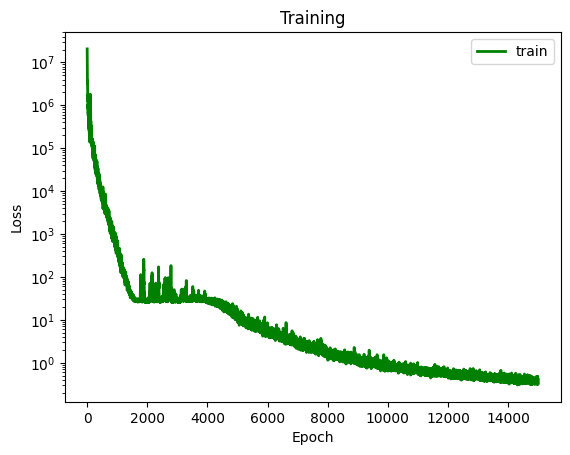

Weight_HNEU: 1.0, Weight_NEU: 1.0, Weight_PDE: 1.0, Weight_STRESS: 1.0, Stress Error: 10.799231996921472
Starting with Adam optimizer...


  1%|          | 100/15000 [01:02<2:47:15,  1.48it/s]

for weight 0 norm_grad: 21968.4375
for weight 0 new lamda dach: 1.0021584033966064
for weight 0 new lamdaloss norm: 22015.85546875
for weight 1 norm_grad: 100389.2890625
for weight 1 new lamda dach: 1.0099397897720337
for weight 1 new lamdaloss norm: 101387.140625
for weight 2 norm_grad: 10077762.0
for weight 2 new lamda dach: 83.36224365234375
for weight 2 new lamdaloss norm: 840104832.0
for weight 3 norm_grad: 0.8806215524673462
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.8806216716766357
for weight 0 new weight_value: 1.000215768814087
for weight 1 new weight_value: 1.0009939670562744
for weight 2 new weight_value: 9.236224174499512
for weight 3 new weight_value: 1.0


  1%|▏         | 200/15000 [02:10<3:15:00,  1.26it/s]

for weight 0 norm_grad: 4913.19580078125
for weight 0 new lamda dach: 1.0047248601913452
for weight 0 new lamdaloss norm: 4936.41015625
for weight 1 norm_grad: 29489.935546875
for weight 1 new lamda dach: 1.029045820236206
for weight 1 new lamdaloss norm: 30346.494140625
for weight 2 norm_grad: 1010377.375
for weight 2 new lamda dach: 30.36839485168457
for weight 2 new lamdaloss norm: 30683540.0
for weight 3 norm_grad: 0.4433346688747406
for weight 3 new lamda dach: 1.0000004768371582
for weight 3 new lamdaloss norm: 0.4433348774909973
for weight 0 new weight_value: 1.000666618347168
for weight 1 new weight_value: 1.0037990808486938
for weight 2 new weight_value: 11.349440574645996
for weight 3 new weight_value: 1.0


  2%|▏         | 300/15000 [03:18<2:44:14,  1.49it/s]

for weight 0 norm_grad: 3005.677001953125
for weight 0 new lamda dach: 1.0067479610443115
for weight 0 new lamdaloss norm: 3025.959228515625
for weight 1 norm_grad: 16528.671875
for weight 1 new lamda dach: 1.038270115852356
for weight 1 new lamdaloss norm: 17161.2265625
for weight 2 norm_grad: 428889.53125
for weight 2 new lamda dach: 22.955385208129883
for weight 2 new lamdaloss norm: 9845324.0
for weight 3 norm_grad: 0.2609759569168091
for weight 3 new lamda dach: 1.0000005960464478
for weight 3 new lamdaloss norm: 0.260976105928421
for weight 0 new weight_value: 1.0012747049331665
for weight 1 new weight_value: 1.0072461366653442
for weight 2 new weight_value: 12.510035514831543
for weight 3 new weight_value: 1.0


  3%|▎         | 400/15000 [04:20<2:42:21,  1.50it/s]

for weight 0 norm_grad: 2143.012939453125
for weight 0 new lamda dach: 1.0094220638275146
for weight 0 new lamdaloss norm: 2163.20458984375
for weight 1 norm_grad: 11449.7109375
for weight 1 new lamda dach: 1.0524882078170776
for weight 1 new lamdaloss norm: 12050.685546875
for weight 2 norm_grad: 215995.5
for weight 2 new lamda dach: 16.890310287475586
for weight 2 new lamdaloss norm: 3648230.75
for weight 3 norm_grad: 0.1826649010181427
for weight 3 new lamda dach: 1.0000008344650269
for weight 3 new lamdaloss norm: 0.18266505002975464
for weight 0 new weight_value: 1.0020893812179565
for weight 1 new weight_value: 1.0117703676223755
for weight 2 new weight_value: 12.9480619430542
for weight 3 new weight_value: 1.0


  3%|▎         | 499/15000 [05:26<2:36:45,  1.54it/s]

for weight 0 norm_grad: 1499.873291015625
for weight 0 new lamda dach: 1.0095549821853638
for weight 0 new lamdaloss norm: 1514.204345703125
for weight 1 norm_grad: 8521.861328125
for weight 1 new lamda dach: 1.0568307638168335
for weight 1 new lamdaloss norm: 9006.1650390625
for weight 2 norm_grad: 148451.375
for weight 2 new lamda dach: 15.81275749206543
for weight 2 new lamdaloss norm: 2347425.5
for weight 3 norm_grad: 0.12980814278125763
for weight 3 new lamda dach: 1.0000008344650269
for weight 3 new lamdaloss norm: 0.129808247089386
for weight 0 new weight_value: 1.002835988998413
for weight 1 new weight_value: 1.0162763595581055
for weight 2 new weight_value: 13.23453140258789
for weight 3 new weight_value: 1.0
total_loss: 728.6129150390625, hole_loss:  12.720701217651367,neumann_loss:  75.21343994140625, pde_loss: 618.544189453125,dirichlet_loss: 0.0007382920011878014


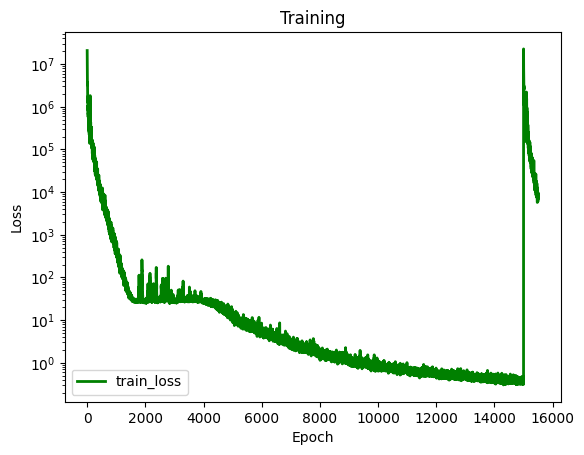

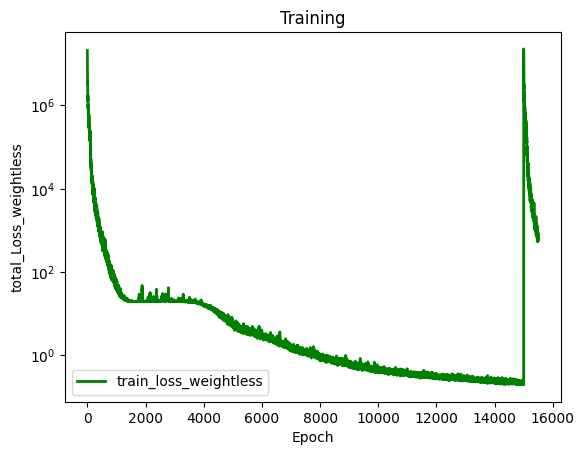

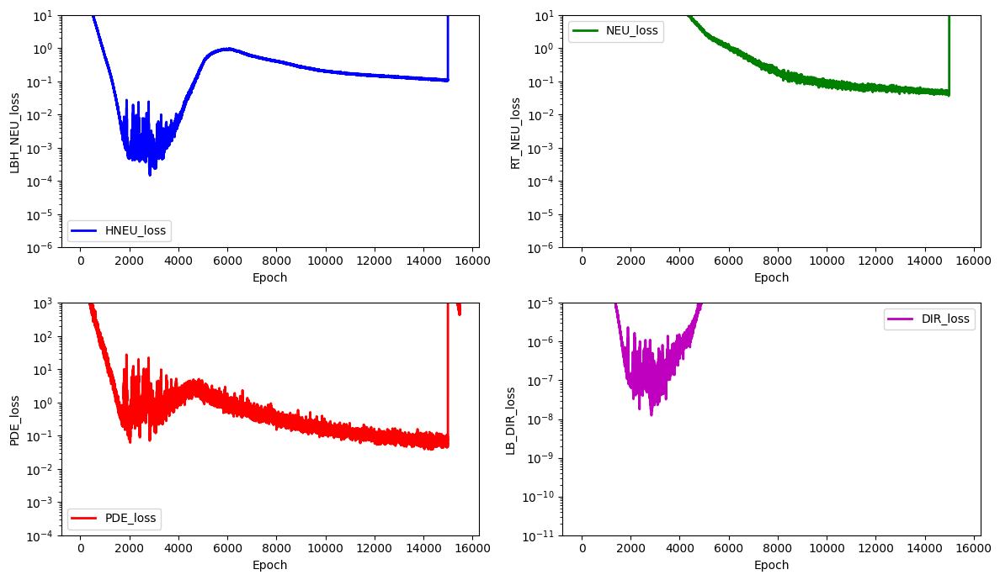

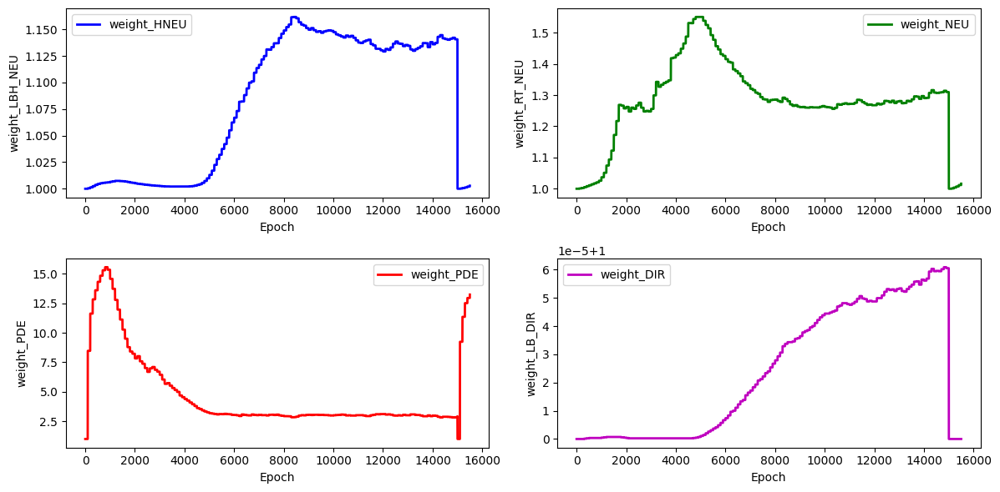

stress_Error for the stress_hole is: 61.01750798293878


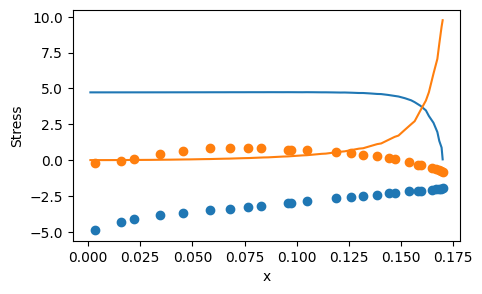

  4%|▍         | 600/15000 [06:40<2:52:20,  1.39it/s] 

for weight 0 norm_grad: 1073.327880859375
for weight 0 new lamda dach: 1.012127161026001
for weight 0 new lamdaloss norm: 1086.34423828125
for weight 1 norm_grad: 6673.9404296875
for weight 1 new lamda dach: 1.0805003643035889
for weight 1 new lamdaloss norm: 7211.1953125
for weight 2 norm_grad: 81832.265625
for weight 2 new lamda dach: 11.56261157989502
for weight 2 new lamdaloss norm: 946194.75
for weight 3 norm_grad: 0.08478491008281708
for weight 3 new lamda dach: 1.0000009536743164
for weight 3 new lamdaloss norm: 0.08478499948978424
for weight 0 new weight_value: 1.0037651062011719
for weight 1 new weight_value: 1.0226987600326538
for weight 2 new weight_value: 13.067338943481445
for weight 3 new weight_value: 1.0000001192092896


  5%|▍         | 700/15000 [07:47<3:02:41,  1.30it/s]

for weight 0 norm_grad: 749.0196533203125
for weight 0 new lamda dach: 1.0108026266098022
for weight 0 new lamdaloss norm: 757.1110229492188
for weight 1 norm_grad: 5405.58056640625
for weight 1 new lamda dach: 1.083573341369629
for weight 1 new lamdaloss norm: 5857.34326171875
for weight 2 norm_grad: 63931.640625
for weight 2 new lamda dach: 11.387511253356934
for weight 2 new lamdaloss norm: 728022.3125
for weight 3 norm_grad: 0.06147466227412224
for weight 3 new lamda dach: 1.0000008344650269
for weight 3 new lamdaloss norm: 0.06147471070289612
for weight 0 new weight_value: 1.0044687986373901
for weight 1 new weight_value: 1.0287861824035645
for weight 2 new weight_value: 12.8993558883667
for weight 3 new weight_value: 1.000000238418579


  5%|▌         | 800/15000 [08:53<2:40:28,  1.47it/s]

for weight 0 norm_grad: 505.7185974121094
for weight 0 new lamda dach: 1.0127756595611572
for weight 0 new lamdaloss norm: 512.1795043945312
for weight 1 norm_grad: 4706.771484375
for weight 1 new lamda dach: 1.133021593093872
for weight 1 new lamdaloss norm: 5332.87353515625
for weight 2 norm_grad: 34877.765625
for weight 2 new lamda dach: 7.691137790679932
for weight 2 new lamdaloss norm: 268249.71875
for weight 3 norm_grad: 0.04070372134447098
for weight 3 new lamda dach: 1.0000009536743164
for weight 3 new lamdaloss norm: 0.04070376232266426
for weight 0 new weight_value: 1.00529944896698
for weight 1 new weight_value: 1.0392097234725952
for weight 2 new weight_value: 12.378533363342285
for weight 3 new weight_value: 1.0000003576278687


  6%|▌         | 900/15000 [09:58<2:46:59,  1.41it/s]

for weight 0 norm_grad: 292.3949890136719
for weight 0 new lamda dach: 1.0124326944351196
for weight 0 new lamdaloss norm: 296.0302429199219
for weight 1 norm_grad: 4221.44140625
for weight 1 new lamda dach: 1.215499758720398
for weight 1 new lamdaloss norm: 5131.1611328125
for weight 2 norm_grad: 19296.658203125
for weight 2 new lamda dach: 5.274978160858154
for weight 2 new lamdaloss norm: 101789.4453125
for weight 3 norm_grad: 0.025946516543626785
for weight 3 new lamda dach: 1.000001072883606
for weight 3 new lamdaloss norm: 0.025946546345949173
for weight 0 new weight_value: 1.0060127973556519
for weight 1 new weight_value: 1.0568387508392334
for weight 2 new weight_value: 11.668177604675293
for weight 3 new weight_value: 1.0000003576278687


  7%|▋         | 999/15000 [11:17<2:55:10,  1.33it/s]

for weight 0 norm_grad: 197.3597869873047
for weight 0 new lamda dach: 1.0084296464920044
for weight 0 new lamdaloss norm: 199.0234375
for weight 1 norm_grad: 3856.105712890625
for weight 1 new lamda dach: 1.1952085494995117
for weight 1 new lamdaloss norm: 4608.8505859375
for weight 2 norm_grad: 19556.3984375
for weight 2 new lamda dach: 5.824592113494873
for weight 2 new lamdaloss norm: 113908.046875
for weight 3 norm_grad: 0.017005857080221176
for weight 3 new lamda dach: 1.0000007152557373
for weight 3 new lamdaloss norm: 0.01700586825609207
for weight 0 new weight_value: 1.0062544345855713
for weight 1 new weight_value: 1.0706757307052612
for weight 2 new weight_value: 11.083819389343262
for weight 3 new weight_value: 1.0000003576278687
total_loss: 35.86505889892578, hole_loss:  0.31945550441741943,neumann_loss:  22.335357666015625, pde_loss: 12.205482482910156,dirichlet_loss: 1.608789352758322e-05


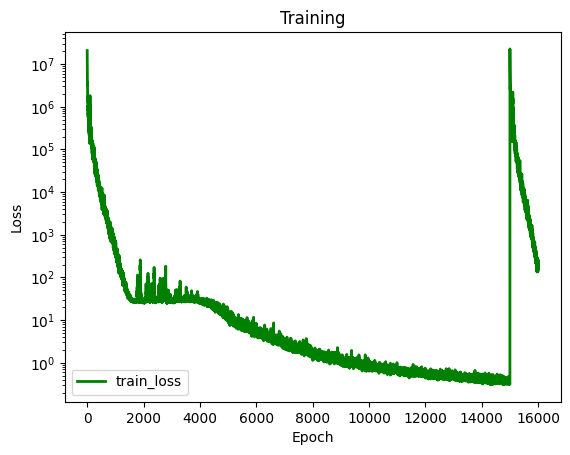

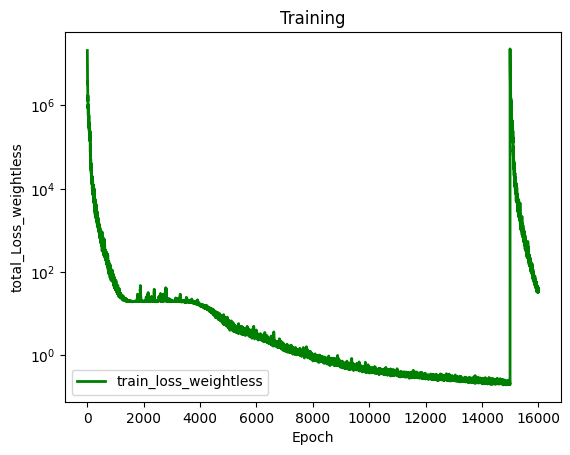

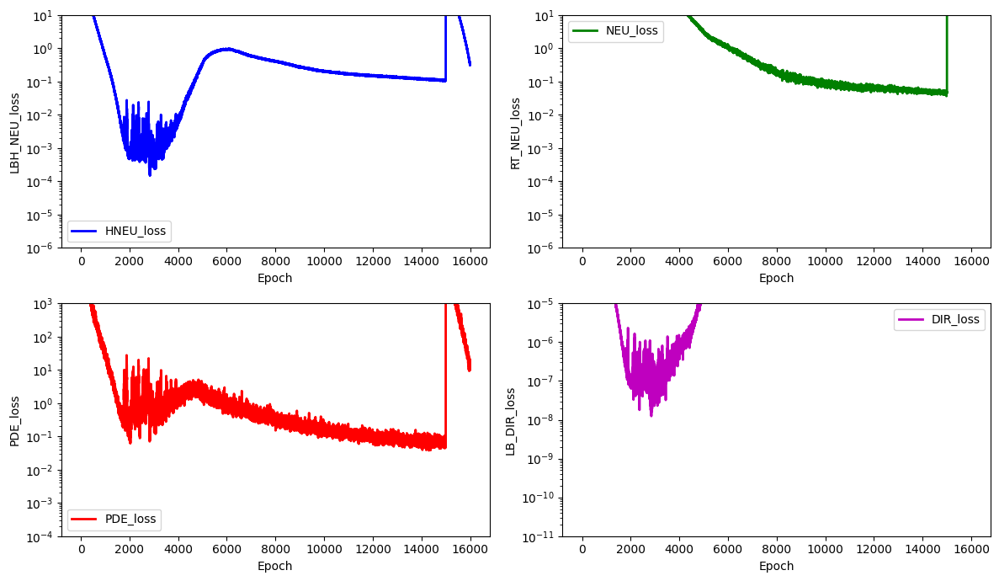

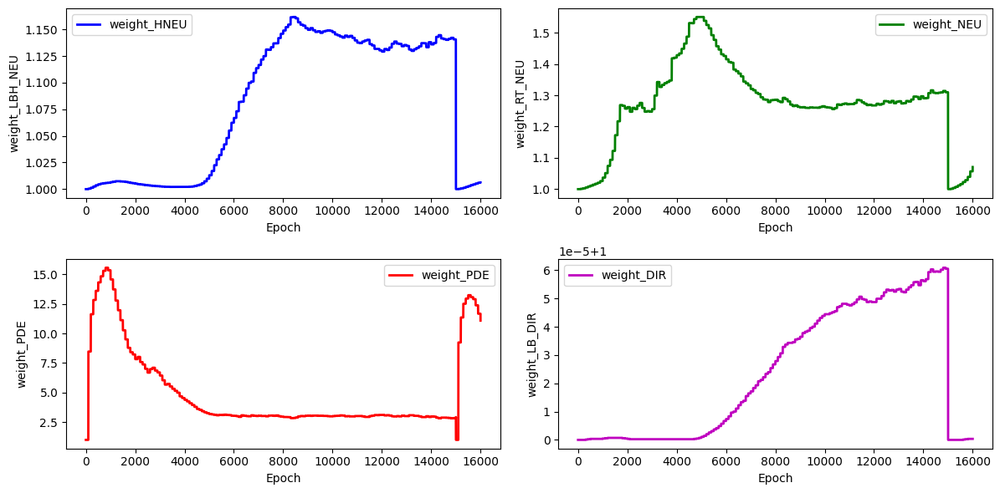

stress_Error for the stress_hole is: 30.174995676971985


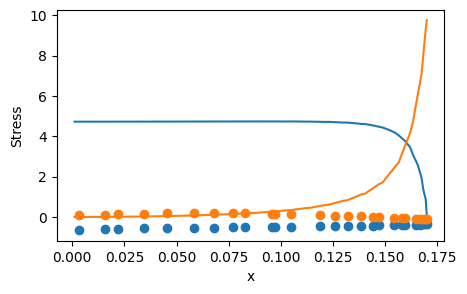

  7%|▋         | 1100/15000 [12:39<3:45:42,  1.03it/s] 

for weight 0 norm_grad: 124.68930053710938
for weight 0 new lamda dach: 1.0071970224380493
for weight 0 new lamdaloss norm: 125.58670043945312
for weight 1 norm_grad: 3674.8291015625
for weight 1 new lamda dach: 1.2667770385742188
for weight 1 new lamdaloss norm: 4655.1884765625
for weight 2 norm_grad: 13650.208984375
for weight 2 new lamda dach: 4.592607021331787
for weight 2 new lamdaloss norm: 62690.046875
for weight 3 norm_grad: 0.010275066830217838
for weight 3 new lamda dach: 1.0000005960464478
for weight 3 new lamdaloss norm: 0.01027507334947586
for weight 0 new weight_value: 1.006348729133606
for weight 1 new weight_value: 1.0902858972549438
for weight 2 new weight_value: 10.434698104858398
for weight 3 new weight_value: 1.0000003576278687


  8%|▊         | 1200/15000 [13:55<2:51:42,  1.34it/s]

for weight 0 norm_grad: 81.68492126464844
for weight 0 new lamda dach: 1.008546233177185
for weight 0 new lamdaloss norm: 82.38301849365234
for weight 1 norm_grad: 3544.80029296875
for weight 1 new lamda dach: 1.58160400390625
for weight 1 new lamdaloss norm: 5606.47021484375
for weight 2 norm_grad: 6013.177734375
for weight 2 new lamda dach: 2.658125638961792
for weight 2 new lamdaloss norm: 15983.7822265625
for weight 3 norm_grad: 0.0063071176409721375
for weight 3 new lamda dach: 1.0000005960464478
for weight 3 new lamdaloss norm: 0.006307121831923723
for weight 0 new weight_value: 1.006568431854248
for weight 1 new weight_value: 1.1394176483154297
for weight 2 new weight_value: 9.6570405960083
for weight 3 new weight_value: 1.0000003576278687


  9%|▊         | 1300/15000 [15:02<2:40:32,  1.42it/s]

for weight 0 norm_grad: 40.5850830078125
for weight 0 new lamda dach: 1.0054925680160522
for weight 0 new lamdaloss norm: 40.80799865722656
for weight 1 norm_grad: 3488.9765625
for weight 1 new lamda dach: 1.8853797912597656
for weight 1 new lamdaloss norm: 6578.0458984375
for weight 2 norm_grad: 3900.06689453125
for weight 2 new lamda dach: 2.104970932006836
for weight 2 new lamdaloss norm: 8209.52734375
for weight 3 norm_grad: 0.003356161294505
for weight 3 new lamda dach: 1.0000004768371582
for weight 3 new lamdaloss norm: 0.003356162691488862
for weight 0 new weight_value: 1.0064607858657837
for weight 1 new weight_value: 1.2140138149261475
for weight 2 new weight_value: 8.901833534240723
for weight 3 new weight_value: 1.0000003576278687


  9%|▉         | 1400/15000 [16:08<2:46:52,  1.36it/s]

for weight 0 norm_grad: 18.81804084777832
for weight 0 new lamda dach: 1.0032076835632324
for weight 0 new lamdaloss norm: 18.87840461730957
for weight 1 norm_grad: 3447.1640625
for weight 1 new lamda dach: 2.4139015674591064
for weight 1 new lamdaloss norm: 8321.1142578125
for weight 2 norm_grad: 2419.231201171875
for weight 2 new lamda dach: 1.6979926824569702
for weight 2 new lamdaloss norm: 4107.8369140625
for weight 3 norm_grad: 0.0014419524231925607
for weight 3 new lamda dach: 1.000000238418579
for weight 3 new lamdaloss norm: 0.0014419527724385262
for weight 0 new weight_value: 1.0061354637145996
for weight 1 new weight_value: 1.3340024948120117
for weight 2 new weight_value: 8.181448936462402
for weight 3 new weight_value: 1.000000238418579


 10%|▉         | 1499/15000 [17:14<2:25:06,  1.55it/s]

for weight 0 norm_grad: 16.46080780029297
for weight 0 new lamda dach: 1.0035638809204102
for weight 0 new lamdaloss norm: 16.519474029541016
for weight 1 norm_grad: 3412.724853515625
for weight 1 new lamda dach: 3.7913291454315186
for weight 1 new lamdaloss norm: 12938.7626953125
for weight 2 norm_grad: 1206.1553955078125
for weight 2 new lamda dach: 1.3517322540283203
for weight 2 new lamdaloss norm: 1630.3990478515625
for weight 3 norm_grad: 0.0005582558806054294
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0005582559388130903
for weight 0 new weight_value: 1.005878210067749
for weight 1 new weight_value: 1.5797350406646729
for weight 2 new weight_value: 7.498476982116699
for weight 3 new weight_value: 1.000000238418579
total_loss: 19.911357879638672, hole_loss:  0.0008014818886294961,neumann_loss:  19.871906280517578, pde_loss: 0.030486270785331726,dirichlet_loss: 1.7447103317635992e-08


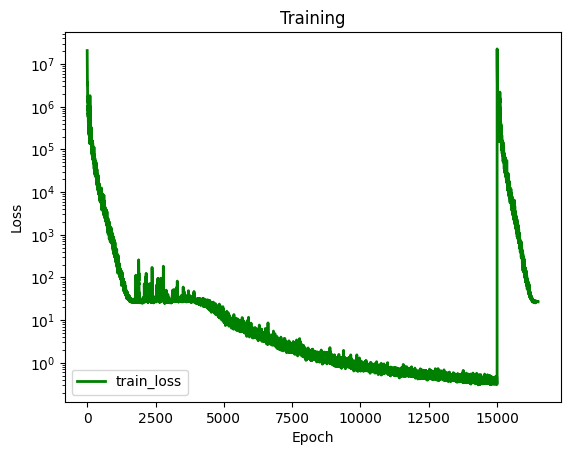

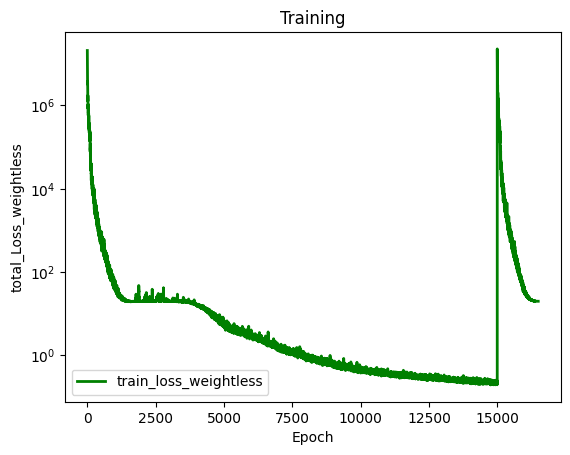

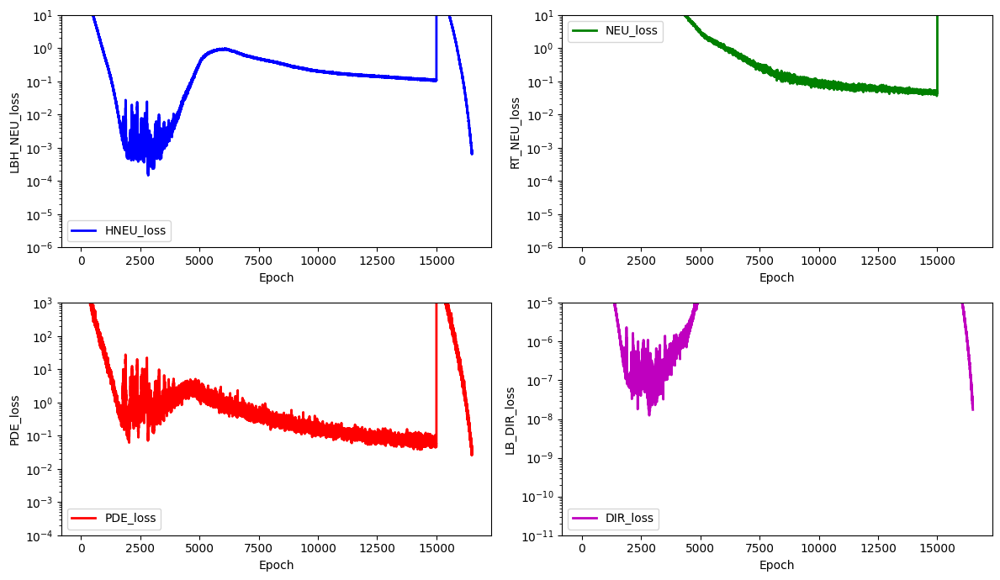

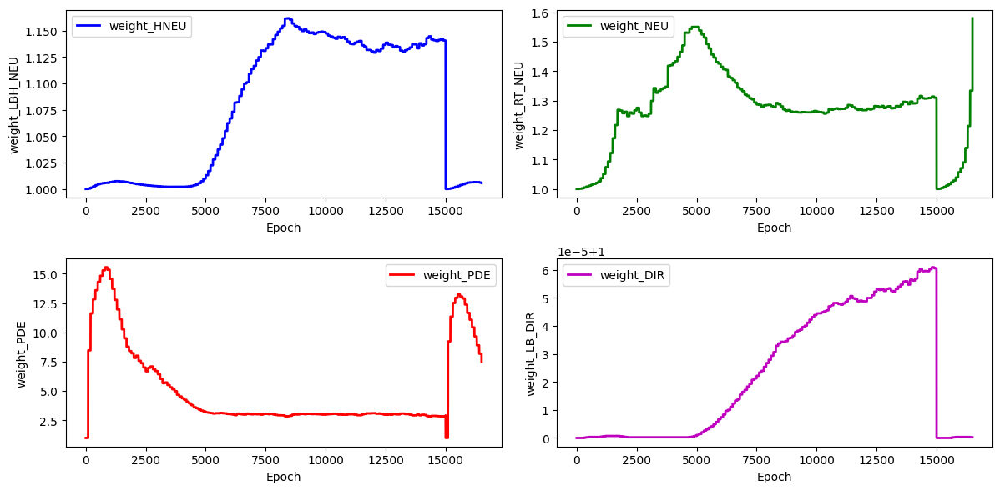

stress_Error for the stress_hole is: 25.70579285576697


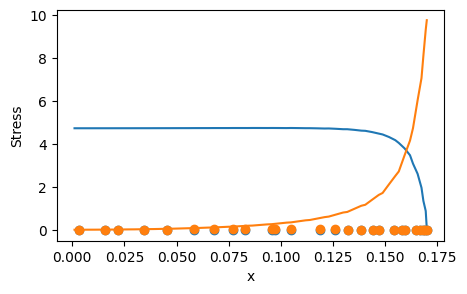

 11%|█         | 1600/15000 [18:28<2:41:54,  1.38it/s]

for weight 0 norm_grad: 12.724167823791504
for weight 0 new lamda dach: 1.0022438764572144
for weight 0 new lamdaloss norm: 12.752717971801758
for weight 1 norm_grad: 3401.338134765625
for weight 1 new lamda dach: 2.4905223846435547
for weight 1 new lamdaloss norm: 8471.1083984375
for weight 2 norm_grad: 2269.2529296875
for weight 2 new lamda dach: 1.6646782159805298
for weight 2 new lamdaloss norm: 3777.575927734375
for weight 3 norm_grad: 0.0002276272134622559
for weight 3 new lamda dach: 1.0
for weight 3 new lamdaloss norm: 0.0002276272134622559
for weight 0 new weight_value: 1.0055147409439087
for weight 1 new weight_value: 1.670813798904419
for weight 2 new weight_value: 6.915096759796143
for weight 3 new weight_value: 1.000000238418579


 11%|█▏        | 1700/15000 [19:39<2:35:17,  1.43it/s]

for weight 0 norm_grad: 3.147042989730835
for weight 0 new lamda dach: 1.0005296468734741
for weight 0 new lamdaloss norm: 3.148709774017334
for weight 1 norm_grad: 3399.471435546875
for weight 1 new lamda dach: 2.3355536460876465
for weight 1 new lamdaloss norm: 7939.64794921875
for weight 2 norm_grad: 2542.2177734375
for weight 2 new lamda dach: 1.7471356391906738
for weight 2 new lamdaloss norm: 4441.59912109375
for weight 3 norm_grad: 0.0003112601407337934
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0003112601407337934
for weight 0 new weight_value: 1.0050162076950073
for weight 1 new weight_value: 1.7372876405715942
for weight 2 new weight_value: 6.398300647735596
for weight 3 new weight_value: 1.000000238418579


 12%|█▏        | 1800/15000 [20:46<2:32:13,  1.45it/s]

for weight 0 norm_grad: 7.464223384857178
for weight 0 new lamda dach: 1.001444935798645
for weight 0 new lamdaloss norm: 7.475008487701416
for weight 1 norm_grad: 3385.797119140625
for weight 1 new lamda dach: 2.8942487239837646
for weight 1 new lamdaloss norm: 9799.33984375
for weight 2 norm_grad: 1779.9444580078125
for weight 2 new lamda dach: 1.524552583694458
for weight 2 new lamdaloss norm: 2713.618896484375
for weight 3 norm_grad: 0.0002989146742038429
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0002989147324115038
for weight 0 new weight_value: 1.0046590566635132
for weight 1 new weight_value: 1.8529837131500244
for weight 2 new weight_value: 5.91092586517334
for weight 3 new weight_value: 1.000000238418579


 13%|█▎        | 1900/15000 [21:52<2:40:35,  1.36it/s]

for weight 0 norm_grad: 17.802770614624023
for weight 0 new lamda dach: 1.0026074647903442
for weight 0 new lamdaloss norm: 17.84918975830078
for weight 1 norm_grad: 3367.80322265625
for weight 1 new lamda dach: 1.9684191942214966
for weight 1 new lamdaloss norm: 6629.24853515625
for weight 2 norm_grad: 3459.826171875
for weight 2 new lamda dach: 2.0219221115112305
for weight 2 new lamdaloss norm: 6995.4990234375
for weight 3 norm_grad: 0.0007237662794068456
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0007237663958221674
for weight 0 new weight_value: 1.0044538974761963
for weight 1 new weight_value: 1.8645272254943848
for weight 2 new weight_value: 5.5220255851745605
for weight 3 new weight_value: 1.000000238418579


 13%|█▎        | 1999/15000 [22:58<2:27:14,  1.47it/s]

for weight 0 norm_grad: 24.85745620727539
for weight 0 new lamda dach: 1.0018450021743774
for weight 0 new lamdaloss norm: 24.903316497802734
for weight 1 norm_grad: 3398.286376953125
for weight 1 new lamda dach: 1.336480736732483
for weight 1 new lamdaloss norm: 4541.74462890625
for weight 2 norm_grad: 10074.6396484375
for weight 2 new lamda dach: 3.9430949687957764
for weight 2 new lamdaloss norm: 39725.2578125
for weight 3 norm_grad: 0.0006658424972556531
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0006658425554633141
for weight 0 new weight_value: 1.0041930675506592
for weight 1 new weight_value: 1.8117225170135498
for weight 2 new weight_value: 5.364132404327393
for weight 3 new weight_value: 1.000000238418579
total_loss: 20.487987518310547, hole_loss:  0.0011450680904090405,neumann_loss:  19.636253356933594, pde_loss: 0.6676411628723145,dirichlet_loss: 3.625658351325001e-08


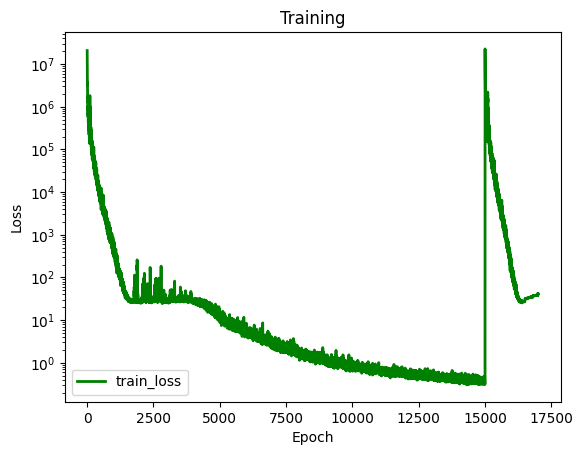

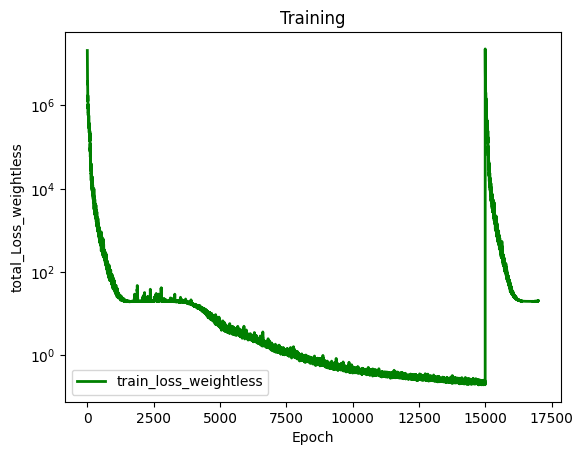

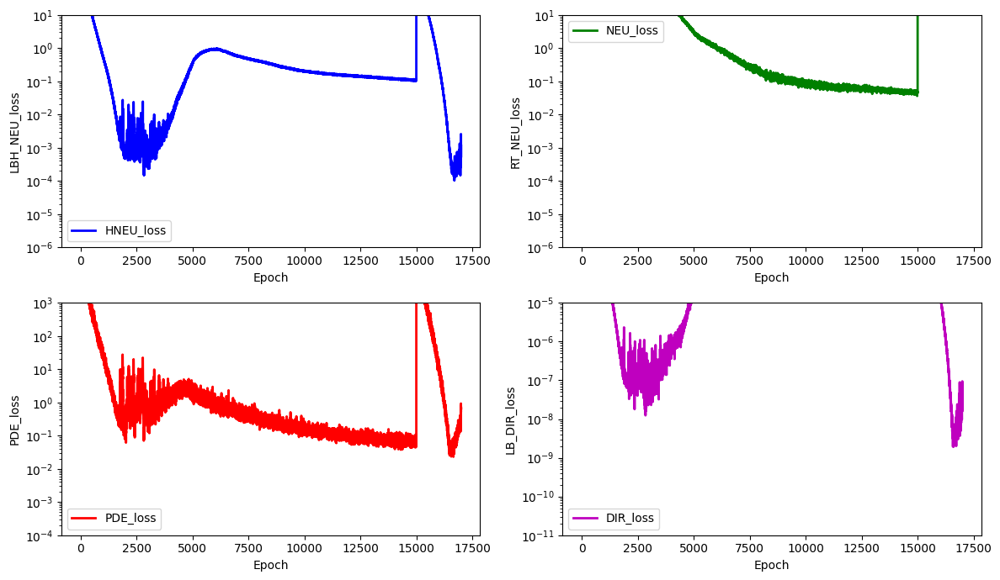

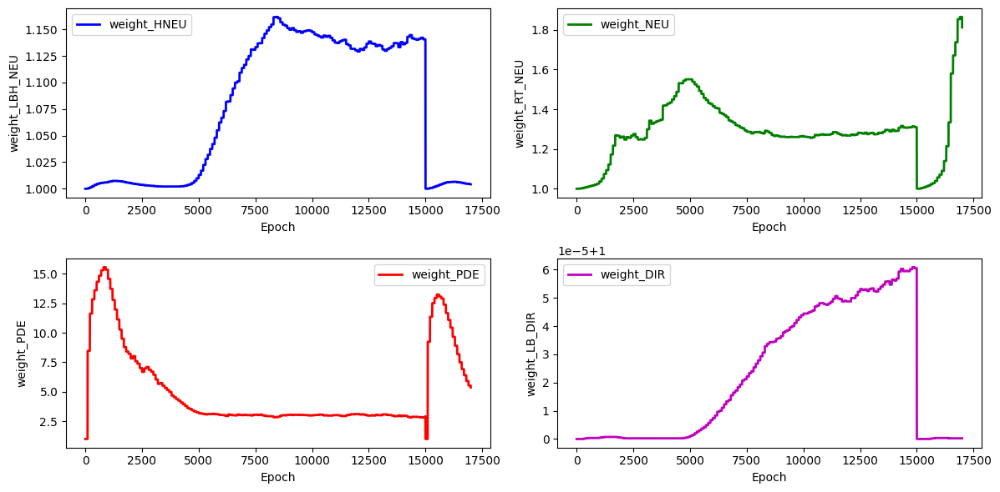

stress_Error for the stress_hole is: 25.44883242121771


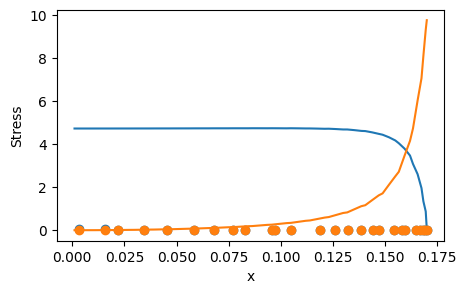

 14%|█▍        | 2100/15000 [24:21<2:40:40,  1.34it/s]

for weight 0 norm_grad: 14.516738891601562
for weight 0 new lamda dach: 1.0020931959152222
for weight 0 new lamdaloss norm: 14.547124862670898
for weight 1 norm_grad: 3382.646484375
for weight 1 new lamda dach: 1.948360800743103
for weight 1 new lamdaloss norm: 6590.61572265625
for weight 2 norm_grad: 3552.317626953125
for weight 2 new lamda dach: 2.0456714630126953
for weight 2 new lamdaloss norm: 7266.87451171875
for weight 3 norm_grad: 0.0004087884444743395
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.00040878847357816994
for weight 0 new weight_value: 1.0039830207824707
for weight 1 new weight_value: 1.8253862857818604
for weight 2 new weight_value: 5.032286167144775
for weight 3 new weight_value: 1.000000238418579


 15%|█▍        | 2200/15000 [25:32<2:31:46,  1.41it/s]

for weight 0 norm_grad: 50.68236541748047
for weight 0 new lamda dach: 1.00257408618927
for weight 0 new lamdaloss norm: 50.812828063964844
for weight 1 norm_grad: 3339.654541015625
for weight 1 new lamda dach: 1.2036367654800415
for weight 1 new lamdaloss norm: 4019.730712890625
for weight 2 norm_grad: 16349.3740234375
for weight 2 new lamda dach: 5.8223419189453125
for weight 2 new lamdaloss norm: 95191.640625
for weight 3 norm_grad: 0.0015969079686328769
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0015969080850481987
for weight 0 new weight_value: 1.0038421154022217
for weight 1 new weight_value: 1.7632113695144653
for weight 2 new weight_value: 5.111291885375977
for weight 3 new weight_value: 1.000000238418579


 15%|█▌        | 2300/15000 [26:38<2:30:49,  1.40it/s]

for weight 0 norm_grad: 15.402533531188965
for weight 0 new lamda dach: 1.0012410879135132
for weight 0 new lamdaloss norm: 15.421648979187012
for weight 1 norm_grad: 3379.1650390625
for weight 1 new lamda dach: 1.3735090494155884
for weight 1 new lamdaloss norm: 4641.3134765625
for weight 2 norm_grad: 9031.6728515625
for weight 2 new lamda dach: 3.6606247425079346
for weight 2 new lamdaloss norm: 33061.56640625
for weight 3 norm_grad: 0.0007987527060322464
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0007987528224475682
for weight 0 new weight_value: 1.0035820007324219
for weight 1 new weight_value: 1.7242411375045776
for weight 2 new weight_value: 4.9662251472473145
for weight 3 new weight_value: 1.000000238418579


 16%|█▌        | 2400/15000 [27:47<2:45:29,  1.27it/s]

for weight 0 norm_grad: 33.58854675292969
for weight 0 new lamda dach: 1.002868413925171
for weight 0 new lamdaloss norm: 33.68489074707031
for weight 1 norm_grad: 3402.839599609375
for weight 1 new lamda dach: 1.4079900979995728
for weight 1 new lamdaloss norm: 4791.16455078125
for weight 2 norm_grad: 8306.90625
for weight 2 new lamda dach: 3.4173078536987305
for weight 2 new lamdaloss norm: 28387.2578125
for weight 3 norm_grad: 0.000901885679922998
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0009018857963383198
for weight 0 new weight_value: 1.003510594367981
for weight 1 new weight_value: 1.6926159858703613
for weight 2 new weight_value: 4.811333179473877
for weight 3 new weight_value: 1.000000238418579


 17%|█▋        | 2499/15000 [28:54<2:22:59,  1.46it/s]

for weight 0 norm_grad: 47.56963348388672
for weight 0 new lamda dach: 1.0018079280853271
for weight 0 new lamdaloss norm: 47.655635833740234
for weight 1 norm_grad: 3412.987060546875
for weight 1 new lamda dach: 1.1487375497817993
for weight 1 new lamdaloss norm: 3920.626220703125
for weight 2 norm_grad: 22898.80078125
for weight 2 new lamda dach: 7.617082118988037
for weight 2 new lamdaloss norm: 174422.0625
for weight 3 norm_grad: 0.0018370946636423469
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0018370948964729905
for weight 0 new weight_value: 1.003340244293213
for weight 1 new weight_value: 1.6382280588150024
for weight 2 new weight_value: 5.091907978057861
for weight 3 new weight_value: 1.000000238418579
total_loss: 22.465024948120117, hole_loss:  0.004101844504475594,neumann_loss:  19.802322387695312, pde_loss: 2.977586269378662,dirichlet_loss: 1.8844099258785718e-07


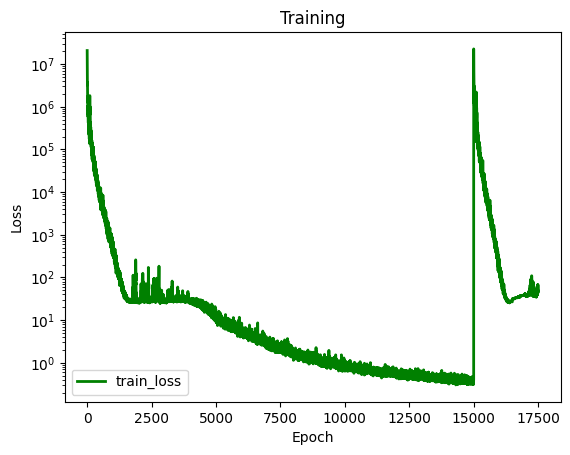

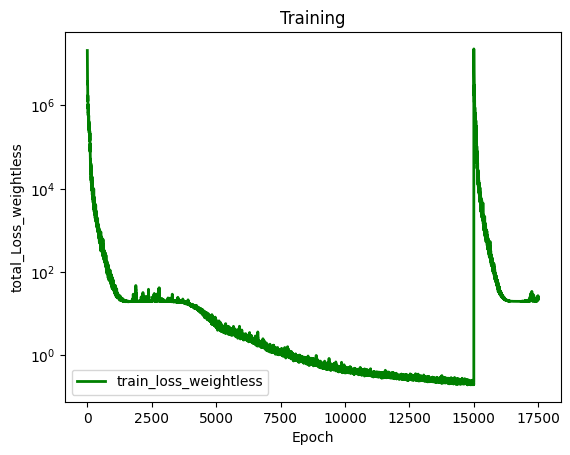

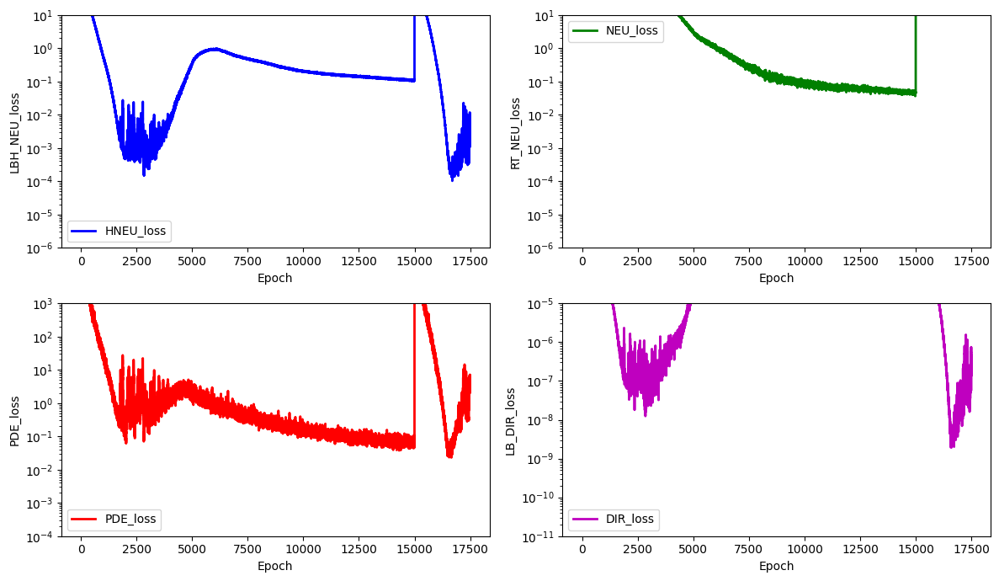

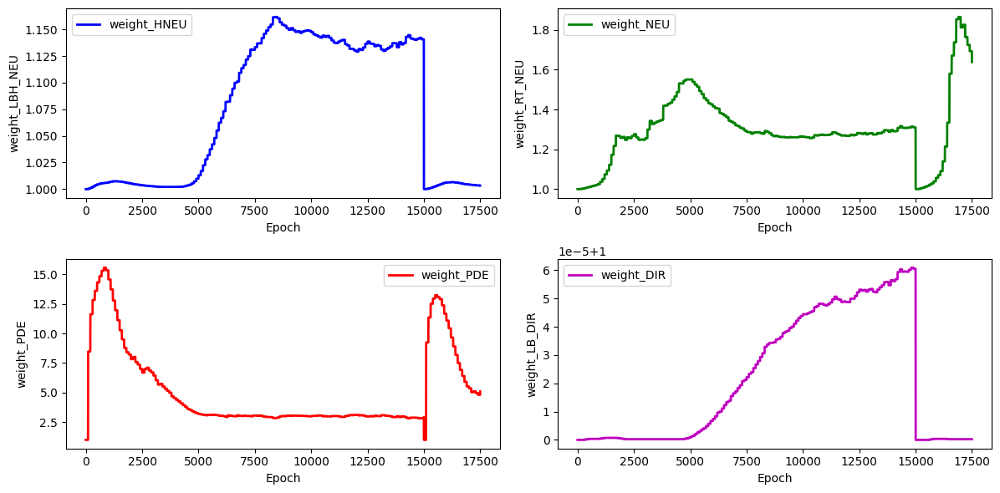

stress_Error for the stress_hole is: 25.716905956256966


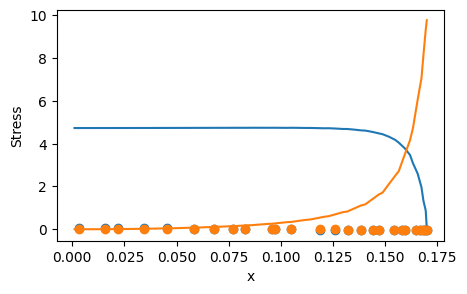

 17%|█▋        | 2600/15000 [30:06<2:29:09,  1.39it/s]

for weight 0 norm_grad: 31.21394920349121
for weight 0 new lamda dach: 1.0032955408096313
for weight 0 new lamdaloss norm: 31.316818237304688
for weight 1 norm_grad: 3408.684326171875
for weight 1 new lamda dach: 1.5593515634536743
for weight 1 new lamdaloss norm: 5315.33740234375
for weight 2 norm_grad: 6062.77783203125
for weight 2 new lamda dach: 2.762486696243286
for weight 2 new lamdaloss norm: 16748.34375
for weight 3 norm_grad: 0.001497045741416514
for weight 3 new lamda dach: 1.000000238418579
for weight 3 new lamdaloss norm: 0.0014970462070778012
for weight 0 new weight_value: 1.00333571434021
for weight 1 new weight_value: 1.630340337753296
for weight 2 new weight_value: 4.8589653968811035
for weight 3 new weight_value: 1.000000238418579


 18%|█▊        | 2700/15000 [31:15<2:24:10,  1.42it/s]

for weight 0 norm_grad: 92.43073272705078
for weight 0 new lamda dach: 1.0016824007034302
for weight 0 new lamdaloss norm: 92.58623504638672
for weight 1 norm_grad: 3327.69287109375
for weight 1 new lamda dach: 1.0643593072891235
for weight 1 new lamdaloss norm: 3541.860595703125
for weight 2 norm_grad: 51612.484375
for weight 2 new lamda dach: 16.090801239013672
for weight 2 new lamdaloss norm: 830486.25
for weight 3 norm_grad: 0.005386536940932274
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.005386537406593561
for weight 0 new weight_value: 1.003170371055603
for weight 1 new weight_value: 1.573742151260376
for weight 2 new weight_value: 5.982149124145508
for weight 3 new weight_value: 1.000000238418579


 19%|█▊        | 2800/15000 [32:23<2:28:43,  1.37it/s]

for weight 0 norm_grad: 46.343894958496094
for weight 0 new lamda dach: 1.0017260313034058
for weight 0 new lamdaloss norm: 46.42388916015625
for weight 1 norm_grad: 3402.289794921875
for weight 1 new lamda dach: 1.144819974899292
for weight 1 new lamdaloss norm: 3895.00927734375
for weight 2 norm_grad: 23446.884765625
for weight 2 new lamda dach: 7.798877239227295
for weight 2 new lamdaloss norm: 182859.375
for weight 3 norm_grad: 0.005427052732557058
for weight 3 new lamda dach: 1.000000238418579
for weight 3 new lamdaloss norm: 0.00542705412954092
for weight 0 new weight_value: 1.0030258893966675
for weight 1 new weight_value: 1.5308499336242676
for weight 2 new weight_value: 6.163821697235107
for weight 3 new weight_value: 1.000000238418579


 19%|█▉        | 2900/15000 [33:31<2:16:18,  1.48it/s]

for weight 0 norm_grad: 30.827922821044922
for weight 0 new lamda dach: 1.0032271146774292
for weight 0 new lamdaloss norm: 30.92740821838379
for weight 1 norm_grad: 3439.463623046875
for weight 1 new lamda dach: 1.559786081314087
for weight 1 new lamdaloss norm: 5364.8271484375
for weight 2 norm_grad: 6113.41845703125
for weight 2 new lamda dach: 2.761643648147583
for weight 2 new lamdaloss norm: 16883.08203125
for weight 3 norm_grad: 0.0011326062958687544
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.001132606528699398
for weight 0 new weight_value: 1.003045916557312
for weight 1 new weight_value: 1.5337435007095337
for weight 2 new weight_value: 5.823604106903076
for weight 3 new weight_value: 1.000000238418579


 20%|█▉        | 2999/15000 [34:37<2:20:09,  1.43it/s]

for weight 0 norm_grad: 22.377687454223633
for weight 0 new lamda dach: 1.0028551816940308
for weight 0 new lamdaloss norm: 22.441579818725586
for weight 1 norm_grad: 3496.482177734375
for weight 1 new lamda dach: 1.8013020753860474
for weight 1 new lamdaloss norm: 6298.22119140625
for weight 2 norm_grad: 4341.123046875
for weight 2 new lamda dach: 2.233673095703125
for weight 2 new lamdaloss norm: 9696.650390625
for weight 3 norm_grad: 0.0005888135056011379
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0005888135638087988
for weight 0 new weight_value: 1.0030268430709839
for weight 1 new weight_value: 1.5604993104934692
for weight 2 new weight_value: 5.464610576629639
for weight 3 new weight_value: 1.000000238418579
total_loss: 19.987226486206055, hole_loss:  0.0006867186748422682,neumann_loss:  19.700902938842773, pde_loss: 0.2352144718170166,dirichlet_loss: 1.745466526870132e-08


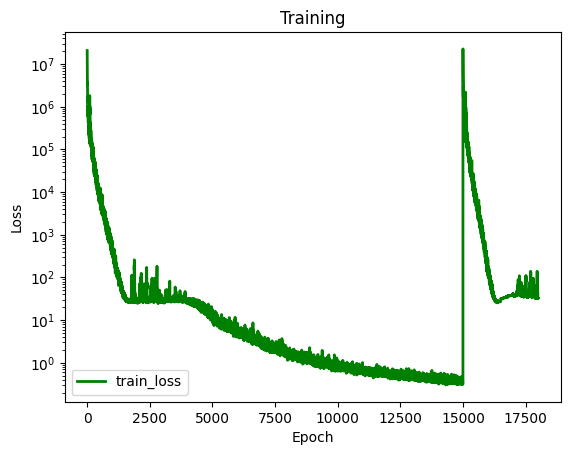

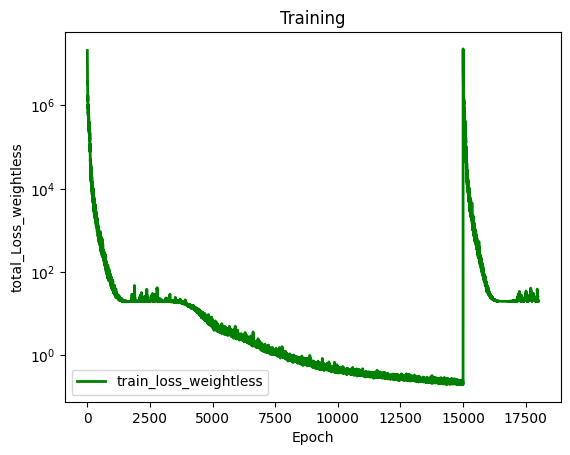

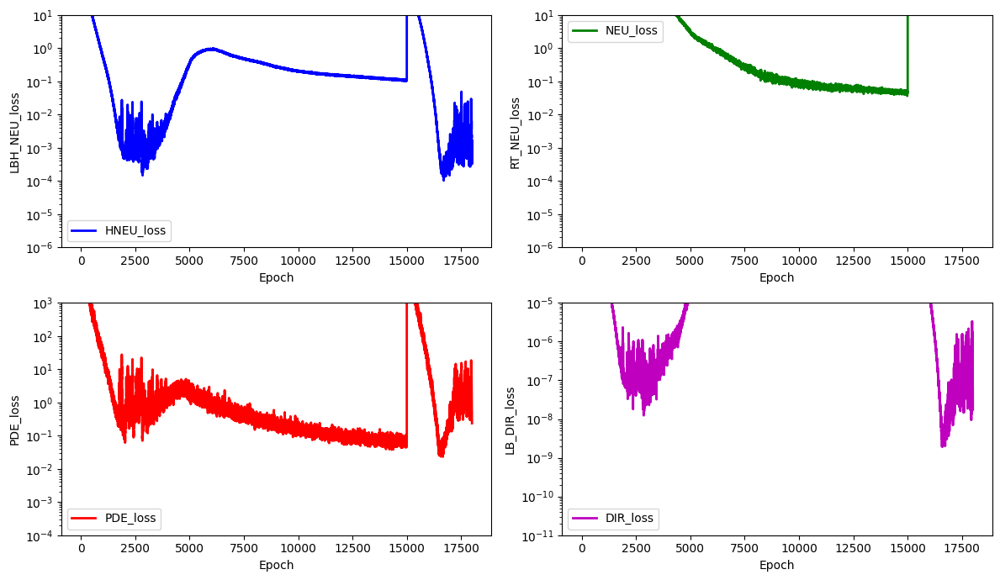

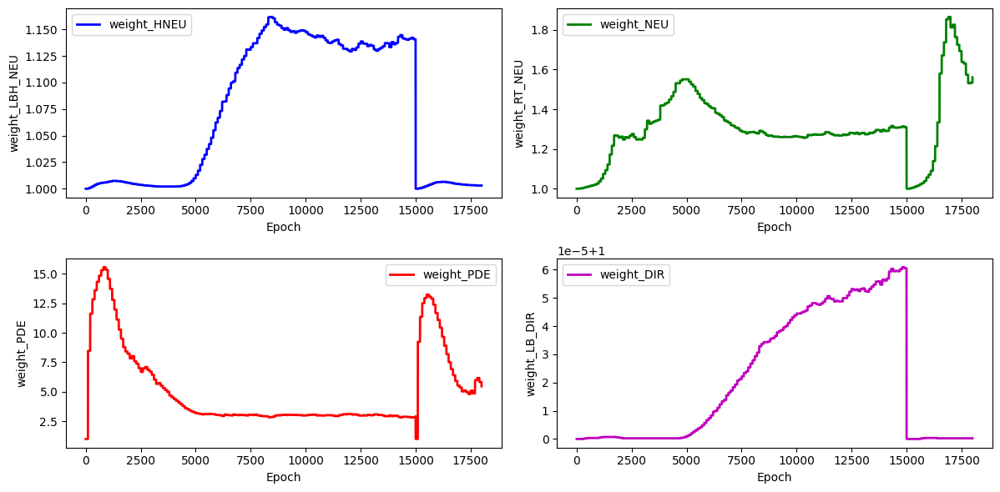

stress_Error for the stress_hole is: 25.47239654708031


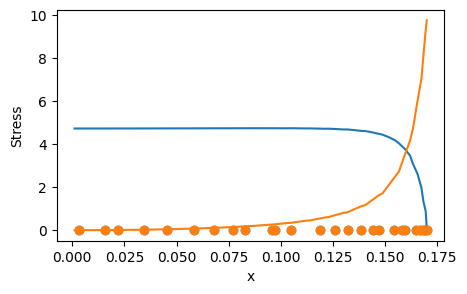

 21%|██        | 3100/15000 [35:57<2:21:47,  1.40it/s]

for weight 0 norm_grad: 10.07089900970459
for weight 0 new lamda dach: 1.0016006231307983
for weight 0 new lamdaloss norm: 10.087018013000488
for weight 1 norm_grad: 3485.23046875
for weight 1 new lamda dach: 2.2374274730682373
for weight 1 new lamdaloss norm: 7797.9501953125
for weight 2 norm_grad: 2806.44140625
for weight 2 new lamda dach: 1.8029180765151978
for weight 2 new lamdaloss norm: 5059.78369140625
for weight 3 norm_grad: 0.0010814655106514692
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.001081465627066791
for weight 0 new weight_value: 1.0028841495513916
for weight 1 new weight_value: 1.6281920671463013
for weight 2 new weight_value: 5.098441123962402
for weight 3 new weight_value: 1.000000238418579


 21%|██▏       | 3200/15000 [3:53:35<1:38:28,  2.00it/s]      

for weight 0 norm_grad: 16.903730392456055
for weight 0 new lamda dach: 1.0021156072616577
for weight 0 new lamdaloss norm: 16.939495086669922
for weight 1 norm_grad: 3502.55224609375
for weight 1 new lamda dach: 1.7776150703430176
for weight 1 new lamdaloss norm: 6226.189453125
for weight 2 norm_grad: 4487.31884765625
for weight 2 new lamda dach: 2.27500319480896
for weight 2 new lamdaloss norm: 10208.6650390625
for weight 3 norm_grad: 0.0009107256773859262
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0009107257355935872
for weight 0 new weight_value: 1.0028072595596313
for weight 1 new weight_value: 1.643134355545044
for weight 2 new weight_value: 4.816097259521484
for weight 3 new weight_value: 1.000000238418579


 22%|██▏       | 3300/15000 [3:54:19<1:25:07,  2.29it/s]

for weight 0 norm_grad: 16.67279815673828
for weight 0 new lamda dach: 1.0013707876205444
for weight 0 new lamdaloss norm: 16.695653915405273
for weight 1 norm_grad: 3581.89794921875
for weight 1 new lamda dach: 1.4166020154953003
for weight 1 new lamdaloss norm: 5074.1240234375
for weight 2 norm_grad: 8581.2109375
for weight 2 new lamda dach: 3.384613513946533
for weight 2 new lamdaloss norm: 29044.083984375
for weight 3 norm_grad: 0.0045985872857272625
for weight 3 new lamda dach: 1.0000003576278687
for weight 3 new lamdaloss norm: 0.004598589148372412
for weight 0 new weight_value: 1.0026636123657227
for weight 1 new weight_value: 1.6204811334609985
for weight 2 new weight_value: 4.672948837280273
for weight 3 new weight_value: 1.000000238418579


 23%|██▎       | 3400/15000 [3:55:01<1:08:26,  2.82it/s]

for weight 0 norm_grad: 10.063989639282227
for weight 0 new lamda dach: 1.0010095834732056
for weight 0 new lamdaloss norm: 10.074150085449219
for weight 1 norm_grad: 3562.520751953125
for weight 1 new lamda dach: 1.5551756620407104
for weight 1 new lamdaloss norm: 5540.34521484375
for weight 2 norm_grad: 6406.85986328125
for weight 2 new lamda dach: 2.793339967727661
for weight 2 new lamdaloss norm: 17896.5390625
for weight 3 norm_grad: 0.001320325187407434
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0013203253038227558
for weight 0 new weight_value: 1.0024981498718262
for weight 1 new weight_value: 1.6139506101608276
for weight 2 new weight_value: 4.484987735748291
for weight 3 new weight_value: 1.000000238418579


 23%|██▎       | 3499/15000 [3:55:36<1:07:16,  2.85it/s]

for weight 0 norm_grad: 20.456104278564453
for weight 0 new lamda dach: 1.0019878149032593
for weight 0 new lamdaloss norm: 20.496767044067383
for weight 1 norm_grad: 3562.4814453125
for weight 1 new lamda dach: 1.5278719663619995
for weight 1 new lamdaloss norm: 5443.015625
for weight 2 norm_grad: 6728.30322265625
for weight 2 new lamda dach: 2.8778727054595947
for weight 2 new lamdaloss norm: 19363.19921875
for weight 3 norm_grad: 0.0020264287013560534
for weight 3 new lamda dach: 1.000000238418579
for weight 3 new lamdaloss norm: 0.0020264291670173407
for weight 0 new weight_value: 1.0024471282958984
for weight 1 new weight_value: 1.6053427457809448
for weight 2 new weight_value: 4.324276447296143
for weight 3 new weight_value: 1.000000238418579
total_loss: 19.818208694458008, hole_loss:  0.0015972033143043518,neumann_loss:  18.922645568847656, pde_loss: 0.938852071762085,dirichlet_loss: 1.672978555689042e-07


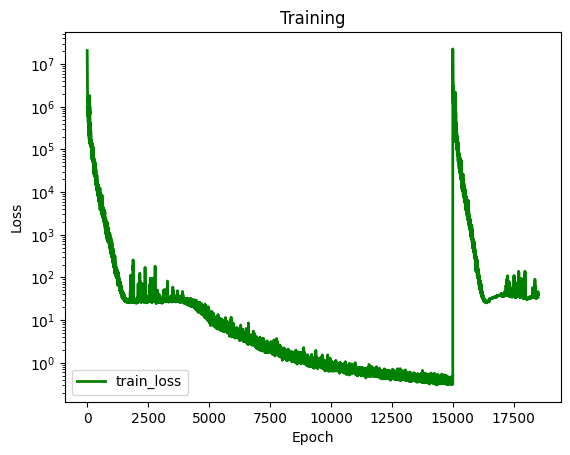

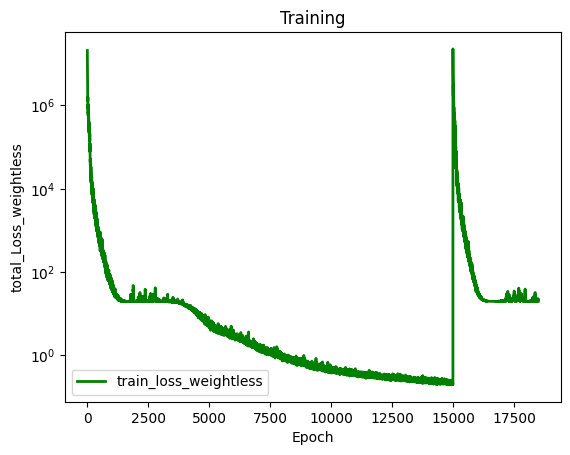

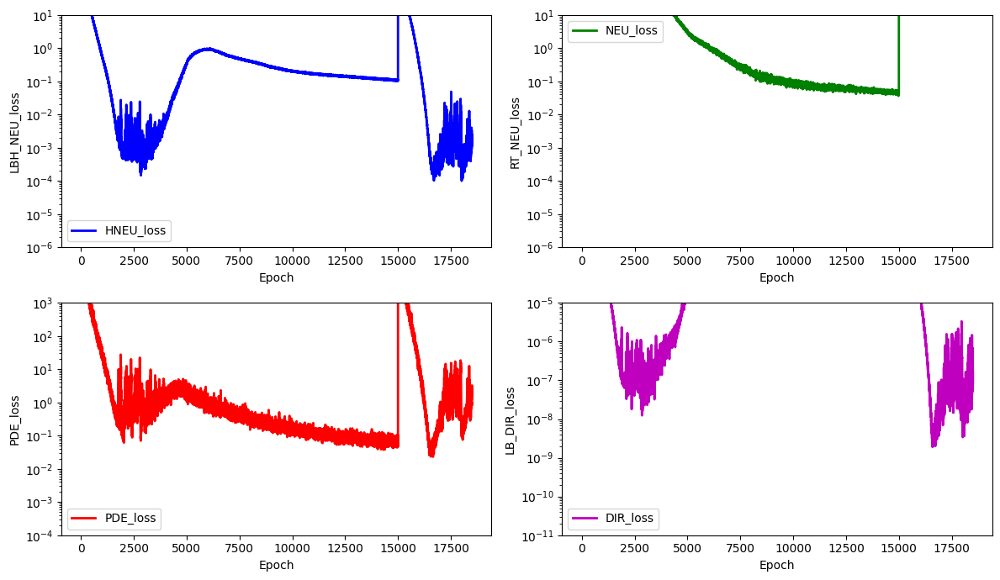

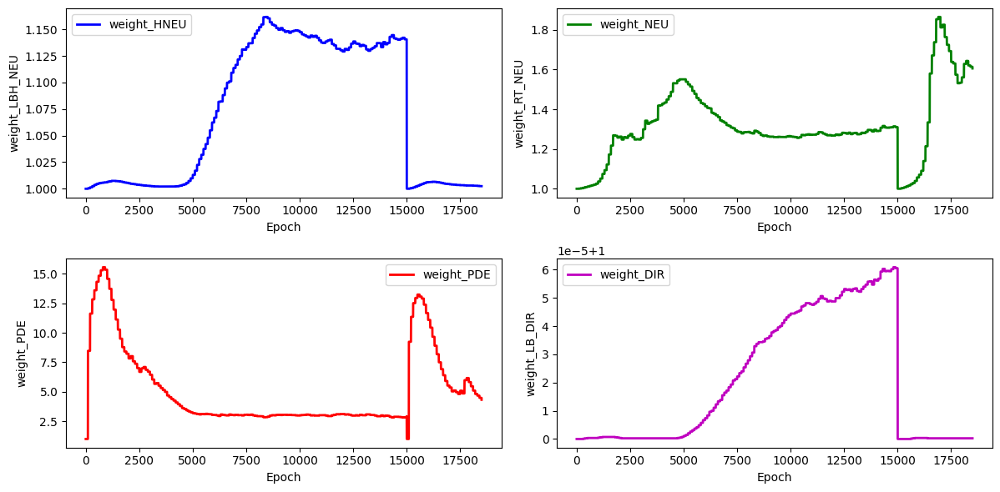

stress_Error for the stress_hole is: 25.40091702018689


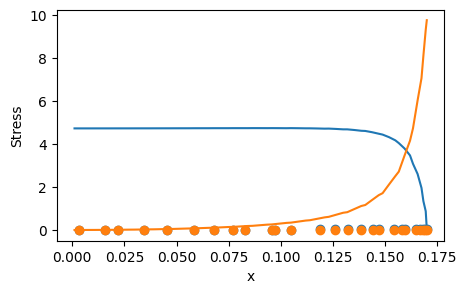

 24%|██▍       | 3600/15000 [3:56:22<1:35:32,  1.99it/s]

for weight 0 norm_grad: 21.225040435791016
for weight 0 new lamda dach: 1.001301884651184
for weight 0 new lamdaloss norm: 21.25267219543457
for weight 1 norm_grad: 3674.19482421875
for weight 1 new lamda dach: 1.2904454469680786
for weight 1 new lamdaloss norm: 4741.34814453125
for weight 2 norm_grad: 12628.97265625
for weight 2 new lamda dach: 4.41746187210083
for weight 2 new lamdaloss norm: 55788.0078125
for weight 3 norm_grad: 0.004955241456627846
for weight 3 new lamda dach: 1.0000003576278687
for weight 3 new lamdaloss norm: 0.004955243784934282
for weight 0 new weight_value: 1.0023325681686401
for weight 1 new weight_value: 1.5738530158996582
for weight 2 new weight_value: 4.333594799041748
for weight 3 new weight_value: 1.000000238418579


 25%|██▍       | 3700/15000 [3:56:59<1:06:05,  2.85it/s]

for weight 0 norm_grad: 24.46734046936035
for weight 0 new lamda dach: 1.0022372007369995
for weight 0 new lamdaloss norm: 24.522077560424805
for weight 1 norm_grad: 3753.997802734375
for weight 1 new lamda dach: 1.5208688974380493
for weight 1 new lamdaloss norm: 5709.3388671875
for weight 2 norm_grad: 7182.71630859375
for weight 2 new lamda dach: 2.900960683822632
for weight 2 new lamdaloss norm: 20836.775390625
for weight 3 norm_grad: 0.0013250095071271062
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0013250097399577498
for weight 0 new weight_value: 1.002323031425476
for weight 1 new weight_value: 1.5685545206069946
for weight 2 new weight_value: 4.19033145904541
for weight 3 new weight_value: 1.000000238418579


 25%|██▌       | 3800/15000 [3:57:33<1:04:54,  2.88it/s]

for weight 0 norm_grad: 18.399818420410156
for weight 0 new lamda dach: 1.001651644706726
for weight 0 new lamdaloss norm: 18.430208206176758
for weight 1 norm_grad: 3926.653564453125
for weight 1 new lamda dach: 1.5429645776748657
for weight 1 new lamdaloss norm: 6058.68798828125
for weight 2 norm_grad: 7213.47509765625
for weight 2 new lamda dach: 2.8284852504730225
for weight 2 new lamdaloss norm: 20403.20703125
for weight 3 norm_grad: 0.0022799086291342974
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.002279908861964941
for weight 0 new weight_value: 1.002255916595459
for weight 1 new weight_value: 1.565995454788208
for weight 2 new weight_value: 4.054146766662598
for weight 3 new weight_value: 1.000000238418579


 26%|██▌       | 3900/15000 [3:58:07<1:05:07,  2.84it/s]

for weight 0 norm_grad: 11.590038299560547
for weight 0 new lamda dach: 1.0012462139129639
for weight 0 new lamdaloss norm: 11.60448169708252
for weight 1 norm_grad: 3954.29443359375
for weight 1 new lamda dach: 1.738113522529602
for weight 1 new lamdaloss norm: 6873.01318359375
for weight 2 norm_grad: 5345.70703125
for weight 2 new lamda dach: 2.3479225635528564
for weight 2 new lamdaloss norm: 12551.3056640625
for weight 3 norm_grad: 0.001091748010367155
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.001091748126782477
for weight 0 new weight_value: 1.0021549463272095
for weight 1 new weight_value: 1.583207130432129
for weight 2 new weight_value: 3.883524179458618
for weight 3 new weight_value: 1.000000238418579


 27%|██▋       | 3999/15000 [3:58:45<1:07:46,  2.71it/s]

for weight 0 norm_grad: 18.626859664916992
for weight 0 new lamda dach: 1.0010643005371094
for weight 0 new lamdaloss norm: 18.646684646606445
for weight 1 norm_grad: 4166.60009765625
for weight 1 new lamda dach: 1.3120181560516357
for weight 1 new lamdaloss norm: 5466.65478515625
for weight 2 norm_grad: 13335.072265625
for weight 2 new lamda dach: 4.186218738555908
for weight 2 new lamdaloss norm: 55823.53125
for weight 3 norm_grad: 0.008129378780722618
for weight 3 new lamda dach: 1.0000004768371582
for weight 3 new lamdaloss norm: 0.008129382506012917
for weight 0 new weight_value: 1.0020458698272705
for weight 1 new weight_value: 1.5560882091522217
for weight 2 new weight_value: 3.9137935638427734
for weight 3 new weight_value: 1.000000238418579
total_loss: 22.026519775390625, hole_loss:  0.003986692521721125,neumann_loss:  16.4061279296875, pde_loss: 4.623321533203125,dirichlet_loss: 2.16929674934363e-06


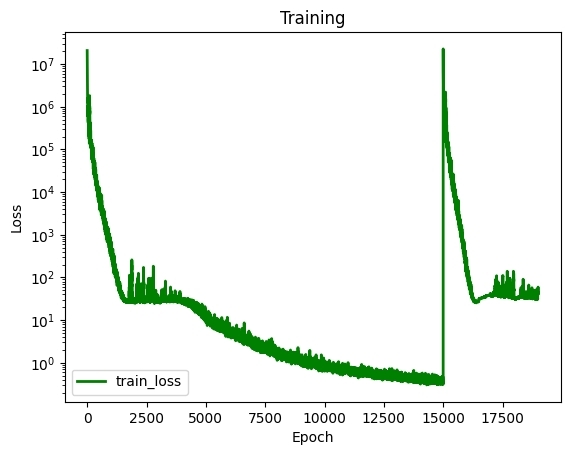

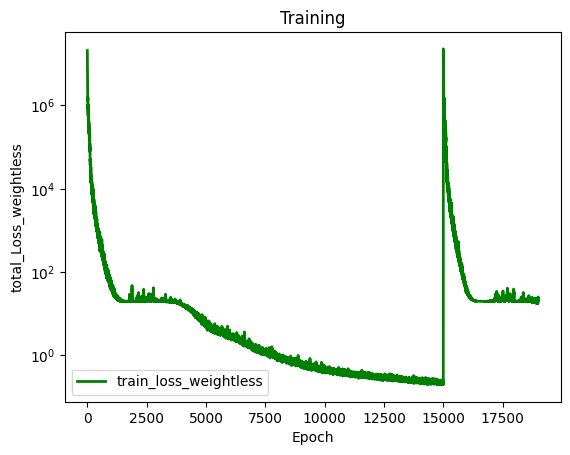

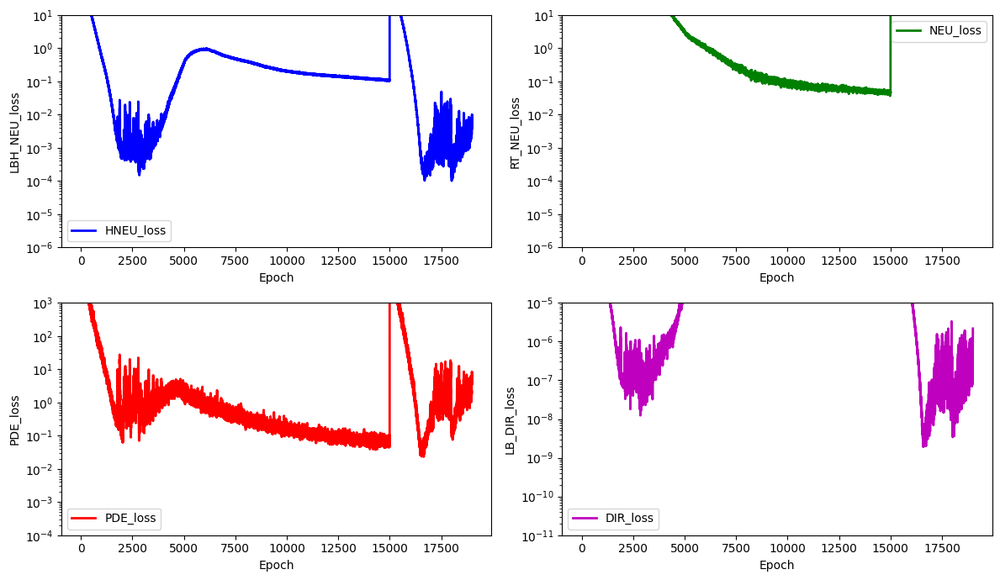

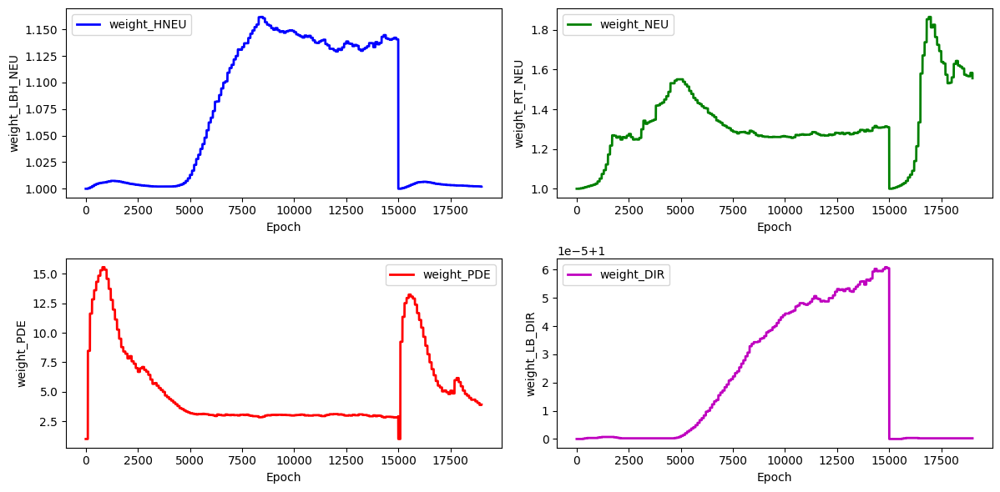

stress_Error for the stress_hole is: 25.397192846240305


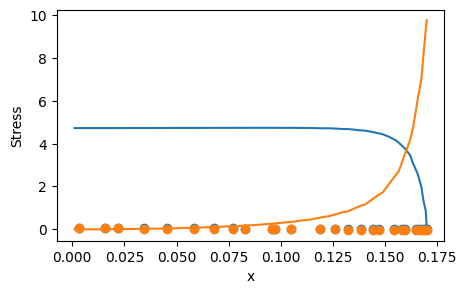

 27%|██▋       | 4100/15000 [3:59:23<1:04:19,  2.82it/s]

for weight 0 norm_grad: 16.43423080444336
for weight 0 new lamda dach: 1.0016001462936401
for weight 0 new lamdaloss norm: 16.460529327392578
for weight 1 norm_grad: 4185.6708984375
for weight 1 new lamda dach: 1.68598210811615
for weight 1 new lamdaloss norm: 7056.966796875
for weight 2 norm_grad: 6085.2841796875
for weight 2 new lamda dach: 2.448150634765625
for weight 2 new lamdaloss norm: 14897.6923828125
for weight 3 norm_grad: 0.0029285030905157328
for weight 3 new lamda dach: 1.000000238418579
for weight 3 new lamdaloss norm: 0.00292850355617702
for weight 0 new weight_value: 1.0020012855529785
for weight 1 new weight_value: 1.569077491760254
for weight 2 new weight_value: 3.7672293186187744
for weight 3 new weight_value: 1.000000238418579


 28%|██▊       | 4200/15000 [3:59:57<1:03:30,  2.83it/s]

for weight 0 norm_grad: 20.7664737701416
for weight 0 new lamda dach: 1.0019508600234985
for weight 0 new lamdaloss norm: 20.80698585510254
for weight 1 norm_grad: 4054.816162109375
for weight 1 new lamda dach: 1.6133426427841187
for weight 1 new lamdaloss norm: 6541.80712890625
for weight 2 norm_grad: 6590.24365234375
for weight 2 new lamda dach: 2.6170051097869873
for weight 2 new lamdaloss norm: 17246.703125
for weight 3 norm_grad: 0.004011079203337431
for weight 3 new lamda dach: 1.0000003576278687
for weight 3 new lamdaloss norm: 0.004011080600321293
for weight 0 new weight_value: 1.0019961595535278
for weight 1 new weight_value: 1.5735039710998535
for weight 2 new weight_value: 3.6522068977355957
for weight 3 new weight_value: 1.000000238418579


 29%|██▊       | 4300/15000 [4:00:32<1:03:04,  2.83it/s]

for weight 0 norm_grad: 18.942604064941406
for weight 0 new lamda dach: 1.001854658126831
for weight 0 new lamdaloss norm: 18.97773551940918
for weight 1 norm_grad: 3935.021484375
for weight 1 new lamda dach: 1.6248639822006226
for weight 1 new lamdaloss norm: 6393.875
for weight 2 norm_grad: 6278.4580078125
for weight 2 new lamda dach: 2.5878875255584717
for weight 2 new lamdaloss norm: 16247.943359375
for weight 3 norm_grad: 0.004817901644855738
for weight 3 new lamda dach: 1.0000004768371582
for weight 3 new lamdaloss norm: 0.004817903973162174
for weight 0 new weight_value: 1.0019819736480713
for weight 1 new weight_value: 1.5786399841308594
for weight 2 new weight_value: 3.5457749366760254
for weight 3 new weight_value: 1.000000238418579


 29%|██▉       | 4400/15000 [4:01:06<1:05:40,  2.69it/s]

for weight 0 norm_grad: 15.59952163696289
for weight 0 new lamda dach: 1.0016216039657593
for weight 0 new lamdaloss norm: 15.624817848205566
for weight 1 norm_grad: 3534.41015625
for weight 1 new lamda dach: 1.579325556755066
for weight 1 new lamdaloss norm: 5581.984375
for weight 2 norm_grad: 6085.2998046875
for weight 2 new lamda dach: 2.7141613960266113
for weight 2 new lamdaloss norm: 16516.486328125
for weight 3 norm_grad: 0.006063584703952074
for weight 3 new lamda dach: 1.0000005960464478
for weight 3 new lamdaloss norm: 0.0060635884292423725
for weight 0 new weight_value: 1.001945972442627
for weight 1 new weight_value: 1.5787084102630615
for weight 2 new weight_value: 3.462613582611084
for weight 3 new weight_value: 1.000000238418579


 30%|██▉       | 4499/15000 [4:01:40<1:00:06,  2.91it/s]

for weight 0 norm_grad: 16.069782257080078
for weight 0 new lamda dach: 1.002121090888977
for weight 0 new lamdaloss norm: 16.10386848449707
for weight 1 norm_grad: 3230.850830078125
for weight 1 new lamda dach: 1.7407478094100952
for weight 1 new lamdaloss norm: 5624.09619140625
for weight 2 norm_grad: 4345.53271484375
for weight 2 new lamda dach: 2.338352918624878
for weight 2 new lamdaloss norm: 10161.388671875
for weight 3 norm_grad: 0.005183059256523848
for weight 3 new lamda dach: 1.0000007152557373
for weight 3 new lamdaloss norm: 0.005183062981814146
for weight 0 new weight_value: 1.001963496208191
for weight 1 new weight_value: 1.5949122905731201
for weight 2 new weight_value: 3.350187301635742
for weight 3 new weight_value: 1.000000238418579
total_loss: 13.343123435974121, hole_loss:  0.004804797004908323,neumann_loss:  10.683441162109375, pde_loss: 2.3407411575317383,dirichlet_loss: 7.031793529677088e-07


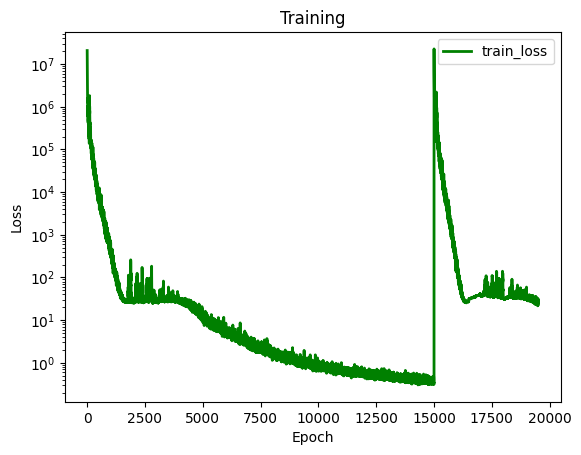

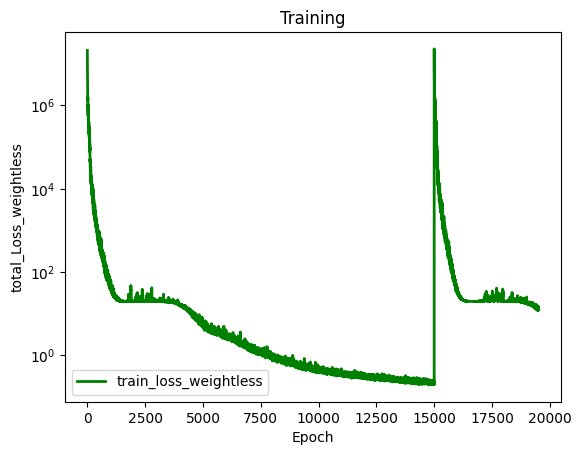

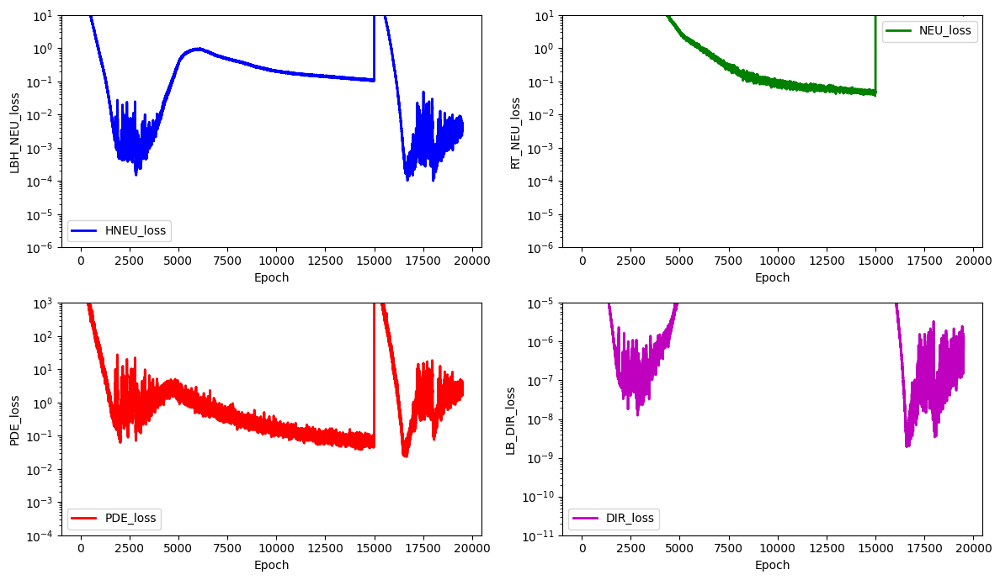

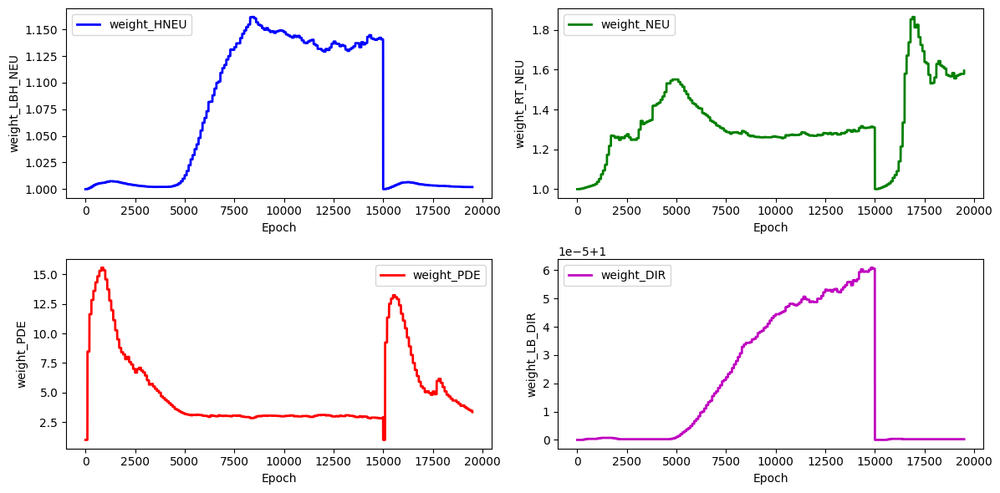

stress_Error for the stress_hole is: 25.73888739473668


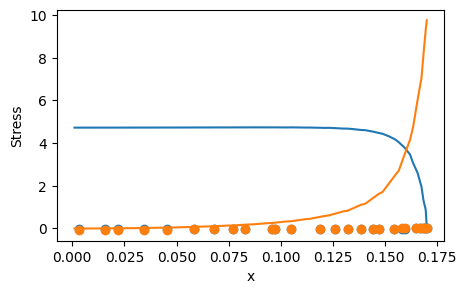

 31%|███       | 4600/15000 [4:02:20<1:02:36,  2.77it/s]

for weight 0 norm_grad: 12.197564125061035
for weight 0 new lamda dach: 1.0016454458236694
for weight 0 new lamdaloss norm: 12.217634201049805
for weight 1 norm_grad: 2891.762451171875
for weight 1 new lamda dach: 1.637858271598816
for weight 1 new lamdaloss norm: 4736.296875
for weight 2 norm_grad: 4521.3447265625
for weight 2 new lamda dach: 2.5569543838500977
for weight 2 new lamdaloss norm: 11560.8720703125
for weight 3 norm_grad: 0.007528125774115324
for weight 3 new lamda dach: 1.0000009536743164
for weight 3 new lamdaloss norm: 0.007528132759034634
for weight 0 new weight_value: 1.0019316673278809
for weight 1 new weight_value: 1.599206805229187
for weight 2 new weight_value: 3.2708637714385986
for weight 3 new weight_value: 1.0000003576278687


 31%|███▏      | 4700/15000 [4:02:56<1:02:54,  2.73it/s]

for weight 0 norm_grad: 18.08274269104004
for weight 0 new lamda dach: 1.0030403137207031
for weight 0 new lamdaloss norm: 18.137720108032227
for weight 1 norm_grad: 2501.935791015625
for weight 1 new lamda dach: 1.7223402261734009
for weight 1 new lamdaloss norm: 4309.1845703125
for weight 2 norm_grad: 3445.567138671875
for weight 2 new lamda dach: 2.367276668548584
for weight 2 new lamdaloss norm: 8156.611328125
for weight 3 norm_grad: 0.00301484577357769
for weight 3 new lamda dach: 1.0000004768371582
for weight 3 new lamdaloss norm: 0.003014847170561552
for weight 0 new weight_value: 1.002042531967163
for weight 1 new weight_value: 1.6115201711654663
for weight 2 new weight_value: 3.1805050373077393
for weight 3 new weight_value: 1.0000003576278687


 32%|███▏      | 4800/15000 [4:03:31<1:00:16,  2.82it/s]

for weight 0 norm_grad: 25.52562713623047
for weight 0 new lamda dach: 1.004318118095398
for weight 0 new lamdaloss norm: 25.635848999023438
for weight 1 norm_grad: 2239.907958984375
for weight 1 new lamda dach: 1.605893611907959
for weight 1 new lamdaloss norm: 3597.0537109375
for weight 2 norm_grad: 3671.3369140625
for weight 2 new lamda dach: 2.6205859184265137
for weight 2 new lamdaloss norm: 9621.0537109375
for weight 3 norm_grad: 0.004484505392611027
for weight 3 new lamda dach: 1.0000007152557373
for weight 3 new lamdaloss norm: 0.004484508186578751
for weight 0 new weight_value: 1.0022701025009155
for weight 1 new weight_value: 1.6109575033187866
for weight 2 new weight_value: 3.1245129108428955
for weight 3 new weight_value: 1.0000003576278687


 33%|███▎      | 4900/15000 [4:04:05<1:00:51,  2.77it/s]

for weight 0 norm_grad: 42.4876708984375
for weight 0 new lamda dach: 1.0069483518600464
for weight 0 new lamdaloss norm: 42.78289031982422
for weight 1 norm_grad: 2129.21337890625
for weight 1 new lamda dach: 1.5285911560058594
for weight 1 new lamdaloss norm: 3254.69677734375
for weight 2 norm_grad: 3985.59033203125
for weight 2 new lamda dach: 2.835228204727173
for weight 2 new lamdaloss norm: 11300.0576171875
for weight 3 norm_grad: 0.012889841571450233
for weight 3 new lamda dach: 1.0000020265579224
for weight 3 new lamdaloss norm: 0.012889868579804897
for weight 0 new weight_value: 1.0027378797531128
for weight 1 new weight_value: 1.602720856666565
for weight 2 new weight_value: 3.0955843925476074
for weight 3 new weight_value: 1.0000004768371582


 33%|███▎      | 4999/15000 [4:04:39<56:50,  2.93it/s]  

for weight 0 norm_grad: 78.2242431640625
for weight 0 new lamda dach: 1.0172057151794434
for weight 0 new lamdaloss norm: 79.57014465332031
for weight 1 norm_grad: 1971.1041259765625
for weight 1 new lamda dach: 1.7428213357925415
for weight 1 new lamdaloss norm: 3435.2822265625
for weight 2 norm_grad: 2575.30859375
for weight 2 new lamda dach: 2.256657361984253
for weight 2 new lamdaloss norm: 5811.58935546875
for weight 3 norm_grad: 0.004314690828323364
for weight 3 new lamda dach: 1.0000009536743164
for weight 3 new lamdaloss norm: 0.004314694553613663
for weight 0 new weight_value: 1.0041847229003906
for weight 1 new weight_value: 1.6167309284210205
for weight 2 new weight_value: 3.0116915702819824
for weight 3 new weight_value: 1.0000004768371582
total_loss: 7.126282215118408, hole_loss:  0.05926196277141571,neumann_loss:  5.232109069824219, pde_loss: 1.72402024269104,dirichlet_loss: 1.0641747394402046e-06


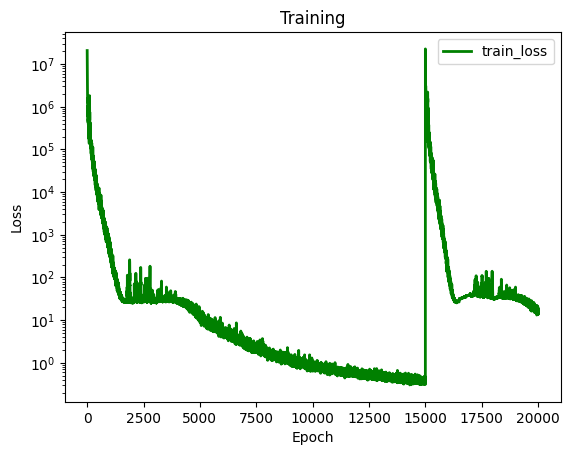

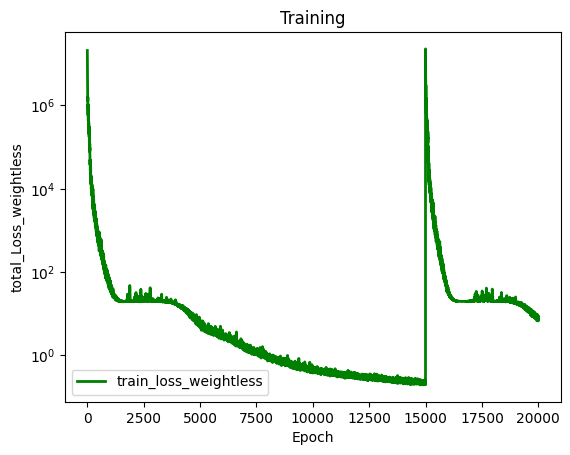

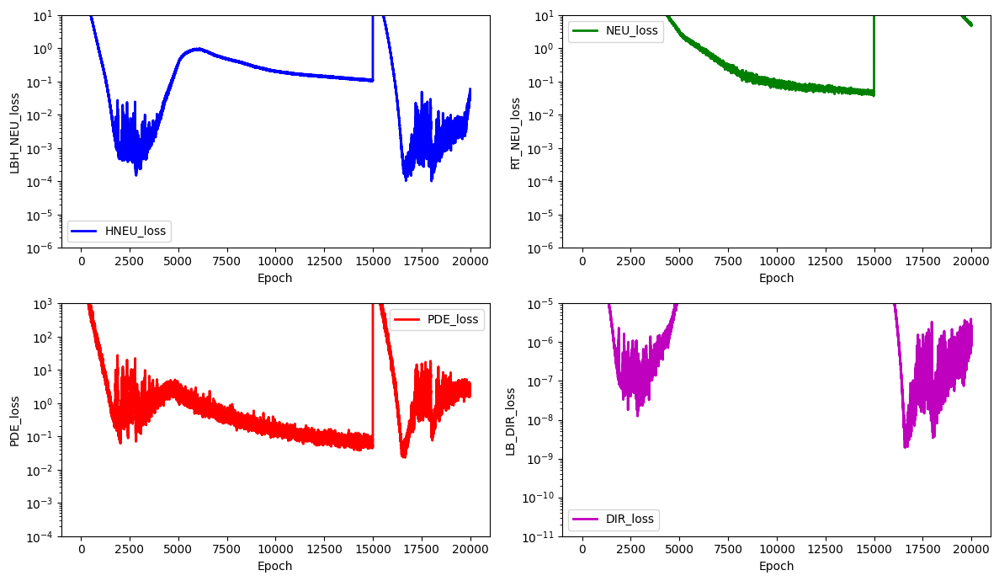

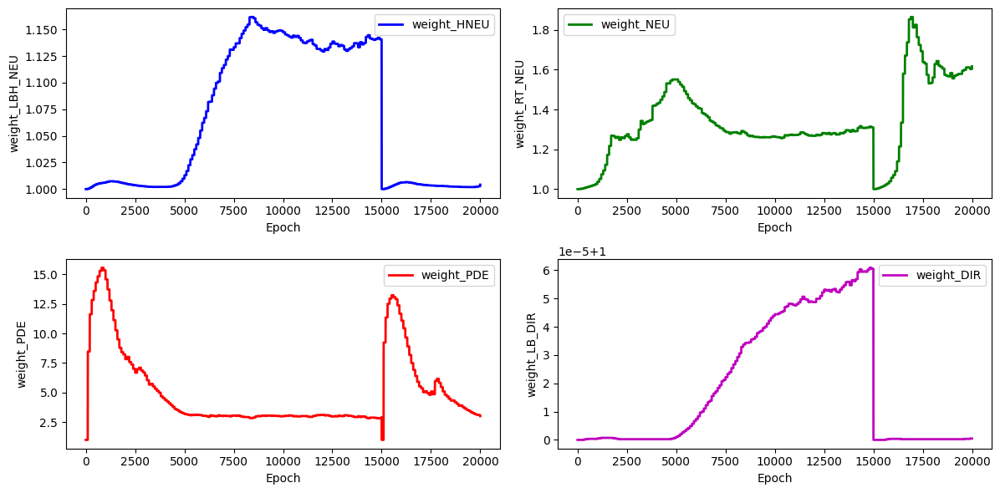

stress_Error for the stress_hole is: 24.396329453051475


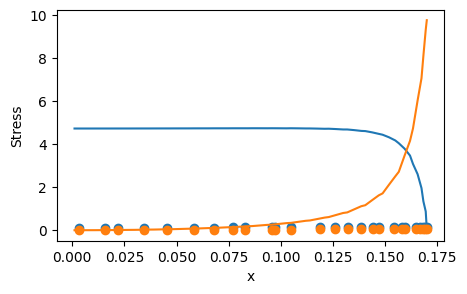

 34%|███▍      | 5100/15000 [4:05:19<1:04:05,  2.57it/s]

for weight 0 norm_grad: 98.46416473388672
for weight 0 new lamda dach: 1.022679328918457
for weight 0 new lamdaloss norm: 100.697265625
for weight 1 norm_grad: 1733.593994140625
for weight 1 new lamda dach: 1.6405373811721802
for weight 1 new lamdaloss norm: 2844.02587890625
for weight 2 norm_grad: 2607.997802734375
for weight 2 new lamda dach: 2.423529624938965
for weight 2 new lamdaloss norm: 6320.56005859375
for weight 3 norm_grad: 0.006581841967999935
for weight 3 new lamda dach: 1.0000014305114746
for weight 3 new lamdaloss norm: 0.006581851746886969
for weight 0 new weight_value: 1.0060341358184814
for weight 1 new weight_value: 1.6191115379333496
for weight 2 new weight_value: 2.9528753757476807
for weight 3 new weight_value: 1.0000004768371582


 35%|███▍      | 5200/15000 [4:05:58<1:03:53,  2.56it/s]

for weight 0 norm_grad: 128.6193084716797
for weight 0 new lamda dach: 1.0350451469421387
for weight 0 new lamdaloss norm: 133.1267852783203
for weight 1 norm_grad: 1646.857666015625
for weight 1 new lamda dach: 1.765316128730774
for weight 1 new lamdaloss norm: 2907.224365234375
for weight 2 norm_grad: 2023.242431640625
for weight 2 new lamda dach: 2.1395459175109863
for weight 2 new lamdaloss norm: 4328.8203125
for weight 3 norm_grad: 0.004430217202752829
for weight 3 new lamda dach: 1.0000011920928955
for weight 3 new lamdaloss norm: 0.004430222325026989
for weight 0 new weight_value: 1.0089352130889893
for weight 1 new weight_value: 1.6337318420410156
for weight 2 new weight_value: 2.871542453765869
for weight 3 new weight_value: 1.0000004768371582


 35%|███▌      | 5300/15000 [4:06:36<1:09:31,  2.33it/s]

for weight 0 norm_grad: 173.2327423095703
for weight 0 new lamda dach: 1.0414512157440186
for weight 0 new lamdaloss norm: 180.41343688964844
for weight 1 norm_grad: 1463.4775390625
for weight 1 new lamda dach: 1.5065773725509644
for weight 1 new lamdaloss norm: 2204.842041015625
for weight 2 norm_grad: 2715.712158203125
for weight 2 new lamda dach: 2.659243583679199
for weight 2 new lamdaloss norm: 7221.73974609375
for weight 3 norm_grad: 0.006863890681415796
for weight 3 new lamda dach: 1.0000015497207642
for weight 3 new lamdaloss norm: 0.006863901391625404
for weight 0 new weight_value: 1.0121867656707764
for weight 1 new weight_value: 1.6210163831710815
for weight 2 new weight_value: 2.8503127098083496
for weight 3 new weight_value: 1.0000005960464478


 36%|███▌      | 5400/15000 [4:07:14<1:02:48,  2.55it/s]

for weight 0 norm_grad: 220.3339385986328
for weight 0 new lamda dach: 1.0644278526306152
for weight 0 new lamdaloss norm: 234.5295867919922
for weight 1 norm_grad: 1282.9656982421875
for weight 1 new lamda dach: 1.5442702770233154
for weight 1 new lamdaloss norm: 1981.24560546875
for weight 2 norm_grad: 2136.87890625
for weight 2 new lamda dach: 2.4214508533477783
for weight 2 new lamdaloss norm: 5174.3466796875
for weight 3 norm_grad: 0.008548781275749207
for weight 3 new lamda dach: 1.000002384185791
for weight 3 new lamdaloss norm: 0.008548801764845848
for weight 0 new weight_value: 1.0174108743667603
for weight 1 new weight_value: 1.6133418083190918
for weight 2 new weight_value: 2.8074264526367188
for weight 3 new weight_value: 1.0000007152557373


 37%|███▋      | 5499/15000 [4:07:53<1:00:11,  2.63it/s]

for weight 0 norm_grad: 247.63406372070312
for weight 0 new lamda dach: 1.0649075508117676
for weight 0 new lamdaloss norm: 263.7073974609375
for weight 1 norm_grad: 1102.3001708984375
for weight 1 new lamda dach: 1.3723341226577759
for weight 1 new lamdaloss norm: 1512.7239990234375
for weight 2 norm_grad: 2712.8701171875
for weight 2 new lamda dach: 3.0096170902252197
for weight 2 new lamdaloss norm: 8164.70068359375
for weight 3 norm_grad: 0.009846962057054043
for weight 3 new lamda dach: 1.000002384185791
for weight 3 new lamdaloss norm: 0.009846987202763557
for weight 0 new weight_value: 1.022160530090332
for weight 1 new weight_value: 1.5892409086227417
for weight 2 new weight_value: 2.8276455402374268
for weight 3 new weight_value: 1.0000008344650269
total_loss: 4.975098609924316, hole_loss:  0.4717441499233246,neumann_loss:  2.2193663120269775, pde_loss: 1.6742322444915771,dirichlet_loss: 5.811411483591655e-06


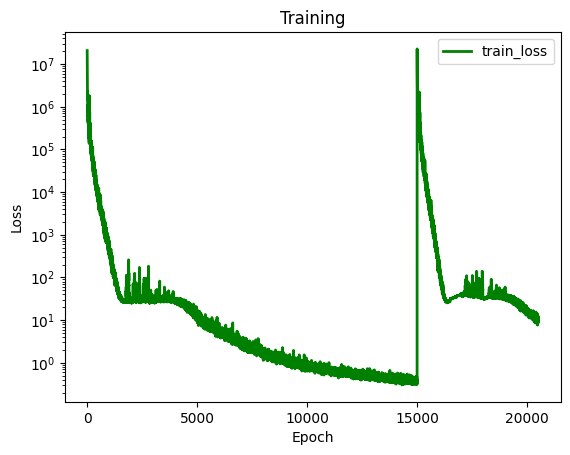

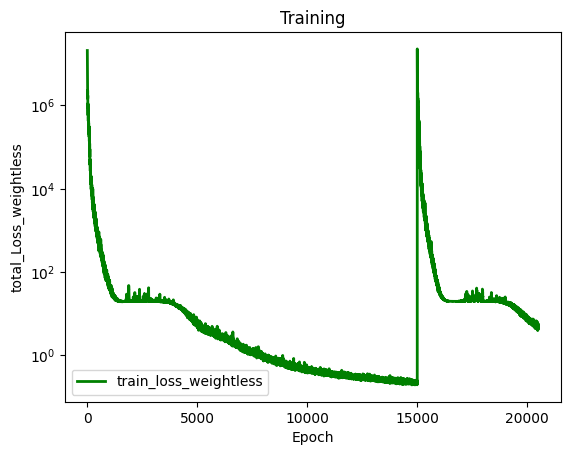

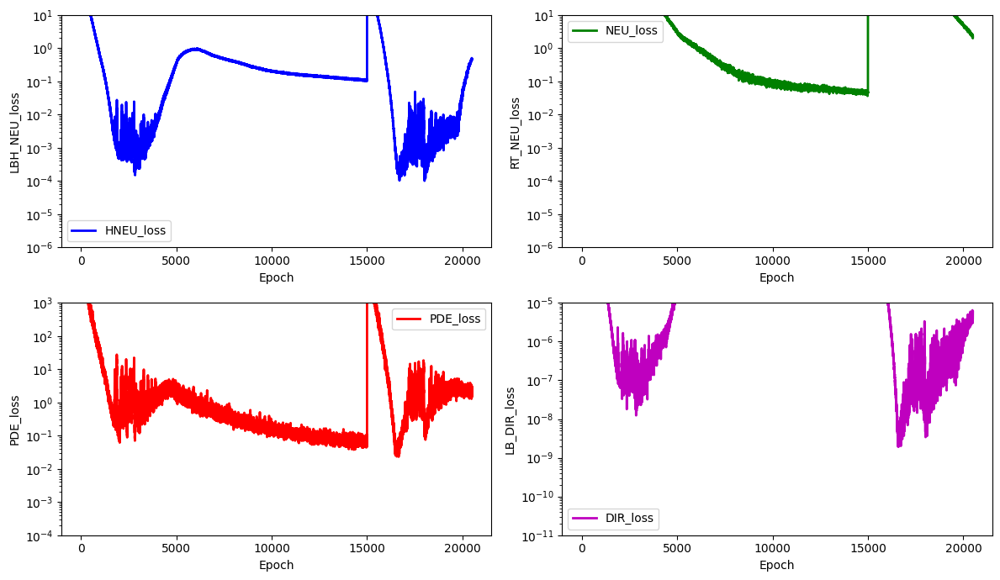

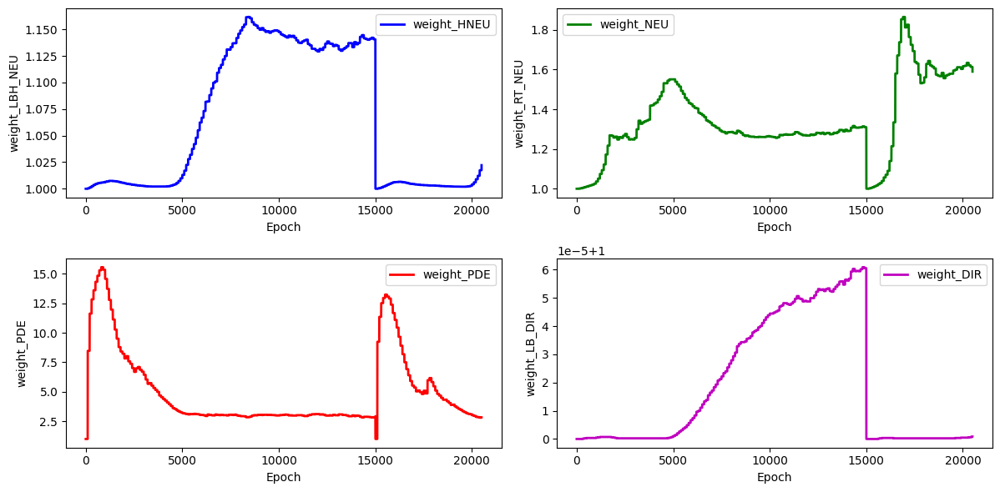

stress_Error for the stress_hole is: 18.816387677480293


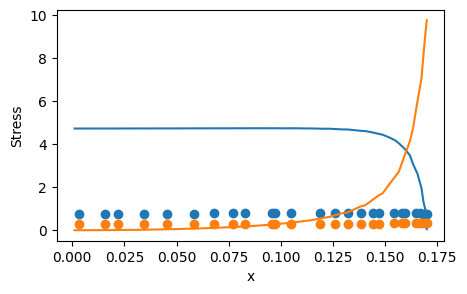

 37%|███▋      | 5600/15000 [4:08:34<1:00:37,  2.58it/s]

for weight 0 norm_grad: 269.2761535644531
for weight 0 new lamda dach: 1.0828030109405518
for weight 0 new lamdaloss norm: 291.5730285644531
for weight 1 norm_grad: 988.5274658203125
for weight 1 new lamda dach: 1.390297293663025
for weight 1 new lamdaloss norm: 1374.34716796875
for weight 2 norm_grad: 2263.46875
for weight 2 new lamda dach: 2.799525499343872
for weight 2 new lamdaloss norm: 6336.638671875
for weight 3 norm_grad: 0.010587142780423164
for weight 3 new lamda dach: 1.0000029802322388
for weight 3 new lamdaloss norm: 0.010587174445390701
for weight 0 new weight_value: 1.0282247066497803
for weight 1 new weight_value: 1.56934654712677
for weight 2 new weight_value: 2.824833393096924
for weight 3 new weight_value: 1.000001072883606


 38%|███▊      | 5700/15000 [4:09:11<58:42,  2.64it/s]  

for weight 0 norm_grad: 302.03326416015625
for weight 0 new lamda dach: 1.1218606233596802
for weight 0 new lamdaloss norm: 338.83917236328125
for weight 1 norm_grad: 832.1273803710938
for weight 1 new lamda dach: 1.4270780086517334
for weight 1 new lamdaloss norm: 1187.5106201171875
for weight 2 norm_grad: 1646.376953125
for weight 2 new lamda dach: 2.451613187789917
for weight 2 new lamdaloss norm: 4036.279296875
for weight 3 norm_grad: 0.009935121983289719
for weight 3 new lamda dach: 1.0000035762786865
for weight 3 new lamdaloss norm: 0.009935157373547554
for weight 0 new weight_value: 1.0375882387161255
for weight 1 new weight_value: 1.5551196336746216
for weight 2 new weight_value: 2.7875113487243652
for weight 3 new weight_value: 1.000001311302185


 39%|███▊      | 5800/15000 [4:09:48<57:49,  2.65it/s]  

for weight 0 norm_grad: 310.9807434082031
for weight 0 new lamda dach: 1.11817467212677
for weight 0 new lamdaloss norm: 347.7308044433594
for weight 1 norm_grad: 852.1434936523438
for weight 1 new lamda dach: 1.407651424407959
for weight 1 new lamdaloss norm: 1199.5208740234375
for weight 2 norm_grad: 1779.3812255859375
for weight 2 new lamda dach: 2.5298147201538086
for weight 2 new lamdaloss norm: 4501.5048828125
for weight 3 norm_grad: 0.011013898998498917
for weight 3 new lamda dach: 1.000003695487976
for weight 3 new lamdaloss norm: 0.011013939045369625
for weight 0 new weight_value: 1.0456467866897583
for weight 1 new weight_value: 1.5403728485107422
for weight 2 new weight_value: 2.7617416381835938
for weight 3 new weight_value: 1.0000015497207642


 39%|███▉      | 5900/15000 [4:10:26<58:21,  2.60it/s]  

for weight 0 norm_grad: 325.7439880371094
for weight 0 new lamda dach: 1.1366549730300903
for weight 0 new lamdaloss norm: 370.258544921875
for weight 1 norm_grad: 750.5795288085938
for weight 1 new lamda dach: 1.383171558380127
for weight 1 new lamdaloss norm: 1038.18017578125
for weight 2 norm_grad: 1633.103759765625
for weight 2 new lamda dach: 2.5172808170318604
for weight 2 new lamdaloss norm: 4110.98095703125
for weight 3 norm_grad: 0.012330885976552963
for weight 3 new lamda dach: 1.0000046491622925
for weight 3 new lamdaloss norm: 0.01233094371855259
for weight 0 new weight_value: 1.0547475814819336
for weight 1 new weight_value: 1.5246526002883911
for weight 2 new weight_value: 2.737295389175415
for weight 3 new weight_value: 1.0000017881393433


 40%|███▉      | 5999/15000 [4:11:05<1:01:01,  2.46it/s]

for weight 0 norm_grad: 329.26214599609375
for weight 0 new lamda dach: 1.1178901195526123
for weight 0 new lamdaloss norm: 368.0788879394531
for weight 1 norm_grad: 694.6409301757812
for weight 1 new lamda dach: 1.286145567893982
for weight 1 new lamdaloss norm: 893.4093017578125
for weight 2 norm_grad: 2098.30126953125
for weight 2 new lamda dach: 3.049286127090454
for weight 2 new lamdaloss norm: 6398.32080078125
for weight 3 norm_grad: 0.01501933578401804
for weight 3 new lamda dach: 1.0000048875808716
for weight 3 new lamdaloss norm: 0.015019409358501434
for weight 0 new weight_value: 1.0610618591308594
for weight 1 new weight_value: 1.5008018016815186
for weight 2 new weight_value: 2.7684943675994873
for weight 3 new weight_value: 1.0000020265579224
total_loss: 3.57561993598938, hole_loss:  0.9749516248703003,neumann_loss:  0.9901366233825684, pde_loss: 1.1888798475265503,dirichlet_loss: 9.814878467295785e-06


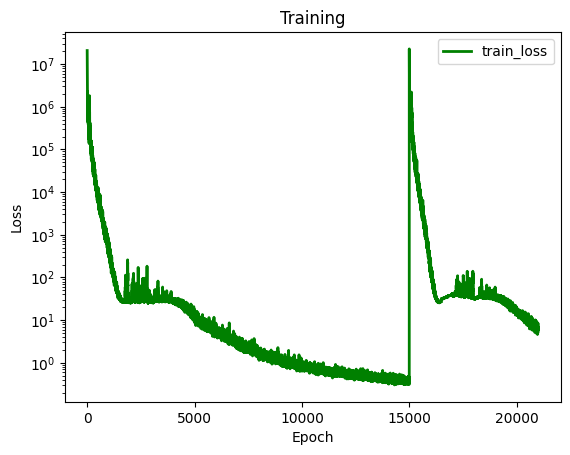

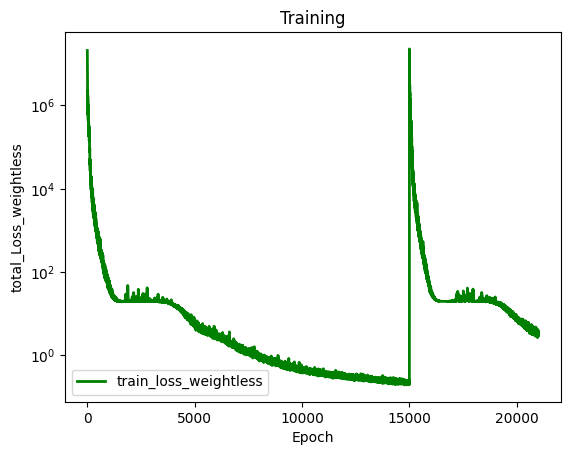

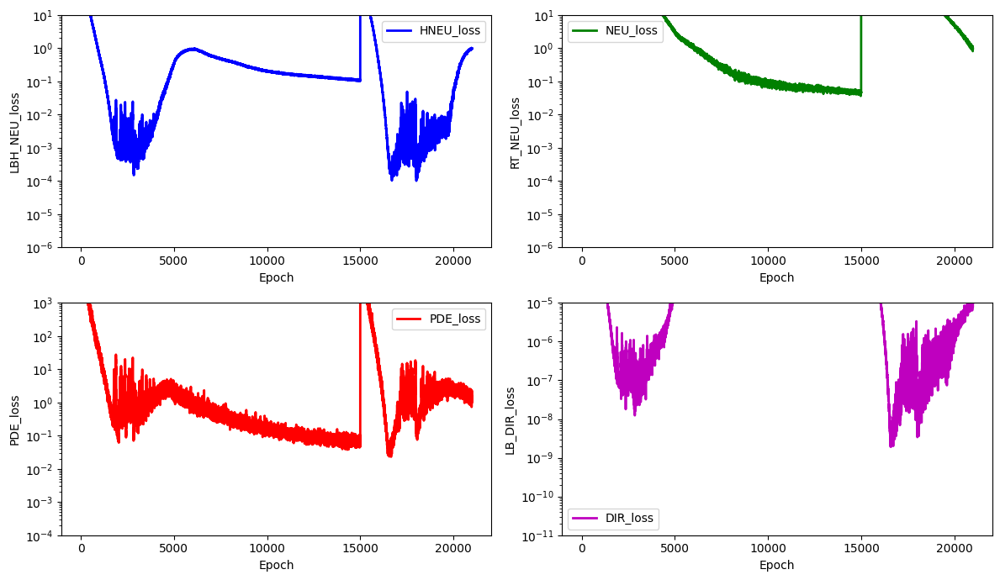

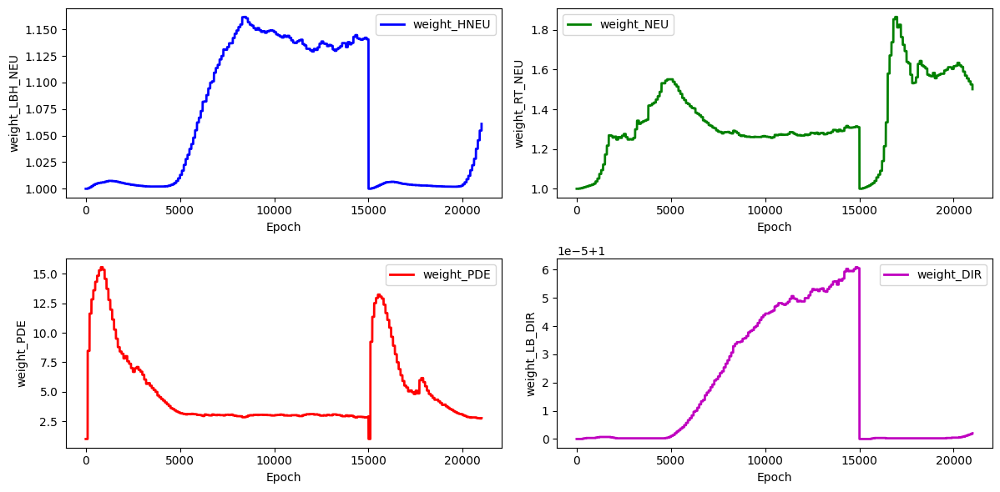

stress_Error for the stress_hole is: 13.61592467160613


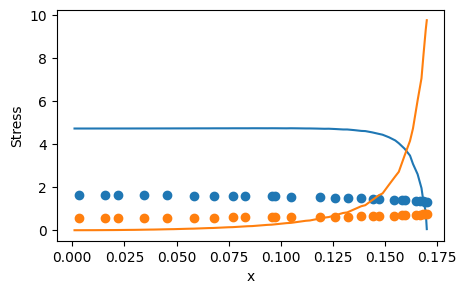

 41%|████      | 6100/15000 [4:11:47<58:24,  2.54it/s]  

for weight 0 norm_grad: 332.9472351074219
for weight 0 new lamda dach: 1.1539208889007568
for weight 0 new lamdaloss norm: 384.19476318359375
for weight 1 norm_grad: 658.8839721679688
for weight 1 new lamda dach: 1.3586409091949463
for weight 1 new lamdaloss norm: 895.186767578125
for weight 2 norm_grad: 1504.2080078125
for weight 2 new lamda dach: 2.516575336456299
for weight 2 new lamdaloss norm: 3785.45263671875
for weight 3 norm_grad: 0.014038778841495514
for weight 3 new lamda dach: 1.0000057220458984
for weight 3 new lamdaloss norm: 0.01403885893523693
for weight 0 new weight_value: 1.070347785949707
for weight 1 new weight_value: 1.4865857362747192
for weight 2 new weight_value: 2.743302345275879
for weight 3 new weight_value: 1.000002384185791


 41%|████▏     | 6200/15000 [4:12:25<1:03:13,  2.32it/s]

for weight 0 norm_grad: 335.7476501464844
for weight 0 new lamda dach: 1.1253137588500977
for weight 0 new lamdaloss norm: 377.82147216796875
for weight 1 norm_grad: 595.5586547851562
for weight 1 new lamda dach: 1.246155023574829
for weight 1 new lamdaloss norm: 742.1585693359375
for weight 2 norm_grad: 2083.68212890625
for weight 2 new lamda dach: 3.2373392581939697
for weight 2 new lamdaloss norm: 6745.58642578125
for weight 3 norm_grad: 0.015351113863289356
for weight 3 new lamda dach: 1.0000051259994507
for weight 3 new lamdaloss norm: 0.015351192094385624
for weight 0 new weight_value: 1.075844407081604
for weight 1 new weight_value: 1.4625426530838013
for weight 2 new weight_value: 2.79270601272583
for weight 3 new weight_value: 1.0000026226043701


 42%|████▏     | 6300/15000 [4:13:04<57:09,  2.54it/s]  

for weight 0 norm_grad: 328.4691467285156
for weight 0 new lamda dach: 1.1388616561889648
for weight 0 new lamdaloss norm: 374.0809631347656
for weight 1 norm_grad: 655.7725830078125
for weight 1 new lamda dach: 1.3217507600784302
for weight 1 new lamdaloss norm: 866.7679443359375
for weight 2 norm_grad: 1709.652587890625
for weight 2 new lamda dach: 2.7369959354400635
for weight 2 new lamdaloss norm: 4679.31201171875
for weight 3 norm_grad: 0.016491074115037918
for weight 3 new lamda dach: 1.0000061988830566
for weight 3 new lamdaloss norm: 0.016491176560521126
for weight 0 new weight_value: 1.0821460485458374
for weight 1 new weight_value: 1.4484634399414062
for weight 2 new weight_value: 2.787134885787964
for weight 3 new weight_value: 1.0000029802322388


 43%|████▎     | 6400/15000 [4:13:42<57:28,  2.49it/s]  

for weight 0 norm_grad: 304.0509948730469
for weight 0 new lamda dach: 1.1338692903518677
for weight 0 new lamdaloss norm: 344.75408935546875
for weight 1 norm_grad: 617.8285522460938
for weight 1 new lamda dach: 1.3156253099441528
for weight 1 new lamdaloss norm: 812.8308715820312
for weight 2 norm_grad: 1653.408447265625
for weight 2 new lamda dach: 2.7934887409210205
for weight 2 new lamdaloss norm: 4618.77783203125
for weight 3 norm_grad: 0.015350195579230785
for weight 3 new lamda dach: 1.0000059604644775
for weight 3 new lamdaloss norm: 0.015350285917520523
for weight 0 new weight_value: 1.0873184204101562
for weight 1 new weight_value: 1.4351797103881836
for weight 2 new weight_value: 2.7877702713012695
for weight 3 new weight_value: 1.0000032186508179


 43%|████▎     | 6499/15000 [4:14:20<53:33,  2.65it/s]  

for weight 0 norm_grad: 323.04400634765625
for weight 0 new lamda dach: 1.1707385778427124
for weight 0 new lamdaloss norm: 378.2000732421875
for weight 1 norm_grad: 564.355224609375
for weight 1 new lamda dach: 1.3418829441070557
for weight 1 new lamdaloss norm: 757.2986450195312
for weight 2 norm_grad: 1327.6663818359375
for weight 2 new lamda dach: 2.4961047172546387
for weight 2 new lamdaloss norm: 3313.994140625
for weight 3 norm_grad: 0.016200857236981392
for weight 3 new lamda dach: 1.0000072717666626
for weight 3 new lamdaloss norm: 0.016200974583625793
for weight 0 new weight_value: 1.0956604480743408
for weight 1 new weight_value: 1.4258500337600708
for weight 2 new weight_value: 2.758603572845459
for weight 3 new weight_value: 1.0000035762786865
total_loss: 2.393968105316162, hole_loss:  0.9645348787307739,neumann_loss:  0.6999030113220215, pde_loss: 0.6189174652099609,dirichlet_loss: 1.1441508831921965e-05


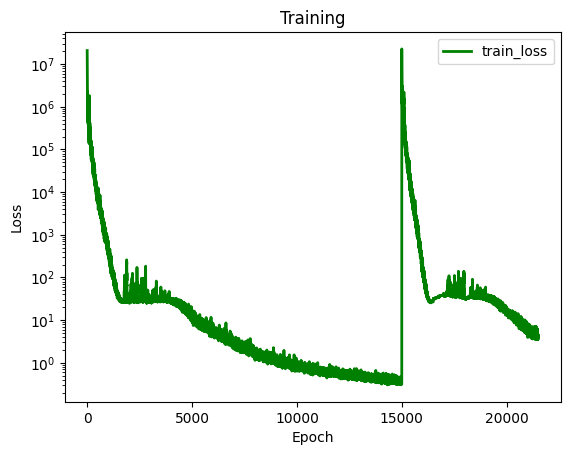

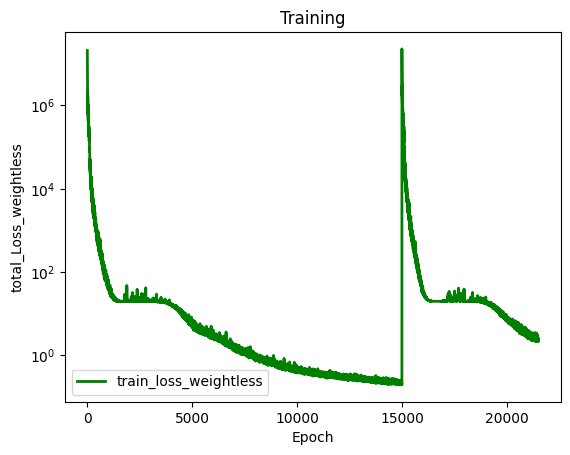

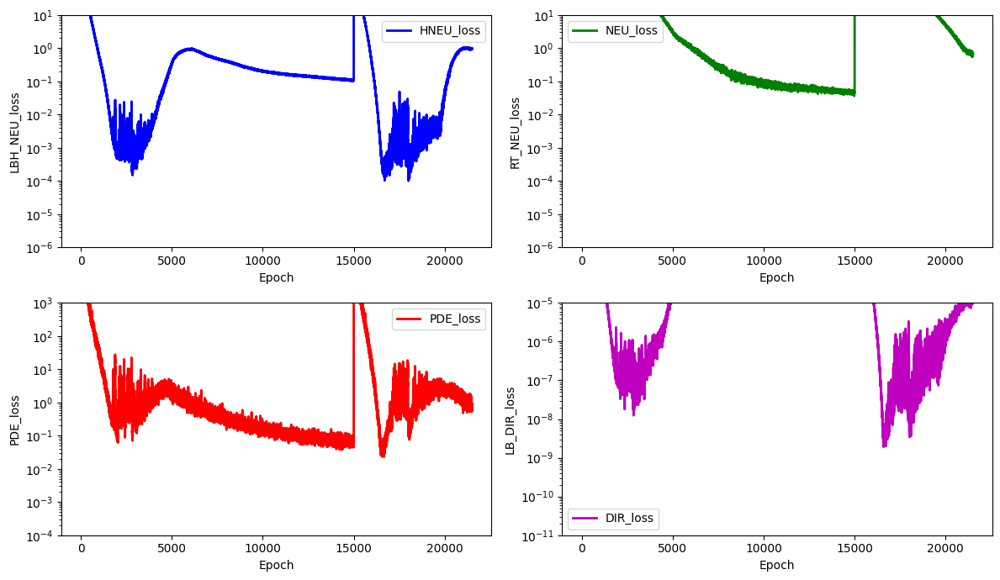

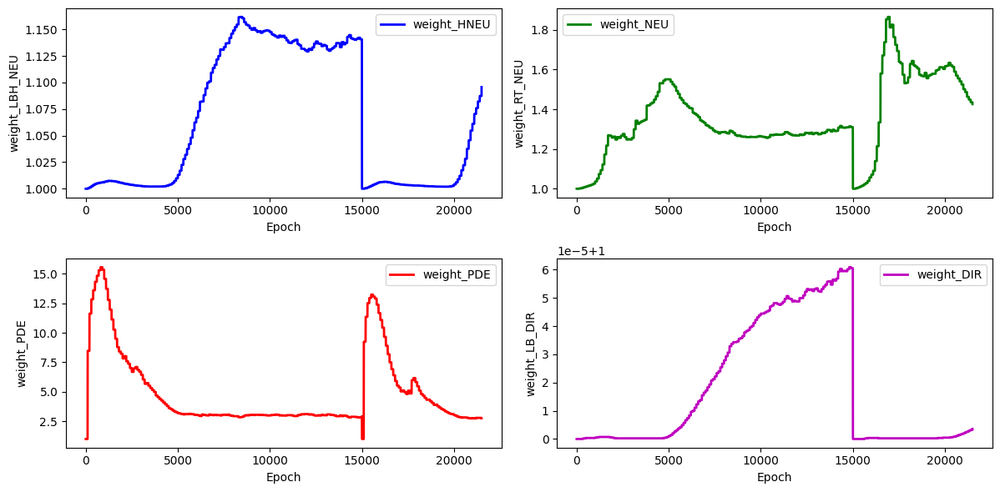

stress_Error for the stress_hole is: 12.699495932406776


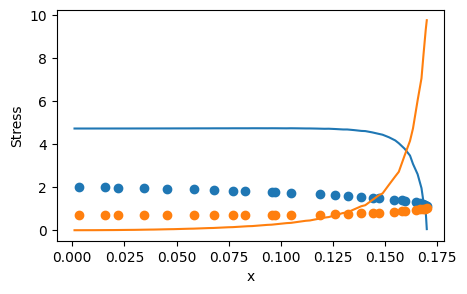

 44%|████▍     | 6600/15000 [4:15:01<53:05,  2.64it/s]  

for weight 0 norm_grad: 313.7064208984375
for weight 0 new lamda dach: 1.1716761589050293
for weight 0 new lamdaloss norm: 367.56231689453125
for weight 1 norm_grad: 435.03826904296875
for weight 1 new lamda dach: 1.2550073862075806
for weight 1 new lamdaloss norm: 545.9762573242188
for weight 2 norm_grad: 1392.2630615234375
for weight 2 new lamda dach: 2.859428882598877
for weight 2 new lamdaloss norm: 3981.077392578125
for weight 3 norm_grad: 0.013747966848313808
for weight 3 new lamda dach: 1.0000064373016357
for weight 3 new lamdaloss norm: 0.013748054392635822
for weight 0 new weight_value: 1.103261947631836
for weight 1 new weight_value: 1.4087657928466797
for weight 2 new weight_value: 2.768686056137085
for weight 3 new weight_value: 1.0000038146972656


 45%|████▍     | 6700/15000 [4:15:39<52:05,  2.66it/s]

for weight 0 norm_grad: 308.3724060058594
for weight 0 new lamda dach: 1.1843268871307373
for weight 0 new lamdaloss norm: 365.2137451171875
for weight 1 norm_grad: 470.8855895996094
for weight 1 new lamda dach: 1.3117516040802002
for weight 1 new lamdaloss norm: 617.6848754882812
for weight 2 norm_grad: 1202.0653076171875
for weight 2 new lamda dach: 2.5425493717193604
for weight 2 new lamdaloss norm: 3056.310302734375
for weight 3 norm_grad: 0.01391989178955555
for weight 3 new lamda dach: 1.0000070333480835
for weight 3 new lamdaloss norm: 0.013919989578425884
for weight 0 new weight_value: 1.1113684177398682
for weight 1 new weight_value: 1.399064302444458
for weight 2 new weight_value: 2.746072292327881
for weight 3 new weight_value: 1.0000041723251343


 45%|████▌     | 6800/15000 [4:16:17<52:08,  2.62it/s]

for weight 0 norm_grad: 300.3114013671875
for weight 0 new lamda dach: 1.1870231628417969
for weight 0 new lamdaloss norm: 356.4766540527344
for weight 1 norm_grad: 498.1712646484375
for weight 1 new lamda dach: 1.3538439273834229
for weight 1 new lamdaloss norm: 674.4461059570312
for weight 2 norm_grad: 1107.5595703125
for weight 2 new lamda dach: 2.387057065963745
for weight 2 new lamdaloss norm: 2643.8076171875
for weight 3 norm_grad: 0.013291072100400925
for weight 3 new lamda dach: 1.0000070333480835
for weight 3 new lamdaloss norm: 0.01329116616398096
for weight 0 new weight_value: 1.1189337968826294
for weight 1 new weight_value: 1.3945423364639282
for weight 2 new weight_value: 2.7101707458496094
for weight 3 new weight_value: 1.0000044107437134


 46%|████▌     | 6900/15000 [4:16:56<52:04,  2.59it/s]

for weight 0 norm_grad: 291.811279296875
for weight 0 new lamda dach: 1.1789313554763794
for weight 0 new lamdaloss norm: 344.02545166015625
for weight 1 norm_grad: 402.4276428222656
for weight 1 new lamda dach: 1.264713168144226
for weight 1 new lamdaloss norm: 508.95550537109375
for weight 2 norm_grad: 1228.414794921875
for weight 2 new lamda dach: 2.7694053649902344
for weight 2 new lamdaloss norm: 3401.978271484375
for weight 3 norm_grad: 0.01398963201791048
for weight 3 new lamda dach: 1.0000072717666626
for weight 3 new lamdaloss norm: 0.013989733532071114
for weight 0 new weight_value: 1.1249334812164307
for weight 1 new weight_value: 1.3815593719482422
for weight 2 new weight_value: 2.7160942554473877
for weight 3 new weight_value: 1.0000046491622925


 47%|████▋     | 6999/15000 [4:17:33<49:44,  2.68it/s]

for weight 0 norm_grad: 284.4257507324219
for weight 0 new lamda dach: 1.1221922636032104
for weight 0 new lamdaloss norm: 319.1803894042969
for weight 1 norm_grad: 502.04803466796875
for weight 1 new lamda dach: 1.2379297018051147
for weight 1 new lamdaloss norm: 621.5001220703125
for weight 2 norm_grad: 1825.628173828125
for weight 2 new lamda dach: 3.3212387561798096
for weight 2 new lamdaloss norm: 6063.34716796875
for weight 3 norm_grad: 0.014913653023540974
for weight 3 new lamda dach: 1.0000057220458984
for weight 3 new lamdaloss norm: 0.014913738705217838
for weight 0 new weight_value: 1.1246592998504639
for weight 1 new weight_value: 1.3671964406967163
for weight 2 new weight_value: 2.776608467102051
for weight 3 new weight_value: 1.000004768371582
total_loss: 1.9848291873931885, hole_loss:  0.808991551399231,neumann_loss:  0.5441234111785889, pde_loss: 0.575448751449585,dirichlet_loss: 1.1437632565503009e-05


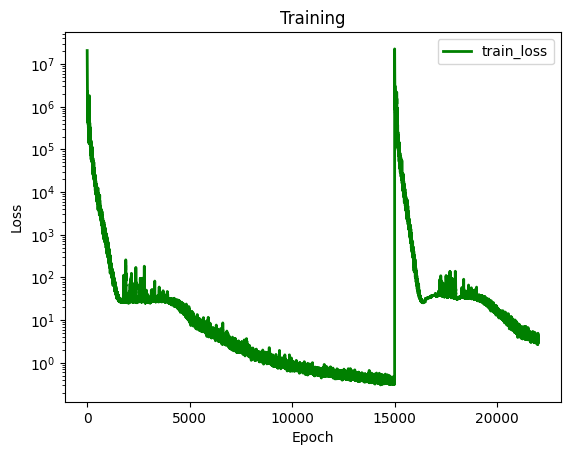

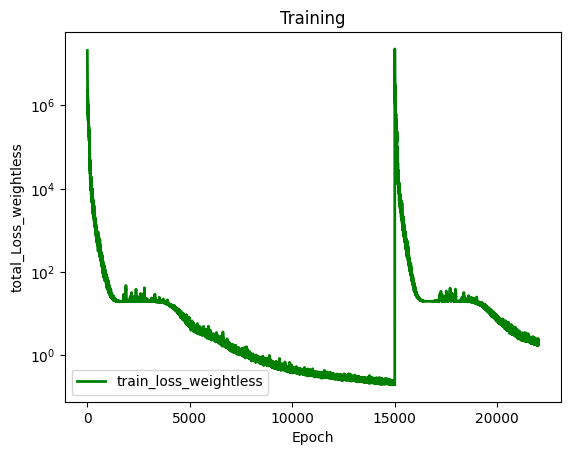

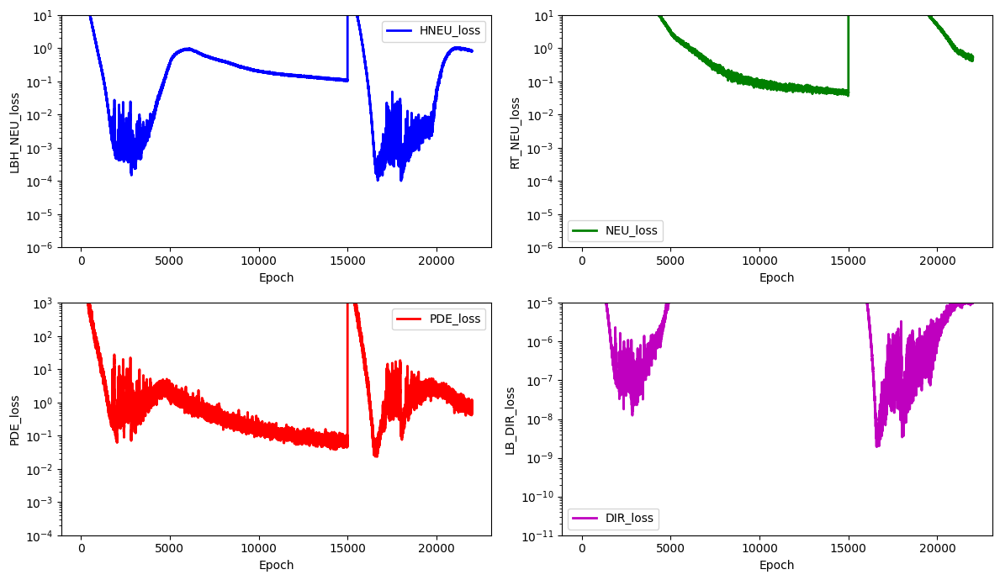

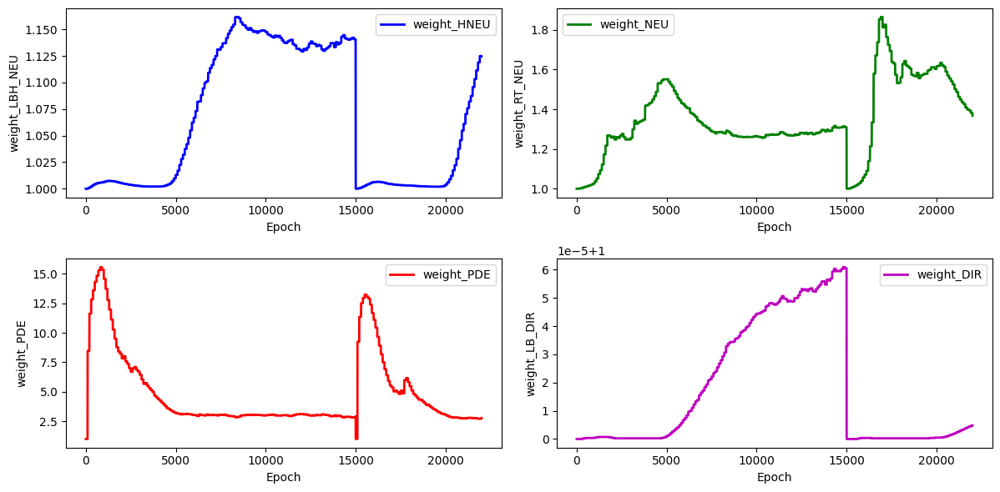

stress_Error for the stress_hole is: 12.511164101364699


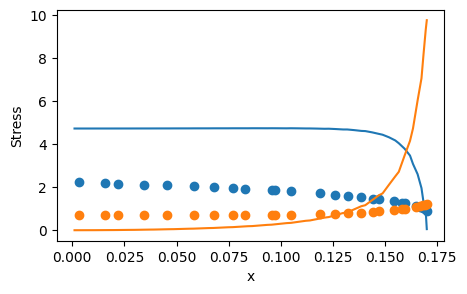

 47%|████▋     | 7100/15000 [4:18:13<47:53,  2.75it/s]  

for weight 0 norm_grad: 295.84161376953125
for weight 0 new lamda dach: 1.186339259147644
for weight 0 new lamdaloss norm: 350.968505859375
for weight 1 norm_grad: 445.3126525878906
for weight 1 new lamda dach: 1.3096363544464111
for weight 1 new lamdaloss norm: 583.1976318359375
for weight 2 norm_grad: 1142.3253173828125
for weight 2 new lamda dach: 2.541252613067627
for weight 2 new lamdaloss norm: 2902.937255859375
for weight 3 norm_grad: 0.01253433432430029
for weight 3 new lamda dach: 1.0000066757202148
for weight 3 new lamdaloss norm: 0.012534418143332005
for weight 0 new weight_value: 1.1308271884918213
for weight 1 new weight_value: 1.3614404201507568
for weight 2 new weight_value: 2.75307297706604
for weight 3 new weight_value: 1.0000048875808716


 48%|████▊     | 7200/15000 [4:18:49<48:00,  2.71it/s]

for weight 0 norm_grad: 289.3695068359375
for weight 0 new lamda dach: 1.1911263465881348
for weight 0 new lamdaloss norm: 344.67559814453125
for weight 1 norm_grad: 391.9134826660156
for weight 1 new lamda dach: 1.2776618003845215
for weight 1 new lamdaloss norm: 500.7328796386719
for weight 2 norm_grad: 1122.0938720703125
for weight 2 new lamda dach: 2.646995782852173
for weight 2 new lamdaloss norm: 2970.177734375
for weight 3 norm_grad: 0.014432020485401154
for weight 3 new lamda dach: 1.0000079870224
for weight 3 new lamdaloss norm: 0.01443213690072298
for weight 0 new weight_value: 1.136857032775879
for weight 1 new weight_value: 1.3530625104904175
for weight 2 new weight_value: 2.742465019226074
for weight 3 new weight_value: 1.0000052452087402


 49%|████▊     | 7300/15000 [4:19:25<50:37,  2.54it/s]

for weight 0 norm_grad: 279.5992431640625
for weight 0 new lamda dach: 1.2086331844329834
for weight 0 new lamdaloss norm: 337.9329528808594
for weight 1 norm_grad: 436.237060546875
for weight 1 new lamda dach: 1.3685961961746216
for weight 1 new lamdaloss norm: 597.0323486328125
for weight 2 norm_grad: 903.8948364257812
for weight 2 new lamda dach: 2.2626843452453613
for weight 2 new lamdaloss norm: 2045.2286376953125
for weight 3 norm_grad: 0.015338958241045475
for weight 3 new lamda dach: 1.000009536743164
for weight 3 new lamdaloss norm: 0.015339105390012264
for weight 0 new weight_value: 1.1440346240997314
for weight 1 new weight_value: 1.3546159267425537
for weight 2 new weight_value: 2.6944870948791504
for weight 3 new weight_value: 1.0000056028366089


 49%|████▉     | 7400/15000 [4:20:02<49:27,  2.56it/s]

for weight 0 norm_grad: 282.182861328125
for weight 0 new lamda dach: 1.2307099103927612
for weight 0 new lamdaloss norm: 347.2852478027344
for weight 1 norm_grad: 401.161865234375
for weight 1 new lamda dach: 1.363329291343689
for weight 1 new lamdaloss norm: 546.915771484375
for weight 2 norm_grad: 821.9277954101562
for weight 2 new lamda dach: 2.2027714252471924
for weight 2 new lamdaloss norm: 1810.51904296875
for weight 3 norm_grad: 0.016932226717472076
for weight 3 new lamda dach: 1.0000113248825073
for weight 3 new lamdaloss norm: 0.016932418569922447
for weight 0 new weight_value: 1.1527020931243896
for weight 1 new weight_value: 1.35548734664917
for weight 2 new weight_value: 2.645315408706665
for weight 3 new weight_value: 1.0000061988830566


 50%|████▉     | 7499/15000 [4:20:39<47:07,  2.65it/s]

for weight 0 norm_grad: 268.6859130859375
for weight 0 new lamda dach: 1.1426966190338135
for weight 0 new lamdaloss norm: 307.0264587402344
for weight 1 norm_grad: 365.9590759277344
for weight 1 new lamda dach: 1.2049450874328613
for weight 1 new lamdaloss norm: 440.9605407714844
for weight 2 norm_grad: 1516.943603515625
for weight 2 new lamda dach: 3.390167713165283
for weight 2 new lamdaloss norm: 5142.6923828125
for weight 3 norm_grad: 0.014938442967832088
for weight 3 new lamda dach: 1.000006914138794
for weight 3 new lamdaloss norm: 0.01493854634463787
for weight 0 new weight_value: 1.1517014503479004
for weight 1 new weight_value: 1.340433120727539
for weight 2 new weight_value: 2.7198004722595215
for weight 3 new weight_value: 1.0000063180923462
total_loss: 1.9717191457748413, hole_loss:  0.7029166221618652,neumann_loss:  0.365949809551239, pde_loss: 0.6987380981445312,dirichlet_loss: 1.315078407060355e-05


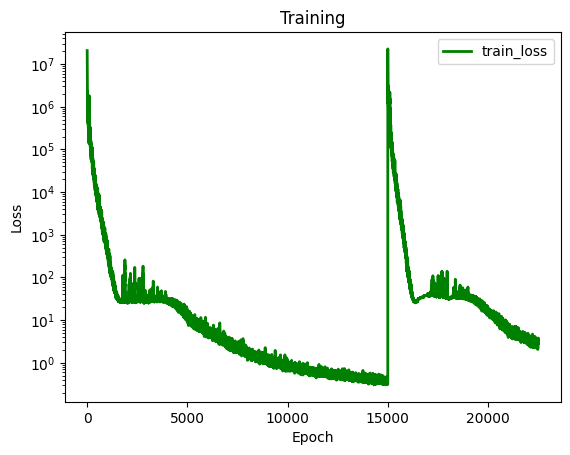

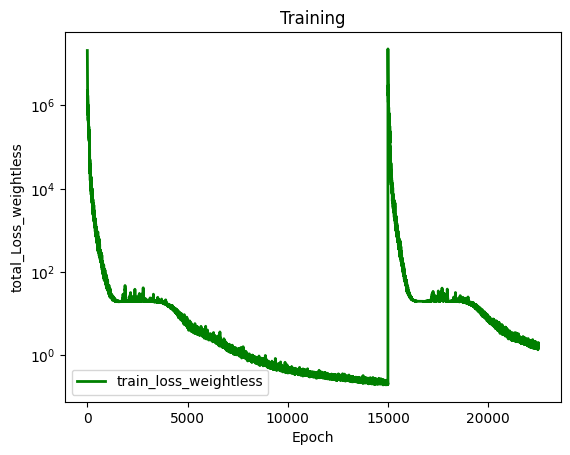

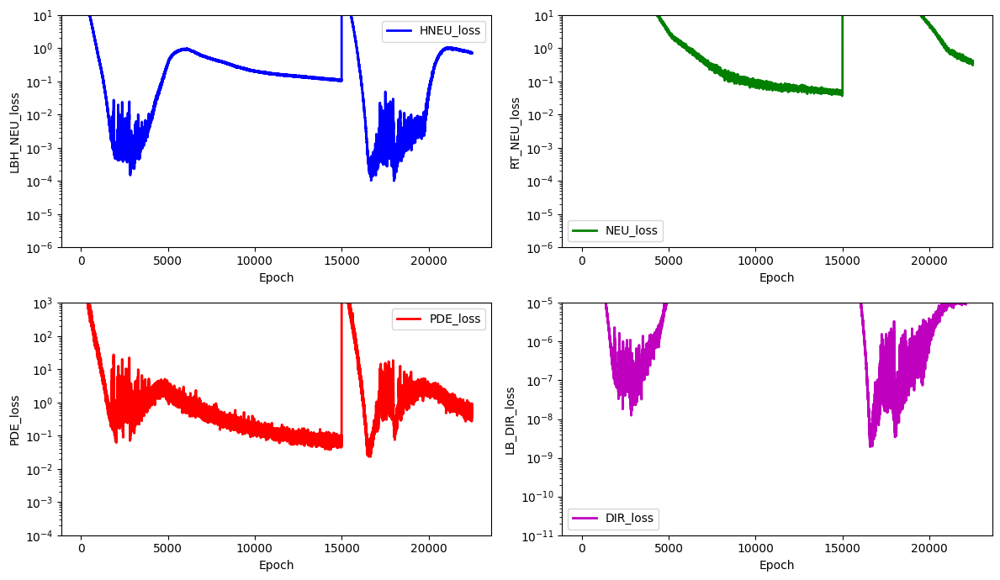

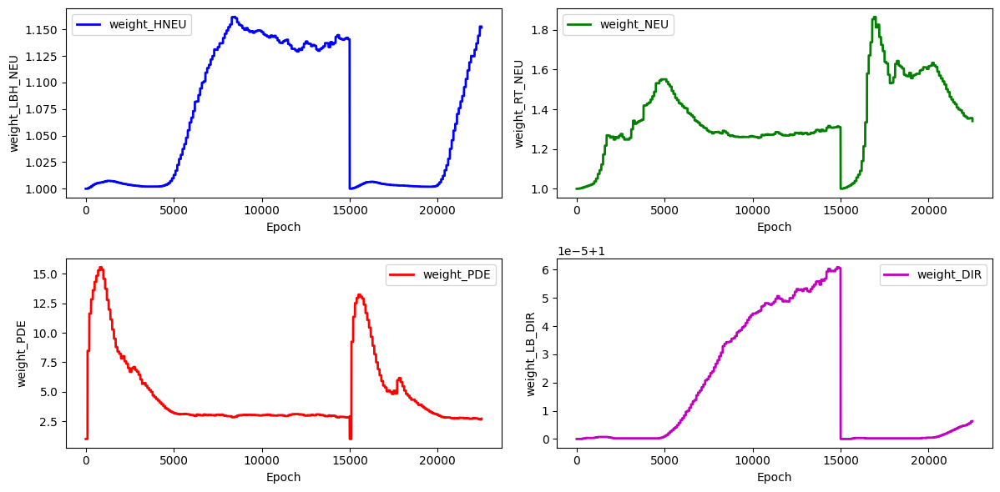

stress_Error for the stress_hole is: 11.969121056659628


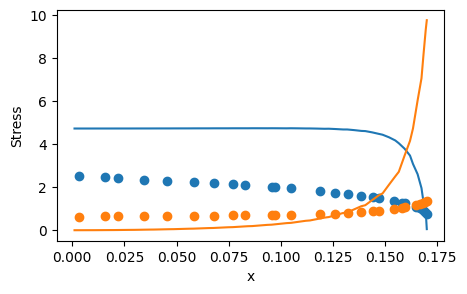

 51%|█████     | 7600/15000 [4:21:21<47:55,  2.57it/s]  

for weight 0 norm_grad: 272.56903076171875
for weight 0 new lamda dach: 1.1619946956634521
for weight 0 new lamdaloss norm: 316.7237548828125
for weight 1 norm_grad: 362.5111083984375
for weight 1 new lamda dach: 1.227616786956787
for weight 1 new lamdaloss norm: 445.0247497558594
for weight 2 norm_grad: 1320.0538330078125
for weight 2 new lamda dach: 3.078514814376831
for weight 2 new lamdaloss norm: 4063.80517578125
for weight 3 norm_grad: 0.014529502019286156
for weight 3 new lamda dach: 1.0000073909759521
for weight 3 new lamdaloss norm: 0.014529610052704811
for weight 0 new weight_value: 1.1527308225631714
for weight 1 new weight_value: 1.3291515111923218
for weight 2 new weight_value: 2.755671977996826
for weight 3 new weight_value: 1.0000064373016357


 51%|█████▏    | 7700/15000 [4:22:00<47:45,  2.55it/s]

for weight 0 norm_grad: 271.81268310546875
for weight 0 new lamda dach: 1.20827317237854
for weight 0 new lamdaloss norm: 328.42401123046875
for weight 1 norm_grad: 331.26416015625
for weight 1 new lamda dach: 1.265941858291626
for weight 1 new lamdaloss norm: 419.3611755371094
for weight 2 norm_grad: 973.798095703125
for weight 2 new lamda dach: 2.614675521850586
for weight 2 new lamdaloss norm: 2546.166015625
for weight 3 norm_grad: 0.015241608954966068
for weight 3 new lamda dach: 1.0000096559524536
for weight 3 new lamdaloss norm: 0.015241756103932858
for weight 0 new weight_value: 1.1582850217819214
for weight 1 new weight_value: 1.3228305578231812
for weight 2 new weight_value: 2.741572141647339
for weight 3 new weight_value: 1.0000066757202148


 52%|█████▏    | 7800/15000 [4:22:39<48:06,  2.49it/s]

for weight 0 norm_grad: 274.68792724609375
for weight 0 new lamda dach: 1.2007075548171997
for weight 0 new lamdaloss norm: 329.8198547363281
for weight 1 norm_grad: 384.8947448730469
for weight 1 new lamda dach: 1.3058626651763916
for weight 1 new lamdaloss norm: 502.61968994140625
for weight 2 norm_grad: 983.6884765625
for weight 2 new lamda dach: 2.491347074508667
for weight 2 new lamdaloss norm: 2450.70947265625
for weight 3 norm_grad: 0.014680094085633755
for weight 3 new lamda dach: 1.0000089406967163
for weight 3 new lamdaloss norm: 0.014680225402116776
for weight 0 new weight_value: 1.162527322769165
for weight 1 new weight_value: 1.3211337327957153
for weight 2 new weight_value: 2.7165496349334717
for weight 3 new weight_value: 1.000006914138794


 53%|█████▎    | 7900/15000 [4:23:19<49:07,  2.41it/s]

for weight 0 norm_grad: 263.54815673828125
for weight 0 new lamda dach: 1.2056101560592651
for weight 0 new lamdaloss norm: 317.736328125
for weight 1 norm_grad: 317.6055603027344
for weight 1 new lamda dach: 1.258693814277649
for weight 1 new lamdaloss norm: 399.7681884765625
for weight 2 norm_grad: 964.1640625
for weight 2 new lamda dach: 2.6590068340301514
for weight 2 new lamdaloss norm: 2563.718994140625
for weight 3 norm_grad: 0.015701618045568466
for weight 3 new lamda dach: 1.0000101327896118
for weight 3 new lamdaloss norm: 0.0157017782330513
for weight 0 new weight_value: 1.1668355464935303
for weight 1 new weight_value: 1.314889669418335
for weight 2 new weight_value: 2.7107951641082764
for weight 3 new weight_value: 1.000007152557373


 53%|█████▎    | 7999/15000 [4:23:57<44:18,  2.63it/s]

for weight 0 norm_grad: 268.89288330078125
for weight 0 new lamda dach: 1.1881844997406006
for weight 0 new lamdaloss norm: 319.49432373046875
for weight 1 norm_grad: 306.1785583496094
for weight 1 new lamda dach: 1.220020055770874
for weight 1 new lamdaloss norm: 373.54400634765625
for weight 2 norm_grad: 1122.686279296875
for weight 2 new lamda dach: 2.952204942703247
for weight 2 new lamdaloss norm: 3314.400146484375
for weight 3 norm_grad: 0.014933797530829906
for weight 3 new lamda dach: 1.0000088214874268
for weight 3 new lamdaloss norm: 0.014933929778635502
for weight 0 new weight_value: 1.1689703464508057
for weight 1 new weight_value: 1.3054026365280151
for weight 2 new weight_value: 2.734936237335205
for weight 3 new weight_value: 1.0000072717666626
total_loss: 1.3950589895248413, hole_loss:  0.5875434875488281,neumann_loss:  0.3116268515586853, pde_loss: 0.49597176909446716,dirichlet_loss: 1.3789093827654142e-05


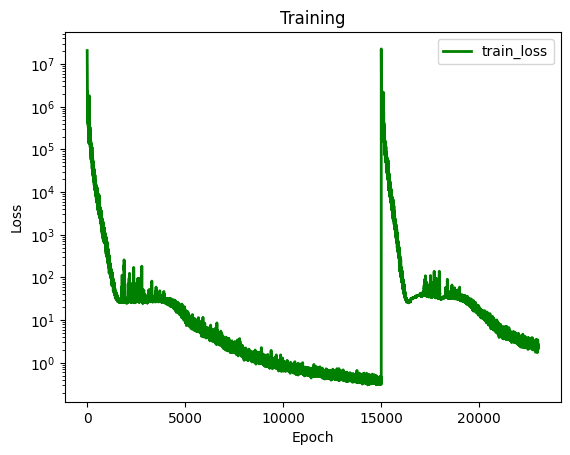

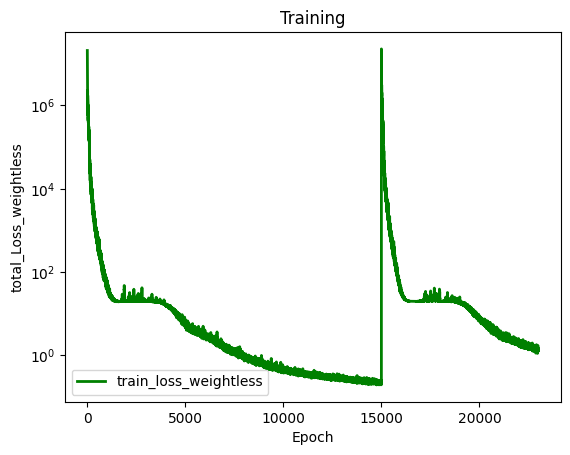

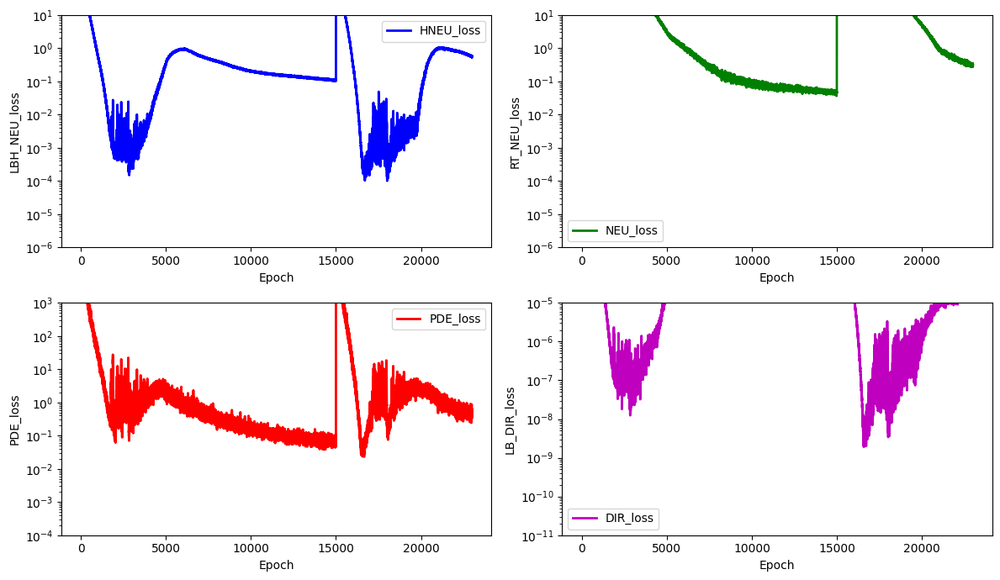

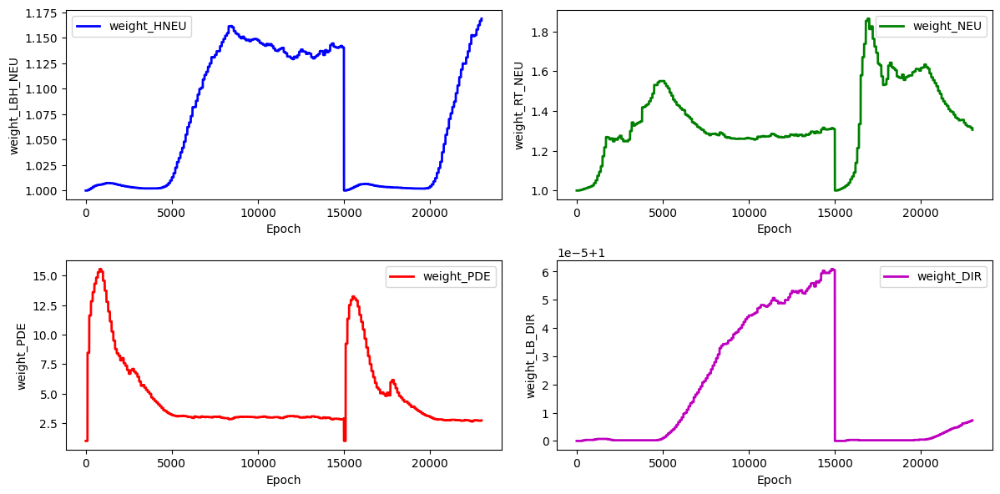

stress_Error for the stress_hole is: 11.325270426094596


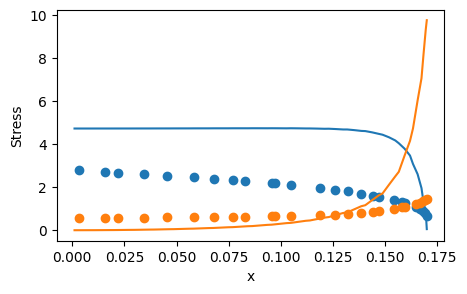

 54%|█████▍    | 8100/15000 [4:24:37<43:45,  2.63it/s]  

for weight 0 norm_grad: 250.15464782714844
for weight 0 new lamda dach: 1.2329630851745605
for weight 0 new lamdaloss norm: 308.43145751953125
for weight 1 norm_grad: 309.1763916015625
for weight 1 new lamda dach: 1.3046752214431763
for weight 1 new lamdaloss norm: 403.3747863769531
for weight 2 norm_grad: 764.6018676757812
for weight 2 new lamda dach: 2.3669514656066895
for weight 2 new lamdaloss norm: 1809.775390625
for weight 3 norm_grad: 0.017175836488604546
for weight 3 new lamda dach: 1.000012993812561
for weight 3 new lamdaloss norm: 0.017176060006022453
for weight 0 new weight_value: 1.1753695011138916
for weight 1 new weight_value: 1.3053299188613892
for weight 2 new weight_value: 2.6981375217437744
for weight 3 new weight_value: 1.0000078678131104


 55%|█████▍    | 8200/15000 [4:25:15<42:34,  2.66it/s]

for weight 0 norm_grad: 256.01702880859375
for weight 0 new lamda dach: 1.3099513053894043
for weight 0 new lamdaloss norm: 335.3698425292969
for weight 1 norm_grad: 256.4215393066406
for weight 1 new lamda dach: 1.3105930089950562
for weight 1 new lamdaloss norm: 336.0642395019531
for weight 2 norm_grad: 569.5535278320312
for weight 2 new lamda dach: 2.111422061920166
for weight 2 new lamdaloss norm: 1202.56787109375
for weight 3 norm_grad: 0.016075244173407555
for weight 3 new lamda dach: 1.0000149011611938
for weight 3 new lamdaloss norm: 0.016075482591986656
for weight 0 new weight_value: 1.188827633857727
for weight 1 new weight_value: 1.3058562278747559
for weight 2 new weight_value: 2.6394660472869873
for weight 3 new weight_value: 1.0000085830688477


 55%|█████▌    | 8300/15000 [4:25:52<41:59,  2.66it/s]

for weight 0 norm_grad: 242.6874237060547
for weight 0 new lamda dach: 1.2164499759674072
for weight 0 new lamdaloss norm: 295.2171325683594
for weight 1 norm_grad: 287.7376403808594
for weight 1 new lamda dach: 1.2673728466033936
for weight 1 new lamdaloss norm: 364.6708984375
for weight 2 norm_grad: 833.4620361328125
for weight 2 new lamda dach: 2.571259021759033
for weight 2 new lamdaloss norm: 2143.046875
for weight 3 norm_grad: 0.017133666202425957
for weight 3 new lamda dach: 1.0000125169754028
for weight 3 new lamdaloss norm: 0.01713387854397297
for weight 0 new weight_value: 1.1915898323059082
for weight 1 new weight_value: 1.302007794380188
for weight 2 new weight_value: 2.6326451301574707
for weight 3 new weight_value: 1.0000089406967163


 56%|█████▌    | 8400/15000 [4:26:29<43:43,  2.52it/s]

for weight 0 norm_grad: 243.51144409179688
for weight 0 new lamda dach: 1.2137123346328735
for weight 0 new lamdaloss norm: 295.5528564453125
for weight 1 norm_grad: 262.34722900390625
for weight 1 new lamda dach: 1.234113097190857
for weight 1 new lamdaloss norm: 323.76611328125
for weight 2 norm_grad: 877.0726318359375
for weight 2 new lamda dach: 2.7337746620178223
for weight 2 new lamdaloss norm: 2397.71875
for weight 3 norm_grad: 0.016002777963876724
for weight 3 new lamda dach: 1.0000115633010864
for weight 3 new lamdaloss norm: 0.016002964228391647
for weight 0 new weight_value: 1.1938021183013916
for weight 1 new weight_value: 1.2952182292938232
for weight 2 new weight_value: 2.6427578926086426
for weight 3 new weight_value: 1.0000091791152954


 57%|█████▋    | 8499/15000 [4:27:06<38:58,  2.78it/s]

for weight 0 norm_grad: 226.6715850830078
for weight 0 new lamda dach: 1.1706613302230835
for weight 0 new lamdaloss norm: 265.35565185546875
for weight 1 norm_grad: 249.771484375
for weight 1 new lamda dach: 1.191381812095642
for weight 1 new lamdaloss norm: 297.5732116699219
for weight 2 norm_grad: 1078.4078369140625
for weight 2 new lamda dach: 3.263380289077759
for weight 2 new lamdaloss norm: 3519.2548828125
for weight 3 norm_grad: 0.0159680787473917
for weight 3 new lamda dach: 1.0000102519989014
for weight 3 new lamdaloss norm: 0.015968242660164833
for weight 0 new weight_value: 1.1914880275726318
for weight 1 new weight_value: 1.284834623336792
for weight 2 new weight_value: 2.704820156097412
for weight 3 new weight_value: 1.000009298324585
total_loss: 0.9002982378005981, hole_loss:  0.38761234283447266,neumann_loss:  0.2224285900592804, pde_loss: 0.268610417842865,dirichlet_loss: 1.4227491192286834e-05


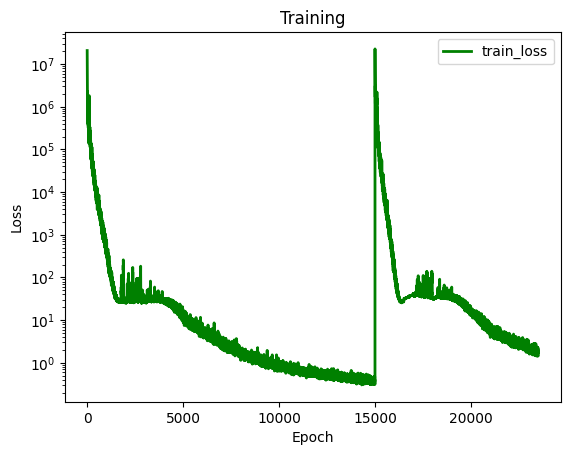

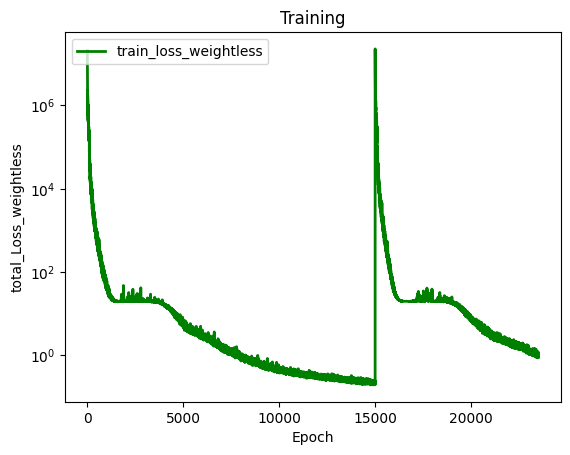

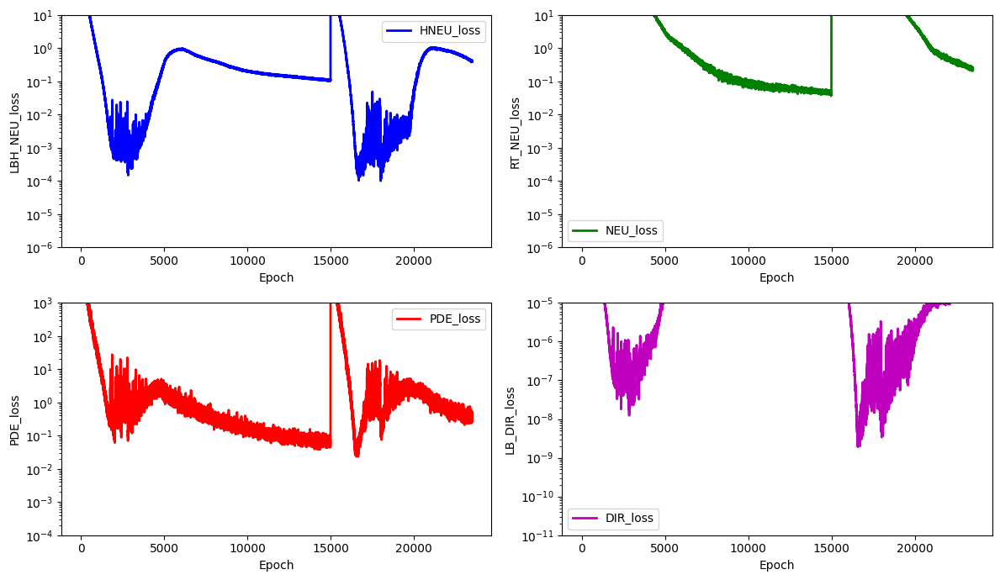

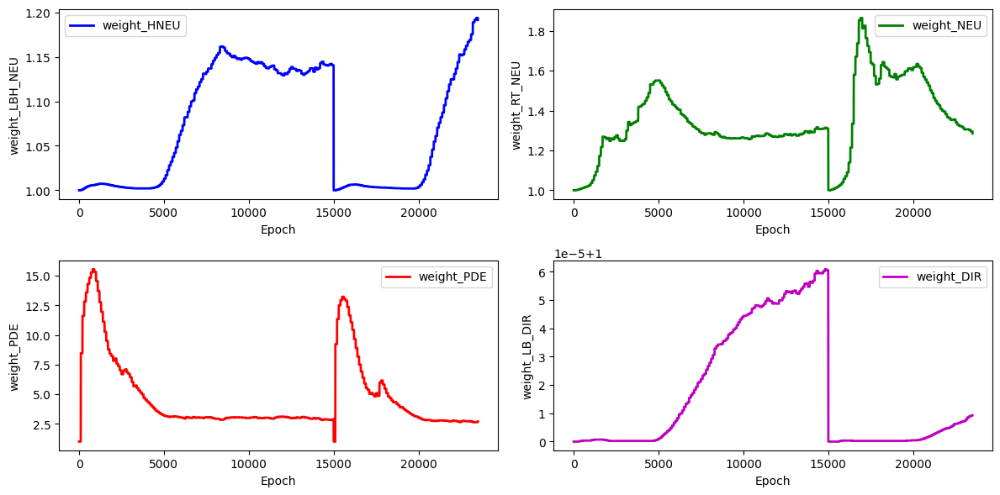

stress_Error for the stress_hole is: 10.668127140545803


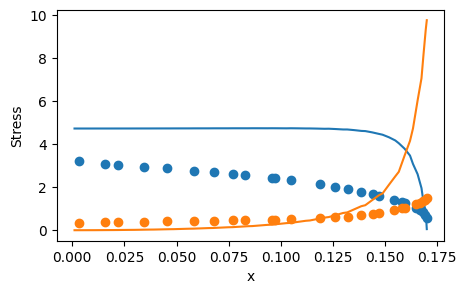

 57%|█████▋    | 8600/15000 [4:27:49<42:33,  2.51it/s]  

for weight 0 norm_grad: 231.00030517578125
for weight 0 new lamda dach: 1.2609959840774536
for weight 0 new lamdaloss norm: 291.29046630859375
for weight 1 norm_grad: 256.53741455078125
for weight 1 new lamda dach: 1.298460602760315
for weight 1 new lamdaloss norm: 333.1037292480469
for weight 2 norm_grad: 628.5179443359375
for weight 2 new lamda dach: 2.289123058319092
for weight 2 new lamdaloss norm: 1438.7548828125
for weight 3 norm_grad: 0.017009301111102104
for weight 3 new lamda dach: 1.0000152587890625
for weight 3 new lamdaloss norm: 0.017009560018777847
for weight 0 new weight_value: 1.1984387636184692
for weight 1 new weight_value: 1.2861971855163574
for weight 2 new weight_value: 2.66325044631958
for weight 3 new weight_value: 1.0000098943710327


 58%|█████▊    | 8700/15000 [4:28:28<40:59,  2.56it/s]

for weight 0 norm_grad: 222.9303436279297
for weight 0 new lamda dach: 1.2987699508666992
for weight 0 new lamdaloss norm: 289.5352478027344
for weight 1 norm_grad: 230.92007446289062
for weight 1 new lamda dach: 1.3128273487091064
for weight 1 new lamdaloss norm: 303.158203125
for weight 2 norm_grad: 515.2235107421875
for weight 2 new lamda dach: 2.1351847648620605
for weight 2 new lamdaloss norm: 1100.097412109375
for weight 3 norm_grad: 0.017150478437542915
for weight 3 new lamda dach: 1.0000176429748535
for weight 3 new lamdaloss norm: 0.01715078018605709
for weight 0 new weight_value: 1.2084717750549316
for weight 1 new weight_value: 1.2888600826263428
for weight 2 new weight_value: 2.6104438304901123
for weight 3 new weight_value: 1.00001060962677


 59%|█████▊    | 8800/15000 [4:29:07<42:19,  2.44it/s]

for weight 0 norm_grad: 212.2452850341797
for weight 0 new lamda dach: 1.1669187545776367
for weight 0 new lamdaloss norm: 247.67300415039062
for weight 1 norm_grad: 215.5095977783203
for weight 1 new lamda dach: 1.1699222326278687
for weight 1 new lamdaloss norm: 252.12948608398438
for weight 2 norm_grad: 1056.022216796875
for weight 2 new lamda dach: 3.468661069869995
for weight 2 new lamdaloss norm: 3662.983154296875
for weight 3 norm_grad: 0.01635384000837803
for weight 3 new lamda dach: 1.0000109672546387
for weight 3 new lamdaloss norm: 0.016354018822312355
for weight 0 new weight_value: 1.2043163776397705
for weight 1 new weight_value: 1.2769663333892822
for weight 2 new weight_value: 2.696265459060669
for weight 3 new weight_value: 1.00001060962677


 59%|█████▉    | 8900/15000 [4:29:47<41:05,  2.47it/s]

for weight 0 norm_grad: 202.3583526611328
for weight 0 new lamda dach: 1.206045389175415
for weight 0 new lamdaloss norm: 244.05335998535156
for weight 1 norm_grad: 219.77915954589844
for weight 1 new lamda dach: 1.2278248071670532
for weight 1 new lamdaloss norm: 269.8503112792969
for weight 2 norm_grad: 762.3086547851562
for weight 2 new lamda dach: 2.805753469467163
for weight 2 new lamdaloss norm: 2138.85009765625
for weight 3 norm_grad: 0.017930062487721443
for weight 3 new lamda dach: 1.000015139579773
for weight 3 new lamdaloss norm: 0.01793033257126808
for weight 0 new weight_value: 1.2044892311096191
for weight 1 new weight_value: 1.2720521688461304
for weight 2 new weight_value: 2.707214117050171
for weight 3 new weight_value: 1.0000109672546387


 60%|█████▉    | 8999/15000 [4:30:25<37:17,  2.68it/s]

for weight 0 norm_grad: 190.7968292236328
for weight 0 new lamda dach: 1.1448779106140137
for weight 0 new lamdaloss norm: 218.4390869140625
for weight 1 norm_grad: 224.89208984375
for weight 1 new lamda dach: 1.175305962562561
for weight 1 new lamdaloss norm: 264.3170166015625
for weight 2 norm_grad: 1092.038818359375
for weight 2 new lamda dach: 3.626938819885254
for weight 2 new lamdaloss norm: 3960.757568359375
for weight 3 norm_grad: 0.018750879913568497
for weight 3 new lamda dach: 1.0000125169754028
for weight 3 new lamdaloss norm: 0.01875111274421215
for weight 0 new weight_value: 1.1985280513763428
for weight 1 new weight_value: 1.2623775005340576
for weight 2 new weight_value: 2.7991864681243896
for weight 3 new weight_value: 1.0000110864639282
total_loss: 0.9039276242256165, hole_loss:  0.2889256179332733,neumann_loss:  0.19548891484737396, pde_loss: 0.3416713774204254,dirichlet_loss: 1.6792735550552607e-05


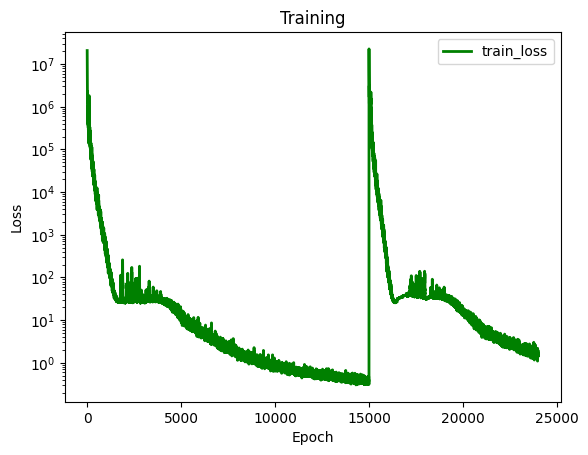

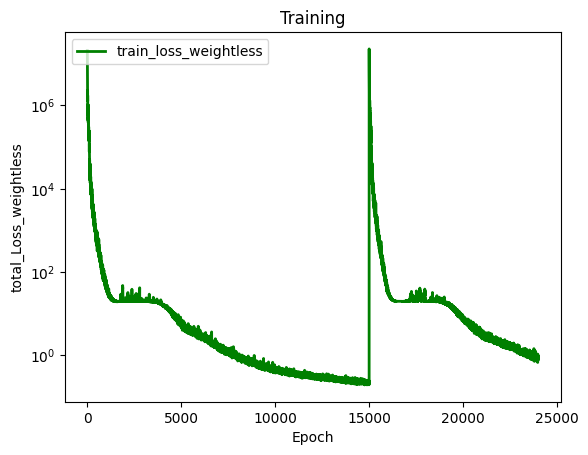

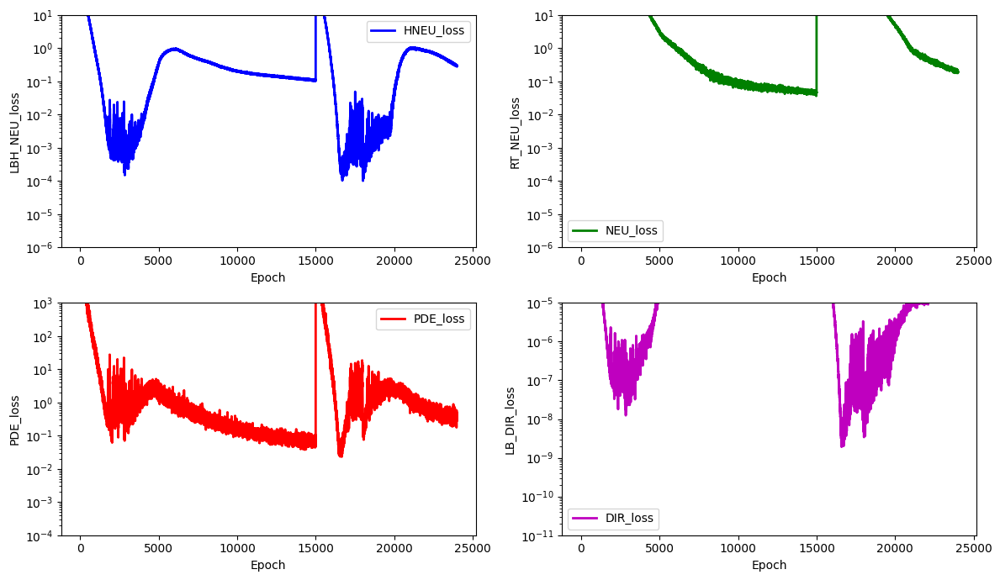

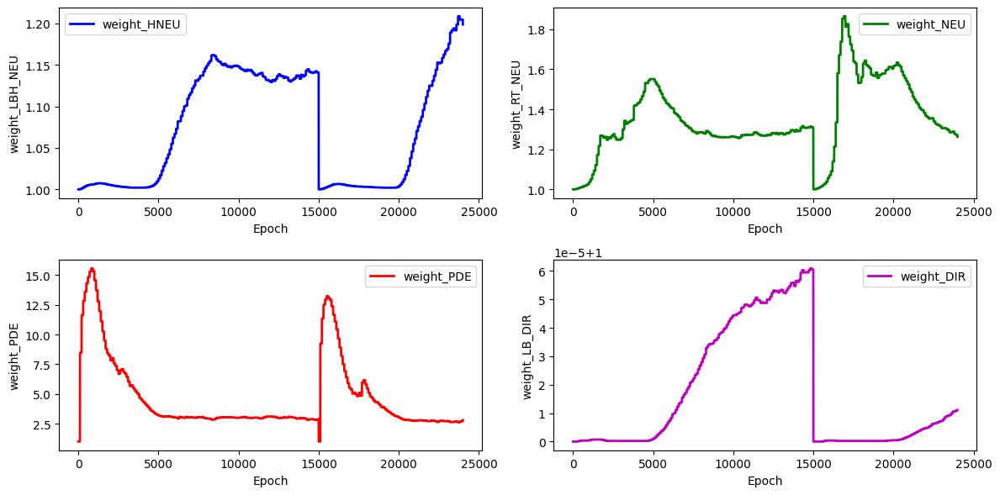

stress_Error for the stress_hole is: 9.967076908352869


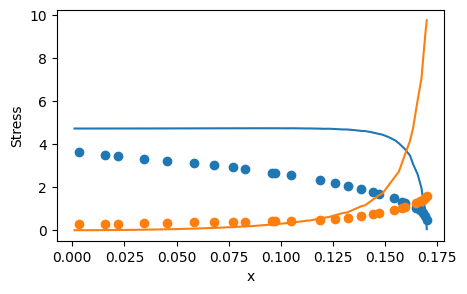

 61%|██████    | 9100/15000 [4:31:06<37:51,  2.60it/s]  

for weight 0 norm_grad: 201.589111328125
for weight 0 new lamda dach: 1.2330715656280518
for weight 0 new lamdaloss norm: 248.57382202148438
for weight 1 norm_grad: 217.59178161621094
for weight 1 new lamda dach: 1.2563157081604004
for weight 1 new lamdaloss norm: 273.36395263671875
for weight 2 norm_grad: 647.315185546875
for weight 2 new lamda dach: 2.5441770553588867
for weight 2 new lamdaloss norm: 1646.884521484375
for weight 3 norm_grad: 0.0166025310754776
for weight 3 new lamda dach: 1.0000156164169312
for weight 3 new lamdaloss norm: 0.016602789983153343
for weight 0 new weight_value: 1.2019823789596558
for weight 1 new weight_value: 1.261771321296692
for weight 2 new weight_value: 2.7736854553222656
for weight 3 new weight_value: 1.0000114440917969


 61%|██████▏   | 9200/15000 [4:31:44<37:59,  2.54it/s]

for weight 0 norm_grad: 192.6876983642578
for weight 0 new lamda dach: 1.1724814176559448
for weight 0 new lamdaloss norm: 225.9227294921875
for weight 1 norm_grad: 196.4500274658203
for weight 1 new lamda dach: 1.1764434576034546
for weight 1 new lamdaloss norm: 231.11233520507812
for weight 2 norm_grad: 920.68408203125
for weight 2 new lamda dach: 3.3658602237701416
for weight 2 new lamdaloss norm: 3098.89404296875
for weight 3 norm_grad: 0.016300354152917862
for weight 3 new lamda dach: 1.0000125169754028
for weight 3 new lamdaloss norm: 0.016300557181239128
for weight 0 new weight_value: 1.1990323066711426
for weight 1 new weight_value: 1.2532384395599365
for weight 2 new weight_value: 2.8329029083251953
for weight 3 new weight_value: 1.0000115633010864


 62%|██████▏   | 9300/15000 [4:32:22<36:17,  2.62it/s]

for weight 0 norm_grad: 182.9072723388672
for weight 0 new lamda dach: 1.2050977945327759
for weight 0 new lamdaloss norm: 220.42112731933594
for weight 1 norm_grad: 191.9420166015625
for weight 1 new lamda dach: 1.2174314260482788
for weight 1 new lamdaloss norm: 233.67625427246094
for weight 2 norm_grad: 699.8468017578125
for weight 2 new lamda dach: 2.866927146911621
for weight 2 new lamdaloss norm: 2006.40966796875
for weight 3 norm_grad: 0.01631329394876957
for weight 3 new lamda dach: 1.0000152587890625
for weight 3 new lamdaloss norm: 0.016313543543219566
for weight 0 new weight_value: 1.199638843536377
for weight 1 new weight_value: 1.2496576309204102
for weight 2 new weight_value: 2.8363051414489746
for weight 3 new weight_value: 1.000011920928955


 63%|██████▎   | 9400/15000 [4:33:00<37:39,  2.48it/s]

for weight 0 norm_grad: 180.87030029296875
for weight 0 new lamda dach: 1.2074165344238281
for weight 0 new lamdaloss norm: 218.3857879638672
for weight 1 norm_grad: 209.6041717529297
for weight 1 new lamda dach: 1.2485579252243042
for weight 1 new lamdaloss norm: 261.7029113769531
for weight 2 norm_grad: 662.39404296875
for weight 2 new lamda dach: 2.696309804916382
for weight 2 new lamdaloss norm: 1786.01953125
for weight 3 norm_grad: 0.016774263232946396
for weight 3 new lamda dach: 1.0000158548355103
for weight 3 new lamdaloss norm: 0.016774527728557587
for weight 0 new weight_value: 1.2004165649414062
for weight 1 new weight_value: 1.2495476007461548
for weight 2 new weight_value: 2.82230544090271
for weight 3 new weight_value: 1.0000122785568237


 63%|██████▎   | 9499/15000 [4:33:38<34:01,  2.69it/s]

for weight 0 norm_grad: 177.18338012695312
for weight 0 new lamda dach: 1.231434941291809
for weight 0 new lamdaloss norm: 218.1898193359375
for weight 1 norm_grad: 179.6236114501953
for weight 1 new lamda dach: 1.2353724241256714
for weight 1 new lamdaloss norm: 221.90206909179688
for weight 2 norm_grad: 585.94580078125
for weight 2 new lamda dach: 2.6421141624450684
for weight 2 new lamdaloss norm: 1548.1357421875
for weight 3 norm_grad: 0.017052605748176575
for weight 3 new lamda dach: 1.0000181198120117
for weight 3 new lamdaloss norm: 0.017052916809916496
for weight 0 new weight_value: 1.2035183906555176
for weight 1 new weight_value: 1.2481300830841064
for weight 2 new weight_value: 2.804286241531372
for weight 3 new weight_value: 1.0000128746032715
total_loss: 0.6198051571846008, hole_loss:  0.2449805736541748,neumann_loss:  0.15971486270427704, pde_loss: 0.1919098198413849,dirichlet_loss: 1.4948372154321987e-05


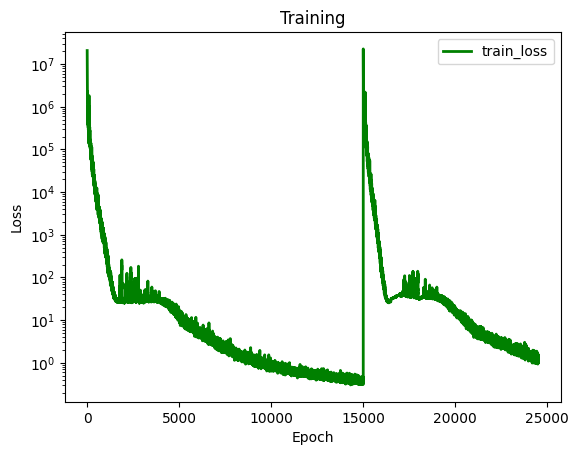

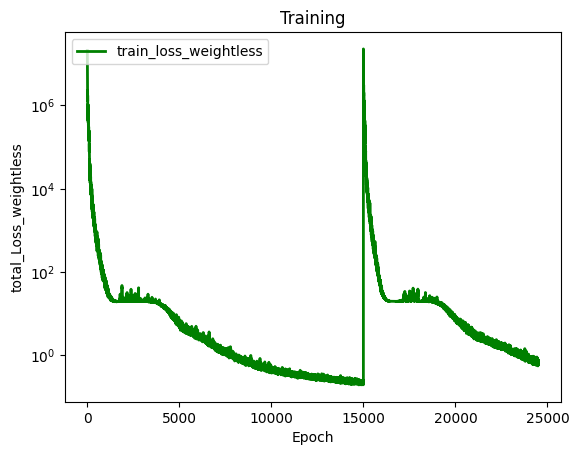

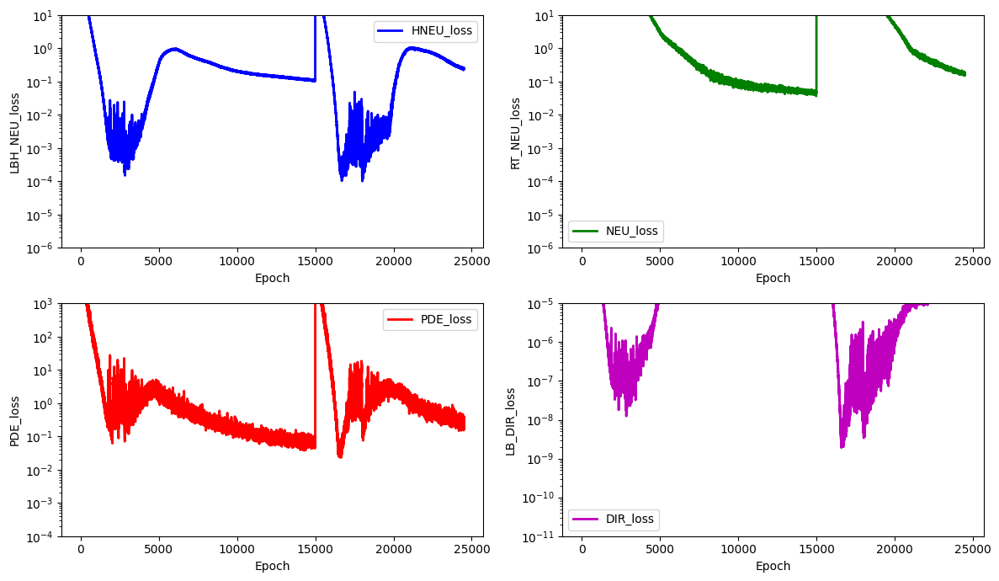

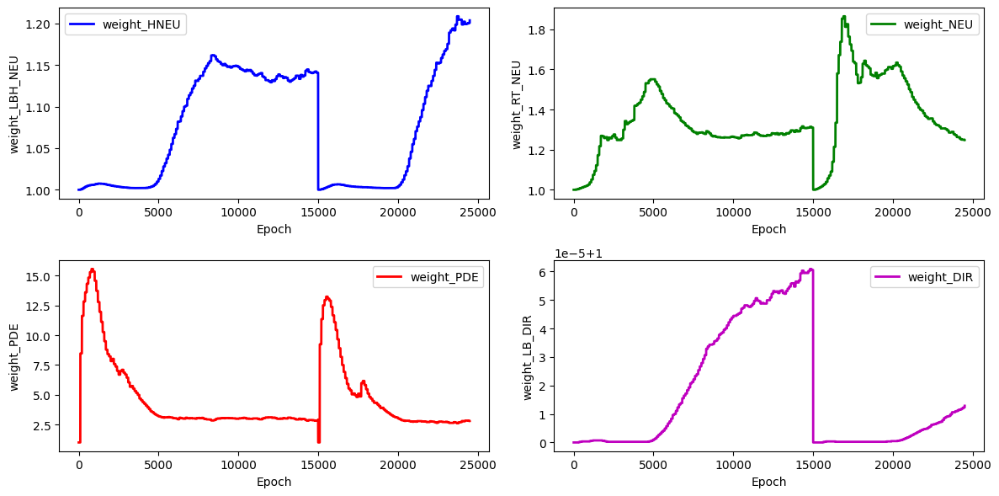

stress_Error for the stress_hole is: 9.259768798654072


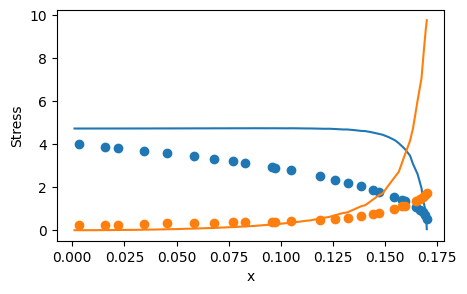

 64%|██████▍   | 9600/15000 [4:34:18<33:44,  2.67it/s]  

for weight 0 norm_grad: 174.03231811523438
for weight 0 new lamda dach: 1.195449709892273
for weight 0 new lamdaloss norm: 208.04690551757812
for weight 1 norm_grad: 177.92872619628906
for weight 1 new lamda dach: 1.200703740119934
for weight 1 new lamdaloss norm: 213.6396942138672
for weight 2 norm_grad: 712.4754028320312
for weight 2 new lamda dach: 3.0242087841033936
for weight 2 new lamdaloss norm: 2154.67431640625
for weight 3 norm_grad: 0.01617184467613697
for weight 3 new lamda dach: 1.000015139579773
for weight 3 new lamdaloss norm: 0.01617209054529667
for weight 0 new weight_value: 1.2027114629745483
for weight 1 new weight_value: 1.2433873414993286
for weight 2 new weight_value: 2.8262784481048584
for weight 3 new weight_value: 1.0000131130218506


 65%|██████▍   | 9700/15000 [4:34:54<33:30,  2.64it/s]

for weight 0 norm_grad: 161.4675750732422
for weight 0 new lamda dach: 1.1844849586486816
for weight 0 new lamdaloss norm: 191.2559051513672
for weight 1 norm_grad: 172.49642944335938
for weight 1 new lamda dach: 1.199601173400879
for weight 1 new lamdaloss norm: 206.92694091796875
for weight 2 norm_grad: 702.7208862304688
for weight 2 new lamda dach: 3.104074239730835
for weight 2 new lamdaloss norm: 2181.2978515625
for weight 3 norm_grad: 0.017083123326301575
for weight 3 new lamda dach: 1.000016450881958
for weight 3 new lamdaloss norm: 0.01708340458571911
for weight 0 new weight_value: 1.200888752937317
for weight 1 new weight_value: 1.2390086650848389
for weight 2 new weight_value: 2.854058027267456
for weight 3 new weight_value: 1.0000134706497192


 65%|██████▌   | 9800/15000 [4:35:33<33:42,  2.57it/s]

for weight 0 norm_grad: 161.9881591796875
for weight 0 new lamda dach: 1.1570481061935425
for weight 0 new lamdaloss norm: 187.4281005859375
for weight 1 norm_grad: 189.5668182373047
for weight 1 new lamda dach: 1.1888346672058105
for weight 1 new lamdaloss norm: 225.3636016845703
for weight 2 norm_grad: 841.8728637695312
for weight 2 new lamda dach: 3.3946027755737305
for weight 2 new lamdaloss norm: 2857.823974609375
for weight 3 norm_grad: 0.01599983125925064
for weight 3 new lamda dach: 1.0000133514404297
for weight 3 new lamdaloss norm: 0.016000045463442802
for weight 0 new weight_value: 1.1965045928955078
for weight 1 new weight_value: 1.233991265296936
for weight 2 new weight_value: 2.9081125259399414
for weight 3 new weight_value: 1.0000133514404297


 66%|██████▌   | 9900/15000 [4:36:09<31:59,  2.66it/s]

for weight 0 norm_grad: 153.2692413330078
for weight 0 new lamda dach: 1.1849782466888428
for weight 0 new lamdaloss norm: 181.62071228027344
for weight 1 norm_grad: 178.40428161621094
for weight 1 new lamda dach: 1.222049355506897
for weight 1 new lamdaloss norm: 218.0188446044922
for weight 2 norm_grad: 650.1578979492188
for weight 2 new lamda dach: 2.960132360458374
for weight 2 new lamdaloss norm: 1924.5533447265625
for weight 3 norm_grad: 0.017279809340834618
for weight 3 new lamda dach: 1.0000176429748535
for weight 3 new lamdaloss norm: 0.017280112951993942
for weight 0 new weight_value: 1.1953519582748413
for weight 1 new weight_value: 1.2327970266342163
for weight 2 new weight_value: 2.9133143424987793
for weight 3 new weight_value: 1.000013828277588


 67%|██████▋   | 9999/15000 [4:36:46<30:26,  2.74it/s]

for weight 0 norm_grad: 141.85525512695312
for weight 0 new lamda dach: 1.1418424844741821
for weight 0 new lamdaloss norm: 161.97634887695312
for weight 1 norm_grad: 162.19757080078125
for weight 1 new lamda dach: 1.1655503511428833
for weight 1 new lamdaloss norm: 189.04942321777344
for weight 2 norm_grad: 837.8760986328125
for weight 2 new lamda dach: 3.7555429935455322
for weight 2 new lamdaloss norm: 3146.6796875
for weight 3 norm_grad: 0.01652199774980545
for weight 3 new lamda dach: 1.0000144243240356
for weight 3 new lamdaloss norm: 0.016522236168384552
for weight 0 new weight_value: 1.1900010108947754
for weight 1 new weight_value: 1.2260723114013672
for weight 2 new weight_value: 2.997537136077881
for weight 3 new weight_value: 1.000013828277588
total_loss: 0.5224432349205017, hole_loss:  0.1901128590106964,neumann_loss:  0.139744371175766, pde_loss: 0.15262708067893982,dirichlet_loss: 1.4261442629504018e-05


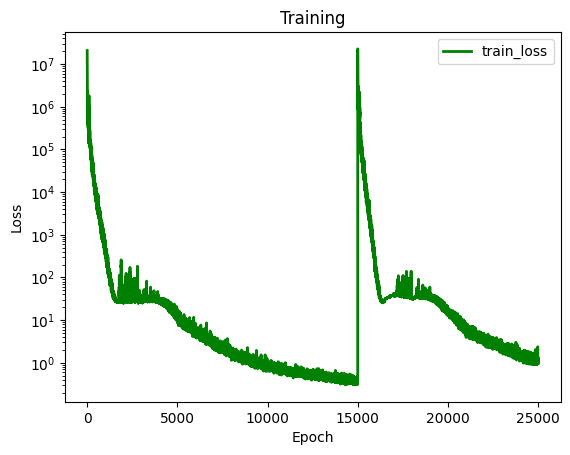

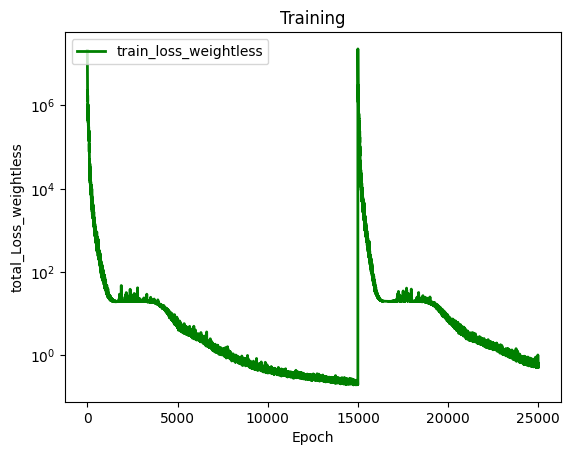

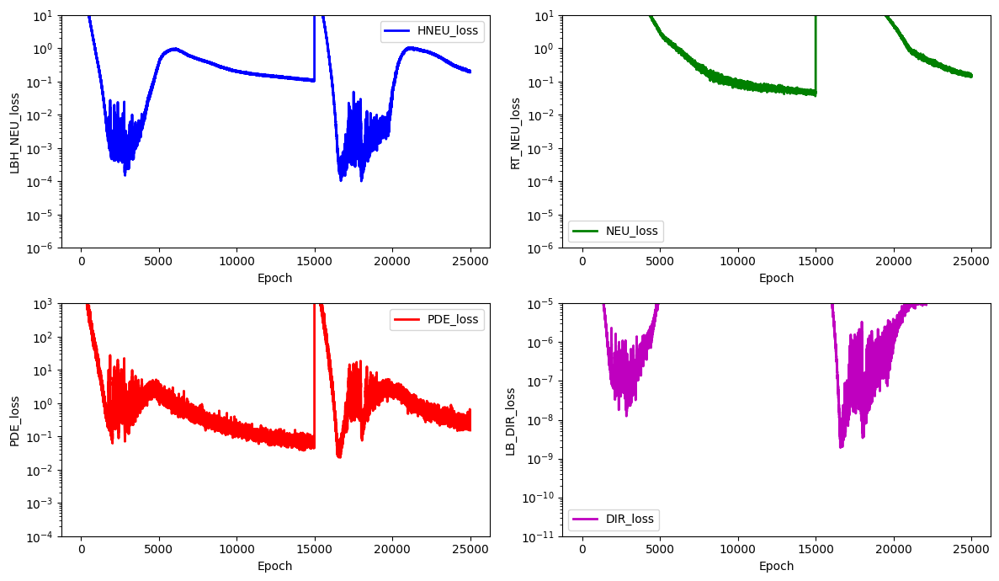

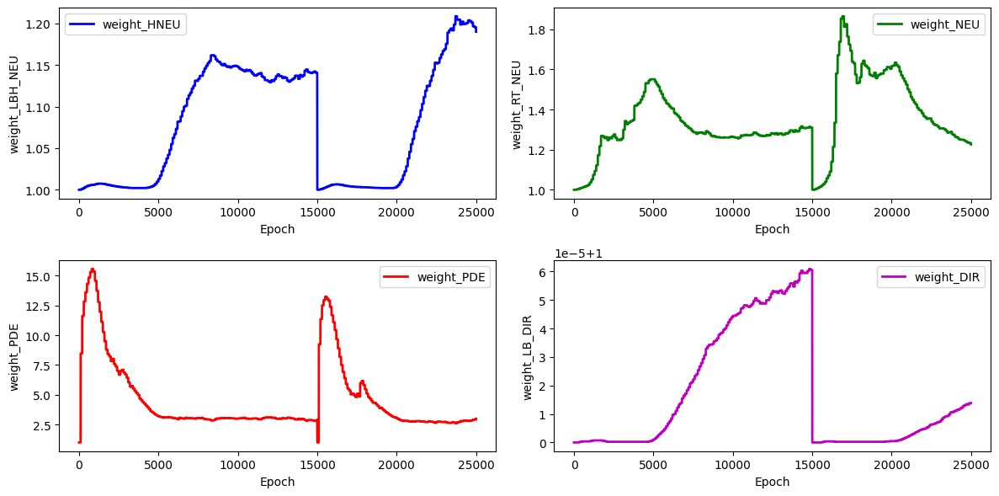

stress_Error for the stress_hole is: 8.917706822324792


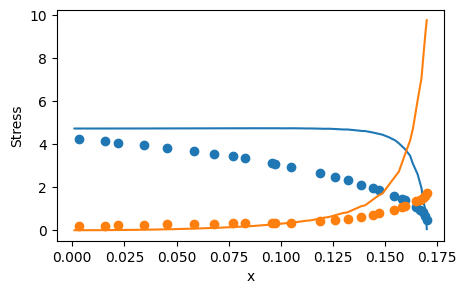

 67%|██████▋   | 10100/15000 [4:37:25<30:58,  2.64it/s]  

for weight 0 norm_grad: 155.9601593017578
for weight 0 new lamda dach: 1.1875113248825073
for weight 0 new lamdaloss norm: 185.20445251464844
for weight 1 norm_grad: 171.95713806152344
for weight 1 new lamda dach: 1.2107988595962524
for weight 1 new lamdaloss norm: 208.20553588867188
for weight 2 norm_grad: 659.7645263671875
for weight 2 new lamda dach: 3.011888265609741
for weight 2 new lamdaloss norm: 1987.136962890625
for weight 3 norm_grad: 0.01568014547228813
for weight 3 new lamda dach: 1.0000158548355103
for weight 3 new lamdaloss norm: 0.01568039320409298
for weight 0 new weight_value: 1.1897521018981934
for weight 1 new weight_value: 1.2245450019836426
for weight 2 new weight_value: 2.9989724159240723
for weight 3 new weight_value: 1.000014066696167


 68%|██████▊   | 10200/15000 [4:38:01<29:41,  2.69it/s]

for weight 0 norm_grad: 143.20350646972656
for weight 0 new lamda dach: 1.1939550638198853
for weight 0 new lamdaloss norm: 170.97854614257812
for weight 1 norm_grad: 160.39120483398438
for weight 1 new lamda dach: 1.2224115133285522
for weight 1 new lamdaloss norm: 196.06407165527344
for weight 2 norm_grad: 577.9267578125
for weight 2 new lamda dach: 2.903515100479126
for weight 2 new lamdaloss norm: 1678.0191650390625
for weight 3 norm_grad: 0.015579301863908768
for weight 3 new lamda dach: 1.0000176429748535
for weight 3 new lamdaloss norm: 0.015579575672745705
for weight 0 new weight_value: 1.1901723146438599
for weight 1 new weight_value: 1.2243316173553467
for weight 2 new weight_value: 2.989426612854004
for weight 3 new weight_value: 1.0000144243240356


 69%|██████▊   | 10300/15000 [4:38:37<29:19,  2.67it/s]

for weight 0 norm_grad: 140.9584197998047
for weight 0 new lamda dach: 1.180378794670105
for weight 0 new lamdaloss norm: 166.3843231201172
for weight 1 norm_grad: 166.6837921142578
for weight 1 new lamda dach: 1.2205592393875122
for weight 1 new lamdaloss norm: 203.4474334716797
for weight 2 norm_grad: 614.757080078125
for weight 2 new lamda dach: 2.998176336288452
for weight 2 new lamdaloss norm: 1843.150146484375
for weight 3 norm_grad: 0.01682092435657978
for weight 3 new lamda dach: 1.0000182390213013
for weight 3 new lamdaloss norm: 0.016821231693029404
for weight 0 new weight_value: 1.1891930103302002
for weight 1 new weight_value: 1.2239543199539185
for weight 2 new weight_value: 2.9903013706207275
for weight 3 new weight_value: 1.0000147819519043


 69%|██████▉   | 10400/15000 [4:39:14<28:13,  2.72it/s]

for weight 0 norm_grad: 145.3157958984375
for weight 0 new lamda dach: 1.1486237049102783
for weight 0 new lamdaloss norm: 166.91314697265625
for weight 1 norm_grad: 169.5044403076172
for weight 1 new lamda dach: 1.1777607202529907
for weight 1 new lamdaloss norm: 199.6356658935547
for weight 2 norm_grad: 808.22314453125
for weight 2 new lamda dach: 3.5671298503875732
for weight 2 new lamdaloss norm: 2883.037109375
for weight 3 norm_grad: 0.015041498467326164
for weight 3 new lamda dach: 1.0000133514404297
for weight 3 new lamdaloss norm: 0.015041699633002281
for weight 0 new weight_value: 1.1851359605789185
for weight 1 new weight_value: 1.2193348407745361
for weight 2 new weight_value: 3.0479841232299805
for weight 3 new weight_value: 1.0000145435333252


 70%|██████▉   | 10499/15000 [4:39:49<26:40,  2.81it/s]

for weight 0 norm_grad: 140.4816131591797
for weight 0 new lamda dach: 1.1698181629180908
for weight 0 new lamdaloss norm: 164.3379364013672
for weight 1 norm_grad: 161.78932189941406
for weight 1 new lamda dach: 1.2007461786270142
for weight 1 new lamdaloss norm: 194.2678985595703
for weight 2 norm_grad: 665.4429931640625
for weight 2 new lamda dach: 3.2013673782348633
for weight 2 new lamdaloss norm: 2130.327392578125
for weight 3 norm_grad: 0.015264945104718208
for weight 3 new lamda dach: 1.0000157356262207
for weight 3 new lamdaloss norm: 0.015265185385942459
for weight 0 new weight_value: 1.1836042404174805
for weight 1 new weight_value: 1.2174760103225708
for weight 2 new weight_value: 3.0633223056793213
for weight 3 new weight_value: 1.0000146627426147
total_loss: 0.5631888508796692, hole_loss:  0.18399198353290558,neumann_loss:  0.14715391397476196, pde_loss: 0.21867944300174713,dirichlet_loss: 1.2231237633386627e-05


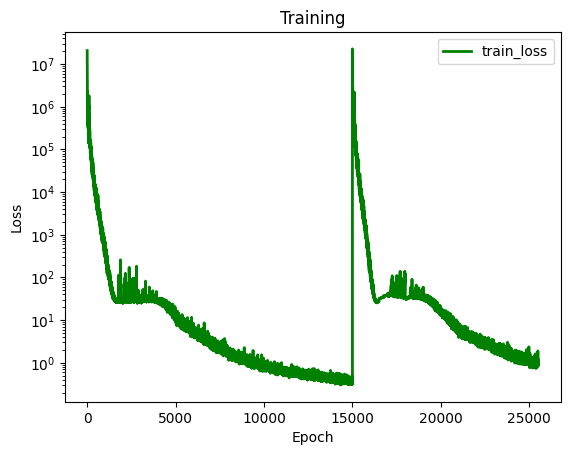

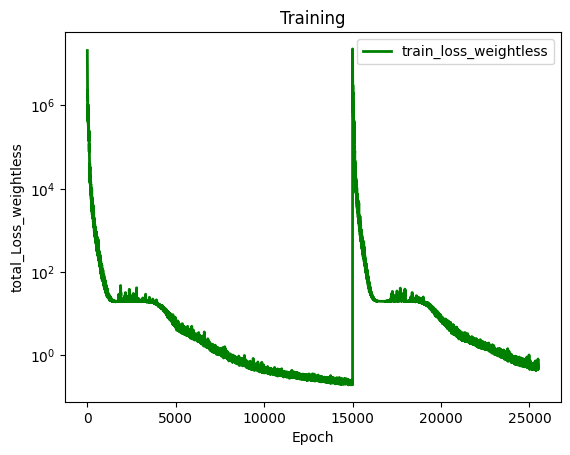

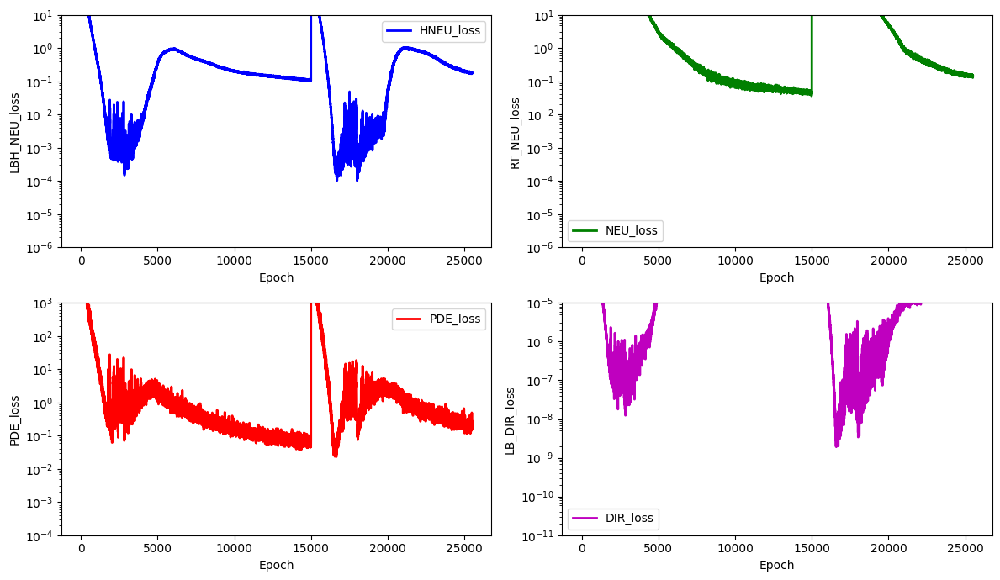

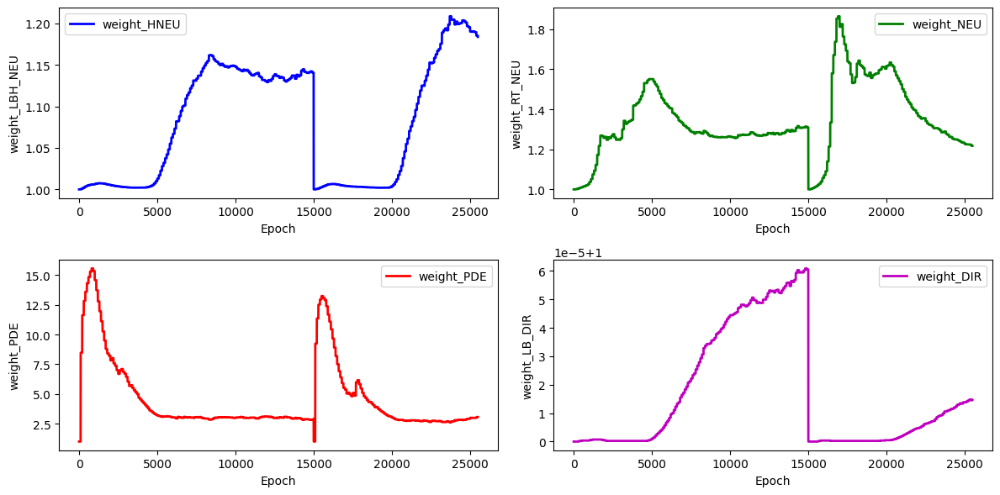

stress_Error for the stress_hole is: 8.583993284910584


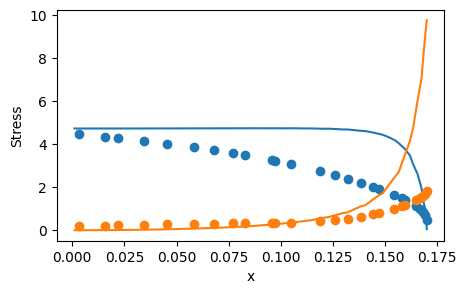

 71%|███████   | 10600/15000 [4:40:30<28:27,  2.58it/s]  

for weight 0 norm_grad: 135.29678344726562
for weight 0 new lamda dach: 1.1665172576904297
for weight 0 new lamdaloss norm: 157.82603454589844
for weight 1 norm_grad: 159.45323181152344
for weight 1 new lamda dach: 1.2022613286972046
for weight 1 new lamdaloss norm: 191.70445251464844
for weight 2 norm_grad: 653.0405883789062
for weight 2 new lamda dach: 3.215461254119873
for weight 2 new lamdaloss norm: 2099.82666015625
for weight 3 norm_grad: 0.015100918710231781
for weight 3 new lamda dach: 1.0000158548355103
for weight 3 new lamdaloss norm: 0.015101158060133457
for weight 0 new weight_value: 1.1818956136703491
for weight 1 new weight_value: 1.2159545421600342
for weight 2 new weight_value: 3.078536033630371
for weight 3 new weight_value: 1.0000147819519043


 71%|███████▏  | 10700/15000 [4:41:09<28:38,  2.50it/s]

for weight 0 norm_grad: 138.1782989501953
for weight 0 new lamda dach: 1.1544355154037476
for weight 0 new lamdaloss norm: 159.5179443359375
for weight 1 norm_grad: 150.3805694580078
for weight 1 new lamda dach: 1.1703972816467285
for weight 1 new lamdaloss norm: 176.00502014160156
for weight 2 norm_grad: 744.3352661132812
for weight 2 new lamda dach: 3.5793540477752686
for weight 2 new lamdaloss norm: 2664.239501953125
for weight 3 norm_grad: 0.015415464527904987
for weight 3 new lamda dach: 1.0000149011611938
for weight 3 new lamdaloss norm: 0.015415694564580917
for weight 0 new weight_value: 1.1791496276855469
for weight 1 new weight_value: 1.211398720741272
for weight 2 new weight_value: 3.128617763519287
for weight 3 new weight_value: 1.0000147819519043


 72%|███████▏  | 10800/15000 [4:41:48<27:55,  2.51it/s]

for weight 0 norm_grad: 139.57749938964844
for weight 0 new lamda dach: 1.1669604778289795
for weight 0 new lamdaloss norm: 162.88143920898438
for weight 1 norm_grad: 166.1587677001953
for weight 1 new lamda dach: 1.2052838802337646
for weight 1 new lamdaloss norm: 200.2684783935547
for weight 2 norm_grad: 669.8182373046875
for weight 2 new lamda dach: 3.1907355785369873
for weight 2 new lamdaloss norm: 2137.212890625
for weight 3 norm_grad: 0.01408385019749403
for weight 3 new lamda dach: 1.0000144243240356
for weight 3 new lamdaloss norm: 0.014084053225815296
for weight 0 new weight_value: 1.1779305934906006
for weight 1 new weight_value: 1.2107871770858765
for weight 2 new weight_value: 3.134829521179199
for weight 3 new weight_value: 1.0000146627426147


 73%|███████▎  | 10900/15000 [4:42:26<26:57,  2.53it/s]

for weight 0 norm_grad: 132.4134979248047
for weight 0 new lamda dach: 1.1506603956222534
for weight 0 new lamdaloss norm: 152.3629608154297
for weight 1 norm_grad: 152.30372619628906
for weight 1 new lamda dach: 1.1773041486740112
for weight 1 new lamdaloss norm: 179.30780029296875
for weight 2 norm_grad: 726.56884765625
for weight 2 new lamda dach: 3.5517640113830566
for weight 2 new lamdaloss norm: 2580.60107421875
for weight 3 norm_grad: 0.014787032268941402
for weight 3 new lamda dach: 1.0000146627426147
for weight 3 new lamdaloss norm: 0.014787250198423862
for weight 0 new weight_value: 1.175203561782837
for weight 1 new weight_value: 1.2074388265609741
for weight 2 new weight_value: 3.176522970199585
for weight 3 new weight_value: 1.0000146627426147


 73%|███████▎  | 10999/15000 [4:43:04<25:27,  2.62it/s]

for weight 0 norm_grad: 123.82011413574219
for weight 0 new lamda dach: 1.142287254333496
for weight 0 new lamdaloss norm: 141.4381561279297
for weight 1 norm_grad: 159.01065063476562
for weight 1 new lamda dach: 1.1904270648956299
for weight 1 new lamdaloss norm: 189.29058837890625
for weight 2 norm_grad: 711.18701171875
for weight 2 new lamda dach: 3.514404058456421
for weight 2 new lamdaloss norm: 2499.39892578125
for weight 3 norm_grad: 0.014413855969905853
for weight 3 new lamda dach: 1.0000145435333252
for weight 3 new lamdaloss norm: 0.014414067380130291
for weight 0 new weight_value: 1.1719119548797607
for weight 1 new weight_value: 1.2057377099990845
for weight 2 new weight_value: 3.210310935974121
for weight 3 new weight_value: 1.0000145435333252
total_loss: 0.5002938508987427, hole_loss:  0.16081860661506653,neumann_loss:  0.1478036791086197, pde_loss: 0.1765930950641632,dirichlet_loss: 1.1508461284392979e-05


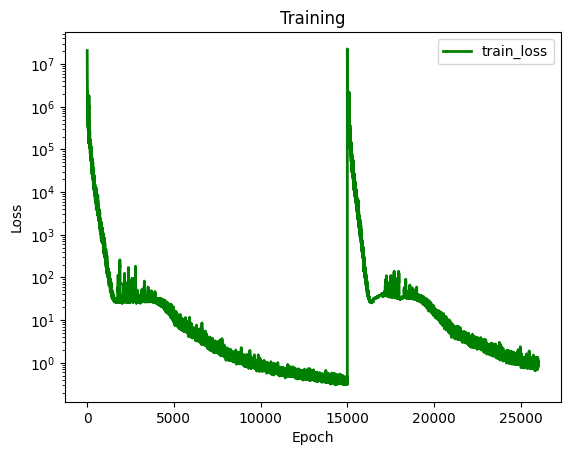

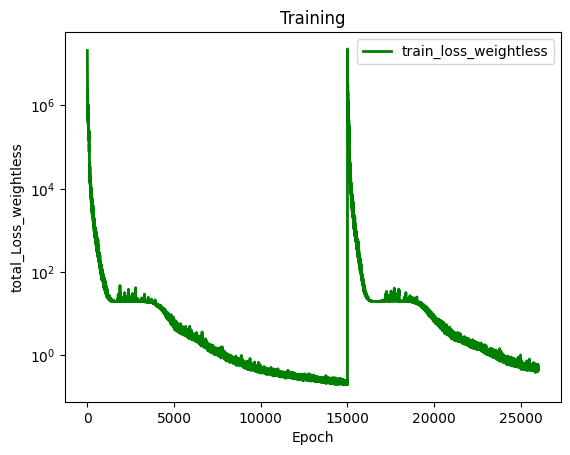

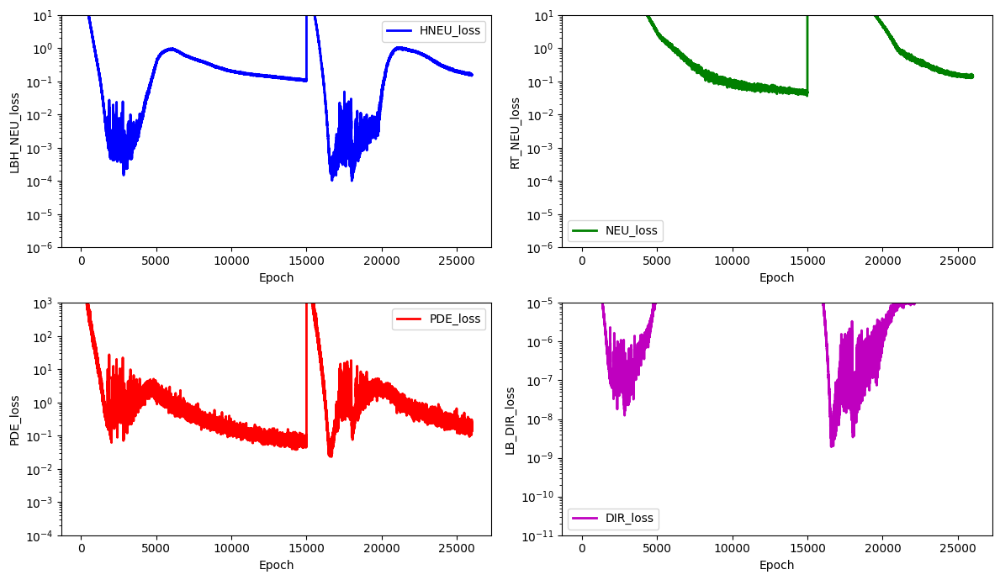

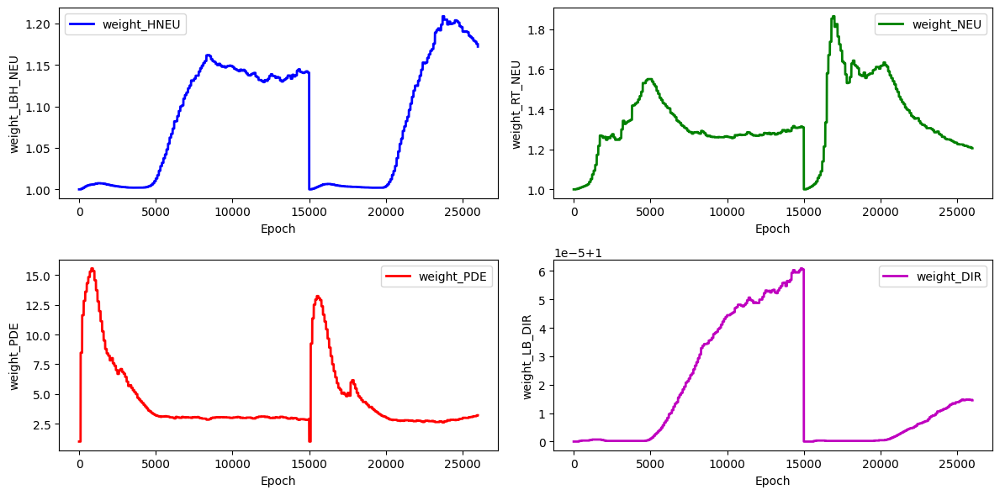

stress_Error for the stress_hole is: 8.5774527597497


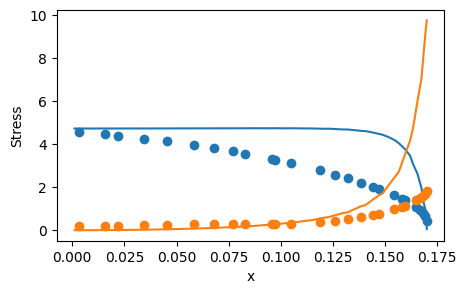

 74%|███████▍  | 11100/15000 [4:43:45<24:43,  2.63it/s]  

for weight 0 norm_grad: 116.99232482910156
for weight 0 new lamda dach: 1.176606297492981
for weight 0 new lamdaloss norm: 137.65390014648438
for weight 1 norm_grad: 146.00982666015625
for weight 1 new lamda dach: 1.2305067777633667
for weight 1 new lamdaloss norm: 179.66610717773438
for weight 2 norm_grad: 516.4227294921875
for weight 2 new lamda dach: 2.9634597301483154
for weight 2 new lamdaloss norm: 1530.39794921875
for weight 3 norm_grad: 0.014605579897761345
for weight 3 new lamda dach: 1.0000187158584595
for weight 3 new lamdaloss norm: 0.014605853706598282
for weight 0 new weight_value: 1.1723814010620117
for weight 1 new weight_value: 1.2082146406173706
for weight 2 new weight_value: 3.1856257915496826
for weight 3 new weight_value: 1.0000150203704834


 75%|███████▍  | 11200/15000 [4:44:22<24:32,  2.58it/s]

for weight 0 norm_grad: 122.24453735351562
for weight 0 new lamda dach: 1.2067421674728394
for weight 0 new lamdaloss norm: 147.51763916015625
for weight 1 norm_grad: 152.74839782714844
for weight 1 new lamda dach: 1.2723828554153442
for weight 1 new lamdaloss norm: 194.3544464111328
for weight 2 norm_grad: 438.5265808105469
for weight 2 new lamda dach: 2.5945980548858643
for weight 2 new lamdaloss norm: 1137.80029296875
for weight 3 norm_grad: 0.014658547937870026
for weight 3 new lamda dach: 1.0000205039978027
for weight 3 new lamdaloss norm: 0.014658848755061626
for weight 0 new weight_value: 1.1758174896240234
for weight 1 new weight_value: 1.21463143825531
for weight 2 new weight_value: 3.1265227794647217
for weight 3 new weight_value: 1.0000154972076416


 75%|███████▌  | 11300/15000 [4:45:00<23:54,  2.58it/s]

for weight 0 norm_grad: 128.0718536376953
for weight 0 new lamda dach: 1.1783591508865356
for weight 0 new lamdaloss norm: 150.91464233398438
for weight 1 norm_grad: 151.29197692871094
for weight 1 new lamda dach: 1.2177377939224243
for weight 1 new lamdaloss norm: 184.23394775390625
for weight 2 norm_grad: 566.750244140625
for weight 2 new lamda dach: 3.0286171436309814
for weight 2 new lamdaloss norm: 1716.4696044921875
for weight 3 norm_grad: 0.013791403733193874
for weight 3 new lamda dach: 1.0000163316726685
for weight 3 new lamdaloss norm: 0.013791629113256931
for weight 0 new weight_value: 1.1760716438293457
for weight 1 new weight_value: 1.2149419784545898
for weight 2 new weight_value: 3.116732120513916
for weight 3 new weight_value: 1.0000154972076416


 76%|███████▌  | 11400/15000 [4:45:37<23:05,  2.60it/s]

for weight 0 norm_grad: 120.98839569091797
for weight 0 new lamda dach: 1.1795271635055542
for weight 0 new lamdaloss norm: 142.7091064453125
for weight 1 norm_grad: 142.97091674804688
for weight 1 new lamda dach: 1.2192989587783813
for weight 1 new lamdaloss norm: 174.32427978515625
for weight 2 norm_grad: 530.9430541992188
for weight 2 new lamda dach: 3.011350154876709
for weight 2 new lamdaloss norm: 1598.8553466796875
for weight 3 norm_grad: 0.01418642234057188
for weight 3 new lamda dach: 1.000017762184143
for weight 3 new lamdaloss norm: 0.014186674728989601
for weight 0 new weight_value: 1.1764171123504639
for weight 1 new weight_value: 1.215377688407898
for weight 2 new weight_value: 3.106193780899048
for weight 3 new weight_value: 1.0000157356262207


 77%|███████▋  | 11499/15000 [4:46:14<22:05,  2.64it/s]

for weight 0 norm_grad: 114.61213684082031
for weight 0 new lamda dach: 1.1765713691711426
for weight 0 new lamdaloss norm: 134.84934997558594
for weight 1 norm_grad: 150.076416015625
for weight 1 new lamda dach: 1.244570016860962
for weight 1 new lamdaloss norm: 186.78060913085938
for weight 2 norm_grad: 499.0071716308594
for weight 2 new lamda dach: 2.8851590156555176
for weight 2 new lamdaloss norm: 1439.7149658203125
for weight 3 norm_grad: 0.014463347382843494
for weight 3 new lamda dach: 1.0000189542770386
for weight 3 new lamdaloss norm: 0.014463620260357857
for weight 0 new weight_value: 1.1764326095581055
for weight 1 new weight_value: 1.2182968854904175
for weight 2 new weight_value: 3.084090232849121
for weight 3 new weight_value: 1.0000160932540894
total_loss: 0.4585188031196594, hole_loss:  0.14691761136054993,neumann_loss:  0.1332026571035385, pde_loss: 0.15736569464206696,dirichlet_loss: 1.1820053259725682e-05


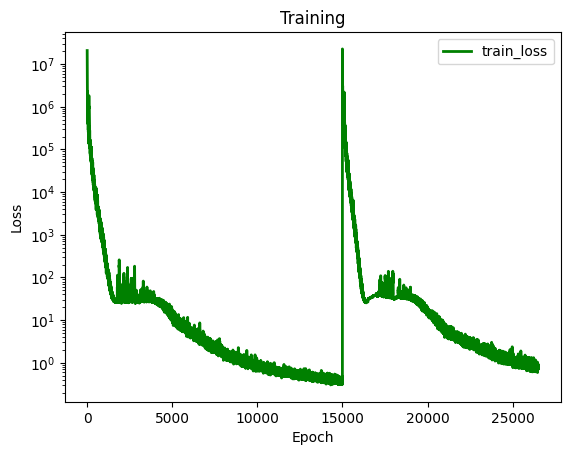

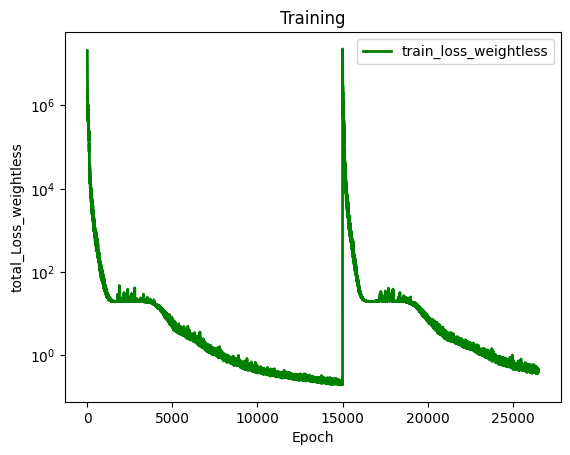

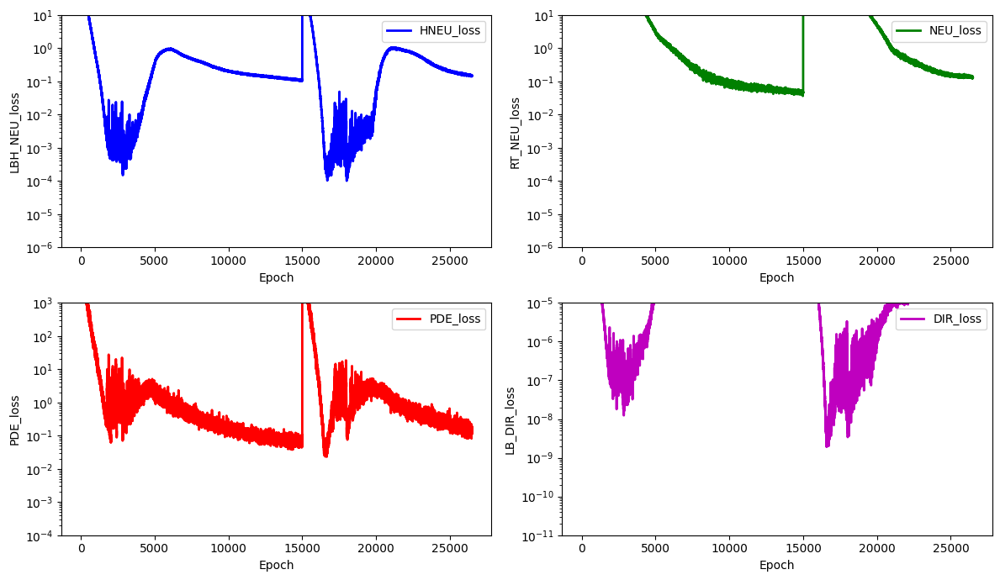

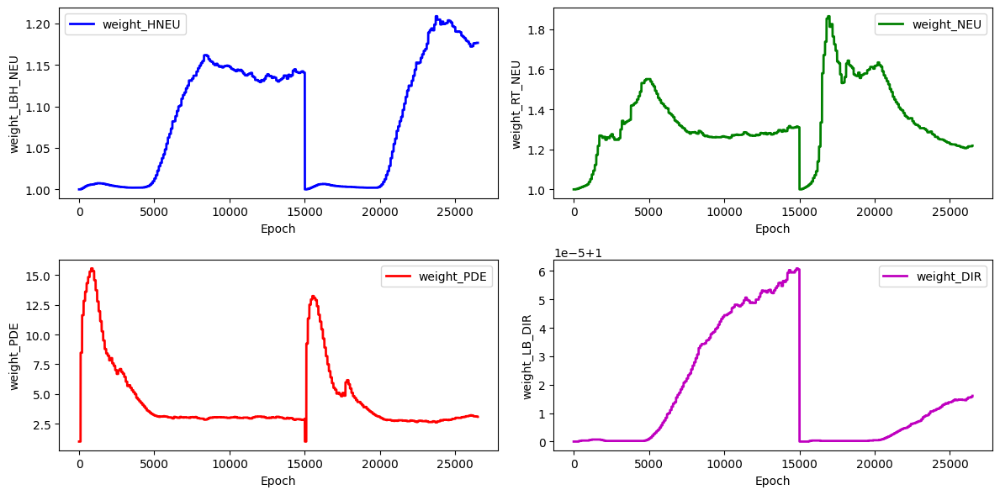

stress_Error for the stress_hole is: 8.426942002710874


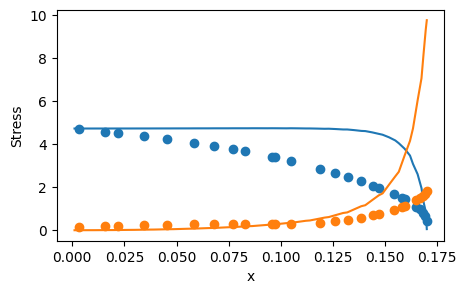

 77%|███████▋  | 11600/15000 [4:46:53<20:29,  2.76it/s]  

for weight 0 norm_grad: 119.99958801269531
for weight 0 new lamda dach: 1.1685484647750854
for weight 0 new lamdaloss norm: 140.22532653808594
for weight 1 norm_grad: 147.52276611328125
for weight 1 new lamda dach: 1.2155392169952393
for weight 1 new lamdaloss norm: 179.3197021484375
for weight 2 norm_grad: 564.4222412109375
for weight 2 new lamda dach: 3.109703779220581
for weight 2 new lamdaloss norm: 1755.185791015625
for weight 3 norm_grad: 0.013895494863390923
for weight 3 new lamda dach: 1.000016689300537
for weight 3 new lamdaloss norm: 0.013895725831389427
for weight 0 new weight_value: 1.1756441593170166
for weight 1 new weight_value: 1.218021035194397
for weight 2 new weight_value: 3.08665132522583
for weight 3 new weight_value: 1.0000160932540894


 78%|███████▊  | 11700/15000 [4:47:28<20:00,  2.75it/s]

for weight 0 norm_grad: 117.50926971435547
for weight 0 new lamda dach: 1.1871466636657715
for weight 0 new lamdaloss norm: 139.500732421875
for weight 1 norm_grad: 141.7408905029297
for weight 1 new lamda dach: 1.2347995042800903
for weight 1 new lamdaloss norm: 175.02157592773438
for weight 2 norm_grad: 486.1446838378906
for weight 2 new lamda dach: 2.8750951290130615
for weight 2 new lamdaloss norm: 1397.712158203125
for weight 3 norm_grad: 0.013827333226799965
for weight 3 new lamda dach: 1.00001859664917
for weight 3 new lamdaloss norm: 0.013827589340507984
for weight 0 new weight_value: 1.176794409751892
for weight 1 new weight_value: 1.2196989059448242
for weight 2 new weight_value: 3.065495491027832
for weight 3 new weight_value: 1.0000163316726685


 79%|███████▊  | 11800/15000 [4:48:03<19:20,  2.76it/s]

for weight 0 norm_grad: 110.93846130371094
for weight 0 new lamda dach: 1.123846411705017
for weight 0 new lamdaloss norm: 124.67779541015625
for weight 1 norm_grad: 142.54173278808594
for weight 1 new lamda dach: 1.16494619846344
for weight 1 new lamdaloss norm: 166.05343627929688
for weight 2 norm_grad: 753.2191162109375
for weight 2 new lamda dach: 3.9713480472564697
for weight 2 new lamdaloss norm: 2991.295654296875
for weight 3 norm_grad: 0.013882801868021488
for weight 3 new lamda dach: 1.0000137090682983
for weight 3 new lamdaloss norm: 0.013882992789149284
for weight 0 new weight_value: 1.1714996099472046
for weight 1 new weight_value: 1.2142236232757568
for weight 2 new weight_value: 3.156080722808838
for weight 3 new weight_value: 1.0000160932540894


 79%|███████▉  | 11900/15000 [4:48:38<18:48,  2.75it/s]

for weight 0 norm_grad: 112.95148468017578
for weight 0 new lamda dach: 1.1748260259628296
for weight 0 new lamdaloss norm: 132.69833374023438
for weight 1 norm_grad: 147.94161987304688
for weight 1 new lamda dach: 1.2420949935913086
for weight 1 new lamdaloss norm: 183.75753784179688
for weight 2 norm_grad: 498.1230773925781
for weight 2 new lamda dach: 2.909193277359009
for weight 2 new lamdaloss norm: 1449.1363525390625
for weight 3 norm_grad: 0.014505988918244839
for weight 3 new lamda dach: 1.0000191926956177
for weight 3 new lamdaloss norm: 0.014506267383694649
for weight 0 new weight_value: 1.1718323230743408
for weight 1 new weight_value: 1.217010736465454
for weight 2 new weight_value: 3.131391763687134
for weight 3 new weight_value: 1.0000163316726685


 80%|███████▉  | 11999/15000 [4:49:13<17:32,  2.85it/s]

for weight 0 norm_grad: 106.42337799072266
for weight 0 new lamda dach: 1.1976672410964966
for weight 0 new lamdaloss norm: 127.45980834960938
for weight 1 norm_grad: 143.0584716796875
for weight 1 new lamda dach: 1.2851123809814453
for weight 1 new lamdaloss norm: 183.84619140625
for weight 2 norm_grad: 395.324951171875
for weight 2 new lamda dach: 2.584498882293701
for weight 2 new lamdaloss norm: 1021.7168579101562
for weight 3 norm_grad: 0.013449138961732388
for weight 3 new lamda dach: 1.0000208616256714
for weight 3 new lamdaloss norm: 0.013449419289827347
for weight 0 new weight_value: 1.1744158267974854
for weight 1 new weight_value: 1.2238208055496216
for weight 2 new weight_value: 3.076702356338501
for weight 3 new weight_value: 1.0000168085098267
total_loss: 0.3636447787284851, hole_loss:  0.13663184642791748,neumann_loss:  0.12486524134874344, pde_loss: 0.09482082724571228,dirichlet_loss: 1.046845136443153e-05


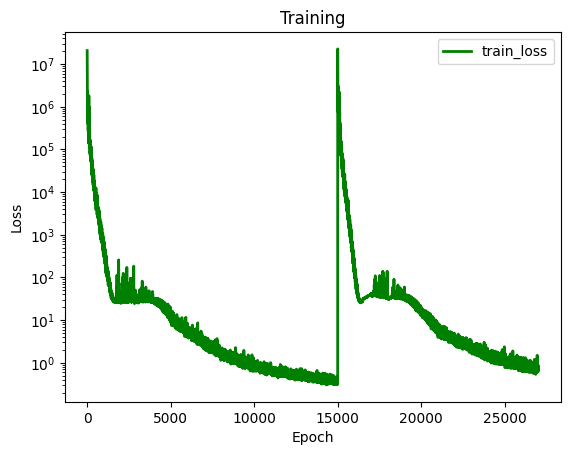

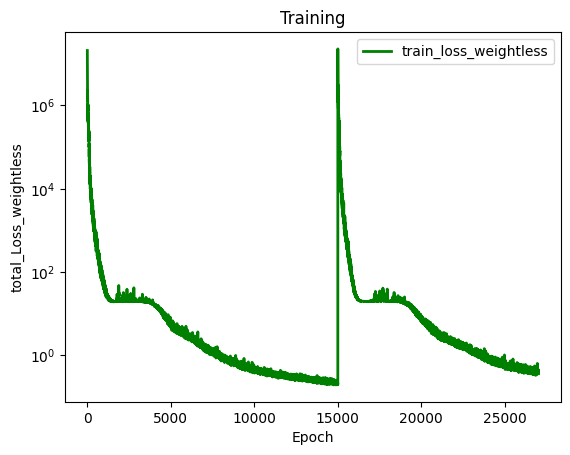

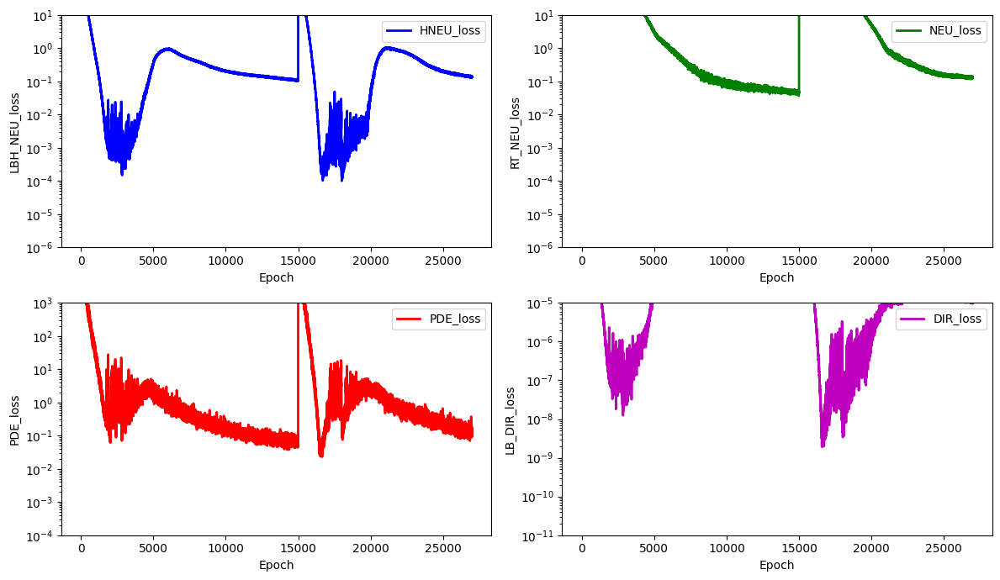

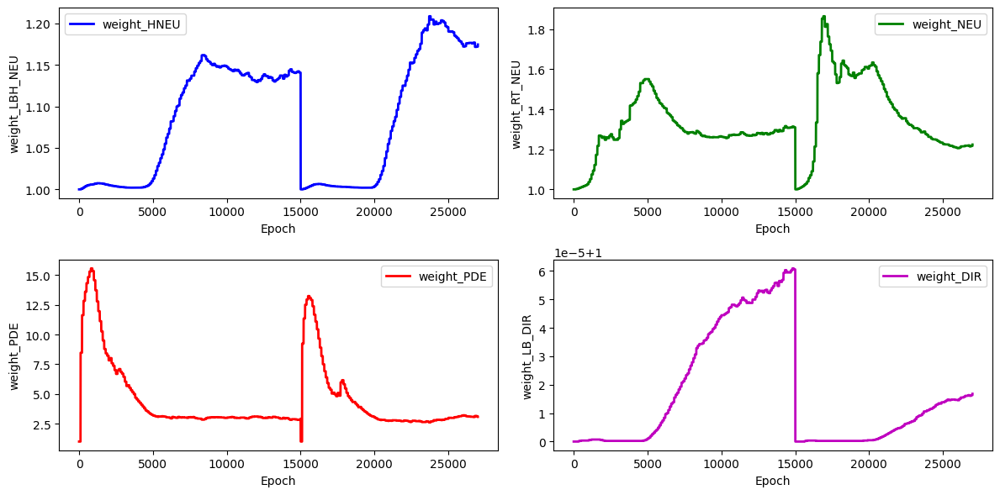

stress_Error for the stress_hole is: 8.365012310409671


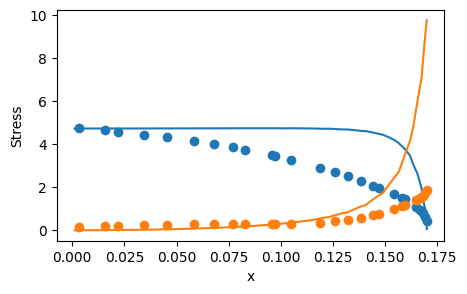

 81%|████████  | 12100/15000 [4:49:52<17:39,  2.74it/s]

for weight 0 norm_grad: 108.43901062011719
for weight 0 new lamda dach: 1.141457438468933
for weight 0 new lamdaloss norm: 123.77850341796875
for weight 1 norm_grad: 142.3310089111328
for weight 1 new lamda dach: 1.1942576169967651
for weight 1 new lamdaloss norm: 169.97988891601562
for weight 2 norm_grad: 624.2398681640625
for weight 2 new lamda dach: 3.489161968231201
for weight 2 new lamdaloss norm: 2178.07373046875
for weight 3 norm_grad: 0.013101134449243546
for weight 3 new lamda dach: 1.0000150203704834
for weight 3 new lamdaloss norm: 0.013101330026984215
for weight 0 new weight_value: 1.1711199283599854
for weight 1 new weight_value: 1.2208644151687622
for weight 2 new weight_value: 3.117948293685913
for weight 3 new weight_value: 1.0000165700912476


 81%|████████▏ | 12200/15000 [4:50:27<17:12,  2.71it/s]

for weight 0 norm_grad: 101.21737670898438
for weight 0 new lamda dach: 1.1285392045974731
for weight 0 new lamdaloss norm: 114.227783203125
for weight 1 norm_grad: 142.0668487548828
for weight 1 new lamda dach: 1.190286636352539
for weight 1 new lamdaloss norm: 169.1002655029297
for weight 2 norm_grad: 645.3626098632812
for weight 2 new lamda dach: 3.652561902999878
for weight 2 new lamdaloss norm: 2357.226806640625
for weight 3 norm_grad: 0.01358216442167759
for weight 3 new lamda dach: 1.0000152587890625
for weight 3 new lamdaloss norm: 0.013582371175289154
for weight 0 new weight_value: 1.1668617725372314
for weight 1 new weight_value: 1.2178065776824951
for weight 2 new weight_value: 3.1714096069335938
for weight 3 new weight_value: 1.000016450881958


 82%|████████▏ | 12300/15000 [4:51:03<16:25,  2.74it/s]

for weight 0 norm_grad: 102.64781188964844
for weight 0 new lamda dach: 1.1519253253936768
for weight 0 new lamdaloss norm: 118.24261474609375
for weight 1 norm_grad: 146.26580810546875
for weight 1 new lamda dach: 1.231422781944275
for weight 1 new lamdaloss norm: 180.1150665283203
for weight 2 norm_grad: 529.3670043945312
for weight 2 new lamda dach: 3.1265926361083984
for weight 2 new lamdaloss norm: 1655.114990234375
for weight 3 norm_grad: 0.01364966668188572
for weight 3 new lamda dach: 1.000017523765564
for weight 3 new lamdaloss norm: 0.01364990510046482
for weight 0 new weight_value: 1.1653680801391602
for weight 1 new weight_value: 1.2191681861877441
for weight 2 new weight_value: 3.1669278144836426
for weight 3 new weight_value: 1.000016450881958


 83%|████████▎ | 12400/15000 [4:51:39<16:03,  2.70it/s]

for weight 0 norm_grad: 101.3341293334961
for weight 0 new lamda dach: 1.1824251413345337
for weight 0 new lamdaloss norm: 119.82002258300781
for weight 1 norm_grad: 132.8870849609375
for weight 1 new lamda dach: 1.253635048866272
for weight 1 new lamdaloss norm: 166.59190368652344
for weight 2 norm_grad: 422.58270263671875
for weight 2 new lamda dach: 2.8040990829467773
for weight 2 new lamdaloss norm: 1184.9638671875
for weight 3 norm_grad: 0.013491984456777573
for weight 3 new lamda dach: 1.0000205039978027
for weight 3 new lamdaloss norm: 0.013492261059582233
for weight 0 new weight_value: 1.1670737266540527
for weight 1 new weight_value: 1.2226147651672363
for weight 2 new weight_value: 3.1306447982788086
for weight 3 new weight_value: 1.0000168085098267


 83%|████████▎ | 12499/15000 [4:52:14<14:47,  2.82it/s]

for weight 0 norm_grad: 105.98468017578125
for weight 0 new lamda dach: 1.1707634925842285
for weight 0 new lamdaloss norm: 124.08300018310547
for weight 1 norm_grad: 140.6586151123047
for weight 1 new lamda dach: 1.2400407791137695
for weight 1 new lamdaloss norm: 174.42242431640625
for weight 2 norm_grad: 479.9803161621094
for weight 2 new lamda dach: 2.9459481239318848
for weight 2 new lamdaloss norm: 1413.9970703125
for weight 3 norm_grad: 0.01297825388610363
for weight 3 new lamda dach: 1.0000178813934326
for weight 3 new lamdaloss norm: 0.01297848578542471
for weight 0 new weight_value: 1.1674426794052124
for weight 1 new weight_value: 1.2243573665618896
for weight 2 new weight_value: 3.1121749877929688
for weight 3 new weight_value: 1.0000169277191162
total_loss: 0.3624000549316406, hole_loss:  0.12971484661102295,neumann_loss:  0.12183357775211334, pde_loss: 0.10547331720590591,dirichlet_loss: 9.985549695556983e-06


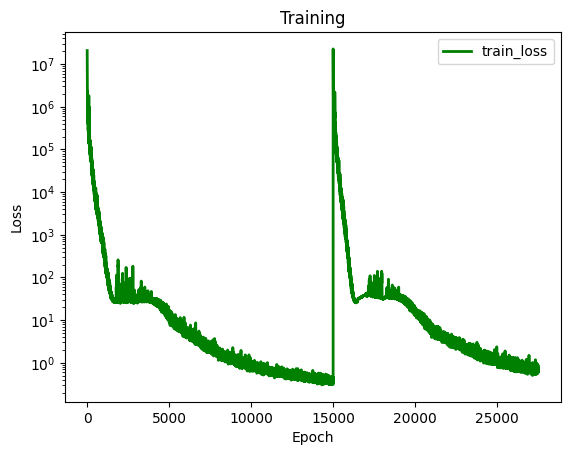

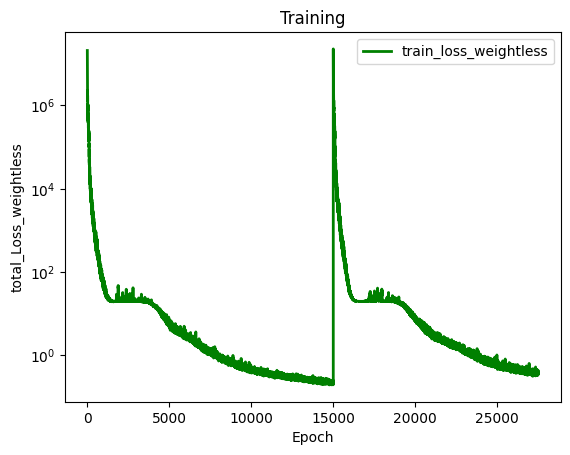

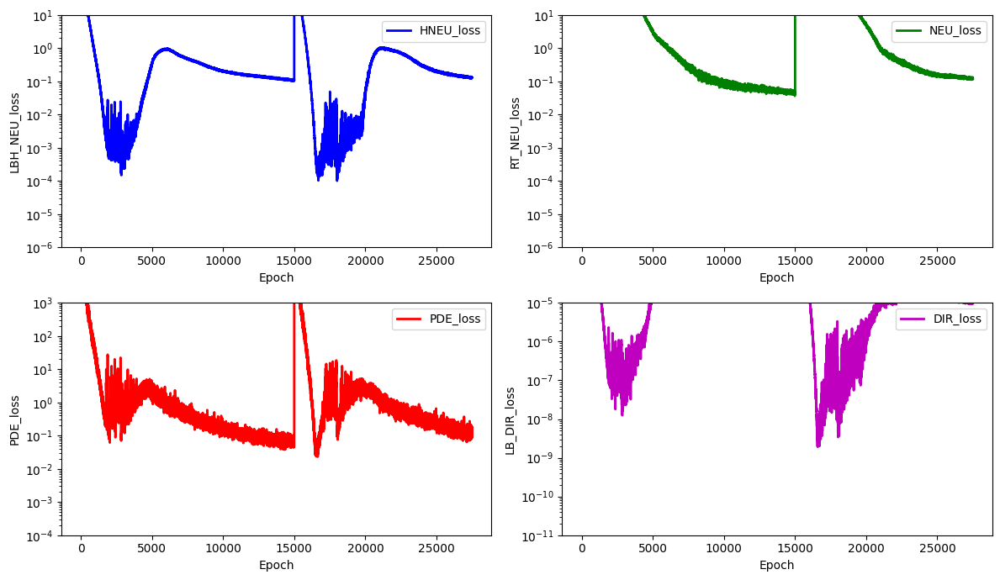

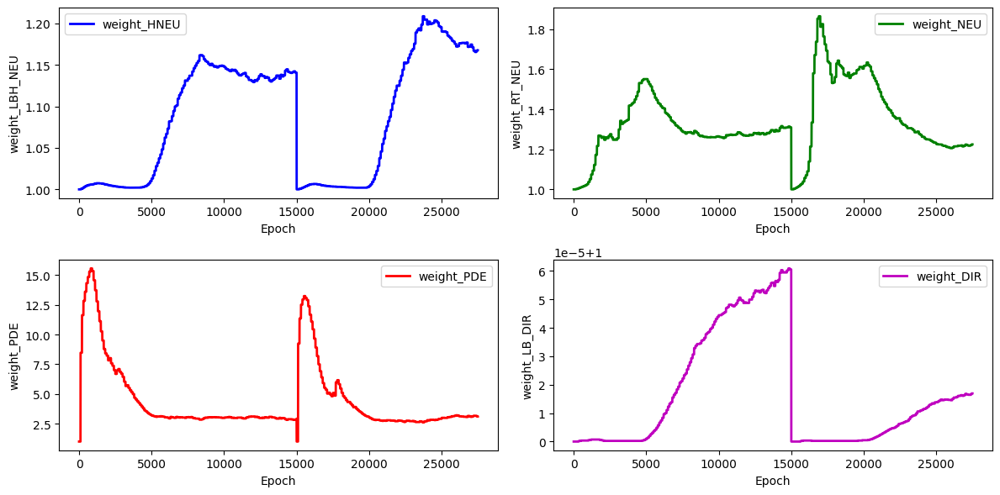

stress_Error for the stress_hole is: 8.317014341252392


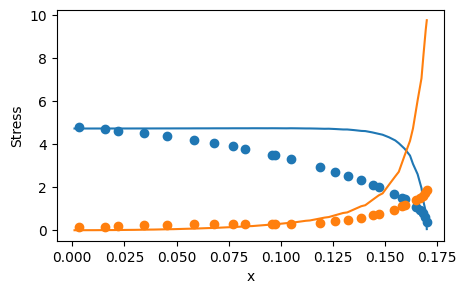

 84%|████████▍ | 12600/15000 [4:52:53<14:34,  2.74it/s]

for weight 0 norm_grad: 102.40167236328125
for weight 0 new lamda dach: 1.1625604629516602
for weight 0 new lamdaloss norm: 119.04812622070312
for weight 1 norm_grad: 145.0640411376953
for weight 1 new lamda dach: 1.247015357017517
for weight 1 new lamdaloss norm: 180.89707946777344
for weight 2 norm_grad: 484.852783203125
for weight 2 new lamda dach: 2.9591712951660156
for weight 2 new lamdaloss norm: 1434.762451171875
for weight 3 norm_grad: 0.012796416878700256
for weight 3 new lamda dach: 1.000017523765564
for weight 3 new lamdaloss norm: 0.012796641327440739
for weight 0 new weight_value: 1.1669543981552124
for weight 1 new weight_value: 1.2266230583190918
for weight 2 new weight_value: 3.096874475479126
for weight 3 new weight_value: 1.0000169277191162


 85%|████████▍ | 12700/15000 [4:53:29<14:04,  2.72it/s]

for weight 0 norm_grad: 95.72361755371094
for weight 0 new lamda dach: 1.1529273986816406
for weight 0 new lamdaloss norm: 110.36239624023438
for weight 1 norm_grad: 135.73458862304688
for weight 1 new lamda dach: 1.231656551361084
for weight 1 new lamdaloss norm: 167.1783905029297
for weight 2 norm_grad: 490.1941223144531
for weight 2 new lamda dach: 3.11773419380188
for weight 2 new lamdaloss norm: 1528.294921875
for weight 3 norm_grad: 0.012837941758334637
for weight 3 new lamda dach: 1.000017762184143
for weight 3 new lamdaloss norm: 0.012838169932365417
for weight 0 new weight_value: 1.1655516624450684
for weight 1 new weight_value: 1.2271263599395752
for weight 2 new weight_value: 3.0989603996276855
for weight 3 new weight_value: 1.0000170469284058


 85%|████████▌ | 12800/15000 [4:54:06<13:36,  2.69it/s]

for weight 0 norm_grad: 96.47622680664062
for weight 0 new lamda dach: 1.176995038986206
for weight 0 new lamdaloss norm: 113.55204010009766
for weight 1 norm_grad: 133.89559936523438
for weight 1 new lamda dach: 1.263750672340393
for weight 1 new lamdaloss norm: 169.21066284179688
for weight 2 norm_grad: 411.1701965332031
for weight 2 new lamda dach: 2.7847087383270264
for weight 2 new lamdaloss norm: 1144.9892578125
for weight 3 norm_grad: 0.013217817060649395
for weight 3 new lamda dach: 1.0000206232070923
for weight 3 new lamdaloss norm: 0.013218089938163757
for weight 0 new weight_value: 1.1666959524154663
for weight 1 new weight_value: 1.2307888269424438
for weight 2 new weight_value: 3.067534923553467
for weight 3 new weight_value: 1.0000174045562744


 86%|████████▌ | 12900/15000 [4:54:42<13:17,  2.63it/s]

for weight 0 norm_grad: 90.59107208251953
for weight 0 new lamda dach: 1.1492877006530762
for weight 0 new lamdaloss norm: 104.11520385742188
for weight 1 norm_grad: 132.22128295898438
for weight 1 new lamda dach: 1.2339403629302979
for weight 1 new lamdaloss norm: 163.15316772460938
for weight 2 norm_grad: 474.58868408203125
for weight 2 new lamda dach: 3.129875659942627
for weight 2 new lamdaloss norm: 1485.4034423828125
for weight 3 norm_grad: 0.012255383655428886
for weight 3 new lamda dach: 1.0000176429748535
for weight 3 new lamdaloss norm: 0.012255600653588772
for weight 0 new weight_value: 1.1649550199508667
for weight 1 new weight_value: 1.2311038970947266
for weight 2 new weight_value: 3.0737688541412354
for weight 3 new weight_value: 1.0000174045562744


 87%|████████▋ | 12999/15000 [4:55:18<12:04,  2.76it/s]

for weight 0 norm_grad: 100.21000671386719
for weight 0 new lamda dach: 1.1415282487869263
for weight 0 new lamdaloss norm: 114.3925552368164
for weight 1 norm_grad: 132.3299102783203
for weight 1 new lamda dach: 1.195772647857666
for weight 1 new lamdaloss norm: 158.2364959716797
for weight 2 norm_grad: 575.7139892578125
for weight 2 new lamda dach: 3.4756295680999756
for weight 2 new lamdaloss norm: 2000.968505859375
for weight 3 norm_grad: 0.012652573175728321
for weight 3 new lamda dach: 1.0000156164169312
for weight 3 new lamdaloss norm: 0.012652771547436714
for weight 0 new weight_value: 1.1626123189926147
for weight 1 new weight_value: 1.2275707721710205
for weight 2 new weight_value: 3.113955020904541
for weight 3 new weight_value: 1.0000171661376953
total_loss: 0.4120229184627533, hole_loss:  0.12311749160289764,neumann_loss:  0.11070238053798676, pde_loss: 0.1544494330883026,dirichlet_loss: 9.6823296189541e-06


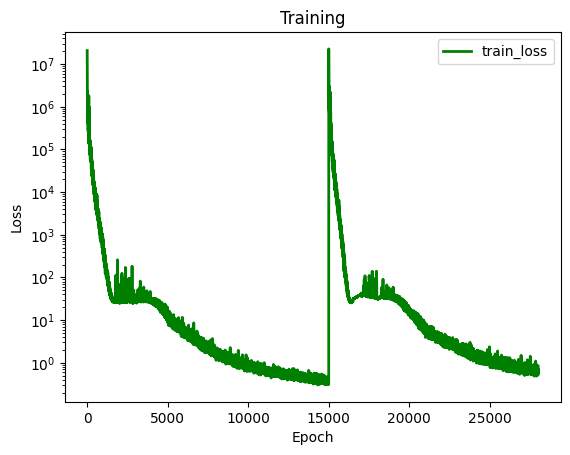

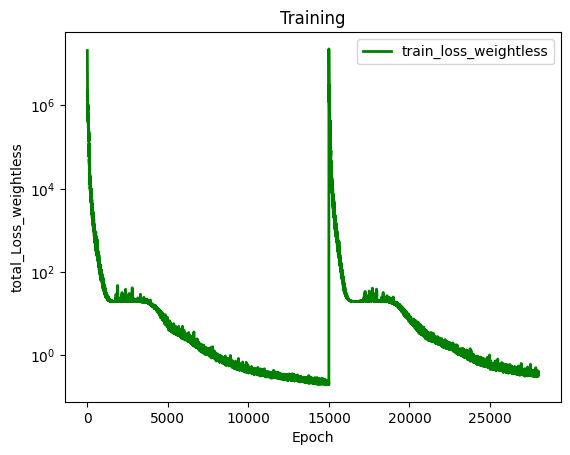

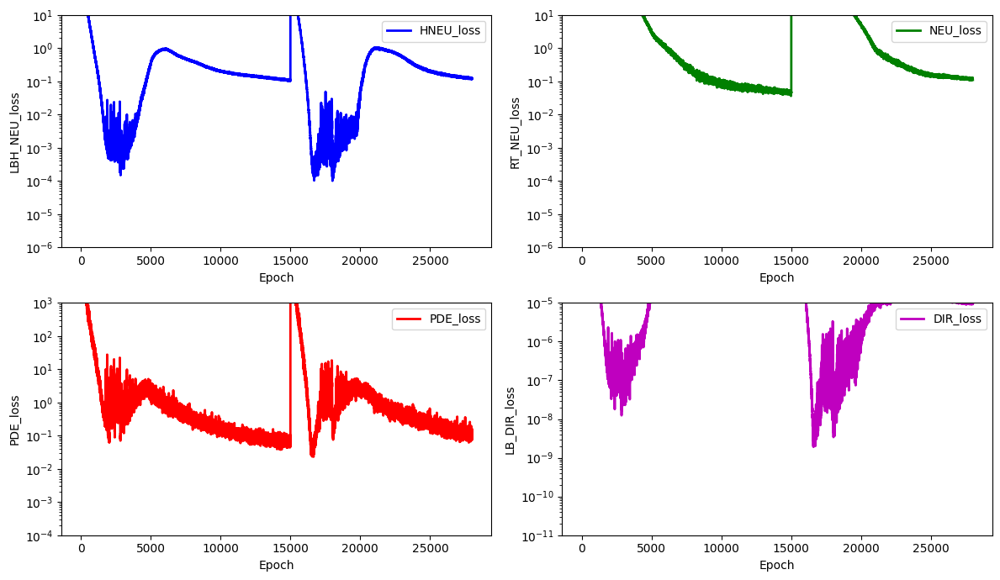

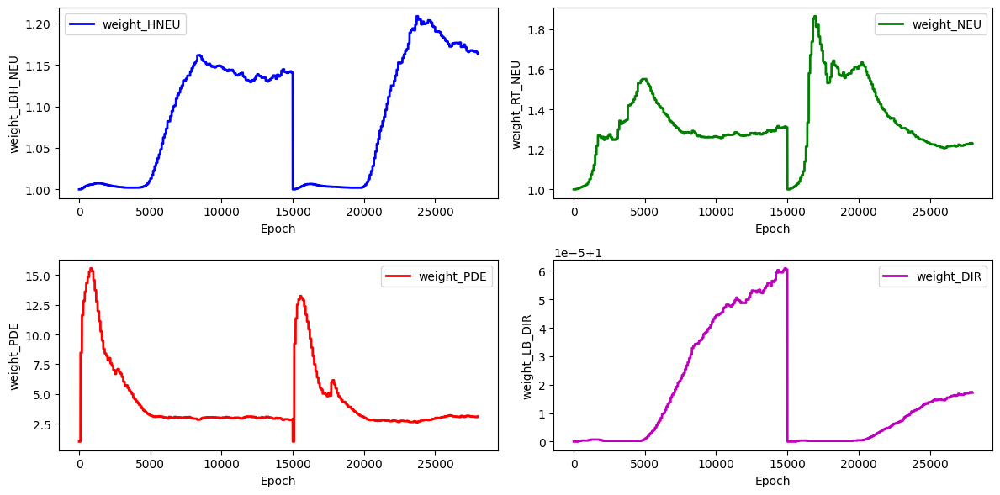

stress_Error for the stress_hole is: 8.267561358088237


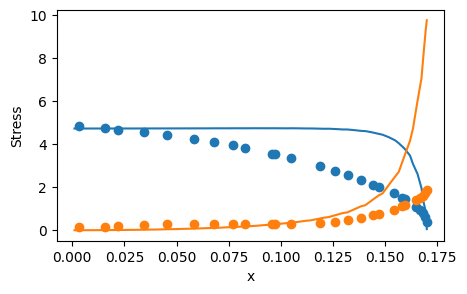

 87%|████████▋ | 13100/15000 [4:55:57<11:59,  2.64it/s]

for weight 0 norm_grad: 96.4554672241211
for weight 0 new lamda dach: 1.1986287832260132
for weight 0 new lamdaloss norm: 115.61430358886719
for weight 1 norm_grad: 130.96194458007812
for weight 1 new lamda dach: 1.2903168201446533
for weight 1 new lamdaloss norm: 168.98239135742188
for weight 2 norm_grad: 354.6319580078125
for weight 2 new lamda dach: 2.5593008995056152
for weight 2 new lamdaloss norm: 907.6099243164062
for weight 3 norm_grad: 0.012706361711025238
for weight 3 new lamda dach: 1.0000218152999878
for weight 3 new lamdaloss norm: 0.012706638313829899
for weight 0 new weight_value: 1.1662139892578125
for weight 1 new weight_value: 1.2338453531265259
for weight 2 new weight_value: 3.0584895610809326
for weight 3 new weight_value: 1.0000176429748535


 88%|████████▊ | 13200/15000 [4:56:34<11:01,  2.72it/s]

for weight 0 norm_grad: 89.49008178710938
for weight 0 new lamda dach: 1.1527179479599
for weight 0 new lamdaloss norm: 103.15681457519531
for weight 1 norm_grad: 133.174072265625
for weight 1 new lamda dach: 1.2455732822418213
for weight 1 new lamdaloss norm: 165.87806701660156
for weight 2 norm_grad: 452.79595947265625
for weight 2 new lamda dach: 3.0334227085113525
for weight 2 new lamdaloss norm: 1373.521484375
for weight 3 norm_grad: 0.012631746008992195
for weight 3 new lamda dach: 1.0000187158584595
for weight 3 new lamdaloss norm: 0.012631982564926147
for weight 0 new weight_value: 1.164864420890808
for weight 1 new weight_value: 1.2350181341171265
for weight 2 new weight_value: 3.055982828140259
for weight 3 new weight_value: 1.0000176429748535


 89%|████████▊ | 13300/15000 [4:57:11<10:44,  2.64it/s]

for weight 0 norm_grad: 99.37016296386719
for weight 0 new lamda dach: 1.1432191133499146
for weight 0 new lamdaloss norm: 113.60186004638672
for weight 1 norm_grad: 133.43272399902344
for weight 1 new lamda dach: 1.202241063117981
for weight 1 new lamdaloss norm: 160.41830444335938
for weight 2 norm_grad: 560.3884887695312
for weight 2 new lamda dach: 3.4070112705230713
for weight 2 new lamdaloss norm: 1909.2498779296875
for weight 3 norm_grad: 0.012137838639318943
for weight 3 new lamda dach: 1.0000152587890625
for weight 3 new lamdaloss norm: 0.012138023972511292
for weight 0 new weight_value: 1.1626999378204346
for weight 1 new weight_value: 1.2317403554916382
for weight 2 new weight_value: 3.09108567237854
for weight 3 new weight_value: 1.0000174045562744


 89%|████████▉ | 13400/15000 [4:57:47<09:50,  2.71it/s]

for weight 0 norm_grad: 96.2511215209961
for weight 0 new lamda dach: 1.1741315126419067
for weight 0 new lamdaloss norm: 113.01146697998047
for weight 1 norm_grad: 134.5317840576172
for weight 1 new lamda dach: 1.2614965438842773
for weight 1 new lamdaloss norm: 169.7113800048828
for weight 2 norm_grad: 418.2056884765625
for weight 2 new lamda dach: 2.8120229244232178
for weight 2 new lamdaloss norm: 1176.0040283203125
for weight 3 norm_grad: 0.012031246908009052
for weight 3 new lamda dach: 1.0000184774398804
for weight 3 new lamdaloss norm: 0.012031469494104385
for weight 0 new weight_value: 1.163843035697937
for weight 1 new weight_value: 1.2347159385681152
for weight 2 new weight_value: 3.0631792545318604
for weight 3 new weight_value: 1.000017523765564


 90%|████████▉ | 13499/15000 [4:58:24<09:15,  2.70it/s]

for weight 0 norm_grad: 95.84766387939453
for weight 0 new lamda dach: 1.2255563735961914
for weight 0 new lamdaloss norm: 117.46671295166016
for weight 1 norm_grad: 131.38999938964844
for weight 1 new lamda dach: 1.3374195098876953
for weight 1 new lamdaloss norm: 175.7235565185547
for weight 2 norm_grad: 293.53668212890625
for weight 2 new lamda dach: 2.291691303253174
for weight 2 new lamdaloss norm: 672.6954956054688
for weight 3 norm_grad: 0.012177027761936188
for weight 3 new lamda dach: 1.0000234842300415
for weight 3 new lamdaloss norm: 0.01217731460928917
for weight 0 new weight_value: 1.1700142621994019
for weight 1 new weight_value: 1.2449862957000732
for weight 2 new weight_value: 2.986030340194702
for weight 3 new weight_value: 1.0000181198120117
total_loss: 0.29128098487854004, hole_loss:  0.11983831971883774,neumann_loss:  0.10960087180137634, pde_loss: 0.061656415462493896,dirichlet_loss: 9.529117050988134e-06


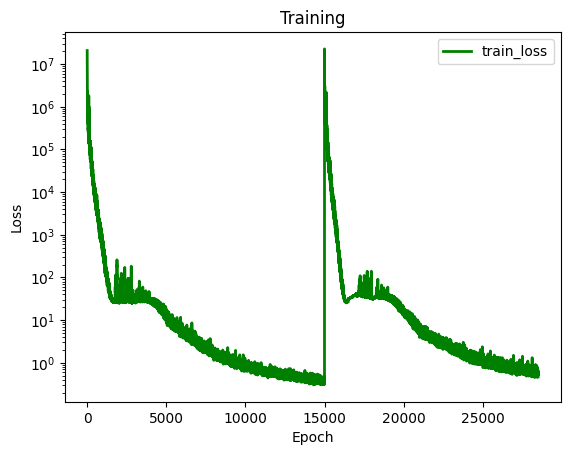

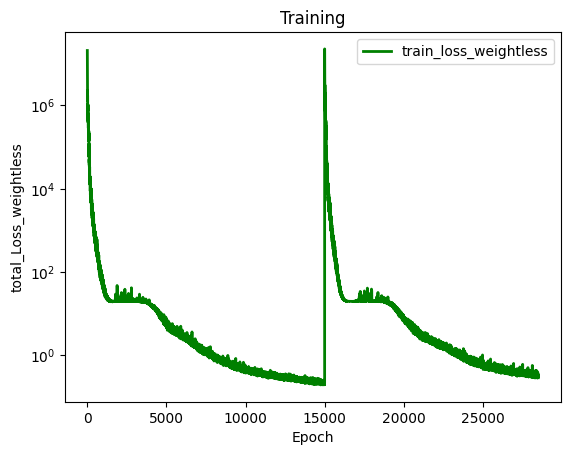

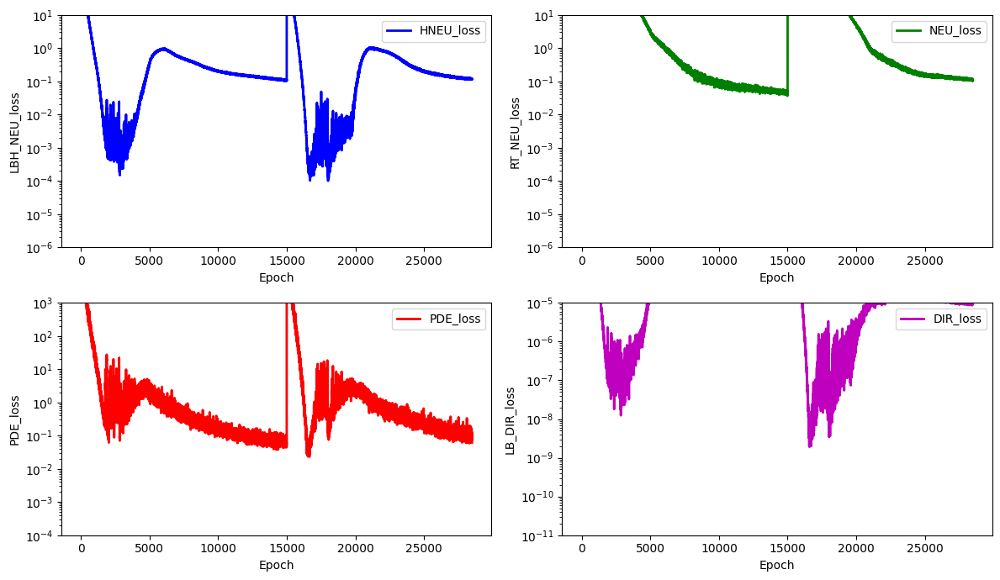

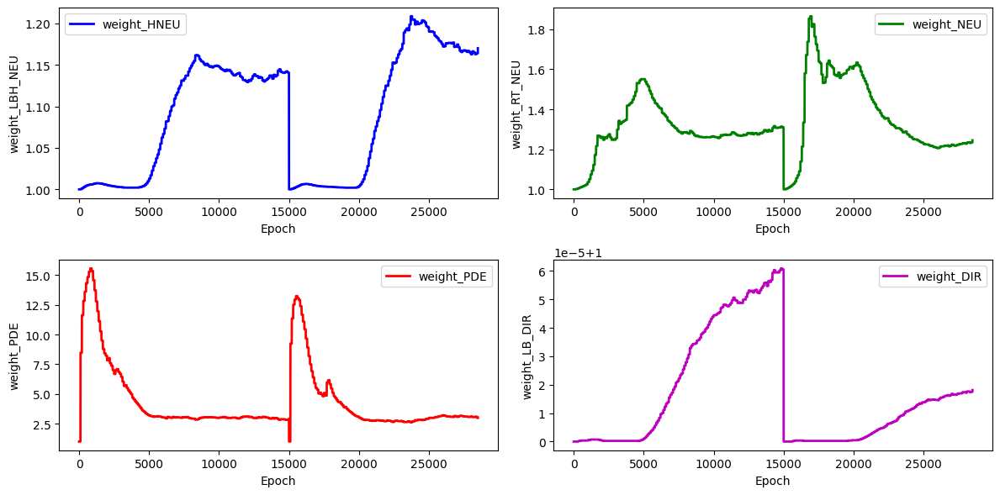

stress_Error for the stress_hole is: 8.245507947056122


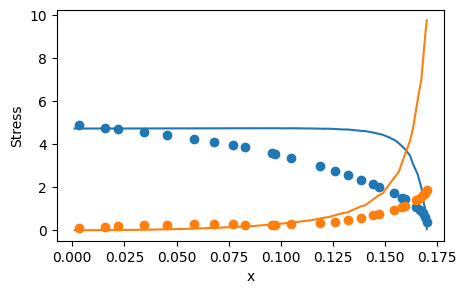

 91%|█████████ | 13600/15000 [4:59:03<08:42,  2.68it/s]

for weight 0 norm_grad: 93.16798400878906
for weight 0 new lamda dach: 1.1724183559417725
for weight 0 new lamdaloss norm: 109.23185729980469
for weight 1 norm_grad: 132.72325134277344
for weight 1 new lamda dach: 1.2650201320648193
for weight 1 new lamdaloss norm: 167.8975830078125
for weight 2 norm_grad: 407.6236877441406
for weight 2 new lamda dach: 2.804410457611084
for weight 2 new lamdaloss norm: 1143.14404296875
for weight 3 norm_grad: 0.012848228216171265
for weight 3 new lamda dach: 1.0000203847885132
for weight 3 new lamdaloss norm: 0.012848489917814732
for weight 0 new weight_value: 1.1702547073364258
for weight 1 new weight_value: 1.2469897270202637
for weight 2 new weight_value: 2.9678683280944824
for weight 3 new weight_value: 1.0000183582305908


 91%|█████████▏| 13700/15000 [4:59:39<08:02,  2.69it/s]

for weight 0 norm_grad: 90.29180908203125
for weight 0 new lamda dach: 1.1627827882766724
for weight 0 new lamdaloss norm: 104.98974609375
for weight 1 norm_grad: 129.16648864746094
for weight 1 new lamda dach: 1.250418782234192
for weight 1 new lamdaloss norm: 161.51219177246094
for weight 2 norm_grad: 425.4983825683594
for weight 2 new lamda dach: 2.938754081726074
for weight 2 new lamdaloss norm: 1250.4351806640625
for weight 3 norm_grad: 0.01174478605389595
for weight 3 new lamda dach: 1.0000181198120117
for weight 3 new lamdaloss norm: 0.011744998395442963
for weight 0 new weight_value: 1.1695075035095215
for weight 1 new weight_value: 1.2473325729370117
for weight 2 new weight_value: 2.9649569988250732
for weight 3 new weight_value: 1.0000183582305908


 92%|█████████▏| 13800/15000 [5:00:15<07:28,  2.68it/s]

for weight 0 norm_grad: 88.4381332397461
for weight 0 new lamda dach: 1.1953885555267334
for weight 0 new lamdaloss norm: 105.71794128417969
for weight 1 norm_grad: 129.45851135253906
for weight 1 new lamda dach: 1.3145198822021484
for weight 1 new lamdaloss norm: 170.17578125
for weight 2 norm_grad: 323.15643310546875
for weight 2 new lamda dach: 2.48298978805542
for weight 2 new lamdaloss norm: 802.39404296875
for weight 3 norm_grad: 0.012064055539667606
for weight 3 new lamda dach: 1.000022292137146
for weight 3 new lamdaloss norm: 0.012064323760569096
for weight 0 new weight_value: 1.1720956563949585
for weight 1 new weight_value: 1.2540512084960938
for weight 2 new weight_value: 2.916760206222534
for weight 3 new weight_value: 1.0000187158584595


 93%|█████████▎| 13900/15000 [5:00:51<06:43,  2.72it/s]

for weight 0 norm_grad: 93.04744720458984
for weight 0 new lamda dach: 1.1688644886016846
for weight 0 new lamdaloss norm: 108.75985717773438
for weight 1 norm_grad: 131.22891235351562
for weight 1 new lamda dach: 1.2558881044387817
for weight 1 new lamdaloss norm: 164.80882263183594
for weight 2 norm_grad: 419.77691650390625
for weight 2 new lamda dach: 2.871589422225952
for weight 2 new lamdaloss norm: 1205.427001953125
for weight 3 norm_grad: 0.01264214888215065
for weight 3 new lamda dach: 1.0000196695327759
for weight 3 new lamdaloss norm: 0.012642397545278072
for weight 0 new weight_value: 1.1717725992202759
for weight 1 new weight_value: 1.254234790802002
for weight 2 new weight_value: 2.912243127822876
for weight 3 new weight_value: 1.000018835067749


 93%|█████████▎| 13999/15000 [5:01:27<05:58,  2.79it/s]

for weight 0 norm_grad: 87.7925796508789
for weight 0 new lamda dach: 1.1408114433288574
for weight 0 new lamdaloss norm: 100.15478515625
for weight 1 norm_grad: 130.5310821533203
for weight 1 new lamda dach: 1.2247676849365234
for weight 1 new lamdaloss norm: 159.8702392578125
for weight 2 norm_grad: 492.933349609375
for weight 2 new lamda dach: 3.2576894760131836
for weight 2 new lamdaloss norm: 1605.8238525390625
for weight 3 norm_grad: 0.011681782081723213
for weight 3 new lamda dach: 1.0000163316726685
for weight 3 new lamdaloss norm: 0.011681973934173584
for weight 0 new weight_value: 1.168676495552063
for weight 1 new weight_value: 1.2512880563735962
for weight 2 new weight_value: 2.9467875957489014
for weight 3 new weight_value: 1.00001859664917
total_loss: 0.31138691306114197, hole_loss:  0.1120855063199997,neumann_loss:  0.10948511213064194, pde_loss: 0.08529751002788544,dirichlet_loss: 9.018594937515445e-06


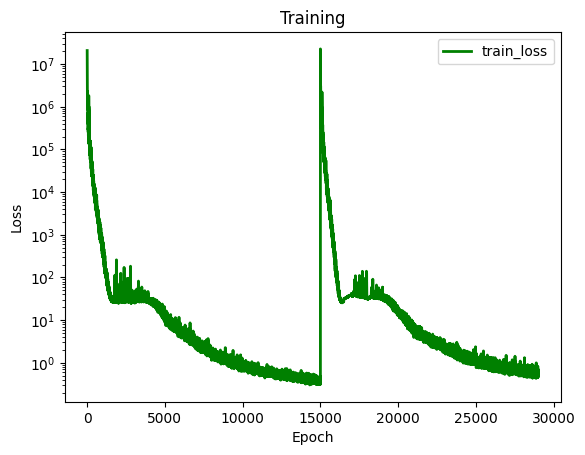

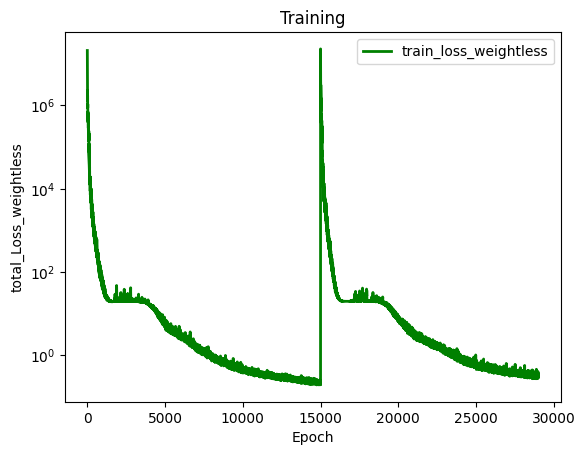

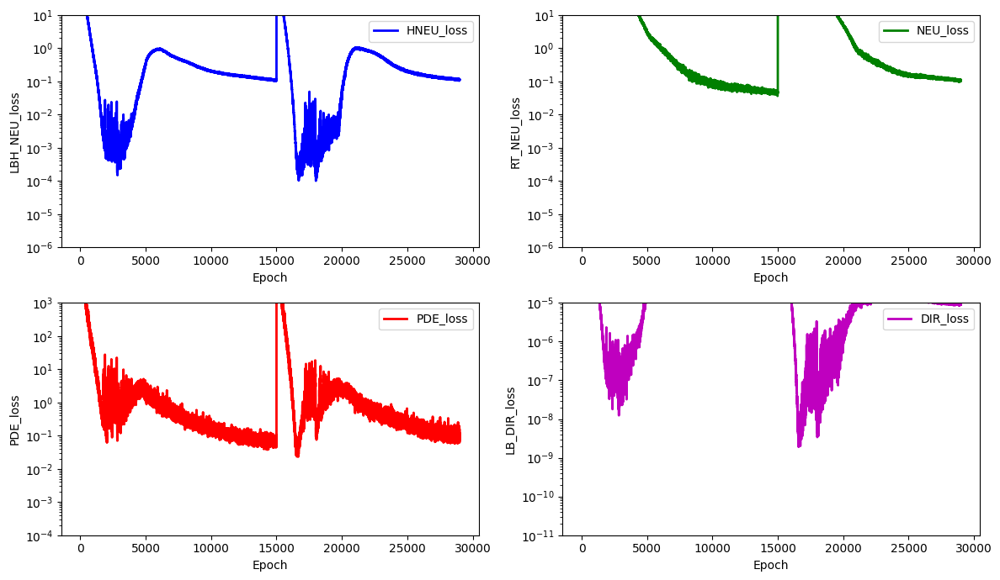

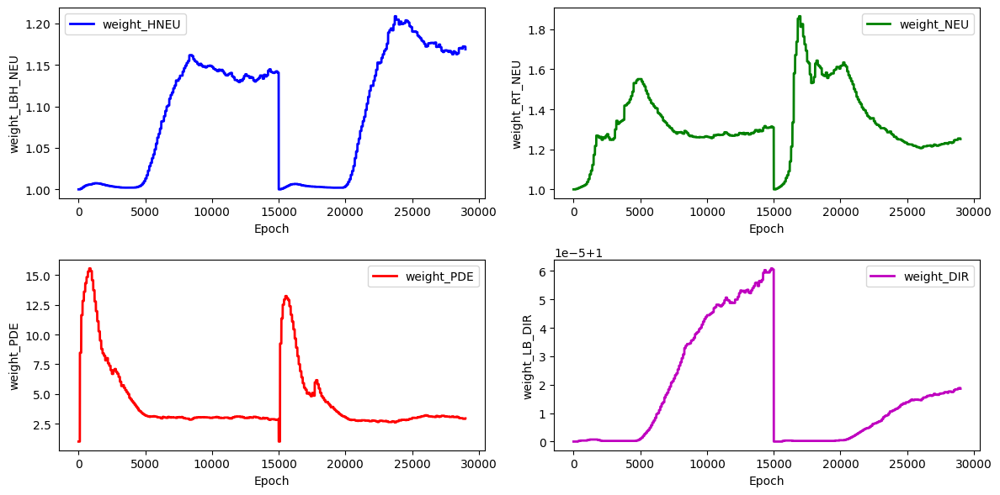

stress_Error for the stress_hole is: 8.293952437423304


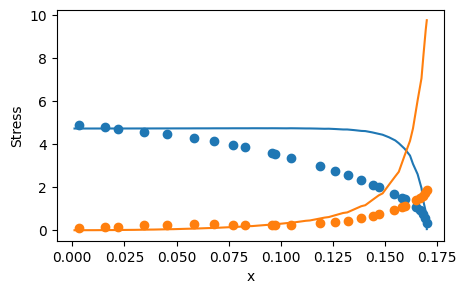

 94%|█████████▍| 14100/15000 [5:02:06<05:30,  2.72it/s]

for weight 0 norm_grad: 90.71122741699219
for weight 0 new lamda dach: 1.1682915687561035
for weight 0 new lamdaloss norm: 105.97715759277344
for weight 1 norm_grad: 130.25440979003906
for weight 1 new lamda dach: 1.2607855796813965
for weight 1 new lamdaloss norm: 164.22286987304688
for weight 2 norm_grad: 408.7459411621094
for weight 2 new lamda dach: 2.849715232849121
for weight 2 new lamdaloss norm: 1164.8095703125
for weight 3 norm_grad: 0.012141518294811249
for weight 3 new lamda dach: 1.0000193119049072
for weight 3 new lamdaloss norm: 0.012141753919422626
for weight 0 new weight_value: 1.168637990951538
for weight 1 new weight_value: 1.2522377967834473
for weight 2 new weight_value: 2.937080144882202
for weight 3 new weight_value: 1.00001859664917


 95%|█████████▍| 14200/15000 [5:02:42<04:58,  2.68it/s]

for weight 0 norm_grad: 88.77608489990234
for weight 0 new lamda dach: 1.1752103567123413
for weight 0 new lamdaloss norm: 104.33057403564453
for weight 1 norm_grad: 129.2589111328125
for weight 1 new lamda dach: 1.277260661125183
for weight 1 new lamdaloss norm: 165.09732055664062
for weight 2 norm_grad: 377.4125061035156
for weight 2 new lamda dach: 2.730881929397583
for weight 2 new lamdaloss norm: 1030.6689453125
for weight 3 norm_grad: 0.011344281025230885
for weight 3 new lamda dach: 1.0000190734863281
for weight 3 new lamdaloss norm: 0.011344497092068195
for weight 0 new weight_value: 1.1692951917648315
for weight 1 new weight_value: 1.2547401189804077
for weight 2 new weight_value: 2.9164602756500244
for weight 3 new weight_value: 1.00001859664917


 95%|█████████▌| 14300/15000 [5:03:18<04:17,  2.71it/s]

for weight 0 norm_grad: 84.55732727050781
for weight 0 new lamda dach: 1.1788541078567505
for weight 0 new lamdaloss norm: 99.68075561523438
for weight 1 norm_grad: 121.35298919677734
for weight 1 new lamda dach: 1.278347373008728
for weight 1 new lamdaloss norm: 155.1312713623047
for weight 2 norm_grad: 351.4078369140625
for weight 2 new lamda dach: 2.706510543823242
for weight 2 new lamdaloss norm: 951.0890502929688
for weight 3 norm_grad: 0.01162258256226778
for weight 3 new lamda dach: 1.0000208616256714
for weight 3 new lamdaloss norm: 0.01162282470613718
for weight 0 new weight_value: 1.1702511310577393
for weight 1 new weight_value: 1.2571008205413818
for weight 2 new weight_value: 2.89546537399292
for weight 3 new weight_value: 1.000018835067749


 96%|█████████▌| 14400/15000 [5:03:54<03:38,  2.74it/s]

for weight 0 norm_grad: 87.22322845458984
for weight 0 new lamda dach: 1.1610912084579468
for weight 0 new lamdaloss norm: 101.27411651611328
for weight 1 norm_grad: 129.0527801513672
for weight 1 new lamda dach: 1.2583004236221313
for weight 1 new lamdaloss norm: 162.38717651367188
for weight 2 norm_grad: 412.3883056640625
for weight 2 new lamda dach: 2.9066691398620605
for weight 2 new lamdaloss norm: 1198.6763916015625
for weight 3 norm_grad: 0.011320766992866993
for weight 3 new lamda dach: 1.0000180006027222
for weight 3 new lamdaloss norm: 0.011320970021188259
for weight 0 new weight_value: 1.169335126876831
for weight 1 new weight_value: 1.25722074508667
for weight 2 new weight_value: 2.896585702896118
for weight 3 new weight_value: 1.0000187158584595


 97%|█████████▋| 14499/15000 [5:04:29<02:57,  2.83it/s]

for weight 0 norm_grad: 89.1844711303711
for weight 0 new lamda dach: 1.135770320892334
for weight 0 new lamdaloss norm: 101.29307556152344
for weight 1 norm_grad: 121.60063934326172
for weight 1 new lamda dach: 1.194728970527649
for weight 1 new lamdaloss norm: 145.27980041503906
for weight 2 norm_grad: 535.2647094726562
for weight 2 new lamda dach: 3.5392425060272217
for weight 2 new lamdaloss norm: 1894.431640625
for weight 3 norm_grad: 0.011922875419259071
for weight 3 new lamda dach: 1.0000159740447998
for weight 3 new lamdaloss norm: 0.011923066340386868
for weight 0 new weight_value: 1.1659785509109497
for weight 1 new weight_value: 1.2509715557098389
for weight 2 new weight_value: 2.9608514308929443
for weight 3 new weight_value: 1.0000184774398804
total_loss: 0.314812034368515, hole_loss:  0.11227528005838394,neumann_loss:  0.09677597880363464, pde_loss: 0.09134487807750702,dirichlet_loss: 9.619086995371617e-06


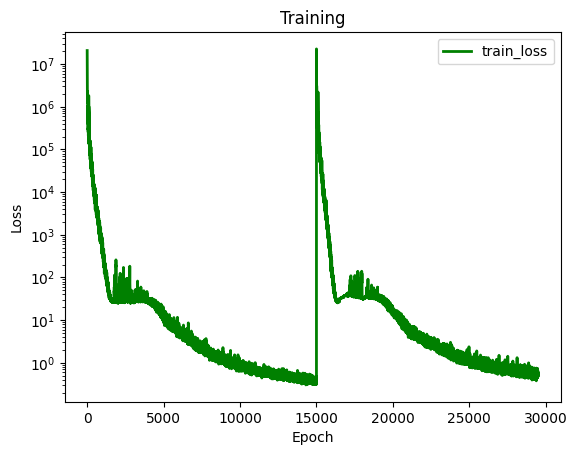

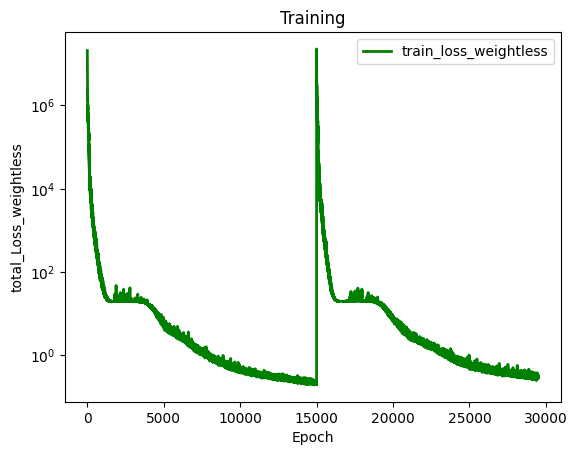

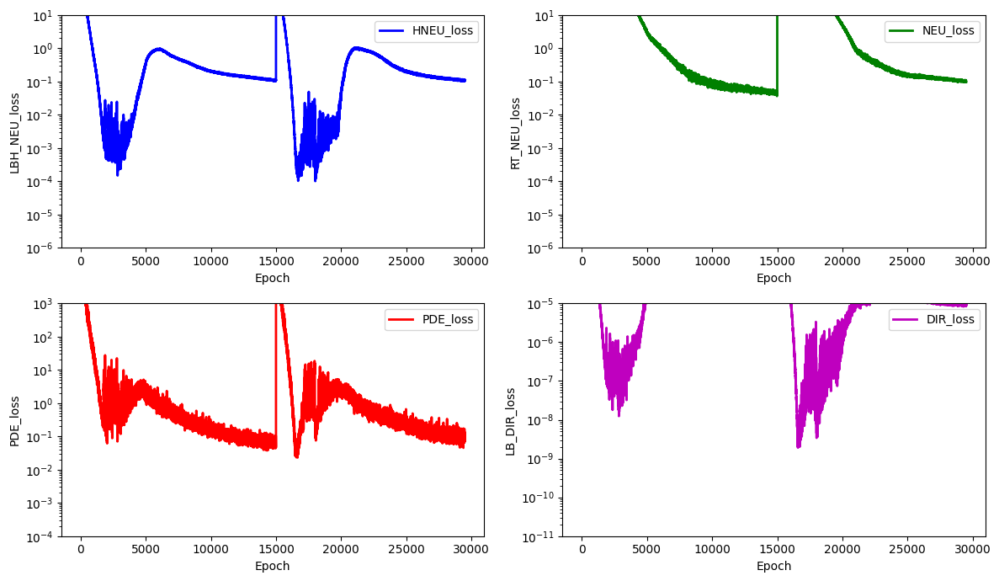

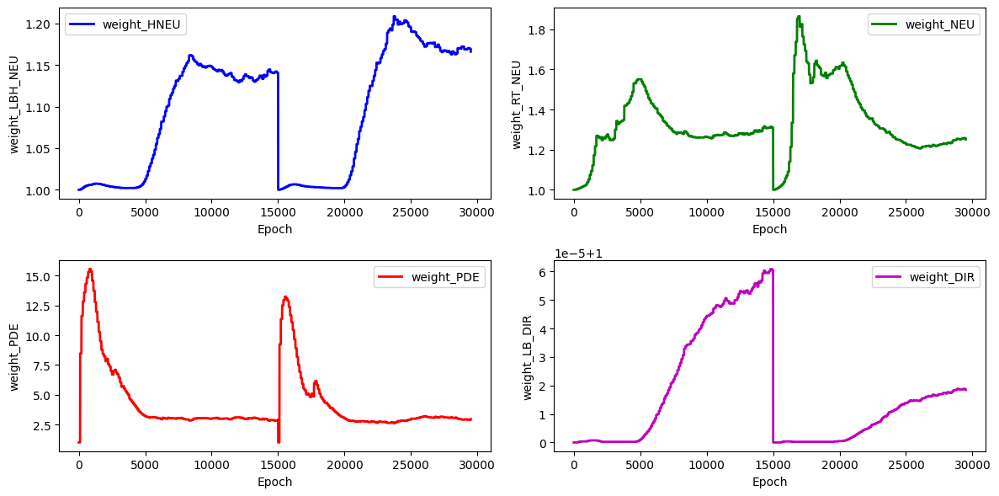

stress_Error for the stress_hole is: 8.220616903108219


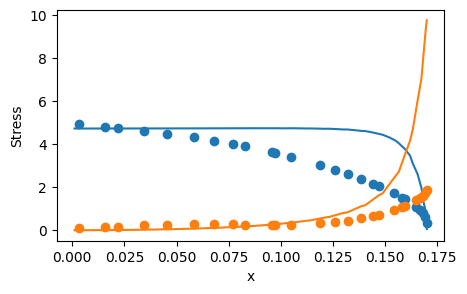

 97%|█████████▋| 14600/15000 [5:05:09<02:30,  2.66it/s]

for weight 0 norm_grad: 85.18220520019531
for weight 0 new lamda dach: 1.1228933334350586
for weight 0 new lamdaloss norm: 95.65052795410156
for weight 1 norm_grad: 123.07504272460938
for weight 1 new lamda dach: 1.1878302097320557
for weight 1 new lamdaloss norm: 146.19224548339844
for weight 2 norm_grad: 570.0520629882812
for weight 2 new lamda dach: 3.7370946407318115
for weight 2 new lamdaloss norm: 2130.338623046875
for weight 3 norm_grad: 0.011805853806436062
for weight 3 new lamda dach: 1.000015139579773
for weight 3 new lamdaloss norm: 0.011806032620370388
for weight 0 new weight_value: 1.1616699695587158
for weight 1 new weight_value: 1.2446573972702026
for weight 2 new weight_value: 3.038475751876831
for weight 3 new weight_value: 1.0000181198120117


 98%|█████████▊| 14700/15000 [5:05:46<01:53,  2.65it/s]

for weight 0 norm_grad: 81.67528533935547
for weight 0 new lamda dach: 1.123576283454895
for weight 0 new lamdaloss norm: 91.76841735839844
for weight 1 norm_grad: 132.83731079101562
for weight 1 new lamda dach: 1.217848777770996
for weight 1 new lamdaloss norm: 161.77577209472656
for weight 2 norm_grad: 528.0822143554688
for weight 2 new lamda dach: 3.4616520404815674
for weight 2 new lamdaloss norm: 1828.0367431640625
for weight 3 norm_grad: 0.010847759433090687
for weight 3 new lamda dach: 1.0000146627426147
for weight 3 new lamdaloss norm: 0.010847917757928371
for weight 0 new weight_value: 1.157860517501831
for weight 1 new weight_value: 1.2419764995574951
for weight 2 new weight_value: 3.0807933807373047
for weight 3 new weight_value: 1.000017762184143


 99%|█████████▊| 14800/15000 [5:06:22<01:15,  2.66it/s]

for weight 0 norm_grad: 84.25212097167969
for weight 0 new lamda dach: 1.1536060571670532
for weight 0 new lamdaloss norm: 97.1937484741211
for weight 1 norm_grad: 133.13143920898438
for weight 1 new lamda dach: 1.2664676904678345
for weight 1 new lamdaloss norm: 168.60665893554688
for weight 2 norm_grad: 415.3524169921875
for weight 2 new lamda dach: 2.910590648651123
for weight 2 new lamdaloss norm: 1208.9208984375
for weight 3 norm_grad: 0.01125110499560833
for weight 3 new lamda dach: 1.000017762184143
for weight 3 new lamdaloss norm: 0.011251304298639297
for weight 0 new weight_value: 1.1574350595474243
for weight 1 new weight_value: 1.2444255352020264
for weight 2 new weight_value: 3.0637729167938232
for weight 3 new weight_value: 1.000017762184143


 99%|█████████▉| 14900/15000 [5:06:59<00:37,  2.67it/s]

for weight 0 norm_grad: 83.74701690673828
for weight 0 new lamda dach: 1.1256126165390015
for weight 0 new lamdaloss norm: 94.26670837402344
for weight 1 norm_grad: 127.62653350830078
for weight 1 new lamda dach: 1.2049142122268677
for weight 1 new lamdaloss norm: 153.77902221679688
for weight 2 norm_grad: 539.070556640625
for weight 2 new lamda dach: 3.550182819366455
for weight 2 new lamdaloss norm: 1913.799072265625
for weight 3 norm_grad: 0.011561793275177479
for weight 3 new lamda dach: 1.000015377998352
for weight 3 new lamdaloss norm: 0.011561972089111805
for weight 0 new weight_value: 1.1542527675628662
for weight 1 new weight_value: 1.2404743432998657
for weight 2 new weight_value: 3.1124138832092285
for weight 3 new weight_value: 1.000017523765564


100%|█████████▉| 14999/15000 [5:07:35<00:00,  2.76it/s]

for weight 0 norm_grad: 80.70886993408203
for weight 0 new lamda dach: 1.123254418373108
for weight 0 new lamdaloss norm: 90.65658569335938
for weight 1 norm_grad: 133.8407745361328
for weight 1 new lamda dach: 1.22244393825531
for weight 1 new lamdaloss norm: 163.61285400390625
for weight 2 norm_grad: 520.9632568359375
for weight 2 new lamda dach: 3.4280476570129395
for weight 2 new lamdaloss norm: 1785.886962890625
for weight 3 norm_grad: 0.010881774127483368
for weight 3 new lamda dach: 1.0000147819519043
for weight 3 new lamdaloss norm: 0.010881934314966202
for weight 0 new weight_value: 1.1511528491973877
for weight 1 new weight_value: 1.2386711835861206
for weight 2 new weight_value: 3.143977165222168
for weight 3 new weight_value: 1.0000172853469849
total_loss: 0.3236745595932007, hole_loss:  0.1056557297706604,neumann_loss:  0.11330528557300568, pde_loss: 0.09831954538822174,dirichlet_loss: 8.405554581258912e-06


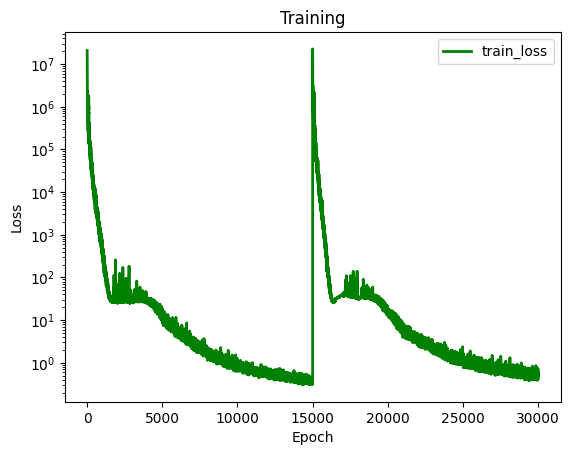

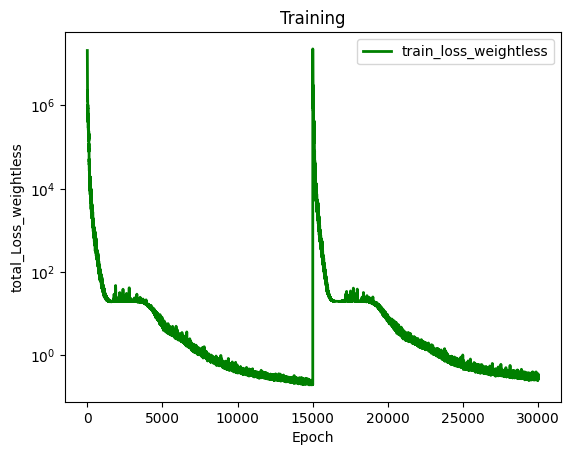

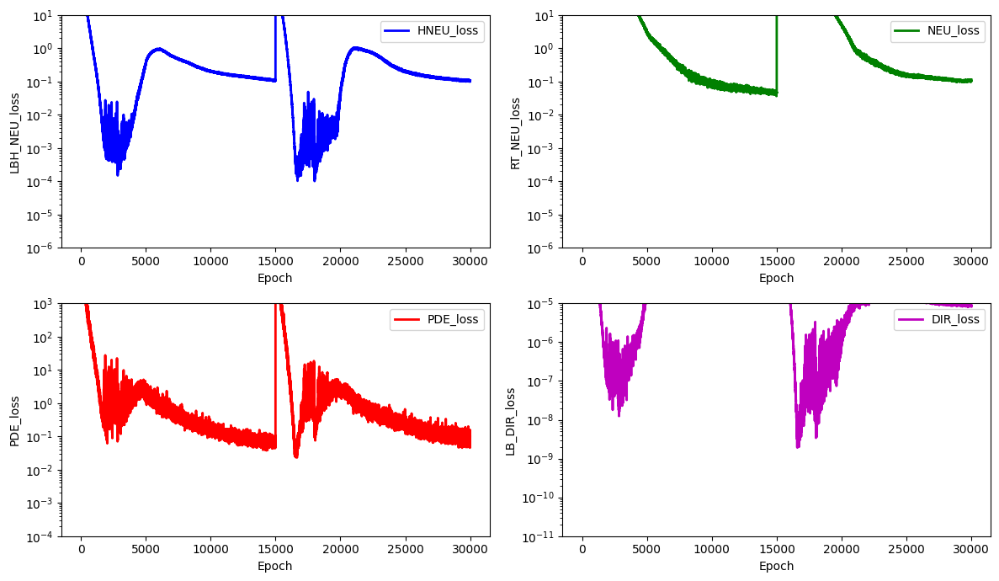

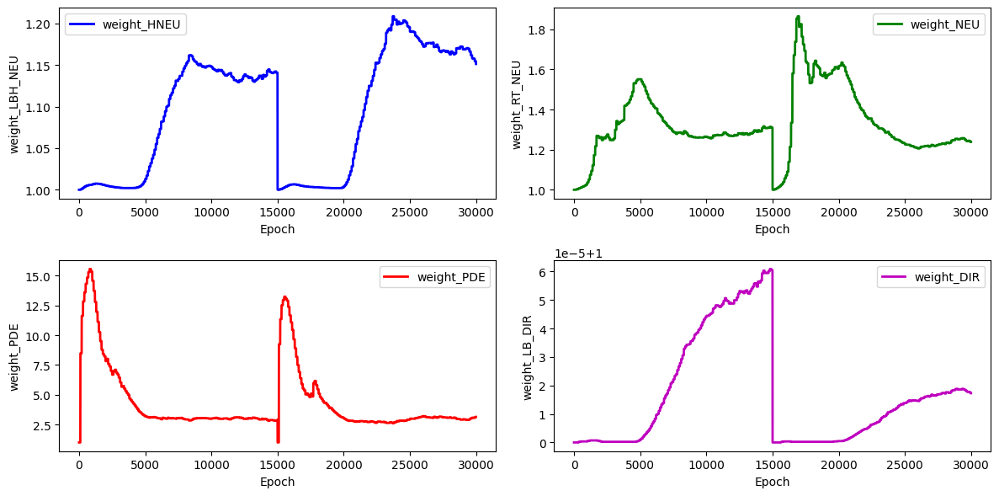

stress_Error for the stress_hole is: 8.274653920493051


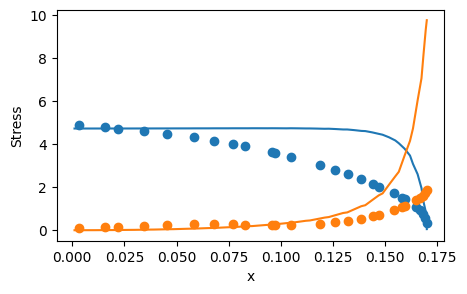

100%|██████████| 15000/15000 [5:07:39<00:00,  1.23s/it]

total_loss: 0.3236745595932007, hole_loss:  0.1056557297706604, neumann_loss:  0.11330528557300568, pde_loss: 0.09831954538822174, dirichlet_loss: 8.405554581258912e-06
previous lowest lost  5
lowest loss 0.5872583985328674 archived, PINN is saved: 'net_param/net_0.17000000.pth


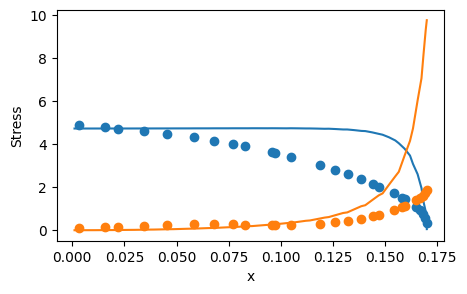

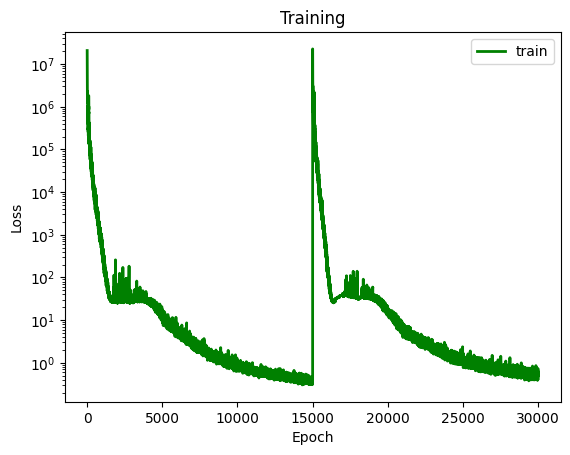

Weight_HNEU: 1.0, Weight_NEU: 1.0, Weight_PDE: 1.0, Weight_STRESS: 1.0, Stress Error: 8.274653920493051
Starting with Adam optimizer...


  1%|          | 100/15000 [00:36<1:34:34,  2.63it/s]

for weight 0 norm_grad: 26334.64453125
for weight 0 new lamda dach: 1.0021998882293701
for weight 0 new lamdaloss norm: 26392.578125
for weight 1 norm_grad: 71443.6796875
for weight 1 new lamda dach: 1.005990743637085
for weight 1 new lamdaloss norm: 71871.6796875
for weight 2 norm_grad: 11899496.0
for weight 2 new lamda dach: 122.69786834716797
for weight 2 new lamdaloss norm: 1460042752.0
for weight 3 norm_grad: 1.0298850536346436
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 1.0298850536346436
for weight 0 new weight_value: 1.0002199411392212
for weight 1 new weight_value: 1.0005990266799927
for weight 2 new weight_value: 13.16978645324707
for weight 3 new weight_value: 1.0


  1%|▏         | 200/15000 [01:13<1:34:22,  2.61it/s]

for weight 0 norm_grad: 6727.162109375
for weight 0 new lamda dach: 1.007341742515564
for weight 0 new lamdaloss norm: 6776.55078125
for weight 1 norm_grad: 14098.158203125
for weight 1 new lamda dach: 1.0155110359191895
for weight 1 new lamdaloss norm: 14316.8349609375
for weight 2 norm_grad: 902188.25
for weight 2 new lamda dach: 44.32106399536133
for weight 2 new lamdaloss norm: 39985944.0
for weight 3 norm_grad: 0.31906089186668396
for weight 3 new lamda dach: 1.0000003576278687
for weight 3 new lamdaloss norm: 0.3190610110759735
for weight 0 new weight_value: 1.0009320974349976
for weight 1 new weight_value: 1.0020902156829834
for weight 2 new weight_value: 16.284914016723633
for weight 3 new weight_value: 1.0


  2%|▏         | 300/15000 [01:50<1:33:01,  2.63it/s]

for weight 0 norm_grad: 4048.84326171875
for weight 0 new lamda dach: 1.0068838596343994
for weight 0 new lamdaloss norm: 4076.71484375
for weight 1 norm_grad: 8697.5390625
for weight 1 new lamda dach: 1.014905571937561
for weight 1 new lamdaloss norm: 8827.1796875
for weight 2 norm_grad: 579461.5
for weight 2 new lamda dach: 46.4602165222168
for weight 2 new lamdaloss norm: 26921908.0
for weight 3 norm_grad: 0.1954827606678009
for weight 3 new lamda dach: 1.0000003576278687
for weight 3 new lamdaloss norm: 0.19548282027244568
for weight 0 new weight_value: 1.001527190208435
for weight 1 new weight_value: 1.0033717155456543
for weight 2 new weight_value: 19.302444458007812
for weight 3 new weight_value: 1.0


  3%|▎         | 400/15000 [02:27<1:33:09,  2.61it/s]

for weight 0 norm_grad: 2717.1044921875
for weight 0 new lamda dach: 1.0085526704788208
for weight 0 new lamdaloss norm: 2740.343017578125
for weight 1 norm_grad: 7648.5927734375
for weight 1 new lamda dach: 1.0244553089141846
for weight 1 new lamdaloss norm: 7835.6416015625
for weight 2 norm_grad: 310041.53125
for weight 2 new lamda dach: 30.91000747680664
for weight 2 new lamdaloss norm: 9583386.0
for weight 3 norm_grad: 0.13050982356071472
for weight 3 new lamda dach: 1.0000003576278687
for weight 3 new lamdaloss norm: 0.1305098682641983
for weight 0 new weight_value: 1.0022296905517578
for weight 1 new weight_value: 1.0054800510406494
for weight 2 new weight_value: 20.46320152282715
for weight 3 new weight_value: 1.0


  3%|▎         | 499/15000 [03:03<1:30:11,  2.68it/s]

for weight 0 norm_grad: 1846.280517578125
for weight 0 new lamda dach: 1.0089094638824463
for weight 0 new lamdaloss norm: 1862.729736328125
for weight 1 norm_grad: 6128.65478515625
for weight 1 new lamda dach: 1.0301988124847412
for weight 1 new lamdaloss norm: 6313.73291015625
for weight 2 norm_grad: 201097.265625
for weight 2 new lamda dach: 26.215858459472656
for weight 2 new lamdaloss norm: 5271937.5
for weight 3 norm_grad: 0.09665891528129578
for weight 3 new lamda dach: 1.0000004768371582
for weight 3 new lamdaloss norm: 0.09665895998477936
for weight 0 new weight_value: 1.0028976202011108
for weight 1 new weight_value: 1.0079518556594849
for weight 2 new weight_value: 21.038467407226562
for weight 3 new weight_value: 1.0
total_loss: 826.78173828125, hole_loss:  11.959078788757324,neumann_loss:  49.30207824707031, pde_loss: 723.2667236328125,dirichlet_loss: 0.0004752238164655864


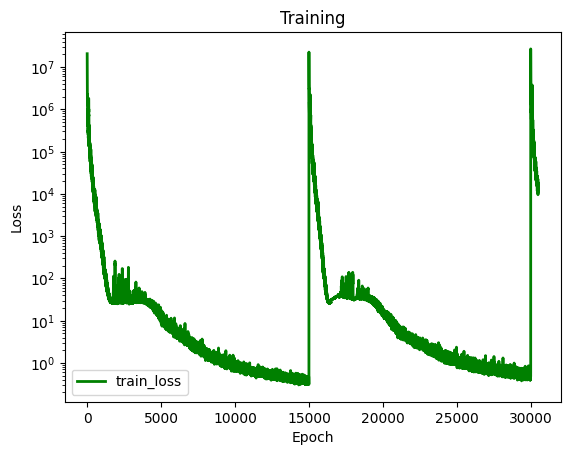

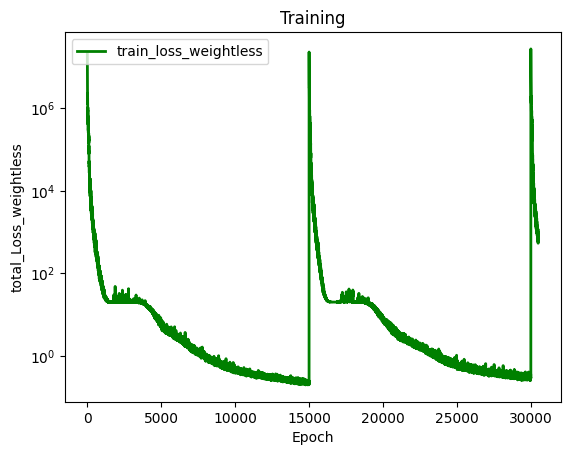

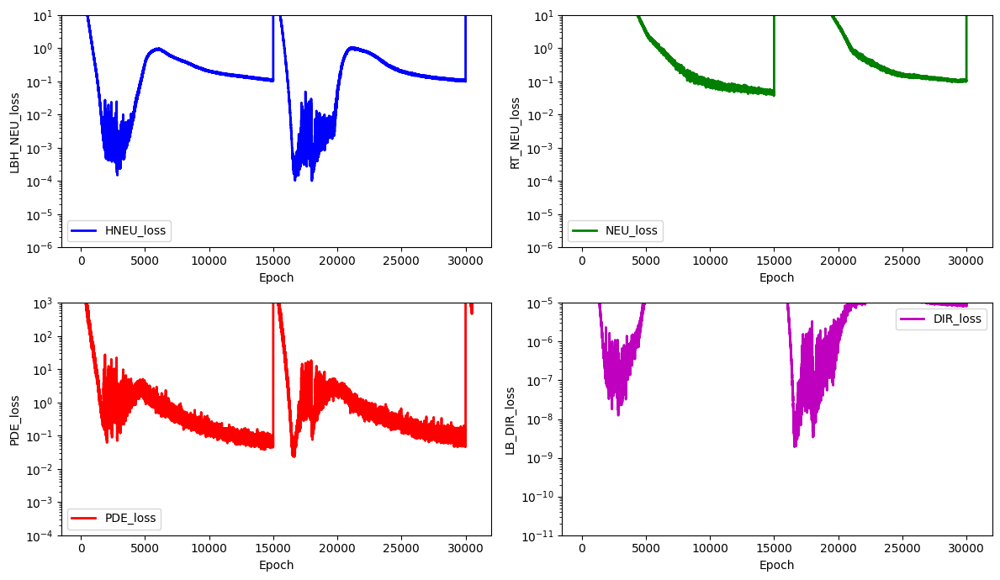

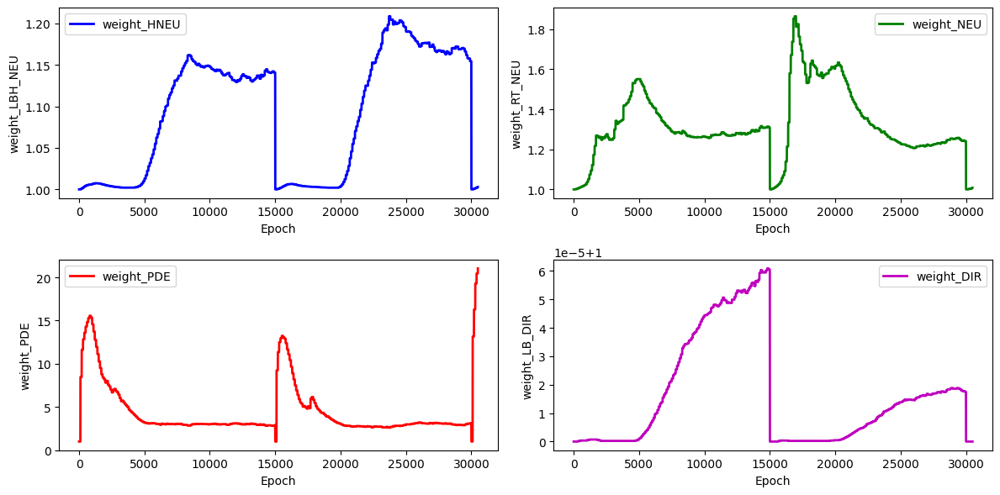

stress_Error for the stress_hole is: 30.160219396538036


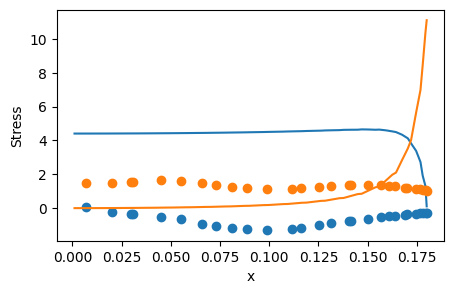

  4%|▍         | 600/15000 [03:43<1:28:32,  2.71it/s]

for weight 0 norm_grad: 1421.133056640625
for weight 0 new lamda dach: 1.0083624124526978
for weight 0 new lamdaloss norm: 1433.01708984375
for weight 1 norm_grad: 5667.49267578125
for weight 1 new lamda dach: 1.0342038869857788
for weight 1 new lamdaloss norm: 5861.3427734375
for weight 2 norm_grad: 164276.40625
for weight 2 new lamda dach: 24.17444610595703
for weight 2 new lamdaloss norm: 3971291.5
for weight 3 norm_grad: 0.06994330883026123
for weight 3 new lamda dach: 1.0000003576278687
for weight 3 new lamdaloss norm: 0.06994333863258362
for weight 0 new weight_value: 1.0034440755844116
for weight 1 new weight_value: 1.0105770826339722
for weight 2 new weight_value: 21.35206413269043
for weight 3 new weight_value: 1.0


  5%|▍         | 700/15000 [04:19<1:27:51,  2.71it/s]

for weight 0 norm_grad: 1058.8358154296875
for weight 0 new lamda dach: 1.0089185237884521
for weight 0 new lamdaloss norm: 1068.279052734375
for weight 1 norm_grad: 5063.12646484375
for weight 1 new lamda dach: 1.0441349744796753
for weight 1 new lamdaloss norm: 5286.587890625
for weight 2 norm_grad: 113660.125
for weight 2 new lamda dach: 19.565824508666992
for weight 2 new lamdaloss norm: 2223854.25
for weight 3 norm_grad: 0.048748236149549484
for weight 3 new lamda dach: 1.0000003576278687
for weight 3 new lamdaloss norm: 0.04874825477600098
for weight 0 new weight_value: 1.0039914846420288
for weight 1 new weight_value: 1.0139328241348267
for weight 2 new weight_value: 21.17344093322754
for weight 3 new weight_value: 1.0


  5%|▌         | 800/15000 [04:55<1:27:33,  2.70it/s]

for weight 0 norm_grad: 839.7678833007812
for weight 0 new lamda dach: 1.0104014873504639
for weight 0 new lamdaloss norm: 848.502685546875
for weight 1 norm_grad: 4684.53076171875
for weight 1 new lamda dach: 1.0609246492385864
for weight 1 new lamdaloss norm: 4969.93408203125
for weight 2 norm_grad: 76050.8125
for weight 2 new lamda dach: 14.766507148742676
for weight 2 new lamdaloss norm: 1123004.875
for weight 3 norm_grad: 0.040394581854343414
for weight 3 new lamda dach: 1.0000004768371582
for weight 3 new lamdaloss norm: 0.040394604206085205
for weight 0 new weight_value: 1.0046324729919434
for weight 1 new weight_value: 1.0186320543289185
for weight 2 new weight_value: 20.532747268676758
for weight 3 new weight_value: 1.0


  6%|▌         | 900/15000 [05:32<1:27:44,  2.68it/s]

for weight 0 norm_grad: 776.8460693359375
for weight 0 new lamda dach: 1.009186863899231
for weight 0 new lamdaloss norm: 783.98291015625
for weight 1 norm_grad: 4306.044921875
for weight 1 new lamda dach: 1.0531407594680786
for weight 1 new lamdaloss norm: 4534.87109375
for weight 2 norm_grad: 80254.0078125
for weight 2 new lamda dach: 16.788951873779297
for weight 2 new lamdaloss norm: 1347380.625
for weight 3 norm_grad: 0.03364880383014679
for weight 3 new lamda dach: 1.0000003576278687
for weight 3 new lamdaloss norm: 0.033648815006017685
for weight 0 new weight_value: 1.0050878524780273
for weight 1 new weight_value: 1.0220829248428345
for weight 2 new weight_value: 20.158367156982422
for weight 3 new weight_value: 1.0


  7%|▋         | 999/15000 [06:07<1:22:28,  2.83it/s]

for weight 0 norm_grad: 614.1732177734375
for weight 0 new lamda dach: 1.0118712186813354
for weight 0 new lamdaloss norm: 621.4641723632812
for weight 1 norm_grad: 4091.09619140625
for weight 1 new lamda dach: 1.0847734212875366
for weight 1 new lamdaloss norm: 4437.912109375
for weight 2 norm_grad: 47644.984375
for weight 2 new lamda dach: 11.12582778930664
for weight 2 new lamdaloss norm: 530089.875
for weight 3 norm_grad: 0.024689530953764915
for weight 3 new lamda dach: 1.0000004768371582
for weight 3 new lamdaloss norm: 0.02468954212963581
for weight 0 new weight_value: 1.0057661533355713
for weight 1 new weight_value: 1.028351902961731
for weight 2 new weight_value: 19.25511360168457
for weight 3 new weight_value: 1.0
total_loss: 93.05738067626953, hole_loss:  1.4857286214828491,neumann_loss:  20.507427215576172, pde_loss: 67.74252319335938,dirichlet_loss: 4.2793788452399895e-05


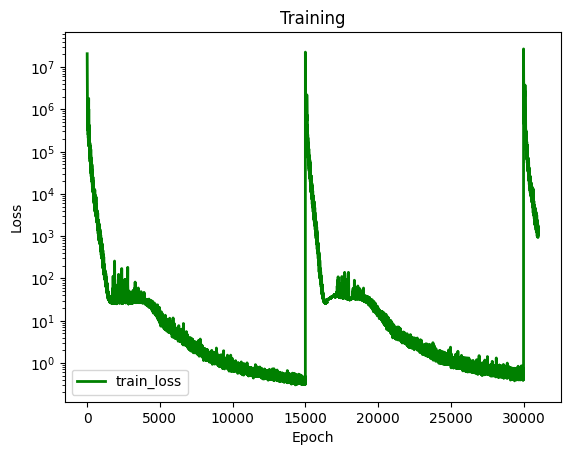

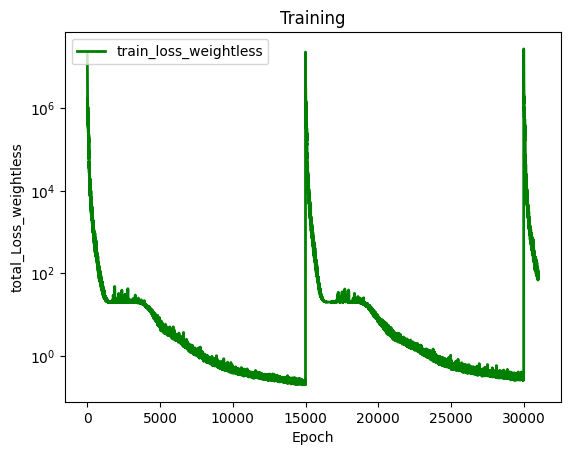

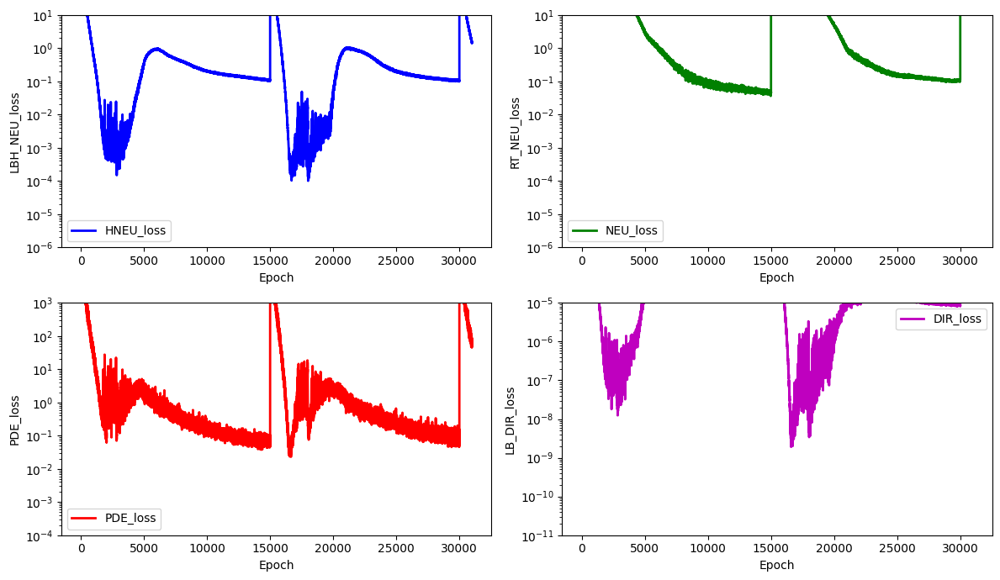

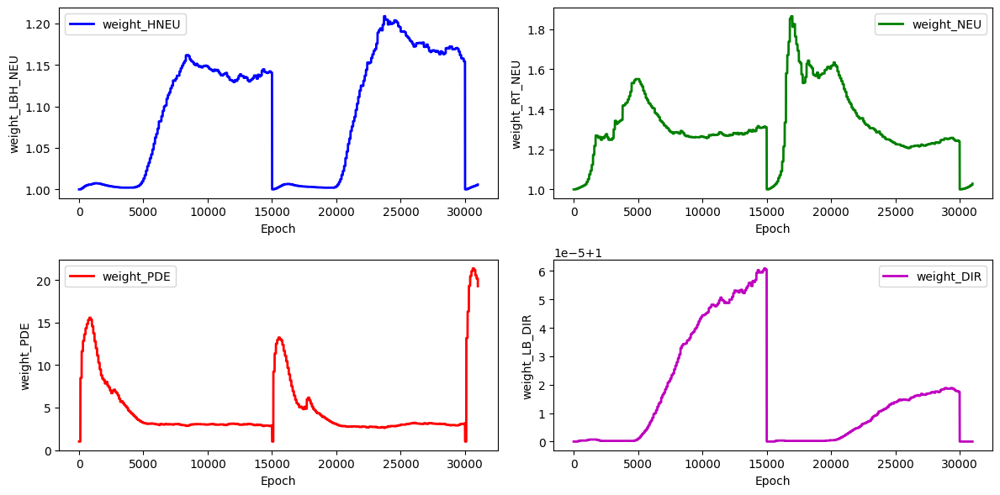

stress_Error for the stress_hole is: 21.291649730733575


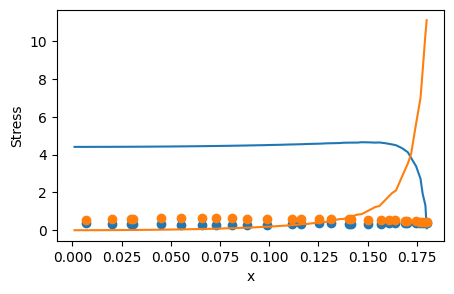

  7%|▋         | 1100/15000 [06:46<1:24:50,  2.73it/s]

for weight 0 norm_grad: 490.8542175292969
for weight 0 new lamda dach: 1.0093482732772827
for weight 0 new lamdaloss norm: 495.44287109375
for weight 1 norm_grad: 4055.32080078125
for weight 1 new lamda dach: 1.0828572511672974
for weight 1 new lamdaloss norm: 4391.33349609375
for weight 2 norm_grad: 48452.5703125
for weight 2 new lamda dach: 11.657828330993652
for weight 2 new lamdaloss norm: 564851.75
for weight 3 norm_grad: 0.020870113745331764
for weight 3 new lamda dach: 1.0000003576278687
for weight 3 new lamdaloss norm: 0.02087012119591236
for weight 0 new weight_value: 1.0061243772506714
for weight 1 new weight_value: 1.0338023900985718
for weight 2 new weight_value: 18.495384216308594
for weight 3 new weight_value: 1.0


  8%|▊         | 1200/15000 [07:22<1:24:03,  2.74it/s]

for weight 0 norm_grad: 395.9184265136719
for weight 0 new lamda dach: 1.012066125869751
for weight 0 new lamdaloss norm: 400.6956787109375
for weight 1 norm_grad: 3953.70166015625
for weight 1 new lamda dach: 1.135148286819458
for weight 1 new lamdaloss norm: 4488.0380859375
for weight 2 norm_grad: 28858.595703125
for weight 2 new lamda dach: 7.634716987609863
for weight 2 new lamdaloss norm: 220327.21875
for weight 3 norm_grad: 0.016708210110664368
for weight 3 new lamda dach: 1.0000004768371582
for weight 3 new lamdaloss norm: 0.016708219423890114
for weight 0 new weight_value: 1.0067185163497925
for weight 1 new weight_value: 1.0439369678497314
for weight 2 new weight_value: 17.409317016601562
for weight 3 new weight_value: 1.0


  9%|▊         | 1300/15000 [07:58<1:24:18,  2.71it/s]

for weight 0 norm_grad: 354.4020690917969
for weight 0 new lamda dach: 1.012707233428955
for weight 0 new lamdaloss norm: 358.90557861328125
for weight 1 norm_grad: 3905.337890625
for weight 1 new lamda dach: 1.1604560613632202
for weight 1 new lamdaloss norm: 4531.97314453125
for weight 2 norm_grad: 23984.564453125
for weight 2 new lamda dach: 6.630504608154297
for weight 2 new lamdaloss norm: 159029.765625
for weight 3 norm_grad: 0.013390935026109219
for weight 3 new lamda dach: 1.0000004768371582
for weight 3 new lamdaloss norm: 0.01339094340801239
for weight 0 new weight_value: 1.007317304611206
for weight 1 new weight_value: 1.0555888414382935
for weight 2 new weight_value: 16.33143424987793
for weight 3 new weight_value: 1.0


  9%|▉         | 1400/15000 [08:34<1:23:40,  2.71it/s]

for weight 0 norm_grad: 265.68206787109375
for weight 0 new lamda dach: 1.0080240964889526
for weight 0 new lamdaloss norm: 267.8139343261719
for weight 1 norm_grad: 3845.418701171875
for weight 1 new lamda dach: 1.1302160024642944
for weight 1 new lamdaloss norm: 4346.15380859375
for weight 2 norm_grad: 29265.375
for weight 2 new lamda dach: 8.118600845336914
for weight 2 new lamdaloss norm: 237593.890625
for weight 3 norm_grad: 0.009879824705421925
for weight 3 new lamda dach: 1.0000003576278687
for weight 3 new lamdaloss norm: 0.009879828430712223
for weight 0 new weight_value: 1.0073879957199097
for weight 1 new weight_value: 1.063051462173462
for weight 2 new weight_value: 15.510150909423828
for weight 3 new weight_value: 1.0


 10%|▉         | 1499/15000 [09:09<1:19:59,  2.81it/s]

for weight 0 norm_grad: 180.8587188720703
for weight 0 new lamda dach: 1.0073786973953247
for weight 0 new lamdaloss norm: 182.19322204589844
for weight 1 norm_grad: 3862.6142578125
for weight 1 new lamda dach: 1.1854405403137207
for weight 1 new lamdaloss norm: 4578.89990234375
for weight 2 norm_grad: 20648.541015625
for weight 2 new lamda dach: 6.106625556945801
for weight 2 new lamdaloss norm: 126092.90625
for weight 3 norm_grad: 0.00782597903162241
for weight 3 new lamda dach: 1.0000003576278687
for weight 3 new lamdaloss norm: 0.007825981825590134
for weight 0 new weight_value: 1.0073870420455933
for weight 1 new weight_value: 1.075290322303772
for weight 2 new weight_value: 14.56979751586914
for weight 3 new weight_value: 1.0
total_loss: 31.226957321166992, hole_loss:  0.1954069882631302,neumann_loss:  18.322378158569336, pde_loss: 10.639325141906738,dirichlet_loss: 5.2214431889296975e-06


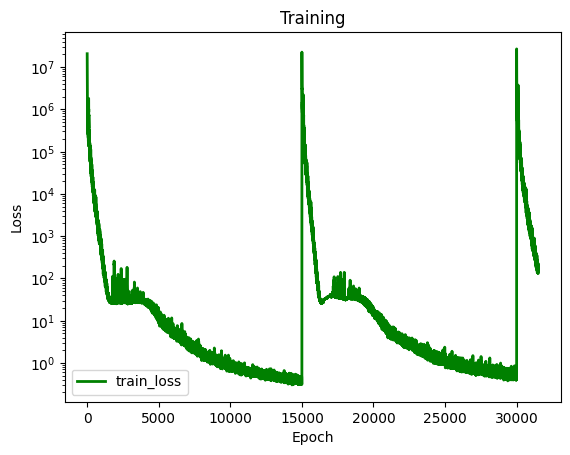

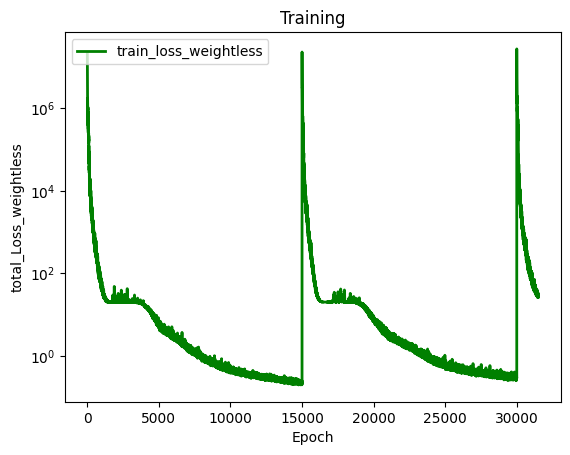

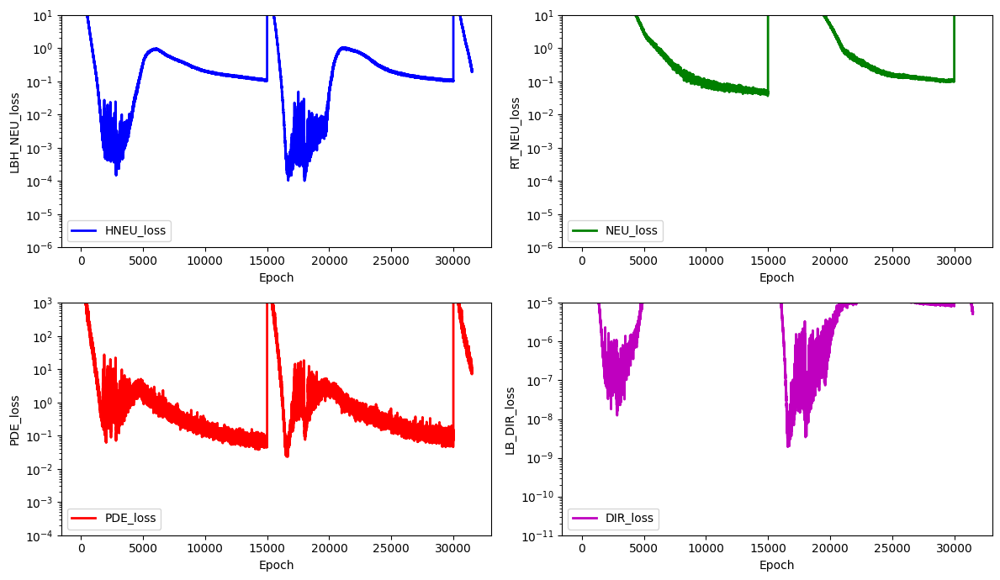

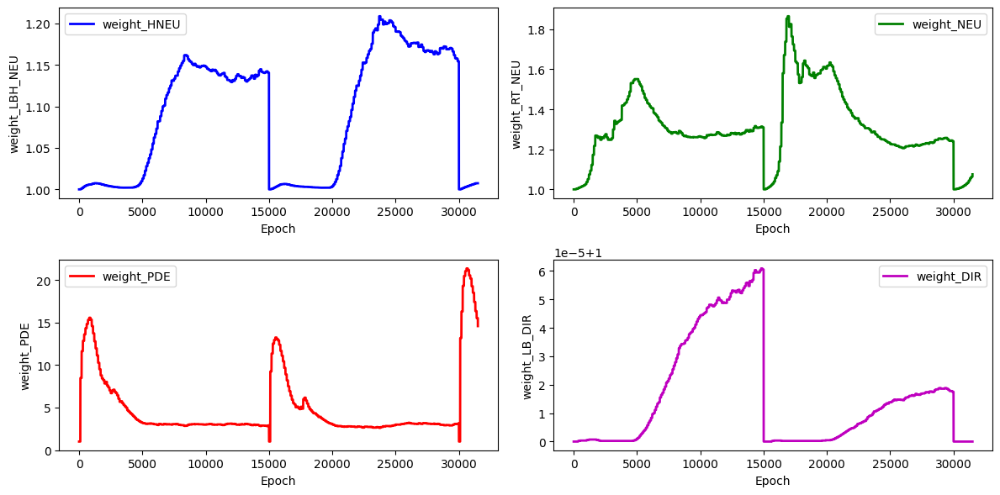

stress_Error for the stress_hole is: 23.115555654782412


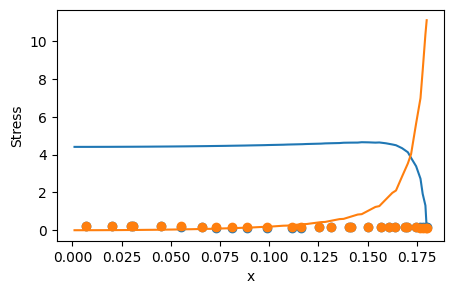

 11%|█         | 1600/15000 [09:49<1:23:55,  2.66it/s]

for weight 0 norm_grad: 160.9207763671875
for weight 0 new lamda dach: 1.0087018013000488
for weight 0 new lamdaloss norm: 162.3210906982422
for weight 1 norm_grad: 3857.1552734375
for weight 1 new lamda dach: 1.2606785297393799
for weight 1 new lamdaloss norm: 4862.63232421875
for weight 2 norm_grad: 14635.669921875
for weight 2 new lamda dach: 4.642451763153076
for weight 2 new lamdaloss norm: 67945.3984375
for weight 3 norm_grad: 0.006663233041763306
for weight 3 new lamda dach: 1.0000003576278687
for weight 3 new lamdaloss norm: 0.006663235370069742
for weight 0 new weight_value: 1.0075185298919678
for weight 1 new weight_value: 1.0938291549682617
for weight 2 new weight_value: 13.577062606811523
for weight 3 new weight_value: 1.0


 11%|█▏        | 1700/15000 [10:26<1:23:33,  2.65it/s]

for weight 0 norm_grad: 167.96820068359375
for weight 0 new lamda dach: 1.0074454545974731
for weight 0 new lamdaloss norm: 169.2187957763672
for weight 1 norm_grad: 3789.02685546875
for weight 1 new lamda dach: 1.2000668048858643
for weight 1 new lamdaloss norm: 4547.08544921875
for weight 2 norm_grad: 18770.837890625
for weight 2 new lamda dach: 5.743706703186035
for weight 2 new lamdaloss norm: 107814.1796875
for weight 3 norm_grad: 0.004692766349762678
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0046927668154239655
for weight 0 new weight_value: 1.0075111389160156
for weight 1 new weight_value: 1.1044528484344482
for weight 2 new weight_value: 12.793725967407227
for weight 3 new weight_value: 1.0


 12%|█▏        | 1800/15000 [11:04<1:56:11,  1.89it/s]

for weight 0 norm_grad: 83.82913208007812
for weight 0 new lamda dach: 1.0040371417999268
for weight 0 new lamdaloss norm: 84.16757202148438
for weight 1 norm_grad: 3760.840087890625
for weight 1 new lamda dach: 1.2200883626937866
for weight 1 new lamdaloss norm: 4588.556640625
for weight 2 norm_grad: 17004.025390625
for weight 2 new lamda dach: 5.422748565673828
for weight 2 new lamdaloss norm: 92208.5546875
for weight 3 norm_grad: 0.003940962255001068
for weight 3 new lamda dach: 1.000000238418579
for weight 3 new lamdaloss norm: 0.003940963186323643
for weight 0 new weight_value: 1.007163643836975
for weight 1 new weight_value: 1.1160163879394531
for weight 2 new weight_value: 12.05662727355957
for weight 3 new weight_value: 1.0


 13%|█▎        | 1900/15000 [11:41<1:22:11,  2.66it/s]

for weight 0 norm_grad: 154.66319274902344
for weight 0 new lamda dach: 1.0075680017471313
for weight 0 new lamdaloss norm: 155.83367919921875
for weight 1 norm_grad: 3808.80859375
for weight 1 new lamda dach: 1.2269536256790161
for weight 1 new lamdaloss norm: 4673.2314453125
for weight 2 norm_grad: 16627.65625
for weight 2 new lamda dach: 5.195219993591309
for weight 2 new lamdaloss norm: 86384.3359375
for weight 3 norm_grad: 0.0030770127195864916
for weight 3 new lamda dach: 1.000000238418579
for weight 3 new lamdaloss norm: 0.003077013650909066
for weight 0 new weight_value: 1.0072040557861328
for weight 1 new weight_value: 1.1271100044250488
for weight 2 new weight_value: 11.37048625946045
for weight 3 new weight_value: 1.0


 13%|█▎        | 1999/15000 [12:17<1:18:11,  2.77it/s]

for weight 0 norm_grad: 51.87614440917969
for weight 0 new lamda dach: 1.0030176639556885
for weight 0 new lamdaloss norm: 52.03268814086914
for weight 1 norm_grad: 3756.540771484375
for weight 1 new lamda dach: 1.278543472290039
for weight 1 new lamdaloss norm: 4802.900390625
for weight 2 norm_grad: 13434.49609375
for weight 2 new lamda dach: 4.5275774002075195
for weight 2 new lamdaloss norm: 60825.71875
for weight 3 norm_grad: 0.0018616786692291498
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0018616789020597935
for weight 0 new weight_value: 1.0067853927612305
for weight 1 new weight_value: 1.1422532796859741
for weight 2 new weight_value: 10.686195373535156
for weight 3 new weight_value: 1.0
total_loss: 20.49403190612793, hole_loss:  0.011168855242431164,neumann_loss:  18.937767028808594, pde_loss: 1.0652461051940918,dirichlet_loss: 3.177962923928135e-07


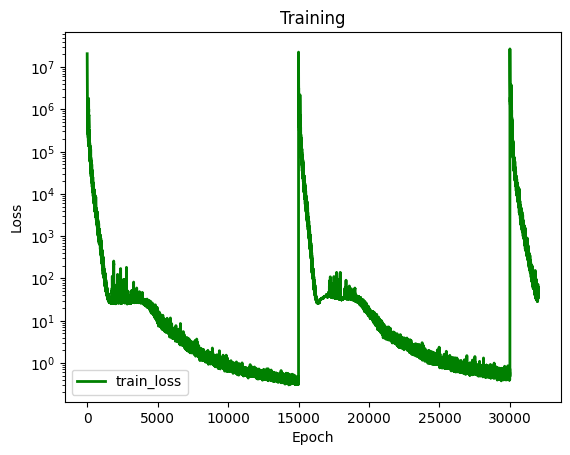

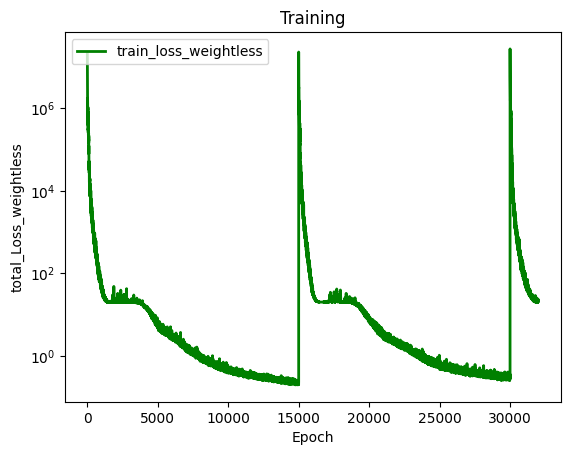

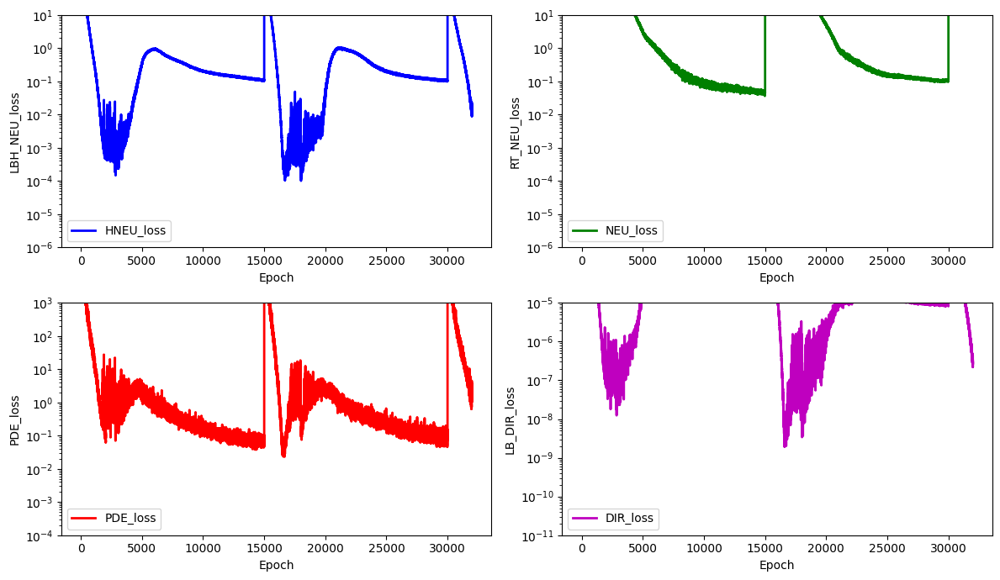

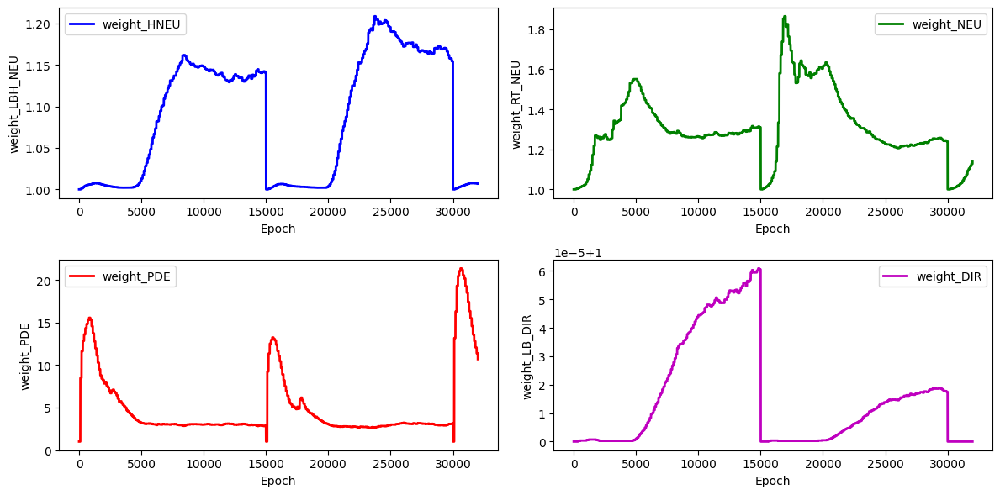

stress_Error for the stress_hole is: 25.04919969367404


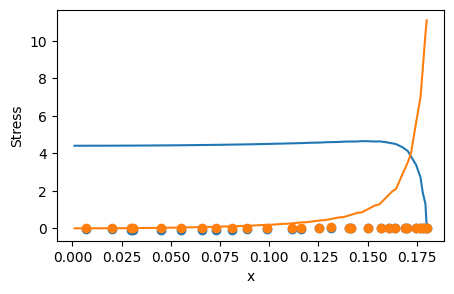

 14%|█▍        | 2100/15000 [12:59<1:25:31,  2.51it/s]

for weight 0 norm_grad: 48.73870086669922
for weight 0 new lamda dach: 1.0044463872909546
for weight 0 new lamdaloss norm: 48.95541000366211
for weight 1 norm_grad: 3848.492431640625
for weight 1 new lamda dach: 1.5373750925064087
for weight 1 new lamdaloss norm: 5916.57568359375
for weight 2 norm_grad: 7112.91015625
for weight 2 new lamda dach: 2.82511830329895
for weight 2 new lamdaloss norm: 20094.814453125
for weight 3 norm_grad: 0.0011692311381921172
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0011692313710227609
for weight 0 new weight_value: 1.0065515041351318
for weight 1 new weight_value: 1.1817654371261597
for weight 2 new weight_value: 9.900087356567383
for weight 3 new weight_value: 1.0


 15%|█▍        | 2200/15000 [13:37<1:23:30,  2.55it/s]

for weight 0 norm_grad: 59.6841926574707
for weight 0 new lamda dach: 1.0043323040008545
for weight 0 new lamdaloss norm: 59.94276428222656
for weight 1 norm_grad: 3797.266357421875
for weight 1 new lamda dach: 1.3782466650009155
for weight 1 new lamdaloss norm: 5233.56982421875
for weight 2 norm_grad: 9979.443359375
for weight 2 new lamda dach: 3.5873916149139404
for weight 2 new lamdaloss norm: 35800.171875
for weight 3 norm_grad: 0.001071611768566072
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0010716118849813938
for weight 0 new weight_value: 1.0063295364379883
for weight 1 new weight_value: 1.2014135122299194
for weight 2 new weight_value: 9.268816947937012
for weight 3 new weight_value: 1.0


 15%|█▌        | 2300/15000 [14:16<1:25:02,  2.49it/s]

for weight 0 norm_grad: 218.0092315673828
for weight 0 new lamda dach: 1.0036615133285522
for weight 0 new lamdaloss norm: 218.80747985839844
for weight 1 norm_grad: 3749.775146484375
for weight 1 new lamda dach: 1.0669500827789307
for weight 1 new lamdaloss norm: 4000.822509765625
for weight 2 norm_grad: 55790.5
for weight 2 new lamda dach: 15.060853004455566
for weight 2 new lamdaloss norm: 840252.5
for weight 3 norm_grad: 0.0030181899201124907
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0030181901529431343
for weight 0 new weight_value: 1.0060627460479736
for weight 1 new weight_value: 1.1879671812057495
for weight 2 new weight_value: 9.848020553588867
for weight 3 new weight_value: 1.0


 16%|█▌        | 2400/15000 [14:54<1:20:51,  2.60it/s]

for weight 0 norm_grad: 14.729482650756836
for weight 0 new lamda dach: 1.001144528388977
for weight 0 new lamdaloss norm: 14.746341705322266
for weight 1 norm_grad: 3827.708251953125
for weight 1 new lamda dach: 1.4226497411727905
for weight 1 new lamdaloss norm: 5445.48779296875
for weight 2 norm_grad: 9041.724609375
for weight 2 new lamda dach: 3.353121519088745
for weight 2 new lamdaloss norm: 30318.001953125
for weight 3 norm_grad: 0.0008882235269993544
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.000888223759829998
for weight 0 new weight_value: 1.005570888519287
for weight 1 new weight_value: 1.2114354372024536
for weight 2 new weight_value: 9.198530197143555
for weight 3 new weight_value: 1.0


 17%|█▋        | 2499/15000 [15:32<1:18:38,  2.65it/s]

for weight 0 norm_grad: 20.88610076904297
for weight 0 new lamda dach: 1.0011224746704102
for weight 0 new lamdaloss norm: 20.909543991088867
for weight 1 norm_grad: 3744.468994140625
for weight 1 new lamda dach: 1.251561164855957
for weight 1 new lamdaloss norm: 4686.4326171875
for weight 2 norm_grad: 14864.0380859375
for weight 2 new lamda dach: 4.947577953338623
for weight 2 new lamdaloss norm: 73540.9921875
for weight 3 norm_grad: 0.0010189813328906894
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0010189814493060112
for weight 0 new weight_value: 1.0051259994506836
for weight 1 new weight_value: 1.215448021888733
for weight 2 new weight_value: 8.77343463897705
for weight 3 new weight_value: 1.0
total_loss: 19.936445236206055, hole_loss:  0.0017221851740032434,neumann_loss:  19.136005401611328, pde_loss: 1.147756814956665,dirichlet_loss: 5.9044914735295606e-08


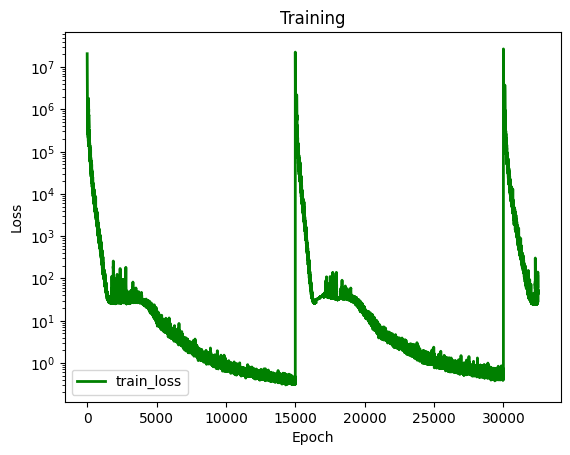

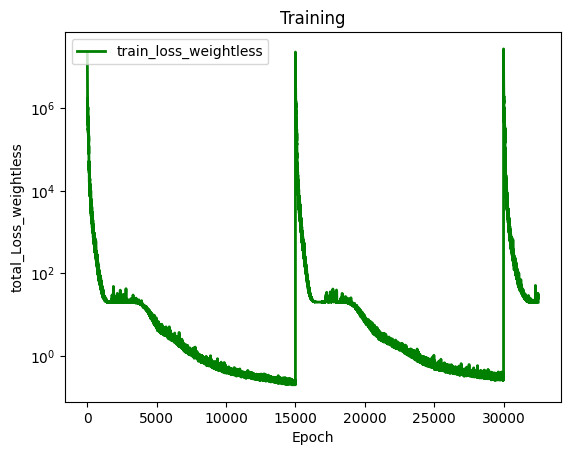

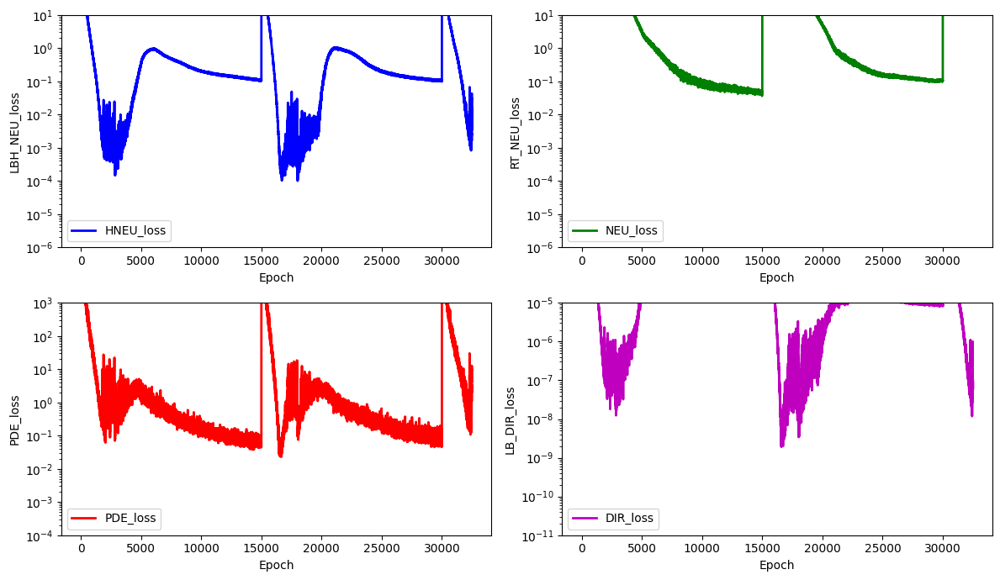

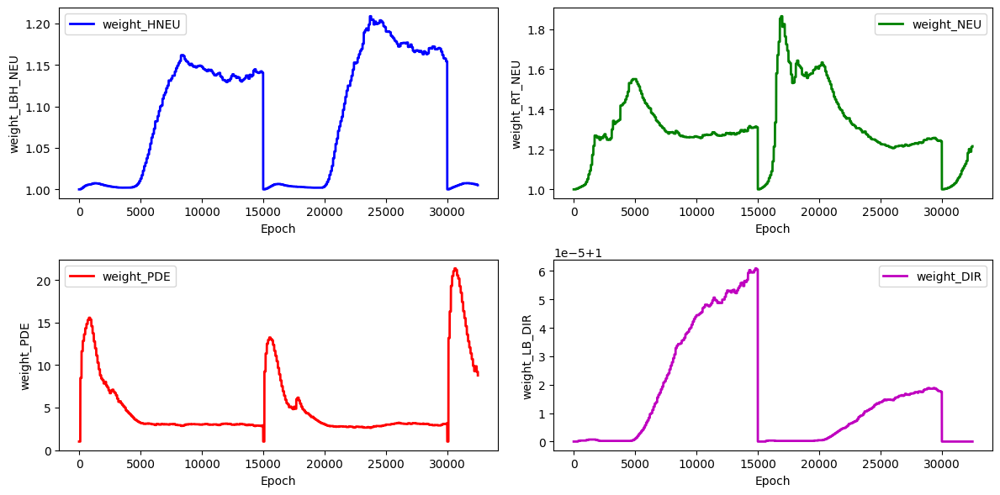

stress_Error for the stress_hole is: 24.81050104939978


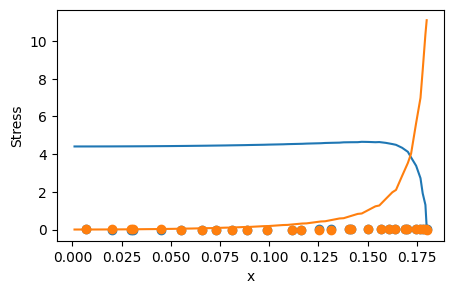

 17%|█▋        | 2600/15000 [16:11<1:15:42,  2.73it/s]

for weight 0 norm_grad: 17.02800178527832
for weight 0 new lamda dach: 1.0021729469299316
for weight 0 new lamdaloss norm: 17.065006256103516
for weight 1 norm_grad: 3801.80712890625
for weight 1 new lamda dach: 1.9383326768875122
for weight 1 new lamdaloss norm: 7369.1669921875
for weight 2 norm_grad: 4034.633544921875
for weight 2 new lamda dach: 2.056508779525757
for weight 2 new lamdaloss norm: 8297.2587890625
for weight 3 norm_grad: 0.0005543514853343368
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0005543515435419977
for weight 0 new weight_value: 1.0048307180404663
for weight 1 new weight_value: 1.287736415863037
for weight 2 new weight_value: 8.101741790771484
for weight 3 new weight_value: 1.0


 18%|█▊        | 2700/15000 [16:47<1:14:55,  2.74it/s]

for weight 0 norm_grad: 39.12944030761719
for weight 0 new lamda dach: 1.0012032985687256
for weight 0 new lamdaloss norm: 39.17652130126953
for weight 1 norm_grad: 3814.192626953125
for weight 1 new lamda dach: 1.1326966285705566
for weight 1 new lamdaloss norm: 4320.32275390625
for weight 2 norm_grad: 28704.580078125
for weight 2 new lamda dach: 8.449302673339844
for weight 2 new lamdaloss norm: 242533.6875
for weight 3 norm_grad: 0.0016789974179118872
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0016789976507425308
for weight 0 new weight_value: 1.0044679641723633
for weight 1 new weight_value: 1.2722324132919312
for weight 2 new weight_value: 8.136497497558594
for weight 3 new weight_value: 1.0


 19%|█▊        | 2800/15000 [17:23<1:14:44,  2.72it/s]

for weight 0 norm_grad: 21.115711212158203
for weight 0 new lamda dach: 1.0029035806655884
for weight 0 new lamdaloss norm: 21.17702293395996
for weight 1 norm_grad: 3778.46240234375
for weight 1 new lamda dach: 2.0749895572662354
for weight 1 new lamdaloss norm: 7840.2705078125
for weight 2 norm_grad: 3493.7666015625
for weight 2 new lamda dach: 1.9195141792297363
for weight 2 new lamdaloss norm: 6706.33447265625
for weight 3 norm_grad: 0.000726998841855675
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0007269989000633359
for weight 0 new weight_value: 1.0043115615844727
for weight 1 new weight_value: 1.3525080680847168
for weight 2 new weight_value: 7.514798641204834
for weight 3 new weight_value: 1.0


 19%|█▉        | 2900/15000 [17:59<1:18:52,  2.56it/s]

for weight 0 norm_grad: 102.88494110107422
for weight 0 new lamda dach: 1.0043423175811768
for weight 0 new lamdaloss norm: 103.33169555664062
for weight 1 norm_grad: 3756.1748046875
for weight 1 new lamda dach: 1.187430739402771
for weight 1 new lamdaloss norm: 4460.197265625
for weight 2 norm_grad: 19937.453125
for weight 2 new lamda dach: 6.166398048400879
for weight 2 new lamdaloss norm: 122942.2578125
for weight 3 norm_grad: 0.0016414669808000326
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0016414672136306763
for weight 0 new weight_value: 1.0043145418167114
for weight 1 new weight_value: 1.3360003232955933
for weight 2 new weight_value: 7.379958152770996
for weight 3 new weight_value: 1.0


 20%|█▉        | 2999/15000 [18:35<1:10:56,  2.82it/s]

for weight 0 norm_grad: 24.3188419342041
for weight 0 new lamda dach: 1.0017173290252686
for weight 0 new lamdaloss norm: 24.36060333251953
for weight 1 norm_grad: 3764.232421875
for weight 1 new lamda dach: 1.361238956451416
for weight 1 new lamdaloss norm: 5124.02001953125
for weight 2 norm_grad: 10396.01953125
for weight 2 new lamda dach: 3.7440617084503174
for weight 2 new lamdaloss norm: 38923.3359375
for weight 3 norm_grad: 0.0007986859418451786
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0007986860582605004
for weight 0 new weight_value: 1.0040547847747803
for weight 1 new weight_value: 1.3385241031646729
for weight 2 new weight_value: 7.016368389129639
for weight 3 new weight_value: 1.0
total_loss: 20.035717010498047, hole_loss:  0.0022390377707779408,neumann_loss:  19.105655670166016, pde_loss: 1.0264651775360107,dirichlet_loss: 4.4579071101225054e-08


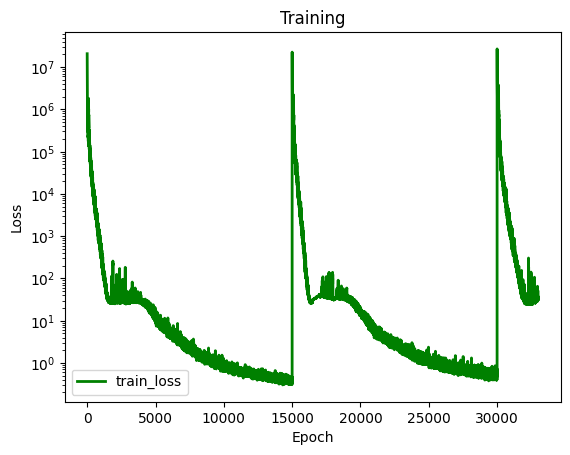

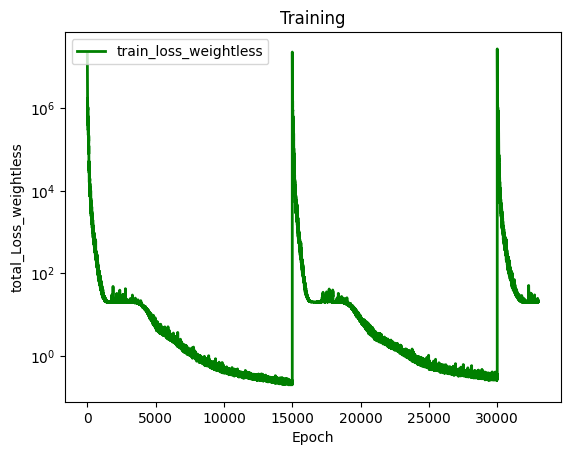

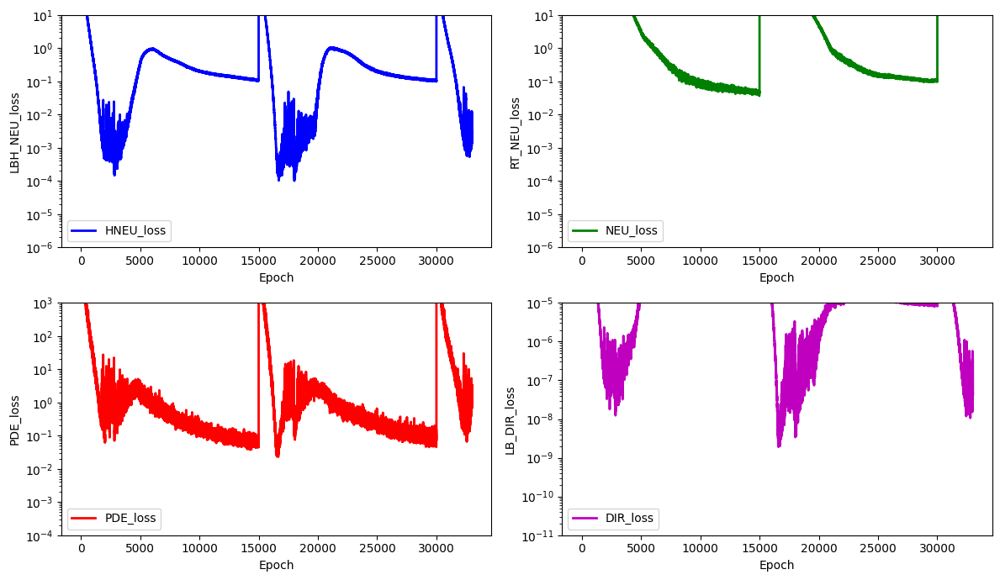

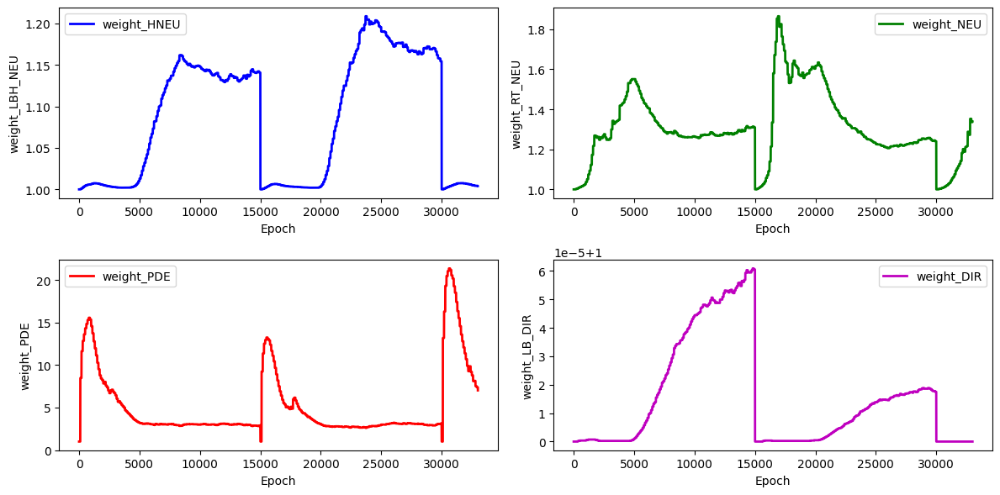

stress_Error for the stress_hole is: 24.962154652906356


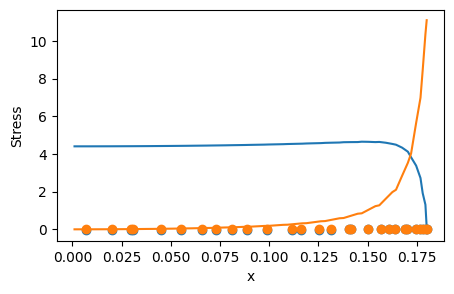

 21%|██        | 3100/15000 [19:13<1:12:29,  2.74it/s]

for weight 0 norm_grad: 28.85085105895996
for weight 0 new lamda dach: 1.0031325817108154
for weight 0 new lamdaloss norm: 28.94122886657715
for weight 1 norm_grad: 3726.294677734375
for weight 1 new lamda dach: 1.6759769916534424
for weight 1 new lamdaloss norm: 6245.18359375
for weight 2 norm_grad: 5483.6064453125
for weight 2 new lamda dach: 2.4602909088134766
for weight 2 new lamdaloss norm: 13491.2666015625
for weight 3 norm_grad: 0.0006559009780175984
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0006559010362252593
for weight 0 new weight_value: 1.003962516784668
for weight 1 new weight_value: 1.3722692728042603
for weight 2 new weight_value: 6.560760498046875
for weight 3 new weight_value: 1.0


 21%|██▏       | 3200/15000 [19:49<1:12:20,  2.72it/s]

for weight 0 norm_grad: 69.65886688232422
for weight 0 new lamda dach: 1.0028681755065918
for weight 0 new lamdaloss norm: 69.85865783691406
for weight 1 norm_grad: 3715.002685546875
for weight 1 new lamda dach: 1.1799768209457397
for weight 1 new lamdaloss norm: 4383.6171875
for weight 2 norm_grad: 20571.896484375
for weight 2 new lamda dach: 6.435593605041504
for weight 2 new lamdaloss norm: 132392.375
for weight 3 norm_grad: 0.001593963010236621
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0015939631266519427
for weight 0 new weight_value: 1.0038530826568604
for weight 1 new weight_value: 1.3530399799346924
for weight 2 new weight_value: 6.548243522644043
for weight 3 new weight_value: 1.0


 22%|██▏       | 3300/15000 [20:25<1:11:28,  2.73it/s]

for weight 0 norm_grad: 26.207395553588867
for weight 0 new lamda dach: 1.001705527305603
for weight 0 new lamdaloss norm: 26.252094268798828
for weight 1 norm_grad: 3709.561767578125
for weight 1 new lamda dach: 1.3175204992294312
for weight 1 new lamdaloss norm: 4887.423828125
for weight 2 norm_grad: 11656.6962890625
for weight 2 new lamda dach: 4.1202921867370605
for weight 2 new lamdaloss norm: 48028.9921875
for weight 3 norm_grad: 0.0014992200303822756
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0014992202632129192
for weight 0 new weight_value: 1.0036382675170898
for weight 1 new weight_value: 1.3494880199432373
for weight 2 new weight_value: 6.305448055267334
for weight 3 new weight_value: 1.0


 23%|██▎       | 3400/15000 [21:00<1:10:12,  2.75it/s]

for weight 0 norm_grad: 36.68748092651367
for weight 0 new lamda dach: 1.003875494003296
for weight 0 new lamdaloss norm: 36.82966232299805
for weight 1 norm_grad: 3725.311279296875
for weight 1 new lamda dach: 1.644756555557251
for weight 1 new lamdaloss norm: 6127.23046875
for weight 2 norm_grad: 5741.16943359375
for weight 2 new lamda dach: 2.526095151901245
for weight 2 new lamdaloss norm: 14502.7412109375
for weight 3 norm_grad: 0.001131636556237936
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0011316366726532578
for weight 0 new weight_value: 1.0036619901657104
for weight 1 new weight_value: 1.3790148496627808
for weight 2 new weight_value: 5.9275126457214355
for weight 3 new weight_value: 1.0


 23%|██▎       | 3499/15000 [21:36<1:07:56,  2.82it/s]

for weight 0 norm_grad: 32.64531326293945
for weight 0 new lamda dach: 1.003065586090088
for weight 0 new lamdaloss norm: 32.745391845703125
for weight 1 norm_grad: 3658.678466796875
for weight 1 new lamda dach: 1.5209423303604126
for weight 1 new lamdaloss norm: 5564.638671875
for weight 2 norm_grad: 6990.54736328125
for weight 2 new lamda dach: 2.893777370452881
for weight 2 new lamdaloss norm: 20229.0859375
for weight 3 norm_grad: 0.0013204962015151978
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0013204964343458414
for weight 0 new weight_value: 1.0036022663116455
for weight 1 new weight_value: 1.3932075500488281
for weight 2 new weight_value: 5.624138832092285
for weight 3 new weight_value: 1.0
total_loss: 18.564111709594727, hole_loss:  0.003091601189225912,neumann_loss:  17.878114700317383, pde_loss: 0.557572066783905,dirichlet_loss: 1.1738708849406976e-07


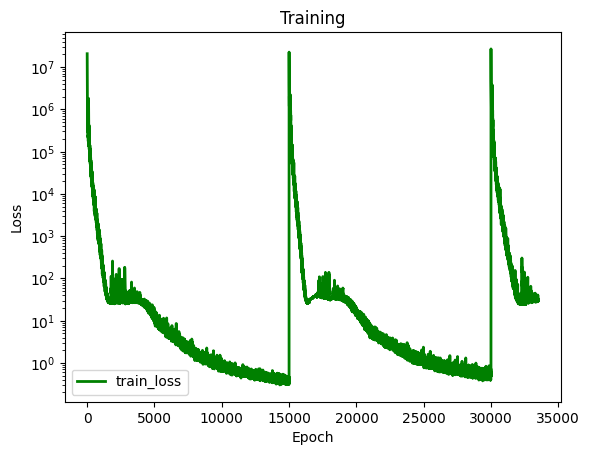

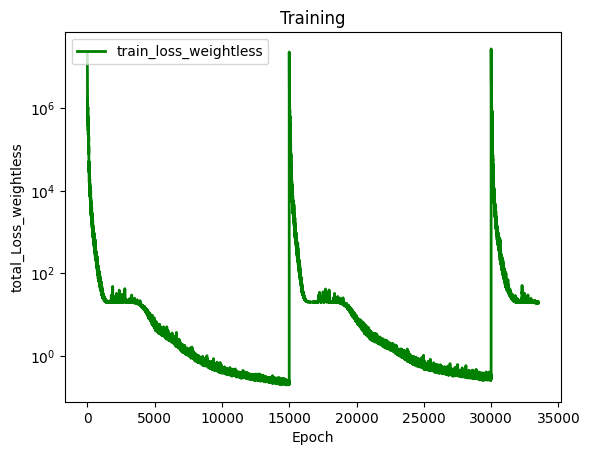

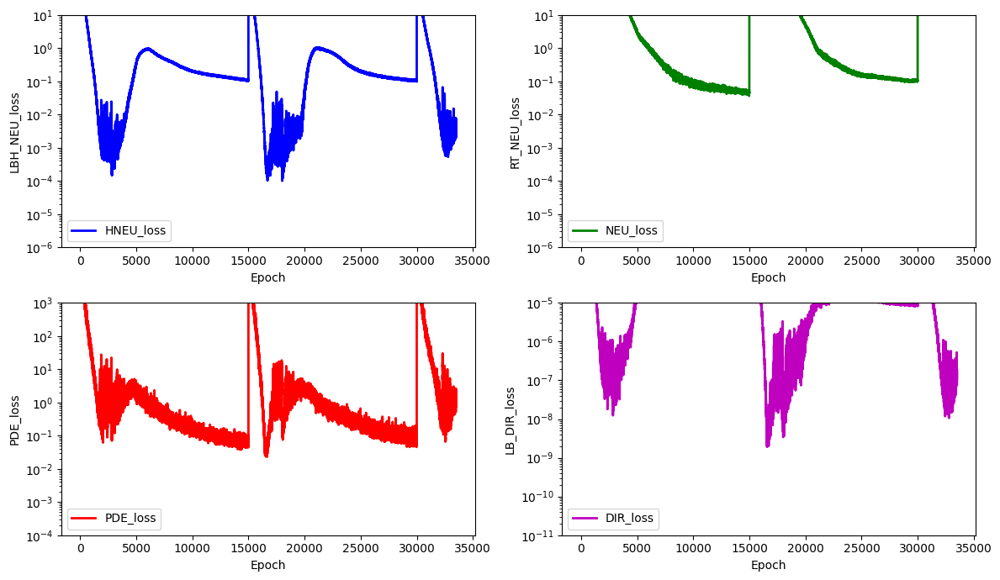

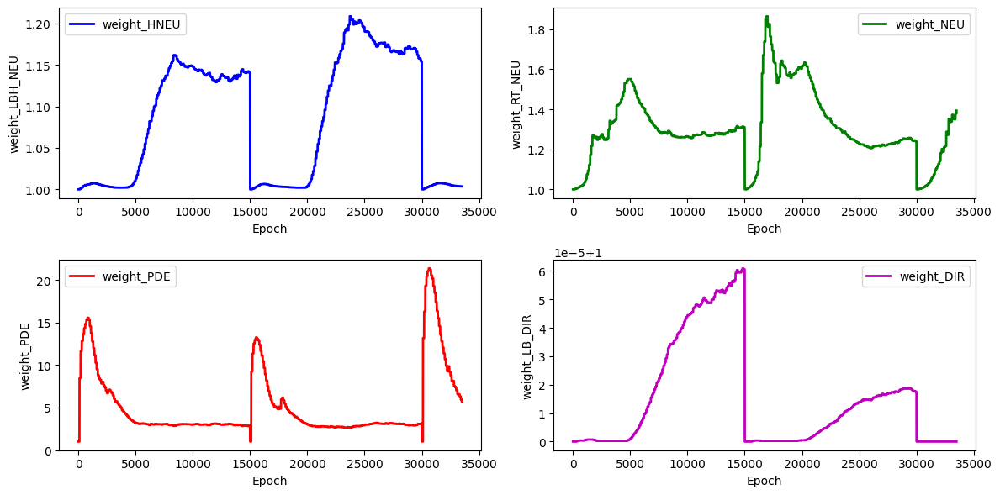

stress_Error for the stress_hole is: 24.64434603763316


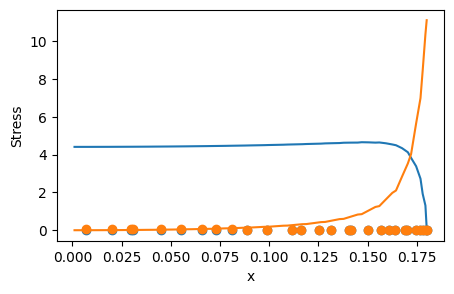

 24%|██▍       | 3600/15000 [22:17<1:13:56,  2.57it/s]

for weight 0 norm_grad: 22.847055435180664
for weight 0 new lamda dach: 1.001386046409607
for weight 0 new lamdaloss norm: 22.87872314453125
for weight 1 norm_grad: 3592.002685546875
for weight 1 new lamda dach: 1.2781378030776978
for weight 1 new lamdaloss norm: 4591.07470703125
for weight 2 norm_grad: 12891.62109375
for weight 2 new lamda dach: 4.566293239593506
for weight 2 new lamdaloss norm: 58866.921875
for weight 3 norm_grad: 0.0017671241657808423
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0017671242821961641
for weight 0 new weight_value: 1.003380537033081
for weight 1 new weight_value: 1.3817006349563599
for weight 2 new weight_value: 5.5183539390563965
for weight 3 new weight_value: 1.0


 25%|██▍       | 3700/15000 [22:56<1:15:53,  2.48it/s]

for weight 0 norm_grad: 22.896854400634766
for weight 0 new lamda dach: 1.0024099349975586
for weight 0 new lamdaloss norm: 22.95203399658203
for weight 1 norm_grad: 3598.988037109375
for weight 1 new lamda dach: 1.6074671745300293
for weight 1 new lamdaloss norm: 5785.25537109375
for weight 2 norm_grad: 5901.6826171875
for weight 2 new lamda dach: 2.6294498443603516
for weight 2 new lamdaloss norm: 15518.177734375
for weight 3 norm_grad: 0.0021775050554424524
for weight 3 new lamda dach: 1.000000238418579
for weight 3 new lamdaloss norm: 0.0021775055211037397
for weight 0 new weight_value: 1.0032833814620972
for weight 1 new weight_value: 1.4042772054672241
for weight 2 new weight_value: 5.229463577270508
for weight 3 new weight_value: 1.0


 25%|██▌       | 3800/15000 [23:35<1:15:30,  2.47it/s]

for weight 0 norm_grad: 26.99304962158203
for weight 0 new lamda dach: 1.0016601085662842
for weight 0 new lamdaloss norm: 27.03786277770996
for weight 1 norm_grad: 3576.8251953125
for weight 1 new lamda dach: 1.281421422958374
for weight 1 new lamdaloss norm: 4583.4208984375
for weight 2 norm_grad: 12682.85546875
for weight 2 new lamda dach: 4.519279956817627
for weight 2 new lamdaloss norm: 57317.37109375
for weight 3 norm_grad: 0.002698161406442523
for weight 3 new lamda dach: 1.000000238418579
for weight 3 new lamdaloss norm: 0.002698162104934454
for weight 0 new weight_value: 1.003121018409729
for weight 1 new weight_value: 1.3919916152954102
for weight 2 new weight_value: 5.158445358276367
for weight 3 new weight_value: 1.0


 26%|██▌       | 3900/15000 [24:14<1:16:46,  2.41it/s]

for weight 0 norm_grad: 58.38661193847656
for weight 0 new lamda dach: 1.0031698942184448
for weight 0 new lamdaloss norm: 58.571685791015625
for weight 1 norm_grad: 3546.646240234375
for weight 1 new lamda dach: 1.2375359535217285
for weight 1 new lamdaloss norm: 4389.10205078125
for weight 2 norm_grad: 14872.599609375
for weight 2 new lamda dach: 5.125507354736328
for weight 2 new lamdaloss norm: 76229.625
for weight 3 norm_grad: 0.002633616328239441
for weight 3 new lamda dach: 1.0000001192092896
for weight 3 new lamdaloss norm: 0.0026336165610700846
for weight 0 new weight_value: 1.0031259059906006
for weight 1 new weight_value: 1.376546025276184
for weight 2 new weight_value: 5.1551513671875
for weight 3 new weight_value: 1.0


 27%|██▋       | 3999/15000 [24:53<1:14:36,  2.46it/s]

for weight 0 norm_grad: 14.775910377502441
for weight 0 new lamda dach: 1.0011279582977295
for weight 0 new lamdaloss norm: 14.79257583618164
for weight 1 norm_grad: 3532.917236328125
for weight 1 new lamda dach: 1.3687115907669067
for weight 1 new lamdaloss norm: 4835.54443359375
for weight 2 norm_grad: 9567.0107421875
for weight 2 new lamda dach: 3.6966824531555176
for weight 2 new lamdaloss norm: 35366.203125
for weight 3 norm_grad: 0.0028427245561033487
for weight 3 new lamda dach: 1.000000238418579
for weight 3 new lamdaloss norm: 0.0028427252545952797
for weight 0 new weight_value: 1.0029261112213135
for weight 1 new weight_value: 1.3757624626159668
for weight 2 new weight_value: 5.009304046630859
for weight 3 new weight_value: 1.0
total_loss: 16.907068252563477, hole_loss:  0.0024406909942626953,neumann_loss:  15.311179161071777, pde_loss: 1.6370631456375122,dirichlet_loss: 4.57395344710676e-07


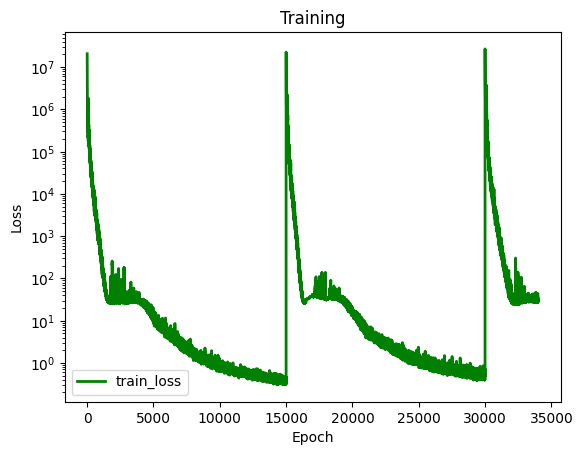

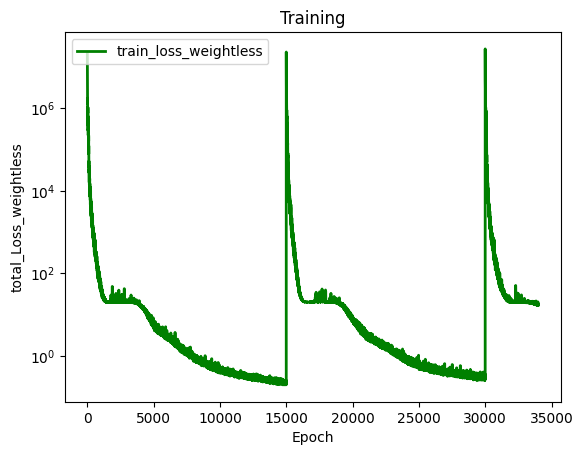

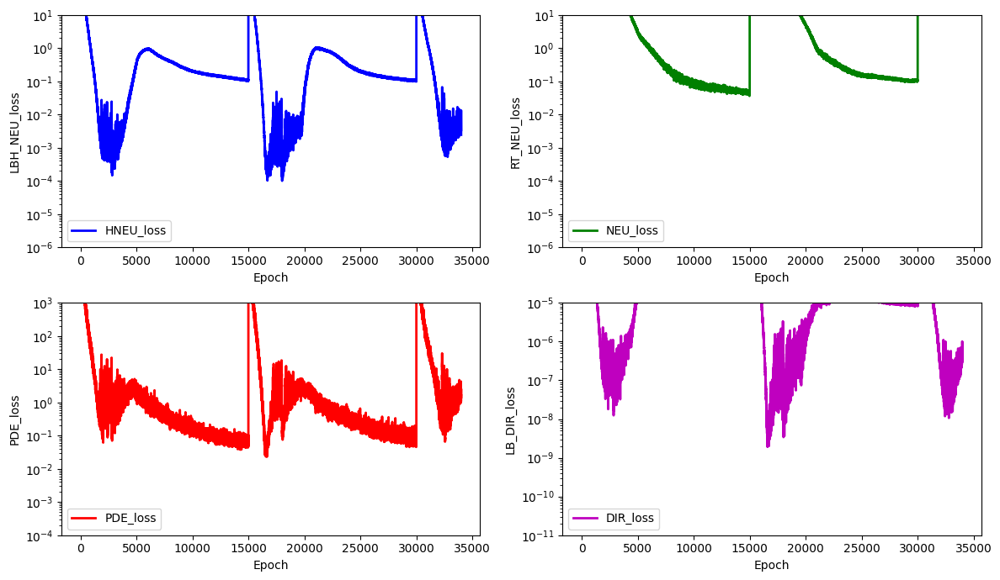

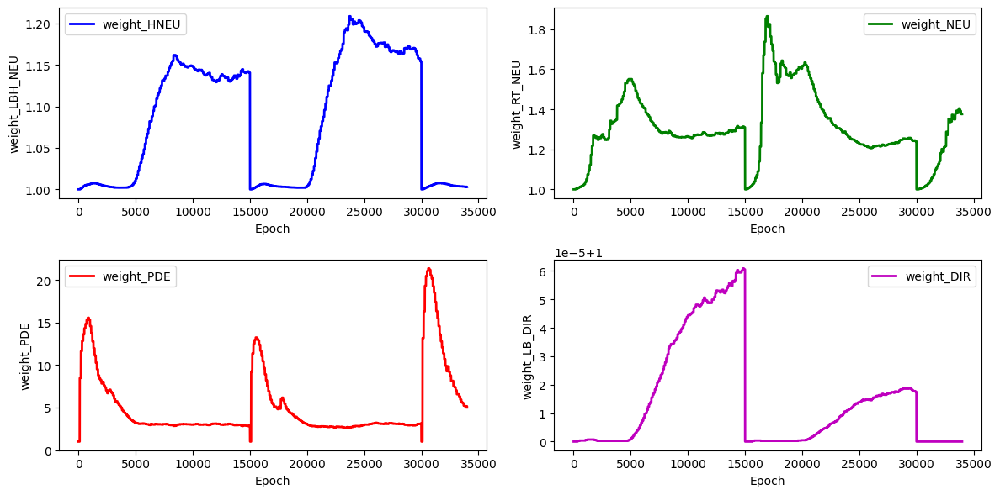

stress_Error for the stress_hole is: 24.671291000333664


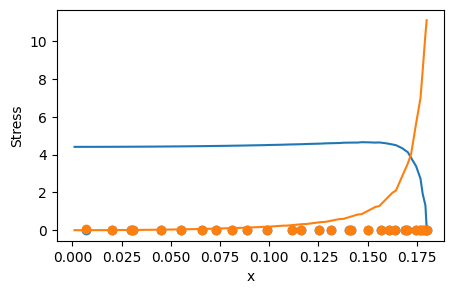

 27%|██▋       | 4100/15000 [25:35<1:11:06,  2.55it/s]

for weight 0 norm_grad: 59.88642501831055
for weight 0 new lamda dach: 1.0067346096038818
for weight 0 new lamdaloss norm: 60.28974151611328
for weight 1 norm_grad: 3430.6455078125
for weight 1 new lamda dach: 1.6213116645812988
for weight 1 new lamdaloss norm: 5562.1455078125
for weight 2 norm_grad: 5461.728515625
for weight 2 new lamda dach: 2.564725160598755
for weight 2 new lamdaloss norm: 14007.83203125
for weight 3 norm_grad: 0.0029947953298687935
for weight 3 new lamda dach: 1.0000003576278687
for weight 3 new lamdaloss norm: 0.0029947964940220118
for weight 0 new weight_value: 1.0033069849014282
for weight 1 new weight_value: 1.4003174304962158
for weight 2 new weight_value: 4.764846324920654
for weight 3 new weight_value: 1.0


 28%|██▊       | 4200/15000 [26:16<1:17:05,  2.34it/s]

for weight 0 norm_grad: 16.46169662475586
for weight 0 new lamda dach: 1.0013015270233154
for weight 0 new lamdaloss norm: 16.483121871948242
for weight 1 norm_grad: 3409.784912109375
for weight 1 new lamda dach: 1.36842679977417
for weight 1 new lamdaloss norm: 4666.04052734375
for weight 2 norm_grad: 9238.521484375
for weight 2 new lamda dach: 3.6963951587677
for weight 2 new lamdaloss norm: 34149.2265625
for weight 3 norm_grad: 0.0030788960866630077
for weight 3 new lamda dach: 1.000000238418579
for weight 3 new lamdaloss norm: 0.0030788967851549387
for weight 0 new weight_value: 1.0031064748764038
for weight 1 new weight_value: 1.3971283435821533
for weight 2 new weight_value: 4.658000946044922
for weight 3 new weight_value: 1.0


 29%|██▊       | 4300/15000 [26:55<1:13:05,  2.44it/s]

for weight 0 norm_grad: 24.020645141601562
for weight 0 new lamda dach: 1.0020793676376343
for weight 0 new lamdaloss norm: 24.070594787597656
for weight 1 norm_grad: 3316.23095703125
for weight 1 new lamda dach: 1.4014921188354492
for weight 1 new lamdaloss norm: 4647.671875
for weight 2 norm_grad: 8235.73828125
for weight 2 new lamda dach: 3.4656009674072266
for weight 2 new lamdaloss norm: 28541.78515625
for weight 3 norm_grad: 0.004045597743242979
for weight 3 new lamda dach: 1.0000003576278687
for weight 3 new lamdaloss norm: 0.004045599140226841
for weight 0 new weight_value: 1.003003716468811
for weight 1 new weight_value: 1.3975647687911987
for weight 2 new weight_value: 4.538760662078857
for weight 3 new weight_value: 1.0


 29%|██▉       | 4400/15000 [27:35<1:09:43,  2.53it/s]

for weight 0 norm_grad: 37.1961784362793
for weight 0 new lamda dach: 1.0033613443374634
for weight 0 new lamdaloss norm: 37.32120895385742
for weight 1 norm_grad: 3241.544921875
for weight 1 new lamda dach: 1.4123350381851196
for weight 1 new lamdaloss norm: 4578.1474609375
for weight 2 norm_grad: 7824.23388671875
for weight 2 new lamda dach: 3.386350393295288
for weight 2 new lamdaloss norm: 26495.595703125
for weight 3 norm_grad: 0.00419148663058877
for weight 3 new lamda dach: 1.0000003576278687
for weight 3 new lamdaloss norm: 0.004191488027572632
for weight 0 new weight_value: 1.0030394792556763
for weight 1 new weight_value: 1.3990416526794434
for weight 2 new weight_value: 4.423519611358643
for weight 3 new weight_value: 1.0


 30%|██▉       | 4499/15000 [28:14<1:06:50,  2.62it/s]

for weight 0 norm_grad: 26.61109733581543
for weight 0 new lamda dach: 1.002881407737732
for weight 0 new lamdaloss norm: 26.687772750854492
for weight 1 norm_grad: 3260.064453125
for weight 1 new lamda dach: 1.5431692600250244
for weight 1 new lamdaloss norm: 5030.8310546875
for weight 2 norm_grad: 5975.31396484375
for weight 2 new lamda dach: 2.8180389404296875
for weight 2 new lamdaloss norm: 16838.66796875
for weight 3 norm_grad: 0.005603655707091093
for weight 3 new lamda dach: 1.0000005960464478
for weight 3 new lamdaloss norm: 0.005603658966720104
for weight 0 new weight_value: 1.003023624420166
for weight 1 new weight_value: 1.4134544134140015
for weight 2 new weight_value: 4.2629714012146
for weight 3 new weight_value: 1.0
total_loss: 13.867981910705566, hole_loss:  0.005360638722777367,neumann_loss:  12.366515159606934, pde_loss: 1.3305130004882812,dirichlet_loss: 1.7070155990950298e-06


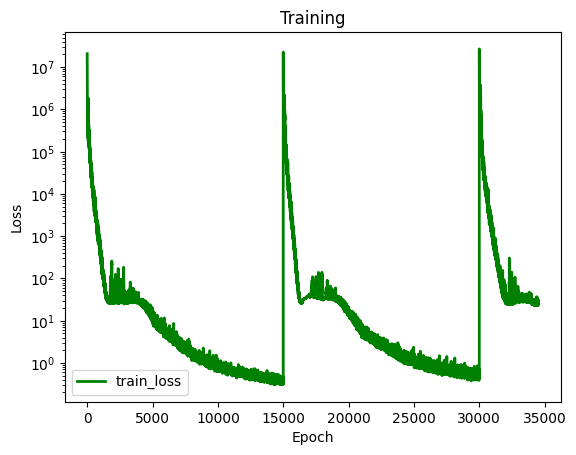

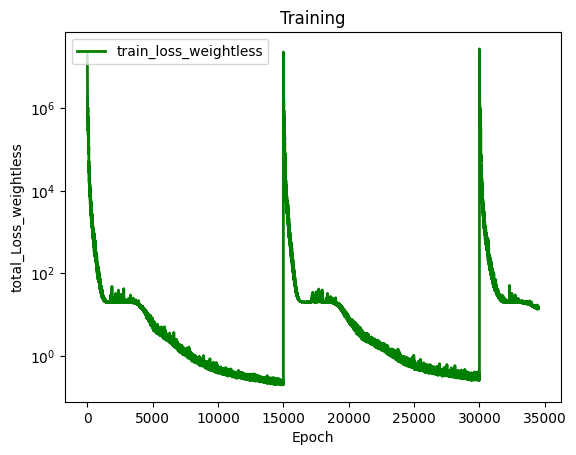

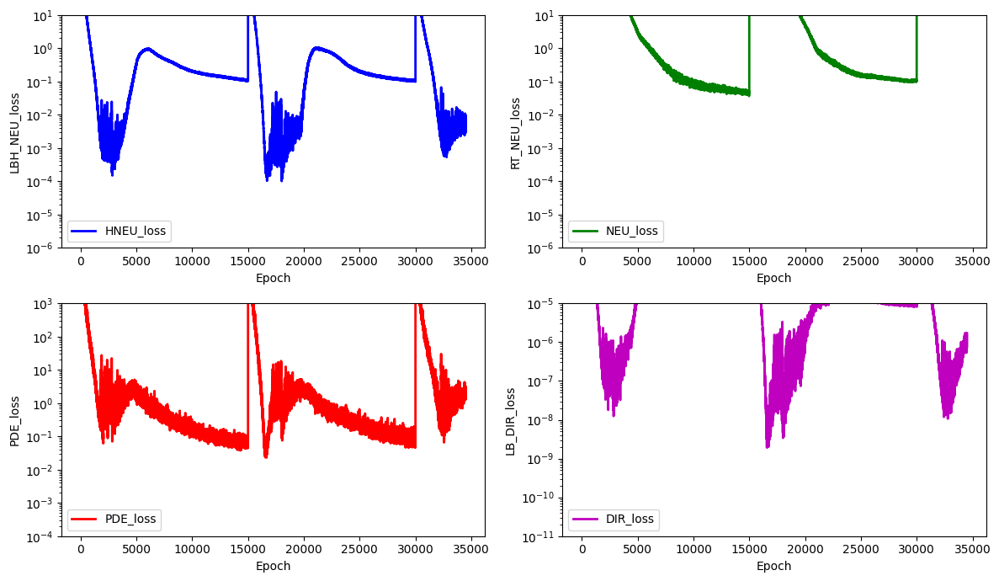

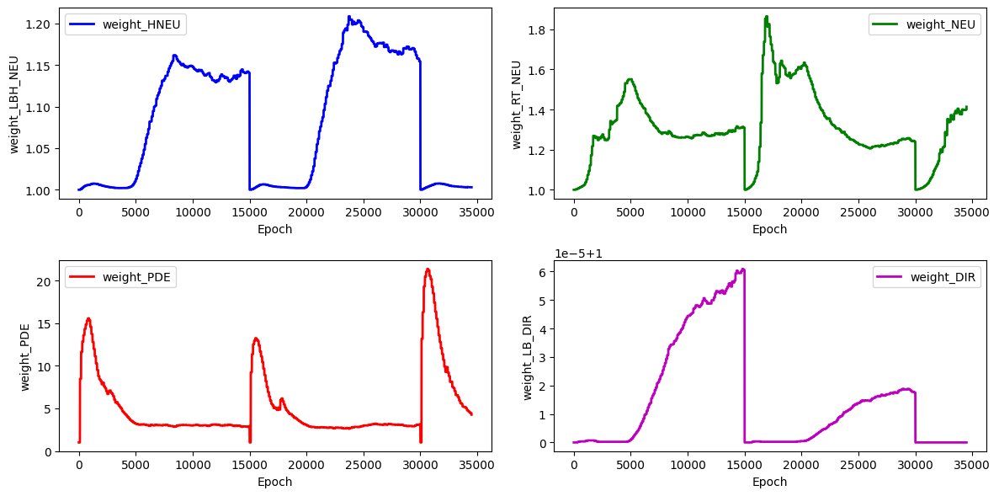

stress_Error for the stress_hole is: 24.548048164455846


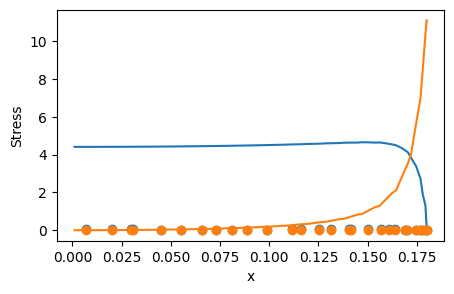

 31%|███       | 4600/15000 [28:56<1:06:28,  2.61it/s]

for weight 0 norm_grad: 33.32088088989258
for weight 0 new lamda dach: 1.0037121772766113
for weight 0 new lamdaloss norm: 33.44457244873047
for weight 1 norm_grad: 3171.859130859375
for weight 1 new lamda dach: 1.5433323383331299
for weight 1 new lamdaloss norm: 4895.232421875
for weight 2 norm_grad: 5804.46337890625
for weight 2 new lamda dach: 2.810960531234741
for weight 2 new lamdaloss norm: 16316.1171875
for weight 3 norm_grad: 0.004587108734995127
for weight 3 new lamda dach: 1.0000005960464478
for weight 3 new lamdaloss norm: 0.004587111063301563
for weight 0 new weight_value: 1.0030924081802368
for weight 1 new weight_value: 1.4264421463012695
for weight 2 new weight_value: 4.117770195007324
for weight 3 new weight_value: 1.0


 31%|███▏      | 4700/15000 [29:35<1:08:20,  2.51it/s]

for weight 0 norm_grad: 38.65306091308594
for weight 0 new lamda dach: 1.0036507844924927
for weight 0 new lamdaloss norm: 38.7941780090332
for weight 1 norm_grad: 3165.835693359375
for weight 1 new lamda dach: 1.4243557453155518
for weight 1 new lamdaloss norm: 4509.2763671875
for weight 2 norm_grad: 7421.67529296875
for weight 2 new lamda dach: 3.3160204887390137
for weight 2 new lamdaloss norm: 24610.427734375
for weight 3 norm_grad: 0.005787944886833429
for weight 3 new lamda dach: 1.0000005960464478
for weight 3 new lamdaloss norm: 0.0057879481464624405
for weight 0 new weight_value: 1.0031481981277466
for weight 1 new weight_value: 1.4262334108352661
for weight 2 new weight_value: 4.037595272064209
for weight 3 new weight_value: 1.0


 32%|███▏      | 4800/15000 [30:14<1:10:32,  2.41it/s]

for weight 0 norm_grad: 37.53810501098633
for weight 0 new lamda dach: 1.0039966106414795
for weight 0 new lamdaloss norm: 37.688133239746094
for weight 1 norm_grad: 2959.39501953125
for weight 1 new lamda dach: 1.4573659896850586
for weight 1 new lamdaloss norm: 4312.921875
for weight 2 norm_grad: 6432.97412109375
for weight 2 new lamda dach: 3.146514892578125
for weight 2 new lamdaloss norm: 20241.44921875
for weight 3 norm_grad: 0.006316530983895063
for weight 3 new lamda dach: 1.0000005960464478
for weight 3 new lamdaloss norm: 0.0063165342435240746
for weight 0 new weight_value: 1.0032329559326172
for weight 1 new weight_value: 1.4293465614318848
for weight 2 new weight_value: 3.9484870433807373
for weight 3 new weight_value: 1.0


 33%|███▎      | 4900/15000 [30:52<1:06:41,  2.52it/s]

for weight 0 norm_grad: 52.50907897949219
for weight 0 new lamda dach: 1.0059244632720947
for weight 0 new lamdaloss norm: 52.820167541503906
for weight 1 norm_grad: 2975.0595703125
for weight 1 new lamda dach: 1.5008093118667603
for weight 1 new lamdaloss norm: 4464.9970703125
for weight 2 norm_grad: 5887.98779296875
for weight 2 new lamda dach: 2.944786310195923
for weight 2 new lamdaloss norm: 17338.865234375
for weight 3 norm_grad: 0.006351356860250235
for weight 3 new lamda dach: 1.0000007152557373
for weight 3 new lamdaloss norm: 0.006351361516863108
for weight 0 new weight_value: 1.0035021305084229
for weight 1 new weight_value: 1.4364928007125854
for weight 2 new weight_value: 3.848116874694824
for weight 3 new weight_value: 1.0


 33%|███▎      | 4999/15000 [31:31<1:04:23,  2.59it/s]

for weight 0 norm_grad: 31.07510757446289
for weight 0 new lamda dach: 1.0038495063781738
for weight 0 new lamdaloss norm: 31.19472885131836
for weight 1 norm_grad: 2803.8349609375
for weight 1 new lamda dach: 1.5290518999099731
for weight 1 new lamdaloss norm: 4287.20947265625
for weight 2 norm_grad: 5268.65234375
for weight 2 new lamda dach: 2.858485221862793
for weight 2 new lamdaloss norm: 15060.365234375
for weight 3 norm_grad: 0.007536568213254213
for weight 3 new lamda dach: 1.0000009536743164
for weight 3 new lamdaloss norm: 0.007536575198173523
for weight 0 new weight_value: 1.0035368204116821
for weight 1 new weight_value: 1.4457486867904663
for weight 2 new weight_value: 3.7491536140441895
for weight 3 new weight_value: 1.0000001192092896
total_loss: 10.888252258300781, hole_loss:  0.00558812078088522,neumann_loss:  8.925363540649414, pde_loss: 1.6408109664916992,dirichlet_loss: 2.506160399207147e-06


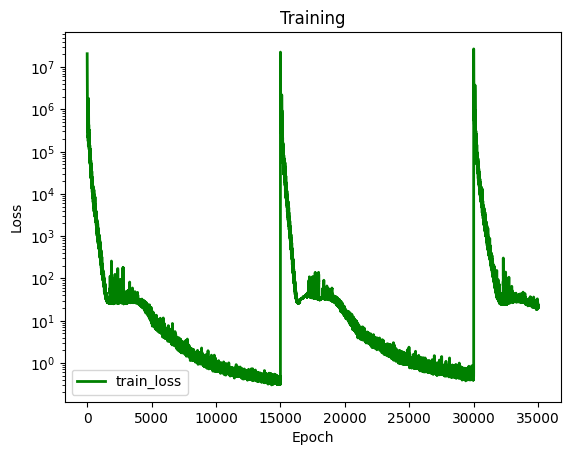

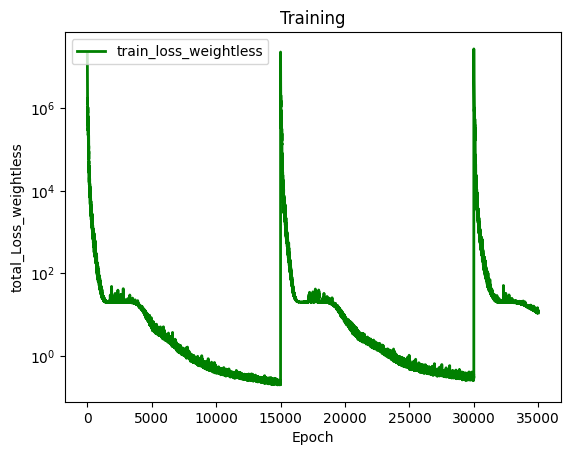

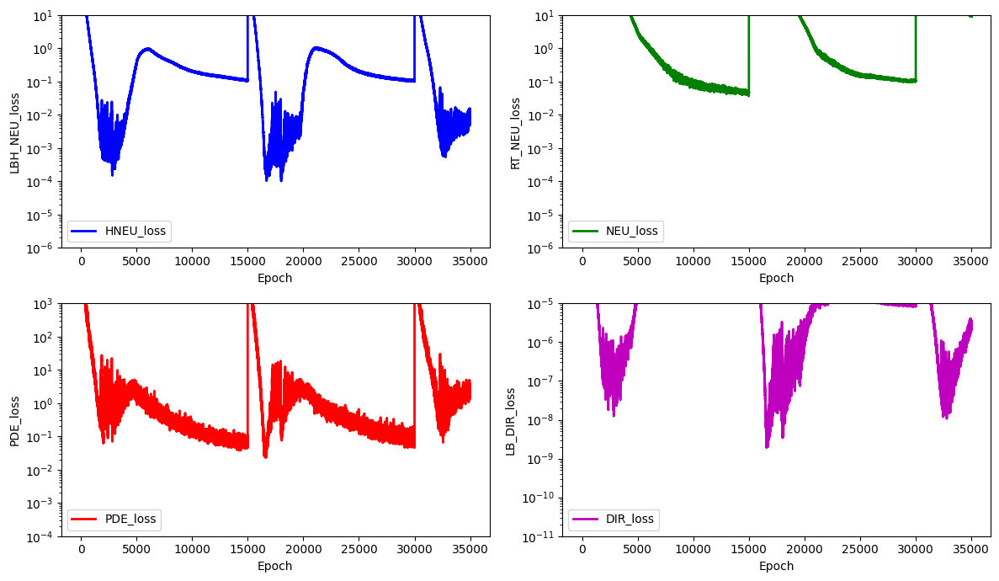

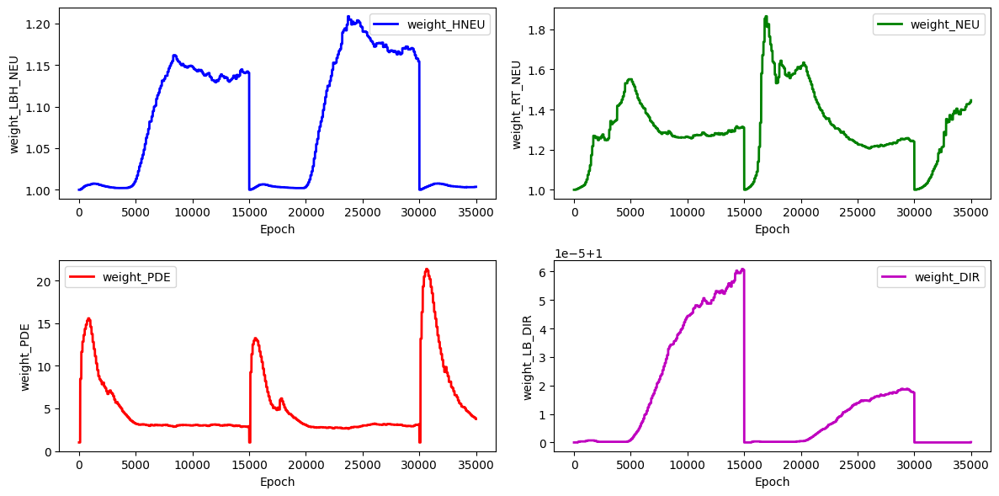

stress_Error for the stress_hole is: 24.677892897376022


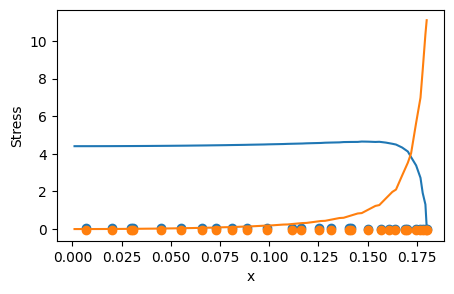

 34%|███▍      | 5100/15000 [32:14<1:03:52,  2.58it/s]

for weight 0 norm_grad: 42.71586608886719
for weight 0 new lamda dach: 1.0045537948608398
for weight 0 new lamdaloss norm: 42.91038513183594
for weight 1 norm_grad: 2654.23974609375
for weight 1 new lamda dach: 1.3921271562576294
for weight 1 new lamdaloss norm: 3695.039306640625
for weight 2 norm_grad: 6726.09912109375
for weight 2 new lamda dach: 3.4939517974853516
for weight 2 new lamdaloss norm: 23500.6640625
for weight 3 norm_grad: 0.00913502648472786
for weight 3 new lamda dach: 1.0000009536743164
for weight 3 new lamdaloss norm: 0.009135034866631031
for weight 0 new weight_value: 1.003638505935669
for weight 1 new weight_value: 1.4403865337371826
for weight 2 new weight_value: 3.7236335277557373
for weight 3 new weight_value: 1.000000238418579


 35%|███▍      | 5200/15000 [32:53<1:03:49,  2.56it/s]

for weight 0 norm_grad: 43.89400100708008
for weight 0 new lamda dach: 1.0068050622940063
for weight 0 new lamdaloss norm: 44.19270706176758
for weight 1 norm_grad: 2678.13330078125
for weight 1 new lamda dach: 1.701812982559204
for weight 1 new lamdaloss norm: 4557.68212890625
for weight 2 norm_grad: 3772.11572265625
for weight 2 new lamda dach: 2.3857686519622803
for weight 2 new lamdaloss norm: 8999.3955078125
for weight 3 norm_grad: 0.011148964986205101
for weight 3 new lamda dach: 1.0000017881393433
for weight 3 new lamdaloss norm: 0.011148984543979168
for weight 0 new weight_value: 1.0039551258087158
for weight 1 new weight_value: 1.466529130935669
for weight 2 new weight_value: 3.5898470878601074
for weight 3 new weight_value: 1.0000003576278687


 35%|███▌      | 5300/15000 [33:33<1:05:14,  2.48it/s]

for weight 0 norm_grad: 41.6263313293457
for weight 0 new lamda dach: 1.0050898790359497
for weight 0 new lamdaloss norm: 41.83820343017578
for weight 1 norm_grad: 2488.31201171875
for weight 1 new lamda dach: 1.4341423511505127
for weight 1 new lamdaloss norm: 3568.59423828125
for weight 2 norm_grad: 5689.9189453125
for weight 2 new lamda dach: 3.2490241527557373
for weight 2 new lamdaloss norm: 18486.68359375
for weight 3 norm_grad: 0.01157919317483902
for weight 3 new lamda dach: 1.0000014305114746
for weight 3 new lamdaloss norm: 0.011579209938645363
for weight 0 new weight_value: 1.0040686130523682
for weight 1 new weight_value: 1.4632904529571533
for weight 2 new weight_value: 3.555764675140381
for weight 3 new weight_value: 1.0000004768371582


 36%|███▌      | 5400/15000 [34:13<1:06:17,  2.41it/s]

for weight 0 norm_grad: 63.3197021484375
for weight 0 new lamda dach: 1.0101006031036377
for weight 0 new lamdaloss norm: 63.95927429199219
for weight 1 norm_grad: 2391.403076171875
for weight 1 new lamda dach: 1.6068295240402222
for weight 1 new lamdaloss norm: 3842.577392578125
for weight 2 norm_grad: 3877.47998046875
for weight 2 new lamda dach: 2.579590082168579
for weight 2 new lamdaloss norm: 10002.30859375
for weight 3 norm_grad: 0.01585088111460209
for weight 3 new lamda dach: 1.0000025033950806
for weight 3 new lamdaloss norm: 0.015850920230150223
for weight 0 new weight_value: 1.0046718120574951
for weight 1 new weight_value: 1.4776443243026733
for weight 2 new weight_value: 3.4581470489501953
for weight 3 new weight_value: 1.0000005960464478


 37%|███▋      | 5499/15000 [34:51<1:02:48,  2.52it/s]

for weight 0 norm_grad: 58.01917266845703
for weight 0 new lamda dach: 1.0102728605270386
for weight 0 new lamdaloss norm: 58.615196228027344
for weight 1 norm_grad: 2363.691650390625
for weight 1 new lamda dach: 1.7072405815124512
for weight 1 new lamdaloss norm: 4035.39013671875
for weight 2 norm_grad: 3284.09716796875
for weight 2 new lamda dach: 2.3560972213745117
for weight 2 new lamdaloss norm: 7737.65234375
for weight 3 norm_grad: 0.016118725761771202
for weight 3 new lamda dach: 1.0000028610229492
for weight 3 new lamdaloss norm: 0.016118770465254784
for weight 0 new weight_value: 1.0052318572998047
for weight 1 new weight_value: 1.5006039142608643
for weight 2 new weight_value: 3.3479421138763428
for weight 3 new weight_value: 1.0000008344650269
total_loss: 8.688505172729492, hole_loss:  0.020796053111553192,neumann_loss:  7.134357452392578, pde_loss: 1.3743499517440796,dirichlet_loss: 1.0728228517109528e-05


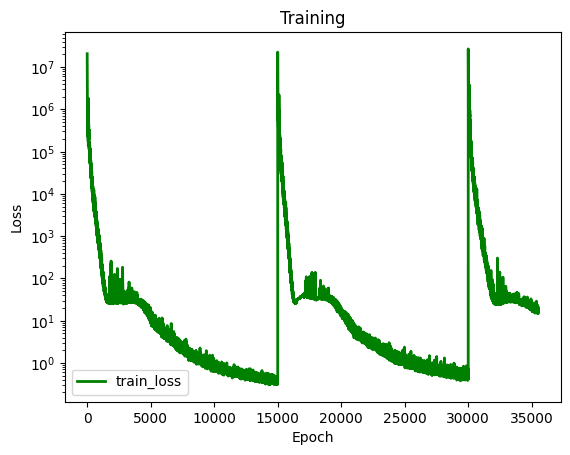

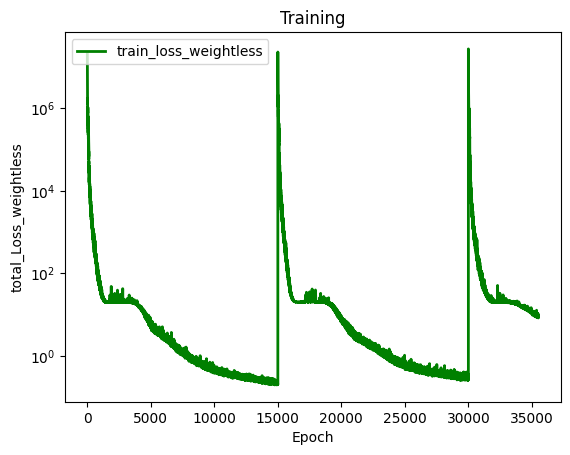

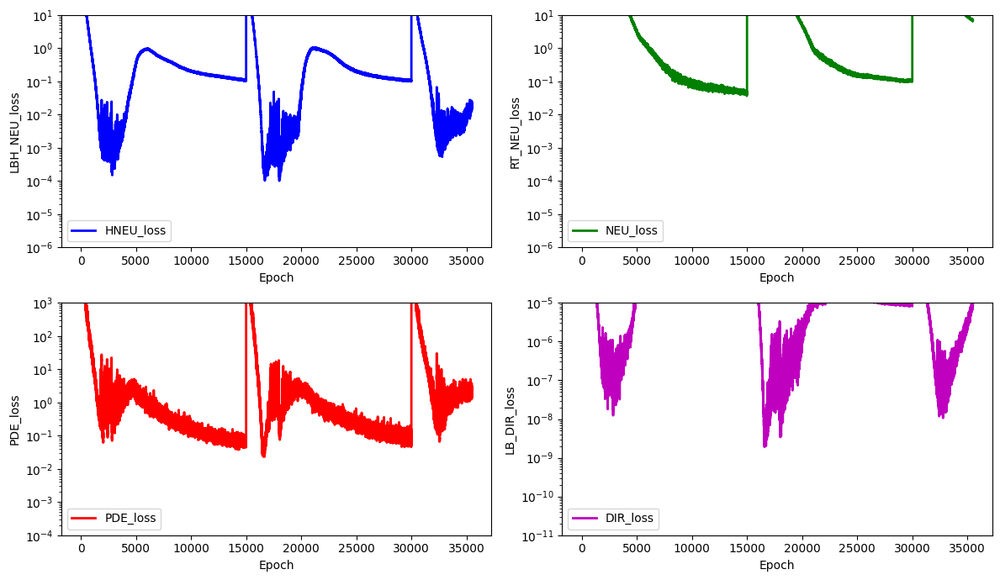

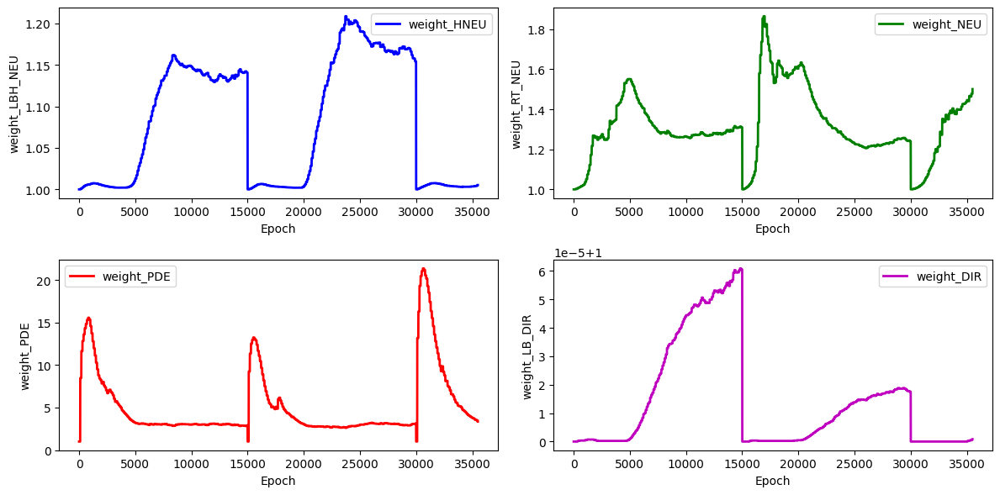

stress_Error for the stress_hole is: 23.26343157641037


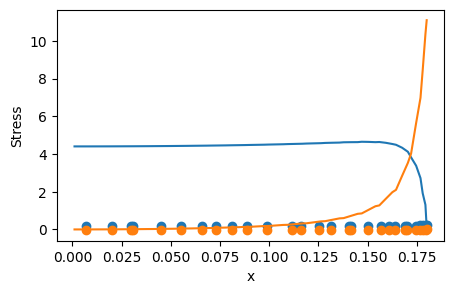

 37%|███▋      | 5600/15000 [35:34<1:01:06,  2.56it/s]

for weight 0 norm_grad: 68.18262481689453
for weight 0 new lamda dach: 1.0099552869796753
for weight 0 new lamdaloss norm: 68.86140441894531
for weight 1 norm_grad: 2153.5283203125
for weight 1 new lamda dach: 1.4520829916000366
for weight 1 new lamdaloss norm: 3127.10205078125
for weight 2 norm_grad: 4695.3681640625
for weight 2 new lamda dach: 3.11338472366333
for weight 2 new lamdaloss norm: 14618.4873046875
for weight 3 norm_grad: 0.01795298047363758
for weight 3 new lamda dach: 1.0000026226043701
for weight 3 new lamdaloss norm: 0.01795302703976631
for weight 0 new weight_value: 1.0057041645050049
for weight 1 new weight_value: 1.4957518577575684
for weight 2 new weight_value: 3.324486255645752
for weight 3 new weight_value: 1.0000009536743164


 38%|███▊      | 5700/15000 [36:14<1:03:45,  2.43it/s]

for weight 0 norm_grad: 69.0954360961914
for weight 0 new lamda dach: 1.0117286443710327
for weight 0 new lamdaloss norm: 69.90583038330078
for weight 1 norm_grad: 2105.617919921875
for weight 1 new lamda dach: 1.5462571382522583
for weight 1 new lamdaloss norm: 3255.82666015625
for weight 2 norm_grad: 3785.512451171875
for weight 2 new lamda dach: 2.7406790256500244
for weight 2 new lamdaloss norm: 10374.875
for weight 3 norm_grad: 0.019911283627152443
for weight 3 new lamda dach: 1.0000033378601074
for weight 3 new lamdaloss norm: 0.019911350682377815
for weight 0 new weight_value: 1.0063066482543945
for weight 1 new weight_value: 1.5008022785186768
for weight 2 new weight_value: 3.2661054134368896
for weight 3 new weight_value: 1.0000011920928955


 39%|███▊      | 5800/15000 [36:54<1:00:38,  2.53it/s]

for weight 0 norm_grad: 78.65900421142578
for weight 0 new lamda dach: 1.0122193098068237
for weight 0 new lamdaloss norm: 79.62015533447266
for weight 1 norm_grad: 1987.132568359375
for weight 1 new lamda dach: 1.4387768507003784
for weight 1 new lamdaloss norm: 2859.040283203125
for weight 2 norm_grad: 4450.1201171875
for weight 2 new lamda dach: 3.1541731357574463
for weight 2 new lamdaloss norm: 14036.44921875
for weight 3 norm_grad: 0.022141337394714355
for weight 3 new lamda dach: 1.0000033378601074
for weight 3 new lamdaloss norm: 0.022141411900520325
for weight 0 new weight_value: 1.0068979263305664
for weight 1 new weight_value: 1.4945995807647705
for weight 2 new weight_value: 3.2549121379852295
for weight 3 new weight_value: 1.0000014305114746


 39%|███▉      | 5900/15000 [37:36<1:03:38,  2.38it/s]

for weight 0 norm_grad: 104.19158935546875
for weight 0 new lamda dach: 1.015820860862732
for weight 0 new lamdaloss norm: 105.83999633789062
for weight 1 norm_grad: 1876.023681640625
for weight 1 new lamda dach: 1.389712929725647
for weight 1 new lamdaloss norm: 2607.13427734375
for weight 2 norm_grad: 4709.640625
for weight 2 new lamda dach: 3.3783154487609863
for weight 2 new lamdaloss norm: 15910.650390625
for weight 3 norm_grad: 0.026806063950061798
for weight 3 new lamda dach: 1.0000040531158447
for weight 3 new lamdaloss norm: 0.026806170120835304
for weight 0 new weight_value: 1.007790207862854
for weight 1 new weight_value: 1.484110951423645
for weight 2 new weight_value: 3.2672524452209473
for weight 3 new weight_value: 1.0000016689300537


 40%|███▉      | 5999/15000 [38:15<58:33,  2.56it/s]  

for weight 0 norm_grad: 141.3662109375
for weight 0 new lamda dach: 1.0262138843536377
for weight 0 new lamdaloss norm: 145.07196044921875
for weight 1 norm_grad: 1800.9259033203125
for weight 1 new lamda dach: 1.482404351234436
for weight 1 new lamdaloss norm: 2669.7001953125
for weight 2 norm_grad: 3591.83056640625
for weight 2 new lamda dach: 2.849243640899658
for weight 2 new lamdaloss norm: 10234.0
for weight 3 norm_grad: 0.032042067497968674
for weight 3 new lamda dach: 1.000005841255188
for weight 3 new lamdaloss norm: 0.0320422537624836
for weight 0 new weight_value: 1.0096325874328613
for weight 1 new weight_value: 1.4839402437210083
for weight 2 new weight_value: 3.2254514694213867
for weight 3 new weight_value: 1.0000020265579224
total_loss: 7.35015869140625, hole_loss:  0.09430631250143051,neumann_loss:  5.1530256271362305, pde_loss: 1.7741098403930664,dirichlet_loss: 3.6707318940898404e-05


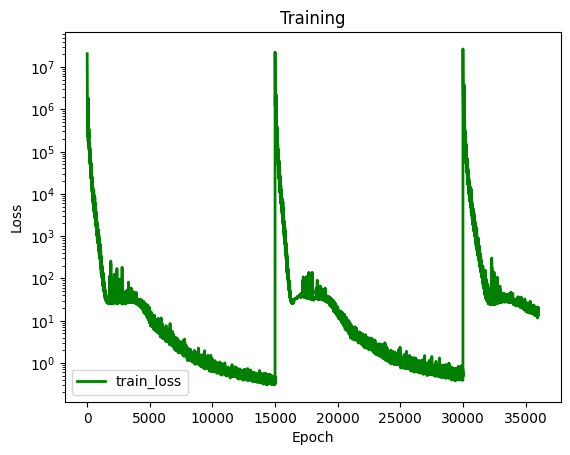

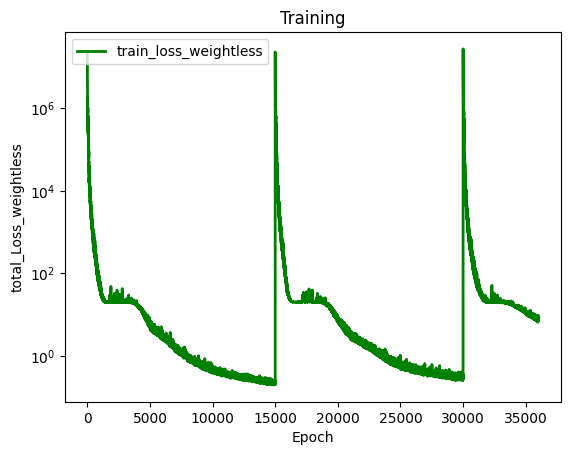

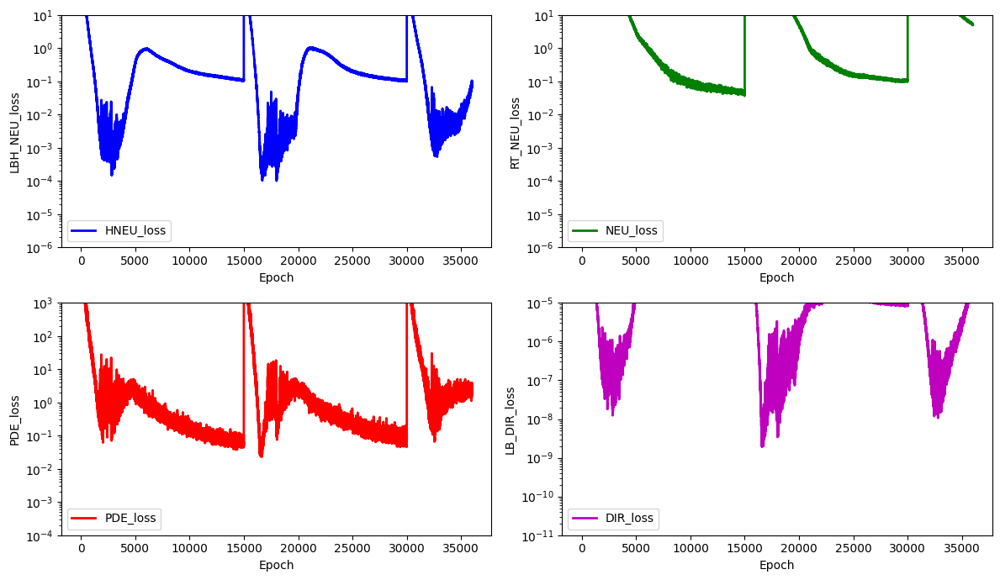

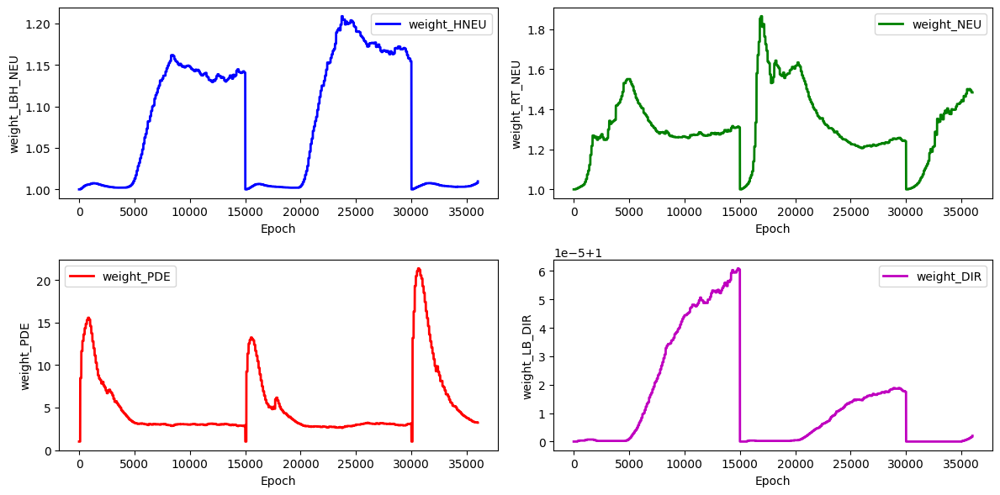

stress_Error for the stress_hole is: 20.203565454240486


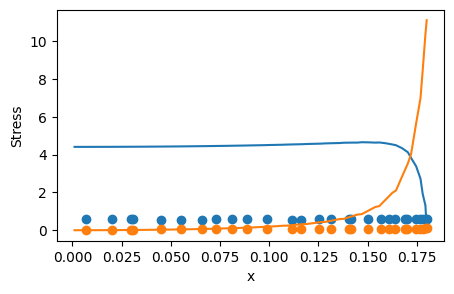

 41%|████      | 6100/15000 [38:58<1:04:15,  2.31it/s]

for weight 0 norm_grad: 172.33428955078125
for weight 0 new lamda dach: 1.0325305461883545
for weight 0 new lamdaloss norm: 177.94039916992188
for weight 1 norm_grad: 1645.029296875
for weight 1 new lamda dach: 1.4300806522369385
for weight 1 new lamdaloss norm: 2352.524658203125
for weight 2 norm_grad: 3652.564208984375
for weight 2 new lamda dach: 3.009777545928955
for weight 2 new lamdaloss norm: 10993.40625
for weight 3 norm_grad: 0.033846914768218994
for weight 3 new lamda dach: 1.0000061988830566
for weight 3 new lamdaloss norm: 0.03384712338447571
for weight 0 new weight_value: 1.0119223594665527
for weight 1 new weight_value: 1.4785542488098145
for weight 2 new weight_value: 3.2038838863372803
for weight 3 new weight_value: 1.000002384185791


 41%|████▏     | 6200/15000 [39:36<57:25,  2.55it/s]  

for weight 0 norm_grad: 219.1178741455078
for weight 0 new lamda dach: 1.0333887338638306
for weight 0 new lamdaloss norm: 226.4339599609375
for weight 1 norm_grad: 1609.6549072265625
for weight 1 new lamda dach: 1.3112202882766724
for weight 1 new lamdaloss norm: 2110.612060546875
for weight 2 norm_grad: 4952.91796875
for weight 2 new lamda dach: 3.7082700729370117
for weight 2 new lamdaloss norm: 18366.755859375
for weight 3 norm_grad: 0.03957627713680267
for weight 3 new lamda dach: 1.000005841255188
for weight 3 new lamdaloss norm: 0.039576511830091476
for weight 0 new weight_value: 1.0140689611434937
for weight 1 new weight_value: 1.4618208408355713
for weight 2 new weight_value: 3.2543222904205322
for weight 3 new weight_value: 1.0000027418136597


 42%|████▏     | 6300/15000 [40:18<56:47,  2.55it/s]  

for weight 0 norm_grad: 266.8000183105469
for weight 0 new lamda dach: 1.0546189546585083
for weight 0 new lamdaloss norm: 281.37237548828125
for weight 1 norm_grad: 1504.12890625
for weight 1 new lamda dach: 1.4123820066452026
for weight 1 new lamdaloss norm: 2124.404541015625
for weight 2 norm_grad: 3380.57421875
for weight 2 new lamda dach: 2.9088821411132812
for weight 2 new lamdaloss norm: 9833.69140625
for weight 3 norm_grad: 0.04183452948927879
for weight 3 new lamda dach: 1.0000081062316895
for weight 3 new lamdaloss norm: 0.04183486849069595
for weight 0 new weight_value: 1.0181238651275635
for weight 1 new weight_value: 1.4568769931793213
for weight 2 new weight_value: 3.219778299331665
for weight 3 new weight_value: 1.0000032186508179


 43%|████▎     | 6400/15000 [41:04<59:54,  2.39it/s]  

for weight 0 norm_grad: 302.4665222167969
for weight 0 new lamda dach: 1.0645090341567993
for weight 0 new lamdaloss norm: 321.9783630371094
for weight 1 norm_grad: 1479.78125
for weight 1 new lamda dach: 1.42141854763031
for weight 1 new lamdaloss norm: 2103.388427734375
for weight 2 norm_grad: 3208.91650390625
for weight 2 new lamda dach: 2.8004417419433594
for weight 2 new lamdaloss norm: 8986.3837890625
for weight 3 norm_grad: 0.04652265086770058
for weight 3 new lamda dach: 1.000009298324585
for weight 3 new lamdaloss norm: 0.0465230830013752
for weight 0 new weight_value: 1.0227622985839844
for weight 1 new weight_value: 1.4533311128616333
for weight 2 new weight_value: 3.177844524383545
for weight 3 new weight_value: 1.0000038146972656


 43%|████▎     | 6499/15000 [41:45<55:36,  2.55it/s]  

for weight 0 norm_grad: 331.8328857421875
for weight 0 new lamda dach: 1.0608972311019897
for weight 0 new lamdaloss norm: 352.04058837890625
for weight 1 norm_grad: 1270.1722412109375
for weight 1 new lamda dach: 1.2815895080566406
for weight 1 new lamdaloss norm: 1627.8394775390625
for weight 2 norm_grad: 4178.84130859375
for weight 2 new lamda dach: 3.608426094055176
for weight 2 new lamdaloss norm: 15079.0400390625
for weight 3 norm_grad: 0.049178190529346466
for weight 3 new lamda dach: 1.0000085830688477
for weight 3 new lamdaloss norm: 0.049178607761859894
for weight 0 new weight_value: 1.0265758037567139
for weight 1 new weight_value: 1.4361568689346313
for weight 2 new weight_value: 3.220902681350708
for weight 3 new weight_value: 1.0000042915344238
total_loss: 5.616766929626465, hole_loss:  0.4147755205631256,neumann_loss:  3.2444896697998047, pde_loss: 1.8061349391937256,dirichlet_loss: 8.211193198803812e-05


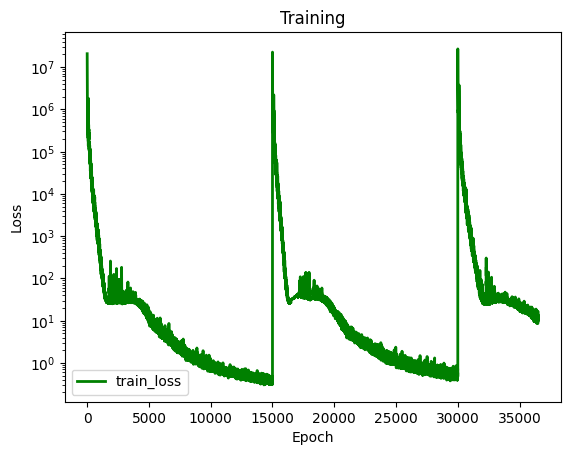

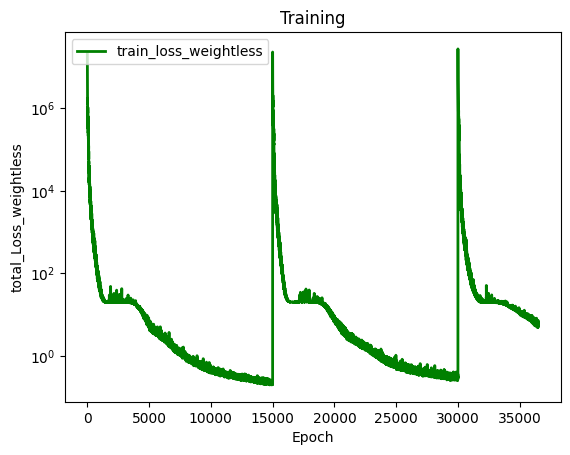

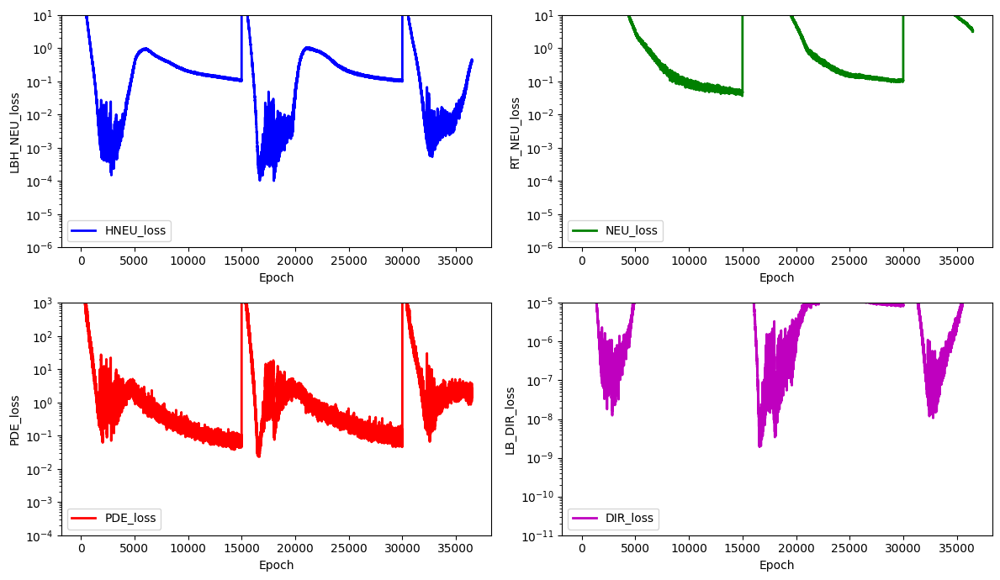

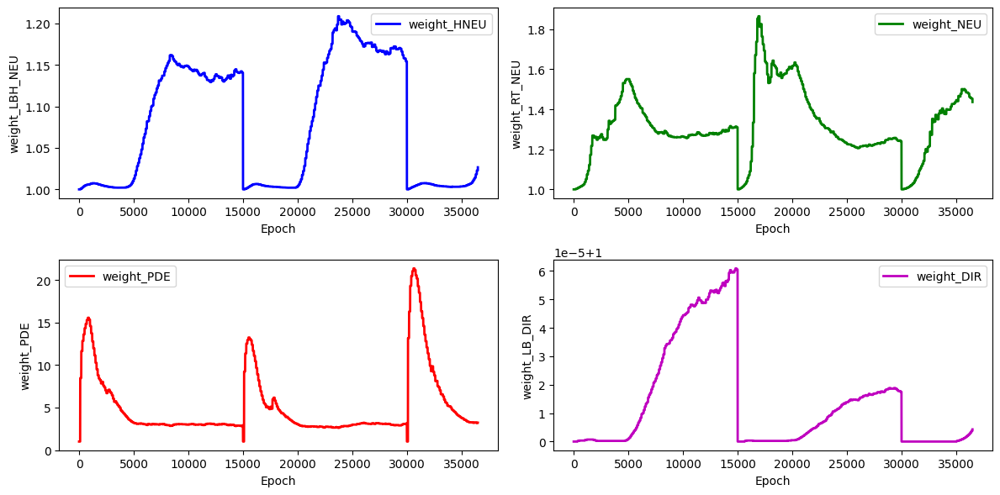

stress_Error for the stress_hole is: 15.814858539644646


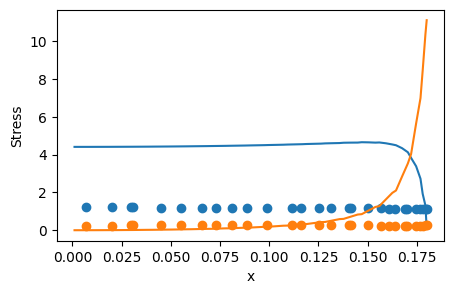

 44%|████▍     | 6600/15000 [42:29<1:07:41,  2.07it/s]

for weight 0 norm_grad: 381.37274169921875
for weight 0 new lamda dach: 1.103255271911621
for weight 0 new lamdaloss norm: 420.75146484375
for weight 1 norm_grad: 1295.4024658203125
for weight 1 new lamda dach: 1.4660617113113403
for weight 1 new lamdaloss norm: 1899.1400146484375
for weight 2 norm_grad: 2398.041259765625
for weight 2 new lamda dach: 2.4301064014434814
for weight 2 new lamdaloss norm: 5827.49560546875
for weight 3 norm_grad: 0.051980163902044296
for weight 3 new lamda dach: 1.000012755393982
for weight 3 new lamdaloss norm: 0.051980823278427124
for weight 0 new weight_value: 1.0342437028884888
for weight 1 new weight_value: 1.4391473531723022
for weight 2 new weight_value: 3.1418228149414062
for weight 3 new weight_value: 1.0000051259994507


 45%|████▍     | 6700/15000 [43:13<58:13,  2.38it/s]  

for weight 0 norm_grad: 394.3551330566406
for weight 0 new lamda dach: 1.090638518333435
for weight 0 new lamdaloss norm: 430.0989074707031
for weight 1 norm_grad: 1169.744140625
for weight 1 new lamda dach: 1.3271584510803223
for weight 1 new lamdaloss norm: 1552.435791015625
for weight 2 norm_grad: 3181.058837890625
for weight 2 new lamda dach: 3.0337274074554443
for weight 2 new lamdaloss norm: 9650.466796875
for weight 3 norm_grad: 0.052687209099531174
for weight 3 new lamda dach: 1.0000110864639282
for weight 3 new lamdaloss norm: 0.05268779769539833
for weight 0 new weight_value: 1.0398831367492676
for weight 1 new weight_value: 1.4279483556747437
for weight 2 new weight_value: 3.1310133934020996
for weight 3 new weight_value: 1.0000057220458984


 45%|████▌     | 6800/15000 [43:53<56:57,  2.40it/s]  

for weight 0 norm_grad: 416.8460693359375
for weight 0 new lamda dach: 1.1079879999160767
for weight 0 new lamdaloss norm: 461.86041259765625
for weight 1 norm_grad: 1125.9381103515625
for weight 1 new lamda dach: 1.357324481010437
for weight 1 new lamdaloss norm: 1528.26318359375
for weight 2 norm_grad: 2734.12255859375
for weight 2 new lamda dach: 2.772136926651001
for weight 2 new lamdaloss norm: 7579.36181640625
for weight 3 norm_grad: 0.055276669561862946
for weight 3 new lamda dach: 1.0000128746032715
for weight 3 new lamdaloss norm: 0.05527738481760025
for weight 0 new weight_value: 1.0466935634613037
for weight 1 new weight_value: 1.4208859205245972
for weight 2 new weight_value: 3.095125675201416
for weight 3 new weight_value: 1.0000064373016357


 46%|████▌     | 6900/15000 [44:34<55:10,  2.45it/s]  

for weight 0 norm_grad: 428.6695861816406
for weight 0 new lamda dach: 1.115574598312378
for weight 0 new lamdaloss norm: 478.2129211425781
for weight 1 norm_grad: 998.9862060546875
for weight 1 new lamda dach: 1.3182790279388428
for weight 1 new lamdaloss norm: 1316.9425048828125
for weight 2 norm_grad: 2709.9873046875
for weight 2 new lamda dach: 2.898134469985962
for weight 2 new lamdaloss norm: 7853.9072265625
for weight 3 norm_grad: 0.05505495145916939
for weight 3 new lamda dach: 1.0000133514404297
for weight 3 new lamdaloss norm: 0.055055685341358185
for weight 0 new weight_value: 1.0535815954208374
for weight 1 new weight_value: 1.4106252193450928
for weight 2 new weight_value: 3.0754265785217285
for weight 3 new weight_value: 1.000007152557373


 47%|████▋     | 6999/15000 [45:13<53:29,  2.49it/s]  

for weight 0 norm_grad: 469.751708984375
for weight 0 new lamda dach: 1.1077553033828735
for weight 0 new lamdaloss norm: 520.3699951171875
for weight 1 norm_grad: 1022.4075317382812
for weight 1 new lamda dach: 1.2685761451721191
for weight 1 new lamdaloss norm: 1297.0018310546875
for weight 2 norm_grad: 3336.96435546875
for weight 2 new lamda dach: 3.2362523078918457
for weight 2 new lamdaloss norm: 10799.2587890625
for weight 3 norm_grad: 0.05366549268364906
for weight 3 new lamda dach: 1.0000110864639282
for weight 3 new lamdaloss norm: 0.05366608873009682
for weight 0 new weight_value: 1.058998942375183
for weight 1 new weight_value: 1.3964203596115112
for weight 2 new weight_value: 3.0915091037750244
for weight 3 new weight_value: 1.0000075101852417
total_loss: 5.079189777374268, hole_loss:  0.8421854972839355,neumann_loss:  2.4304440021514893, pde_loss: 1.4774830341339111,dirichlet_loss: 9.866228356258944e-05


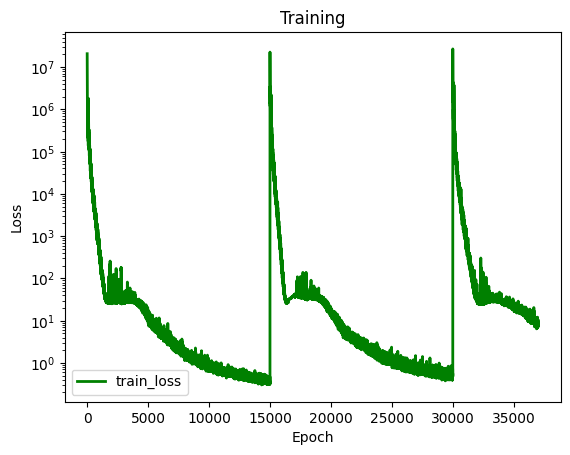

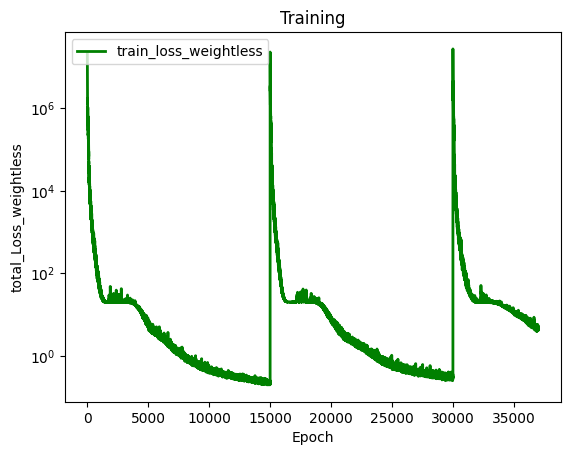

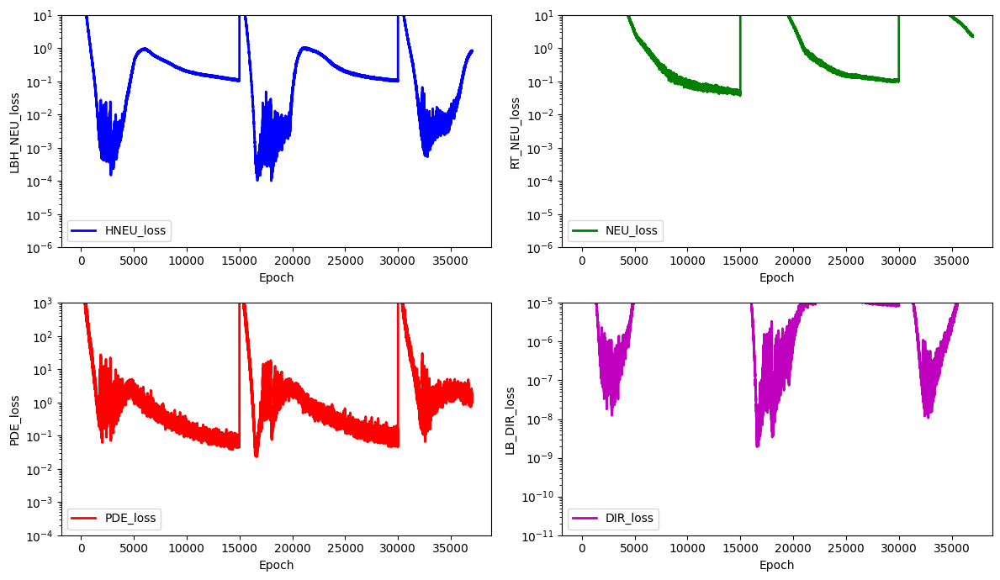

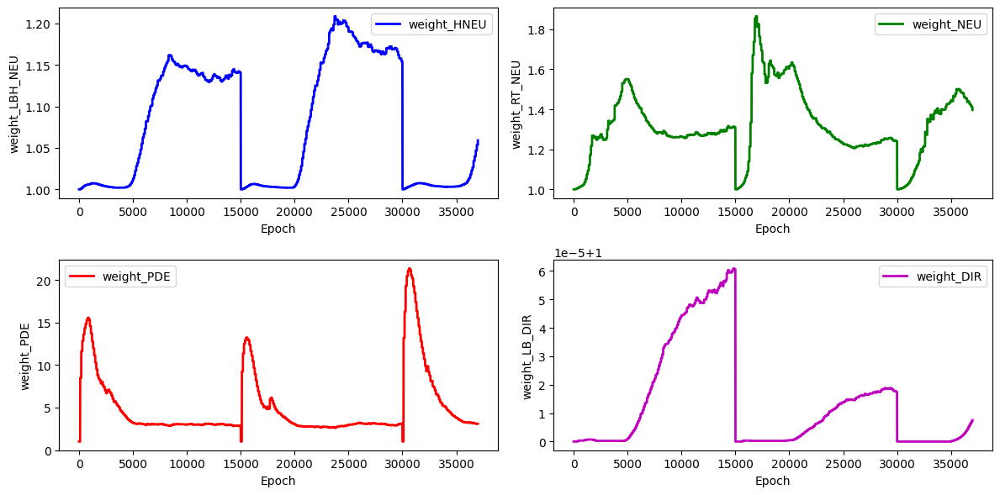

stress_Error for the stress_hole is: 12.833010058078008


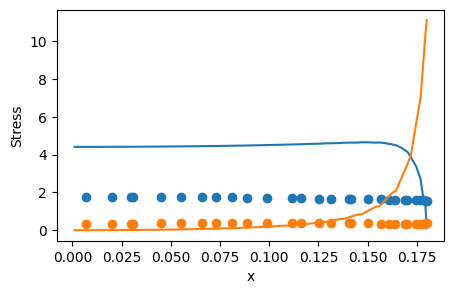

 47%|████▋     | 7100/15000 [45:56<56:01,  2.35it/s]  

for weight 0 norm_grad: 486.47906494140625
for weight 0 new lamda dach: 1.1386271715164185
for weight 0 new lamdaloss norm: 553.9182739257812
for weight 1 norm_grad: 951.2697143554688
for weight 1 new lamda dach: 1.3124580383300781
for weight 1 new lamdaloss norm: 1248.50146484375
for weight 2 norm_grad: 2557.936767578125
for weight 2 new lamda dach: 2.7790567874908447
for weight 2 new lamdaloss norm: 7108.65234375
for weight 3 norm_grad: 0.05606836453080177
for weight 3 new lamda dach: 1.000014066696167
for weight 3 new lamdaloss norm: 0.05606915056705475
for weight 0 new weight_value: 1.0669617652893066
for weight 1 new weight_value: 1.388024091720581
for weight 2 new weight_value: 3.0602638721466064
for weight 3 new weight_value: 1.0000081062316895


 48%|████▊     | 7200/15000 [46:37<53:00,  2.45it/s]  

for weight 0 norm_grad: 501.8805236816406
for weight 0 new lamda dach: 1.1557903289794922
for weight 0 new lamdaloss norm: 580.0687255859375
for weight 1 norm_grad: 850.448974609375
for weight 1 new lamda dach: 1.2960200309753418
for weight 1 new lamdaloss norm: 1102.198974609375
for weight 2 norm_grad: 2371.0078125
for weight 2 new lamda dach: 2.753203868865967
for weight 2 new lamdaloss norm: 6527.8681640625
for weight 3 norm_grad: 0.05618933215737343
for weight 3 new lamda dach: 1.000015139579773
for weight 3 new lamdaloss norm: 0.05619017779827118
for weight 0 new weight_value: 1.075844645500183
for weight 1 new weight_value: 1.3788236379623413
for weight 2 new weight_value: 3.029557704925537
for weight 3 new weight_value: 1.0000088214874268


 49%|████▊     | 7300/15000 [47:18<53:40,  2.39it/s]  

for weight 0 norm_grad: 503.80084228515625
for weight 0 new lamda dach: 1.165604829788208
for weight 0 new lamdaloss norm: 587.232666015625
for weight 1 norm_grad: 824.2282104492188
for weight 1 new lamda dach: 1.3028291463851929
for weight 1 new lamdaloss norm: 1073.8284912109375
for weight 2 norm_grad: 2217.9033203125
for weight 2 new lamda dach: 2.670001745223999
for weight 2 new lamdaloss norm: 5921.80615234375
for weight 3 norm_grad: 0.05538789927959442
for weight 3 new lamda dach: 1.0000156164169312
for weight 3 new lamdaloss norm: 0.05538876727223396
for weight 0 new weight_value: 1.0848206281661987
for weight 1 new weight_value: 1.3712241649627686
for weight 2 new weight_value: 2.9936020374298096
for weight 3 new weight_value: 1.0000094175338745


 49%|████▉     | 7400/15000 [47:57<49:05,  2.58it/s]

for weight 0 norm_grad: 490.72186279296875
for weight 0 new lamda dach: 1.1591997146606445
for weight 0 new lamdaloss norm: 568.8446655273438
for weight 1 norm_grad: 757.2391357421875
for weight 1 new lamda dach: 1.2689143419265747
for weight 1 new lamdaloss norm: 960.8716430664062
for weight 2 norm_grad: 2325.13525390625
for weight 2 new lamda dach: 2.863065481185913
for weight 2 new lamdaloss norm: 6657.013671875
for weight 3 norm_grad: 0.05501771718263626
for weight 3 new lamda dach: 1.000015377998352
for weight 3 new lamdaloss norm: 0.05501856282353401
for weight 0 new weight_value: 1.0922585725784302
for weight 1 new weight_value: 1.3609931468963623
for weight 2 new weight_value: 2.98054838180542
for weight 3 new weight_value: 1.0000100135803223


 50%|████▉     | 7499/15000 [48:35<46:59,  2.66it/s]

for weight 0 norm_grad: 488.4732360839844
for weight 0 new lamda dach: 1.1684136390686035
for weight 0 new lamdaloss norm: 570.7388305664062
for weight 1 norm_grad: 774.94921875
for weight 1 new lamda dach: 1.2964653968811035
for weight 1 new lamdaloss norm: 1004.6947631835938
for weight 2 norm_grad: 2125.4345703125
for weight 2 new lamda dach: 2.6822116374969482
for weight 2 new lamdaloss norm: 5700.865234375
for weight 3 norm_grad: 0.054039739072322845
for weight 3 new lamda dach: 1.0000159740447998
for weight 3 new lamdaloss norm: 0.05404060333967209
for weight 0 new weight_value: 1.0998740196228027
for weight 1 new weight_value: 1.3545403480529785
for weight 2 new weight_value: 2.950714588165283
for weight 3 new weight_value: 1.00001060962677
total_loss: 3.418147563934326, hole_loss:  0.9679473042488098,neumann_loss:  1.7032746076583862, pde_loss: 0.7116498351097107,dirichlet_loss: 0.00010219188698101789


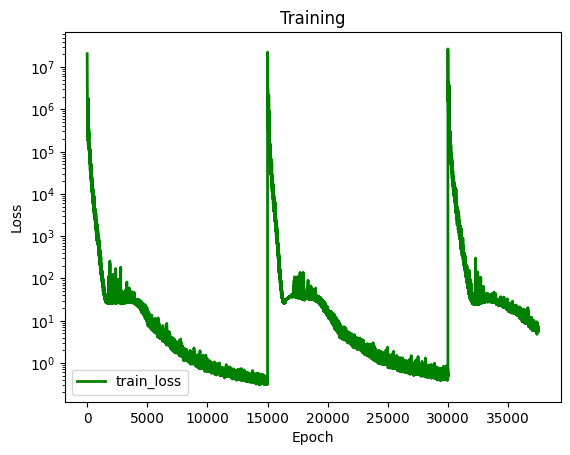

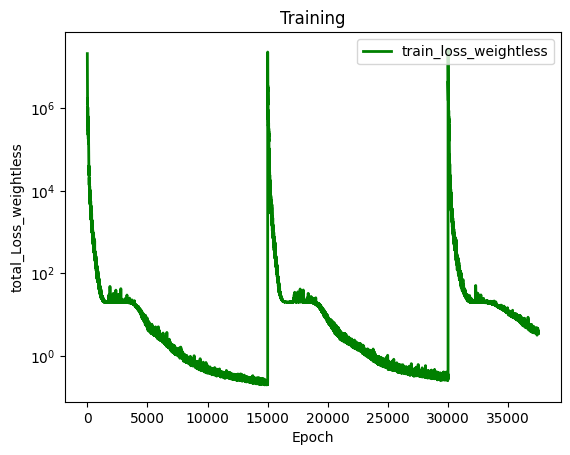

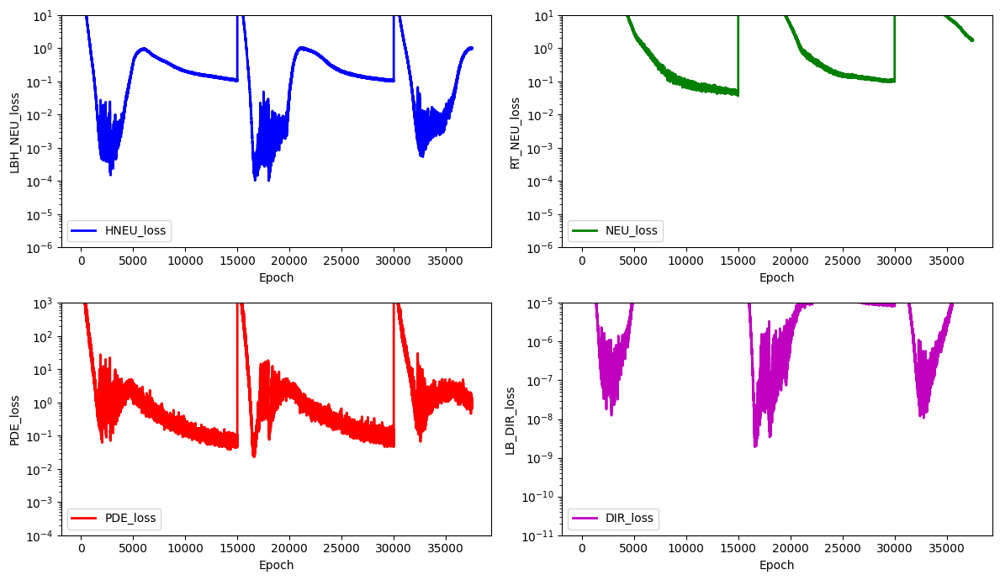

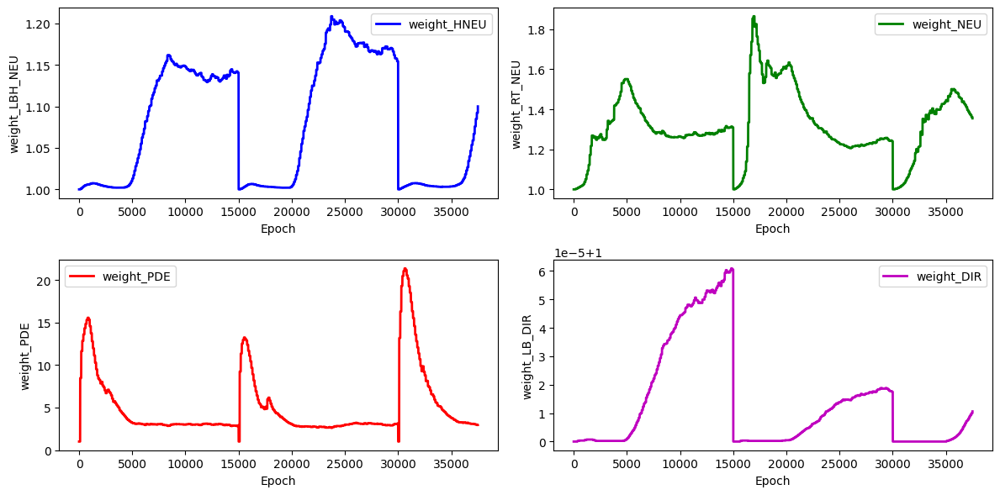

stress_Error for the stress_hole is: 11.971252311263633


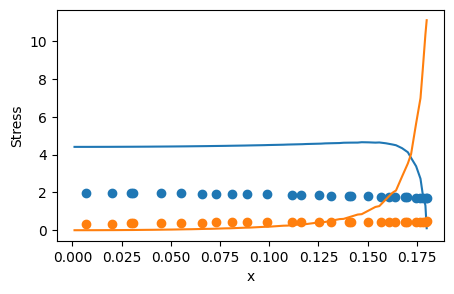

 51%|█████     | 7600/15000 [49:18<48:24,  2.55it/s]  

for weight 0 norm_grad: 490.5764465332031
for weight 0 new lamda dach: 1.1490581035614014
for weight 0 new lamdaloss norm: 563.7008666992188
for weight 1 norm_grad: 765.0677490234375
for weight 1 new lamda dach: 1.2536121606826782
for weight 1 new lamdaloss norm: 959.0982666015625
for weight 2 norm_grad: 2526.053466796875
for weight 2 new lamda dach: 3.011671304702759
for weight 2 new lamdaloss norm: 7607.642578125
for weight 3 norm_grad: 0.05463092029094696
for weight 3 new lamda dach: 1.0000144243240356
for weight 3 new lamdaloss norm: 0.054631710052490234
for weight 0 new weight_value: 1.1047923564910889
for weight 1 new weight_value: 1.3444474935531616
for weight 2 new weight_value: 2.9568099975585938
for weight 3 new weight_value: 1.0000109672546387


 51%|█████▏    | 7700/15000 [49:59<47:29,  2.56it/s]

for weight 0 norm_grad: 495.26165771484375
for weight 0 new lamda dach: 1.190194010734558
for weight 0 new lamdaloss norm: 589.4574584960938
for weight 1 norm_grad: 702.9615478515625
for weight 1 new lamda dach: 1.293355107307434
for weight 1 new lamdaloss norm: 909.1788940429688
for weight 2 norm_grad: 1900.9681396484375
for weight 2 new lamda dach: 2.5864195823669434
for weight 2 new lamdaloss norm: 4916.701171875
for weight 3 norm_grad: 0.05248500034213066
for weight 3 new lamda dach: 1.0000169277191162
for weight 3 new lamdaloss norm: 0.052485886961221695
for weight 0 new weight_value: 1.1133325099945068
for weight 1 new weight_value: 1.3393381834030151
for weight 2 new weight_value: 2.9197709560394287
for weight 3 new weight_value: 1.0000115633010864


 52%|█████▏    | 7800/15000 [50:38<46:44,  2.57it/s]

for weight 0 norm_grad: 487.43359375
for weight 0 new lamda dach: 1.1615749597549438
for weight 0 new lamdaloss norm: 566.1906127929688
for weight 1 norm_grad: 705.4537353515625
for weight 1 new lamda dach: 1.252060890197754
for weight 1 new lamdaloss norm: 883.27099609375
for weight 2 norm_grad: 2311.256591796875
for weight 2 new lamda dach: 2.9374451637268066
for weight 2 new lamdaloss norm: 6789.18994140625
for weight 3 norm_grad: 0.05308105796575546
for weight 3 new lamda dach: 1.000015139579773
for weight 3 new lamdaloss norm: 0.05308186262845993
for weight 0 new weight_value: 1.1181567907333374
for weight 1 new weight_value: 1.3306103944778442
for weight 2 new weight_value: 2.9215383529663086
for weight 3 new weight_value: 1.000011920928955


 53%|█████▎    | 7900/15000 [51:19<51:52,  2.28it/s]

for weight 0 norm_grad: 475.7411804199219
for weight 0 new lamda dach: 1.1719495058059692
for weight 0 new lamdaloss norm: 557.544677734375
for weight 1 norm_grad: 709.4630126953125
for weight 1 new lamda dach: 1.2800848484039307
for weight 1 new lamdaloss norm: 908.1727905273438
for weight 2 norm_grad: 2057.235595703125
for weight 2 new lamda dach: 2.735689401626587
for weight 2 new lamdaloss norm: 5627.9580078125
for weight 3 norm_grad: 0.051239173859357834
for weight 3 new lamda dach: 1.0000158548355103
for weight 3 new lamdaloss norm: 0.0512399822473526
for weight 0 new weight_value: 1.1235361099243164
for weight 1 new weight_value: 1.325557827949524
for weight 2 new weight_value: 2.9029533863067627
for weight 3 new weight_value: 1.0000122785568237


 53%|█████▎    | 7999/15000 [51:58<45:26,  2.57it/s]

for weight 0 norm_grad: 478.71673583984375
for weight 0 new lamda dach: 1.1673890352249146
for weight 0 new lamdaloss norm: 558.8486328125
for weight 1 norm_grad: 651.5541381835938
for weight 1 new lamda dach: 1.2424777746200562
for weight 1 new lamdaloss norm: 809.5415649414062
for weight 2 norm_grad: 2208.2998046875
for weight 2 new lamda dach: 2.9536917209625244
for weight 2 new lamdaloss norm: 6522.63720703125
for weight 3 norm_grad: 0.050477735698223114
for weight 3 new lamda dach: 1.000015139579773
for weight 3 new lamdaloss norm: 0.0504785031080246
for weight 0 new weight_value: 1.1279213428497314
for weight 1 new weight_value: 1.3172497749328613
for weight 2 new weight_value: 2.908027172088623
for weight 3 new weight_value: 1.0000125169754028
total_loss: 3.255059003829956, hole_loss:  1.0091956853866577,neumann_loss:  1.329440712928772, pde_loss: 0.7460994720458984,dirichlet_loss: 9.065549238584936e-05


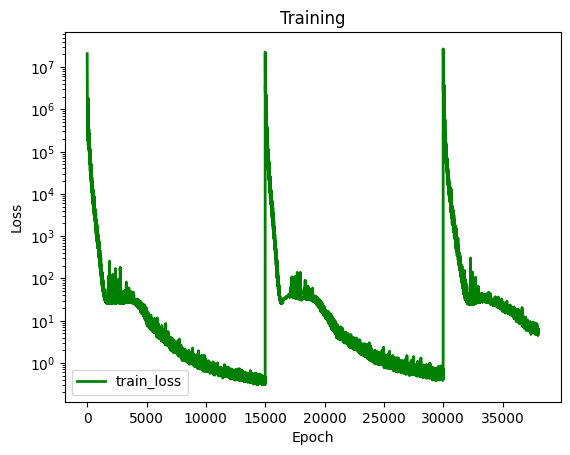

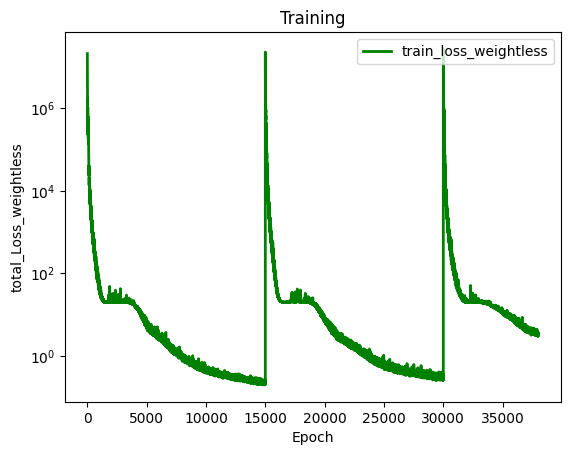

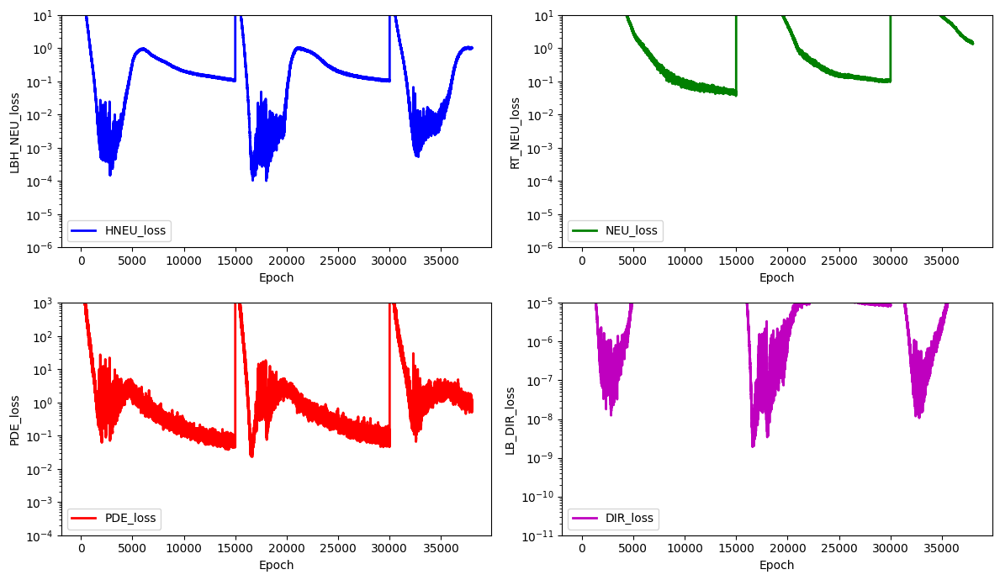

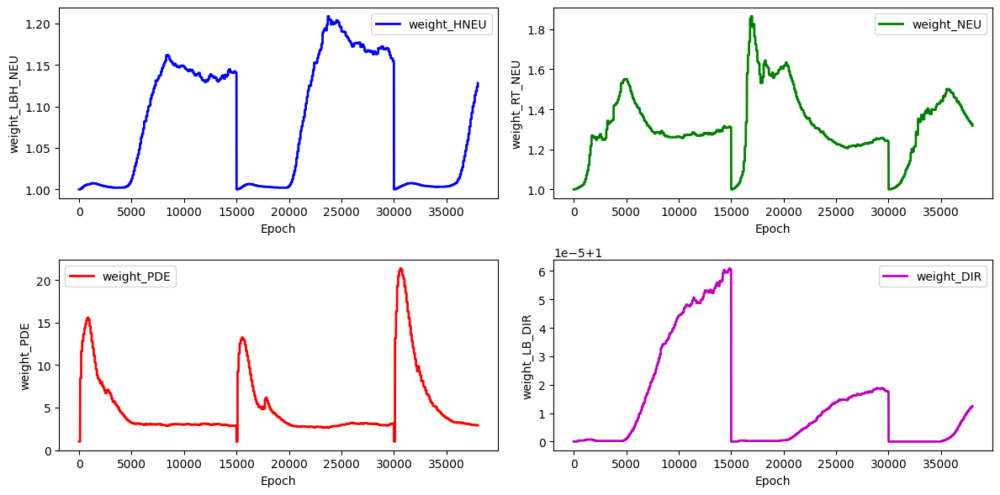

stress_Error for the stress_hole is: 11.55936209688889


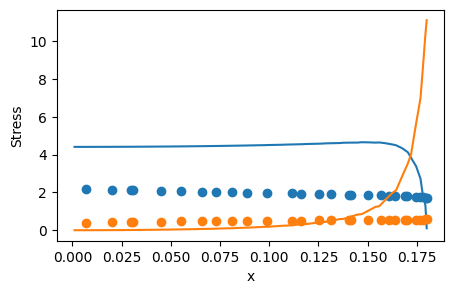

 54%|█████▍    | 8100/15000 [52:41<44:03,  2.61it/s]  

for weight 0 norm_grad: 492.2742614746094
for weight 0 new lamda dach: 1.2154581546783447
for weight 0 new lamdaloss norm: 598.3388061523438
for weight 1 norm_grad: 662.5301513671875
for weight 1 new lamda dach: 1.3133236169815063
for weight 1 new lamdaloss norm: 870.1165771484375
for weight 2 norm_grad: 1622.1971435546875
for weight 2 new lamda dach: 2.404675006866455
for weight 2 new lamdaloss norm: 3900.856689453125
for weight 3 norm_grad: 0.051437824964523315
for weight 3 new lamda dach: 1.00001859664917
for weight 3 new lamdaloss norm: 0.05143877863883972
for weight 0 new weight_value: 1.1366750001907349
for weight 1 new weight_value: 1.3168572187423706
for weight 2 new weight_value: 2.857692003250122
for weight 3 new weight_value: 1.0000131130218506


 55%|█████▍    | 8200/15000 [53:22<45:33,  2.49it/s]

for weight 0 norm_grad: 479.0430908203125
for weight 0 new lamda dach: 1.2132229804992676
for weight 0 new lamdaloss norm: 581.1860961914062
for weight 1 norm_grad: 645.9102783203125
for weight 1 new lamda dach: 1.3105621337890625
for weight 1 new lamdaloss norm: 846.5055541992188
for weight 2 norm_grad: 1600.7171630859375
for weight 2 new lamda dach: 2.4228549003601074
for weight 2 new lamdaloss norm: 3878.305419921875
for weight 3 norm_grad: 0.05052883177995682
for weight 3 new lamda dach: 1.00001859664917
for weight 3 new lamdaloss norm: 0.05052977055311203
for weight 0 new weight_value: 1.1443297863006592
for weight 1 new weight_value: 1.316227674484253
for weight 2 new weight_value: 2.8142082691192627
for weight 3 new weight_value: 1.0000135898590088


 55%|█████▌    | 8300/15000 [54:01<43:58,  2.54it/s]

for weight 0 norm_grad: 473.710205078125
for weight 0 new lamda dach: 1.1891034841537476
for weight 0 new lamdaloss norm: 563.2904663085938
for weight 1 norm_grad: 594.0655517578125
for weight 1 new lamda dach: 1.2491178512573242
for weight 1 new lamdaloss norm: 742.0579223632812
for weight 2 norm_grad: 1910.9171142578125
for weight 2 new lamda dach: 2.789541006088257
for weight 2 new lamdaloss norm: 5330.58154296875
for weight 3 norm_grad: 0.049548014998435974
for weight 3 new lamda dach: 1.000016689300537
for weight 3 new lamdaloss norm: 0.04954884201288223
for weight 0 new weight_value: 1.1488070487976074
for weight 1 new weight_value: 1.3095166683197021
for weight 2 new weight_value: 2.811741352081299
for weight 3 new weight_value: 1.000013828277588


 56%|█████▌    | 8400/15000 [54:42<44:00,  2.50it/s]

for weight 0 norm_grad: 470.05718994140625
for weight 0 new lamda dach: 1.1582181453704834
for weight 0 new lamdaloss norm: 544.4287719726562
for weight 1 norm_grad: 647.7356567382812
for weight 1 new lamda dach: 1.2318919897079468
for weight 1 new lamdaloss norm: 797.9403686523438
for weight 2 norm_grad: 2323.158935546875
for weight 2 new lamda dach: 3.0782546997070312
for weight 2 new lamdaloss norm: 7151.27490234375
for weight 3 norm_grad: 0.048679985105991364
for weight 3 new lamda dach: 1.000014066696167
for weight 3 new lamdaloss norm: 0.04868066683411598
for weight 0 new weight_value: 1.1497482061386108
for weight 1 new weight_value: 1.3017542362213135
for weight 2 new weight_value: 2.838392734527588
for weight 3 new weight_value: 1.000013828277588


 57%|█████▋    | 8499/15000 [55:21<41:16,  2.62it/s]

for weight 0 norm_grad: 443.93280029296875
for weight 0 new lamda dach: 1.2048333883285522
for weight 0 new lamdaloss norm: 534.8650512695312
for weight 1 norm_grad: 606.26220703125
for weight 1 new lamda dach: 1.3023815155029297
for weight 1 new lamdaloss norm: 789.584716796875
for weight 2 norm_grad: 1560.9774169921875
for weight 2 new lamda dach: 2.4863014221191406
for weight 2 new lamdaloss norm: 3881.060546875
for weight 3 norm_grad: 0.047891490161418915
for weight 3 new lamda dach: 1.0000183582305908
for weight 3 new lamdaloss norm: 0.04789236932992935
for weight 0 new weight_value: 1.155256748199463
for weight 1 new weight_value: 1.3018169403076172
for weight 2 new weight_value: 2.8031835556030273
for weight 3 new weight_value: 1.000014305114746
total_loss: 2.6963112354278564, hole_loss:  0.9500122666358948,neumann_loss:  1.1283681392669678, pde_loss: 0.5477398633956909,dirichlet_loss: 8.046397124417126e-05


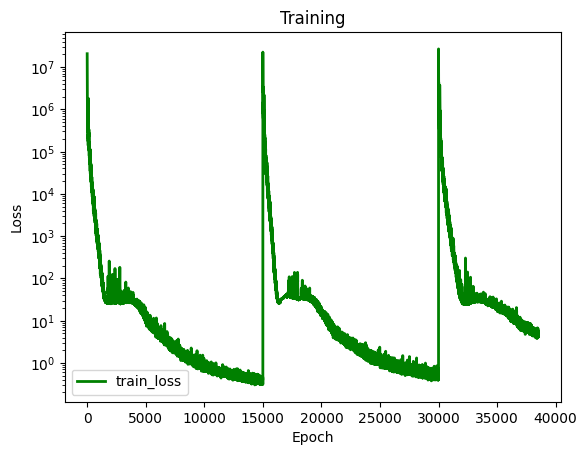

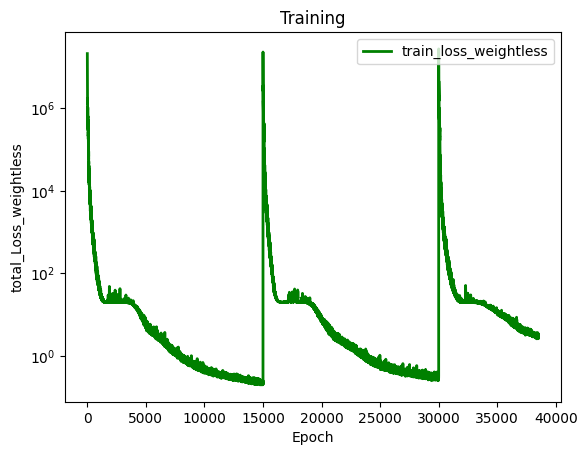

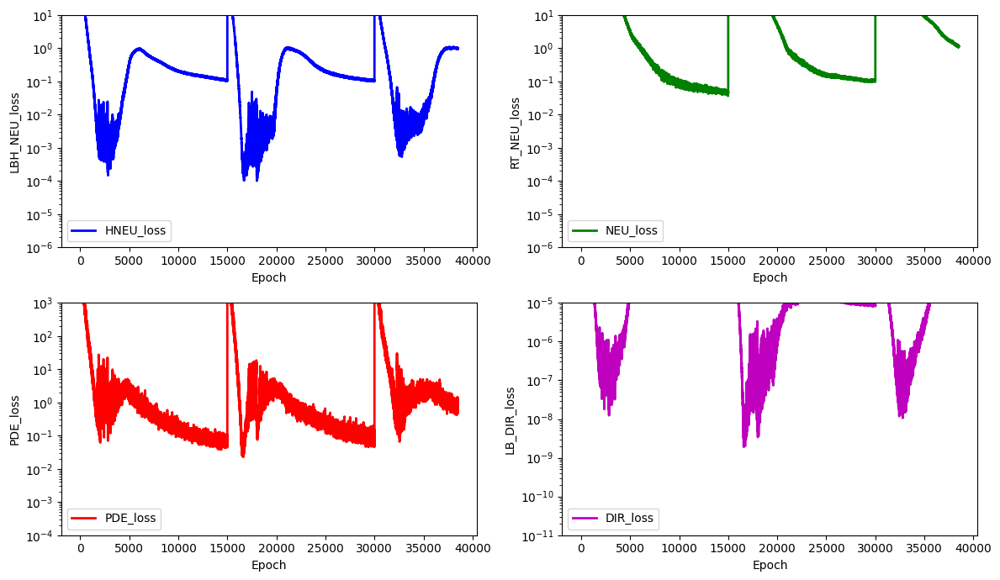

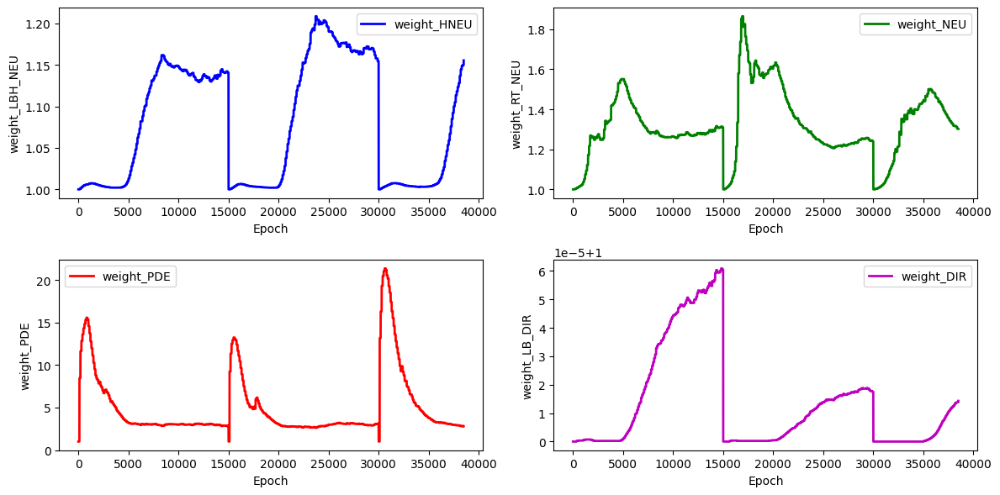

stress_Error for the stress_hole is: 11.267957438441599


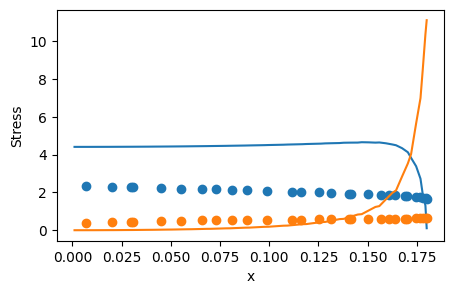

 57%|█████▋    | 8600/15000 [56:04<41:43,  2.56it/s]  

for weight 0 norm_grad: 438.8610534667969
for weight 0 new lamda dach: 1.1843600273132324
for weight 0 new lamdaloss norm: 519.76953125
for weight 1 norm_grad: 600.8526611328125
for weight 1 new lamda dach: 1.2708417177200317
for weight 1 new lamdaloss norm: 763.588623046875
for weight 2 norm_grad: 1779.5577392578125
for weight 2 new lamda dach: 2.7115092277526855
for weight 2 new lamdaloss norm: 4825.287109375
for weight 3 norm_grad: 0.045648906379938126
for weight 3 new lamda dach: 1.000016212463379
for weight 3 new lamdaloss norm: 0.04564964398741722
for weight 0 new weight_value: 1.1581670045852661
for weight 1 new weight_value: 1.2987194061279297
for weight 2 new weight_value: 2.794015884399414
for weight 3 new weight_value: 1.0000144243240356


 58%|█████▊    | 8700/15000 [56:44<41:52,  2.51it/s]

for weight 0 norm_grad: 438.2091979980469
for weight 0 new lamda dach: 1.1556954383850098
for weight 0 new lamdaloss norm: 506.4364013671875
for weight 1 norm_grad: 602.4042358398438
for weight 1 new lamda dach: 1.227293848991394
for weight 1 new lamdaloss norm: 739.3269653320312
for weight 2 norm_grad: 2212.07861328125
for weight 2 new lamda dach: 3.1256539821624756
for weight 2 new lamdaloss norm: 6914.19189453125
for weight 3 norm_grad: 0.04466445371508598
for weight 3 new lamda dach: 1.0000137090682983
for weight 3 new lamdaloss norm: 0.04466506838798523
for weight 0 new weight_value: 1.1579198837280273
for weight 1 new weight_value: 1.291576862335205
for weight 2 new weight_value: 2.8271796703338623
for weight 3 new weight_value: 1.000014305114746


 59%|█████▊    | 8800/15000 [57:23<40:23,  2.56it/s]

for weight 0 norm_grad: 430.14093017578125
for weight 0 new lamda dach: 1.1886476278305054
for weight 0 new lamdaloss norm: 511.2860107421875
for weight 1 norm_grad: 577.8523559570312
for weight 1 new lamda dach: 1.2709845304489136
for weight 1 new lamdaloss norm: 734.4413452148438
for weight 2 norm_grad: 1702.2315673828125
for weight 2 new lamda dach: 2.688657283782959
for weight 2 new lamdaloss norm: 4576.7177734375
for weight 3 norm_grad: 0.04520713537931442
for weight 3 new lamda dach: 1.000016689300537
for weight 3 new lamdaloss norm: 0.04520788788795471
for weight 0 new weight_value: 1.1609926223754883
for weight 1 new weight_value: 1.2895176410675049
for weight 2 new weight_value: 2.8133275508880615
for weight 3 new weight_value: 1.0000145435333252


 59%|█████▉    | 8900/15000 [58:04<43:09,  2.36it/s]

for weight 0 norm_grad: 424.74505615234375
for weight 0 new lamda dach: 1.178711175918579
for weight 0 new lamdaloss norm: 500.6517333984375
for weight 1 norm_grad: 559.830078125
for weight 1 new lamda dach: 1.2497426271438599
for weight 1 new lamdaloss norm: 699.6435546875
for weight 2 norm_grad: 1816.8388671875
for weight 2 new lamda dach: 2.8452203273773193
for weight 2 new lamdaloss norm: 5169.30712890625
for weight 3 norm_grad: 0.043643608689308167
for weight 3 new lamda dach: 1.0000156164169312
for weight 3 new lamdaloss norm: 0.043644290417432785
for weight 0 new weight_value: 1.162764549255371
for weight 1 new weight_value: 1.2855401039123535
for weight 2 new weight_value: 2.816516876220703
for weight 3 new weight_value: 1.0000146627426147


 60%|█████▉    | 8999/15000 [58:44<40:29,  2.47it/s]

for weight 0 norm_grad: 418.27911376953125
for weight 0 new lamda dach: 1.1485096216201782
for weight 0 new lamdaloss norm: 480.3975830078125
for weight 1 norm_grad: 544.4364013671875
for weight 1 new lamda dach: 1.2023661136627197
for weight 1 new lamdaloss norm: 654.6119384765625
for weight 2 norm_grad: 2272.031005859375
for weight 2 new lamda dach: 3.3599166870117188
for weight 2 new lamdaloss norm: 7633.833984375
for weight 3 norm_grad: 0.04339850693941116
for weight 3 new lamda dach: 1.0000134706497192
for weight 3 new lamdaloss norm: 0.04339909180998802
for weight 0 new weight_value: 1.1613390445709229
for weight 1 new weight_value: 1.277222752571106
for weight 2 new weight_value: 2.870856761932373
for weight 3 new weight_value: 1.0000145435333252
total_loss: 2.484074115753174, hole_loss:  0.8704949021339417,neumann_loss:  0.9086337089538574, pde_loss: 0.7298109531402588,dirichlet_loss: 6.916245183674619e-05


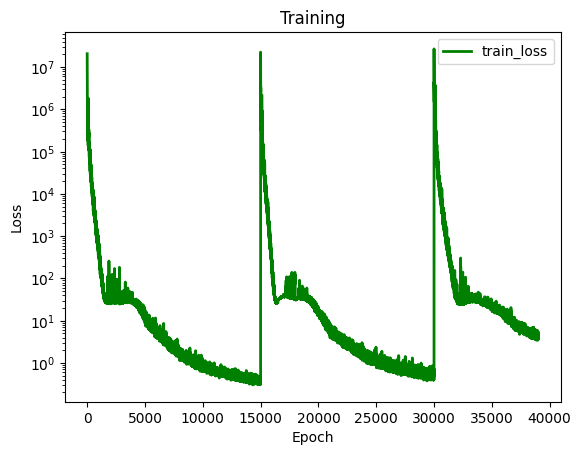

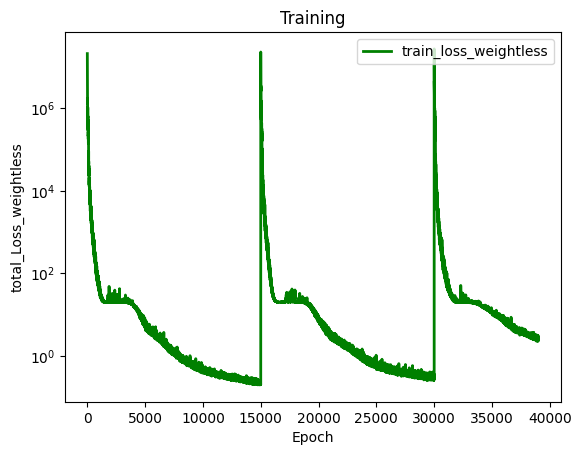

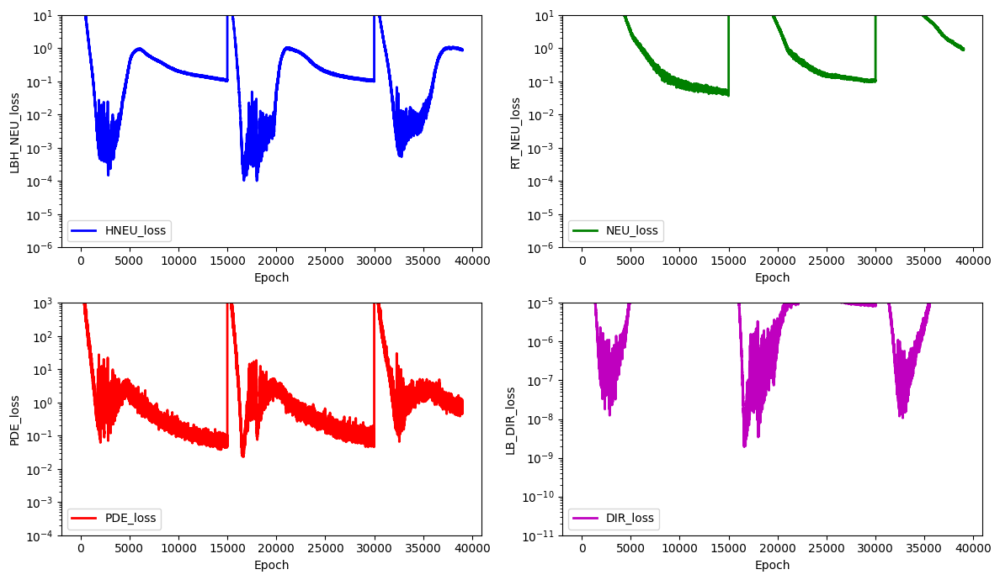

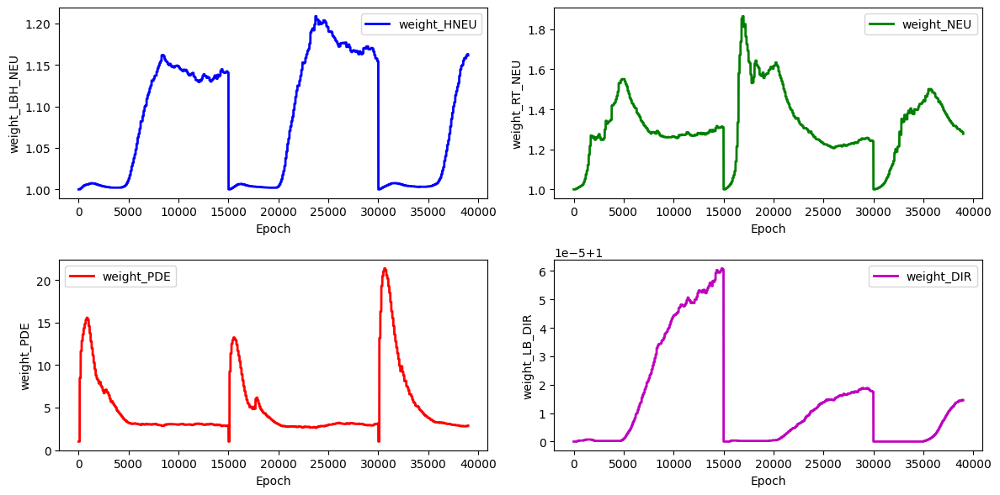

stress_Error for the stress_hole is: 11.279119384398715


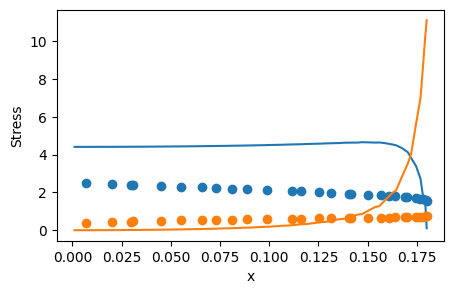

 61%|██████    | 9100/15000 [59:29<44:26,  2.21it/s]  

for weight 0 norm_grad: 421.469482421875
for weight 0 new lamda dach: 1.205991268157959
for weight 0 new lamdaloss norm: 508.28851318359375
for weight 1 norm_grad: 499.7787170410156
for weight 1 new lamda dach: 1.2539852857589722
for weight 1 new lamdaloss norm: 626.7151489257812
for weight 2 norm_grad: 1546.2344970703125
for weight 2 new lamda dach: 2.678335189819336
for weight 2 new lamdaloss norm: 4141.33447265625
for weight 3 norm_grad: 0.042469918727874756
for weight 3 new lamda dach: 1.0000171661376953
for weight 3 new lamdaloss norm: 0.042470645159482956
for weight 0 new weight_value: 1.1658042669296265
for weight 1 new weight_value: 1.2748990058898926
for weight 2 new weight_value: 2.851604461669922
for weight 3 new weight_value: 1.0000147819519043


 61%|██████▏   | 9200/15000 [1:00:11<44:54,  2.15it/s]

for weight 0 norm_grad: 411.22039794921875
for weight 0 new lamda dach: 1.174870491027832
for weight 0 new lamdaloss norm: 483.1307067871094
for weight 1 norm_grad: 536.1893920898438
for weight 1 new lamda dach: 1.2408106327056885
for weight 1 new lamdaloss norm: 665.3094482421875
for weight 2 norm_grad: 1815.3399658203125
for weight 2 new lamda dach: 2.916024684906006
for weight 2 new lamdaloss norm: 5293.57666015625
for weight 3 norm_grad: 0.041426025331020355
for weight 3 new lamda dach: 1.0000150203704834
for weight 3 new lamdaloss norm: 0.0414266437292099
for weight 0 new weight_value: 1.1667108535766602
for weight 1 new weight_value: 1.2714900970458984
for weight 2 new weight_value: 2.858046293258667
for weight 3 new weight_value: 1.0000147819519043


 62%|██████▏   | 9300/15000 [1:00:52<36:49,  2.58it/s]

for weight 0 norm_grad: 407.73504638671875
for weight 0 new lamda dach: 1.1982009410858154
for weight 0 new lamdaloss norm: 488.5484924316406
for weight 1 norm_grad: 501.16021728515625
for weight 1 new lamda dach: 1.2552049160003662
for weight 1 new lamdaloss norm: 629.0587768554688
for weight 2 norm_grad: 1555.9801025390625
for weight 2 new lamda dach: 2.7118704319000244
for weight 2 new lamdaloss norm: 4219.6162109375
for weight 3 norm_grad: 0.04029562324285507
for weight 3 new lamda dach: 1.0000163316726685
for weight 3 new lamdaloss norm: 0.0402962788939476
for weight 0 new weight_value: 1.1698598861694336
for weight 1 new weight_value: 1.2698615789413452
for weight 2 new weight_value: 2.843428611755371
for weight 3 new weight_value: 1.0000149011611938


 63%|██████▎   | 9400/15000 [1:01:33<37:54,  2.46it/s]

for weight 0 norm_grad: 392.51068115234375
for weight 0 new lamda dach: 1.1755070686340332
for weight 0 new lamdaloss norm: 461.3990783691406
for weight 1 norm_grad: 490.1688232421875
for weight 1 new lamda dach: 1.2291815280914307
for weight 1 new lamdaloss norm: 602.5064086914062
for weight 2 norm_grad: 1746.229736328125
for weight 2 new lamda dach: 2.9782373905181885
for weight 2 new lamdaloss norm: 5200.68701171875
for weight 3 norm_grad: 0.04057079181075096
for weight 3 new lamda dach: 1.000015377998352
for weight 3 new lamdaloss norm: 0.0405714176595211
for weight 0 new weight_value: 1.1704245805740356
for weight 1 new weight_value: 1.2657935619354248
for weight 2 new weight_value: 2.8569092750549316
for weight 3 new weight_value: 1.0000149011611938


 63%|██████▎   | 9499/15000 [1:02:12<36:28,  2.51it/s]

for weight 0 norm_grad: 391.17486572265625
for weight 0 new lamda dach: 1.1825549602508545
for weight 0 new lamdaloss norm: 462.58575439453125
for weight 1 norm_grad: 500.343017578125
for weight 1 new lamda dach: 1.2460367679595947
for weight 1 new lamdaloss norm: 623.44580078125
for weight 2 norm_grad: 1642.3961181640625
for weight 2 new lamda dach: 2.842165231704712
for weight 2 new lamdaloss norm: 4667.96142578125
for weight 3 norm_grad: 0.039561111479997635
for weight 3 new lamda dach: 1.0000156164169312
for weight 3 new lamdaloss norm: 0.03956172987818718
for weight 0 new weight_value: 1.1716375350952148
for weight 1 new weight_value: 1.2638177871704102
for weight 2 new weight_value: 2.8554348945617676
for weight 3 new weight_value: 1.0000149011611938
total_loss: 2.2641830444335938, hole_loss:  0.8021599054336548,neumann_loss:  0.7467981576919556, pde_loss: 0.6050305366516113,dirichlet_loss: 5.9495490859262645e-05


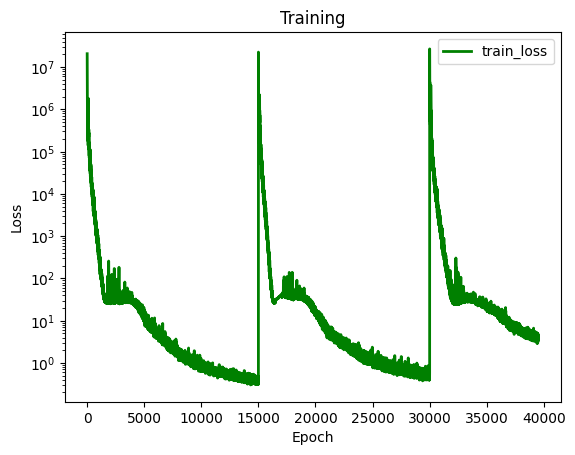

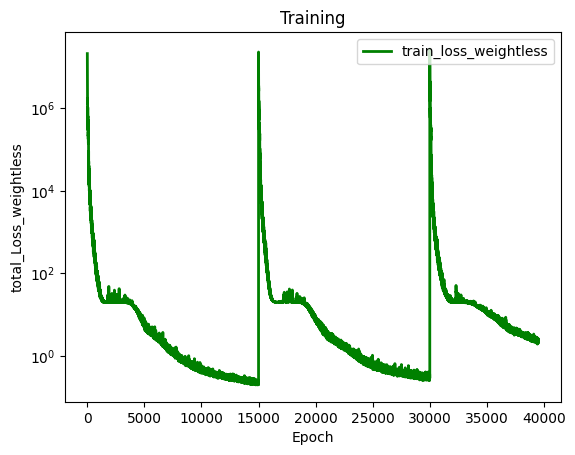

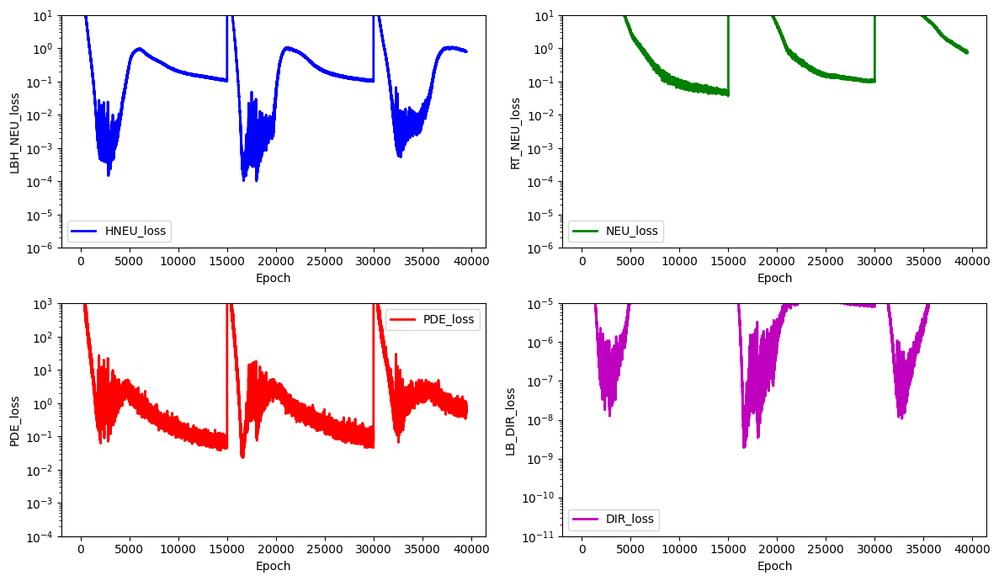

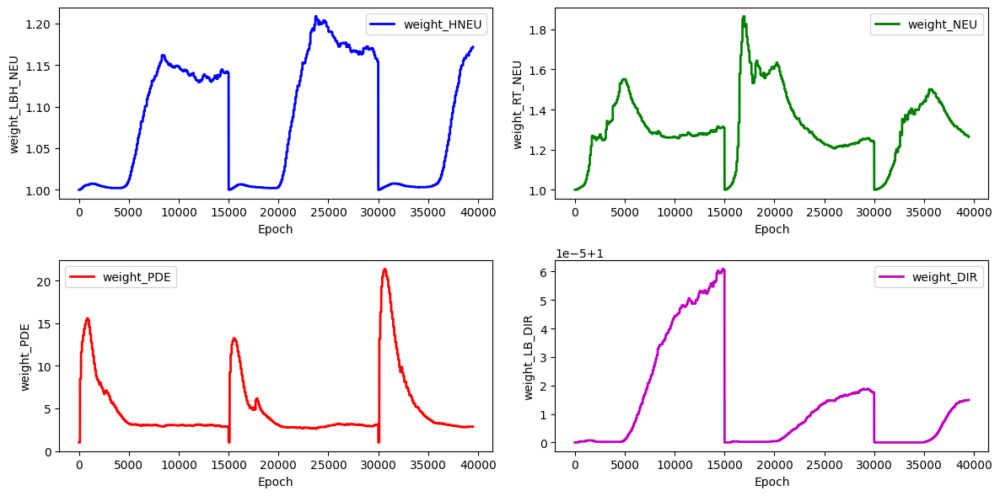

stress_Error for the stress_hole is: 11.288495886677353


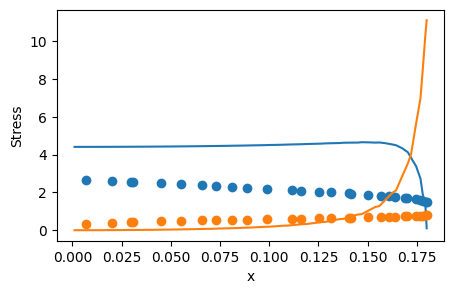

 64%|██████▍   | 9600/15000 [1:02:55<53:12,  1.69it/s]  

for weight 0 norm_grad: 389.76593017578125
for weight 0 new lamda dach: 1.1858786344528198
for weight 0 new lamdaloss norm: 462.21502685546875
for weight 1 norm_grad: 461.0018005371094
for weight 1 new lamda dach: 1.2275824546813965
for weight 1 new lamdaloss norm: 565.917724609375
for weight 2 norm_grad: 1635.842529296875
for weight 2 new lamda dach: 2.9226949214935303
for weight 2 new lamdaloss norm: 4781.068359375
for weight 3 norm_grad: 0.039397452026605606
for weight 3 new lamda dach: 1.0000158548355103
for weight 3 new lamdaloss norm: 0.03939807415008545
for weight 0 new weight_value: 1.1730616092681885
for weight 1 new weight_value: 1.2601943016052246
for weight 2 new weight_value: 2.8621609210968018
for weight 3 new weight_value: 1.0000150203704834


 65%|██████▍   | 9700/15000 [1:03:35<37:53,  2.33it/s]

for weight 0 norm_grad: 373.701904296875
for weight 0 new lamda dach: 1.1614689826965332
for weight 0 new lamdaloss norm: 434.0431823730469
for weight 1 norm_grad: 471.00555419921875
for weight 1 new lamda dach: 1.2124437093734741
for weight 1 new lamdaloss norm: 571.0678100585938
for weight 2 norm_grad: 1843.3438720703125
for weight 2 new lamda dach: 3.182128667831421
for weight 2 new lamdaloss norm: 5865.75732421875
for weight 3 norm_grad: 0.03832414746284485
for weight 3 new lamda dach: 1.000014305114746
for weight 3 new lamdaloss norm: 0.03832469880580902
for weight 0 new weight_value: 1.1719022989273071
for weight 1 new weight_value: 1.2554192543029785
for weight 2 new weight_value: 2.8941574096679688
for weight 3 new weight_value: 1.0000149011611938


 65%|██████▌   | 9800/15000 [1:04:16<39:18,  2.21it/s]

for weight 0 norm_grad: 368.2879943847656
for weight 0 new lamda dach: 1.1871044635772705
for weight 0 new lamdaloss norm: 437.19635009765625
for weight 1 norm_grad: 459.5174560546875
for weight 1 new lamda dach: 1.2447985410690308
for weight 1 new lamdaloss norm: 572.0066528320312
for weight 2 norm_grad: 1508.7982177734375
for weight 2 new lamda dach: 2.8225631713867188
for weight 2 new lamdaloss norm: 4258.67822265625
for weight 3 norm_grad: 0.03891700133681297
for weight 3 new lamda dach: 1.0000165700912476
for weight 3 new lamdaloss norm: 0.03891764581203461
for weight 0 new weight_value: 1.1734224557876587
for weight 1 new weight_value: 1.2543572187423706
for weight 2 new weight_value: 2.886997938156128
for weight 3 new weight_value: 1.0000150203704834


 66%|██████▌   | 9900/15000 [1:04:55<34:24,  2.47it/s]

for weight 0 norm_grad: 356.70416259765625
for weight 0 new lamda dach: 1.171837568283081
for weight 0 new lamdaloss norm: 417.9993591308594
for weight 1 norm_grad: 460.4984130859375
for weight 1 new lamda dach: 1.2335152626037598
for weight 1 new lamdaloss norm: 568.0318603515625
for weight 2 norm_grad: 1615.28515625
for weight 2 new lamda dach: 2.976510763168335
for weight 2 new lamdaloss norm: 4807.9140625
for weight 3 norm_grad: 0.03800627589225769
for weight 3 new lamda dach: 1.0000156164169312
for weight 3 new lamdaloss norm: 0.038006868213415146
for weight 0 new weight_value: 1.1732640266418457
for weight 1 new weight_value: 1.2522730827331543
for weight 2 new weight_value: 2.895949125289917
for weight 3 new weight_value: 1.0000150203704834


 67%|██████▋   | 9999/15000 [1:05:38<31:35,  2.64it/s]

for weight 0 norm_grad: 343.8587951660156
for weight 0 new lamda dach: 1.1501240730285645
for weight 0 new lamdaloss norm: 395.48028564453125
for weight 1 norm_grad: 437.0549621582031
for weight 1 new lamda dach: 1.1989052295684814
for weight 1 new lamdaloss norm: 523.9874267578125
for weight 2 norm_grad: 1853.40625
for weight 2 new lamda dach: 3.3732669353485107
for weight 2 new lamdaloss norm: 6252.03369140625
for weight 3 norm_grad: 0.03757114335894585
for weight 3 new lamda dach: 1.000014305114746
for weight 3 new lamdaloss norm: 0.037571679800748825
for weight 0 new weight_value: 1.1709500551223755
for weight 1 new weight_value: 1.246936321258545
for weight 2 new weight_value: 2.943681001663208
for weight 3 new weight_value: 1.0000149011611938
total_loss: 1.8356701135635376, hole_loss:  0.6828349828720093,neumann_loss:  0.6004599332809448, pde_loss: 0.48110806941986084,dirichlet_loss: 5.420322122517973e-05


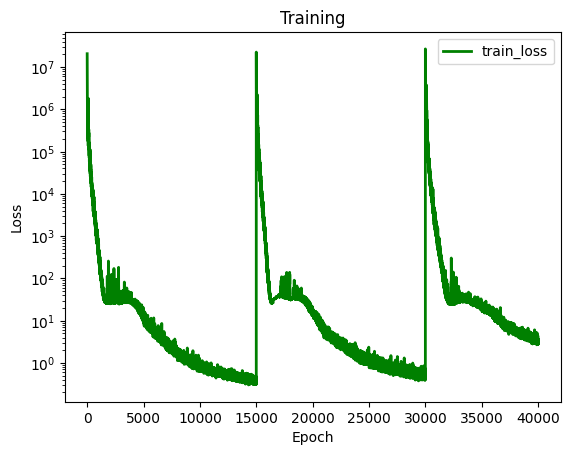

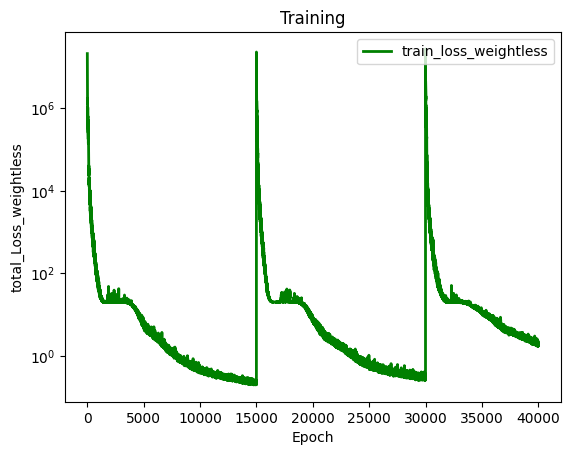

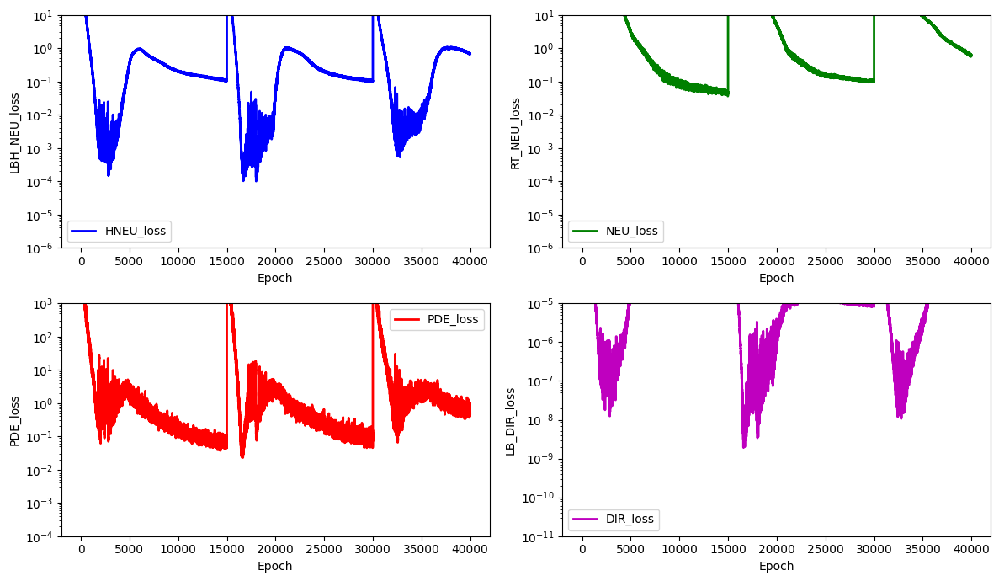

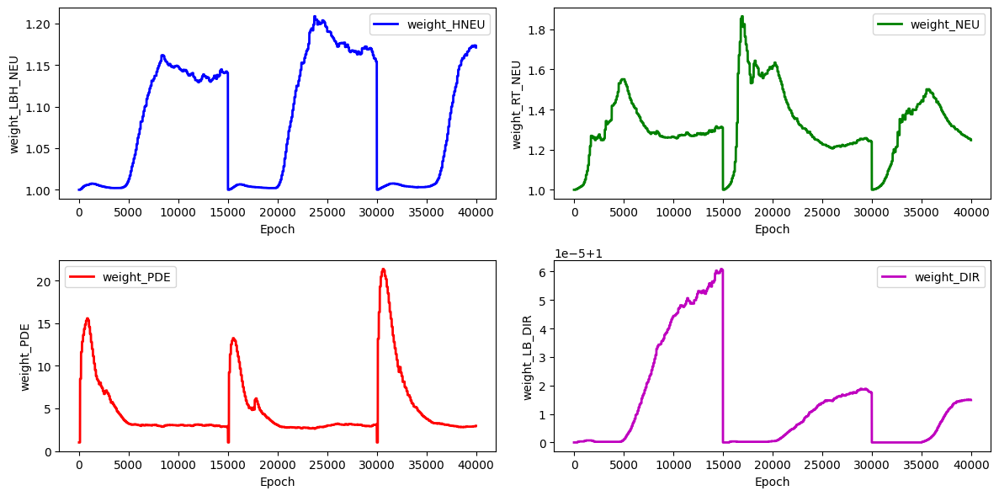

stress_Error for the stress_hole is: 11.336637967521332


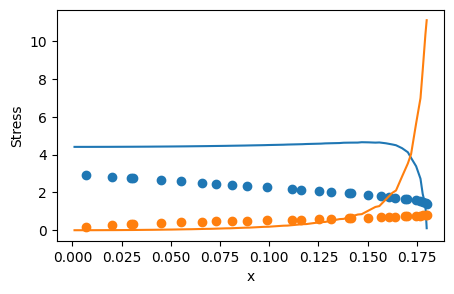

 67%|██████▋   | 10100/15000 [1:06:22<33:17,  2.45it/s]  

for weight 0 norm_grad: 345.229248046875
for weight 0 new lamda dach: 1.1863387823104858
for weight 0 new lamdaloss norm: 409.5588684082031
for weight 1 norm_grad: 423.1036376953125
for weight 1 new lamda dach: 1.2383921146392822
for weight 1 new lamdaloss norm: 523.9682006835938
for weight 2 norm_grad: 1429.5556640625
for weight 2 new lamda dach: 2.8605027198791504
for weight 2 new lamdaloss norm: 4089.247802734375
for weight 3 norm_grad: 0.03747919946908951
for weight 3 new lamda dach: 1.0000170469284058
for weight 3 new lamdaloss norm: 0.037479840219020844
for weight 0 new weight_value: 1.1724889278411865
for weight 1 new weight_value: 1.2460819482803345
for weight 2 new weight_value: 2.9353630542755127
for weight 3 new weight_value: 1.000015139579773


 68%|██████▊   | 10200/15000 [1:07:03<32:15,  2.48it/s]  

for weight 0 norm_grad: 347.922607421875
for weight 0 new lamda dach: 1.1533310413360596
for weight 0 new lamdaloss norm: 401.26995849609375
for weight 1 norm_grad: 405.38525390625
for weight 1 new lamda dach: 1.1832969188690186
for weight 1 new lamdaloss norm: 479.69110107421875
for weight 2 norm_grad: 1863.6722412109375
for weight 2 new lamda dach: 3.473863363265991
for weight 2 new lamdaloss norm: 6474.14208984375
for weight 3 norm_grad: 0.037196118384599686
for weight 3 new lamda dach: 1.0000141859054565
for weight 3 new lamdaloss norm: 0.03719664737582207
for weight 0 new weight_value: 1.170573115348816
for weight 1 new weight_value: 1.2398033142089844
for weight 2 new weight_value: 2.989212989807129
for weight 3 new weight_value: 1.0000150203704834


 69%|██████▊   | 10300/15000 [1:07:47<34:30,  2.27it/s]

for weight 0 norm_grad: 343.17181396484375
for weight 0 new lamda dach: 1.2080600261688232
for weight 0 new lamdaloss norm: 414.5721130371094
for weight 1 norm_grad: 395.7171325683594
for weight 1 new lamda dach: 1.247812271118164
for weight 1 new lamdaloss norm: 493.78070068359375
for weight 2 norm_grad: 1253.6343994140625
for weight 2 new lamda dach: 2.6965644359588623
for weight 2 new lamdaloss norm: 3380.505859375
for weight 3 norm_grad: 0.03641164302825928
for weight 3 new lamda dach: 1.0000182390213013
for weight 3 new lamdaloss norm: 0.036412306129932404
for weight 0 new weight_value: 1.1743217706680298
for weight 1 new weight_value: 1.2406041622161865
for weight 2 new weight_value: 2.9599480628967285
for weight 3 new weight_value: 1.000015377998352


 69%|██████▉   | 10400/15000 [1:08:31<43:40,  1.76it/s]

for weight 0 norm_grad: 319.17425537109375
for weight 0 new lamda dach: 1.1787008047103882
for weight 0 new lamdaloss norm: 376.2109680175781
for weight 1 norm_grad: 382.1697692871094
for weight 1 new lamda dach: 1.2217936515808105
for weight 1 new lamdaloss norm: 466.9326171875
for weight 2 norm_grad: 1403.8775634765625
for weight 2 new lamda dach: 3.0015954971313477
for weight 2 new lamdaloss norm: 4213.87255859375
for weight 3 norm_grad: 0.035242706537246704
for weight 3 new lamda dach: 1.000016689300537
for weight 3 new lamdaloss norm: 0.03524329513311386
for weight 0 new weight_value: 1.1747596263885498
for weight 1 new weight_value: 1.2387231588363647
for weight 2 new weight_value: 2.9641127586364746
for weight 3 new weight_value: 1.0000154972076416


 70%|██████▉   | 10499/15000 [1:09:09<29:20,  2.56it/s]

for weight 0 norm_grad: 313.30206298828125
for weight 0 new lamda dach: 1.1512755155563354
for weight 0 new lamdaloss norm: 360.69696044921875
for weight 1 norm_grad: 391.1666259765625
for weight 1 new lamda dach: 1.1962502002716064
for weight 1 new lamdaloss norm: 467.9331359863281
for weight 2 norm_grad: 1679.86572265625
for weight 2 new lamda dach: 3.384462833404541
for weight 2 new lamdaloss norm: 5685.4423828125
for weight 3 norm_grad: 0.03604445606470108
for weight 3 new lamda dach: 1.000015139579773
for weight 3 new lamdaloss norm: 0.03604499623179436
for weight 0 new weight_value: 1.1724112033843994
for weight 1 new weight_value: 1.2344757318496704
for weight 2 new weight_value: 3.006147861480713
for weight 3 new weight_value: 1.0000154972076416
total_loss: 1.6183135509490967, hole_loss:  0.6031419634819031,neumann_loss:  0.49171650409698486, pde_loss: 0.4779127538204193,dirichlet_loss: 5.1944189181085676e-05


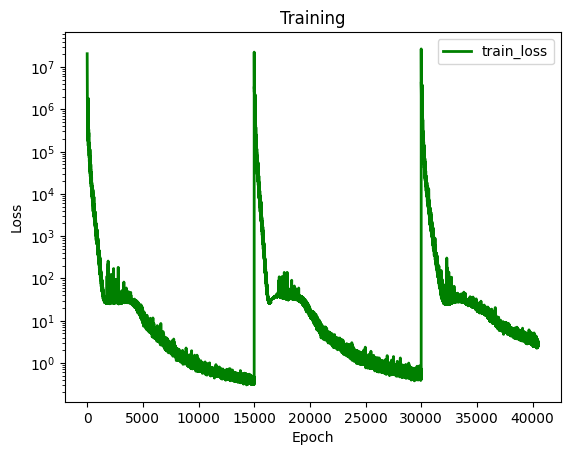

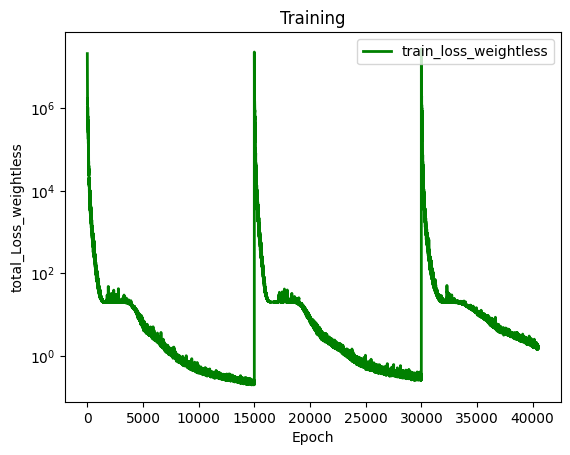

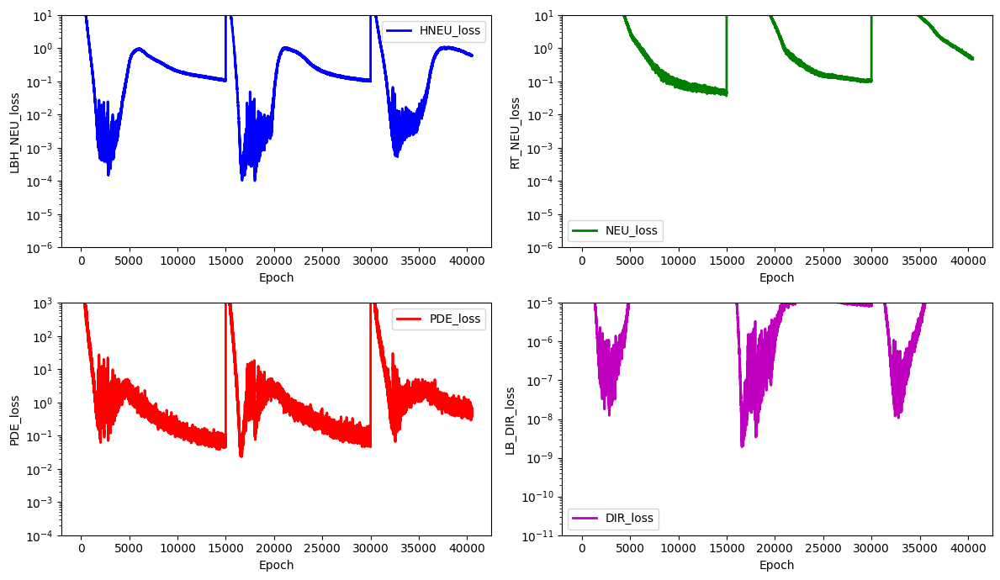

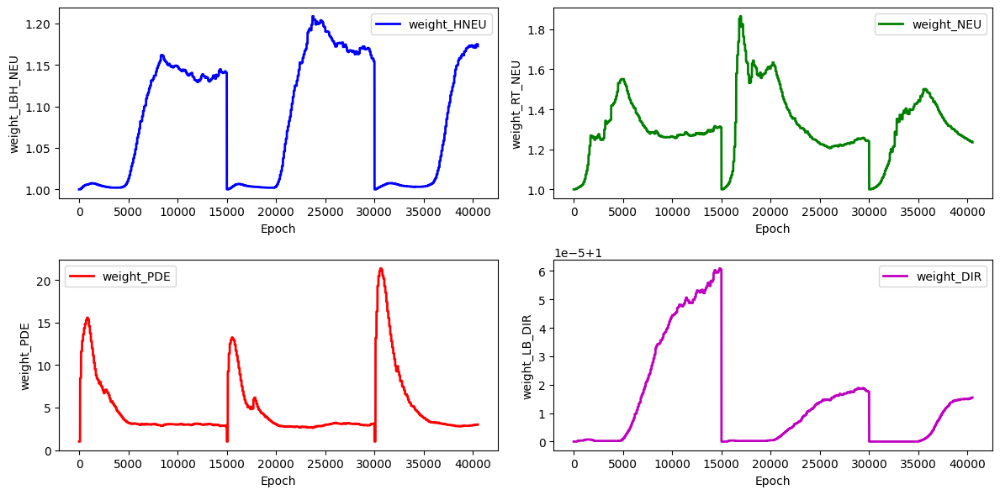

stress_Error for the stress_hole is: 11.316562633380501


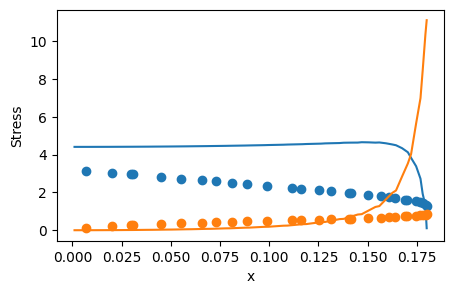

 71%|███████   | 10600/15000 [1:09:53<29:10,  2.51it/s]  

for weight 0 norm_grad: 307.8065490722656
for weight 0 new lamda dach: 1.187218427658081
for weight 0 new lamdaloss norm: 365.43359375
for weight 1 norm_grad: 358.0357971191406
for weight 1 new lamda dach: 1.2246323823928833
for weight 1 new lamdaloss norm: 438.4622497558594
for weight 2 norm_grad: 1286.0323486328125
for weight 2 new lamda dach: 2.931333541870117
for weight 2 new lamdaloss norm: 3769.7900390625
for weight 3 norm_grad: 0.03555842861533165
for weight 3 new lamda dach: 1.0000182390213013
for weight 3 new lamdaloss norm: 0.03555907681584358
for weight 0 new weight_value: 1.1738919019699097
for weight 1 new weight_value: 1.23349130153656
for weight 2 new weight_value: 2.998666286468506
for weight 3 new weight_value: 1.0000157356262207


 71%|███████▏  | 10700/15000 [1:10:31<27:37,  2.60it/s]

for weight 0 norm_grad: 296.9705505371094
for weight 0 new lamda dach: 1.1432629823684692
for weight 0 new lamdaloss norm: 339.5154113769531
for weight 1 norm_grad: 365.69921875
for weight 1 new lamda dach: 1.1824686527252197
for weight 1 new lamdaloss norm: 432.4278564453125
for weight 2 norm_grad: 1707.1689453125
for weight 2 new lamda dach: 3.5760576725006104
for weight 2 new lamdaloss norm: 6104.9345703125
for weight 3 norm_grad: 0.036064472049474716
for weight 3 new lamda dach: 1.0000152587890625
for weight 3 new lamdaloss norm: 0.03606501966714859
for weight 0 new weight_value: 1.1708290576934814
for weight 1 new weight_value: 1.228389024734497
for weight 2 new weight_value: 3.0564053058624268
for weight 3 new weight_value: 1.0000157356262207


 72%|███████▏  | 10800/15000 [1:11:10<27:31,  2.54it/s]

for weight 0 norm_grad: 289.6693115234375
for weight 0 new lamda dach: 1.155344843864441
for weight 0 new lamdaloss norm: 334.6679382324219
for weight 1 norm_grad: 371.5155029296875
for weight 1 new lamda dach: 1.2083841562271118
for weight 1 new lamdaloss norm: 448.93341064453125
for weight 2 norm_grad: 1493.1339111328125
for weight 2 new lamda dach: 3.258146286010742
for weight 2 new lamdaloss norm: 4864.8486328125
for weight 3 norm_grad: 0.03601560369133949
for weight 3 new lamda dach: 1.0000168085098267
for weight 3 new lamdaloss norm: 0.03601621091365814
for weight 0 new weight_value: 1.1692805290222168
for weight 1 new weight_value: 1.2263884544372559
for weight 2 new weight_value: 3.0765793323516846
for weight 3 new weight_value: 1.0000158548355103


 73%|███████▎  | 10900/15000 [1:11:49<26:56,  2.54it/s]

for weight 0 norm_grad: 280.46661376953125
for weight 0 new lamda dach: 1.1474404335021973
for weight 0 new lamdaloss norm: 321.8187561035156
for weight 1 norm_grad: 362.02496337890625
for weight 1 new lamda dach: 1.198840618133545
for weight 1 new lamdaloss norm: 434.01025390625
for weight 2 norm_grad: 1540.1768798828125
for weight 2 new lamda dach: 3.3970627784729004
for weight 2 new lamdaloss norm: 5232.0771484375
for weight 3 norm_grad: 0.035254139453172684
for weight 3 new lamda dach: 1.0000160932540894
for weight 3 new lamdaloss norm: 0.03525470942258835
for weight 0 new weight_value: 1.167096495628357
for weight 1 new weight_value: 1.2236336469650269
for weight 2 new weight_value: 3.1086275577545166
for weight 3 new weight_value: 1.0000158548355103


 73%|███████▎  | 10999/15000 [1:12:32<24:56,  2.67it/s]

for weight 0 norm_grad: 287.02667236328125
for weight 0 new lamda dach: 1.175921082496643
for weight 0 new lamdaloss norm: 337.5207214355469
for weight 1 norm_grad: 336.78448486328125
for weight 1 new lamda dach: 1.2129112482070923
for weight 1 new lamdaloss norm: 408.4896545410156
for weight 2 norm_grad: 1294.7451171875
for weight 2 new lamda dach: 3.0754237174987793
for weight 2 new lamdaloss norm: 3981.8896484375
for weight 3 norm_grad: 0.03506457433104515
for weight 3 new lamda dach: 1.0000182390213013
for weight 3 new lamdaloss norm: 0.035065215080976486
for weight 0 new weight_value: 1.1679788827896118
for weight 1 new weight_value: 1.2225613594055176
for weight 2 new weight_value: 3.105307102203369
for weight 3 new weight_value: 1.0000160932540894
total_loss: 1.391777753829956, hole_loss:  0.5254766941070557,neumann_loss:  0.3929370641708374, pde_loss: 0.4248500168323517,dirichlet_loss: 5.0491631554905325e-05


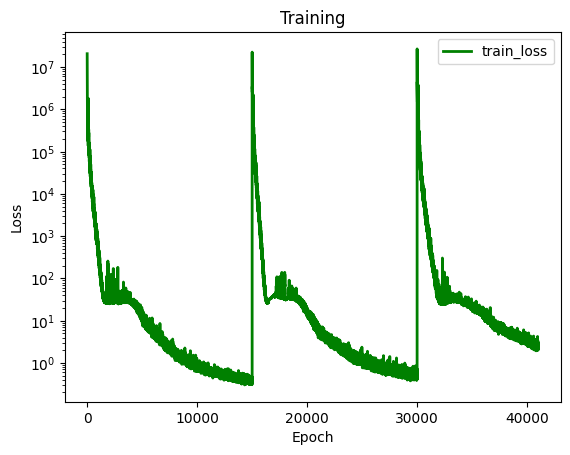

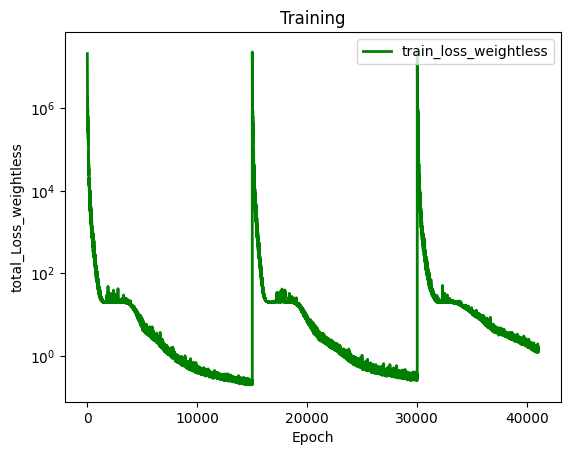

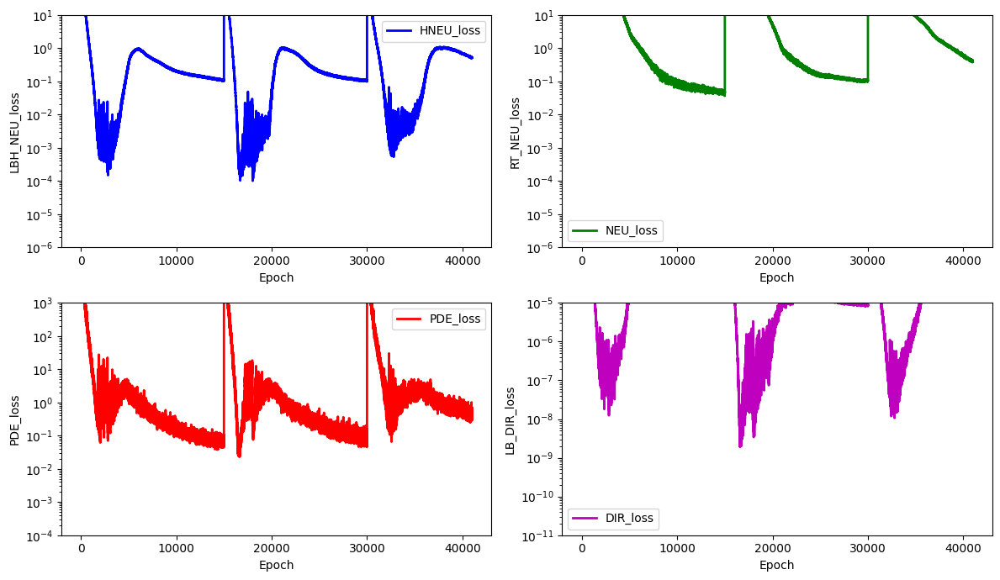

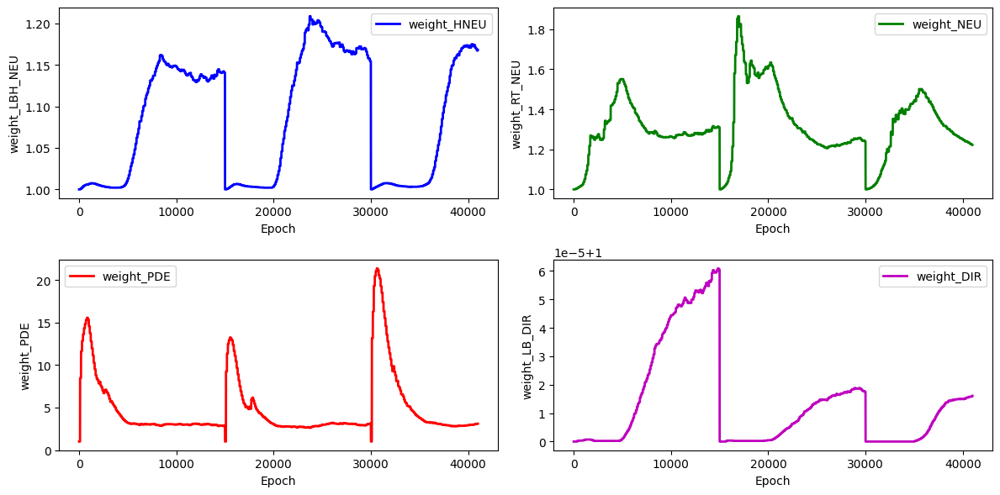

stress_Error for the stress_hole is: 11.314747067595778


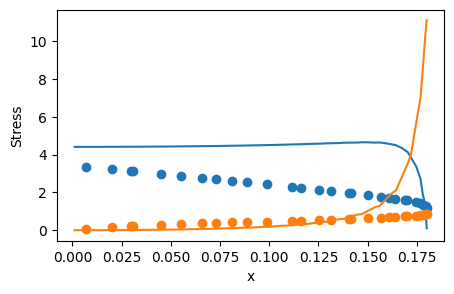

 74%|███████▍  | 11100/15000 [1:13:13<25:22,  2.56it/s]  

for weight 0 norm_grad: 283.16741943359375
for weight 0 new lamda dach: 1.1579394340515137
for weight 0 new lamdaloss norm: 327.8907165527344
for weight 1 norm_grad: 349.7201843261719
for weight 1 new lamda dach: 1.2025797367095947
for weight 1 new lamdaloss norm: 420.5663757324219
for weight 2 norm_grad: 1443.1304931640625
for weight 2 new lamda dach: 3.280101776123047
for weight 2 new lamdaloss norm: 4733.615234375
for weight 3 norm_grad: 0.03620977699756622
for weight 3 new lamda dach: 1.0000174045562744
for weight 3 new lamdaloss norm: 0.03621040657162666
for weight 0 new weight_value: 1.1669749021530151
for weight 1 new weight_value: 1.2205631732940674
for weight 2 new weight_value: 3.122786283493042
for weight 3 new weight_value: 1.000016212463379


 75%|███████▍  | 11200/15000 [1:13:51<24:45,  2.56it/s]

for weight 0 norm_grad: 267.2502746582031
for weight 0 new lamda dach: 1.159505009651184
for weight 0 new lamdaloss norm: 309.8780517578125
for weight 1 norm_grad: 325.787353515625
for weight 1 new lamda dach: 1.2014813423156738
for weight 1 new lamdaloss norm: 391.42742919921875
for weight 2 norm_grad: 1349.674072265625
for weight 2 new lamda dach: 3.275728702545166
for weight 2 new lamdaloss norm: 4421.166015625
for weight 3 norm_grad: 0.03578687086701393
for weight 3 new lamda dach: 1.0000183582305908
for weight 3 new lamdaloss norm: 0.03578753024339676
for weight 0 new weight_value: 1.1662278175354004
for weight 1 new weight_value: 1.218654990196228
for weight 2 new weight_value: 3.138080358505249
for weight 3 new weight_value: 1.000016450881958


 75%|███████▌  | 11300/15000 [1:14:31<23:18,  2.65it/s]

for weight 0 norm_grad: 266.0471496582031
for weight 0 new lamda dach: 1.1717652082443237
for weight 0 new lamdaloss norm: 311.74481201171875
for weight 1 norm_grad: 314.6293640136719
for weight 1 new lamda dach: 1.209708571434021
for weight 1 new lamdaloss norm: 380.6098327636719
for weight 2 norm_grad: 1234.23388671875
for weight 2 new lamda dach: 3.1253767013549805
for weight 2 new lamdaloss norm: 3857.44580078125
for weight 3 norm_grad: 0.036465879529714584
for weight 3 new lamda dach: 1.000020146369934
for weight 3 new lamdaloss norm: 0.03646661341190338
for weight 0 new weight_value: 1.1667815446853638
for weight 1 new weight_value: 1.2177603244781494
for weight 2 new weight_value: 3.136809825897217
for weight 3 new weight_value: 1.0000168085098267


 76%|███████▌  | 11400/15000 [1:15:10<24:54,  2.41it/s]

for weight 0 norm_grad: 265.6199035644531
for weight 0 new lamda dach: 1.1768760681152344
for weight 0 new lamdaloss norm: 312.6017150878906
for weight 1 norm_grad: 303.85748291015625
for weight 1 new lamda dach: 1.207625150680542
for weight 1 new lamdaloss norm: 366.9458923339844
for weight 2 norm_grad: 1197.83447265625
for weight 2 new lamda dach: 3.1032586097717285
for weight 2 new lamdaloss norm: 3717.190185546875
for weight 3 norm_grad: 0.0362870879471302
for weight 3 new lamda dach: 1.0000205039978027
for weight 3 new lamdaloss norm: 0.036287833005189896
for weight 0 new weight_value: 1.1677908897399902
for weight 1 new weight_value: 1.2167466878890991
for weight 2 new weight_value: 3.1334545612335205
for weight 3 new weight_value: 1.0000171661376953


 77%|███████▋  | 11499/15000 [1:15:48<24:12,  2.41it/s]

for weight 0 norm_grad: 257.83245849609375
for weight 0 new lamda dach: 1.2106505632400513
for weight 0 new lamdaloss norm: 312.1449890136719
for weight 1 norm_grad: 289.2584228515625
for weight 1 new lamda dach: 1.242553472518921
for weight 1 new lamdaloss norm: 359.4190368652344
for weight 2 norm_grad: 934.687744140625
for weight 2 new lamda dach: 2.708359718322754
for weight 2 new lamdaloss norm: 2531.470947265625
for weight 3 norm_grad: 0.0350528359413147
for weight 3 new lamda dach: 1.000023603439331
for weight 3 new lamdaloss norm: 0.035053666681051254
for weight 0 new weight_value: 1.1720768213272095
for weight 1 new weight_value: 1.2193273305892944
for weight 2 new weight_value: 3.09094500541687
for weight 3 new weight_value: 1.000017762184143
total_loss: 1.0980901718139648, hole_loss:  0.45738500356674194,neumann_loss:  0.3196139931678772, pde_loss: 0.28273892402648926,dirichlet_loss: 5.237288132775575e-05


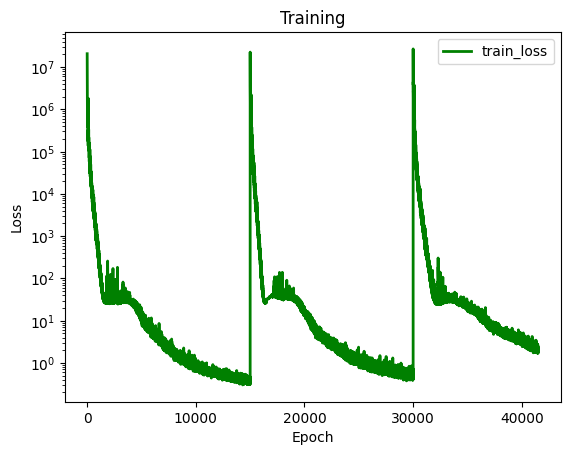

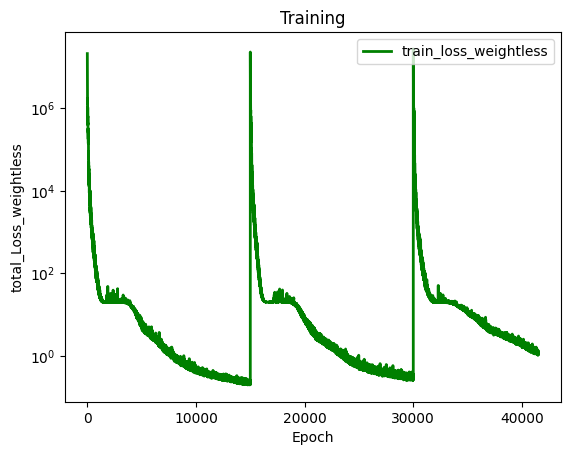

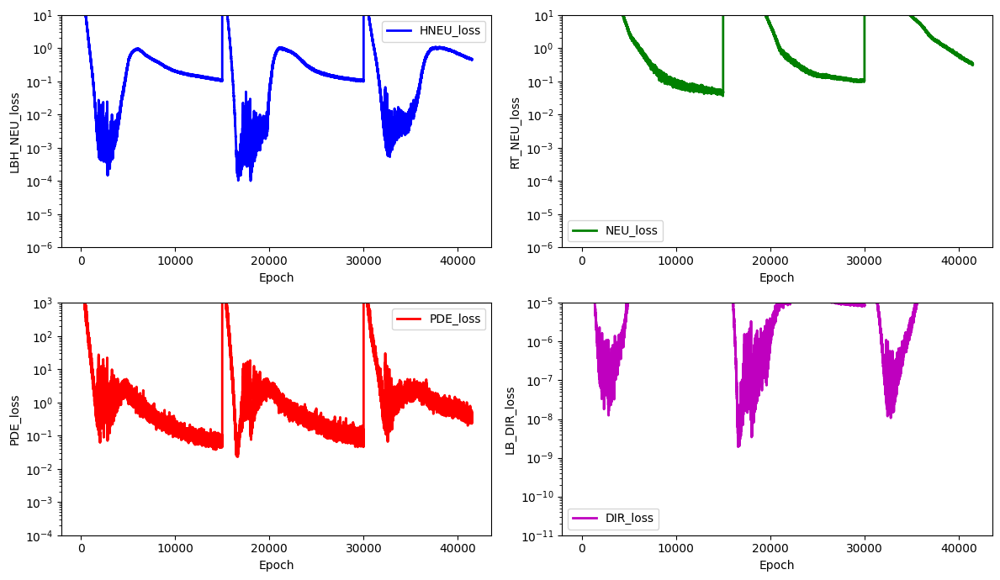

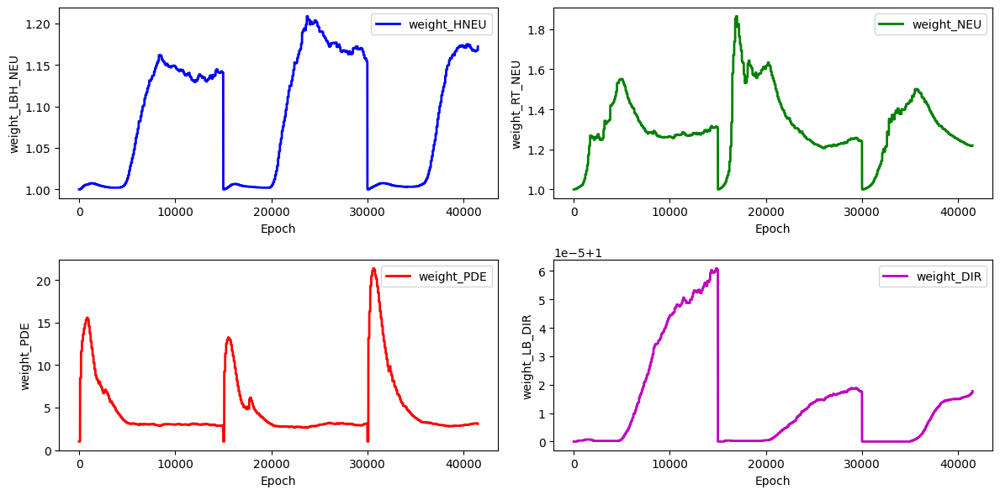

stress_Error for the stress_hole is: 11.328241821954249


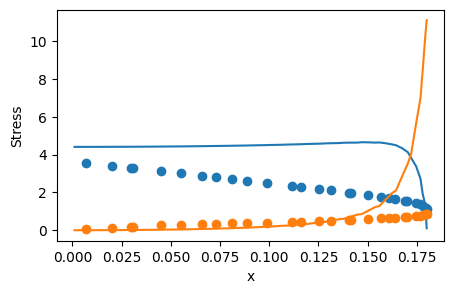

 77%|███████▋  | 11600/15000 [1:16:31<22:37,  2.51it/s]  

for weight 0 norm_grad: 245.84002685546875
for weight 0 new lamda dach: 1.1134603023529053
for weight 0 new lamdaloss norm: 273.73309326171875
for weight 1 norm_grad: 302.1188049316406
for weight 1 new lamda dach: 1.1431523561477661
for weight 1 new lamdaloss norm: 345.3678283691406
for weight 2 norm_grad: 1864.59521484375
for weight 2 new lamda dach: 4.402584075927734
for weight 2 new lamdaloss norm: 8209.037109375
for weight 3 norm_grad: 0.035016342997550964
for weight 3 new lamda dach: 1.0000144243240356
for weight 3 new lamdaloss norm: 0.03501684591174126
for weight 0 new weight_value: 1.1662150621414185
for weight 1 new weight_value: 1.2117098569869995
for weight 2 new weight_value: 3.222108840942383
for weight 3 new weight_value: 1.0000174045562744


 78%|███████▊  | 11700/15000 [1:17:10<20:45,  2.65it/s]

for weight 0 norm_grad: 243.25503540039062
for weight 0 new lamda dach: 1.170052170753479
for weight 0 new lamdaloss norm: 284.6210632324219
for weight 1 norm_grad: 297.31341552734375
for weight 1 new lamda dach: 1.2160056829452515
for weight 1 new lamdaloss norm: 361.5348205566406
for weight 2 norm_grad: 1133.1248779296875
for weight 2 new lamda dach: 3.0960373878479004
for weight 2 new lamdaloss norm: 3508.197021484375
for weight 3 norm_grad: 0.03492148593068123
for weight 3 new lamda dach: 1.0000208616256714
for weight 3 new lamdaloss norm: 0.03492221608757973
for weight 0 new weight_value: 1.1665987968444824
for weight 1 new weight_value: 1.212139368057251
for weight 2 new weight_value: 3.2095015048980713
for weight 3 new weight_value: 1.000017762184143


 79%|███████▊  | 11800/15000 [1:17:53<20:45,  2.57it/s]

for weight 0 norm_grad: 240.03688049316406
for weight 0 new lamda dach: 1.158868432044983
for weight 0 new lamdaloss norm: 278.171142578125
for weight 1 norm_grad: 286.4291687011719
for weight 1 new lamda dach: 1.1955783367156982
for weight 1 new lamdaloss norm: 342.4485168457031
for weight 2 norm_grad: 1224.4515380859375
for weight 2 new lamda dach: 3.325636863708496
for weight 2 new lamdaloss norm: 4072.080810546875
for weight 3 norm_grad: 0.035461779683828354
for weight 3 new lamda dach: 1.0000202655792236
for weight 3 new lamdaloss norm: 0.03546249493956566
for weight 0 new weight_value: 1.1658257246017456
for weight 1 new weight_value: 1.2104833126068115
for weight 2 new weight_value: 3.2211148738861084
for weight 3 new weight_value: 1.0000180006027222


 79%|███████▉  | 11900/15000 [1:18:35<22:27,  2.30it/s]

for weight 0 norm_grad: 232.30780029296875
for weight 0 new lamda dach: 1.1501328945159912
for weight 0 new lamdaloss norm: 267.1848449707031
for weight 1 norm_grad: 278.10498046875
for weight 1 new lamda dach: 1.1852117776870728
for weight 1 new lamdaloss norm: 329.6133117675781
for weight 2 norm_grad: 1269.2076416015625
for weight 2 new lamda dach: 3.486455202102661
for weight 2 new lamdaloss norm: 4425.03515625
for weight 3 norm_grad: 0.03584165498614311
for weight 3 new lamda dach: 1.000020146369934
for weight 3 new lamdaloss norm: 0.035842377692461014
for weight 0 new weight_value: 1.1642563343048096
for weight 1 new weight_value: 1.2079561948776245
for weight 2 new weight_value: 3.2476487159729004
for weight 3 new weight_value: 1.0000182390213013


 80%|███████▉  | 11999/15000 [1:19:23<24:52,  2.01it/s]

for weight 0 norm_grad: 229.09902954101562
for weight 0 new lamda dach: 1.1724885702133179
for weight 0 new lamdaloss norm: 268.6159973144531
for weight 1 norm_grad: 293.2357482910156
for weight 1 new lamda dach: 1.2319790124893188
for weight 1 new lamdaloss norm: 361.26025390625
for weight 2 norm_grad: 1034.9266357421875
for weight 2 new lamda dach: 2.9812123775482178
for weight 2 new lamdaloss norm: 3085.336181640625
for weight 3 norm_grad: 0.035539660602808
for weight 3 new lamda dach: 1.0000227689743042
for weight 3 new lamdaloss norm: 0.03554047271609306
for weight 0 new weight_value: 1.1650795936584473
for weight 1 new weight_value: 1.2103585004806519
for weight 2 new weight_value: 3.2210049629211426
for weight 3 new weight_value: 1.00001859664917
total_loss: 0.9358652830123901, hole_loss:  0.40139490365982056,neumann_loss:  0.307161808013916, pde_loss: 0.21547821164131165,dirichlet_loss: 5.5006898037390783e-05


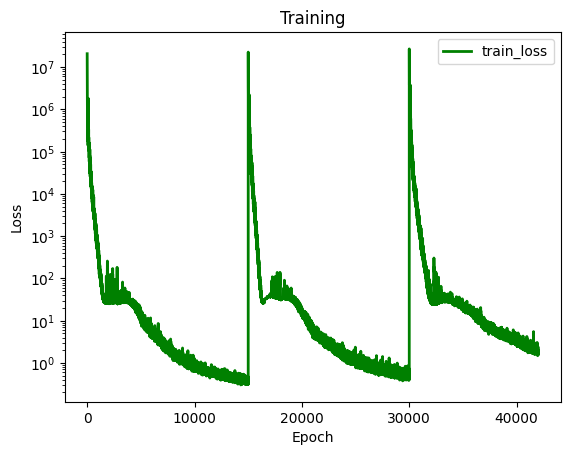

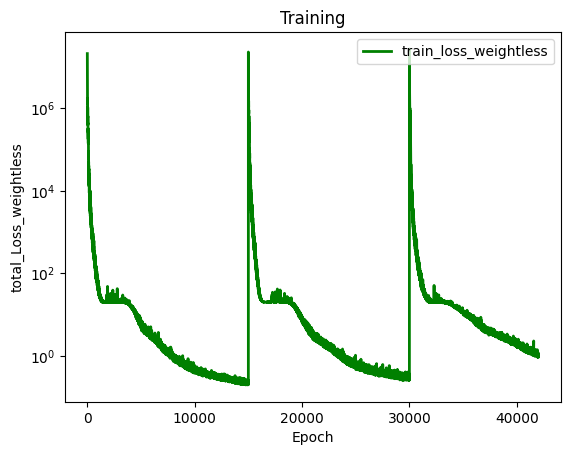

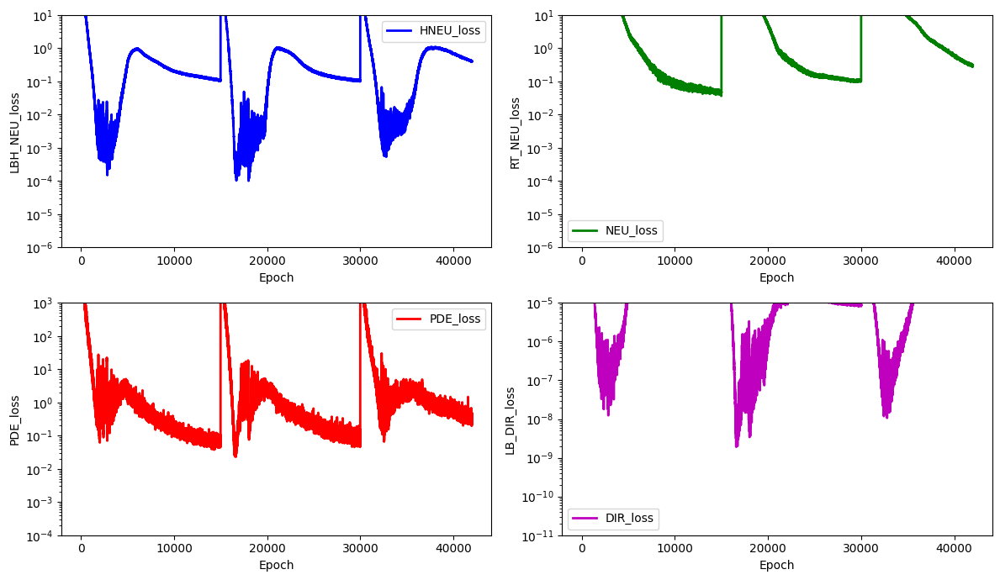

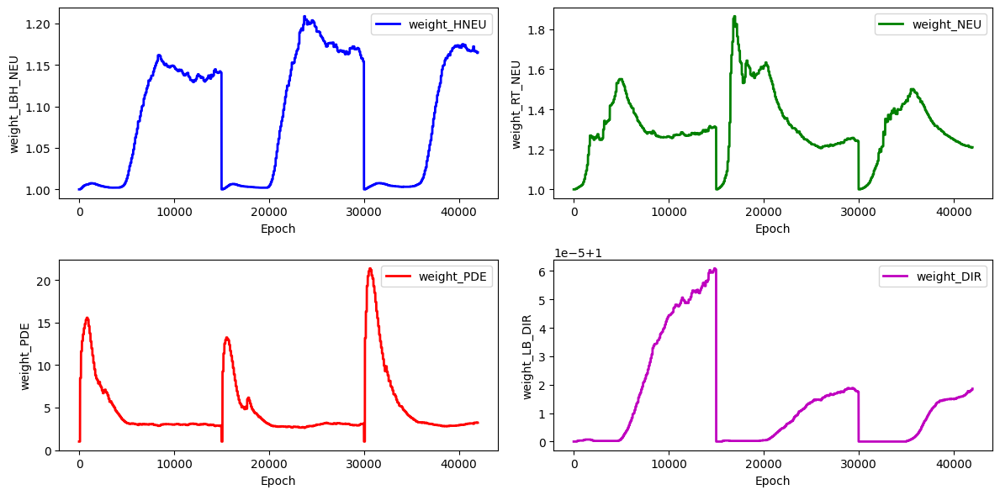

stress_Error for the stress_hole is: 11.398263549633167


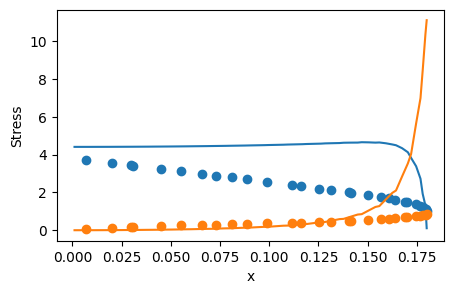

 81%|████████  | 12100/15000 [1:20:03<18:41,  2.59it/s]  

for weight 0 norm_grad: 221.30738830566406
for weight 0 new lamda dach: 1.1828516721725464
for weight 0 new lamdaloss norm: 261.7738037109375
for weight 1 norm_grad: 279.66888427734375
for weight 1 new lamda dach: 1.2427788972854614
for weight 1 new lamdaloss norm: 347.56658935546875
for weight 2 norm_grad: 930.6063842773438
for weight 2 new lamda dach: 2.857455015182495
for weight 2 new lamdaloss norm: 2659.165771484375
for weight 3 norm_grad: 0.03533092141151428
for weight 3 new lamda dach: 1.000024676322937
for weight 3 new lamdaloss norm: 0.03533179685473442
for weight 0 new weight_value: 1.1668567657470703
for weight 1 new weight_value: 1.2136003971099854
for weight 2 new weight_value: 3.18464994430542
for weight 3 new weight_value: 1.0000191926956177


 81%|████████▏ | 12200/15000 [1:20:44<19:10,  2.43it/s]

for weight 0 norm_grad: 226.89779663085938
for weight 0 new lamda dach: 1.207640528678894
for weight 0 new lamdaloss norm: 274.0109558105469
for weight 1 norm_grad: 262.41729736328125
for weight 1 new lamda dach: 1.2482136487960815
for weight 1 new lamdaloss norm: 327.5528564453125
for weight 2 norm_grad: 830.2898559570312
for weight 2 new lamda dach: 2.696715831756592
for weight 2 new lamdaloss norm: 2239.055908203125
for weight 3 norm_grad: 0.03600917011499405
for weight 3 new lamda dach: 1.0000272989273071
for weight 3 new lamdaloss norm: 0.03601015731692314
for weight 0 new weight_value: 1.170935034751892
for weight 1 new weight_value: 1.2170617580413818
for weight 2 new weight_value: 3.1358566284179688
for weight 3 new weight_value: 1.0000200271606445


 82%|████████▏ | 12300/15000 [1:21:23<17:31,  2.57it/s]

for weight 0 norm_grad: 215.00584411621094
for weight 0 new lamda dach: 1.1814907789230347
for weight 0 new lamdaloss norm: 254.02743530273438
for weight 1 norm_grad: 260.6111755371094
for weight 1 new lamda dach: 1.2287949323654175
for weight 1 new lamdaloss norm: 320.2376708984375
for weight 2 norm_grad: 924.0184326171875
for weight 2 new lamda dach: 2.942631483078003
for weight 2 new lamdaloss norm: 2719.04541015625
for weight 3 norm_grad: 0.0358874537050724
for weight 3 new lamda dach: 1.0000256299972534
for weight 3 new lamdaloss norm: 0.035888370126485825
for weight 0 new weight_value: 1.1719905138015747
for weight 1 new weight_value: 1.2182350158691406
for weight 2 new weight_value: 3.1165339946746826
for weight 3 new weight_value: 1.0000205039978027


 83%|████████▎ | 12400/15000 [1:22:00<16:07,  2.69it/s]

for weight 0 norm_grad: 209.80934143066406
for weight 0 new lamda dach: 1.158294916152954
for weight 0 new lamdaloss norm: 243.02108764648438
for weight 1 norm_grad: 246.70314025878906
for weight 1 new lamda dach: 1.1914595365524292
for weight 1 new lamdaloss norm: 293.93682861328125
for weight 2 norm_grad: 1078.69482421875
for weight 2 new lamda dach: 3.3627233505249023
for weight 2 new lamdaloss norm: 3627.352294921875
for weight 3 norm_grad: 0.03475652262568474
for weight 3 new lamda dach: 1.0000226497650146
for weight 3 new lamdaloss norm: 0.03475731238722801
for weight 0 new weight_value: 1.1706209182739258
for weight 1 new weight_value: 1.2155574560165405
for weight 2 new weight_value: 3.141152858734131
for weight 3 new weight_value: 1.0000207424163818


 83%|████████▎ | 12499/15000 [1:22:36<15:04,  2.76it/s]

for weight 0 norm_grad: 206.4369354248047
for weight 0 new lamda dach: 1.1697516441345215
for weight 0 new lamdaloss norm: 241.47994995117188
for weight 1 norm_grad: 251.4547882080078
for weight 1 new lamda dach: 1.214717984199524
for weight 1 new lamdaloss norm: 305.4466247558594
for weight 2 norm_grad: 964.6211547851562
for weight 2 new lamda dach: 3.1064951419830322
for weight 2 new lamdaloss norm: 2996.5908203125
for weight 3 norm_grad: 0.03522007539868355
for weight 3 new lamda dach: 1.0000247955322266
for weight 3 new lamdaloss norm: 0.03522094339132309
for weight 0 new weight_value: 1.1705340147018433
for weight 1 new weight_value: 1.2154734134674072
for weight 2 new weight_value: 3.1376872062683105
for weight 3 new weight_value: 1.0000211000442505
total_loss: 0.9508094787597656, hole_loss:  0.3549444377422333,neumann_loss:  0.2569758892059326, pde_loss: 0.302099347114563,dirichlet_loss: 5.6727549235802144e-05


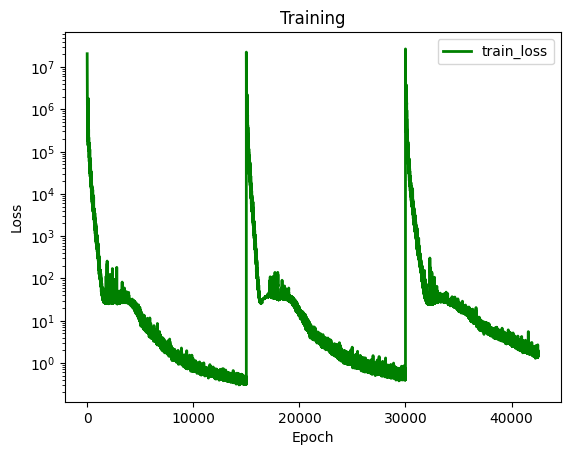

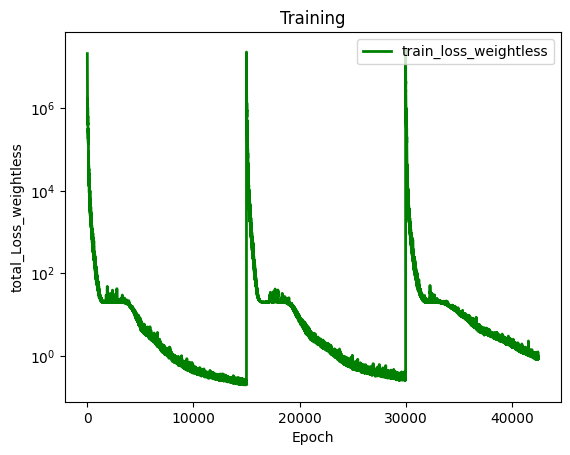

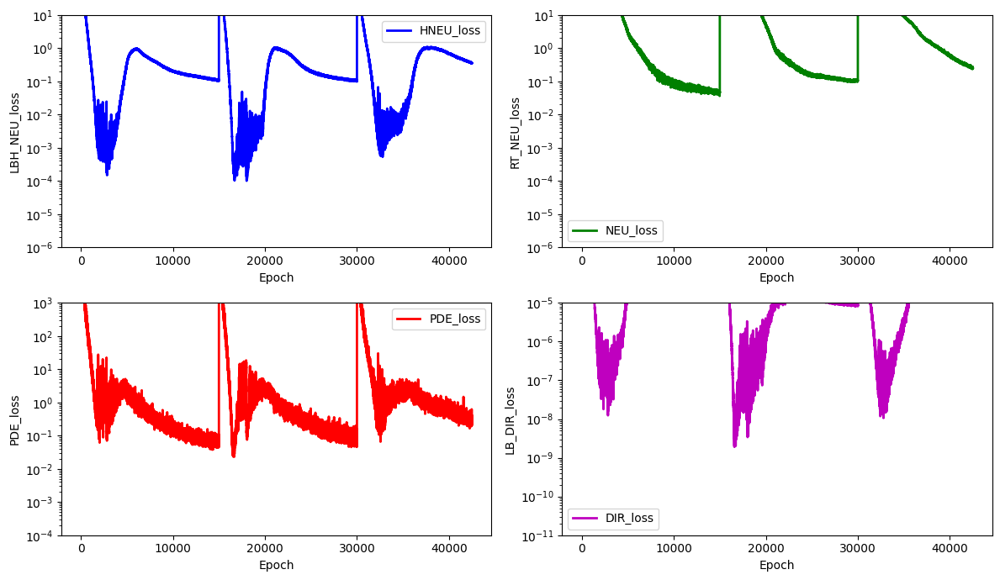

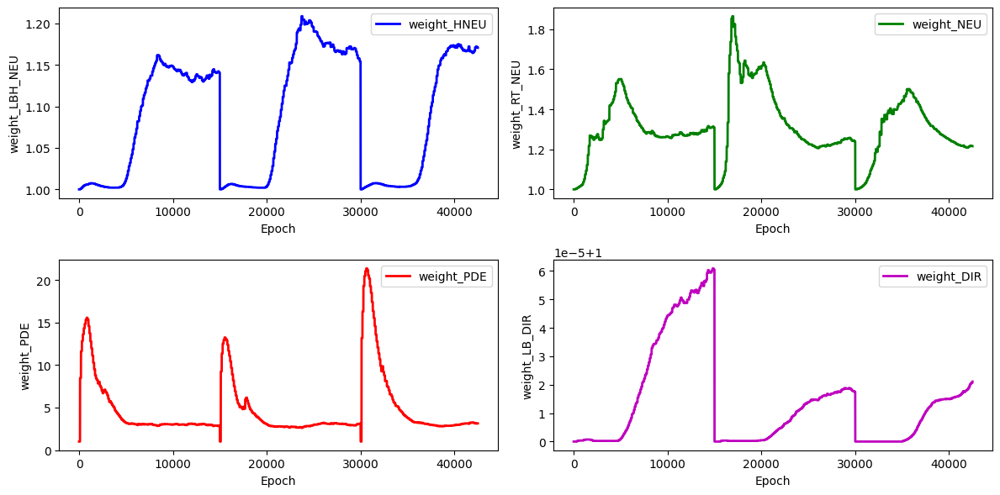

stress_Error for the stress_hole is: 11.52747814994026


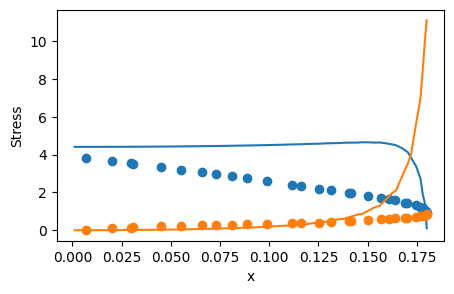

 84%|████████▍ | 12600/15000 [1:23:18<14:56,  2.68it/s]

for weight 0 norm_grad: 211.09695434570312
for weight 0 new lamda dach: 1.1472147703170776
for weight 0 new lamdaloss norm: 242.1735382080078
for weight 1 norm_grad: 242.1884765625
for weight 1 new lamda dach: 1.1726406812667847
for weight 1 new lamdaloss norm: 284.00006103515625
for weight 2 norm_grad: 1191.7152099609375
for weight 2 new lamda dach: 3.6288576126098633
for weight 2 new lamdaloss norm: 4324.56494140625
for weight 3 norm_grad: 0.035098448395729065
for weight 3 new lamda dach: 1.0000213384628296
for weight 3 new lamdaloss norm: 0.035099197179079056
for weight 0 new weight_value: 1.1682021617889404
for weight 1 new weight_value: 1.211190104484558
for weight 2 new weight_value: 3.1868040561676025
for weight 3 new weight_value: 1.0000211000442505


 85%|████████▍ | 12700/15000 [1:24:04<20:48,  1.84it/s]

for weight 0 norm_grad: 197.79632568359375
for weight 0 new lamda dach: 1.135865569114685
for weight 0 new lamdaloss norm: 224.6700439453125
for weight 1 norm_grad: 241.14337158203125
for weight 1 new lamda dach: 1.1707239151000977
for weight 1 new lamdaloss norm: 282.31231689453125
for weight 2 norm_grad: 1214.64501953125
for weight 2 new lamda dach: 3.7670090198516846
for weight 2 new lamdaloss norm: 4575.5791015625
for weight 3 norm_grad: 0.03434625267982483
for weight 3 new lamda dach: 1.0000207424163818
for weight 3 new lamdaloss norm: 0.03434696048498154
for weight 0 new weight_value: 1.164968490600586
for weight 1 new weight_value: 1.2071434259414673
for weight 2 new weight_value: 3.2448244094848633
for weight 3 new weight_value: 1.0000211000442505


 85%|████████▌ | 12800/15000 [1:24:49<14:31,  2.52it/s]

for weight 0 norm_grad: 199.13430786132812
for weight 0 new lamda dach: 1.1556700468063354
for weight 0 new lamdaloss norm: 230.13356018066406
for weight 1 norm_grad: 245.46078491210938
for weight 1 new lamda dach: 1.1990952491760254
for weight 1 new lamdaloss norm: 294.33087158203125
for weight 2 norm_grad: 1033.712158203125
for weight 2 new lamda dach: 3.3248822689056396
for weight 2 new lamdaloss norm: 3436.97119140625
for weight 3 norm_grad: 0.03477359935641289
for weight 3 new lamda dach: 1.0000234842300415
for weight 3 new lamdaloss norm: 0.03477441519498825
for weight 0 new weight_value: 1.1640385389328003
for weight 1 new weight_value: 1.2063385248184204
for weight 2 new weight_value: 3.2528302669525146
for weight 3 new weight_value: 1.0000213384628296


 86%|████████▌ | 12900/15000 [1:25:31<14:41,  2.38it/s]

for weight 0 norm_grad: 189.1111602783203
for weight 0 new lamda dach: 1.139002799987793
for weight 0 new lamdaloss norm: 215.39813232421875
for weight 1 norm_grad: 234.3875732421875
for weight 1 new lamda dach: 1.1782132387161255
for weight 1 new lamdaloss norm: 276.1585388183594
for weight 2 norm_grad: 1126.061767578125
for weight 2 new lamda dach: 3.65872859954834
for weight 2 new lamdaloss norm: 4119.95458984375
for weight 3 norm_grad: 0.03514232113957405
for weight 3 new lamda dach: 1.0000226497650146
for weight 3 new lamdaloss norm: 0.03514311835169792
for weight 0 new weight_value: 1.1615349054336548
for weight 1 new weight_value: 1.2035260200500488
for weight 2 new weight_value: 3.2934200763702393
for weight 3 new weight_value: 1.0000214576721191


 87%|████████▋ | 12999/15000 [1:26:07<13:00,  2.56it/s]

for weight 0 norm_grad: 197.0341796875
for weight 0 new lamda dach: 1.1299200057983398
for weight 0 new lamdaloss norm: 222.6328582763672
for weight 1 norm_grad: 229.3744659423828
for weight 1 new lamda dach: 1.1545400619506836
for weight 1 new lamdaloss norm: 264.822021484375
for weight 2 norm_grad: 1287.1717529296875
for weight 2 new lamda dach: 4.018392086029053
for weight 2 new lamdaloss norm: 5172.36083984375
for weight 3 norm_grad: 0.03425890579819679
for weight 3 new lamda dach: 1.0000200271606445
for weight 3 new lamdaloss norm: 0.03425959125161171
for weight 0 new weight_value: 1.158373475074768
for weight 1 new weight_value: 1.1986273527145386
for weight 2 new weight_value: 3.365917205810547
for weight 3 new weight_value: 1.0000213384628296
total_loss: 0.8680325150489807, hole_loss:  0.3199726939201355,neumann_loss:  0.2288397252559662, pde_loss: 0.29205113649368286,dirichlet_loss: 5.540058918995783e-05


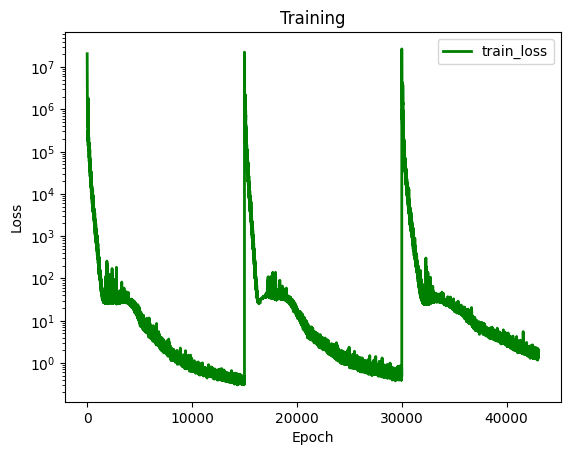

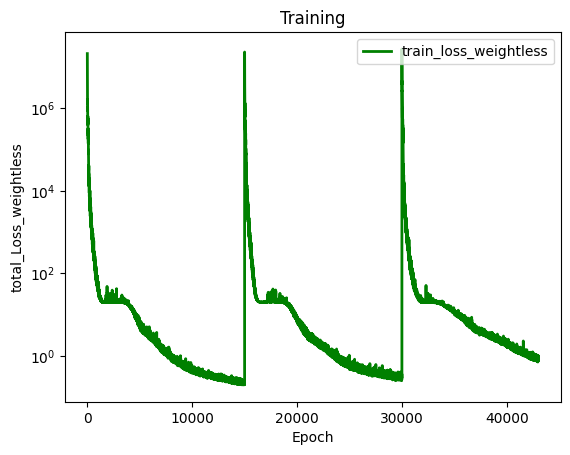

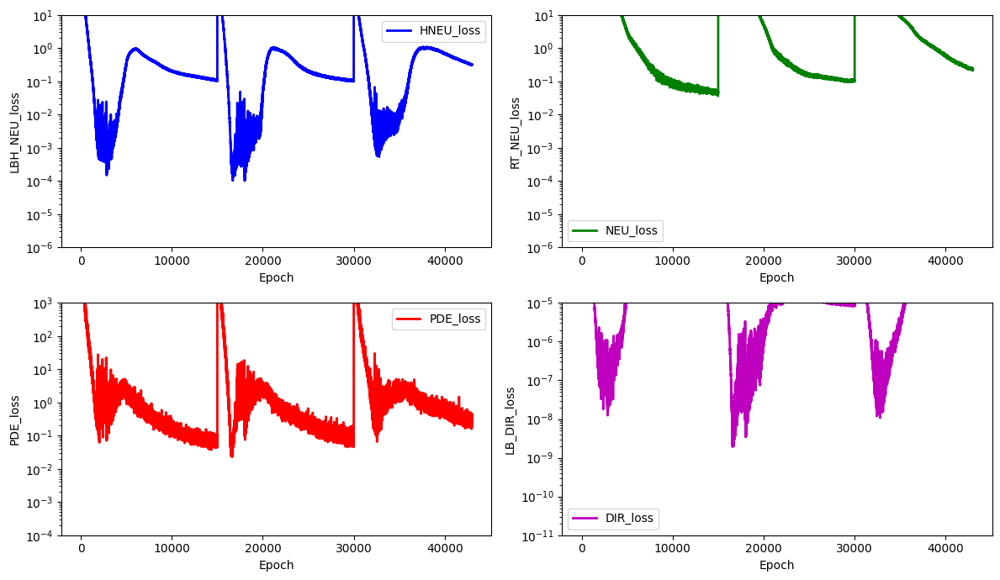

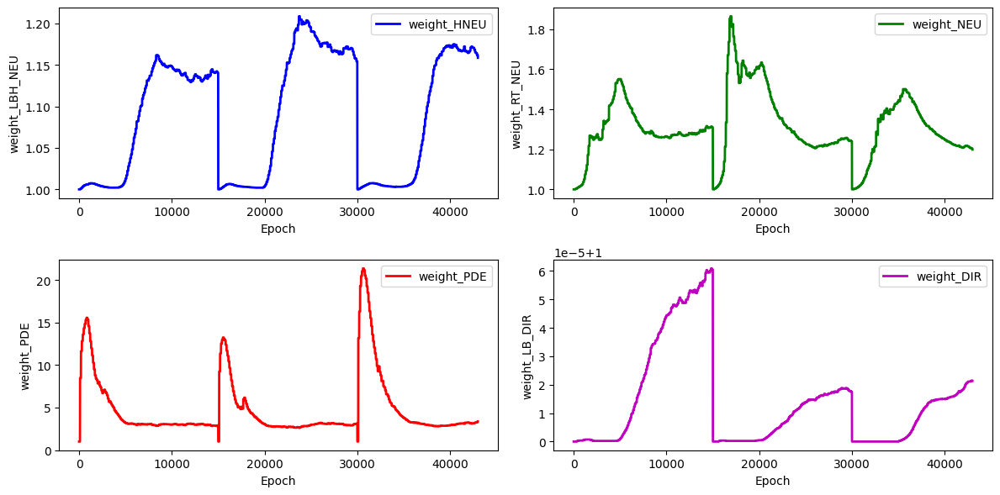

stress_Error for the stress_hole is: 11.547720426695271


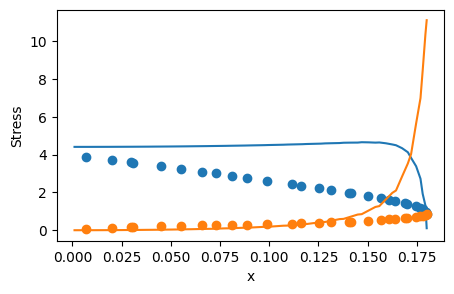

 87%|████████▋ | 13100/15000 [1:26:59<12:29,  2.54it/s]

for weight 0 norm_grad: 189.14808654785156
for weight 0 new lamda dach: 1.202487587928772
for weight 0 new lamdaloss norm: 227.4481964111328
for weight 1 norm_grad: 235.42648315429688
for weight 1 new lamda dach: 1.2651667594909668
for weight 1 new lamdaloss norm: 297.853759765625
for weight 2 norm_grad: 698.660888671875
for weight 2 new lamda dach: 2.6454217433929443
for weight 2 new lamdaloss norm: 1848.252685546875
for weight 3 norm_grad: 0.034433089196681976
for weight 3 new lamda dach: 1.0000306367874146
for weight 3 new lamdaloss norm: 0.03443414345383644
for weight 0 new weight_value: 1.1627849340438843
for weight 1 new weight_value: 1.2052812576293945
for weight 2 new weight_value: 3.293867588043213
for weight 3 new weight_value: 1.0000221729278564


 88%|████████▊ | 13200/15000 [1:27:39<12:35,  2.38it/s]

for weight 0 norm_grad: 187.36500549316406
for weight 0 new lamda dach: 1.1785104274749756
for weight 0 new lamdaloss norm: 220.81163024902344
for weight 1 norm_grad: 230.75588989257812
for weight 1 new lamda dach: 1.229331374168396
for weight 1 new lamdaloss norm: 283.6754455566406
for weight 2 norm_grad: 818.8118896484375
for weight 2 new lamda dach: 2.95815110206604
for weight 2 new lamdaloss norm: 2422.16943359375
for weight 3 norm_grad: 0.034686315804719925
for weight 3 new lamda dach: 1.0000280141830444
for weight 3 new lamdaloss norm: 0.034687288105487823
for weight 0 new weight_value: 1.1643574237823486
for weight 1 new weight_value: 1.2076863050460815
for weight 2 new weight_value: 3.260295867919922
for weight 3 new weight_value: 1.0000227689743042


 89%|████████▊ | 13300/15000 [1:28:26<18:00,  1.57it/s]

for weight 0 norm_grad: 185.69964599609375
for weight 0 new lamda dach: 1.1502997875213623
for weight 0 new lamdaloss norm: 213.6102752685547
for weight 1 norm_grad: 224.44387817382812
for weight 1 new lamda dach: 1.1875391006469727
for weight 1 new lamdaloss norm: 266.535888671875
for weight 2 norm_grad: 1011.0498657226562
for weight 2 new lamda dach: 3.4649040699005127
for weight 2 new lamdaloss norm: 3503.19091796875
for weight 3 norm_grad: 0.034669674932956696
for weight 3 new lamda dach: 1.000024437904358
for weight 3 new lamdaloss norm: 0.034670520573854446
for weight 0 new weight_value: 1.1629515886306763
for weight 1 new weight_value: 1.2056715488433838
for weight 2 new weight_value: 3.2807564735412598
for weight 3 new weight_value: 1.0000228881835938


 89%|████████▉ | 13400/15000 [1:29:14<10:15,  2.60it/s]

for weight 0 norm_grad: 179.90396118164062
for weight 0 new lamda dach: 1.1865577697753906
for weight 0 new lamdaloss norm: 213.46644592285156
for weight 1 norm_grad: 215.9408721923828
for weight 1 new lamda dach: 1.2326204776763916
for weight 1 new lamdaloss norm: 266.17315673828125
for weight 2 norm_grad: 748.3583984375
for weight 2 new lamda dach: 2.8903708457946777
for weight 2 new lamdaloss norm: 2163.033203125
for weight 3 norm_grad: 0.03432784974575043
for weight 3 new lamda dach: 1.0000299215316772
for weight 3 new lamdaloss norm: 0.0343288779258728
for weight 0 new weight_value: 1.1653121709823608
for weight 1 new weight_value: 1.2083663940429688
for weight 2 new weight_value: 3.24171781539917
for weight 3 new weight_value: 1.000023603439331


 90%|████████▉ | 13499/15000 [1:29:54<09:55,  2.52it/s]

for weight 0 norm_grad: 174.29661560058594
for weight 0 new lamda dach: 1.190866470336914
for weight 0 new lamdaloss norm: 207.56399536132812
for weight 1 norm_grad: 213.76602172851562
for weight 1 new lamda dach: 1.2446627616882324
for weight 1 new lamdaloss norm: 266.0666198730469
for weight 2 norm_grad: 699.3856201171875
for weight 2 new lamda dach: 2.802088975906372
for weight 2 new lamdaloss norm: 1959.7408447265625
for weight 3 norm_grad: 0.03453861176967621
for weight 3 new lamda dach: 1.0000317096710205
for weight 3 new lamdaloss norm: 0.034539707005023956
for weight 0 new weight_value: 1.1678675413131714
for weight 1 new weight_value: 1.211996078491211
for weight 2 new weight_value: 3.1977548599243164
for weight 3 new weight_value: 1.0000243186950684
total_loss: 0.6957044005393982, hole_loss:  0.2838602662086487,neumann_loss:  0.20266380906105042, pde_loss: 0.19450147449970245,dirichlet_loss: 5.827230052091181e-05


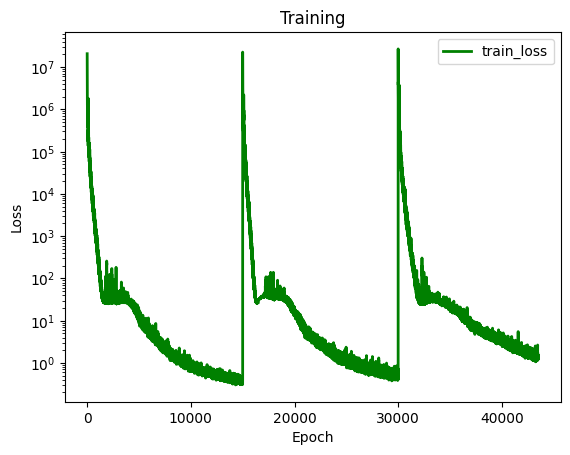

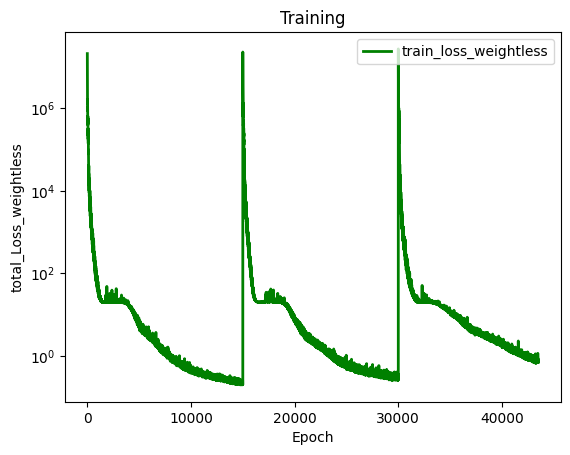

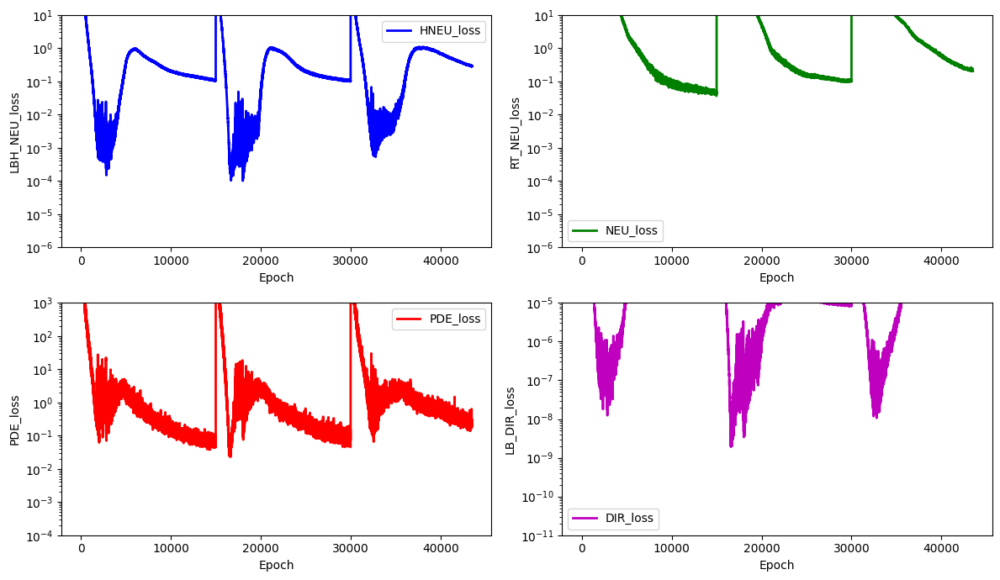

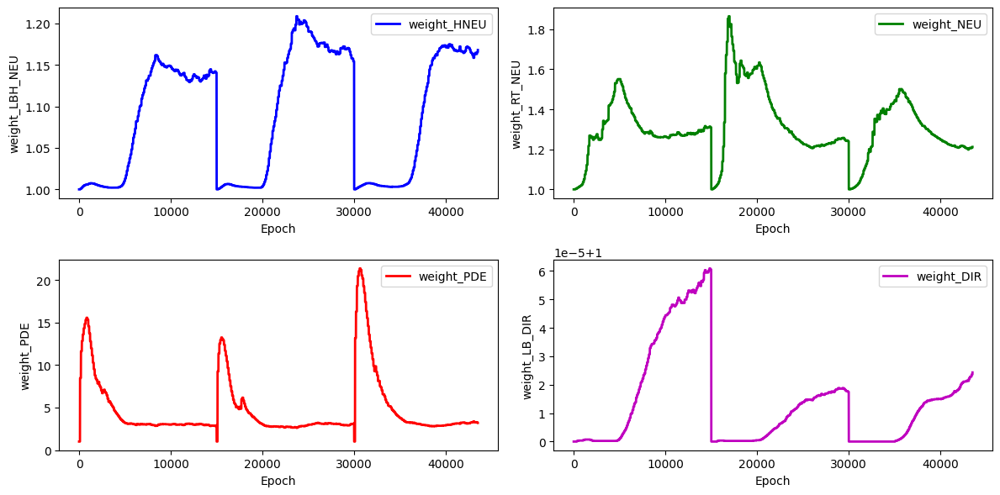

stress_Error for the stress_hole is: 11.682868697856422


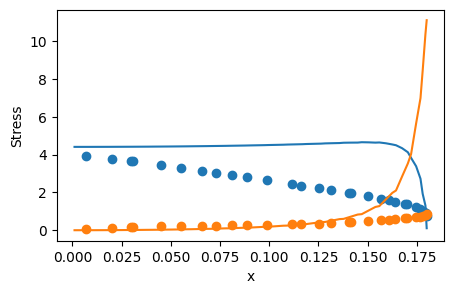

 91%|█████████ | 13600/15000 [1:30:51<09:59,  2.34it/s]

for weight 0 norm_grad: 178.26266479492188
for weight 0 new lamda dach: 1.1774482727050781
for weight 0 new lamdaloss norm: 209.8950653076172
for weight 1 norm_grad: 214.888427734375
for weight 1 new lamda dach: 1.2220003604888916
for weight 1 new lamdaloss norm: 262.59375
for weight 2 norm_grad: 789.6669311523438
for weight 2 new lamda dach: 3.0083813667297363
for weight 2 new lamdaloss norm: 2375.619384765625
for weight 3 norm_grad: 0.03466850146651268
for weight 3 new lamda dach: 1.0000293254852295
for weight 3 new lamdaloss norm: 0.03466951847076416
for weight 0 new weight_value: 1.1688255071640015
for weight 1 new weight_value: 1.212996482849121
for weight 2 new weight_value: 3.1788175106048584
for weight 3 new weight_value: 1.0000247955322266


 91%|█████████▏| 13700/15000 [1:31:34<09:27,  2.29it/s]

for weight 0 norm_grad: 174.017822265625
for weight 0 new lamda dach: 1.1709603071212769
for weight 0 new lamdaloss norm: 203.76797485351562
for weight 1 norm_grad: 215.2792205810547
for weight 1 new lamda dach: 1.2204322814941406
for weight 1 new lamdaloss norm: 262.73370361328125
for weight 2 norm_grad: 802.5718994140625
for weight 2 new lamda dach: 3.061415195465088
for weight 2 new lamdaloss norm: 2457.005859375
for weight 3 norm_grad: 0.03355293348431587
for weight 3 new lamda dach: 1.000028133392334
for weight 3 new lamdaloss norm: 0.033553872257471085
for weight 0 new weight_value: 1.169039011001587
for weight 1 new weight_value: 1.2137401103973389
for weight 2 new weight_value: 3.1670773029327393
for weight 3 new weight_value: 1.0000250339508057


 92%|█████████▏| 13800/15000 [1:32:21<08:26,  2.37it/s]

for weight 0 norm_grad: 163.7923126220703
for weight 0 new lamda dach: 1.153015375137329
for weight 0 new lamdaloss norm: 188.85507202148438
for weight 1 norm_grad: 201.5808868408203
for weight 1 new lamda dach: 1.1952089071273804
for weight 1 new lamdaloss norm: 240.93125915527344
for weight 2 norm_grad: 868.8157958984375
for weight 2 new lamda dach: 3.3776636123657227
for weight 2 new lamdaloss norm: 2934.56787109375
for weight 3 norm_grad: 0.03412821516394615
for weight 3 new lamda dach: 1.0000276565551758
for weight 3 new lamdaloss norm: 0.03412916138768196
for weight 0 new weight_value: 1.1674365997314453
for weight 1 new weight_value: 1.211887001991272
for weight 2 new weight_value: 3.188135862350464
for weight 3 new weight_value: 1.0000252723693848


 93%|█████████▎| 13900/15000 [1:33:03<07:32,  2.43it/s]

for weight 0 norm_grad: 163.8180694580078
for weight 0 new lamda dach: 1.169213891029358
for weight 0 new lamdaloss norm: 191.53836059570312
for weight 1 norm_grad: 219.36996459960938
for weight 1 new lamda dach: 1.2403895854949951
for weight 1 new lamdaloss norm: 272.1042175292969
for weight 2 norm_grad: 748.70849609375
for weight 2 new lamda dach: 2.953721761703491
for weight 2 new lamdaloss norm: 2211.476318359375
for weight 3 norm_grad: 0.03372354805469513
for weight 3 new lamda dach: 1.0000298023223877
for weight 3 new lamdaloss norm: 0.033724553883075714
for weight 0 new weight_value: 1.1676143407821655
for weight 1 new weight_value: 1.2147371768951416
for weight 2 new weight_value: 3.1646945476531982
for weight 3 new weight_value: 1.000025749206543


 93%|█████████▎| 13999/15000 [1:33:51<08:57,  1.86it/s]

for weight 0 norm_grad: 166.4224090576172
for weight 0 new lamda dach: 1.140120267868042
for weight 0 new lamdaloss norm: 189.7415771484375
for weight 1 norm_grad: 212.5706787109375
for weight 1 new lamda dach: 1.18621027469635
for weight 1 new lamdaloss norm: 252.1535186767578
for weight 2 norm_grad: 975.1056518554688
for weight 2 new lamda dach: 3.5726513862609863
for weight 2 new lamdaloss norm: 3483.71240234375
for weight 3 norm_grad: 0.03438893333077431
for weight 3 new lamda dach: 1.0000253915786743
for weight 3 new lamdaloss norm: 0.03438980504870415
for weight 0 new weight_value: 1.1648648977279663
for weight 1 new weight_value: 1.2118843793869019
for weight 2 new weight_value: 3.2054903507232666
for weight 3 new weight_value: 1.000025749206543
total_loss: 0.7258942127227783, hole_loss:  0.26046061515808105,neumann_loss:  0.19585315883159637, pde_loss: 0.24558115005493164,dirichlet_loss: 5.9453523135744035e-05


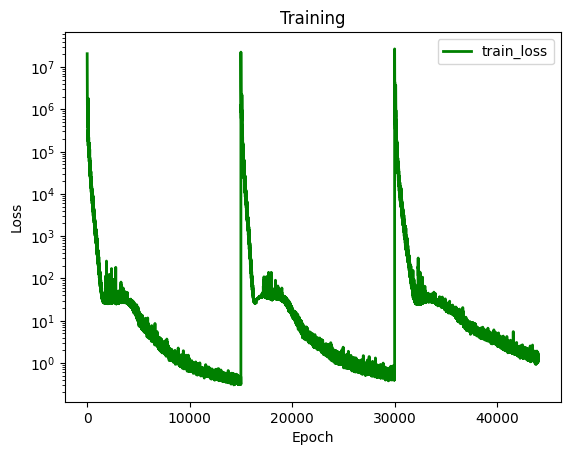

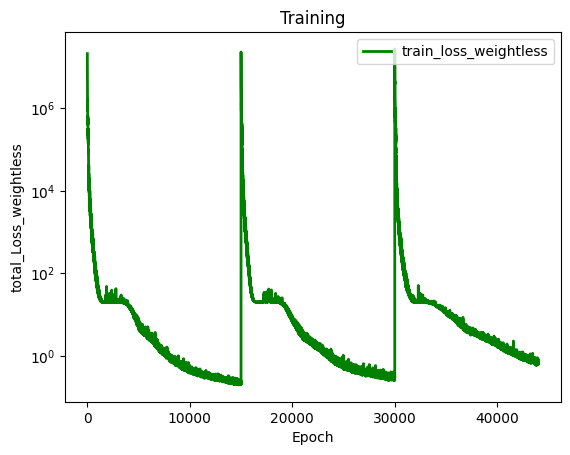

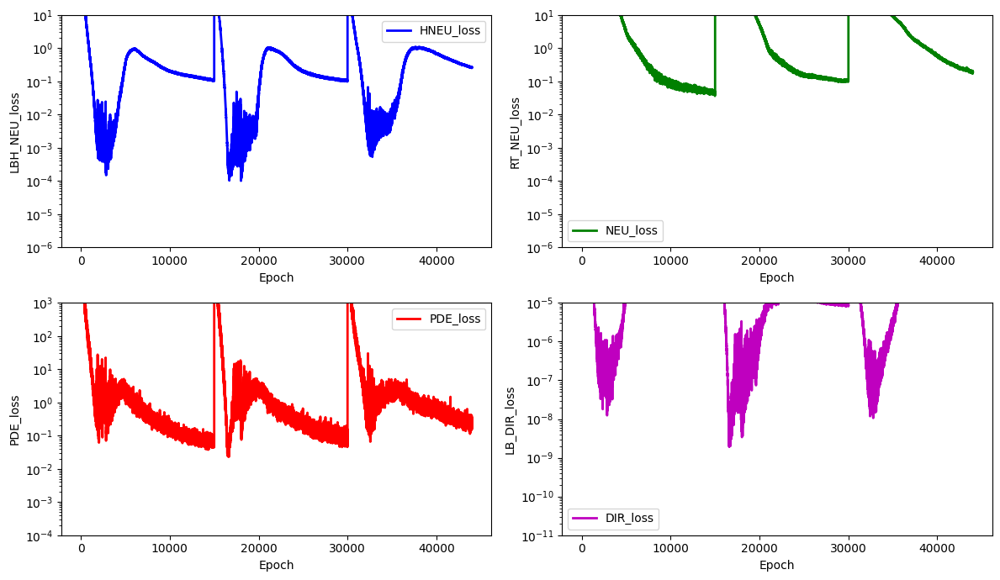

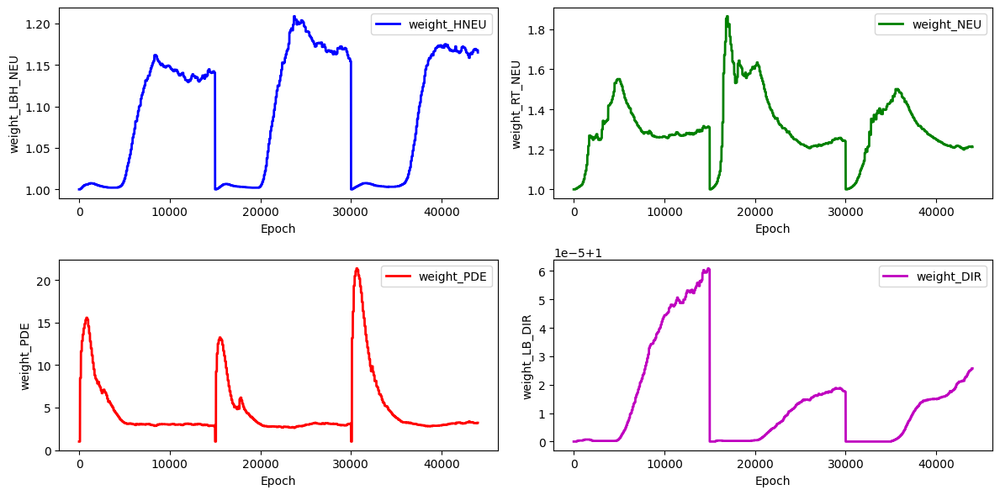

stress_Error for the stress_hole is: 11.75801945247542


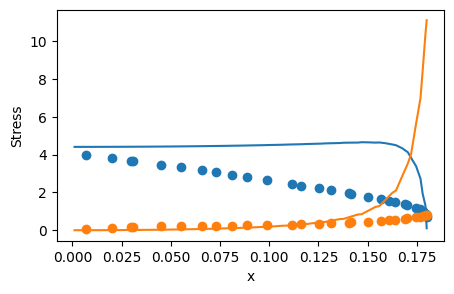

 94%|█████████▍| 14100/15000 [1:34:46<07:56,  1.89it/s]

for weight 0 norm_grad: 164.21173095703125
for weight 0 new lamda dach: 1.1941196918487549
for weight 0 new lamdaloss norm: 196.0884552001953
for weight 1 norm_grad: 209.21832275390625
for weight 1 new lamda dach: 1.2612212896347046
for weight 1 new lamdaloss norm: 263.87060546875
for weight 2 norm_grad: 636.677734375
for weight 2 new lamda dach: 2.7047886848449707
for weight 2 new lamdaloss norm: 1722.07861328125
for weight 3 norm_grad: 0.03423338010907173
for weight 3 new lamda dach: 1.0000338554382324
for weight 3 new lamdaloss norm: 0.03423453867435455
for weight 0 new weight_value: 1.1677902936935425
for weight 1 new weight_value: 1.2168179750442505
for weight 2 new weight_value: 3.1554203033447266
for weight 3 new weight_value: 1.0000265836715698


 95%|█████████▍| 14200/15000 [1:35:38<07:04,  1.88it/s]

for weight 0 norm_grad: 160.76608276367188
for weight 0 new lamda dach: 1.1995798349380493
for weight 0 new lamdaloss norm: 192.85177612304688
for weight 1 norm_grad: 195.0335693359375
for weight 1 new lamda dach: 1.2528783082962036
for weight 1 new lamdaloss norm: 244.3533172607422
for weight 2 norm_grad: 610.45458984375
for weight 2 new lamda dach: 2.7155609130859375
for weight 2 new lamdaloss norm: 1657.7265625
for weight 3 norm_grad: 0.03410216420888901
for weight 3 new lamda dach: 1.000035285949707
for weight 3 new lamdaloss norm: 0.03410336747765541
for weight 0 new weight_value: 1.1709692478179932
for weight 1 new weight_value: 1.220423936843872
for weight 2 new weight_value: 3.1114342212677
for weight 3 new weight_value: 1.0000274181365967


 95%|█████████▌| 14300/15000 [1:36:30<06:15,  1.86it/s]

for weight 0 norm_grad: 153.4813690185547
for weight 0 new lamda dach: 1.1330933570861816
for weight 0 new lamdaloss norm: 173.90872192382812
for weight 1 norm_grad: 198.66757202148438
for weight 1 new lamda dach: 1.1793029308319092
for weight 1 new lamdaloss norm: 234.28924560546875
for weight 2 norm_grad: 954.484375
for weight 2 new lamda dach: 3.710195302963257
for weight 2 new lamdaloss norm: 3541.3232421875
for weight 3 norm_grad: 0.033874958753585815
for weight 3 new lamda dach: 1.000025987625122
for weight 3 new lamdaloss norm: 0.03387584164738655
for weight 0 new weight_value: 1.1671817302703857
for weight 1 new weight_value: 1.2163118124008179
for weight 2 new weight_value: 3.1713104248046875
for weight 3 new weight_value: 1.0000272989273071


 96%|█████████▌| 14400/15000 [1:37:22<05:17,  1.89it/s]

for weight 0 norm_grad: 156.97085571289062
for weight 0 new lamda dach: 1.1224772930145264
for weight 0 new lamdaloss norm: 176.1962127685547
for weight 1 norm_grad: 195.67465209960938
for weight 1 new lamda dach: 1.1574302911758423
for weight 1 new lamdaloss norm: 226.47975158691406
for weight 2 norm_grad: 1085.9237060546875
for weight 2 new lamda dach: 4.079066276550293
for weight 2 new lamdaloss norm: 4429.5546875
for weight 3 norm_grad: 0.034072913229465485
for weight 3 new lamda dach: 1.0000237226486206
for weight 3 new lamdaloss norm: 0.03407372534275055
for weight 0 new weight_value: 1.162711262702942
for weight 1 new weight_value: 1.2104235887527466
for weight 2 new weight_value: 3.2620859146118164
for weight 3 new weight_value: 1.0000269412994385


 97%|█████████▋| 14499/15000 [1:38:15<04:21,  1.92it/s]

for weight 0 norm_grad: 154.67568969726562
for weight 0 new lamda dach: 1.1876035928726196
for weight 0 new lamdaloss norm: 183.6934051513672
for weight 1 norm_grad: 197.94119262695312
for weight 1 new lamda dach: 1.2533756494522095
for weight 1 new lamdaloss norm: 248.09466552734375
for weight 2 norm_grad: 626.5067138671875
for weight 2 new lamda dach: 2.7765655517578125
for weight 2 new lamdaloss norm: 1739.536865234375
for weight 3 norm_grad: 0.03361468017101288
for weight 3 new lamda dach: 1.0000343322753906
for weight 3 new lamdaloss norm: 0.0336158387362957
for weight 0 new weight_value: 1.1652004718780518
for weight 1 new weight_value: 1.2147188186645508
for weight 2 new weight_value: 3.213533878326416
for weight 3 new weight_value: 1.0000276565551758
total_loss: 0.5621262788772583, hole_loss:  0.23924952745437622,neumann_loss:  0.1819658875465393, pde_loss: 0.1346624791622162,dirichlet_loss: 5.955242522759363e-05


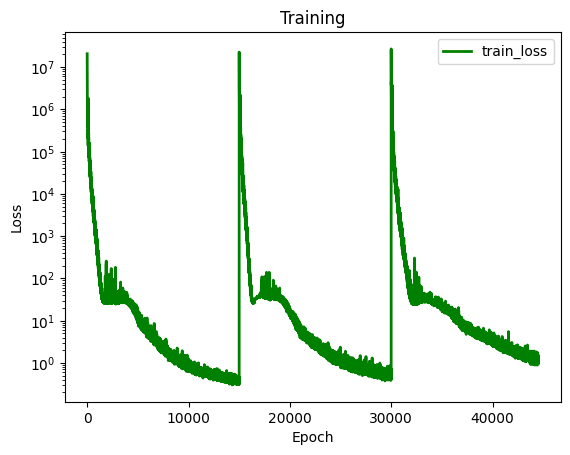

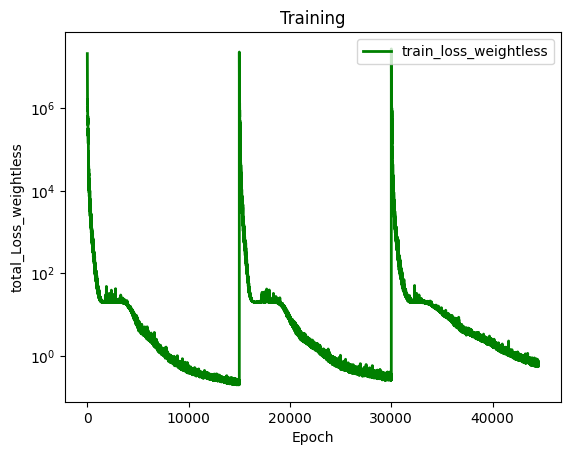

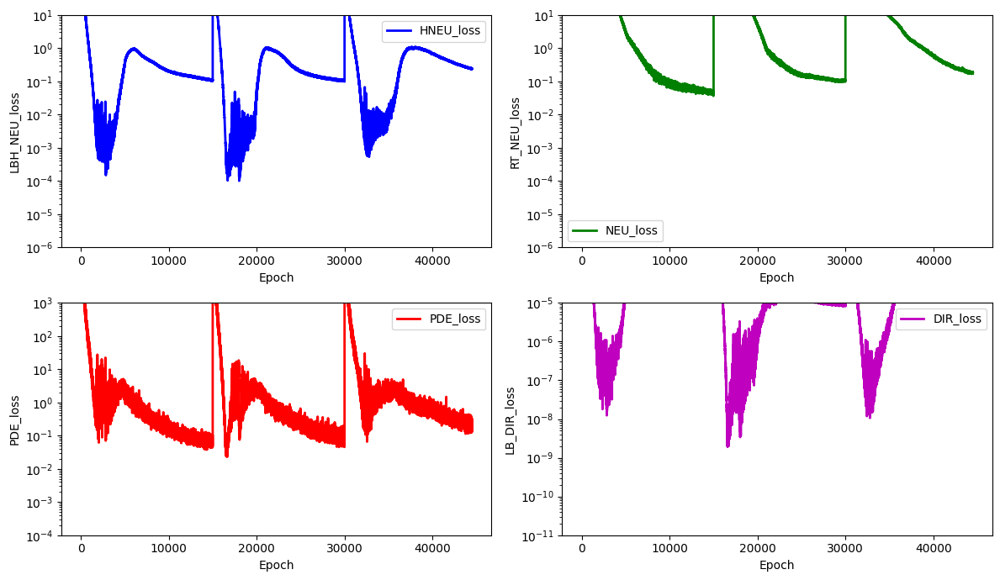

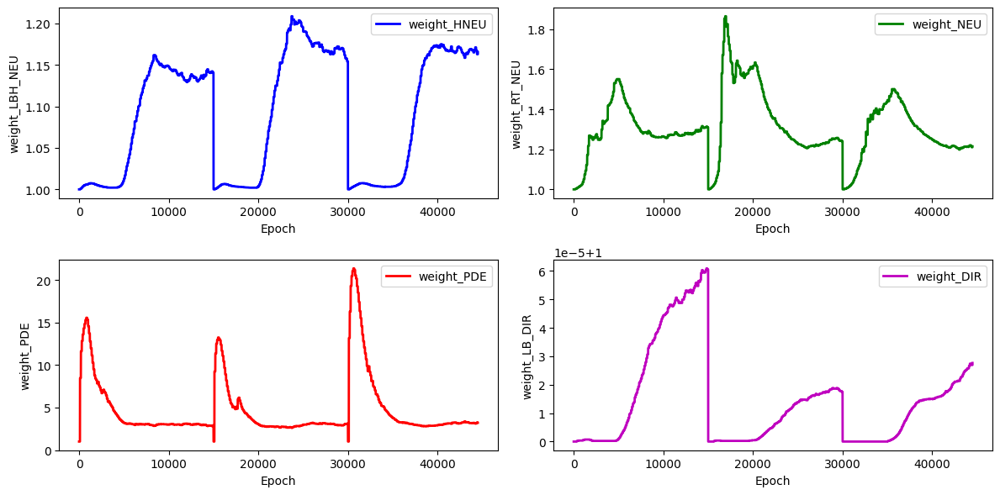

stress_Error for the stress_hole is: 11.838553063416263


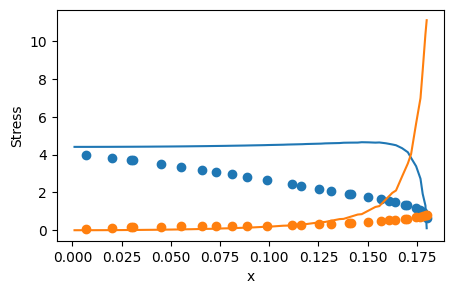

 97%|█████████▋| 14600/15000 [1:39:13<03:49,  1.74it/s]

for weight 0 norm_grad: 151.5323944091797
for weight 0 new lamda dach: 1.2151920795440674
for weight 0 new lamdaloss norm: 184.14097595214844
for weight 1 norm_grad: 202.3822021484375
for weight 1 new lamda dach: 1.309773564338684
for weight 1 new lamdaloss norm: 265.0748596191406
for weight 2 norm_grad: 501.75738525390625
for weight 2 new lamda dach: 2.417603015899658
for weight 2 new lamdaloss norm: 1213.0501708984375
for weight 3 norm_grad: 0.03314195200800896
for weight 3 new lamda dach: 1.000038743019104
for weight 3 new lamdaloss norm: 0.033143237233161926
for weight 0 new weight_value: 1.1701996326446533
for weight 1 new weight_value: 1.224224328994751
for weight 2 new weight_value: 3.1339406967163086
for weight 3 new weight_value: 1.0000287294387817


 98%|█████████▊| 14700/15000 [1:40:08<02:51,  1.75it/s]

for weight 0 norm_grad: 148.93096923828125
for weight 0 new lamda dach: 1.1328389644622803
for weight 0 new lamdaloss norm: 168.71481323242188
for weight 1 norm_grad: 189.0906524658203
for weight 1 new lamda dach: 1.174925446510315
for weight 1 new lamdaloss norm: 222.1674041748047
for weight 2 norm_grad: 932.0139770507812
for weight 2 new lamda dach: 3.756986141204834
for weight 2 new lamdaloss norm: 3501.563720703125
for weight 3 norm_grad: 0.033685021102428436
for weight 3 new lamda dach: 1.0000265836715698
for weight 3 new lamdaloss norm: 0.03368591517210007
for weight 0 new weight_value: 1.1664634943008423
for weight 1 new weight_value: 1.2192944288253784
for weight 2 new weight_value: 3.1962451934814453
for weight 3 new weight_value: 1.0000284910202026


 99%|█████████▊| 14800/15000 [1:41:02<01:53,  1.76it/s]

for weight 0 norm_grad: 151.81134033203125
for weight 0 new lamda dach: 1.1456022262573242
for weight 0 new lamdaloss norm: 173.9154052734375
for weight 1 norm_grad: 193.91050720214844
for weight 1 new lamda dach: 1.1938047409057617
for weight 1 new lamdaloss norm: 231.4912872314453
for weight 2 norm_grad: 848.700927734375
for weight 2 new lamda dach: 3.4546291828155518
for weight 2 new lamdaloss norm: 2931.947021484375
for weight 3 norm_grad: 0.03328125551342964
for weight 3 new lamda dach: 1.0000278949737549
for weight 3 new lamdaloss norm: 0.03328218311071396
for weight 0 new weight_value: 1.1643773317337036
for weight 1 new weight_value: 1.216745376586914
for weight 2 new weight_value: 3.222083568572998
for weight 3 new weight_value: 1.000028371810913


 99%|█████████▉| 14900/15000 [1:41:56<00:55,  1.81it/s]

for weight 0 norm_grad: 147.489013671875
for weight 0 new lamda dach: 1.1902072429656982
for weight 0 new lamdaloss norm: 175.54249572753906
for weight 1 norm_grad: 191.71768188476562
for weight 1 new lamda dach: 1.2622017860412598
for weight 1 new lamdaloss norm: 241.98641967773438
for weight 2 norm_grad: 583.6607055664062
for weight 2 new lamda dach: 2.720492124557495
for weight 2 new lamdaloss norm: 1587.84423828125
for weight 3 norm_grad: 0.033815499395132065
for weight 3 new lamda dach: 1.000036597251892
for weight 3 new lamdaloss norm: 0.03381673991680145
for weight 0 new weight_value: 1.1669602394104004
for weight 1 new weight_value: 1.2212910652160645
for weight 2 new weight_value: 3.171924352645874
for weight 3 new weight_value: 1.0000290870666504


100%|█████████▉| 14999/15000 [1:42:48<00:00,  1.93it/s]

for weight 0 norm_grad: 143.3434295654297
for weight 0 new lamda dach: 1.1743040084838867
for weight 0 new lamdaloss norm: 168.32876586914062
for weight 1 norm_grad: 182.1641845703125
for weight 1 new lamda dach: 1.232484221458435
for weight 1 new lamdaloss norm: 224.51449584960938
for weight 2 norm_grad: 640.1780395507812
for weight 2 new lamda dach: 2.966503858566284
for weight 2 new lamdaloss norm: 1899.0908203125
for weight 3 norm_grad: 0.03359965234994888
for weight 3 new lamda dach: 1.0000348091125488
for weight 3 new lamdaloss norm: 0.0336008220911026
for weight 0 new weight_value: 1.1676946878433228
for weight 1 new weight_value: 1.2224104404449463
for weight 2 new weight_value: 3.1513822078704834
for weight 3 new weight_value: 1.0000295639038086
total_loss: 0.5655769109725952, hole_loss:  0.22106632590293884,neumann_loss:  0.16371572017669678, pde_loss: 0.16161790490150452,dirichlet_loss: 6.093417323427275e-05


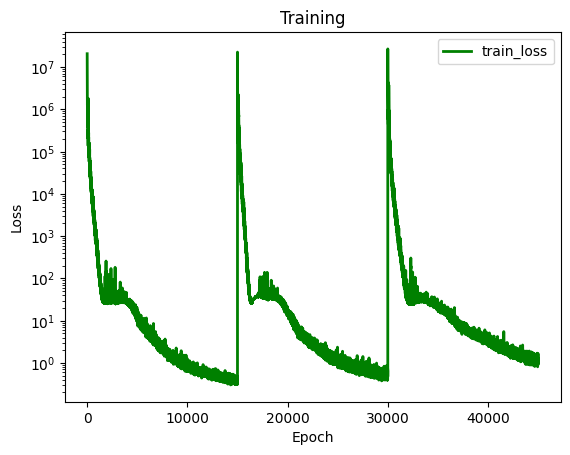

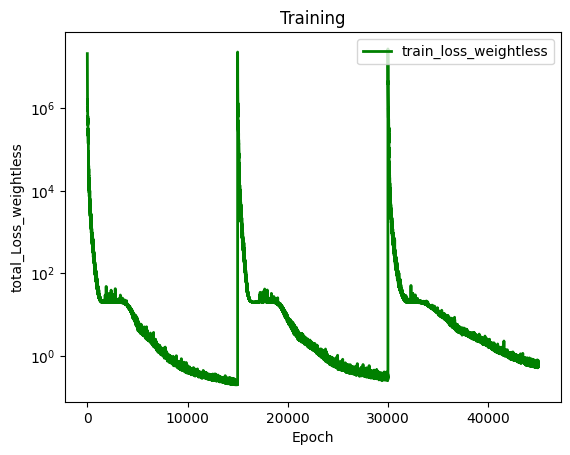

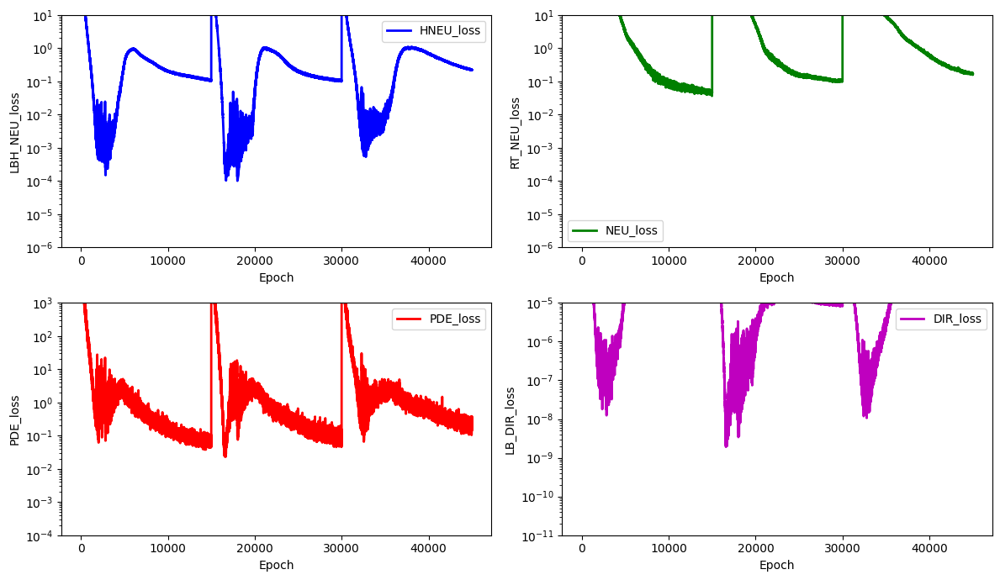

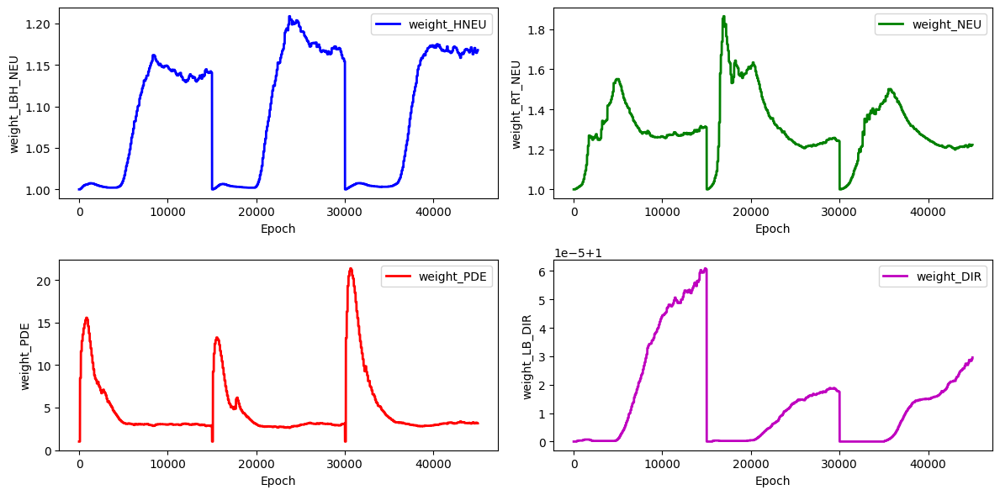

stress_Error for the stress_hole is: 11.963328908803184


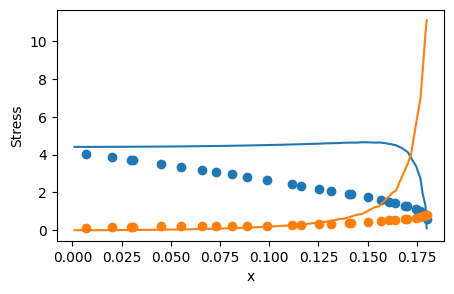

100%|██████████| 15000/15000 [1:42:53<00:00,  2.43it/s]

total_loss: 0.5655769109725952, hole_loss:  0.22106632590293884, neumann_loss:  0.16371572017669678, pde_loss: 0.16161790490150452, dirichlet_loss: 6.093417323427275e-05
previous lowest lost  5
lowest loss 1.0265060663223267 archived, PINN is saved: 'net_param/net_0.18000000.pth


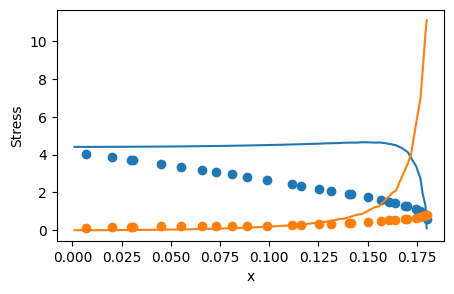

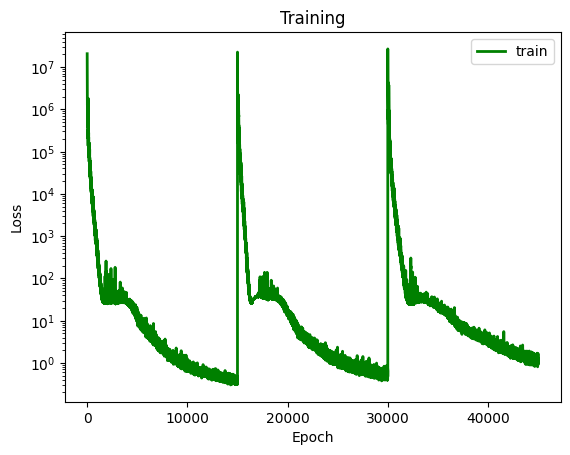

Weight_HNEU: 1.0, Weight_NEU: 1.0, Weight_PDE: 1.0, Weight_STRESS: 1.0, Stress Error: 11.963328908803184


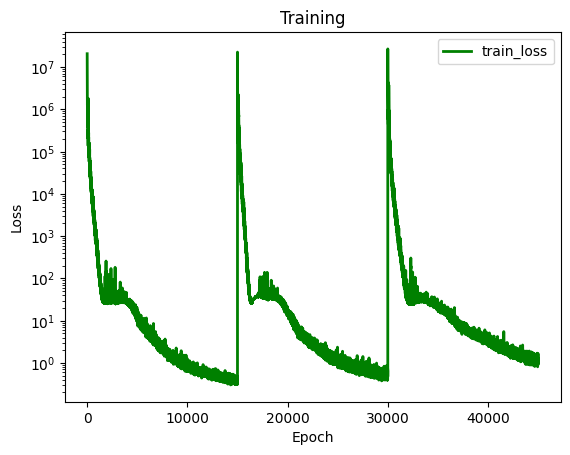

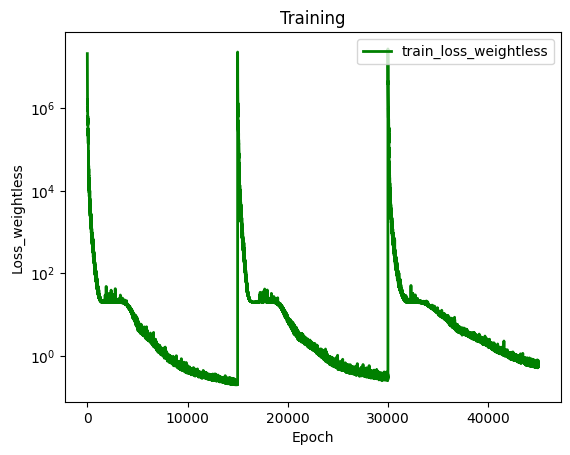

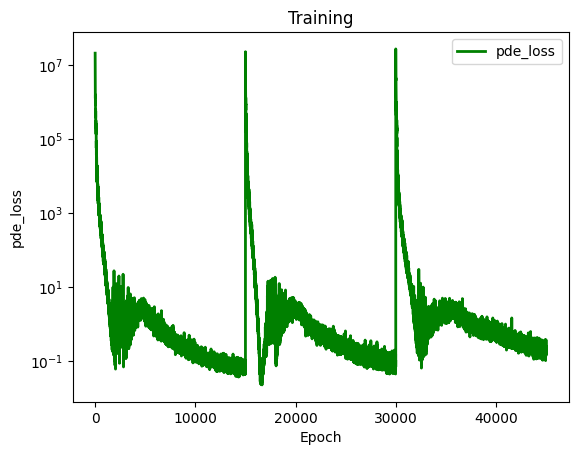

In [20]:

#scheduler = ExponentialLR(optimizer, gamma=0.999)
loss_history = []
HNEU_loss_history = []
PDE_loss_history = []
NEU_loss_history = []
DIR_loss_history = []
loss_weightless_history = []
weightHNEU_history = []
weightNEU_history = []
weightPDE_history = []
weightDIR_history = []


# Weight of PDE lossWeight_NEU: 1.8841683879627231e-06, Weight_PDE: 3.1355081392423563e-06
# Weight of Neumann loss explicitly for the right and top boundary condition
W_NEU = 6.4531255763296895e-06 #previous value -> 1.88e-06
# Weight of Neumann loss explicitly for the hole boundary condition
W_HNEU = 8.2e-05
W_PDE = 8.376708219353885e-06 #previous value -> 3.14e-06
# Weight of data losses
W_DIR = 1.0
W_STRESS = 0.0 #previous value -> 1.0e-07 
W_DISP = 0.0


target_loss = torch.tensor(5)

#set all weights to 1 
Weight_RT_NEU = torch.tensor(1.0) 
Weight_LBH_NEU = torch.tensor(1.0)
Weight_PDE = torch.tensor(1.0) 
Weight_LB_DIR = torch.tensor(1.0) #torch.tensor(5e+07
Weight_STRESS = torch.tensor(1.0)


def training(compare_rad_x, target_loss):

    target_loss = torch.tensor(5)

    #set all weights to 1 
    Weight_RT_NEU = torch.tensor(1.0) 
    Weight_LBH_NEU = torch.tensor(1.0)
    Weight_PDE = torch.tensor(1.0) 
    Weight_LB_DIR = torch.tensor(1.0) #torch.tensor(5e+07
    Weight_STRESS = torch.tensor(1.0)

    #reset all net parameters 
    #net.apply(weight_reset)

    #hyperparameter weights
    weights = [Weight_LBH_NEU, Weight_RT_NEU, Weight_PDE, Weight_LB_DIR]
    
    
    p1 = Plate(compare_rad_x, N, M) 
    data_input, data_output, data_hole = p1.load_reference_data()
    compare_collo, compare_top, compare_right, compare_left, compare_bottom, compare_hole = p1.generate_dataset()

    #collocation, top, right, left, bottom, hole = generate_multiple_plates(0.04, 0.18, 0.01)
    collocation, top, right, left, bottom, hole = generate_multiple_plates(compare_rad_x, compare_rad_x, 0.0)
    data_hole = data_hole.numpy()
    data_hole = data_hole[data_hole[:, 0].argsort()]
    data_stress_x = data_hole[:, 2]
    data_stress_y = data_hole[:, 3]

    #interpolate data_stress_x and data_stress_y
    f_stress_x = interp1d(data_hole[:, 0], data_hole[:, 2], kind='cubic')
    f_stress_y = interp1d(data_hole[:, 0], data_hole[:, 3], kind='cubic')
    x_new = np.linspace(data_hole[:, 0][-1], data_hole[:, 0][0], compare_hole[:, 0].size(dim=0))
    y_stress_x = f_stress_x(x_new)
    y_stress_y = f_stress_y(x_new)

    optimizer = torch.optim.Adam(net.parameters(), lr=lr)
    scheduler = StepLR(optimizer, step_size=scheduler_step, gamma=scheduler_gamma)
    #scheduler = ExponentialLR(optimizer,  gamma= expo_gamma)
    print("Starting with Adam optimizer...")
    for epoch in tqdm(range(epochs)):

        collocation, top, right, left, bottom, hole = generate_multiple_plates(compare_rad_x, compare_rad_x, 0.0)

        # Reset batch count at the start of each epoch
        batch_count = 0

        # Permutation to shuffle collocation points randomly in each epoch
        permutation = torch.randperm(collocation.size()[0])

        for i in range(0, collocation.size()[0], batch_size):
            indices = permutation[i : i + batch_size]
            collo = collocation[indices]
            optimizer.zero_grad()

            # Compute physics losses
            (
                left_l,
                left_sl,
                right_l,
                bottom_l,
                bottom_sl,
                top_l,
                hole_l,
                pde_l,
            ) = compute_physics_losses(collo, top, right, left, bottom, hole)

            if W_DISP < 1E-10 and W_STRESS < 1E-10:
                # No data losses needed (we can accelerate training by skipping this part)
                stress_l = 0.0
                disp_l = 0.0
            else:
                # Get samples from reference solution
                samples = torch.randperm(data_output.size()[0])[::100]
                # Reference solutions
                s_data = data_output[samples, 0:3]
                e_data = data_output[samples, 4:7]
                u_data = data_output[samples, 7:10]
                # Predictions
                s_pred = torch.vmap(sigma)(data_input[samples, 0:3])
                e_pred = torch.vmap(epsilon)(data_input[samples, 0:3])
                u_pred = net(data_input[samples, 0:3])
                # Compute data losses
                ds_xx = mse(s_data[:, 0], s_pred[:, 0, 0])
                ds_yy = mse(s_data[:, 1], s_pred[:, 1, 1])
                ds_xy = mse(s_data[:, 2], s_pred[:, 0, 1])
                stress_l = ds_xx + ds_yy + ds_xy
                du_x = mse(u_data[:, 0], u_pred[:, 0])
                du_y = mse(u_data[:, 1], u_pred[:, 1])
                disp_l = du_x + du_y

            # Aggregate losses
            #non dimensionalization of the loss function
            lbh_neumann_losses_nd = left_sl + bottom_sl + hole_l
            rt_neumann_losses_nd = right_l + top_l
            total_neumann_loss_nd = right_l + top_l + left_sl + bottom_sl + hole_l
            pde_losses_nd = pde_l
            lb_dirichlet_losses_nd = left_l + bottom_l

            loss = (
                    weights[0] * lbh_neumann_losses_nd #Weight_HNEU 
                    + weights[1] * rt_neumann_losses_nd  #Weight_NEU
                    + weights[2] * pde_losses_nd #Weight_PDE 
                    + weights[3] * lb_dirichlet_losses_nd #Weight_DIR
                    )
            
            loss_weightless = (
                lbh_neumann_losses_nd
                + rt_neumann_losses_nd 
                + pde_losses_nd 
                + lb_dirichlet_losses_nd 
            )

            # Make optimization step after batch
            loss.backward(retain_graph=True)
            optimizer.step()

            
            
        #update non dimensionalizated weights 
        if (epoch+1) % step_size == 0:

            # Compute physics losses
            (
                left_l,
                left_sl,
                right_l,
                bottom_l,
                bottom_sl,
                top_l,
                hole_l,
                pde_l,
            ) = compute_physics_losses(collo, top, right, left, bottom, hole)

            # Aggregate losses
            lbh_neumann_losses_nd = left_sl + bottom_sl + hole_l
            rt_neumann_losses_nd = right_l + top_l
            total_neumann_loss_nd = right_l + top_l + left_sl + bottom_sl + hole_l
            pde_losses_nd = pde_l 
            lb_dirichlet_losses_nd = left_l + bottom_l
            
            # Get only the weight parameters
            weight_params = [param for name, param in net.named_parameters() if 'weight' in name]

            # Compute gradients for each loss
            grad_hole_neumann_losses_nd = torch.autograd.grad(lbh_neumann_losses_nd, weight_params, retain_graph=True)
            grad_neumann_losses_nd = torch.autograd.grad(rt_neumann_losses_nd, weight_params, retain_graph=True)
            grad_pde_losses_nd = torch.autograd.grad(pde_losses_nd, weight_params, retain_graph=True)
            grad_dirichlet_losses_nd = torch.autograd.grad(lb_dirichlet_losses_nd, weight_params, retain_graph=True)

            # Compute L2 norm for each gradient
            norm_grad_LBH_neumann_losses_nd = sum(torch.linalg.norm(grad) for grad in grad_hole_neumann_losses_nd)
            norm_grad_RT_neumann_losses_nd = sum(torch.linalg.norm(grad) for grad in grad_neumann_losses_nd) 
            norm_grad_pde_losses_nd = sum(torch.linalg.norm(grad) for grad in grad_pde_losses_nd)
            norm_grad_LB_dirichlet_losses_nd =sum(torch.linalg.norm(grad) for grad in grad_dirichlet_losses_nd) 

            #print(f"adopting weights after {step_size} epochs")
            new_weights = [Weight_LBH_NEU, Weight_RT_NEU, Weight_PDE, Weight_LB_DIR]
            norm_grad_losses_nd = [norm_grad_LBH_neumann_losses_nd, norm_grad_RT_neumann_losses_nd,
                                    norm_grad_pde_losses_nd, norm_grad_LB_dirichlet_losses_nd]
            grad_losses = [grad_hole_neumann_losses_nd, grad_neumann_losses_nd, grad_pde_losses_nd, grad_dirichlet_losses_nd]

            for index, weight in enumerate(weights):
                # print(f"Gradient of weight: {index} w.r.t to L: {weight.grad}, old_weight: {weight}")
                # print("weights_grad", weights[index].grad)
                # print("zeros", torch.zeros(1))
                # print("mse_of_weights_grad", mse(weights[index].grad, torch.zeros(1)))
                # print("squared_error of weights_grad", weights[index].grad*weights[index].grad)

                # Compute sum of all gradients for each loss
                weight_grad_sum = (
                    norm_grad_LBH_neumann_losses_nd
                    + norm_grad_RT_neumann_losses_nd
                    + norm_grad_pde_losses_nd
                    + norm_grad_LB_dirichlet_losses_nd
                )

                print(f"for weight {index} norm_grad: {norm_grad_losses_nd[index]}")
                new_weights[index] = weight_grad_sum/ (weight_grad_sum - norm_grad_losses_nd[index])
                print(f"for weight {index} new lamda dach: {new_weights[index]}")
                norm_lamdaloss = sum(torch.linalg.norm(grad * new_weights[index]) for grad in grad_losses[index])
                print(f"for weight {index} new lamdaloss norm: {norm_lamdaloss}")


            #update new weights
            for index, weight in enumerate(weights):
                new_weight = 0.9*weight + 0.1*new_weights[index]
                weights[index] = new_weight.clone().detach().requires_grad_(True)
                print(f"for weight {index} new weight_value: {weights[index]}")

        # Make scheduler step after full epoch
        scheduler.step()  

  
        
        # append loss to history (=for plotting)
        with torch.autograd.no_grad():
            loss_history.append(float(loss.data))
            loss_weightless_history.append(float(loss_weightless.data))
            HNEU_loss_history.append(float(lbh_neumann_losses_nd))
            NEU_loss_history.append(float(rt_neumann_losses_nd))
            PDE_loss_history.append(float(pde_losses_nd))
            DIR_loss_history.append(float(lb_dirichlet_losses_nd))
            weightHNEU_history.append(float(weights[0]))
            weightNEU_history.append(float(weights[1]))
            weightPDE_history.append(float(weights[2]))
            weightDIR_history.append(float(weights[3]))
            

        #print progress during training
        if (epoch+1) % (step_size*5) == 0:
            print(f"total_loss: {loss_weightless.data}, hole_loss:  {lbh_neumann_losses_nd},neumann_loss:  {rt_neumann_losses_nd}, pde_loss: {pde_losses_nd},dirichlet_loss: {lb_dirichlet_losses_nd}")
            
            with torch.autograd.no_grad():
                plt.plot(loss_history, c='g', label='train_loss', linewidth=2.0)
                plt.yscale("log")
                plt.title("Training")
                plt.ylabel("Loss")
                plt.xlabel("Epoch")
                plt.legend()
                plt.show()

                plt.plot(loss_weightless_history, c='g', label='train_loss_weightless', linewidth=2.0)
                plt.yscale("log")
                plt.title("Training")
                plt.ylabel("total_Loss_weightless")
                plt.xlabel("Epoch")
                plt.legend()
                plt.show()

                fig, axs = plt.subplots(2, 2, figsize=(12, 7))

                # plot for HNEU_loss_history
                axs[0, 0].plot(HNEU_loss_history, c='b', label='HNEU_loss', linewidth=2.0)
                axs[0, 0].set_ylabel("LBH_NEU_loss")
                axs[0, 0].set_xlabel("Epoch")
                axs[0, 0].legend()
                axs[0, 0].set_yscale('log')
                axs[0, 0].set_ylim([1e-6, 10.0])  

                # plot for NEU_loss_history
                axs[0, 1].plot(NEU_loss_history, c='g', label='NEU_loss', linewidth=2.0)
                axs[0, 1].set_ylabel("RT_NEU_loss")
                axs[0, 1].set_xlabel("Epoch")
                axs[0, 1].legend()
                axs[0, 1].set_yscale('log')
                axs[0, 1].set_ylim([1e-6, 10.0])  

                # plot for PDE_loss_history
                axs[1, 0].plot(PDE_loss_history, c='r', label='PDE_loss', linewidth=2.0)
                axs[1, 0].set_ylabel("PDE_loss")
                axs[1, 0].set_xlabel("Epoch")
                axs[1, 0].legend()
                axs[1, 0].set_yscale('log')
                axs[1, 0].set_ylim([1e-4, 1000.0])  

                # plot for DIR_loss_history
                axs[1, 1].plot(DIR_loss_history, c='m', label='DIR_loss', linewidth=2.0)
                axs[1, 1].set_ylabel("LB_DIR_loss")
                axs[1, 1].set_xlabel("Epoch")
                axs[1, 1].legend()
                axs[1, 1].set_yscale('log')
                axs[1, 1].set_ylim([1e-11, 1e-5]) 

                plt.tight_layout()
                plt.show()


                fig, axs = plt.subplots(2, 2, figsize=(12, 6))

                # plot for weightHNEU_history
                axs[0, 0].plot(weightHNEU_history, c='b', label='weight_HNEU', linewidth=2.0)
                axs[0, 0].set_ylabel("weight_LBH_NEU")
                axs[0, 0].set_xlabel("Epoch")
                axs[0, 0].legend()

                # plot for weightNEU_history
                axs[0, 1].plot(weightNEU_history, c='g', label='weight_NEU', linewidth=2.0)
                axs[0, 1].set_ylabel("weight_RT_NEU")
                axs[0, 1].set_xlabel("Epoch")
                axs[0, 1].legend()

                #plot for weightPDE_history
                axs[1, 0].plot(weightPDE_history, c='r', label='weight_PDE', linewidth=2.0)
                axs[1, 0].set_ylabel("weight_PDE")
                axs[1, 0].set_xlabel("Epoch")
                axs[1, 0].legend()

                # plot for weightDIR_history
                axs[1, 1].plot(weightDIR_history, c='m', label='weight_DIR', linewidth=2.0)
                axs[1, 1].set_ylabel("weight_LB_DIR")
                axs[1, 1].set_xlabel("Epoch")
                axs[1, 1].legend()

                plt.tight_layout()
                plt.show()

                # compare computed stressError(PINN) with actual stressError
                stress_hole = torch.vmap(sigma)(compare_hole[:, :-2])
                stressError = mse(stress_hole[:, 0, 0], torch.tensor(y_stress_x)) + mse(stress_hole[:, 1, 1], torch.tensor(y_stress_y))

                print(f"stress_Error for the stress_hole is: {stressError}")

                #weight_history.append(float(mse_error.data))
                plt.figure(figsize=(5, 3))
                plt.plot(compare_hole[:, 0], stress_hole[:, 0, 0], "o", color="tab:blue", label="σ_xx (PINN)")
                plt.plot(data_hole[:, 0], data_hole[:, 2], "-", color="tab:blue", label="σ_xx (FEM)")
                plt.plot(compare_hole[:, 0], stress_hole[:, 1, 1], "o", color="tab:orange", label="σ_yy (PINN)")
                plt.plot(data_hole[:, 0], data_hole[:, 3], "-", color="tab:orange", label="σ_yy (FEM)")
                plt.xlabel("x")
                plt.ylabel("Stress")
                #plt.legend()
                plt.show()


    print(f"total_loss: {loss_weightless.data}, hole_loss:  {lbh_neumann_losses_nd}, neumann_loss:  {rt_neumann_losses_nd}, pde_loss: {pde_losses_nd}, dirichlet_loss: {lb_dirichlet_losses_nd}")

    # compare computed stressError(PINN) with actual stressError
    stress_hole = torch.vmap(sigma)(compare_hole[:, :-2])
    stressError = mse(stress_hole[:, 0, 0], torch.tensor(y_stress_x)) + mse(stress_hole[:, 1, 1], torch.tensor(y_stress_y))

    lowest_loss = target_loss
    if(loss.data < target_loss):
        print(f"previous lowest lost  {target_loss}")
        lowest_loss = loss.data
        print(f"lowest loss {lowest_loss} archived, PINN is saved: 'net_param/net_{compare_rad_x:.8f}.pth")
        torch.save(net.state_dict(), f'net_param/net_{compare_rad_x:.8f}.pth')
    return stressError, data_hole, stress_hole, compare_hole, lowest_loss


# weights_optimizer = torch.optim.Adam([Weight_NEU, Weight_PDE], lr=1)
# weights_scheduler = ExponentialLR(weights_optimizer, gamma=1)
#net = Net()
radius = 0.16
for i in range(3):
    net = Net()
    #net.load_state_dict(torch.load('net_param/net_0.15000000.pth'))

    mse_error, data_hole, stress_hole, hole, lowest_loss = training(radius, target_loss)
    radius += 0.01

    #mse_error.backward()
    #weights_optimizer.step()
    #weights_scheduler.step()

    #save net parameters
    #torch.save(net.state_dict(), f'net_param/net_{rad_x:.2f}.pth')


    with torch.autograd.no_grad():
        #weight_history.append(float(mse_error.data))
        plt.figure(figsize=(5, 3))
        plt.plot(hole[:, 0], stress_hole[:, 0, 0], "o", color="tab:blue", label="σ_xx (PINN)")
        plt.plot(data_hole[:, 0], data_hole[:, 2], "-", color="tab:blue", label="σ_xx (FEM)")
        plt.plot(hole[:, 0], stress_hole[:, 1, 1], "o", color="tab:orange", label="σ_yy (PINN)")
        plt.plot(data_hole[:, 0], data_hole[:, 3], "-", color="tab:orange", label="σ_yy (FEM)")
        plt.xlabel("x")
        plt.ylabel("Stress")
        #plt.legend()
        plt.show()

        plt.plot(loss_history, c='g', label='train', linewidth=2.0)
        plt.yscale("log")
        plt.title("Training")
        plt.ylabel("Loss")
        plt.xlabel("Epoch")
        plt.legend()
        plt.show()
    
    # print weights and stress error and modify weight values for the next iteration
    print(f"Weight_HNEU: {Weight_LBH_NEU.item()}, Weight_NEU: {Weight_RT_NEU.item()}, Weight_PDE: {Weight_PDE.item()}, Weight_STRESS: {Weight_STRESS.item()}, Stress Error: {mse_error.item()}") 
    #Weight_STRESS = Weight_STRESS *1/1.1
    # Weight_NEU = Weight_NEU * (1.1/1.0)
    # Weight_PDE = Weight_PDE * (1.1/1.0)
    # Weight_HNEU = Weight_HNEU * (1.1/1.0)

#plt.figure(figsize=(8, 4))
plt.plot(loss_history, c='g', label='train_loss', linewidth=2.0)
plt.yscale("log")
plt.title("Training")
plt.ylabel("Loss")
plt.xlabel("Epoch")
plt.legend()
plt.show()

plt.plot(loss_weightless_history, c='g', label='train_loss_weightless', linewidth=2.0)
plt.yscale("log")
plt.title("Training")
plt.ylabel("Loss_weightless")
plt.xlabel("Epoch")
plt.legend()
plt.show()

plt.plot(PDE_loss_history, c='g', label='pde_loss', linewidth=2.0)
plt.yscale("log")
plt.title("Training")
plt.ylabel("pde_loss")
plt.xlabel("Epoch")
plt.legend()
plt.show()





## Visualization of results

In [21]:
val_rad_x = 0.14
val_plate = Plate(val_rad_x, N, M) 
data_input1, data_output1, data_hole1 = val_plate.load_reference_data()
val_collo, val_top, val_right, val_left, val_bottom, val_hole = val_plate.generate_dataset()

stress_hole1 = torch.vmap(sigma)(val_hole[:,:-2])
data_hole1 = np.loadtxt(f"data/hole_Rx={Rx}.csv", delimiter=",")
data_hole1 = data_hole1[data_hole1[:, 0].argsort()]

with torch.no_grad():
    fig = go.Figure()
    m1 = dict(color="blue")
    m2 = dict(color="orange")
    fig.add_trace(
        go.Scatter(
            x=hole[:, 0],
            y=stress_hole1[:, 0, 0],
            marker=m1,
            mode="markers",
            name="σ_xx (PINN)",
        )
    )
    fig.add_trace(
        go.Scatter(
            x=data_hole1[:, 0],
            y=data_hole1[:, 2],
            marker=m1,
            mode="lines",
            name="σ_xx (FEM)",
        )
    )
    fig.add_trace(
        go.Scatter(
            x=hole[:, 0],
            y=stress_hole1[:, 1, 1],
            marker=m2,
            mode="markers",
            name="σ_yy (PINN)",
        )
    )
    fig.add_trace(
        go.Scatter(
            x=data_hole1[:, 0],
            y=data_hole1[:, 3],
            marker=m2,
            mode="lines",
            name="σ_yy (FEM)",
        )
    )
    fig.update_layout(
        template="none", width=600, height=400, title="Stress at hole", showlegend=True
    )
    fig.show()

In [22]:

val_rad_x = 0.14
p_val = Plate(val_rad_x, N, M) 
val_data_input, val_data_output, val_data_hole = p_val.load_reference_data()
val_collo, val_top, val_right, val_left, val_bottom, val_hole = p_val.generate_dataset()

# Create a validation domain different from the training domain
val_x, val_y = np.meshgrid(np.linspace(0, L, 50), np.linspace(0, L, 50))
val_r = Rx * np.ones(np.shape(val_x))
val_domain = np.vstack([val_x.ravel(), val_y.ravel(), val_r.ravel()]).T
mask = (
    ((val_domain[:, 0] ** 2) / (Rx**2)) + ((val_domain[:, 1] ** 2) / (Ry**2))
) > 1
val = torch.tensor(val_domain[mask], requires_grad=True, dtype=DTYPE)


# Compute model predictions on the validation domain
disp = net(val)
def_val = val[:, :-1] + disp
stress = torch.vmap(sigma)(val)
mises = torch.sqrt(
    stress[:, 0, 0] ** 2
    + stress[:, 1, 1] ** 2
    - stress[:, 0, 0] * stress[:, 1, 1]
    + 3 * stress[:, 0, 1] ** 2
)
# print([loss.item() for loss in compute_les(val)])


@torch.no_grad()
def make_plot(x, y, variable, title, cmap=sequential.Viridis, size=8.0):
    fig = go.Figure()

    # Plot boundaries
    m = dict(color="black")
    fig.add_trace(go.Scatter(x=top[:, 0], y=top[:, 1], mode="lines", marker=m))
    fig.add_trace(go.Scatter(x=bottom[:, 0], y=bottom[:, 1], mode="lines", marker=m))
    fig.add_trace(go.Scatter(x=left[:, 0], y=left[:, 1], mode="lines", marker=m))
    fig.add_trace(go.Scatter(x=right[:, 0], y=right[:, 1], mode="lines", marker=m))
    fig.add_trace(go.Scatter(x=hole[:, 0], y=hole[:, 1], mode="lines", marker=m))

    # Plot variable values
    m = dict(color=variable, colorscale=cmap, size=size, colorbar=dict(thickness=10))
    fig.add_trace(go.Scatter(x=x, y=y, marker=m, mode="markers"))

    # plot settings
    fig.layout.yaxis.scaleanchor = "x"
    fig.update_layout(
        template="none", width=400, height=400, title=title, showlegend=False
    )
    fig.update_xaxes(visible=False)
    fig.update_yaxes(visible=False)
    fig.show()


# Compute data error
s_data = val_data_output[:, 0:3]
s_pred = torch.vmap(sigma)(val_data_input[:, 0:3])
ds_xx = s_data[:, 0] - s_pred[:, 0, 0]
ds_yy = s_data[:, 1] - s_pred[:, 1, 1]
ds_xy = s_data[:, 2] - s_pred[:, 0, 1]


# Plot stress errors
cmap = sequential.RdBu_r
make_plot(*val_data_input[:, 0:2].T, ds_xx, "Stress error xx", size=2.0, cmap=cmap)
make_plot(*val_data_input[:, 0:2].T, ds_yy, "Stress error yy", size=2.0, cmap=cmap)
make_plot(*val_data_input[:, 0:2].T, ds_xy, "Stress error xy", size=2.0, cmap=cmap)

# Plot stresses
make_plot(*def_val.T, stress[:, 0, 0], "Stress xx")
make_plot(*def_val.T, stress[:, 0, 1], "Stress xy")
make_plot(*def_val.T, stress[:, 1, 1], "Stress yy")
make_plot(*def_val.T, mises, "Mises stress")

# Plot displacements
make_plot(*def_val.T, disp[:, 0], "Displacement in x", cmap=sequential.Inferno)
make_plot(*def_val.T, disp[:, 1], "Displacement in y", cmap=sequential.Inferno)
